# SAVE THRESHOLDED DATA

In [1]:
from library import portfolio, utils, broker_funcs, config
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from fbm.fbm import fbm
# price change is FALSE
# updated weightData and alloc mechanic
assert config.changePrice == False

In [2]:
print(config.config)

{'np': <module 'numpy' from '/home/braedyn/anaconda3/envs/mat36/lib/python3.6/site-packages/numpy/__init__.py'>, 'window': 500, 'changePrice': False, 'nportfs': 50, 'minPortfSize': 9, 'maxPortfSize': 12, 'overlapMin': 8, 'overlapMax': 10, 'tinit': 992, 'stockPool': './fbm/fbm100_2_14_july6.txt', 'hurstPool': './fbm/fbm100_2_14_july6_hurstpool.txt'}


In [3]:
ogstockPool = config.stockPool
oghurstPool = config.hurstPool

In [4]:
traderIDs = portfolio.portfGen()

transactions = pd.DataFrame()
totalOrders = pd.DataFrame()
broker = pd.DataFrame()

for t in range(993,1000):
    # 50 traders
    broker, totalOrders = broker_funcs.brokerage(traderIDs, t, broker, totalOrders)
    broker, transactions = broker_funcs.instantMatch(traderIDs, broker, transactions)
    print(t)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71
 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95
 96 97 98 99]
tjcme
Cash:  0.011425500431197166 | $ 1142.5500431197167
Optimal Sharpe:  0.36030870157199313
Initial Sharpe:  0.35956928759809764
dhspc
Cash:  0.005118812421498475 | $ 511.88124214984754
Optimal Sharpe:  0.3186521480509117
Initial Sharpe:  0.31835806495261265
dbjxe
Cash:  0.009599348592230328 | $ 959.9348592230328
Optimal Sharpe:  0.29001935750963753
Initial Sharpe:  0.2893039490105641
rcsjq
Cash:  0.058551262080495214 | $ 585.5126208049521
Optimal Sharpe:  0.2581998772526839
Initial Sharpe:  0.2533803502433836
cxohf
Cash:  0.12127628667381773 | $ 1212.7628667381773
Optimal Sharpe:  0.27601232293805034
Initial Sharpe:  0.26305040679737524
nmjfa
Cash:  0.007106894717022971 | $ 710.6894

/home/braedyn/Documents/singapore/library/broker_funcs.py:147: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
  broker.set_value(sID, 'order', 0)


993
hkgly  cash allocation negative at  -4.245006696040001e-06
994
hkgly  cash allocation negative at  -0.0007989794701375676
995
996
997
998
999


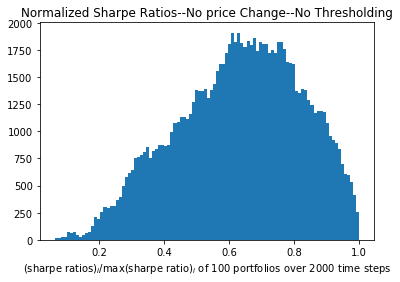

In [7]:
# normSharpes=np.asarray([])
# n = 0
# for i, v in traderIDs.items():
#     normSharpes = np.append(normSharpes,v.sharpeReal/max(v.sharpeReal))
#     n += 1
# plt.hist(normSharpes, bins =100)
# plt.title("Normalized Sharpe Ratios--No price Change--No Thresholding")
# plt.xlabel("(sharpe ratios)$_i$/max(sharpe ratio)$_i$ of 100 portfolios over 2000 time steps")
# # plt.savefig("./results/50_traders_no_change_price/no_priceChange_no_thresholding_50_normalized_sharperatios.png")

In [6]:
# stockPool, hurstPool = portfolio.stockChars()

In [7]:
# stockChars = utils.characterize(stockPool,tmax=2000)

In [5]:
Ttransactions = pd.DataFrame()
TtotalOrders = pd.DataFrame()
Tbroker = pd.DataFrame()

for key,portf in traderIDs.items():
    portf.reset(ptile=70)

for t in range(993,6000):
    Tbroker, TtotalOrders = broker_funcs.thresholdBrokerage(traderIDs, t, Tbroker, TtotalOrders)
    Tbroker, Ttransactions = broker_funcs.instantMatch(traderIDs, Tbroker, Ttransactions)
    print(t)

Cash:  0.011425500431197166 | $ 1142.5500431197167
Optimal Sharpe:  0.36030870157199313
Initial Sharpe:  0.35956928759809764
reset!
threshold:  0.3709941770900799
_____
Cash:  0.005118812421498475 | $ 511.88124214984754
Optimal Sharpe:  0.3186521480509117
Initial Sharpe:  0.31835806495261265
reset!
threshold:  0.3305992022572929
_____
Cash:  0.009599348592230328 | $ 959.9348592230328
Optimal Sharpe:  0.29001935750963753
Initial Sharpe:  0.2893039490105641
reset!
threshold:  0.30095170017634537
_____
Cash:  0.058551262080495214 | $ 585.5126208049521
Optimal Sharpe:  0.2581998772526839
Initial Sharpe:  0.2533803502433836
reset!
threshold:  0.2530020059815781
_____
Cash:  0.12127628667381773 | $ 1212.7628667381773
Optimal Sharpe:  0.27601232293805034
Initial Sharpe:  0.26305040679737524
reset!
threshold:  0.26303593007405524
_____
Cash:  0.007106894717022971 | $ 710.6894717022972
Optimal Sharpe:  0.14843024473865682
Initial Sharpe:  0.1479368081331094
reset!
threshold:  0.1478939656403274

Cash:  0.01091459877086609 | $ 1091.4598770866091
Optimal Sharpe:  0.16981657285408422
Initial Sharpe:  0.1687394518378031
reset!
threshold:  0.17220596929382367
_____
rebalance prob:  0.3895260441794161
roll:  0.6023370656110094
rebalance prob:  0.374123811277933
roll:  0.08774600444286929
order sent
rebalance prob:  0.45091114342066224
roll:  0.24024267004889144
order sent
rebalance prob:  0.6342232069637622
roll:  0.5860230955210353
order sent
rebalance prob:  0.7153040797573341
roll:  0.022906256351494236
order sent
rebalance prob:  0.502734615572128
roll:  0.6847633232162089
rebalance prob:  0.5327627229784733
roll:  0.8388673670380968
rebalance prob:  0.5044332691410145
roll:  0.4998226328743349
order sent
rebalance prob:  0.4892600285832271
roll:  0.4684455091851283
order sent
rebalance prob:  0.5084134574938773
roll:  0.39910289533647036
order sent
rebalance prob:  0.5169781537585179
roll:  0.6906604212413647
rebalance prob:  0.52803267153014
roll:  0.5293342826585925
rebalance

roll:  0.5068494816180266
order sent
rebalance prob:  0.597511438918784
roll:  0.7076124142996292
rebalance prob:  0.48185983867150706
roll:  0.9513600996570003
rebalance prob:  0.5372221243003757
roll:  0.7709829106998073
rebalance prob:  0.5550140955907624
roll:  0.3654208726274176
order sent
rebalance prob:  0.6394514071139773
roll:  0.3980961490575109
order sent
rebalance prob:  0.6019091122543426
roll:  0.18390101665326863
order sent
rebalance prob:  0.6165854281461584
roll:  0.3800654854904316
order sent
rebalance prob:  0.6200237813279734
roll:  0.14128600287826265
order sent
rebalance prob:  0.49863725938053793
roll:  0.4852840887010065
order sent
rebalance prob:  0.4819889664164096
roll:  0.4192076255926346
order sent
hkgly  cash allocation negative at  -0.0029481768009590958
rebalance prob:  0.47081128450063725
roll:  0.13216446071199772
order sent
rebalance prob:  0.5359144558212365
roll:  0.06476669687592462
order sent
rebalance prob:  0.4714127366862959
roll:  0.7731484912

rebalance prob:  0.5036608838151514
roll:  0.28396865685335904
order sent
rebalance prob:  0.5226118541793431
roll:  0.014990378887296929
order sent
rebalance prob:  0.5824071264939168
roll:  0.9849451437397966
rebalance prob:  0.5099656052288565
roll:  0.9500552157330479
rebalance prob:  0.6395942487015356
roll:  0.9026258392195179
rebalance prob:  0.5383841207402837
roll:  0.800821658257312
rebalance prob:  0.5386328128835388
roll:  0.7127270859447667
rebalance prob:  0.5729194063116201
roll:  0.9590410317274566
rebalance prob:  0.5146913485537016
roll:  0.034393615861474935
order sent
997
rebalance prob:  0.4823090063696072
roll:  0.670692393183361
rebalance prob:  0.47885328910317704
roll:  0.2790481037177267
order sent
rebalance prob:  0.4384636241310332
roll:  0.4427599522588548
rebalance prob:  0.5486572077246012
roll:  0.20890160054420492
order sent
rebalance prob:  0.6036053154583556
roll:  0.9571486694040844
rebalance prob:  0.3846131005420229
roll:  0.6706479537388329
rebala

rebalance prob:  0.6416396383920259
roll:  0.18906638335793313
order sent
rebalance prob:  0.6781869794178553
roll:  0.1772679245710339
order sent
rebalance prob:  0.5318569918276739
roll:  0.8264656358494121
rebalance prob:  0.5100656823261119
roll:  0.2791767754500172
order sent
rebalance prob:  0.4647746245246188
roll:  0.35182917725917906
order sent
rebalance prob:  0.4382236793434614
roll:  0.37801831241351547
order sent
rebalance prob:  0.4780688350765644
roll:  0.1182704582345393
order sent
rebalance prob:  0.579208227645872
roll:  0.7548222088232844
rebalance prob:  0.5661735820050814
roll:  0.24815394179859263
order sent
rebalance prob:  0.4168835326575262
roll:  0.6849326152440445
rebalance prob:  0.45630258740903457
roll:  0.01985102330417532
order sent
rebalance prob:  0.4500404835300719
roll:  0.1205409447134056
order sent
rebalance prob:  0.5549831295584209
roll:  0.3922737946131851
order sent
rebalance prob:  0.5624522912879883
roll:  0.8162691193269181
rebalance prob:  

rebalance prob:  0.4502948446103256
roll:  0.739046352764997
rebalance prob:  0.413941150240108
roll:  0.02505862039444784
order sent
rebalance prob:  0.4457357121431016
roll:  0.23754986609186146
order sent
rebalance prob:  0.44229761933392187
roll:  0.8946783332459924
rebalance prob:  0.3535162545691594
roll:  0.386230345295423
rebalance prob:  0.3696760131153765
roll:  0.6085761561348032
rebalance prob:  0.373520095152173
roll:  0.8589074891460373
rebalance prob:  0.40822528628719634
roll:  0.05841163563481133
order sent
rebalance prob:  0.5032151278022247
roll:  0.43989329722839
order sent
rebalance prob:  0.5635534769866972
roll:  0.7803067772682186
rebalance prob:  0.5238391554932262
roll:  0.9305008393515786
rebalance prob:  0.6709948788763026
roll:  0.36105263360154827
order sent
rebalance prob:  0.553136252342918
roll:  0.5022203493658717
order sent
rebalance prob:  0.5256473599796804
roll:  0.7857400774432958
rebalance prob:  0.5209279634399041
roll:  0.007279681864680199
ord

rebalance prob:  0.3088548589508299
roll:  0.07206967618365034
order sent
rebalance prob:  0.35626516700085364
roll:  0.1499135021419825
order sent
rebalance prob:  0.3361216586922847
roll:  0.2497625445893421
order sent
rebalance prob:  0.36615569664946995
roll:  0.6808601915597348
rebalance prob:  0.40936963994697645
roll:  0.5333394091459
rebalance prob:  0.4160990808094924
roll:  0.7583512751394464
rebalance prob:  0.521279983886415
roll:  0.10019357386873551
order sent
rebalance prob:  0.6315706568648589
roll:  0.7456427868935219
rebalance prob:  0.6140053278718166
roll:  0.5174163053732428
order sent
rebalance prob:  0.4332863899865301
roll:  0.8904974838738744
rebalance prob:  0.40119594836465394
roll:  0.16183752467753687
order sent
rebalance prob:  0.25408108681245256
roll:  0.3528205871201443
rebalance prob:  0.26907704228201745
roll:  0.5612002411734938
rebalance prob:  0.2837886696671129
roll:  0.796194953991314
rebalance prob:  0.48069828998198927
roll:  0.4307352089001848

rebalance prob:  0.3387823428602518
roll:  0.980951046028203
rebalance prob:  0.3081453515580389
roll:  0.6119532891490357
rebalance prob:  0.4574746772754729
roll:  0.6323200064814473
rebalance prob:  0.43775297037204175
roll:  0.5940055685770892
rebalance prob:  0.4774691486367143
roll:  0.48923858429826217
rebalance prob:  0.5434700126654294
roll:  0.020002633056884322
order sent
rebalance prob:  0.44212167390623036
roll:  0.49077498232989314
rebalance prob:  0.36586072894513627
roll:  0.6107332194186197
rebalance prob:  0.3271796275305014
roll:  0.8716020027710135
rebalance prob:  0.32143008624871056
roll:  0.7197948045804328
rebalance prob:  0.37812916853010803
roll:  0.7728594816803537
rebalance prob:  0.3373854389291875
roll:  0.010820206946152489
order sent
rebalance prob:  0.33958280900690835
roll:  0.14599923352495414
order sent
rebalance prob:  0.33775241463786904
roll:  0.4520618327199305
rebalance prob:  0.4468992051704983
roll:  0.08704655819622809
order sent
rebalance pr

1009
rebalance prob:  0.4376126362116537
roll:  0.5543613739666317
rebalance prob:  0.5004382280043503
roll:  0.8339006900673878
rebalance prob:  0.21413263071082994
roll:  0.7560377401433975
rebalance prob:  0.3399446789674286
roll:  0.5724295215673286
rebalance prob:  0.3005072825324791
roll:  0.36414951218516456
rebalance prob:  0.15492188230172976
roll:  0.4351128408551397
rebalance prob:  0.31408824593121976
roll:  0.3523193223723676
rebalance prob:  0.2695787075339053
roll:  0.633038625992334
rebalance prob:  0.24563367670786798
roll:  0.7585735402674594
rebalance prob:  0.2588561855932831
roll:  0.4556280853823801
rebalance prob:  0.2647759350889697
roll:  0.3886275029437921
rebalance prob:  0.3840399663760733
roll:  0.8930373611795381
rebalance prob:  0.5425182023386684
roll:  0.08261758211043124
order sent
rebalance prob:  0.7465751014778174
roll:  0.7098501308260408
order sent
rebalance prob:  0.7552943784803238
roll:  0.595178011890514
order sent
rebalance prob:  0.455796544

rebalance prob:  0.3611520737542701
roll:  0.8787703092754208
rebalance prob:  0.48959419884282024
roll:  0.4080322746192544
order sent
rebalance prob:  0.3994452331785955
roll:  0.42088224343036773
rebalance prob:  0.7123487077267631
roll:  0.9758007840089278
rebalance prob:  0.7004780733736006
roll:  0.09240250224162472
order sent
rebalance prob:  0.5740161333925313
roll:  0.7145014183049649
rebalance prob:  0.3166111119479388
roll:  0.822410956078881
rebalance prob:  0.41427194559140923
roll:  0.7301620867835692
rebalance prob:  0.5717742268071562
roll:  0.5717719523079454
order sent
rebalance prob:  0.48901096343188205
roll:  0.6953292812447887
rebalance prob:  0.48773333413112196
roll:  0.1639377899006086
order sent
rebalance prob:  0.6645075337451403
roll:  0.8061971054006557
rebalance prob:  0.46760734837276724
roll:  0.3499910301678204
order sent
rebalance prob:  0.3817909922568456
roll:  0.3255641120533952
order sent
rebalance prob:  0.28796967608750657
roll:  0.78133941137644

rebalance prob:  0.7731966036495788
roll:  0.7768216211387063
rebalance prob:  0.6990014863323735
roll:  0.5780235365432687
order sent
rebalance prob:  0.3674996301629415
roll:  0.30163058382636865
order sent
rebalance prob:  0.26694918729306416
roll:  0.851537923164117
rebalance prob:  0.6516713847256488
roll:  0.6802897055155035
rebalance prob:  0.3924530534475861
roll:  0.3321291403925559
order sent
1014
rebalance prob:  0.4839769840219897
roll:  0.7236151056417713
rebalance prob:  0.5548493777435239
roll:  0.21215035175833052
order sent
rebalance prob:  0.12370435667557338
roll:  0.13180824152746184
rebalance prob:  0.18657293639346717
roll:  0.2880362530770315
rebalance prob:  0.16579117074250324
roll:  0.7878396911915106
rebalance prob:  0.16254888783763932
roll:  0.21837592973712694
rebalance prob:  0.48340451112345223
roll:  0.6986916604189346
rebalance prob:  0.2945851523593526
roll:  0.5124123364871439
rebalance prob:  0.19141785849536996
roll:  0.8480635219075735
rebalance p

rebalance prob:  0.4201927005241735
roll:  0.7126320977656986
rebalance prob:  0.2637971339724728
roll:  0.22649856296857496
order sent
rebalance prob:  0.20673163496309238
roll:  0.8908620442834789
rebalance prob:  0.24804013024034716
roll:  0.8752240815114256
rebalance prob:  0.5853166217555926
roll:  0.34428491189249033
order sent
rebalance prob:  0.45685057364997456
roll:  0.8052422827012792
rebalance prob:  0.4618008587522578
roll:  0.5470738845022171
rebalance prob:  0.500236735757594
roll:  0.9271135625029567
rebalance prob:  0.33098339525460857
roll:  0.39261351233577935
rebalance prob:  0.773337989078933
roll:  0.815126002189653
rebalance prob:  0.767008234051383
roll:  0.41107486371343704
order sent
rebalance prob:  0.567546819284273
roll:  0.9415492657554589
rebalance prob:  0.22166141039933832
roll:  0.004381000916178879
order sent
rebalance prob:  0.30744122549028935
roll:  0.38119753578694915
rebalance prob:  0.6297003467890706
roll:  0.7985430327379056
rebalance prob:  0

rebalance prob:  0.28394686075468695
roll:  0.6897548825025834
rebalance prob:  0.28539442463944004
roll:  0.6134484002295448
rebalance prob:  0.25818103284697386
roll:  0.5832501257020783
rebalance prob:  0.629557410631638
roll:  0.8506485398426762
rebalance prob:  0.7087913848722045
roll:  0.37923534337284215
order sent
rebalance prob:  0.8531730397565731
roll:  0.9949526228238658
rebalance prob:  0.751027625451244
roll:  0.013529261793373437
order sent
rebalance prob:  0.42686199169268296
roll:  0.21910790281012316
order sent
rebalance prob:  0.34059287509884845
roll:  0.3551537849250076
rebalance prob:  0.6517897851184369
roll:  0.41284666390310076
order sent
rebalance prob:  0.37639300694480177
roll:  0.44234183010601946
1019
rebalance prob:  0.5160705644999855
roll:  0.029037602900011672
order sent
rebalance prob:  0.5638521848034894
roll:  0.401265512378159
order sent
rebalance prob:  0.12441863926584727
roll:  0.5188788424600539
rebalance prob:  0.14859570553365
roll:  0.232609

rebalance prob:  0.4478998898633911
roll:  0.08970804011645483
order sent
rebalance prob:  0.761647785302589
roll:  0.12854992571812895
order sent
rebalance prob:  0.8511480925057867
roll:  0.7864370516678418
order sent
rebalance prob:  0.5267104544763549
roll:  0.5850224053236243
rebalance prob:  0.378772423953348
roll:  0.8739217398870077
rebalance prob:  0.22988758727572986
roll:  0.4760812441008372
rebalance prob:  0.14274050303847483
roll:  0.4388673897066754
rebalance prob:  0.2100962707851909
roll:  0.1743935537021788
order sent
rebalance prob:  0.5985036823031982
roll:  0.03241099722465579
order sent
rebalance prob:  0.37921990690806084
roll:  0.050079819126277125
order sent
rebalance prob:  0.3532199901292476
roll:  0.2524404612872062
order sent
rebalance prob:  0.3593380746804204
roll:  0.38495624057273525
rebalance prob:  0.24189745215857586
roll:  0.9017275624162784
rebalance prob:  0.715848328379641
roll:  0.9802882935724954
rebalance prob:  0.7378160784951477
roll:  0.022

rebalance prob:  0.507979005938709
roll:  0.4255465221587472
order sent
rebalance prob:  0.20791111628824419
roll:  0.5358449872021706
rebalance prob:  0.14732293924347262
roll:  0.8034896056601801
rebalance prob:  0.20061000463970688
roll:  0.3468475997890601
rebalance prob:  0.39705738780299665
roll:  0.471709348072208
rebalance prob:  0.2853340374037647
roll:  0.9868523770771442
rebalance prob:  0.28533433789866103
roll:  0.05592073260173702
order sent
rebalance prob:  0.23497134695477534
roll:  0.9195148010271583
rebalance prob:  0.5585017565126215
roll:  0.32859440844701304
order sent
rebalance prob:  0.63409058394117
roll:  0.6354902142534711
rebalance prob:  0.8411870114231046
roll:  0.5605842252152765
order sent
rebalance prob:  0.6858276410448173
roll:  0.15974564866849272
order sent
rebalance prob:  0.3300457678179921
roll:  0.35950814734988823
rebalance prob:  0.25957803147005
roll:  0.7783194318547844
rebalance prob:  0.5963582942821395
roll:  0.9208013616815073
rebalance p

rebalance prob:  0.25690358397952606
roll:  0.6428989785523919
rebalance prob:  0.6454969221139311
roll:  0.46661214088002234
order sent
rebalance prob:  0.7215649530704218
roll:  0.3738367017662687
order sent
rebalance prob:  0.4831063816269653
roll:  0.7294663508628666
rebalance prob:  0.698032701765181
roll:  0.49881424645863004
order sent
rebalance prob:  0.7971225834429765
roll:  0.9096975833692037
rebalance prob:  0.4047761727875603
roll:  0.7836302528182174
rebalance prob:  0.22488454205296737
roll:  0.8741170075563948
rebalance prob:  0.17107901812123372
roll:  0.4955803312089293
rebalance prob:  0.10056683750173516
roll:  0.9259117021502442
rebalance prob:  0.11636317478149619
roll:  0.4405248810181358
rebalance prob:  0.48289860476247354
roll:  0.5391533513441149
rebalance prob:  0.3512992959163667
roll:  0.1764705604379373
order sent
rebalance prob:  0.395830895541493
roll:  0.4060426667798671
rebalance prob:  0.36755331315273043
roll:  0.8789552910719636
rebalance prob:  0.

rebalance prob:  0.4232025762205144
roll:  0.2259751929015812
order sent
rebalance prob:  0.8191973802644669
roll:  0.08084133770716895
order sent
rebalance prob:  0.4731738177791365
roll:  0.3921886383271864
order sent
rebalance prob:  0.15548667581555561
roll:  0.04699725955339673
order sent
rebalance prob:  0.157613084380579
roll:  0.8780810858595801
rebalance prob:  0.18656617444062315
roll:  0.5567868085036269
rebalance prob:  0.30393650641271286
roll:  0.6853952691283779
rebalance prob:  0.2734046513518477
roll:  0.532528475524713
rebalance prob:  0.2734054614036798
roll:  0.12795033288692392
order sent
rebalance prob:  0.29962828094451854
roll:  0.8686720444686143
rebalance prob:  0.572949512185653
roll:  0.09880657033124107
order sent
rebalance prob:  0.6582078593336433
roll:  0.9872609896214721
rebalance prob:  0.8042623477470692
roll:  0.7072079859770483
order sent
rebalance prob:  0.6516268272910772
roll:  0.2211113385470509
order sent
rebalance prob:  0.3179005865929251
rol

rebalance prob:  0.6770631298837982
roll:  0.23091444737301237
order sent
rebalance prob:  0.3650013378650594
roll:  0.19184917179220917
order sent
rebalance prob:  0.1827775789153843
roll:  0.04136122300569278
order sent
rebalance prob:  0.339648843302466
roll:  0.4532315999786649
rebalance prob:  0.5826920728329475
roll:  0.47846958070877477
order sent
rebalance prob:  0.6652549096332198
roll:  0.7002318287756757
rebalance prob:  0.5199672248668428
roll:  0.6655794403677872
rebalance prob:  0.7453444003880207
roll:  0.20545414935269468
order sent
rebalance prob:  0.8222207934276287
roll:  0.055710259899065084
order sent
rebalance prob:  0.40276409851612444
roll:  0.19268363185978088
order sent
rebalance prob:  0.21116163382655234
roll:  0.9635727364123697
rebalance prob:  0.24399860703689719
roll:  0.06587214646415263
order sent
rebalance prob:  0.11870515358646515
roll:  0.5560164407300614
rebalance prob:  0.16064472959159323
roll:  0.5392986626932467
rebalance prob:  0.552994626997

rebalance prob:  0.24397924822043468
roll:  0.7594415220090632
rebalance prob:  0.3315923397709062
roll:  0.010879270744621472
order sent
rebalance prob:  0.6015026315873692
roll:  0.3189438572761598
order sent
rebalance prob:  0.44609865155400313
roll:  0.8164419321695663
rebalance prob:  0.4743334315673167
roll:  0.6391141399211062
rebalance prob:  0.8251393308762919
roll:  0.6603848433080629
order sent
rebalance prob:  0.3883807785107761
roll:  0.24976124534302768
order sent
rebalance prob:  0.19300643013678562
roll:  0.7690475974379636
rebalance prob:  0.2291421097668669
roll:  0.4899381959554572
rebalance prob:  0.31093928071745475
roll:  0.10706191131979259
order sent
rebalance prob:  0.39956097738914714
roll:  0.6937296392632244
rebalance prob:  0.2863870903033597
roll:  0.6826096928484933
rebalance prob:  0.2855522902678373
roll:  0.0025304904140749374
order sent
rebalance prob:  0.3022342242227163
roll:  0.5228107841559259
rebalance prob:  0.6141107723427396
roll:  0.106168443

1036
rebalance prob:  0.19539051735155769
roll:  0.39257810642625435
rebalance prob:  0.2347727645672004
roll:  0.00954797533931051
order sent
rebalance prob:  0.08950960592718873
roll:  0.10372908449345608
rebalance prob:  0.21480961714487737
roll:  0.8401304164469082
rebalance prob:  0.16907562214911534
roll:  0.9452894054540412
rebalance prob:  0.18227680227998472
roll:  0.1365687059291152
order sent
rebalance prob:  0.6384679928891784
roll:  0.2951072819641698
order sent
rebalance prob:  0.3844694721968782
roll:  0.7053881284189613
rebalance prob:  0.2051331513618962
roll:  0.7310620210625887
rebalance prob:  0.3551476729632154
roll:  0.9031381615586146
rebalance prob:  0.664496475203075
roll:  0.8166232489384442
rebalance prob:  0.7381464247772568
roll:  0.00903361900323385
order sent
rebalance prob:  0.5940029961746073
roll:  0.6154010496902272
rebalance prob:  0.7645934302101304
roll:  0.9057374914456635
rebalance prob:  0.8255475670466818
roll:  0.6050651291667686
order sent
re

rebalance prob:  0.4509490561677124
roll:  0.7822347834546728
rebalance prob:  0.42077276776785316
roll:  0.5605457662628939
rebalance prob:  0.5500719002182555
roll:  0.31392858322539996
order sent
rebalance prob:  0.5076696156769648
roll:  0.9440189473885449
rebalance prob:  0.32324060838771396
roll:  0.6246835516834004
rebalance prob:  0.20657844903562336
roll:  0.8287198198511188
rebalance prob:  0.291693119860193
roll:  0.21378463774885004
order sent
rebalance prob:  0.5461424291778955
roll:  0.13417189020911802
order sent
hkgly  cash allocation negative at  -0.006680608118516998
rebalance prob:  0.641412239431834
roll:  0.18056182685284305
order sent
rebalance prob:  0.6695018461544829
roll:  0.44962345638711454
order sent
rebalance prob:  0.8630026388975948
roll:  0.7199874438525132
order sent
rebalance prob:  0.3212458555088257
roll:  0.8184346923942514
rebalance prob:  0.20483665762193423
roll:  0.80469249502885
rebalance prob:  0.21848990952971178
roll:  0.9873100439881323
re

rebalance prob:  0.6612387047491101
roll:  0.14175937568728247
order sent
rebalance prob:  0.47987481967111506
roll:  0.032359429381583205
order sent
rebalance prob:  0.35215342632585195
roll:  0.1909727634080599
order sent
rebalance prob:  0.26168841382519886
roll:  0.28498391891302155
rebalance prob:  0.5180802895617744
roll:  0.3937307235216805
order sent
rebalance prob:  0.34430675719761494
roll:  0.7259713478862184
1041
rebalance prob:  0.17013365288749746
roll:  0.0512382310517181
order sent
rebalance prob:  0.20073733168828944
roll:  0.9924329211380133
rebalance prob:  0.048526588419601606
roll:  0.4073343298284213
rebalance prob:  0.23222478806050878
roll:  0.32883994915795367
rebalance prob:  0.193152800981278
roll:  0.6784409395246882
rebalance prob:  0.15677343149815873
roll:  0.02713732185188844
order sent
rebalance prob:  0.5843460189462903
roll:  0.2761056676154574
order sent
rebalance prob:  0.467256302425967
roll:  0.832146032257601
rebalance prob:  0.3299829759532527
r

rebalance prob:  0.35877247019171127
roll:  0.41789717809295457
rebalance prob:  0.2214810058625364
roll:  0.925804926448328
rebalance prob:  0.06437955632361193
roll:  0.5057442080954091
rebalance prob:  0.08714569913743844
roll:  0.5966949223757015
rebalance prob:  0.5145936161594921
roll:  0.9148315230975743
rebalance prob:  0.3449582751376082
roll:  0.4582430773305123
rebalance prob:  0.33610893097689326
roll:  0.19185465948778857
order sent
rebalance prob:  0.43140705821687136
roll:  0.6202305112686215
rebalance prob:  0.5413305858615464
roll:  0.6436884758168411
rebalance prob:  0.6514595238952754
roll:  0.6369027969977822
order sent
rebalance prob:  0.5236987143489306
roll:  0.5422264257581201
rebalance prob:  0.34506845624618027
roll:  0.6032082405563306
rebalance prob:  0.16857534089232656
roll:  0.9317561487547169
rebalance prob:  0.23996679367078957
roll:  0.3529590932946792
rebalance prob:  0.5760610603718144
roll:  0.623424350147443
rebalance prob:  0.5856864849286488
roll

rebalance prob:  0.1961138780485297
roll:  0.7357067354416833
rebalance prob:  0.22623210355756732
roll:  0.031556985847911
order sent
rebalance prob:  0.6585432170821853
roll:  0.5419230805144947
order sent
rebalance prob:  0.7238772220621724
roll:  0.39635683820225054
order sent
rebalance prob:  0.7461277058894122
roll:  0.21881379991357286
order sent
rebalance prob:  0.5301928840303999
roll:  0.989082705023778
rebalance prob:  0.32287799856901606
roll:  0.9898836717130357
rebalance prob:  0.24481684231817977
roll:  0.23042396434586454
order sent
rebalance prob:  0.4680929987768154
roll:  0.11443333906981257
order sent
rebalance prob:  0.2639670921327067
roll:  0.17030164766776734
order sent
1046
rebalance prob:  0.18722784307747983
roll:  0.8948699689375876
rebalance prob:  0.2684865914490449
roll:  0.05241469891109585
order sent
rebalance prob:  0.0463909461370019
roll:  0.08779077078603414
rebalance prob:  0.14837548057407857
roll:  0.4926985462130291
rebalance prob:  0.1495281634

rebalance prob:  0.6667254252477738
roll:  0.8970164527484802
rebalance prob:  0.7148845016829913
roll:  0.9737697882473809
rebalance prob:  0.6615756749184893
roll:  0.439125607309815
order sent
rebalance prob:  0.30341404441125336
roll:  0.3810645138452087
rebalance prob:  0.238650301166503
roll:  0.9824798924509752
rebalance prob:  0.09773680190978967
roll:  0.8677817898870832
rebalance prob:  0.14330042117545003
roll:  0.3452084585778863
rebalance prob:  0.5979869430466987
roll:  0.5596261720231486
order sent
rebalance prob:  0.42322922146116754
roll:  0.32687264037738073
order sent
rebalance prob:  0.357062652224021
roll:  0.6971031859406963
rebalance prob:  0.2652032508409778
roll:  0.704179621218783
rebalance prob:  0.3046513173816894
roll:  0.67550852189041
rebalance prob:  0.565053603639367
roll:  0.7932446568564037
rebalance prob:  0.4639351122849086
roll:  0.7954519746109537
rebalance prob:  0.28186405361854266
roll:  0.7844671819730169
rebalance prob:  0.0866433080215226
ro

rebalance prob:  0.5263648858453586
roll:  0.02654422632918918
order sent
rebalance prob:  0.2795072211061479
roll:  0.8544546401287083
rebalance prob:  0.0704655093447051
roll:  0.2118851666626964
rebalance prob:  0.07046677484414127
roll:  0.24087946991732534
rebalance prob:  0.07993216628771352
roll:  0.3769823432900836
rebalance prob:  0.59766388135658
roll:  0.01987650172616584
order sent
rebalance prob:  0.7006385496937616
roll:  0.9049553339218652
rebalance prob:  0.8124902388433973
roll:  0.028821503434592333
order sent
rebalance prob:  0.619748903411073
roll:  0.7150607932437636
rebalance prob:  0.4446123485451668
roll:  0.6950285442000914
rebalance prob:  0.3865128100463605
roll:  0.47832028525958914
rebalance prob:  0.38942912464220464
roll:  0.195347504176553
order sent
rebalance prob:  0.2105598966554092
roll:  0.41313369675750344
1051
rebalance prob:  0.12440824615765865
roll:  0.3384781888851853
rebalance prob:  0.23758412302239307
roll:  0.22325998213496423
order sent
r

rebalance prob:  0.41972701360920905
roll:  0.5144836824097604
rebalance prob:  0.6614745729948616
roll:  0.9854765658417017
rebalance prob:  0.735523922626766
roll:  0.3930885753875024
order sent
rebalance prob:  0.3818014524669375
roll:  0.44378649160570827
rebalance prob:  0.5757226433205053
roll:  0.860713626332664
rebalance prob:  0.721632756855512
roll:  0.8395588913685058
rebalance prob:  0.7715204637136591
roll:  0.6406489062571801
order sent
rebalance prob:  0.3781577674318847
roll:  0.06266635152152422
order sent
rebalance prob:  0.17425544898308865
roll:  0.6364022222852997
rebalance prob:  0.04618805399439281
roll:  0.02463128772127776
order sent
rebalance prob:  0.13416067827428896
roll:  0.37099874525239296
rebalance prob:  0.7540497346602961
roll:  0.7922843563797591
rebalance prob:  0.6047615432500405
roll:  0.05023767942472246
order sent
rebalance prob:  0.2898938078208201
roll:  0.7403414021630378
rebalance prob:  0.17362082692651312
roll:  0.11396447877397242
order s

rebalance prob:  0.8101641402493518
roll:  0.9654113030558117
rebalance prob:  0.8088122292572392
roll:  0.32730843508736507
order sent
rebalance prob:  0.7762084718896942
roll:  0.4471615085799665
order sent
rebalance prob:  0.644112944475373
roll:  0.09544088426957764
order sent
rebalance prob:  0.18647268446087562
roll:  0.7173332919436065
rebalance prob:  0.3994687203095071
roll:  0.3641849181273267
order sent
rebalance prob:  0.4263225851987072
roll:  0.21624568673114086
order sent
rebalance prob:  0.1583472542900717
roll:  0.9856771561997572
rebalance prob:  0.046834398523404076
roll:  0.1594885760143273
rebalance prob:  0.04683170690544403
roll:  0.7260046585731091
rebalance prob:  0.06391311860563739
roll:  0.019092948742995497
order sent
rebalance prob:  0.536356090554123
roll:  0.023354267649357774
order sent
rebalance prob:  0.6568861922955256
roll:  0.6435151683476484
order sent
rebalance prob:  0.826913086214279
roll:  0.23984448101741118
order sent
rebalance prob:  0.7361

rebalance prob:  0.05324395531468604
roll:  0.41539536611713856
rebalance prob:  0.04547850329342631
roll:  0.41217594406612323
rebalance prob:  0.07038405620451672
roll:  0.151242653604722
rebalance prob:  0.14087088891839858
roll:  0.42483430936269584
rebalance prob:  0.47524933672157726
roll:  0.8751093746031341
rebalance prob:  0.5896239426335477
roll:  0.5200256858774257
order sent
rebalance prob:  0.570808305609509
roll:  0.05146749475403978
order sent
rebalance prob:  0.5361857187008748
roll:  0.75535076354822
rebalance prob:  0.6219942234969281
roll:  0.7258286555940343
rebalance prob:  0.34929303478445906
roll:  0.48440882122800955
rebalance prob:  0.5347566213145631
roll:  0.5175688684725064
order sent
rebalance prob:  0.6676397943745287
roll:  0.5626719784211793
order sent
rebalance prob:  0.7911566920496327
roll:  0.14992996241866297
order sent
rebalance prob:  0.35259251068263003
roll:  0.9189363369618437
rebalance prob:  0.17085578924452957
roll:  0.8736811270923843
rebal

rebalance prob:  0.16844311862464306
roll:  0.1424134944488875
order sent
rebalance prob:  0.027126767736148888
roll:  0.9218741258443219
rebalance prob:  0.1820171405464278
roll:  0.11928797058081142
order sent
rebalance prob:  0.6018115182714074
roll:  0.5294937112588898
order sent
rebalance prob:  0.8590969761470102
roll:  0.28515459380868247
order sent
rebalance prob:  0.872797023423606
roll:  0.8500702873187503
order sent
rebalance prob:  0.863253830034067
roll:  0.5384854459440424
order sent
rebalance prob:  0.6889235616060763
roll:  0.749579723852023
rebalance prob:  0.15886168891450203
roll:  0.4564143065656556
rebalance prob:  0.23479213738115448
roll:  0.05280438518580599
order sent
rebalance prob:  0.2739292492322697
roll:  0.23921973389916873
order sent
rebalance prob:  0.1115867065684905
roll:  0.49531568841809714
rebalance prob:  0.025013407586561846
roll:  0.2272992591768752
rebalance prob:  0.02500589974038609
roll:  0.5964605976820767
rebalance prob:  0.028885251973682

1063
rebalance prob:  0.07747438241281925
roll:  0.8640819589242194
rebalance prob:  0.15599729590765285
roll:  0.005091559156194636
order sent
rebalance prob:  0.01934384467338467
roll:  0.7288036790186357
rebalance prob:  0.04008285412601059
roll:  0.35591775909827905
rebalance prob:  0.030721177524109015
roll:  0.8205430684208225
rebalance prob:  0.08830298188122301
roll:  0.762992633040353
rebalance prob:  0.12508108975286295
roll:  0.13111039604665042
rebalance prob:  0.4417673434163558
roll:  0.2063461655398604
order sent
rebalance prob:  0.5824992790035791
roll:  0.21450201639980482
order sent
rebalance prob:  0.517536037797948
roll:  0.9737492135320832
rebalance prob:  0.49136400679884473
roll:  0.49209868400184076
rebalance prob:  0.5789358236117609
roll:  0.46359649567988637
order sent
rebalance prob:  0.15958005881514734
roll:  0.09752414664194542
order sent
rebalance prob:  0.2578422572125396
roll:  0.8240479018036697
rebalance prob:  0.5496809740265044
roll:  0.20584396732

rebalance prob:  0.09647991321375202
roll:  0.8681134818445262
rebalance prob:  0.09484451760078622
roll:  0.41263241030470343
rebalance prob:  0.8248099185072887
roll:  0.2049254893080048
order sent
rebalance prob:  0.4417918174119698
roll:  0.2355197061872839
order sent
rebalance prob:  0.22297954346624518
roll:  0.4267156591157727
rebalance prob:  0.017572628853901897
roll:  0.6922137162578345
rebalance prob:  0.14656961054224352
roll:  0.6692513275427576
rebalance prob:  0.6144751931123347
roll:  0.859161092976093
rebalance prob:  0.8537422479448445
roll:  0.2628188050720418
order sent
rebalance prob:  0.8593460878497212
roll:  0.42829128450810405
order sent
rebalance prob:  0.8326251669755128
roll:  0.4183864084397346
order sent
rebalance prob:  0.8363143115909001
roll:  0.6501409087277006
order sent
rebalance prob:  0.18724502472272023
roll:  0.5594577384249265
rebalance prob:  0.22756917077042457
roll:  0.7512346103806606
rebalance prob:  0.2818062462757535
roll:  0.006732165061

rebalance prob:  0.9201762847515921
roll:  0.8142758691531772
order sent
rebalance prob:  0.7539763776392757
roll:  0.7775938757899434
rebalance prob:  0.6346212552039039
roll:  0.2542392687616135
order sent
rebalance prob:  0.3134108845265042
roll:  0.39246231714493285
rebalance prob:  0.058299647614109794
roll:  0.7692697490969127
1068
rebalance prob:  0.08869438804757532
roll:  0.8016009827188977
rebalance prob:  0.17676562703864443
roll:  0.5989546534141503
rebalance prob:  0.014642581294827562
roll:  0.43034334521482487
rebalance prob:  0.03238099499010322
roll:  0.04941653979103877
rebalance prob:  0.0291074628800683
roll:  0.9810210559156335
rebalance prob:  0.08443039024051163
roll:  0.06328970280023472
order sent
nmjfa  cash allocation negative at  -0.0010042254209532211
rebalance prob:  0.20859245497628262
roll:  0.022617461669037553
order sent
rebalance prob:  0.5992321063201029
roll:  0.10726261144822224
order sent
rebalance prob:  0.6424456097593563
roll:  0.18984419767200

rebalance prob:  0.25014481666005
roll:  0.7634890603226973
rebalance prob:  0.12146856841064031
roll:  0.09497186676322489
order sent
rebalance prob:  0.013443418339228389
roll:  0.10758719721863397
rebalance prob:  0.07065832561224095
roll:  0.7329880521944623
rebalance prob:  0.8344402015371737
roll:  0.9552574260112868
rebalance prob:  0.7573119447964617
roll:  0.8037430814757719
rebalance prob:  0.49607977277678467
roll:  0.6660891483639081
rebalance prob:  0.07397801194868085
roll:  0.6773311645797656
rebalance prob:  0.08985179711198588
roll:  0.41452034543441807
rebalance prob:  0.8172204444288983
roll:  0.3935035463172699
order sent
rebalance prob:  0.3704719360751544
roll:  0.5814003593002417
rebalance prob:  0.13832324559009734
roll:  0.488983563922308
rebalance prob:  0.010939045337666159
roll:  0.30298238325870064
rebalance prob:  0.13448683457864016
roll:  0.2901531739367056
rebalance prob:  0.635600546173096
roll:  0.3122461086051216
order sent
rebalance prob:  0.7554721

rebalance prob:  0.008879815310053342
roll:  0.39011323773089657
rebalance prob:  0.22220125588814005
roll:  0.7968781119533216
rebalance prob:  0.27628031093165745
roll:  0.007564130732391039
order sent
rebalance prob:  0.9076849291240456
roll:  0.3572285683453309
order sent
rebalance prob:  0.8651708292162117
roll:  0.384512154889326
order sent
rebalance prob:  0.6603207160170506
roll:  0.8515109933350613
rebalance prob:  0.48608140382138565
roll:  0.2753691527402373
order sent
rebalance prob:  0.2955273959554233
roll:  0.510029892958809
rebalance prob:  0.03779962463096295
roll:  0.5637267622506812
1073
rebalance prob:  0.09418606457928451
roll:  0.7578713642661996
rebalance prob:  0.1869218534203413
roll:  0.6742291649593052
rebalance prob:  0.022584470067216082
roll:  0.09598859600982623
rebalance prob:  0.022303894830746344
roll:  0.40192618163151095
rebalance prob:  0.021585855113078364
roll:  0.7030797728123525
rebalance prob:  0.1255555940303312
roll:  0.5744092892064897
rebal

rebalance prob:  0.05363214089374845
roll:  0.7157014065418474
rebalance prob:  0.20899114164795254
roll:  0.6297428728352472
rebalance prob:  0.6446822145487447
roll:  0.05220251762679995
order sent
rebalance prob:  0.5621541927136757
roll:  0.7039278537958565
rebalance prob:  0.1578711816211116
roll:  0.5084709255669364
rebalance prob:  0.20430759105050564
roll:  0.9976922411348561
rebalance prob:  0.03169480970973193
roll:  0.8174252837973041
rebalance prob:  0.077042740153067
roll:  0.9954101441070872
rebalance prob:  0.7495781201798061
roll:  0.28897325250741923
order sent
rebalance prob:  0.6253294443684122
roll:  0.39790180681517384
order sent
rebalance prob:  0.510700881853931
roll:  0.6451762137926327
rebalance prob:  0.06992430352057437
roll:  0.8398995045533543
rebalance prob:  0.08829688040721553
roll:  0.6845199052302962
rebalance prob:  0.7690771774641846
roll:  0.3906615429064506
order sent
rebalance prob:  0.3205408041637072
roll:  0.8220242144505324
rebalance prob:  0.

rebalance prob:  0.2887952620726852
roll:  0.3053946453973583
rebalance prob:  0.11988227333661346
roll:  0.7380752945983744
rebalance prob:  0.021882216377395673
roll:  0.33292911563059
rebalance prob:  0.020044011715978506
roll:  0.17337654503033784
rebalance prob:  0.013102581116957805
roll:  0.5386378365769556
rebalance prob:  0.17267133416430822
roll:  0.4539916318903283
rebalance prob:  0.22162298272561046
roll:  0.865220177111104
rebalance prob:  0.8339804388981694
roll:  0.18001086352602413
order sent
rebalance prob:  0.801616509886796
roll:  0.9878297407448944
rebalance prob:  0.5976554859590074
roll:  0.7794093819632595
rebalance prob:  0.2869267363952244
roll:  0.7897088311227781
rebalance prob:  0.21993601734728585
roll:  0.6950610988483144
rebalance prob:  0.022413986200699683
roll:  0.6856967605817559
1078
rebalance prob:  0.15793758576499753
roll:  0.5688429400485794
rebalance prob:  0.29225113149312565
roll:  0.9018484317451859
rebalance prob:  0.02389553316407451
roll:

rebalance prob:  0.15548518270587106
roll:  0.4931612811861976
rebalance prob:  0.5604683828153685
roll:  0.0006737683356189406
order sent
rebalance prob:  0.5151415786221459
roll:  0.11820174136670525
order sent
rebalance prob:  0.10467817633458866
roll:  0.5927259601959008
rebalance prob:  0.268282639119239
roll:  0.16171635225422465
order sent
rebalance prob:  0.05210088497485632
roll:  0.9489383467056388
rebalance prob:  0.0763812559810949
roll:  0.8261926607890558
rebalance prob:  0.621552753629967
roll:  0.9675243271743338
rebalance prob:  0.5156232942290816
roll:  0.47443271643641394
order sent
rebalance prob:  0.5026325045068996
roll:  0.7885946199064858
rebalance prob:  0.07977522984715654
roll:  0.23887593747531788
rebalance prob:  0.13654179980503311
roll:  0.053612111844748234
order sent
rebalance prob:  0.8376429731281394
roll:  0.18185655599628026
order sent
rebalance prob:  0.3647328902049125
roll:  0.6602578246741496
rebalance prob:  0.11405057644180465
roll:  0.8885431

rebalance prob:  0.16994735054838445
roll:  0.6444840403985461
rebalance prob:  0.025438692379295382
roll:  0.5191420995785021
rebalance prob:  0.02133129021742071
roll:  0.985420397914503
rebalance prob:  0.01152283593386842
roll:  0.7429264780467807
rebalance prob:  0.13448790675127642
roll:  0.3610510245944587
rebalance prob:  0.1710641593936799
roll:  0.6210680800144609
rebalance prob:  0.8211568445584949
roll:  0.3264723928105919
order sent
rebalance prob:  0.8109771547129799
roll:  0.11027668729856432
order sent
rebalance prob:  0.644000464933371
roll:  0.03970602558091885
order sent
rebalance prob:  0.3532593720724387
roll:  0.03605412869884095
order sent
rebalance prob:  0.3518592421285027
roll:  0.20711108055661853
order sent
rebalance prob:  0.021900799721455942
roll:  0.7171640433590089
1083
rebalance prob:  0.1314829836416922
roll:  0.0023630935545193577
order sent
rebalance prob:  0.323827035369369
roll:  0.5616331716235081
rebalance prob:  0.033268878533637074
roll:  0.75

rebalance prob:  0.7022195860618984
roll:  0.6687785309241223
order sent
rebalance prob:  0.6164498076186524
roll:  0.7111372581821751
rebalance prob:  0.7619489797375121
roll:  0.8064611827927602
rebalance prob:  0.06890526568726979
roll:  0.6469671488905228
rebalance prob:  0.18183812665175544
roll:  0.04833263374969865
order sent
rebalance prob:  0.7080703112720377
roll:  0.3984815701468848
order sent
rebalance prob:  0.4079794389768264
roll:  0.7648830728503554
rebalance prob:  0.060185914195413324
roll:  0.7072804367693224
rebalance prob:  0.30476796835666314
roll:  0.14786735440319088
order sent
rebalance prob:  0.046796758835528585
roll:  0.5838016362539135
rebalance prob:  0.0760051601593927
roll:  0.7216994657720515
rebalance prob:  0.6215573312425845
roll:  0.22702408896083193
order sent
rebalance prob:  0.445776759231758
roll:  0.058970006213247106
order sent
rebalance prob:  0.35345608485514357
roll:  0.2668653346144222
order sent
rebalance prob:  0.045202185455032545
roll:

rebalance prob:  0.3887382936855612
roll:  0.6765959142273824
rebalance prob:  0.6799279745802449
roll:  0.7905553092124242
rebalance prob:  0.7295933778379843
roll:  0.6522479307766654
order sent
rebalance prob:  0.06507346689384144
roll:  0.4992455229428967
rebalance prob:  0.32661758315984696
roll:  0.41630370856490573
rebalance prob:  0.34297724268484553
roll:  0.718110744190547
rebalance prob:  0.1791967302319516
roll:  0.25451726054420376
rebalance prob:  0.03307990626154016
roll:  0.9710792931859091
rebalance prob:  0.02638153291371245
roll:  0.0013039725436057026
order sent
rebalance prob:  0.013365838584517922
roll:  0.013812997082657041
rebalance prob:  0.1334696233554052
roll:  0.016818640691190434
order sent
rebalance prob:  0.15510326482982198
roll:  0.7022210020586895
rebalance prob:  0.7945215509530195
roll:  0.1809521713627893
order sent
rebalance prob:  0.7814601550081458
roll:  0.37845908186064503
order sent
rebalance prob:  0.5892756149075953
roll:  0.735807971607345

rebalance prob:  0.09552942940140938
roll:  0.43590595365702767
rebalance prob:  0.09356764897443104
roll:  0.43375080333787763
rebalance prob:  0.2941983049889512
roll:  0.5353441301160426
rebalance prob:  0.461195713899591
roll:  0.4327203391304355
order sent
rebalance prob:  0.7168736443355215
roll:  0.5495634723029962
order sent
rebalance prob:  0.5445384101099195
roll:  0.970229117525399
rebalance prob:  0.7800931907227712
roll:  0.4168824680005909
order sent
rebalance prob:  0.1247756889801758
roll:  0.8902054613133088
rebalance prob:  0.31181931923844736
roll:  0.5092019572069315
rebalance prob:  0.7547489266696105
roll:  0.6066133081635862
order sent
rebalance prob:  0.41774840610790764
roll:  0.5433293088891532
rebalance prob:  0.04961268867135666
roll:  0.8231151129404308
rebalance prob:  0.3339281487934556
roll:  0.22110881401493943
order sent
rebalance prob:  0.05835059920394904
roll:  0.5178923373853971
rebalance prob:  0.10090415434352124
roll:  0.8653087575534268
rebalan

rebalance prob:  0.1284531845846922
roll:  0.576080544999753
rebalance prob:  0.449652734574859
roll:  0.40370363419620536
order sent
rebalance prob:  0.3941878084841675
roll:  0.368718038345228
order sent
rebalance prob:  0.44561642748151303
roll:  0.9399757781341792
rebalance prob:  0.5489943596011583
roll:  0.3656051570345925
order sent
rebalance prob:  0.7637831330356822
roll:  0.9265202017818319
rebalance prob:  0.09393543218440395
roll:  0.017431150488029457
order sent
rebalance prob:  0.289915180097324
roll:  0.5233639823524743
rebalance prob:  0.3455773692310526
roll:  0.4602445145667974
rebalance prob:  0.21017796766167848
roll:  0.8655417797574948
rebalance prob:  0.04321185845985094
roll:  0.3582865952031029
rebalance prob:  0.030323643686543427
roll:  0.27460157243389927
rebalance prob:  0.015622712982979802
roll:  0.9956193599900357
rebalance prob:  0.1043878941803118
roll:  0.053680739412505285
order sent
rebalance prob:  0.13403239687718324
roll:  0.03124082421951946
ord

rebalance prob:  0.05059483977026234
roll:  0.12390090622496963
rebalance prob:  0.026351308087254163
roll:  0.14413907091449796
rebalance prob:  0.022724959495502958
roll:  0.429385693578038
rebalance prob:  0.09659901355946506
roll:  0.5826686911733929
rebalance prob:  0.11352853025155593
roll:  0.1649486585826625
rebalance prob:  0.20892281487772113
roll:  0.1787495630282948
order sent
rebalance prob:  0.3433407314368158
roll:  0.37510089618610676
rebalance prob:  0.7365831190890506
roll:  0.3257692795003878
order sent
rebalance prob:  0.7427687444846822
roll:  0.5917120492386053
order sent
rebalance prob:  0.900181026381523
roll:  0.9123835399319621
rebalance prob:  0.1659544263691341
roll:  0.4793824775929657
rebalance prob:  0.40638602435758475
roll:  0.34993984544017653
order sent
rebalance prob:  0.7444997876997651
roll:  0.20790722868315692
order sent
rebalance prob:  0.32908560185815294
roll:  0.0622980720902826
order sent
rebalance prob:  0.0318486728310964
roll:  0.36260522

rebalance prob:  0.8839975659590753
roll:  0.10235443919127951
order sent
rebalance prob:  0.4878159583891422
roll:  0.33759873264871154
order sent
rebalance prob:  0.18261905572026912
roll:  0.5468822510448799
rebalance prob:  0.012349454989422144
roll:  0.7703539092514164
rebalance prob:  0.09190148590342782
roll:  0.7509595346723749
rebalance prob:  0.5013477918462759
roll:  0.9772721569501516
rebalance prob:  0.23939920971042458
roll:  0.5675150076496541
rebalance prob:  0.26712923829046437
roll:  0.41312011162915885
rebalance prob:  0.42743792298386685
roll:  0.7839753782258017
rebalance prob:  0.7170306569564425
roll:  0.5197404199634379
order sent
rebalance prob:  0.04866870626160186
roll:  0.4963071248771105
rebalance prob:  0.26951579045841717
roll:  0.38693046574902346
rebalance prob:  0.31103181635876775
roll:  0.6076670392590321
rebalance prob:  0.2627390086823287
roll:  0.314447459172593
rebalance prob:  0.04160983806072854
roll:  0.25731392012797283
rebalance prob:  0.023

rebalance prob:  0.5565640289517871
roll:  0.1452283758023215
order sent
rebalance prob:  0.2577690963664893
roll:  0.09738931634758285
order sent
rebalance prob:  0.5366981485732221
roll:  0.56510380084158
rebalance prob:  0.018264860013791216
roll:  0.5356807882382952
1100
rebalance prob:  0.17946544388029026
roll:  0.3730250561530306
rebalance prob:  0.48207172642857155
roll:  0.7584148353699597
rebalance prob:  0.031620742549055295
roll:  0.7166013432083617
rebalance prob:  0.022379187934345547
roll:  0.5387278050056094
rebalance prob:  0.01611481399761369
roll:  0.5670586949188209
rebalance prob:  0.05124035080067359
roll:  0.709172000693654
rebalance prob:  0.057087887679606014
roll:  0.06558333450067577
rebalance prob:  0.19887761148438524
roll:  0.013063093382250757
order sent
rebalance prob:  0.40223022875713865
roll:  0.8525839952611088
rebalance prob:  0.7370114565580765
roll:  0.8484627480709841
rebalance prob:  0.5796590018536977
roll:  0.21275163312929668
order sent
rebal

rebalance prob:  0.04452344017107848
roll:  0.19168974503913105
rebalance prob:  0.6613869346115415
roll:  0.6948748207145087
rebalance prob:  0.36570377431725865
roll:  0.10530836325222714
order sent
rebalance prob:  0.3710586176750919
roll:  0.4250903398647874
rebalance prob:  0.07439607452443057
roll:  0.3656680976404617
rebalance prob:  0.2655619371644803
roll:  0.7045615494019571
rebalance prob:  0.9187991120775562
roll:  0.8232655175807017
order sent
rebalance prob:  0.5902031872060827
roll:  0.4832889532789615
order sent
rebalance prob:  0.24374316881272562
roll:  0.7392074986181467
rebalance prob:  0.01161334496545909
roll:  0.05561448933240254
rebalance prob:  0.06049450528434766
roll:  0.8533190310883836
rebalance prob:  0.47124107586612446
roll:  0.43540809849118545
order sent
hkgly  cash allocation negative at  -0.004506584800810615
rebalance prob:  0.20109030449880264
roll:  0.4735013668818079
rebalance prob:  0.22141779297652558
roll:  0.04469527888728497
order sent
rebal

rebalance prob:  0.11228284087850872
roll:  0.6787348457588459
rebalance prob:  0.8572814835399768
roll:  0.29176578956262
order sent
rebalance prob:  0.8541647657959547
roll:  0.31602442167160794
order sent
rebalance prob:  0.5223674191157461
roll:  0.606566269415935
rebalance prob:  0.22057429229507544
roll:  0.8287371954829157
rebalance prob:  0.5244558447042997
roll:  0.8647392314678134
rebalance prob:  0.027006090740663607
roll:  0.4241582377577713
1105
rebalance prob:  0.21815914379878665
roll:  0.8942550932426634
rebalance prob:  0.5502963839700358
roll:  0.6694797557186783
rebalance prob:  0.03290711435411746
roll:  0.13903857656121787
rebalance prob:  0.02574404604419333
roll:  0.5998913490267059
rebalance prob:  0.015421530725791735
roll:  0.7527841413418823
rebalance prob:  0.04309630786288159
roll:  0.15201337792787706
rebalance prob:  0.054302302454849224
roll:  0.39184077813535834
rebalance prob:  0.16306007854670806
roll:  0.2406781444650502
rebalance prob:  0.3303442008

rebalance prob:  0.031342682137710444
roll:  0.6716744047944426
rebalance prob:  0.2326730562989406
roll:  0.4689741714971226
rebalance prob:  0.024330850353322636
roll:  0.6093969323631818
rebalance prob:  0.04330431083104444
roll:  0.7229602483910553
rebalance prob:  0.6898290434457557
roll:  0.9127948762380178
rebalance prob:  0.41208908026099017
roll:  0.7098672772927125
rebalance prob:  0.355344016766123
roll:  0.8347264067939972
rebalance prob:  0.06398005325352274
roll:  0.07083541325027787
rebalance prob:  0.2556542790845294
roll:  0.43103774807990525
rebalance prob:  0.959106405402815
roll:  0.7903346908058319
order sent
rebalance prob:  0.7161415814549665
roll:  0.6095978114307018
order sent
rebalance prob:  0.44009920081417425
roll:  0.6445155081101097
rebalance prob:  0.015928583316890774
roll:  0.728138506560715
rebalance prob:  0.07505294492611693
roll:  0.6766460392351716
rebalance prob:  0.35370381539467566
roll:  0.7714715976570298
rebalance prob:  0.1884772144999977
r

rebalance prob:  0.13006935763301725
roll:  0.4356822490085488
rebalance prob:  0.0584244374034369
roll:  0.47302713923618755
rebalance prob:  0.018134973156797848
roll:  0.23479201945261663
rebalance prob:  0.10122220089590094
roll:  0.47231746163205823
rebalance prob:  0.12148120984175215
roll:  0.8884340954270045
rebalance prob:  0.9340435519001531
roll:  0.7264697557415813
order sent
rebalance prob:  0.9184727493406933
roll:  0.45236562999639973
order sent
rebalance prob:  0.5357068499447137
roll:  0.0011765121248288324
order sent
rebalance prob:  0.26846060382141335
roll:  0.6435403153777927
rebalance prob:  0.43344327902635266
roll:  0.12054929727111319
order sent
rebalance prob:  0.021377861436961236
roll:  0.3308789849994961
1110
rebalance prob:  0.337329621882737
roll:  0.9244985048514035
rebalance prob:  0.6532168756895593
roll:  0.5825528125089436
order sent
rebalance prob:  0.05060562404489897
roll:  0.7755316300143631
rebalance prob:  0.040395465812644575
roll:  0.30878967

rebalance prob:  0.8662798040811587
roll:  0.121793149941124
order sent
rebalance prob:  0.24141233910904433
roll:  0.8943794238897642
rebalance prob:  0.4915873446921188
roll:  0.5115537149170627
rebalance prob:  0.7720206369545486
roll:  0.3661681782837868
order sent
rebalance prob:  0.2032653543991393
roll:  0.9210363040928052
rebalance prob:  0.021419600923108732
roll:  0.6487339027378454
rebalance prob:  0.3715393933767718
roll:  0.6261903042578617
rebalance prob:  0.05689824381113001
roll:  0.6808958952146811
rebalance prob:  0.07557578442854411
roll:  0.18806321059098985
rebalance prob:  0.7729268480046372
roll:  0.5030615631329552
order sent
rebalance prob:  0.5627825804339022
roll:  0.4834019881615478
order sent
rebalance prob:  0.5155305292926884
roll:  0.6451215326301167
rebalance prob:  0.08654855511561808
roll:  0.39526999346950475
rebalance prob:  0.15644382128665263
roll:  0.8959384478991872
rebalance prob:  0.9368144758583377
roll:  0.9689169261997799
rebalance prob:  0

rebalance prob:  0.215696826523667
roll:  0.8861728460872084
rebalance prob:  0.27578912950717444
roll:  0.8899787390927282
rebalance prob:  0.37657301223884304
roll:  0.1683018297971589
order sent
rebalance prob:  0.8232585403843636
roll:  0.2019984834184564
order sent
rebalance prob:  0.03844539390198707
roll:  0.05255304098069258
rebalance prob:  0.30028762927545427
roll:  0.005770960449154816
order sent
rebalance prob:  0.4854827424435097
roll:  0.4868574330557114
rebalance prob:  0.6913027935740993
roll:  0.09675081765363391
order sent
rebalance prob:  0.12143775319645103
roll:  0.31928143379536655
rebalance prob:  0.04994964011303338
roll:  0.4053661109410771
rebalance prob:  0.011085132945335223
roll:  0.45205216907541945
rebalance prob:  0.07112883851846592
roll:  0.16639921278023284
rebalance prob:  0.08800114556097749
roll:  0.552261291051991
rebalance prob:  0.9234989867997185
roll:  0.028192243653879734
order sent
rebalance prob:  0.8957952760147466
roll:  0.784411129894832

rebalance prob:  0.024340462465223412
roll:  0.06258068288541818
rebalance prob:  0.09827182156341958
roll:  0.26164098459251195
rebalance prob:  0.12666903590585413
roll:  0.4242874155355183
rebalance prob:  0.18379092914281916
roll:  0.12801367012482
order sent
rebalance prob:  0.27078627258975096
roll:  0.5906557966336144
rebalance prob:  0.6588184948462834
roll:  0.24157694930563378
order sent
rebalance prob:  0.5716103867479096
roll:  0.29206170813314203
order sent
rebalance prob:  0.8577622945423301
roll:  0.4213391578787927
order sent
rebalance prob:  0.23118800560768574
roll:  0.8114518207713471
rebalance prob:  0.5118516105511428
roll:  0.38701947868425124
order sent
rebalance prob:  0.7363866040034329
roll:  0.06000238596052332
order sent
rebalance prob:  0.1695239492455612
roll:  0.5178451237941601
rebalance prob:  0.01711245948799141
roll:  0.08540354046412102
rebalance prob:  0.4036583997389792
roll:  0.06061710531376119
order sent
rebalance prob:  0.05415957198707674
roll

rebalance prob:  0.607753258087302
roll:  0.9723303529478895
rebalance prob:  0.3854818540610035
roll:  0.7856677072807572
rebalance prob:  0.020142064841318596
roll:  0.005341754158251
order sent
rebalance prob:  0.12091768665926922
roll:  0.9697341943871002
rebalance prob:  0.22631010259502019
roll:  0.9824011666900129
rebalance prob:  0.19624382260691425
roll:  0.012324005936416582
order sent
rebalance prob:  0.26265534649489813
roll:  0.15504934264826542
order sent
rebalance prob:  0.25813369074250736
roll:  0.8868842863389066
rebalance prob:  0.8390227543465039
roll:  0.46591112831768555
order sent
rebalance prob:  0.058162544111116835
roll:  0.47878739702182505
rebalance prob:  0.4580573215332224
roll:  0.5028499347040821
rebalance prob:  0.6906927758457789
roll:  0.20576372414169353
order sent
rebalance prob:  0.7750425200170805
roll:  0.5495360316074843
order sent
rebalance prob:  0.15513776351315664
roll:  0.5218983968611977
rebalance prob:  0.0501958247694695
roll:  0.1726498

rebalance prob:  0.03190546098326025
roll:  0.6086258849748835
1122
rebalance prob:  0.2553600614436751
roll:  0.48931058926567716
rebalance prob:  0.5573119562816727
roll:  0.2899759286542092
order sent
rebalance prob:  0.0801243661573791
roll:  0.6666248979378598
rebalance prob:  0.03886642356393352
roll:  0.14339233044998367
rebalance prob:  0.022504409129568453
roll:  0.03272654916694273
rebalance prob:  0.1274500397068738
roll:  0.9611504488147115
rebalance prob:  0.13297719239875513
roll:  0.6144405288116557
rebalance prob:  0.283772535547351
roll:  0.610195702507353
rebalance prob:  0.43260834998303377
roll:  0.41446794211632265
order sent
rebalance prob:  0.6537772246784053
roll:  0.007893555038267275
order sent
rebalance prob:  0.35443993484077535
roll:  0.6273443760465361
rebalance prob:  0.8670606079316443
roll:  0.35112853970677416
order sent
rebalance prob:  0.1597606717814589
roll:  0.8575661175342099
rebalance prob:  0.4867916118568553
roll:  0.09572166550958161
order se

rebalance prob:  0.15504691008539445
roll:  0.8730536584105347
rebalance prob:  0.9314528492641247
roll:  0.8833000153752315
order sent
rebalance prob:  0.7771092310013639
roll:  0.9761071760442824
rebalance prob:  0.6756438216696421
roll:  0.8652892863690146
rebalance prob:  0.06381973141553461
roll:  0.4190642965478675
rebalance prob:  0.10045951850900028
roll:  0.35490454659237225
rebalance prob:  0.9022121160265915
roll:  0.4866473511549646
order sent
rebalance prob:  0.5020166170411855
roll:  0.03932708012855746
order sent
rebalance prob:  0.30507239290072685
roll:  0.14957863138031635
order sent
rebalance prob:  0.017926105981552115
roll:  0.21470294708948212
rebalance prob:  0.1297337148891029
roll:  0.9119948338701253
rebalance prob:  0.36358527309087424
roll:  0.9033946198820342
rebalance prob:  0.28114103743813623
roll:  0.38370102477620094
rebalance prob:  0.34639505083913535
roll:  0.856681582448444
rebalance prob:  0.23526341312763774
roll:  0.3521672237216871
rebalance pr

rebalance prob:  0.8331373990355471
roll:  0.9359312307464129
rebalance prob:  0.8948041169848363
roll:  0.48338307885221055
order sent
rebalance prob:  0.7700363480321233
roll:  0.741656178069114
order sent
rebalance prob:  0.6099386024242084
roll:  0.46754415472593247
order sent
rebalance prob:  0.7594069398105503
roll:  0.8314504908029595
rebalance prob:  0.02288139347501089
roll:  0.18426595472190688
1127
rebalance prob:  0.24166344002172974
roll:  0.10353710316068565
order sent
rebalance prob:  0.5368533142381899
roll:  0.6627660844685952
rebalance prob:  0.06841770994676928
roll:  0.5284596117594097
rebalance prob:  0.043044625894045244
roll:  0.6826511752416436
rebalance prob:  0.03288954975949162
roll:  0.1680427861519087
rebalance prob:  0.2258569736609589
roll:  0.4465786290040028
rebalance prob:  0.2140974276220933
roll:  0.9613133021012363
rebalance prob:  0.36839306789395
roll:  0.5772009319534497
rebalance prob:  0.5107764702643036
roll:  0.5197075386794999
rebalance prob

rebalance prob:  0.35484003834818056
roll:  0.1792723524407901
order sent
rebalance prob:  0.08305689087723438
roll:  0.6366402685882772
rebalance prob:  0.1520520546511873
roll:  0.014617879743513362
order sent
rebalance prob:  0.9336811972734121
roll:  0.9640055350320861
rebalance prob:  0.7339434182282251
roll:  0.1314007113149901
order sent
rebalance prob:  0.5760336390634407
roll:  0.7433895343667256
rebalance prob:  0.04572806109624461
roll:  0.70081183293536
rebalance prob:  0.054852309769728505
roll:  0.743071486201359
rebalance prob:  0.8523028484007927
roll:  0.38538919740725053
order sent
rebalance prob:  0.5537150092338475
roll:  0.016317531762595983
order sent
rebalance prob:  0.3404801905971207
roll:  0.2527470543439131
order sent
rebalance prob:  0.02692434628069131
roll:  0.3129778558026497
rebalance prob:  0.17251085280207698
roll:  0.601896482506469
rebalance prob:  0.5349408932471045
roll:  0.5084085349140959
order sent
rebalance prob:  0.3636778982766666
roll:  0.27

rebalance prob:  0.06883923627658739
roll:  0.7641185693165329
rebalance prob:  0.0085542972372699
roll:  0.1822682023693517
rebalance prob:  0.026366559020215865
roll:  0.5109026450904328
rebalance prob:  0.032354740879196195
roll:  0.3725179476247946
rebalance prob:  0.853491922792396
roll:  0.48654234151097775
order sent
rebalance prob:  0.853985286832919
roll:  0.0014724099749390263
order sent
rebalance prob:  0.6753739803157836
roll:  0.9271879663132004
rebalance prob:  0.5066072684568962
roll:  0.37377749472418254
order sent
rebalance prob:  0.8391045111662954
roll:  0.7806875102740314
order sent
rebalance prob:  0.035144116817478865
roll:  0.742352700677114
1132
rebalance prob:  0.1881822394140254
roll:  0.8472856878379981
rebalance prob:  0.49603166108688085
roll:  0.6380965174549208
rebalance prob:  0.057158091181926995
roll:  0.14763024488905174
rebalance prob:  0.07701001639788833
roll:  0.5267418523924693
rebalance prob:  0.05766604786084076
roll:  0.5122875917794857
rebala

rebalance prob:  0.5930954782662676
roll:  0.24648709636571364
order sent
rebalance prob:  0.8569934182939971
roll:  0.9995595814365136
rebalance prob:  0.16283348735895906
roll:  0.927980409670232
rebalance prob:  0.02530414635895211
roll:  0.0011642167438690176
order sent
rebalance prob:  0.3594754164484228
roll:  0.8888320733862957
rebalance prob:  0.07012530725367756
roll:  0.5648571346467228
rebalance prob:  0.12033861411345087
roll:  0.9258746421872748
rebalance prob:  0.9537324628534516
roll:  0.37469674399060404
order sent
rebalance prob:  0.7675332643415088
roll:  0.9895723075222703
rebalance prob:  0.6410107563979234
roll:  0.9028032606097232
rebalance prob:  0.06741460487145008
roll:  0.7932751356606053
rebalance prob:  0.09558346174746186
roll:  0.3420356983242615
rebalance prob:  0.9057350411124069
roll:  0.9236016484219981
rebalance prob:  0.6537393738465673
roll:  0.44858664989850305
order sent
rebalance prob:  0.41199189591185925
roll:  0.7195851302384669
rebalance prob

rebalance prob:  0.13246630380707294
roll:  0.5463316122471678
rebalance prob:  0.7400829806365574
roll:  0.9974721732203735
rebalance prob:  0.8824556910264262
roll:  0.3201780500227971
order sent
rebalance prob:  0.8867659658410683
roll:  0.003430920755291611
order sent
rebalance prob:  0.3599969605987487
roll:  0.2513403495291756
order sent
rebalance prob:  0.09737343433513561
roll:  0.12586731213256408
rebalance prob:  0.013561225668868323
roll:  0.9072480930268716
rebalance prob:  0.04750272300719321
roll:  0.817079733386632
rebalance prob:  0.04947352079237268
roll:  0.014857837112080885
order sent
rebalance prob:  0.8686628125298428
roll:  0.6697115853876662
order sent
rebalance prob:  0.8482785061664547
roll:  0.6663823000710952
order sent
rebalance prob:  0.6937588760219792
roll:  0.6731026396389702
order sent
rebalance prob:  0.514730119642593
roll:  0.7120736763114144
rebalance prob:  0.8911469413426497
roll:  0.6617689791489746
order sent
rebalance prob:  0.0593062499154605

rebalance prob:  0.40722138732682955
roll:  0.6958157247845664
rebalance prob:  0.46158237710343514
roll:  0.6132961531645044
rebalance prob:  0.727360190093339
roll:  0.27965991445723026
order sent
rebalance prob:  0.4861492557668262
roll:  0.3179586654810923
order sent
rebalance prob:  0.9289609717631783
roll:  0.4426683139924157
order sent
rebalance prob:  0.164220533846598
roll:  0.4415869623108437
rebalance prob:  0.6831945156283319
roll:  0.28579827135120794
order sent
rebalance prob:  0.9100234945591893
roll:  0.4110009451577812
order sent
rebalance prob:  0.11706147803312575
roll:  0.7205246989667066
rebalance prob:  0.0204479082209382
roll:  0.5092101399720984
rebalance prob:  0.418595607482878
roll:  0.10299900357785663
order sent
rebalance prob:  0.12033108286742601
roll:  0.4709356595066436
rebalance prob:  0.15264992867359356
roll:  0.22606631497240504
rebalance prob:  0.9654438156610435
roll:  0.919124004089092
order sent
rebalance prob:  0.7548828035107313
roll:  0.44891

rebalance prob:  0.16651803946803806
roll:  0.02746948704170682
order sent
rebalance prob:  0.6611067468811239
roll:  0.8494286031834813
rebalance prob:  0.3147004688358648
roll:  0.04979909167993868
order sent
rebalance prob:  0.29844440855989773
roll:  0.6081558306322464
rebalance prob:  0.3037831564940963
roll:  0.41439820708049546
rebalance prob:  0.7960343243865493
roll:  0.6334488352783456
order sent
rebalance prob:  0.07853664720235944
roll:  0.7741185234709826
rebalance prob:  0.7681032476901885
roll:  0.4949644471178042
order sent
rebalance prob:  0.9046976477868951
roll:  0.26808181824174093
order sent
rebalance prob:  0.895691526167001
roll:  0.9429159032797927
rebalance prob:  0.3880356075219682
roll:  0.9136354394658622
rebalance prob:  0.11727384228430465
roll:  0.8267822121562879
rebalance prob:  0.012781296868305321
roll:  0.38270910987130147
rebalance prob:  0.03866710594480235
roll:  0.30201454942260164
rebalance prob:  0.043919834287528776
roll:  0.21824035848366719


rebalance prob:  0.10700731137081373
roll:  0.6136581637203092
1144
rebalance prob:  0.22616960491090085
roll:  0.6337532054620195
rebalance prob:  0.5504546104376543
roll:  0.4947147174101829
order sent
rebalance prob:  0.11576348842609875
roll:  0.23674404616711608
rebalance prob:  0.12203682493081497
roll:  0.0806460408083518
order sent
rebalance prob:  0.14449098005040156
roll:  0.478825841172586
rebalance prob:  0.4109717390008486
roll:  0.4709844142552334
rebalance prob:  0.30159545496450196
roll:  0.6320610426818625
rebalance prob:  0.44151816684226075
roll:  0.4913898487645326
rebalance prob:  0.468964239685766
roll:  0.9424516863751846
rebalance prob:  0.7713867449419649
roll:  0.32266905947283286
order sent
rebalance prob:  0.5308656402060761
roll:  0.7827029655848495
rebalance prob:  0.8805640671815235
roll:  0.07944246890212459
order sent
rebalance prob:  0.08841352559224806
roll:  0.12167840277678588
rebalance prob:  0.5850157480921069
roll:  0.7617366923161072
rebalance p

rebalance prob:  0.9315297498714165
roll:  0.6611721399392959
order sent
rebalance prob:  0.6366307120593391
roll:  0.24492955392533233
order sent
rebalance prob:  0.5307370302959535
roll:  0.8538584182988465
rebalance prob:  0.04206343676884417
roll:  0.6894103345910311
rebalance prob:  0.13639384110284572
roll:  0.35975004311189085
rebalance prob:  0.9030100162905412
roll:  0.14241977463628008
order sent
rebalance prob:  0.6170326912879172
roll:  0.5182103203639942
order sent
rebalance prob:  0.3836086847710842
roll:  0.34316055819154834
order sent
rebalance prob:  0.08351265424895866
roll:  0.5795829591593247
rebalance prob:  0.16588085458592863
roll:  0.9461031809758931
rebalance prob:  0.5875878528788779
roll:  0.571314059969098
order sent
rebalance prob:  0.2086457561800654
roll:  0.801362846365385
rebalance prob:  0.21949998484300723
roll:  0.5443440801424994
rebalance prob:  0.180522276762904
roll:  0.5447971038951486
rebalance prob:  0.7982420857106801
roll:  0.147505793780480

rebalance prob:  0.025202334264538006
roll:  0.9754337371016283
rebalance prob:  0.02676577659712479
roll:  0.8153032078934337
rebalance prob:  0.019244976257177023
roll:  0.9560778543723519
rebalance prob:  0.7289742346092208
roll:  0.43059283731515285
order sent
rebalance prob:  0.7030709882927082
roll:  0.060674004269110515
order sent
rebalance prob:  0.5610089485976569
roll:  0.3823628832054704
order sent
rebalance prob:  0.42740845427057567
roll:  0.7112366358212746
rebalance prob:  0.8899164964864998
roll:  0.8830134352267389
order sent
rebalance prob:  0.05553492420073499
roll:  0.3968038253452103
1149
rebalance prob:  0.18718713757688896
roll:  0.6706522647233889
rebalance prob:  0.4884902150988972
roll:  0.16717165872778073
order sent
rebalance prob:  0.10389939447779818
roll:  0.028389420478198035
order sent
rebalance prob:  0.15087159215383533
roll:  0.6373443537698671
rebalance prob:  0.211694504839442
roll:  0.5107020863421273
rebalance prob:  0.4745215342821535
roll:  0.3

rebalance prob:  0.335088078715993
roll:  0.4965272112106608
rebalance prob:  0.8065671384523332
roll:  0.9622598986123144
rebalance prob:  0.08243011222841937
roll:  0.8142405294523638
rebalance prob:  0.010734035475294754
roll:  0.26780117278504567
rebalance prob:  0.47016867090481973
roll:  0.4191449381566692
order sent
rebalance prob:  0.19049215874601721
roll:  0.04265949679336878
order sent
rebalance prob:  0.14164229236652182
roll:  0.9538879390105844
rebalance prob:  0.8590829631696018
roll:  0.4683329312369344
order sent
rebalance prob:  0.47809951109657384
roll:  0.281053654040068
order sent
rebalance prob:  0.532361239993906
roll:  0.2059081705199367
order sent
rebalance prob:  0.037713201732758696
roll:  0.12119831259545621
rebalance prob:  0.1417553677167829
roll:  0.3167283103758114
rebalance prob:  0.9007927664622323
roll:  0.20285911959292025
order sent
rebalance prob:  0.5899825481376825
roll:  0.11128504192522204
order sent
rebalance prob:  0.3500326692644487
roll:  0

rebalance prob:  0.7417207203846301
roll:  0.25326872673565903
order sent
rebalance prob:  0.1893860930919941
roll:  0.35065258374855013
rebalance prob:  0.8698400950991209
roll:  0.763364157664967
order sent
rebalance prob:  0.9476070288101335
roll:  0.513421267912667
order sent
rebalance prob:  0.8531798520795739
roll:  0.2597413613381939
order sent
rebalance prob:  0.37315100643440435
roll:  0.6904395310528768
rebalance prob:  0.15272000508812797
roll:  0.5122240583341853
rebalance prob:  0.019321813189067488
roll:  0.04929237520764118
rebalance prob:  0.021071157728326476
roll:  0.3480025588503687
rebalance prob:  0.014355233964195118
roll:  0.7734314397628925
rebalance prob:  0.7412344937864412
roll:  0.7600719884096323
rebalance prob:  0.6653934999628172
roll:  0.4645723739996088
order sent
rebalance prob:  0.42740497783842574
roll:  0.14883749555674863
order sent
rebalance prob:  0.2585886708123366
roll:  0.023240609246398036
order sent
rebalance prob:  0.8426082340374126
roll: 

rebalance prob:  0.3880798777928042
roll:  0.09065026900783002
order sent
rebalance prob:  0.839624126496039
roll:  0.004810200758303296
order sent
rebalance prob:  0.48695070061808
roll:  0.7991455441458277
rebalance prob:  0.7357257696823954
roll:  0.4796439761424356
order sent
rebalance prob:  0.04334575049222585
roll:  0.9340603572030207
rebalance prob:  0.3474523899000669
roll:  0.9993469362509243
rebalance prob:  0.8417779897497131
roll:  0.10278840685558699
order sent
rebalance prob:  0.05588459123904585
roll:  0.7304930231821215
rebalance prob:  0.008460238058815338
roll:  0.5907513105395049
rebalance prob:  0.38412664648391404
roll:  0.2311412405339187
order sent
rebalance prob:  0.11267227173304989
roll:  0.8782987681500336
rebalance prob:  0.12425787064012878
roll:  0.0466162987061538
order sent
rebalance prob:  0.9056856447935652
roll:  0.3470815768200327
order sent
rebalance prob:  0.5518151635229611
roll:  0.12227074185544018
order sent
rebalance prob:  0.5899694504282537

rebalance prob:  0.23567313291279185
roll:  0.7064479576582537
rebalance prob:  0.3059380672689282
roll:  0.4939024524417306
rebalance prob:  0.09725978554525139
roll:  0.8525359097284562
rebalance prob:  0.6681628292219287
roll:  0.8089121240900231
rebalance prob:  0.17627382475432152
roll:  0.520867938379355
rebalance prob:  0.8922114716901576
roll:  0.3340610511323806
order sent
rebalance prob:  0.9608383392821683
roll:  0.430511136291023
order sent
rebalance prob:  0.8878961433044806
roll:  0.4935626744700381
order sent
rebalance prob:  0.4491130960461357
roll:  0.23498678843950016
order sent
rebalance prob:  0.21113474957826103
roll:  0.3259065113843628
rebalance prob:  0.02297945799156572
roll:  0.13013950964829513
rebalance prob:  0.021835933076054526
roll:  0.2121440615380752
rebalance prob:  0.014415723708731587
roll:  0.46742930387356174
rebalance prob:  0.5476670812707367
roll:  0.4084083341211343
order sent
rebalance prob:  0.6005888139666447
roll:  0.4719924357157842
order

rebalance prob:  0.11289365153129091
roll:  0.3481065166880907
rebalance prob:  0.1974392391775674
roll:  0.98312852097585
rebalance prob:  0.522659050376781
roll:  0.3947316846577793
order sent
rebalance prob:  0.24428173198790215
roll:  0.4202587867373069
rebalance prob:  0.249920508479044
roll:  0.6174850048701621
rebalance prob:  0.3103512986735442
roll:  0.6073412368785193
rebalance prob:  0.8434952874258649
roll:  0.20149344825200077
order sent
rebalance prob:  0.4647826283564421
roll:  0.8949225277465503
rebalance prob:  0.7693754933593093
roll:  0.17171656479026065
order sent
rebalance prob:  0.08026673575800075
roll:  0.3136003920779703
rebalance prob:  0.551439546167775
roll:  0.8250896111184813
rebalance prob:  0.9112262697074166
roll:  0.33492238842160993
order sent
rebalance prob:  0.0670329468709262
roll:  0.29397756616127535
rebalance prob:  0.010659353717006747
roll:  0.09711357855880387
rebalance prob:  0.357379789521876
roll:  0.9992779749112931
rebalance prob:  0.107

rebalance prob:  0.1883345359227128
roll:  0.789272967006089
rebalance prob:  0.06575241787154402
roll:  0.857065395996799
rebalance prob:  0.10736860498950954
roll:  0.6041502766124022
rebalance prob:  0.7373050239517231
roll:  0.6844208956741973
order sent
rebalance prob:  0.21734981784519594
roll:  0.19116305057325678
order sent
rebalance prob:  0.30413660347700994
roll:  0.16967294137973743
order sent
rebalance prob:  0.08559076148422158
roll:  0.8973463659008628
rebalance prob:  0.4899070312578128
roll:  0.7765662585398886
rebalance prob:  0.24954517522280303
roll:  0.48057602474416417
rebalance prob:  0.9171395435494129
roll:  0.4250305945423263
order sent
rebalance prob:  0.9747757087682589
roll:  0.5568939415436879
order sent
rebalance prob:  0.8914021821079888
roll:  0.11965390231064021
order sent
rebalance prob:  0.4646321487738862
roll:  0.9636344536231192
rebalance prob:  0.18564781880690917
roll:  0.4465158991582425
rebalance prob:  0.02706844803363431
roll:  0.55380469651

rebalance prob:  0.09377499386839198
roll:  0.03984613818109495
order sent
1166
rebalance prob:  0.089196918510123
roll:  0.17346859351087984
rebalance prob:  0.16832471588266204
roll:  0.5230532132007232
rebalance prob:  0.04499600770352261
roll:  0.7799419814161672
rebalance prob:  0.20906591062083765
roll:  0.20693248617120796
order sent
rebalance prob:  0.3415337461384417
roll:  0.7626580875009934
rebalance prob:  0.6016001598640817
roll:  0.09719307876273842
order sent
rebalance prob:  0.19028902863208372
roll:  0.5544432604257263
rebalance prob:  0.14864620042222176
roll:  0.3925327597119831
rebalance prob:  0.24551172590766912
roll:  0.5434187309533826
rebalance prob:  0.8158396905336064
roll:  0.12988550353878436
order sent
rebalance prob:  0.5146633099559453
roll:  0.024792747972617546
order sent
rebalance prob:  0.7727023967819644
roll:  0.6772374142670038
order sent
rebalance prob:  0.06147804552864943
roll:  0.7541616817893326
rebalance prob:  0.6685812957006212
roll:  0.06

rebalance prob:  0.06298511619882856
roll:  0.12042551407065683
rebalance prob:  0.18737613022037983
roll:  0.25027130386101004
rebalance prob:  0.8087498934283208
roll:  0.3693020055476931
order sent
rebalance prob:  0.5153177506759734
roll:  0.4014435509354959
order sent
rebalance prob:  0.283093446607061
roll:  0.8898888951581577
rebalance prob:  0.15441430706787262
roll:  0.29693495289823457
rebalance prob:  0.12584489803677873
roll:  0.26416005730475767
rebalance prob:  0.7261409088155377
roll:  0.5233259301072072
order sent
rebalance prob:  0.18350230115473012
roll:  0.4479295881948938
rebalance prob:  0.2820235241249027
roll:  0.515196709467292
rebalance prob:  0.09883579584643706
roll:  0.43422019897563824
rebalance prob:  0.4269364069881205
roll:  0.23210261168481083
order sent
rebalance prob:  0.31151439311467355
roll:  0.5557058246666912
rebalance prob:  0.9302545387406979
roll:  0.8068698531403117
order sent
rebalance prob:  0.9784646965752638
roll:  0.8570082188981393
orde

rebalance prob:  0.14137030412319976
roll:  0.7712762127832536
rebalance prob:  0.9608803531557407
roll:  0.030571681260274763
order sent
rebalance prob:  0.09968626412085141
roll:  0.5846931452455292
1171
rebalance prob:  0.0777127702197591
roll:  0.979339750814207
rebalance prob:  0.14362208919075264
roll:  0.6627017675100303
rebalance prob:  0.0332723967717926
roll:  0.9723890534747524
rebalance prob:  0.22994184794393235
roll:  0.5026790111041235
rebalance prob:  0.371029145188422
roll:  0.20981147226253727
order sent
rebalance prob:  0.6744614919555275
roll:  0.9421435175288703
rebalance prob:  0.20626266928264037
roll:  0.14344429225902444
order sent
rebalance prob:  0.14291532528398035
roll:  0.4136555745483458
rebalance prob:  0.24037785036114434
roll:  0.5177370285106904
rebalance prob:  0.8600203349456647
roll:  0.22812605513031337
order sent
rebalance prob:  0.536158653687072
roll:  0.6126602768898664
rebalance prob:  0.8100771639915283
roll:  0.7653069432849248
order sent
r

rebalance prob:  0.913254948554431
roll:  0.3919438859870631
order sent
rebalance prob:  0.3414101279075064
roll:  0.11170786117316178
order sent
rebalance prob:  0.7267691329130406
roll:  0.2978992282298166
order sent
rebalance prob:  0.060143565449574284
roll:  0.23206508348853727
rebalance prob:  0.10939392156179929
roll:  0.512159049296537
rebalance prob:  0.7454157646912114
roll:  0.8731559518895096
rebalance prob:  0.45952035153770454
roll:  0.9631844576127025
rebalance prob:  0.27596922631269927
roll:  0.888952309859559
rebalance prob:  0.11873424725174628
roll:  0.7214492896769094
rebalance prob:  0.15778045251541364
roll:  0.5645670701126358
rebalance prob:  0.7733506369550571
roll:  0.7557357217754924
order sent
rebalance prob:  0.18234998318911697
roll:  0.061708724747728705
order sent
rebalance prob:  0.29406346391237975
roll:  0.3699288264901932
rebalance prob:  0.09550995174404228
roll:  0.4717572477279214
rebalance prob:  0.38324057581126847
roll:  0.40174354427831005
re

rebalance prob:  0.23307900626713726
roll:  0.3123560525404797
rebalance prob:  0.3057670592399704
roll:  0.3955060306466174
rebalance prob:  0.10287443156473787
roll:  0.6650443607356171
rebalance prob:  0.9371797379225429
roll:  0.3582573389820094
order sent
rebalance prob:  0.08301662032502251
roll:  0.8975408207570723
1176
rebalance prob:  0.05862305341370234
roll:  0.6413926946661158
rebalance prob:  0.10929893251419343
roll:  0.4074297075062001
rebalance prob:  0.03936573333092487
roll:  0.9640776490340003
rebalance prob:  0.254897137482344
roll:  0.4982914699542409
rebalance prob:  0.39624844828517697
roll:  0.3414749604058739
order sent
rebalance prob:  0.6688309668297578
roll:  0.45811739907893845
order sent
rebalance prob:  0.1760419628748332
roll:  0.3946556460265872
rebalance prob:  0.11268348667146795
roll:  0.646221798516686
rebalance prob:  0.18062449215073031
roll:  0.7244069235726827
rebalance prob:  0.7963801477106979
roll:  0.5231379201323724
order sent
rebalance pro

rebalance prob:  0.3757678504836993
roll:  0.8439505854282616
rebalance prob:  0.18566158482632367
roll:  0.9829691881155883
rebalance prob:  0.07824788118043038
roll:  0.9768013182393342
rebalance prob:  0.8474921249623905
roll:  0.2325577654239941
order sent
rebalance prob:  0.2872450891247763
roll:  0.4444136815824592
rebalance prob:  0.6466611401844358
roll:  0.03159315811741803
order sent
rebalance prob:  0.04440872819496436
roll:  0.777638757041664
rebalance prob:  0.12907562267219413
roll:  0.20355950287462932
rebalance prob:  0.746488395620516
roll:  0.22489902031499054
order sent
rebalance prob:  0.5009246850001084
roll:  0.07593423194522864
order sent
rebalance prob:  0.2922008909982139
roll:  0.8507286294549469
rebalance prob:  0.16578390898907427
roll:  0.25375929442249834
rebalance prob:  0.18011861512818816
roll:  0.006856433104621806
order sent
rebalance prob:  0.8211959303730506
roll:  0.17076175889521172
order sent
hkgly  cash allocation negative at  -0.000486190832103

rebalance prob:  0.9626965271652844
roll:  0.17357947290863307
order sent
rebalance prob:  0.7707120669668879
roll:  0.2316370730144497
order sent
rebalance prob:  0.42577008217364815
roll:  0.5429684536174633
rebalance prob:  0.039998857999138465
roll:  0.1106017534713365
rebalance prob:  0.012400348840464911
roll:  0.7393830987322897
rebalance prob:  0.00620956790304844
roll:  0.276638205899271
rebalance prob:  0.3438132281917342
roll:  0.6560247533514765
rebalance prob:  0.3021985428276654
roll:  0.7002886510842574
rebalance prob:  0.2947832296148673
roll:  0.9126751365929912
rebalance prob:  0.10574752620728335
roll:  0.4089476740212433
rebalance prob:  0.9067008475926067
roll:  0.36385772666419147
order sent
rebalance prob:  0.0677022951105989
roll:  0.6948094117542126
1181
rebalance prob:  0.07565190797233462
roll:  0.21097505357508828
rebalance prob:  0.13853172660976862
roll:  0.9514080872251289
rebalance prob:  0.06210708321203095
roll:  0.24577664598563298
rebalance prob:  0.

rebalance prob:  0.6628983872013484
roll:  0.9915193000841551
rebalance prob:  0.022636878909240037
roll:  0.6023147540613055
rebalance prob:  0.35236673026319304
roll:  0.18407583337975186
order sent
rebalance prob:  0.9091112610924613
roll:  0.657778297722214
order sent
rebalance prob:  0.09071983771383803
roll:  0.8149319442038488
rebalance prob:  0.022978040445369625
roll:  0.09715772542886292
rebalance prob:  0.34896850316541767
roll:  0.7050810362577791
rebalance prob:  0.15480013599666295
roll:  0.8464382264879938
rebalance prob:  0.05178436285658182
roll:  0.003062168178254221
order sent
rebalance prob:  0.7909350332965325
roll:  0.18755330975231022
order sent
rebalance prob:  0.3183037432855537
roll:  0.08382266479470624
order sent
rebalance prob:  0.7155948614863942
roll:  0.0729056732553417
order sent
rebalance prob:  0.048515689401101646
roll:  0.9714975065821739
rebalance prob:  0.08714682177418233
roll:  0.33653235105420065
rebalance prob:  0.6382023146472007
roll:  0.238

rebalance prob:  0.20357311892559884
roll:  0.06645076867883604
order sent
rebalance prob:  0.04696621876879673
roll:  0.5357163025420386
rebalance prob:  0.1471711653979019
roll:  0.6159616150913669
rebalance prob:  0.37825465075891074
roll:  0.3710830759894913
order sent
rebalance prob:  0.9334242156587743
roll:  0.7846031716324531
order sent
rebalance prob:  0.9894710946939685
roll:  0.6600254987882785
order sent
rebalance prob:  0.9734850197442397
roll:  0.5593944544679744
order sent
rebalance prob:  0.8321721001444572
roll:  0.3466777700117142
order sent
rebalance prob:  0.5341125021125627
roll:  0.8038425998794094
rebalance prob:  0.04081933281518288
roll:  0.937077776713375
rebalance prob:  0.005799465765318656
roll:  0.3636293784347032
rebalance prob:  0.0035021610558204318
roll:  0.6623491655402266
rebalance prob:  0.11691074301821529
roll:  0.3141989088778998
rebalance prob:  0.20375564774796978
roll:  0.5855381408611599
rebalance prob:  0.33746857350094456
roll:  0.031345680

rebalance prob:  0.39175801036950053
roll:  0.8488939538197583
rebalance prob:  0.13442299218696852
roll:  0.04315404102047771
order sent
rebalance prob:  0.17833073046688444
roll:  0.7110594346987743
rebalance prob:  0.7104476539035474
roll:  0.2558730609539982
order sent
rebalance prob:  0.7488562922414939
roll:  0.13756880510645553
order sent
rebalance prob:  0.6036980299242429
roll:  0.23646091623861565
order sent
rebalance prob:  0.01764511687431132
roll:  0.8494461730608955
rebalance prob:  0.42401442266482753
roll:  0.4899030532270131
rebalance prob:  0.9392818299757969
roll:  0.14761397576891266
order sent
rebalance prob:  0.10419819340522628
roll:  0.20368517862656232
rebalance prob:  0.04093868871658562
roll:  0.28144620506953333
rebalance prob:  0.3824195500949531
roll:  0.5652856765534018
rebalance prob:  0.13651707429748966
roll:  0.5251518518947824
rebalance prob:  0.05016777434493125
roll:  0.14433314817414755
rebalance prob:  0.8880374740541318
roll:  0.821095384188997


rebalance prob:  0.16468348007434438
roll:  0.2326787930461055
rebalance prob:  0.742142122358149
roll:  0.3782569802706024
order sent
rebalance prob:  0.08752889236845614
roll:  0.06282635713003482
order sent
zelcv  cash allocation negative at  -0.010379025550968314
rebalance prob:  0.19176047512825797
roll:  0.9609363676861353
rebalance prob:  0.07278778430604302
roll:  0.6058054354941602
rebalance prob:  0.18710686029058526
roll:  0.6602446063923708
rebalance prob:  0.40964997305045603
roll:  0.8351442665847421
rebalance prob:  0.9241740782999431
roll:  0.6142831270503754
order sent
rebalance prob:  0.990547114992578
roll:  0.5203937603127164
order sent
rebalance prob:  0.9822138724982907
roll:  0.1495680540483889
order sent
rebalance prob:  0.8081241520494485
roll:  0.567994828517217
order sent
rebalance prob:  0.4710925887879424
roll:  0.48858938490395387
rebalance prob:  0.024939771879601273
roll:  0.4826957003393383
rebalance prob:  0.0087203444801181
roll:  0.6702726006740515
r

1193
rebalance prob:  0.05980044779151145
roll:  0.4594540557854808
rebalance prob:  0.05965805299918579
roll:  0.4894149420566838
rebalance prob:  0.07155994597970286
roll:  0.5919753834550503
rebalance prob:  0.21889909681001096
roll:  0.2199590877971891
rebalance prob:  0.26067651759489624
roll:  0.8255048467063608
rebalance prob:  0.7810546598216029
roll:  0.525819972359424
order sent
rebalance prob:  0.49274047072021177
roll:  0.012770588830381069
order sent
rebalance prob:  0.23383362167634994
roll:  0.010708513998039515
order sent
rebalance prob:  0.25365350021402205
roll:  0.24650411865102406
order sent
rebalance prob:  0.7306650456798593
roll:  0.07520241477502976
order sent
rebalance prob:  0.7828221967310881
roll:  0.32852443583775426
order sent
rebalance prob:  0.5396736827218683
roll:  0.5222615150992673
order sent
rebalance prob:  0.021913591295983005
roll:  0.5904057271874906
rebalance prob:  0.4241180935695407
roll:  0.5075830652990734
rebalance prob:  0.936847600556768

rebalance prob:  0.7876754677826282
roll:  0.4260675289359003
order sent
mxbyh  cash allocation negative at  -0.0006954391547350461
rebalance prob:  0.07594691911095229
roll:  0.17038502509864373
rebalance prob:  0.09350769087242627
roll:  0.5413168875217502
rebalance prob:  0.45582259295089705
roll:  0.1258912877337497
order sent
rebalance prob:  0.2676559370638334
roll:  0.5989822448104388
rebalance prob:  0.16174844365641922
roll:  0.2803000134074233
rebalance prob:  0.17437219941590096
roll:  0.3643033550458902
rebalance prob:  0.17507339211926154
roll:  0.9374459664871042
rebalance prob:  0.7164357334099475
roll:  0.3590875602729706
order sent
rebalance prob:  0.06899911134937928
roll:  0.9179043359952284
rebalance prob:  0.1508167589227354
roll:  0.2713922912201151
rebalance prob:  0.06201320520923106
roll:  0.8556766956319755
rebalance prob:  0.19117684648572114
roll:  0.10764360499320536
order sent
rebalance prob:  0.526496880270007
roll:  0.12321768928326915
order sent
rebalan

rebalance prob:  0.006449657489690328
roll:  0.6637985811845355
rebalance prob:  0.003579165280495797
roll:  0.6579650499960741
rebalance prob:  0.06673735476734773
roll:  0.28174135467837047
rebalance prob:  0.2091369262783082
roll:  0.21761177483579686
rebalance prob:  0.5096614942390383
roll:  0.8998079249334616
rebalance prob:  0.21136675453499723
roll:  0.7999723761309196
rebalance prob:  0.9432920035070075
roll:  0.45348703695536874
order sent
rebalance prob:  0.12846135747740894
roll:  0.8932276835304498
1198
rebalance prob:  0.03551067209898527
roll:  0.25449590571809344
rebalance prob:  0.052094996770730345
roll:  0.9904493053538755
rebalance prob:  0.0715506290111886
roll:  0.7201203709185191
rebalance prob:  0.21824050941017753
roll:  0.7909687790185566
rebalance prob:  0.2501378475756237
roll:  0.5892696940315536
rebalance prob:  0.7534404450793843
roll:  0.6062420978174009
order sent
rebalance prob:  0.4142070527774549
roll:  0.28398157928721246
order sent
rebalance prob: 

rebalance prob:  0.031811456314696465
roll:  0.939412976920766
rebalance prob:  0.3675057933777629
roll:  0.3853238678410289
rebalance prob:  0.2308942394838235
roll:  0.15547259724224494
order sent
rebalance prob:  0.09463362107204593
roll:  0.7284371756946569
rebalance prob:  0.9241039824748968
roll:  0.6845617421271842
order sent
rebalance prob:  0.5531477725266931
roll:  0.1138910956986422
order sent
rebalance prob:  0.7665105702497348
roll:  0.6921981854251623
order sent
rebalance prob:  0.055928147413464684
roll:  0.11782231087789563
rebalance prob:  0.07871118131978595
roll:  0.0844645719608762
rebalance prob:  0.45309380895721113
roll:  0.20500734901743278
order sent
rebalance prob:  0.30843863338030303
roll:  0.8146470093526221
rebalance prob:  0.21472299671086797
roll:  0.5010131523006992
rebalance prob:  0.2084467890381975
roll:  0.5176382064101904
rebalance prob:  0.1918027251300613
roll:  0.0762131894449366
order sent
rebalance prob:  0.7247242977296579
roll:  0.3714139525

rebalance prob:  0.8776617503705207
roll:  0.5925813231782379
order sent
rebalance prob:  0.49214047633065117
roll:  0.5977283847942026
rebalance prob:  0.03814445115045276
roll:  0.4478983917600533
rebalance prob:  0.008921062788883464
roll:  0.9412600547780146
rebalance prob:  0.004991899826095448
roll:  0.07239145102144873
rebalance prob:  0.09374445344261362
roll:  0.6188811578391904
rebalance prob:  0.2125295112054848
roll:  0.028958880318559532
order sent
rebalance prob:  0.5344886603903518
roll:  0.6013961389283173
rebalance prob:  0.2867770766122324
roll:  0.6024372050738602
rebalance prob:  0.9584112836379058
roll:  0.05413605231502994
order sent
rebalance prob:  0.140794037776335
roll:  0.15671313403500364
1203
rebalance prob:  0.05473930745724819
roll:  0.6359274762865554
rebalance prob:  0.10355101310022627
roll:  0.6646922731359926
rebalance prob:  0.14881255984560596
roll:  0.25563159773961286
rebalance prob:  0.2846765705915776
roll:  0.8418396579722366
rebalance prob:  

rebalance prob:  0.8595892270108645
roll:  0.10926814970004972
order sent
rebalance prob:  0.05478285812202732
roll:  0.3667345639869444
rebalance prob:  0.6506083654534878
roll:  0.9189406283016719
rebalance prob:  0.9716096311819841
roll:  0.6092191022397436
order sent
rebalance prob:  0.13149892708671104
roll:  0.5113386014430563
rebalance prob:  0.027611216289000987
roll:  0.07499538323248889
rebalance prob:  0.46798934508287754
roll:  0.5815531945546673
rebalance prob:  0.23984977803121157
roll:  0.30353323783560904
rebalance prob:  0.0657881324546376
roll:  0.8350830781382725
rebalance prob:  0.867485978951515
roll:  0.5622384460219814
order sent
rebalance prob:  0.3751878007142127
roll:  0.5514054525298525
rebalance prob:  0.7057278518839079
roll:  0.6309366549205236
order sent
mxbyh  cash allocation negative at  -0.00456529402793162
rebalance prob:  0.05122338254741978
roll:  0.4635010676035848
rebalance prob:  0.12102913328801233
roll:  0.6951524286707423
rebalance prob:  0.55

rebalance prob:  0.16592599736741334
roll:  0.8406395646136877
rebalance prob:  0.07266420677256019
roll:  0.019962791203501418
order sent
mafqk  cash allocation negative at  -0.00328671144760851
rebalance prob:  0.09277899112596685
roll:  0.5633890522503988
rebalance prob:  0.35917695573542946
roll:  0.31424865369203303
order sent
rebalance prob:  0.9612631890462161
roll:  0.01492400039622288
order sent
rebalance prob:  0.9970338429529249
roll:  0.5402261085938221
order sent
rebalance prob:  0.9908708734933412
roll:  0.21016713323643366
order sent
rebalance prob:  0.9275776700368711
roll:  0.6479999586129457
order sent
rebalance prob:  0.6268142420545507
roll:  0.09546413808498266
order sent
rebalance prob:  0.06914074116069158
roll:  0.16395692802009298
rebalance prob:  0.009518688391535704
roll:  0.5959938440460252
rebalance prob:  0.005359136945668746
roll:  0.6005487143301146
rebalance prob:  0.06711912055830152
roll:  0.0951531400774569
rebalance prob:  0.11141236381449293
roll: 

rebalance prob:  0.3757618432666641
roll:  0.3906342590923172
rebalance prob:  0.7818031301548825
roll:  0.4040292137306942
order sent
nmjfa  cash allocation negative at  -0.00101375052671898
rebalance prob:  0.36038942920809847
roll:  0.4411144064303478
rebalance prob:  0.1267091503092602
roll:  0.15466482193646558
rebalance prob:  0.16141363474434411
roll:  0.579163438055808
rebalance prob:  0.6242122116189787
roll:  0.8673704354014762
rebalance prob:  0.8412607444122115
roll:  0.5480512429841755
order sent
rebalance prob:  0.9254485409939746
roll:  0.19868605891343472
order sent
rebalance prob:  0.10269062923484244
roll:  0.25560485802547983
rebalance prob:  0.772669480217443
roll:  0.35366068679706797
order sent
rebalance prob:  0.9804519851660715
roll:  0.4958342154766452
order sent
rebalance prob:  0.16245985873876712
roll:  0.06898617250655459
order sent
rebalance prob:  0.020309543172703032
roll:  0.15216671504986623
rebalance prob:  0.5341505595369123
roll:  0.9158439426689454

rebalance prob:  0.4063882337944485
roll:  0.7248096622339679
rebalance prob:  0.15274290169596771
roll:  0.10519646119163095
order sent
rebalance prob:  0.1243047724241356
roll:  0.6049922999968989
rebalance prob:  0.21701207215743792
roll:  0.9849391048212683
rebalance prob:  0.8734223013199001
roll:  0.7189218612115146
order sent
rebalance prob:  0.0908165578659691
roll:  0.822779043197743
rebalance prob:  0.15467825178096722
roll:  0.9291269566546055
rebalance prob:  0.053572480797826276
roll:  0.6594448578741751
rebalance prob:  0.07405214566951725
roll:  0.8563690485399266
rebalance prob:  0.37287245035525923
roll:  0.1636465938456514
order sent
rebalance prob:  0.9721269775083303
roll:  0.58787601338865
order sent
rebalance prob:  0.997309414868228
roll:  0.9191867884365604
order sent
rebalance prob:  0.9855852106193351
roll:  0.8685732282267393
order sent
rebalance prob:  0.8786180119247843
roll:  0.038423245728710476
order sent
rebalance prob:  0.4581174497471252
roll:  0.9099

rebalance prob:  0.11860651222653486
roll:  0.7294699468242528
1215
rebalance prob:  0.05407143231497515
roll:  0.825291353121275
rebalance prob:  0.09574901284290319
roll:  0.0481871877285851
order sent
rebalance prob:  0.21999332409566952
roll:  0.41108263691996716
rebalance prob:  0.20518727578998655
roll:  0.2912997163119265
rebalance prob:  0.25846267894686165
roll:  0.3169428612140722
rebalance prob:  0.7729480962191416
roll:  0.859299892712039
rebalance prob:  0.4267206832192931
roll:  0.1715953528988936
order sent
rebalance prob:  0.14521563088827566
roll:  0.5901603341085505
rebalance prob:  0.15339620439960852
roll:  0.43460024605878944
rebalance prob:  0.7114681172547989
roll:  0.39725834771884927
order sent
rebalance prob:  0.8902667753718155
roll:  0.24280724235547968
order sent
rebalance prob:  0.9250975880377119
roll:  0.46763578554567475
order sent
rebalance prob:  0.11862666015678938
roll:  0.9362160602577317
rebalance prob:  0.8487830984738454
roll:  0.824134420498551

rebalance prob:  0.4227046384916377
roll:  0.08363601400488763
order sent
rebalance prob:  0.8175841199872564
roll:  0.34972539933652547
order sent
rebalance prob:  0.08421914625235523
roll:  0.30891199519709667
rebalance prob:  0.07508961580015089
roll:  0.5972849722462494
rebalance prob:  0.35970309004214374
roll:  0.5527500904726125
rebalance prob:  0.37562552747108274
roll:  0.38726538643122077
rebalance prob:  0.1980771608272734
roll:  0.40076204910174895
rebalance prob:  0.17434003836301445
roll:  0.9842528476820993
rebalance prob:  0.3530311867359365
roll:  0.2788344905459823
order sent
rebalance prob:  0.9182681807237898
roll:  0.5105948218191824
order sent
rebalance prob:  0.08137550596540931
roll:  0.6944740038993675
rebalance prob:  0.13934984791526706
roll:  0.9622095183940849
rebalance prob:  0.05265053508841635
roll:  0.6502531465090694
rebalance prob:  0.05906537084918824
roll:  0.6094504639768271
rebalance prob:  0.4446541446159553
roll:  0.6361294115310548
rebalance pr

rebalance prob:  0.033978854845506314
roll:  0.562301077413319
rebalance prob:  0.0805885930870355
roll:  0.12946047036638264
rebalance prob:  0.5237602167996734
roll:  0.009929001078127997
order sent
rebalance prob:  0.2416364213315932
roll:  0.3634228030474883
rebalance prob:  0.9683318975742862
roll:  0.9020273605973129
order sent
rebalance prob:  0.08297122843019265
roll:  0.023947611776568012
order sent
1220
rebalance prob:  0.042864844371076155
roll:  0.353520154431757
rebalance prob:  0.05558597630249562
roll:  0.3222439605795153
rebalance prob:  0.14717201457107448
roll:  0.47754101715983177
rebalance prob:  0.17536937965511254
roll:  0.9492973204544538
rebalance prob:  0.2516448302159898
roll:  0.5470986286198007
rebalance prob:  0.8053119981928709
roll:  0.059339855186356094
order sent
rebalance prob:  0.4493203998905179
roll:  0.7095178712757131
rebalance prob:  0.10858240570970187
roll:  0.5572255550081169
rebalance prob:  0.12668403858161503
roll:  0.8235201843012474
rebal

rebalance prob:  0.5545944363869906
roll:  0.8118484283343645
rebalance prob:  0.3624436047931988
roll:  0.6690010188912103
rebalance prob:  0.07596561334351286
roll:  0.13360429333262425
rebalance prob:  0.925155645250072
roll:  0.9156811583263145
order sent
rebalance prob:  0.34929750880727184
roll:  0.8324669293691008
rebalance prob:  0.7800829053075474
roll:  0.09149490241386538
order sent
rebalance prob:  0.06317130235960283
roll:  0.5925470485563008
rebalance prob:  0.06633689802563832
roll:  0.35716139466427077
rebalance prob:  0.2584048822757833
roll:  0.37345883455904016
rebalance prob:  0.25857004661244276
roll:  0.5979349940292944
rebalance prob:  0.1773346390036995
roll:  0.8168089006872986
rebalance prob:  0.20379117280563205
roll:  0.4356074258506446
rebalance prob:  0.3618223052856152
roll:  0.7850249777311725
rebalance prob:  0.9126874370331869
roll:  0.42797657577255355
order sent
rebalance prob:  0.10949137796820886
roll:  0.09987236774524033
order sent
rebalance prob

rebalance prob:  0.84177926958735
roll:  0.2001347576756336
order sent
rebalance prob:  0.3901707381673039
roll:  0.8108332626890278
rebalance prob:  0.02512260321923006
roll:  0.1406469527003703
rebalance prob:  0.006317420547115874
roll:  0.8035783668427053
rebalance prob:  0.004014241901780032
roll:  0.8573750787013578
rebalance prob:  0.04307356040024911
roll:  0.642418069068589
rebalance prob:  0.08693336424588645
roll:  0.7535423691515516
rebalance prob:  0.4694969243737761
roll:  0.0615938170640965
order sent
rebalance prob:  0.2092909561375165
roll:  0.17040458798293068
order sent
rebalance prob:  0.9609755900629886
roll:  0.7906975698592907
order sent
rebalance prob:  0.08623081959869887
roll:  0.5757913574191424
1225
rebalance prob:  0.03819486197759339
roll:  0.20415240302444249
rebalance prob:  0.07224712160580392
roll:  0.9921129470704193
rebalance prob:  0.2048398786632524
roll:  0.5524883104945059
rebalance prob:  0.2227744269929528
roll:  0.24703408753185874
rebalance p

rebalance prob:  0.872278668386945
roll:  0.9147214139411275
rebalance prob:  0.9903835676612379
roll:  0.3769708823902522
order sent
rebalance prob:  0.24661719168635385
roll:  0.4521998896968472
rebalance prob:  0.026385322559050208
roll:  0.026239510829609403
order sent
rebalance prob:  0.6639931310370535
roll:  0.18190471814321207
order sent
rebalance prob:  0.6419614949364252
roll:  0.39999452781078015
order sent
rebalance prob:  0.17346428463951302
roll:  0.5472168653453428
rebalance prob:  0.9420519141751523
roll:  0.10797161127271715
order sent
rebalance prob:  0.37497979060883363
roll:  0.709299744831029
rebalance prob:  0.7974475550329722
roll:  0.6294936572015194
order sent
rebalance prob:  0.08078643386293048
roll:  0.15498311785085228
rebalance prob:  0.05819591416569301
roll:  0.5231031099366945
rebalance prob:  0.1981599950209465
roll:  0.5592037392134253
rebalance prob:  0.2732952086501305
roll:  0.07273077889071888
order sent
rebalance prob:  0.14071566785510015
roll: 

rebalance prob:  0.999000711537384
roll:  0.14693123740860092
order sent
rebalance prob:  0.9908994254245355
roll:  0.11568462763020992
order sent
rebalance prob:  0.8749812886596742
roll:  0.9916544109129566
rebalance prob:  0.3676929928777747
roll:  0.4842874635013932
rebalance prob:  0.02830015561077929
roll:  0.4226186012229035
rebalance prob:  0.008339300663139275
roll:  0.9286640807308343
rebalance prob:  0.005439647887268679
roll:  0.6453069142262329
rebalance prob:  0.04295222645996496
roll:  0.9580405614678953
rebalance prob:  0.08965092955789225
roll:  0.7023051239458711
rebalance prob:  0.5202618983915259
roll:  0.3793413912485919
order sent
rebalance prob:  0.2557405986685558
roll:  0.5269877378800326
rebalance prob:  0.9485264173719833
roll:  0.6039614159204711
order sent
rebalance prob:  0.05380411302532627
roll:  0.5555224048748812
1230
rebalance prob:  0.05173166654991437
roll:  0.37562525976790695
rebalance prob:  0.12328655650131003
roll:  0.918348526057321
rebalance 

rebalance prob:  0.39181987940367025
roll:  0.142957846228548
order sent
rebalance prob:  0.7844817680881038
roll:  0.2434888298181641
order sent
rebalance prob:  0.8816668154772436
roll:  0.5159886672057492
order sent
rebalance prob:  0.10189288102110025
roll:  0.2571080230814582
rebalance prob:  0.8450755457349561
roll:  0.29551211872157457
order sent
rebalance prob:  0.9889476292493767
roll:  0.31530639972611285
order sent
rebalance prob:  0.20018705547082774
roll:  0.663798623257401
rebalance prob:  0.015309763017534091
roll:  0.04717165199160556
rebalance prob:  0.6576150939687897
roll:  0.33293607209505527
order sent
rebalance prob:  0.6981141196815087
roll:  0.7301314851141713
rebalance prob:  0.22011256904545914
roll:  0.2417216090984431
rebalance prob:  0.92139848301415
roll:  0.6660691422948409
order sent
rebalance prob:  0.32901535911427787
roll:  0.0609566639132787
order sent
rebalance prob:  0.7825850677644824
roll:  0.10857714157751008
order sent
rebalance prob:  0.080156

rebalance prob:  0.5471714123275093
roll:  0.1814325030725451
order sent
rebalance prob:  0.8999159640274845
roll:  0.432225112229753
order sent
rebalance prob:  0.10563964819682452
roll:  0.7476353670860729
rebalance prob:  0.2796464911752048
roll:  0.9524747386071054
rebalance prob:  0.14213367640722468
roll:  0.2539079854708496
rebalance prob:  0.025308311404160802
roll:  0.95416749106313
rebalance prob:  0.7901913309820487
roll:  0.9482937109325875
rebalance prob:  0.9929386745515815
roll:  0.12691006063365784
order sent
rebalance prob:  0.9993647392500336
roll:  0.7240816211236301
order sent
rebalance prob:  0.9893628644905403
roll:  0.6003182739024682
order sent
rebalance prob:  0.8748352770231761
roll:  0.5438447254088894
order sent
rebalance prob:  0.38475696667873766
roll:  0.9881313309468177
rebalance prob:  0.03587642473774186
roll:  0.20119794699319316
rebalance prob:  0.01085606441501655
roll:  0.8133625467512913
rebalance prob:  0.007085449575648702
roll:  0.8400987574045

rebalance prob:  0.15494133799008752
roll:  0.42411022222816996
rebalance prob:  0.35966641374972086
roll:  0.0447419917415004
order sent
rebalance prob:  0.3745602696974195
roll:  0.5694327446202759
rebalance prob:  0.5203077390915459
roll:  0.6836269364504178
rebalance prob:  0.9352875406994449
roll:  0.31568836177676285
order sent
rebalance prob:  0.7473248732330598
roll:  0.6841788677238655
order sent
rebalance prob:  0.06076666018173021
roll:  0.8685385557167138
rebalance prob:  0.03139479026382632
roll:  0.21461882150441303
rebalance prob:  0.213548929135983
roll:  0.30105709119009316
rebalance prob:  0.5912969276936428
roll:  0.34870722527296927
order sent
rebalance prob:  0.8731358535743866
roll:  0.6181204500061054
order sent
rebalance prob:  0.09728192358294038
roll:  0.6846919807648004
rebalance prob:  0.8854753736524151
roll:  0.8409481912179261
order sent
rebalance prob:  0.9922706112988224
roll:  0.23886089072678762
order sent
rebalance prob:  0.23123227503372804
roll:  0

rebalance prob:  0.8580365181968562
roll:  0.502782306643554
order sent
rebalance prob:  0.12167224366311401
roll:  0.6529722237083364
rebalance prob:  0.06794745756561052
roll:  0.733051037309688
rebalance prob:  0.23478505367089714
roll:  0.2870904365446678
rebalance prob:  0.4209569534150325
roll:  0.47285448118068185
rebalance prob:  0.19485336237631065
roll:  0.7702814723147534
rebalance prob:  0.1931378300292876
roll:  0.30961715103192766
rebalance prob:  0.6026104910266495
roll:  0.193784904822505
order sent
rebalance prob:  0.9024216041172449
roll:  0.650291531638229
order sent
rebalance prob:  0.08765512151815714
roll:  0.6638534690179141
rebalance prob:  0.2449103434143169
roll:  0.1786004845104885
order sent
rebalance prob:  0.13840498026985742
roll:  0.23865100481741375
rebalance prob:  0.0287566758581974
roll:  0.2647330043607775
rebalance prob:  0.8197994708360845
roll:  0.08480511437269966
order sent
rebalance prob:  0.9937476897534548
roll:  0.37394448045078976
order se

rebalance prob:  0.13830373603082288
roll:  0.06939945747086118
order sent
rebalance prob:  0.624869334691192
roll:  0.6972645428626242
rebalance prob:  0.26238387148984565
roll:  0.6837507953301365
rebalance prob:  0.9702347870167106
roll:  0.7417505801123873
order sent
rebalance prob:  0.0715999222918332
roll:  0.9543027760643289
1242
rebalance prob:  0.05098591172934278
roll:  0.9304620222112107
rebalance prob:  0.14024076573852534
roll:  0.45092111921036426
rebalance prob:  0.26276636429490274
roll:  0.8148494977695881
rebalance prob:  0.23848602416641018
roll:  0.5333538171033878
rebalance prob:  0.31833120359513145
roll:  0.47989591349890925
rebalance prob:  0.8671117429915219
roll:  0.7348674284711261
order sent
rebalance prob:  0.7728161726292514
roll:  0.7737556619821011
rebalance prob:  0.07888557293416942
roll:  0.44203055099417277
rebalance prob:  0.029457214058815694
roll:  0.8575365061244542
rebalance prob:  0.2094241226791598
roll:  0.6826793056954278
rebalance prob:  0.

rebalance prob:  0.1637794088465932
roll:  0.21479278866287543
rebalance prob:  0.9649183187067578
roll:  0.5722451136902615
order sent
rebalance prob:  0.4210497074560558
roll:  0.4275765089047826
rebalance prob:  0.8809208082301893
roll:  0.9961478784709419
rebalance prob:  0.12741842833803305
roll:  0.3123674311079787
rebalance prob:  0.06934805407670232
roll:  0.41662902433630133
rebalance prob:  0.266953641946788
roll:  0.6752706213921317
rebalance prob:  0.37721170470106324
roll:  0.11921133487419466
order sent
rebalance prob:  0.1508769132924006
roll:  0.08340468560308856
order sent
rebalance prob:  0.11878029548378234
roll:  0.46442618356737964
rebalance prob:  0.5774114185210668
roll:  0.06799004882786386
order sent
rebalance prob:  0.9152121086926802
roll:  0.7420801826078847
order sent
rebalance prob:  0.10751542380703301
roll:  0.9452599373268589
rebalance prob:  0.3791227059600732
roll:  0.971527482358837
rebalance prob:  0.2445822535735301
roll:  0.4832412919329949
rebala

rebalance prob:  0.020780721807020897
roll:  0.579959756347837
rebalance prob:  0.010587856704043054
roll:  0.6428995651979038
rebalance prob:  0.00675965528687831
roll:  0.37971488634771855
rebalance prob:  0.1522914903375143
roll:  0.9912398675658008
rebalance prob:  0.23758632332539492
roll:  0.018024769933864038
order sent
rebalance prob:  0.7489925230913737
roll:  0.7952388894219931
rebalance prob:  0.37721011607526983
roll:  0.33750024682624824
order sent
rebalance prob:  0.9561230562999298
roll:  0.4199281392900168
order sent
rebalance prob:  0.03147343293979422
roll:  0.9432632763090315
1247
rebalance prob:  0.03923303523037166
roll:  0.45668152443146637
rebalance prob:  0.10719474817804381
roll:  0.9947315150414735
rebalance prob:  0.2360640007416955
roll:  0.13687600743121975
order sent
rebalance prob:  0.17711896642072572
roll:  0.31697617439573933
rebalance prob:  0.21641207440163632
roll:  0.553426206981586
rebalance prob:  0.822236247098358
roll:  0.35088792590701023
orde

rebalance prob:  0.9902773604482112
roll:  0.6269426136714201
order sent
rebalance prob:  0.2627085927846585
roll:  0.0596554979219871
order sent
rebalance prob:  0.010426659536177715
roll:  0.5273337295100989
rebalance prob:  0.7377966349753796
roll:  0.5708605064599003
order sent
rebalance prob:  0.4766560706738582
roll:  0.19670308051447927
order sent
rebalance prob:  0.10432042570964828
roll:  0.019102694406008425
order sent
rebalance prob:  0.9414205736304848
roll:  0.35975250475093457
order sent
rebalance prob:  0.40538707648097005
roll:  0.4972596192148768
rebalance prob:  0.88603014137232
roll:  0.702751718686956
order sent
rebalance prob:  0.14376382795169917
roll:  0.2802034872951227
rebalance prob:  0.06962819259203373
roll:  0.4033729446362261
rebalance prob:  0.25759489475674535
roll:  0.9165419665294594
rebalance prob:  0.32822348988273486
roll:  0.13213741932062595
order sent
rebalance prob:  0.12074400371472817
roll:  0.9758580411348744
rebalance prob:  0.11498829155854

rebalance prob:  0.04357482839189052
roll:  0.7395946311825884
rebalance prob:  0.8512013848243106
roll:  0.046567837617211394
order sent
rebalance prob:  0.9942811397583602
roll:  0.7150395211306535
order sent
rebalance prob:  0.9989655005962165
roll:  0.10167244225521366
order sent
rebalance prob:  0.979125054378085
roll:  0.894745031082475
order sent
rebalance prob:  0.8050866459281781
roll:  0.40617838279632046
order sent
rebalance prob:  0.32153849893232467
roll:  0.21955411125212
order sent
rebalance prob:  0.03931696027282928
roll:  0.5911229674032208
rebalance prob:  0.013099643845010802
roll:  0.7066450413426885
rebalance prob:  0.007931764040969852
roll:  0.5261571416516392
rebalance prob:  0.1617046286153316
roll:  0.44724747679522914
rebalance prob:  0.18202834203671234
roll:  0.4597735838816177
rebalance prob:  0.5685204801921275
roll:  0.01969767256121968
order sent
rebalance prob:  0.23210199610700413
roll:  0.9101285456578749
rebalance prob:  0.9191853552593625
roll:  0

rebalance prob:  0.8520380807610995
roll:  0.2410685243757471
order sent
rebalance prob:  0.0965298355444574
roll:  0.3148459850176559
rebalance prob:  0.03258658686613308
roll:  0.9940961697801757
rebalance prob:  0.24068572091805543
roll:  0.5286321299398418
rebalance prob:  0.7621129233597019
roll:  0.5719458310779981
order sent
rebalance prob:  0.9095688879406757
roll:  0.07315592313755814
order sent
rebalance prob:  0.1761543147029174
roll:  0.638541640698374
rebalance prob:  0.8679264934306591
roll:  0.3536018487722924
order sent
rebalance prob:  0.9876476590338593
roll:  0.7004496874944945
order sent
rebalance prob:  0.26898358639051223
roll:  0.8572958526719187
rebalance prob:  0.008289793283389829
roll:  0.43992689188127343
rebalance prob:  0.7196148643103946
roll:  0.40718868730860613
order sent
rebalance prob:  0.31112500168958895
roll:  0.9270407932379826
rebalance prob:  0.04930071481329739
roll:  0.04535012862651455
order sent
rebalance prob:  0.9060021388024185
roll:  0.

rebalance prob:  0.22477151678155846
roll:  0.7092529448747547
rebalance prob:  0.7544863464953774
roll:  0.6091443911250544
order sent
rebalance prob:  0.9063500728027425
roll:  0.6892488345122566
order sent
rebalance prob:  0.19224313068632745
roll:  0.9279201820752964
rebalance prob:  0.6022274134853906
roll:  0.27373199380425417
order sent
rebalance prob:  0.3507360858452041
roll:  0.8794009792564793
rebalance prob:  0.04840642487555922
roll:  0.5225318515053249
rebalance prob:  0.8890481178863607
roll:  0.389640029973333
order sent
rebalance prob:  0.9961094321870329
roll:  0.6232072276504143
order sent
rebalance prob:  0.9989619679605647
roll:  0.9655950233613041
order sent
rebalance prob:  0.9725276764443471
roll:  0.7884003212349366
order sent
rebalance prob:  0.8173466127121786
roll:  0.5997534626627082
order sent
rebalance prob:  0.30433494439521824
roll:  0.5219659566902823
rebalance prob:  0.05512988017046065
roll:  0.8904928843840666
rebalance prob:  0.017240234838049113
r

rebalance prob:  0.21497367073277315
roll:  0.21633022501581445
rebalance prob:  0.9047161944456006
roll:  0.20697277888093168
order sent
rebalance prob:  0.0326643493620607
roll:  0.8578936231477284
1259
rebalance prob:  0.0441834144571668
roll:  0.05918101008881116
rebalance prob:  0.18390443798139433
roll:  0.3265639588617245
rebalance prob:  0.40421689266874766
roll:  0.8309745062205338
rebalance prob:  0.2805868500858202
roll:  0.07412030798428249
order sent
rebalance prob:  0.2824426693631429
roll:  0.24333508979703156
order sent
rebalance prob:  0.8947179276435026
roll:  0.06233462919704835
order sent
rebalance prob:  0.911155666005512
roll:  0.6676802974399243
order sent
rebalance prob:  0.11958167043867718
roll:  0.33300617881398387
rebalance prob:  0.030638552250512634
roll:  0.8010668481418839
rebalance prob:  0.18914882523338555
roll:  0.7962015805318643
rebalance prob:  0.8273097407538859
roll:  0.10007476109861735
order sent
rebalance prob:  0.9236297215881544
roll:  0.81

rebalance prob:  0.7896665890606049
roll:  0.022618208848993127
order sent
rebalance prob:  0.3788983443213713
roll:  0.3358322332237429
order sent
rebalance prob:  0.06257640329665128
roll:  0.7311306466628313
rebalance prob:  0.9150802787717583
roll:  0.5269077421044314
order sent
rebalance prob:  0.3774390918019353
roll:  0.21905504630580197
order sent
rebalance prob:  0.8849231762674403
roll:  0.37051297701636443
order sent
rebalance prob:  0.19487342024612483
roll:  0.43426447245083166
rebalance prob:  0.10905807312892603
roll:  0.16877128282881593
rebalance prob:  0.3499040582814144
roll:  0.872288598563247
rebalance prob:  0.5805515234978577
roll:  0.0764818186638817
order sent
rebalance prob:  0.2225826194359229
roll:  0.9139873401400813
rebalance prob:  0.15087643971056408
roll:  0.879461632639928
rebalance prob:  0.7606440956926658
roll:  0.37254688924057333
order sent
rebalance prob:  0.9059790521489113
roll:  0.8309303207710551
order sent
rebalance prob:  0.2797019340811261

rebalance prob:  0.9987543966485634
roll:  0.6544341149197719
order sent
rebalance prob:  0.9699422754257653
roll:  0.20780948497335683
order sent
rebalance prob:  0.7626093796472767
roll:  0.5570072591783771
order sent
rebalance prob:  0.20828208303132664
roll:  0.6201894850010355
rebalance prob:  0.03170788986968625
roll:  0.9749275946674671
rebalance prob:  0.014872725740103588
roll:  0.03644613844478961
rebalance prob:  0.013476399923986955
roll:  0.4537942711796147
rebalance prob:  0.31723294301366806
roll:  0.22397882796643898
order sent
rebalance prob:  0.2800681947503518
roll:  0.48092220789946294
rebalance prob:  0.5561441800447615
roll:  0.5519779830362579
order sent
rebalance prob:  0.1962837791971651
roll:  0.5624867006371309
rebalance prob:  0.9331161141084192
roll:  0.18685842218575743
order sent
rebalance prob:  0.05421591261793367
roll:  0.4519202471978784
1264
rebalance prob:  0.06615521704385283
roll:  0.3723166204356868
rebalance prob:  0.1951310280509071
roll:  0.42

rebalance prob:  0.1418071694681979
roll:  0.6829912675959285
rebalance prob:  0.882864271797628
roll:  0.2770659907877818
order sent
rebalance prob:  0.9397339703985972
roll:  0.9352698617760877
order sent
rebalance prob:  0.2581978264599945
roll:  0.3883197663510729
rebalance prob:  0.9403667856397935
roll:  0.4529209890639926
order sent
rebalance prob:  0.9934382714749345
roll:  0.32142278302166283
order sent
rebalance prob:  0.4481450020801652
roll:  0.821131429381824
rebalance prob:  0.022413660391478584
roll:  0.5547606406214168
rebalance prob:  0.7601302633419399
roll:  0.4180619282761251
order sent
rebalance prob:  0.5771481967036856
roll:  0.6781593569751538
rebalance prob:  0.11283754243930559
roll:  0.9965821279418425
rebalance prob:  0.9354340837636627
roll:  0.03322849366920744
order sent
rebalance prob:  0.34761955295708497
roll:  0.8907191001316984
rebalance prob:  0.857754789391471
roll:  0.4110124913909108
order sent
rebalance prob:  0.20504936183832653
roll:  0.687057

rebalance prob:  0.34335858178061696
roll:  0.003689309367901239
order sent
rebalance prob:  0.742541583263031
roll:  0.18418053287641245
order sent
rebalance prob:  0.33825460734874435
roll:  0.4774772554073251
rebalance prob:  0.0556650585266158
roll:  0.08323113303401986
rebalance prob:  0.905404217954708
roll:  0.7552867864259627
order sent
rebalance prob:  0.9964072377244425
roll:  0.4836670047532775
order sent
rebalance prob:  0.9993413488834434
roll:  0.4403774018351757
order sent
rebalance prob:  0.9736388053919717
roll:  0.04979186518583245
order sent
rebalance prob:  0.7836635391719583
roll:  0.5509414226293216
order sent
rebalance prob:  0.172000066781152
roll:  0.7731934908677996
rebalance prob:  0.028799082316942618
roll:  0.19633192093976815
rebalance prob:  0.015254523215072986
roll:  0.13653139106908474
rebalance prob:  0.013514919086170526
roll:  0.30639556498133846
rebalance prob:  0.30240369003228773
roll:  0.6685313853319598
rebalance prob:  0.28143235757110324
roll

rebalance prob:  0.18312202405763126
roll:  0.7017292581682707
rebalance prob:  0.8687810486599951
roll:  0.8455908238351654
order sent
rebalance prob:  0.9167777923438296
roll:  0.5988769840864886
order sent
rebalance prob:  0.14007630157271236
roll:  0.9715306811393243
rebalance prob:  0.03197720023540609
roll:  0.8906510576754547
rebalance prob:  0.11317294727624243
roll:  0.119170090657438
rebalance prob:  0.9459092836447319
roll:  0.21857830963214786
order sent
rebalance prob:  0.9639530434229996
roll:  0.12336393897284226
order sent
rebalance prob:  0.2510960243619605
roll:  0.7085270632187236
rebalance prob:  0.9142210272049706
roll:  0.46953285372121867
order sent
rebalance prob:  0.9932234712003708
roll:  0.5088455785880688
order sent
rebalance prob:  0.39527614132966743
roll:  0.835774112347558
rebalance prob:  0.027369876047690915
roll:  0.9801098626390465
rebalance prob:  0.7368865366883457
roll:  0.5856642606319186
order sent
rebalance prob:  0.5494819659982901
roll:  0.00

rebalance prob:  0.4782790699320497
roll:  0.13249726494050262
order sent
rebalance prob:  0.23835899381431527
roll:  0.3462843785951336
rebalance prob:  0.17789189308789283
roll:  0.21509281996735208
rebalance prob:  0.6736481728992892
roll:  0.7721307974326383
rebalance prob:  0.9551434173530735
roll:  0.7095923235216383
order sent
rebalance prob:  0.6203900585817343
roll:  0.8750929167946839
rebalance prob:  0.9028757038275843
roll:  0.3783105595062163
order sent
rebalance prob:  0.5399892648288087
roll:  0.5595257894049294
rebalance prob:  0.059542066104913034
roll:  0.6727556350892706
rebalance prob:  0.9136341603967546
roll:  0.13220687913648033
order sent
rebalance prob:  0.9967750107723102
roll:  0.4533576469394095
order sent
rebalance prob:  0.9995442266356169
roll:  0.7316556595386613
order sent
rebalance prob:  0.9800150090008232
roll:  0.1615804329108813
order sent
rebalance prob:  0.8142566936059157
roll:  0.42320498467485235
order sent
rebalance prob:  0.1677846488050838


rebalance prob:  0.06118691554013526
roll:  0.5974956413889688
1276
rebalance prob:  0.0601387776272897
roll:  0.3402596402633602
rebalance prob:  0.07114299923261017
roll:  0.7167116229581867
rebalance prob:  0.28151944993944256
roll:  0.0030021841892367007
order sent
rebalance prob:  0.407581690194759
roll:  0.8606224792944286
rebalance prob:  0.19227925093163814
roll:  0.21149266803288724
rebalance prob:  0.8537549463683954
roll:  0.9287124350689658
rebalance prob:  0.8972825261163526
roll:  0.7573956608219481
order sent
rebalance prob:  0.12097707141501465
roll:  0.17731642973180473
rebalance prob:  0.03242576937295344
roll:  0.294066845456911
rebalance prob:  0.11793886890483417
roll:  0.6965162121513896
rebalance prob:  0.9645154641200311
roll:  0.28482479060771015
order sent
rebalance prob:  0.976526998637834
roll:  0.3803131833360679
order sent
rebalance prob:  0.30163949717001276
roll:  0.37873553985918595
rebalance prob:  0.9270060867722614
roll:  0.025962394830087776
order s

rebalance prob:  0.8734664860636573
roll:  0.8811808750179305
rebalance prob:  0.245122235272179
roll:  0.7793365825784124
rebalance prob:  0.0427000707801342
roll:  0.43883938434451963
rebalance prob:  0.13865513006253669
roll:  0.5953726387538868
rebalance prob:  0.5753907872990057
roll:  0.6427593533355761
rebalance prob:  0.3368603697637336
roll:  0.38575515577723396
rebalance prob:  0.22202388467496417
roll:  0.2780393718750065
rebalance prob:  0.6709399852588938
roll:  0.6857393061408871
rebalance prob:  0.9416927216569065
roll:  0.49909985806499
order sent
rebalance prob:  0.6219272567756625
roll:  0.16886859855876168
order sent
rebalance prob:  0.9110461088390089
roll:  0.5636367414701525
order sent
rebalance prob:  0.5066735586405664
roll:  0.28112562032085076
order sent
rebalance prob:  0.05081154292182941
roll:  0.8997020145295114
rebalance prob:  0.9405445416874737
roll:  0.4920075385497783
order sent
rebalance prob:  0.9981406027164218
roll:  0.5686635281194877
order sent


rebalance prob:  0.28258136899878666
roll:  0.6980632696284551
rebalance prob:  0.7124709916978038
roll:  0.6513635142540798
order sent
rebalance prob:  0.3193384562255805
roll:  0.017484490362295824
order sent
rebalance prob:  0.9348545154175671
roll:  0.9541448759987387
rebalance prob:  0.04043864566631638
roll:  0.6738276705430873
1281
rebalance prob:  0.04880316770860391
roll:  0.5366199064306436
rebalance prob:  0.056504402181890984
roll:  0.6092716838746369
rebalance prob:  0.19673558628732918
roll:  0.4193893411868518
rebalance prob:  0.4268405690593667
roll:  0.011157291554579674
order sent
rebalance prob:  0.284246998313416
roll:  0.003616460887773787
order sent
rebalance prob:  0.877353741846081
roll:  0.8527622253644628
order sent
rebalance prob:  0.9319349181411921
roll:  0.13948237256191742
order sent
rebalance prob:  0.10068047486073244
roll:  0.14465860858139956
rebalance prob:  0.017567155131562606
roll:  0.05632595811663488
rebalance prob:  0.06830165004321598
roll:  0

rebalance prob:  0.040575790403403734
roll:  0.592562978694674
rebalance prob:  0.7275742574166042
roll:  0.964057691492111
rebalance prob:  0.25093262461314625
roll:  0.42221647886428704
rebalance prob:  0.03620298710048922
roll:  0.43272172527261665
rebalance prob:  0.9173462131209594
roll:  0.04600373995115914
order sent
rebalance prob:  0.2822463555987507
roll:  0.7601911029028999
rebalance prob:  0.8371690718074595
roll:  0.23424696499553777
order sent
rebalance prob:  0.22820582220745053
roll:  0.48793735888524437
rebalance prob:  0.036507594404852496
roll:  0.6396910423953589
rebalance prob:  0.11722064976961843
roll:  0.23834857711161594
rebalance prob:  0.541101132591851
roll:  0.9640722197815265
rebalance prob:  0.3135930237137957
roll:  0.4781947231016024
rebalance prob:  0.16481217254814784
roll:  0.9984274517204669
rebalance prob:  0.6175601193701655
roll:  0.4916146415382763
order sent
rebalance prob:  0.9484816581705637
roll:  0.15846106197977072
order sent
rebalance pro

rebalance prob:  0.9995614109406504
roll:  0.6620479048183439
order sent
rebalance prob:  0.971889758687942
roll:  0.372404195363058
order sent
rebalance prob:  0.731468102934187
roll:  0.4013862676219945
order sent
rebalance prob:  0.16933605630974033
roll:  0.8814740389070854
rebalance prob:  0.03554151854125196
roll:  0.12690803391685712
rebalance prob:  0.01652409143836153
roll:  0.3477868770308985
rebalance prob:  0.013287137339734684
roll:  0.9512509637025067
rebalance prob:  0.30014034718944255
roll:  0.3275873202760756
rebalance prob:  0.3078645092541735
roll:  0.05649360380653334
order sent
rebalance prob:  0.6928993667961256
roll:  0.3409147129723361
order sent
rebalance prob:  0.3415526411192702
roll:  0.7945945085132368
rebalance prob:  0.9245323425518778
roll:  0.9308737725486257
rebalance prob:  0.02831237638437848
roll:  0.2854588193873109
1286
rebalance prob:  0.03521100238169434
roll:  0.7655711008900427
rebalance prob:  0.043315100152946644
roll:  0.6366776786810215
r

rebalance prob:  0.009659409831512342
roll:  0.6391779967307277
rebalance prob:  0.040647653418891504
roll:  0.018585886445201205
order sent
sxekw  cash allocation negative at  -0.01736256716633326
rebalance prob:  0.9769640167426547
roll:  0.525398090184685
order sent
rebalance prob:  0.9861306982777519
roll:  0.11598214184799427
order sent
rebalance prob:  0.44487012036128576
roll:  0.9736016406065702
rebalance prob:  0.8132865895915768
roll:  0.7211370091993577
order sent
rebalance prob:  0.9794118650048206
roll:  0.25186274122633
order sent
rebalance prob:  0.299551021997923
roll:  0.17991305815183223
order sent
rebalance prob:  0.028863057910268008
roll:  0.592815226477692
rebalance prob:  0.647542762809761
roll:  0.7938485140952594
rebalance prob:  0.2472608976739243
roll:  0.9005689322375016
rebalance prob:  0.02242166044894704
roll:  0.37414374989547805
rebalance prob:  0.8320244563504471
roll:  0.8579121629530915
rebalance prob:  0.1662947323618142
roll:  0.3652022307131443
re

rebalance prob:  0.6053063128501058
roll:  0.672999189583192
rebalance prob:  0.8971690512633367
roll:  0.07255966933353175
order sent
rebalance prob:  0.4708317283041854
roll:  0.8468869868030904
rebalance prob:  0.029117000673885368
roll:  0.15990604619918913
rebalance prob:  0.9536000282288927
roll:  0.71590258356402
order sent
rebalance prob:  0.999023279067649
roll:  0.7878333347099892
order sent
rebalance prob:  0.9996137560149696
roll:  0.6628271888256159
order sent
rebalance prob:  0.978237891259572
roll:  0.6641567514574338
order sent
rebalance prob:  0.6648369752059436
roll:  0.4217839813548343
order sent
rebalance prob:  0.12226103133081949
roll:  0.32257509083639857
rebalance prob:  0.025747876809931933
roll:  0.3474662701390958
rebalance prob:  0.018046150041114387
roll:  0.29819294635711935
rebalance prob:  0.013124796178403206
roll:  0.5383295090552052
rebalance prob:  0.26976183169176743
roll:  0.01596792463425467
order sent
rebalance prob:  0.27286078217868626
roll:  0

rebalance prob:  0.1833609489844909
roll:  0.7398831048832065
rebalance prob:  0.36273090404429265
roll:  0.09482899513920595
order sent
rebalance prob:  0.22626912851293657
roll:  0.6861459890836986
rebalance prob:  0.9299569765046473
roll:  0.8176608483622895
order sent
rebalance prob:  0.9408930957312177
roll:  0.44464070185513904
order sent
rebalance prob:  0.07685507870867415
roll:  0.1459750494921741
rebalance prob:  0.013335438739277125
roll:  0.2691296026358454
rebalance prob:  0.06960710533147312
roll:  0.9382554977681634
rebalance prob:  0.9772447454944342
roll:  0.21353044548182765
order sent
rebalance prob:  0.9810452410585675
roll:  0.22527766721676512
order sent
rebalance prob:  0.39514648929037877
roll:  0.7709239030362581
rebalance prob:  0.9076777131109005
roll:  0.6523454411070264
order sent
rebalance prob:  0.9907066445150365
roll:  0.19461710531322363
order sent
rebalance prob:  0.4400853317802152
roll:  0.8530346411741304
rebalance prob:  0.030792790178874364
roll:

rebalance prob:  0.1578649811352693
roll:  0.9065441678508475
rebalance prob:  0.05330001190634651
roll:  0.07587179416572298
rebalance prob:  0.22558515284696296
roll:  0.3155741025328903
rebalance prob:  0.734006610550514
roll:  0.12417615686891703
order sent
rebalance prob:  0.5420658112961815
roll:  0.706960859337107
rebalance prob:  0.15764430761536588
roll:  0.828439323900487
rebalance prob:  0.6012487055277803
roll:  0.9858083137678202
rebalance prob:  0.9541339009052414
roll:  0.4124623813753244
order sent
rebalance prob:  0.6537854654939692
roll:  0.6588877373904138
rebalance prob:  0.9173684294255424
roll:  0.0007785118710448291
order sent
rebalance prob:  0.4725711213004477
roll:  0.4428851205559552
order sent
rebalance prob:  0.05480860043880299
roll:  0.7834542605007064
rebalance prob:  0.9528656824790365
roll:  0.42225831769668376
order sent
rebalance prob:  0.9991891869385336
roll:  0.714110518570672
order sent
rebalance prob:  0.9996026867623685
roll:  0.768269192819072

rebalance prob:  0.4059967295442629
roll:  0.4386069509371504
rebalance prob:  0.2589369811476741
roll:  0.9959961794184645
rebalance prob:  0.6300016294257704
roll:  0.30814883957998307
order sent
rebalance prob:  0.37595112169048633
roll:  0.5620165477127037
rebalance prob:  0.9601445738522912
roll:  0.9981765066914982
rebalance prob:  0.04132208357395795
roll:  0.8438254808506878
1298
rebalance prob:  0.08739743024907382
roll:  0.8993761415700368
rebalance prob:  0.13255543166753242
roll:  0.4322579235530455
rebalance prob:  0.2776982839838308
roll:  0.12638626832135846
order sent
rebalance prob:  0.366826182083276
roll:  0.32496329078067265
order sent
rebalance prob:  0.23391577335603683
roll:  0.5995573916953784
rebalance prob:  0.9350675447301526
roll:  0.7449772787673017
order sent
rebalance prob:  0.9554290989482169
roll:  0.2980618298610265
order sent
rebalance prob:  0.07835840336035366
roll:  0.26248014571475486
rebalance prob:  0.013080179656046315
roll:  0.0953038059807097

rebalance prob:  0.3627230511383569
roll:  0.856972267290094
rebalance prob:  0.03312374012523994
roll:  0.1195727051179486
rebalance prob:  0.8299022082864134
roll:  0.9449631452405179
rebalance prob:  0.5515231964151509
roll:  0.050478306476433255
order sent
rebalance prob:  0.05061463851413194
roll:  0.00222551791680059
order sent
rebalance prob:  0.859457510031046
roll:  0.5435003332965095
order sent
rebalance prob:  0.0905173324345374
roll:  0.4485085526840693
rebalance prob:  0.6315287570781206
roll:  0.8359423157514501
rebalance prob:  0.14331156406690504
roll:  0.3074598854185624
rebalance prob:  0.04567902497257834
roll:  0.7109632154772564
rebalance prob:  0.17710084481115657
roll:  0.013436338843851758
order sent
rebalance prob:  0.6969399578104657
roll:  0.7683168052715201
rebalance prob:  0.5674018007599232
roll:  0.8654285619855933
rebalance prob:  0.2172760810601739
roll:  0.11373046540685983
order sent
rebalance prob:  0.7361402315331443
roll:  0.6974948901838302
order 

rebalance prob:  0.9491939432808667
roll:  0.555973388667095
order sent
rebalance prob:  0.9990189465722649
roll:  0.5502049721739801
order sent
rebalance prob:  0.9995517366860486
roll:  0.9557256920500138
order sent
rebalance prob:  0.9778028325507239
roll:  0.21298098347733407
order sent
rebalance prob:  0.6608429504177824
roll:  0.806503853330903
rebalance prob:  0.13545683528005079
roll:  0.8915662336439687
rebalance prob:  0.029818503833374484
roll:  0.5972866696322189
rebalance prob:  0.044341235358468734
roll:  0.14916381561280778
rebalance prob:  0.03772154045747811
roll:  0.2998877230868021
rebalance prob:  0.5510526419180122
roll:  0.8935559828509105
rebalance prob:  0.2557335567558815
roll:  0.22835739049756854
order sent
rebalance prob:  0.57594205370898
roll:  0.3818472996151929
order sent
rebalance prob:  0.3002418970698741
roll:  0.15654960470429358
order sent
rebalance prob:  0.9570025674219939
roll:  0.4110010825570676
order sent
rebalance prob:  0.03782390631023751
r

rebalance prob:  0.9451314965683721
roll:  0.6112535192771595
order sent
rebalance prob:  0.06712431050850068
roll:  0.48162790373008246
rebalance prob:  0.008792035857035958
roll:  0.8167335919830729
rebalance prob:  0.08381709244834344
roll:  0.7360281754407454
rebalance prob:  0.9797300089097037
roll:  0.6508912141433771
order sent
rebalance prob:  0.9741057849782183
roll:  0.2704720425064663
order sent
rebalance prob:  0.38158201394267205
roll:  0.967677821071567
rebalance prob:  0.9226909430720552
roll:  0.5194073182777452
order sent
rebalance prob:  0.99120985387242
roll:  0.6261077525071516
order sent
rebalance prob:  0.45711835989460947
roll:  0.5965908998975001
rebalance prob:  0.04435324807138367
roll:  0.6105185021216158
rebalance prob:  0.8556335529960518
roll:  0.7521691987510549
order sent
rebalance prob:  0.5954307777372313
roll:  0.2796648022669065
order sent
rebalance prob:  0.038881346344317884
roll:  0.7913822443266517
rebalance prob:  0.8585726724377293
roll:  0.815

rebalance prob:  0.7832510030920763
roll:  0.35492842864385665
order sent
rebalance prob:  0.6591909169485912
roll:  0.17577969030488405
order sent
rebalance prob:  0.22081803065545236
roll:  0.002552161756181559
order sent
rebalance prob:  0.7590415556324304
roll:  0.8501030170369933
rebalance prob:  0.9688741511177449
roll:  0.38611357302420657
order sent
rebalance prob:  0.7825563108722124
roll:  0.36066557531956345
order sent
rebalance prob:  0.9549142018823149
roll:  0.45561857561898933
order sent
rebalance prob:  0.6188452078028363
roll:  0.6427675542104608
rebalance prob:  0.033685513165516975
roll:  0.186691929789375
rebalance prob:  0.9212222472124015
roll:  0.6242110880355096
order sent
rebalance prob:  0.9984559447103959
roll:  0.4486241997278979
order sent
rebalance prob:  0.9994462889376127
roll:  0.8811072601295502
order sent
rebalance prob:  0.9811906149012737
roll:  0.12456954085470351
order sent
rebalance prob:  0.7185521527895374
roll:  0.08169275814324917
order sent


rebalance prob:  0.6083607356508562
roll:  0.792495558558085
rebalance prob:  0.21762233880966614
roll:  0.9111778071973421
rebalance prob:  0.9652905075390725
roll:  0.6219104074434548
order sent
rebalance prob:  0.05503197917400156
roll:  0.7139608545963837
1310
rebalance prob:  0.3141892063334822
roll:  0.7506871036414735
rebalance prob:  0.3599102039925069
roll:  0.5049208206090993
rebalance prob:  0.7481627840540082
roll:  0.16707381924749187
order sent
rebalance prob:  0.630092068922327
roll:  0.5063953296916986
order sent
rebalance prob:  0.20589226119275586
roll:  0.9862635215101453
rebalance prob:  0.9081012029613451
roll:  0.18285955072248095
order sent
rebalance prob:  0.9599208330096576
roll:  0.6591841832495166
order sent
rebalance prob:  0.06619772307014521
roll:  0.8464507332929633
rebalance prob:  0.00863090409322654
roll:  0.8940194362217261
rebalance prob:  0.11546609803903757
roll:  0.5112538414797839
rebalance prob:  0.9801483736378394
roll:  0.9365413748492025
orde

rebalance prob:  0.061393959785768316
roll:  0.671979283515258
rebalance prob:  0.8719631639161707
roll:  0.18368886223844694
order sent
rebalance prob:  0.7762537592393752
roll:  0.5303304151025721
order sent
rebalance prob:  0.059032119311572574
roll:  0.9147992115860327
rebalance prob:  0.8251071278127913
roll:  0.07854629689542503
order sent
rebalance prob:  0.06731866911213139
roll:  0.2778421168450623
rebalance prob:  0.6266038661742462
roll:  0.3150708583598252
order sent
mxbyh  cash allocation negative at  -0.003996685912025054
rebalance prob:  0.17269078721699346
roll:  0.7917807621732971
rebalance prob:  0.05223155620505126
roll:  0.9462189545203704
rebalance prob:  0.16427653870894093
roll:  0.8355640988389199
rebalance prob:  0.7875642821815908
roll:  0.7549694652446148
order sent
rebalance prob:  0.6143265676863964
roll:  0.875291465556369
rebalance prob:  0.2983351170772245
roll:  0.9301789166053308
rebalance prob:  0.8022230430413658
roll:  0.2554831441613761
order sent


rebalance prob:  0.024187039931199677
roll:  0.960449538591987
rebalance prob:  0.9577039549210172
roll:  0.21785298613417747
order sent
rebalance prob:  0.998999922944099
roll:  0.4127811253793232
order sent
rebalance prob:  0.9997969378824039
roll:  0.04910015634621423
order sent
rebalance prob:  0.992061882385844
roll:  0.9891601610964981
order sent
rebalance prob:  0.8454485228426969
roll:  0.5189038243392603
order sent
rebalance prob:  0.15415043734834383
roll:  0.2541435834655834
rebalance prob:  0.04411314093471911
roll:  0.9448627064097608
rebalance prob:  0.04555294661407499
roll:  0.3872316874067975
rebalance prob:  0.04403209163352591
roll:  0.9240283983799892
rebalance prob:  0.5198302413487165
roll:  0.915736942326759
rebalance prob:  0.23311824910733261
roll:  0.22921153933777227
order sent
rebalance prob:  0.5265960555447775
roll:  0.1624743885259865
order sent
rebalance prob:  0.2195776120823923
roll:  0.662102249406199
rebalance prob:  0.949272849638871
roll:  0.675350

rebalance prob:  0.21700577358930778
roll:  0.9124132101097222
rebalance prob:  0.9559069156018534
roll:  0.6150665119221567
order sent
rebalance prob:  0.9762729851459327
roll:  0.6623403458918906
order sent
rebalance prob:  0.04022931150458396
roll:  0.6672547585312704
rebalance prob:  0.0031942935775308916
roll:  0.8180304452954171
rebalance prob:  0.0801078753077475
roll:  0.45197523123251226
rebalance prob:  0.9853174152933235
roll:  0.2350732551221697
order sent
rebalance prob:  0.9819808909911194
roll:  0.25847359414304594
order sent
rebalance prob:  0.5488584508655656
roll:  0.35628793861448527
order sent
rebalance prob:  0.9124428092986466
roll:  0.7335975032340363
order sent
rebalance prob:  0.9864371440182006
roll:  0.2770132456792126
order sent
rebalance prob:  0.532543314181834
roll:  0.15006621964940647
order sent
rebalance prob:  0.0831567891160343
roll:  0.7579208567299086
rebalance prob:  0.8765304400313112
roll:  0.6573044861827005
order sent
rebalance prob:  0.834161

rebalance prob:  0.037202858447033235
roll:  0.3388402506300475
rebalance prob:  0.12711301088513494
roll:  0.21167156575976587
rebalance prob:  0.6978254271017932
roll:  0.5127523322444688
order sent
rebalance prob:  0.5509064917948273
roll:  0.450972217529127
order sent
rebalance prob:  0.4243093204379563
roll:  0.35259453615894765
order sent
rebalance prob:  0.9055293362881993
roll:  0.10094798202093724
order sent
rebalance prob:  0.9862503525079113
roll:  0.0336518454305772
order sent
rebalance prob:  0.9175644317055108
roll:  0.07754494483008834
order sent
rebalance prob:  0.9763390971198161
roll:  0.09683674245566887
order sent
rebalance prob:  0.5784279505531806
roll:  0.06475008300377916
order sent
rebalance prob:  0.013645664670681172
roll:  0.26388716192939266
rebalance prob:  0.9769534897166837
roll:  0.22726634578234894
order sent
rebalance prob:  0.9994144697256591
roll:  0.6311420555523555
order sent
rebalance prob:  0.9998046059993748
roll:  0.7687259267465285
order sent

rebalance prob:  0.18156341165785722
roll:  0.4822166456513093
rebalance prob:  0.4882025043828791
roll:  0.5642129972996581
rebalance prob:  0.21968500218662884
roll:  0.7167131848782679
rebalance prob:  0.9587395649722126
roll:  0.465739291457113
order sent
rebalance prob:  0.03268266160697519
roll:  0.8069031623257439
1322
rebalance prob:  0.22126571290573224
roll:  0.1325621691830401
order sent
rebalance prob:  0.3482152041205685
roll:  0.8769650884529577
rebalance prob:  0.8192359679975828
roll:  0.6176988487941505
order sent
rebalance prob:  0.7154080685188768
roll:  0.2377758163100625
order sent
rebalance prob:  0.3369611286789876
roll:  0.8413119616428006
rebalance prob:  0.9797658176515994
roll:  0.16495025278747322
order sent
rebalance prob:  0.9870261650708146
roll:  0.04797976058824116
order sent
rebalance prob:  0.038322263441251385
roll:  0.32533978140718567
rebalance prob:  0.002780253694431452
roll:  0.5811123970643175
rebalance prob:  0.11566125777363676
roll:  0.14177

rebalance prob:  0.11686228707857269
roll:  0.5167661468478184
rebalance prob:  0.8348432637246046
roll:  0.3971924123483732
order sent
rebalance prob:  0.837825508369624
roll:  0.45220045419321997
order sent
rebalance prob:  0.06426251361940105
roll:  0.18989579682055757
rebalance prob:  0.7871174108463573
roll:  0.017314509067419492
order sent
rebalance prob:  0.01611145203922159
roll:  0.2548613788870898
rebalance prob:  0.27498880653658203
roll:  0.06115558918627828
order sent
mxbyh  cash allocation negative at  -0.0032997337283756627
rebalance prob:  0.04923948455254196
roll:  0.6846868389593018
rebalance prob:  0.04683308217542744
roll:  0.8437955761941741
rebalance prob:  0.14191989091816992
roll:  0.1226439310120524
order sent
rebalance prob:  0.7776323108310133
roll:  0.7627283604673443
order sent
rebalance prob:  0.68321673111823
roll:  0.14085275912733541
order sent
rebalance prob:  0.5499369420715464
roll:  0.02365438325411473
order sent
rebalance prob:  0.9408245106033822


rebalance prob:  0.9895992124376357
roll:  0.43880526042122303
order sent
rebalance prob:  0.9996961356598553
roll:  0.6529813733296836
order sent
rebalance prob:  0.9999138656509291
roll:  0.7682690029734385
order sent
rebalance prob:  0.9964595875592684
roll:  0.43588077819639837
order sent
rebalance prob:  0.8673438918965837
roll:  0.7994102064424298
order sent
rebalance prob:  0.15199303154061636
roll:  0.2765163064757242
rebalance prob:  0.04582817062502737
roll:  0.5448436144764844
rebalance prob:  0.0588825278276375
roll:  0.9750942563180198
rebalance prob:  0.05739345993418347
roll:  0.5063481028259613
rebalance prob:  0.4572235292840602
roll:  0.38389170232558145
order sent
rebalance prob:  0.12380447836437128
roll:  0.7217082673662372
rebalance prob:  0.4831807713000214
roll:  0.7995359650961822
rebalance prob:  0.29488341763269676
roll:  0.3121429162618823
rebalance prob:  0.9740652512671685
roll:  0.8686730348509796
order sent
rebalance prob:  0.039675472160873165
roll:  0.

rebalance prob:  0.9899554533602506
roll:  0.9338815833851998
order sent
rebalance prob:  0.05507540166799148
roll:  0.7194807420649041
rebalance prob:  0.0030664169522370945
roll:  0.13308865999951636
rebalance prob:  0.18913634902761428
roll:  0.7626797325699078
rebalance prob:  0.9965060343953712
roll:  0.9611394294893284
order sent
rebalance prob:  0.9967566346334497
roll:  0.9019789012298922
order sent
rebalance prob:  0.668439819306252
roll:  0.9389180300141841
rebalance prob:  0.9508045847623624
roll:  0.4930994300090541
order sent
rebalance prob:  0.9960017751385078
roll:  0.40275389830786645
order sent
rebalance prob:  0.6886664708018284
roll:  0.023962307780957426
order sent
rebalance prob:  0.12266768623547042
roll:  0.06457822799490776
order sent
rebalance prob:  0.8725497743596351
roll:  0.708416172710891
order sent
rebalance prob:  0.8360853268393335
roll:  0.876172216710353
rebalance prob:  0.05197000926342212
roll:  0.8088899047491895
rebalance prob:  0.8158938972636758

rebalance prob:  0.7222527601945751
roll:  0.07577822763564113
order sent
rebalance prob:  0.7599377697928229
roll:  0.9491529235575389
rebalance prob:  0.5340215022106832
roll:  0.6515098469608948
rebalance prob:  0.9526992045810709
roll:  0.3965673657291955
order sent
rebalance prob:  0.9915168623062376
roll:  0.42746845921426413
order sent
rebalance prob:  0.961440369621645
roll:  0.5591077026524482
order sent
rebalance prob:  0.9909893714097292
roll:  0.07069221166010942
order sent
rebalance prob:  0.7795316435808557
roll:  0.01539455040965998
order sent
rebalance prob:  0.01736436064268692
roll:  0.4341397351411268
rebalance prob:  0.9932542614296772
roll:  0.5718014906144806
order sent
rebalance prob:  0.9998185432447488
roll:  0.4553167807527456
order sent
rebalance prob:  0.9999360214465568
roll:  0.7005402516794539
order sent
rebalance prob:  0.996566924887857
roll:  0.6690968066212293
order sent
rebalance prob:  0.8042721310344244
roll:  0.9012171689684902
rebalance prob:  0.

rebalance prob:  0.11985518503229099
roll:  0.3372509113331126
rebalance prob:  0.33468282005750555
roll:  0.5792939739285774
rebalance prob:  0.18672868880075807
roll:  0.1745723799761043
order sent
rebalance prob:  0.9598320671787846
roll:  0.45727212895381075
order sent
rebalance prob:  0.04532641984636406
roll:  0.5594897786808186
1334
rebalance prob:  0.18268660380189927
roll:  0.5804530638568949
rebalance prob:  0.24203040032669546
roll:  0.4012915927335713
rebalance prob:  0.7267539588537959
roll:  0.710191409500411
order sent
rebalance prob:  0.6061824543428251
roll:  0.989431632416105
rebalance prob:  0.2932498778509223
roll:  0.43423871009753345
rebalance prob:  0.9889692471632515
roll:  0.081240308534125
order sent
rebalance prob:  0.9927227760778504
roll:  0.41566229587652115
order sent
rebalance prob:  0.03790801816994488
roll:  0.20193300831013195
rebalance prob:  0.0016769412648098391
roll:  0.8332184275545513
rebalance prob:  0.15737961736930234
roll:  0.124142933975408

rebalance prob:  0.9942381433667248
roll:  0.8152571851478233
order sent
rebalance prob:  0.5927406495325895
roll:  0.7083558323631391
rebalance prob:  0.15924058937330454
roll:  0.33036141823733334
rebalance prob:  0.8724571951544642
roll:  0.10812189110330872
order sent
rebalance prob:  0.7016337133252113
roll:  0.39528166909589313
order sent
rebalance prob:  0.02957248587471073
roll:  0.7807791589464892
rebalance prob:  0.6769621434879713
roll:  0.1916157087772825
order sent
rebalance prob:  0.012102798090740498
roll:  0.5303364809820863
rebalance prob:  0.2794001769351845
roll:  0.7534928560510339
rebalance prob:  0.0864130595614844
roll:  0.11876694242035069
rebalance prob:  0.0532883452270197
roll:  0.72534487182787
rebalance prob:  0.16029443297702042
roll:  0.35064492130968705
rebalance prob:  0.6902952887286253
roll:  0.8475503204513598
rebalance prob:  0.6869503440788972
roll:  0.4756101001606995
order sent
rebalance prob:  0.5755155796902997
roll:  0.19473194065535226
order 

rebalance prob:  0.9897118011024196
roll:  0.4839396811545337
order sent
rebalance prob:  0.9996595942897903
roll:  0.5196684538774992
order sent
rebalance prob:  0.9998789956076813
roll:  0.5556409567839175
order sent
rebalance prob:  0.9947162121219282
roll:  0.2679528320401653
order sent
rebalance prob:  0.7670367133425126
roll:  0.2566269202595143
order sent
rebalance prob:  0.11351994755892815
roll:  0.7000507810413109
rebalance prob:  0.03844915492043438
roll:  0.6803450538386686
rebalance prob:  0.11955791627350544
roll:  0.4750479380296312
rebalance prob:  0.10279640392550836
roll:  0.8670467701807542
rebalance prob:  0.6843032451951881
roll:  0.04116863930624848
order sent
rebalance prob:  0.14790771597553348
roll:  0.5711281879982104
rebalance prob:  0.3180830064502947
roll:  0.5472051833642995
rebalance prob:  0.24155179722908401
roll:  0.3539940381077109
rebalance prob:  0.9741813440444143
roll:  0.4685587127583358
order sent
rebalance prob:  0.06734150788610853
roll:  0.63

rebalance prob:  0.31722683534094887
roll:  0.7177727932435993
rebalance prob:  0.9877983201771303
roll:  0.4588560238050192
order sent
rebalance prob:  0.9877300567377183
roll:  0.6882926369897604
order sent
rebalance prob:  0.01963562023747322
roll:  0.736067284068518
rebalance prob:  0.0014386619145353606
roll:  0.9068771140138453
rebalance prob:  0.13799389771416296
roll:  0.6637109771923062
rebalance prob:  0.9983958667773098
roll:  0.45189815078744366
order sent
rebalance prob:  0.9986005771160215
roll:  0.7159722711914617
order sent
rebalance prob:  0.8585992365909563
roll:  0.9253031625839653
rebalance prob:  0.9717987492853384
roll:  0.0009725815873840027
order sent
rebalance prob:  0.9968939624268587
roll:  0.8226616559878354
order sent
rebalance prob:  0.7024487149776105
roll:  0.9031388979276544
rebalance prob:  0.1817590868264854
roll:  0.8891341865496004
rebalance prob:  0.824177360266881
roll:  0.3930373857441938
order sent
rebalance prob:  0.5938540042886122
roll:  0.89

rebalance prob:  0.24923916055312384
roll:  0.28079795481213954
rebalance prob:  0.7873724306854898
roll:  0.30047398706911455
order sent
rebalance prob:  0.7542083299658148
roll:  0.16240445577451346
order sent
rebalance prob:  0.6277122414318924
roll:  0.24270799212466942
order sent
rebalance prob:  0.9626733489883799
roll:  0.002126214449146846
order sent
rebalance prob:  0.995435914658729
roll:  0.5146854803079162
order sent
rebalance prob:  0.9892980432857702
roll:  0.0982685321005724
order sent
rebalance prob:  0.9967986026322077
roll:  0.9855665703621191
order sent
rebalance prob:  0.7766659703662373
roll:  0.5224096897223104
order sent
mafqk  cash allocation negative at  -0.0020577875279442085
rebalance prob:  0.02397815860614432
roll:  0.47717553709133975
rebalance prob:  0.9872495368479222
roll:  0.5945248387189397
order sent
rebalance prob:  0.9996662395628296
roll:  0.49415904761018814
order sent
rebalance prob:  0.9998371553040926
roll:  0.6755839725000802
order sent
rebal

rebalance prob:  0.12272968368909981
roll:  0.6907327176369721
rebalance prob:  0.7269880095907538
roll:  0.37738857866614883
order sent
rebalance prob:  0.1233145992985014
roll:  0.8609295841419496
rebalance prob:  0.2653075488668295
roll:  0.17457373327931747
order sent
rebalance prob:  0.25242812816812377
roll:  0.694920424727339
rebalance prob:  0.9874023463017558
roll:  0.8327652145788152
order sent
rebalance prob:  0.1231926888786303
roll:  0.9395847245256823
1346
rebalance prob:  0.19540364937670882
roll:  0.9743289837311075
rebalance prob:  0.3496682690789853
roll:  0.23819679806203586
order sent
rebalance prob:  0.7457475304525548
roll:  0.8384971990181503
rebalance prob:  0.5618115565265923
roll:  0.5539638019449933
order sent
rebalance prob:  0.33776256196815063
roll:  0.7788335655653783
rebalance prob:  0.9877637683659943
roll:  0.6646527732293722
order sent
rebalance prob:  0.9837592995605786
roll:  0.5052741949638787
order sent
rebalance prob:  0.01101785537748467
roll:  

rebalance prob:  0.9781776969014155
roll:  0.054960824157982646
order sent
rebalance prob:  0.9964087545403473
roll:  0.8381843949968585
order sent
rebalance prob:  0.760287503344362
roll:  0.7999853465419353
rebalance prob:  0.16056576902905317
roll:  0.9974352833431123
rebalance prob:  0.8250519484968042
roll:  0.6444254267606331
order sent
rebalance prob:  0.5313840332633253
roll:  0.9581460502300464
rebalance prob:  0.016705043869762612
roll:  0.12219881865181303
rebalance prob:  0.5246108878946935
roll:  0.5059621264907114
order sent
rebalance prob:  0.0038998456761142244
roll:  0.26354753296819
rebalance prob:  0.07688421426643179
roll:  0.16185722832033655
rebalance prob:  0.03041798045126969
roll:  0.24778561516255915
rebalance prob:  0.04909714162679479
roll:  0.9266907534768879
rebalance prob:  0.3009066383505752
roll:  0.4302449793970038
rebalance prob:  0.8431090589152599
roll:  0.6279467621223503
order sent
rebalance prob:  0.7822670728562208
roll:  0.2444755994693174
orde

rebalance prob:  0.9954645875800469
roll:  0.923548013956976
order sent
rebalance prob:  0.5851108728681419
roll:  0.655328272035805
rebalance prob:  0.03545021722203925
roll:  0.5101060379418203
rebalance prob:  0.9839142475968393
roll:  0.7056619976318189
order sent
rebalance prob:  0.9996365655839513
roll:  0.1571918203966407
order sent
rebalance prob:  0.9997401148405641
roll:  0.9354335606090618
order sent
rebalance prob:  0.9916479996689666
roll:  0.524466217272084
order sent
rebalance prob:  0.7534707366259427
roll:  0.8492698835810382
rebalance prob:  0.12255061356061692
roll:  0.10223496419493694
order sent
rebalance prob:  0.06937487089981005
roll:  0.79395866380726
rebalance prob:  0.1513459386588167
roll:  0.15955511331277905
rebalance prob:  0.11138052701747503
roll:  0.34203465102460406
rebalance prob:  0.7247866811707816
roll:  0.42938014442835604
order sent
rebalance prob:  0.15622867187317144
roll:  0.34582466473628637
rebalance prob:  0.21828381300217164
roll:  0.0973

rebalance prob:  0.7066054692962116
roll:  0.149968500926694
order sent
rebalance prob:  0.5825538081853773
roll:  0.08157137072094689
order sent
rebalance prob:  0.251651372948985
roll:  0.39610595930777903
rebalance prob:  0.9680698759327068
roll:  0.9996994978691077
rebalance prob:  0.9432034848456424
roll:  0.4880787383191948
order sent
rebalance prob:  0.004022843133667224
roll:  0.12010793498068684
rebalance prob:  0.000831199318147164
roll:  0.7554848036444668
rebalance prob:  0.20429466082031503
roll:  0.1275451541100323
order sent
rebalance prob:  0.9989354672835027
roll:  0.9035887084954869
order sent
rebalance prob:  0.999080649315085
roll:  0.32226078184532736
order sent
rebalance prob:  0.8960789764849163
roll:  0.2062402039534348
order sent
rebalance prob:  0.9721930809769185
roll:  0.5566941726163692
order sent
rebalance prob:  0.9952056990309447
roll:  0.29650959123595766
order sent
rebalance prob:  0.8529863451336384
roll:  0.651237859666955
order sent
rebalance prob: 

rebalance prob:  0.08211548075885772
roll:  0.6464607657665055
rebalance prob:  0.027297947432815935
roll:  0.15625214695331158
rebalance prob:  0.04398892725044394
roll:  0.14734823522781082
rebalance prob:  0.3227677143556664
roll:  0.27879325589193216
order sent
rebalance prob:  0.8257010365139985
roll:  0.22187600716713674
order sent
rebalance prob:  0.7156400749063306
roll:  0.27477011949493535
order sent
rebalance prob:  0.5029196154174606
roll:  0.6361172596250185
rebalance prob:  0.9293364812889987
roll:  0.8400284052969152
order sent
rebalance prob:  0.9979995938051051
roll:  0.571497461983705
order sent
rebalance prob:  0.9875068140253708
roll:  0.8660282786659512
order sent
rebalance prob:  0.9912523020262792
roll:  0.39337976703201494
order sent
rebalance prob:  0.3701335483833768
roll:  0.018567034910408675
order sent
rebalance prob:  0.031031800347558005
roll:  0.1889151243587075
rebalance prob:  0.9785579100905775
roll:  0.3085278927504993
order sent
rebalance prob:  0.9

rebalance prob:  0.07372453846541516
roll:  0.17702055609578715
rebalance prob:  0.6301097001045368
roll:  0.8854003035149405
rebalance prob:  0.1442053196215168
roll:  0.9002438323969343
rebalance prob:  0.20643447867964576
roll:  0.2573192715204843
rebalance prob:  0.2127020718684801
roll:  0.9241856899951542
rebalance prob:  0.971839142455206
roll:  0.37023788292745907
order sent
rebalance prob:  0.04735074921056323
roll:  0.5367194600856336
1358
rebalance prob:  0.04638816277190028
roll:  0.11734057064066827
rebalance prob:  0.12576265724607585
roll:  0.8649331328247116
rebalance prob:  0.622706710100222
roll:  0.9254863262050936
rebalance prob:  0.6895573150954053
roll:  0.7117139005862515
rebalance prob:  0.22534647837786403
roll:  0.9473915539041055
rebalance prob:  0.9656133112974568
roll:  0.1918020722973114
order sent
rebalance prob:  0.9351531158031008
roll:  0.12217655559911278
order sent
rebalance prob:  0.003019363019395035
roll:  0.8825755768995719
rebalance prob:  0.000

rebalance prob:  0.8787867097581118
roll:  0.60915597948438
order sent
rebalance prob:  0.9539069040078868
roll:  0.4926433343358336
order sent
rebalance prob:  0.9933086226776698
roll:  0.9259942092741461
order sent
rebalance prob:  0.7501619072557633
roll:  0.8264930414815965
rebalance prob:  0.25592402532620145
roll:  0.5796847477678017
rebalance prob:  0.45875375353069764
roll:  0.4217085089731277
order sent
rebalance prob:  0.5330199768962202
roll:  0.6264307320554123
rebalance prob:  0.006801105507646252
roll:  0.6225842316105941
rebalance prob:  0.42409346288491434
roll:  0.4750893347971836
rebalance prob:  0.0032439675790653117
roll:  0.5195867091411297
rebalance prob:  0.08179261383523057
roll:  0.48519265270196266
rebalance prob:  0.02880071432104611
roll:  0.7343683458122284
rebalance prob:  0.0395644710388914
roll:  0.7462314168292123
rebalance prob:  0.32367081370306594
roll:  0.9516435103568859
rebalance prob:  0.6989775156189371
roll:  0.4495418458921445
order sent
rebal

rebalance prob:  0.9838939540860914
roll:  0.1110017062257378
order sent
rebalance prob:  0.220744701640192
roll:  0.9009069385162541
rebalance prob:  0.03474317479195147
roll:  0.32933615940883576
rebalance prob:  0.9777236219956161
roll:  0.10746386615192105
order sent
rebalance prob:  0.9995288871574226
roll:  0.2598389528203501
order sent
rebalance prob:  0.9997658933141486
roll:  0.07978032183022987
order sent
rebalance prob:  0.9950376297626704
roll:  0.6075033874167373
order sent
rebalance prob:  0.824684004438444
roll:  0.8574518376526097
rebalance prob:  0.11634533134937836
roll:  0.8048857639674608
rebalance prob:  0.0730688452215612
roll:  0.8306634908563212
rebalance prob:  0.07320648868603202
roll:  0.02698295890322089
order sent
rebalance prob:  0.06268564682446273
roll:  0.18446433510539328
rebalance prob:  0.5611910128041321
roll:  0.3967148470594367
order sent
rebalance prob:  0.15092854637641753
roll:  0.07194708470178102
order sent
rebalance prob:  0.2780638748038882

rebalance prob:  0.1547579481385031
roll:  0.9824510388343448
rebalance prob:  0.9639640210295125
roll:  0.5271509959619382
order sent
rebalance prob:  0.9296522802643259
roll:  0.36138519851672546
order sent
rebalance prob:  0.002526037032346984
roll:  0.8860831618370067
rebalance prob:  0.0005066811197285589
roll:  0.19220850457701155
rebalance prob:  0.24396687579043222
roll:  0.8673696450866513
rebalance prob:  0.9987630308749503
roll:  0.22251039986383236
order sent
rebalance prob:  0.9990662923502173
roll:  0.07884879644241494
order sent
rebalance prob:  0.8279913099333074
roll:  0.9018070225639039
rebalance prob:  0.9340960361286968
roll:  0.9889890422231341
rebalance prob:  0.9928939624434473
roll:  0.2953155042102432
order sent
rebalance prob:  0.6929919492240675
roll:  0.6990958084843486
rebalance prob:  0.2348901114053114
roll:  0.24725180724533125
rebalance prob:  0.3225601302967598
roll:  0.605238339776407
rebalance prob:  0.504199773703545
roll:  0.9397962479239105
rebala

rebalance prob:  0.5217199968425354
roll:  0.013121282728816852
order sent
rebalance prob:  0.3681753520003005
roll:  0.521928107374019
rebalance prob:  0.47501380056269904
roll:  0.8912481139830575
rebalance prob:  0.9346318828664224
roll:  0.05696476651637439
order sent
rebalance prob:  0.9988177828523178
roll:  0.5977405220394724
order sent
rebalance prob:  0.979559871642857
roll:  0.07872204832397456
order sent
rebalance prob:  0.9798954224993525
roll:  0.14415957118718925
order sent
rebalance prob:  0.3118304918400621
roll:  0.8986280631533441
rebalance prob:  0.02526307769390969
roll:  0.13492854293785828
rebalance prob:  0.9790319904539644
roll:  0.17663810806080105
order sent
rebalance prob:  0.9994868010243552
roll:  0.32741365778833154
order sent
rebalance prob:  0.9997885826155162
roll:  0.25308482588131953
order sent
rebalance prob:  0.99533219890337
roll:  0.1998363850843622
order sent
rebalance prob:  0.7555883575739732
roll:  0.5354567156142708
order sent
rebalance prob:

rebalance prob:  0.9789664011541552
roll:  0.8607374257783971
order sent
rebalance prob:  0.04612704710441672
roll:  0.2708914984071864
1370
rebalance prob:  0.015161681353878569
roll:  0.25887246200605085
rebalance prob:  0.06665692850781284
roll:  0.6320296401687242
rebalance prob:  0.5479207601316068
roll:  0.42046227806543557
order sent
rebalance prob:  0.5810067424224405
roll:  0.08541434591268648
order sent
rebalance prob:  0.11375224323410221
roll:  0.02558951374845697
order sent
rebalance prob:  0.9731034212105024
roll:  0.43615886850345686
order sent
rebalance prob:  0.9554926544816706
roll:  0.17952584330939647
order sent
rebalance prob:  0.004078847456302335
roll:  0.7635235416508905
rebalance prob:  0.0008026128538298813
roll:  0.17006547417307627
rebalance prob:  0.21410066716588608
roll:  0.562791218841156
rebalance prob:  0.9975412336686168
roll:  0.6946063584078869
order sent
rebalance prob:  0.9981366662661538
roll:  0.043143300108289706
order sent
rebalance prob:  0.7

rebalance prob:  0.0039890369518732465
roll:  0.12129316188632155
rebalance prob:  0.512902536155363
roll:  0.5142552216146249
rebalance prob:  0.0028545416106356396
roll:  0.5135875327133818
rebalance prob:  0.06437667424114929
roll:  0.5321054635162529
rebalance prob:  0.012232538881199259
roll:  0.3512380121372065
rebalance prob:  0.03411356543716913
roll:  0.22152249720649242
rebalance prob:  0.4604525010598993
roll:  0.7668618038058018
rebalance prob:  0.6220525584312243
roll:  0.3288176667586963
order sent
rebalance prob:  0.34901356590219634
roll:  0.05265556562489837
order sent
rebalance prob:  0.437367862017971
roll:  0.4793532483097829
rebalance prob:  0.9299206939015208
roll:  0.14381192619149863
order sent
rebalance prob:  0.9986799533141271
roll:  0.6062248788107735
order sent
rebalance prob:  0.9737900279598529
roll:  0.08125842022891405
order sent
rebalance prob:  0.976582323583469
roll:  0.7178557268596265
order sent
rebalance prob:  0.27211764040368536
roll:  0.6689524

rebalance prob:  0.05241155310323732
roll:  0.35864144787707286
rebalance prob:  0.027859631123726872
roll:  0.5659842736407951
rebalance prob:  0.0704930769891167
roll:  0.20068922061463912
rebalance prob:  0.06341270311629552
roll:  0.45704895851075644
rebalance prob:  0.735393116368544
roll:  0.8229698560711379
rebalance prob:  0.18167691945258682
roll:  0.4046759671774681
rebalance prob:  0.38919565775740383
roll:  0.878188088620912
rebalance prob:  0.4849460589127911
roll:  0.23554733160719998
order sent
rebalance prob:  0.9893213264438954
roll:  0.48909702395555466
order sent
rebalance prob:  0.02464068354738075
roll:  0.9566167595862807
1375
rebalance prob:  0.01679646141358928
roll:  0.6019902905065082
rebalance prob:  0.07368613490080383
roll:  0.09076243193122724
rebalance prob:  0.525252145609794
roll:  0.012013546315257084
order sent
rebalance prob:  0.49960994839445433
roll:  0.035002438805230796
order sent
rebalance prob:  0.05719808376624757
roll:  0.7819940112776985
reb

rebalance prob:  0.9981310639192681
roll:  0.569926091068623
order sent
rebalance prob:  0.8741499584068714
roll:  0.01376339907164248
order sent
rebalance prob:  0.9873570573473184
roll:  0.8435764308399474
order sent
rebalance prob:  0.9974166795551643
roll:  0.46404879025973866
order sent
rebalance prob:  0.7173622000352294
roll:  0.7471386588432088
rebalance prob:  0.2012664247262653
roll:  0.9485475370981433
rebalance prob:  0.0916655874858833
roll:  0.2953033345123599
rebalance prob:  0.5541474970600434
roll:  0.12741677649743288
order sent
rebalance prob:  0.0034540824773418815
roll:  0.4050886279241631
rebalance prob:  0.5282575514308017
roll:  0.16667668742512665
order sent
rebalance prob:  0.002008771212227413
roll:  0.20589939275943647
rebalance prob:  0.062399509549701596
roll:  0.8324218607767292
rebalance prob:  0.006907138453466105
roll:  0.6409118784765918
rebalance prob:  0.023168809802493074
roll:  0.30994461076643165
rebalance prob:  0.548334546691301
roll:  0.144496

rebalance prob:  0.8904590463306599
roll:  0.5390684824759857
order sent
rebalance prob:  0.9984964239139917
roll:  0.39424247664969914
order sent
rebalance prob:  0.9591073889590452
roll:  0.05303423087573633
order sent
rebalance prob:  0.9603574839974549
roll:  0.03756427393249073
order sent
rebalance prob:  0.21824782445260504
roll:  0.2982145637833985
rebalance prob:  0.06574764672578479
roll:  0.34184273947111254
rebalance prob:  0.9566348386662786
roll:  0.12516475268905314
order sent
rebalance prob:  0.9990448708720531
roll:  0.49543995619264625
order sent
rebalance prob:  0.999674820287398
roll:  0.2643861152260313
order sent
rebalance prob:  0.9971600060182548
roll:  0.03523201632524331
order sent
rebalance prob:  0.7147164038551569
roll:  0.3049266199441787
order sent
rebalance prob:  0.03965427119466816
roll:  0.8424609953435095
rebalance prob:  0.021297746774515448
roll:  0.5906731706782035
rebalance prob:  0.06665043003604113
roll:  0.7766255224563379
rebalance prob:  0.06

rebalance prob:  0.010493618643358639
roll:  0.5967347595338733
1382
rebalance prob:  0.0063957670094019455
roll:  0.12976375938742857
rebalance prob:  0.05446654727403307
roll:  0.8866011817790791
rebalance prob:  0.521955158630785
roll:  0.8192397411793926
rebalance prob:  0.46753423152296003
roll:  0.14699086372422399
order sent
rebalance prob:  0.03628720594056064
roll:  0.889364618988867
rebalance prob:  0.9567112585882507
roll:  0.2604587840667242
order sent
rebalance prob:  0.9151528299644336
roll:  0.9073750978871953
order sent
rebalance prob:  0.0008055281926331911
roll:  0.1469574811985529
rebalance prob:  0.0002934646651519018
roll:  0.1681127953084538
rebalance prob:  0.30325262441419853
roll:  0.20043325463694828
order sent
rebalance prob:  0.9982248597007021
roll:  0.025704022624623013
order sent
rebalance prob:  0.9987324501987302
roll:  0.21430088225464416
order sent
rebalance prob:  0.8832524597193074
roll:  0.831339484911551
order sent
rebalance prob:  0.9913737581821

rebalance prob:  0.0039031109443499854
roll:  0.7467254605321635
rebalance prob:  0.40244842352267224
roll:  0.12201356639216865
order sent
rebalance prob:  0.0013214009975453893
roll:  0.3940600809443747
rebalance prob:  0.02842759400417555
roll:  0.0655777187500125
rebalance prob:  0.0036097808901568956
roll:  0.6110264171888424
rebalance prob:  0.015321165522992772
roll:  0.4628056806031877
rebalance prob:  0.4926895271642188
roll:  0.9760651069371059
rebalance prob:  0.842407992431625
roll:  0.45507289072927604
order sent
rebalance prob:  0.5347781095573518
roll:  0.971280469951814
rebalance prob:  0.2914616202089932
roll:  0.14961957853788754
order sent
rebalance prob:  0.8555619125455892
roll:  0.35978497884537775
order sent
rebalance prob:  0.9987943328501118
roll:  0.5766347230329361
order sent
rebalance prob:  0.9553912122757753
roll:  0.2230263715114874
order sent
rebalance prob:  0.9663207084330907
roll:  0.4642428055618334
order sent
rebalance prob:  0.4237763477623916
roll

rebalance prob:  0.9998066887720909
roll:  0.723643115162038
order sent
rebalance prob:  0.9983935887465667
roll:  0.6897829323789876
order sent
rebalance prob:  0.7975935964297057
roll:  0.8339018186029372
rebalance prob:  0.042121101129990075
roll:  0.6311528640196251
rebalance prob:  0.02713254489745134
roll:  0.516307077703652
rebalance prob:  0.14648011278851156
roll:  0.8416566571536143
rebalance prob:  0.16059633346905436
roll:  0.04734209315285709
order sent
rebalance prob:  0.8254253726263396
roll:  0.04138431380759955
order sent
rebalance prob:  0.16668018031960385
roll:  0.7073273023796727
rebalance prob:  0.4058614915759646
roll:  0.8913554887013175
rebalance prob:  0.5736665834538732
roll:  0.24757394728217774
order sent
rebalance prob:  0.9896019512738996
roll:  0.9595313882931297
order sent
rebalance prob:  0.012212879027527023
roll:  0.5596094118461764
1387
rebalance prob:  0.006441925767374432
roll:  0.3808967130080485
rebalance prob:  0.045118978272604325
roll:  0.600

rebalance prob:  0.9389747155788163
roll:  0.9333892178798385
order sent
rebalance prob:  0.0011010216599001731
roll:  0.6617762667239965
rebalance prob:  0.0002908359470523984
roll:  0.2236762296207122
rebalance prob:  0.3752464461204161
roll:  0.5954658066781168
rebalance prob:  0.9981535533184264
roll:  0.47430023922991416
order sent
rebalance prob:  0.9986975298464328
roll:  0.29181023943435247
order sent
rebalance prob:  0.8855460489666759
roll:  0.1747027679585973
order sent
rebalance prob:  0.9955909017536202
roll:  0.8121018293781546
order sent
rebalance prob:  0.9992415778330892
roll:  0.3792544626753048
order sent
rebalance prob:  0.9199031024588107
roll:  0.3833696040132485
order sent
rebalance prob:  0.2363285175284667
roll:  0.154508309778134
order sent
rebalance prob:  0.09930667889452269
roll:  0.4266427723007401
rebalance prob:  0.6276139706521487
roll:  0.8034217078904771
rebalance prob:  0.002906138223623611
roll:  0.964954251240117
rebalance prob:  0.4492888719410678

rebalance prob:  0.889679813885264
roll:  0.7840862653334237
order sent
rebalance prob:  0.6794415937442939
roll:  0.7697489176672591
rebalance prob:  0.4130869735196998
roll:  0.8599020095474535
rebalance prob:  0.8605952673671409
roll:  0.5200878921462855
order sent
rebalance prob:  0.9986723616416194
roll:  0.4764366448470949
order sent
rebalance prob:  0.9393623545010249
roll:  0.4394180458110961
order sent
rebalance prob:  0.9356796263959897
roll:  0.8749238230408519
order sent
rebalance prob:  0.31625908047434714
roll:  0.450851183423328
rebalance prob:  0.09735076248637758
roll:  0.3507480621040846
rebalance prob:  0.9680812718304215
roll:  0.15540415395715146
order sent
rebalance prob:  0.9994843073252039
roll:  0.9003978739019798
order sent
rebalance prob:  0.9999109338019888
roll:  0.8758087135249105
order sent
rebalance prob:  0.9990937243692534
roll:  0.865396747516873
order sent
rebalance prob:  0.8218726748643447
roll:  0.1382230195354377
order sent
rebalance prob:  0.027

rebalance prob:  0.6066095080225427
roll:  0.0032618063663462094
order sent
rebalance prob:  0.9918709928591386
roll:  0.5474001121102877
order sent
rebalance prob:  0.01142157395988857
roll:  0.1587840993328331
1394
rebalance prob:  0.003026267568712564
roll:  0.6193194275668709
rebalance prob:  0.021168812051208657
roll:  0.1337895013747239
rebalance prob:  0.32976749014888423
roll:  0.34823008698475
rebalance prob:  0.5835927069175624
roll:  0.9167602511247832
rebalance prob:  0.05693741497607342
roll:  0.12951178490854653
rebalance prob:  0.9660158554178236
roll:  0.8262493341280044
order sent
rebalance prob:  0.9402718521358809
roll:  0.29178632734596
order sent
rebalance prob:  0.0008628643810309875
roll:  0.6719722256943998
rebalance prob:  0.00022277636958113018
roll:  0.722101730064433
rebalance prob:  0.42908069719960945
roll:  0.0522340433579066
order sent
rebalance prob:  0.9989175192999379
roll:  0.15935100710875372
order sent
rebalance prob:  0.9992376677408232
roll:  0.7

rebalance prob:  0.07476456753307802
roll:  0.9317243209850719
rebalance prob:  0.6130253570689657
roll:  0.4305405144092912
order sent
rebalance prob:  0.0016233633851299614
roll:  0.6165069120030514
rebalance prob:  0.44038865680499134
roll:  0.12492601002071846
order sent
rebalance prob:  0.0012452352843466893
roll:  0.07639360680437868
rebalance prob:  0.06084825022077719
roll:  0.17502837752481926
rebalance prob:  0.004710813410520701
roll:  0.07788274575150478
rebalance prob:  0.011456017430712735
roll:  0.11497392152410979
rebalance prob:  0.40692563435922324
roll:  0.5306567712764045
rebalance prob:  0.8707775425394391
roll:  0.5238723849178188
order sent
rebalance prob:  0.7125244707155752
roll:  0.15000578245899432
order sent
rebalance prob:  0.5436196512009857
roll:  0.9755260670921051
rebalance prob:  0.9085565971805752
roll:  0.4021194068786703
order sent
rebalance prob:  0.9990792916410884
roll:  0.9523257590734397
order sent
rebalance prob:  0.9621016398586609
roll:  0.0

rebalance prob:  0.9999414892894589
roll:  0.32310249598394947
order sent
rebalance prob:  0.9992823219967879
roll:  0.3523843522387182
order sent
rebalance prob:  0.8664124211384917
roll:  0.16557173229809274
order sent
rebalance prob:  0.0318109349829979
roll:  0.6496906885262442
rebalance prob:  0.044536879985092204
roll:  0.471014163924824
rebalance prob:  0.19139373206287738
roll:  0.8609982493474206
rebalance prob:  0.21051786541753828
roll:  0.039922255233754145
order sent
rebalance prob:  0.7583830629265353
roll:  0.4430360881084934
order sent
rebalance prob:  0.1453930532518101
roll:  0.41799446474499913
rebalance prob:  0.31847166261961407
roll:  0.9491801483121425
rebalance prob:  0.4888303291540805
roll:  0.21440431777603697
order sent
rebalance prob:  0.986170657094939
roll:  0.7876101883095058
order sent
rebalance prob:  0.009514119552887244
roll:  0.12965919555908956
1399
rebalance prob:  0.00225731078327753
roll:  0.7974947311092407
rebalance prob:  0.015256930163583688

rebalance prob:  0.0557004527220379
roll:  0.5991468405154003
rebalance prob:  0.9837528300561866
roll:  0.06833749980838799
order sent
rebalance prob:  0.9617737171596238
roll:  0.6990080033281046
order sent
rebalance prob:  0.0005690909974780244
roll:  0.7331668525998861
rebalance prob:  0.0002053628966764707
roll:  0.7385219886451525
rebalance prob:  0.5425920014690636
roll:  0.2334022649655686
order sent
rebalance prob:  0.9994155015742018
roll:  0.13810884054598704
order sent
rebalance prob:  0.999589229563294
roll:  0.5019748634454919
order sent
rebalance prob:  0.9024403177431312
roll:  0.5441107213563181
order sent
rebalance prob:  0.9916602127023092
roll:  0.3131432120436275
order sent
rebalance prob:  0.9993918008184277
roll:  0.403399570747932
order sent
rebalance prob:  0.9603405662252927
roll:  0.16883033558830463
order sent
rebalance prob:  0.45245048639828855
roll:  0.6927441771185939
rebalance prob:  0.08380049656779884
roll:  0.7669569468409002
rebalance prob:  0.65934

rebalance prob:  0.009172611441292918
roll:  0.5001387328185475
rebalance prob:  0.2688741318369695
roll:  0.7461404427795316
rebalance prob:  0.7897169574643137
roll:  0.6753818471430026
order sent
rebalance prob:  0.736853861575323
roll:  0.5694316631485693
order sent
rebalance prob:  0.6515170385149754
roll:  0.8362467075962579
rebalance prob:  0.9428238806653186
roll:  0.33913672520993643
order sent
rebalance prob:  0.9994196386321106
roll:  0.5383288788872698
order sent
rebalance prob:  0.9720835107978525
roll:  0.7165371570107377
order sent
rebalance prob:  0.9357431405041895
roll:  0.9963233527304713
rebalance prob:  0.26489688497893027
roll:  0.566799777406094
rebalance prob:  0.057800105719975715
roll:  0.6775227399394161
rebalance prob:  0.9777121787588272
roll:  0.46159163730113406
order sent
rebalance prob:  0.9996013568959967
roll:  0.19396676347515418
order sent
rebalance prob:  0.9999737238115886
roll:  0.9880798834054118
order sent
rebalance prob:  0.9996293020410546
ro

rebalance prob:  0.07274938246905024
roll:  0.04210673288947142
order sent
rebalance prob:  0.2998420962161366
roll:  0.6628556496276863
rebalance prob:  0.47397281502074373
roll:  0.16830143374766338
order sent
rebalance prob:  0.9878448133481302
roll:  0.7586360408702675
order sent
rebalance prob:  0.015625479788710903
roll:  0.5436028149549391
1406
rebalance prob:  0.0012387873033532291
roll:  0.3172612967560442
rebalance prob:  0.009995506212946228
roll:  0.051191180105191525
rebalance prob:  0.4289963473431804
roll:  0.3488157105576849
order sent
rebalance prob:  0.73233747581869
roll:  0.21816135296948314
order sent
rebalance prob:  0.03763710965387455
roll:  0.8156230928565021
rebalance prob:  0.9772379494354394
roll:  0.46325408578568017
order sent
rebalance prob:  0.9399799136300113
roll:  0.7222630615005445
order sent
rebalance prob:  0.0005558761084846919
roll:  0.7524789260471121
rebalance prob:  0.0003768363985918732
roll:  0.45831184968040284
rebalance prob:  0.5194573126

rebalance prob:  0.374073818979503
roll:  0.14277036425382061
order sent
rebalance prob:  0.10993111316779702
roll:  0.8636645312977681
rebalance prob:  0.7097790353648005
roll:  0.3235102876755962
order sent
rebalance prob:  0.0019219827633438222
roll:  0.7374851450078148
rebalance prob:  0.41367071143732487
roll:  0.7651513409587434
rebalance prob:  0.0012488789114251334
roll:  0.5524496529342564
rebalance prob:  0.042969394099357655
roll:  0.5992266631632299
rebalance prob:  0.0037959855514232404
roll:  0.5918639771392095
rebalance prob:  0.01140195818615711
roll:  0.8374969005060228
rebalance prob:  0.2412740815251487
roll:  0.7287755030253895
rebalance prob:  0.7127635800981679
roll:  0.5792663807629016
order sent
rebalance prob:  0.5887732940163142
roll:  0.9741741594909967
rebalance prob:  0.41529186291240416
roll:  0.9701973676393615
rebalance prob:  0.9026850717233048
roll:  0.8641428967160418
order sent
rebalance prob:  0.9993201617017672
roll:  0.7604174462384277
order sent


rebalance prob:  0.999974770802268
roll:  0.7465916143701713
order sent
rebalance prob:  0.999635978494999
roll:  0.010506029811111484
order sent
rebalance prob:  0.8579110087233814
roll:  0.3649114463955053
order sent
rebalance prob:  0.012152623171967646
roll:  0.2114414724370095
rebalance prob:  0.021160148937927968
roll:  0.5779496809688552
rebalance prob:  0.21355034357300998
roll:  0.21348598412061837
order sent
rebalance prob:  0.22811848320199304
roll:  0.9344107941664327
rebalance prob:  0.5541132738961085
roll:  0.083608948454297
order sent
rebalance prob:  0.06781272240916833
roll:  0.9439079684405394
rebalance prob:  0.3782013268201248
roll:  0.9123012370079571
rebalance prob:  0.5649349041750398
roll:  0.8929234058877578
rebalance prob:  0.9909580145216204
roll:  0.3193423716133036
order sent
rebalance prob:  0.015234489320022426
roll:  0.23127730276603098
1411
rebalance prob:  0.0010676410388135845
roll:  0.658315015973893
rebalance prob:  0.009195273262328982
roll:  0.44

rebalance prob:  0.5694984399659496
roll:  0.6035346556289279
rebalance prob:  0.9995616327631676
roll:  0.531227793720646
order sent
rebalance prob:  0.9996919554341864
roll:  0.30960736686621837
order sent
rebalance prob:  0.9049541781614934
roll:  0.5983933562367725
order sent
rebalance prob:  0.9947950983136415
roll:  0.0641234031692679
order sent
rebalance prob:  0.9998004894484442
roll:  0.6065149751408185
order sent
rebalance prob:  0.9704044875317022
roll:  0.4822559235610181
order sent
rebalance prob:  0.4153742877267767
roll:  0.26854250480802455
order sent
rebalance prob:  0.1245290697833485
roll:  0.7060044295057697
rebalance prob:  0.6950495948834672
roll:  0.6118495828266017
order sent
rebalance prob:  0.0026948625873709593
roll:  0.9267333580722165
rebalance prob:  0.49146254205836537
roll:  0.3857274986330015
order sent
rebalance prob:  0.0030285640677863083
roll:  0.3085068411528872
rebalance prob:  0.11747270918374378
roll:  0.3108541942402594
rebalance prob:  0.00714

rebalance prob:  0.8681707870964062
roll:  0.1204137964696873
order sent
rebalance prob:  0.9996866474960076
roll:  0.029589633834510187
order sent
rebalance prob:  0.9834338092243534
roll:  0.10295533168249726
order sent
rebalance prob:  0.9555523478433978
roll:  0.892189925748837
order sent
rebalance prob:  0.42419548840793575
roll:  0.9276258151306993
rebalance prob:  0.11536762049800246
roll:  0.7531263268504647
rebalance prob:  0.9561207451867919
roll:  0.4131065516913255
order sent
rebalance prob:  0.9993454809476635
roll:  0.6567398868129917
order sent
rebalance prob:  0.9999598641945909
roll:  0.26513454370699696
order sent
rebalance prob:  0.9993727167586081
roll:  0.8230181115051551
order sent
rebalance prob:  0.7910243896859261
roll:  0.7392977348581344
order sent
rebalance prob:  0.006952234298997688
roll:  0.6043710361982805
rebalance prob:  0.014564631112911435
roll:  0.6530442498517547
rebalance prob:  0.2701710782845102
roll:  0.6763957248431884
rebalance prob:  0.29032

rebalance prob:  0.025040894673851635
roll:  0.5117928866717665
1418
rebalance prob:  0.0014600533271015791
roll:  0.7149014797689691
rebalance prob:  0.013593612012318604
roll:  0.4613142127651776
rebalance prob:  0.3457318427483184
roll:  0.2322966135618868
order sent
rebalance prob:  0.6131260649210428
roll:  0.4300835089323566
order sent
rebalance prob:  0.0143942238288575
roll:  0.44191964861435373
rebalance prob:  0.9699910146678594
roll:  0.7368832933201986
order sent
rebalance prob:  0.9371177459515185
roll:  0.9403685107427935
rebalance prob:  0.0010973062487850608
roll:  0.7055631033743689
rebalance prob:  0.0006219318458666981
roll:  0.3750670506642325
rebalance prob:  0.5726629294239308
roll:  0.9270276572063152
rebalance prob:  0.9995982447414451
roll:  0.1624669102569677
order sent
rebalance prob:  0.9997176921407032
roll:  0.930242244933825
order sent
rebalance prob:  0.9112828357314484
roll:  0.7415582987150192
order sent
rebalance prob:  0.995904026370792
roll:  0.2408

rebalance prob:  0.06769131607461971
roll:  0.9495748820780922
rebalance prob:  0.655825613817205
roll:  0.6611264941735526
rebalance prob:  0.002710613008136941
roll:  0.5652580012450102
rebalance prob:  0.5700658299024101
roll:  0.49256228590102824
order sent
rebalance prob:  0.004116649055314908
roll:  0.3639931897541919
rebalance prob:  0.14764093057467667
roll:  0.642829121114416
rebalance prob:  0.006158840998077862
roll:  0.6706721398283539
rebalance prob:  0.015557999761462004
roll:  0.16067337989797847
rebalance prob:  0.47029114040132025
roll:  0.0445844103707439
order sent
rebalance prob:  0.7937238648771415
roll:  0.6283266733280164
order sent
rebalance prob:  0.5667458330260071
roll:  0.6199584363817694
rebalance prob:  0.3069001449670489
roll:  0.530142520691918
rebalance prob:  0.9037395890785312
roll:  0.07760292721159745
order sent
rebalance prob:  0.9998568741544105
roll:  0.2908085623468958
order sent
rebalance prob:  0.9885482050258515
roll:  0.6066980906651687
orde

rebalance prob:  0.9994732287298764
roll:  0.048792100174065434
order sent
rebalance prob:  0.9999549674168233
roll:  0.8712166249194196
order sent
rebalance prob:  0.9993756435473936
roll:  0.6727893797941394
order sent
rebalance prob:  0.7825181737680431
roll:  0.6114974905984084
order sent
rebalance prob:  0.008420167546631135
roll:  0.6471370715225607
rebalance prob:  0.016670535412118655
roll:  0.47046071148588064
rebalance prob:  0.30508174831207513
roll:  0.14001047095302954
order sent
kqjnp  cash allocation negative at  -0.0012576445158019103
rebalance prob:  0.32001400278939424
roll:  0.6404599579654058
rebalance prob:  0.7764649634338976
roll:  0.5472973309997518
order sent
rebalance prob:  0.20225797859349964
roll:  0.4021919990888635
rebalance prob:  0.5010611358115803
roll:  0.7110958580660394
rebalance prob:  0.7415566782224212
roll:  0.6050744031456737
order sent
rebalance prob:  0.9954068776089765
roll:  0.4600315114328202
order sent
rebalance prob:  0.03930594098611721

rebalance prob:  0.02176423560480067
roll:  0.26302679543794294
rebalance prob:  0.9872546055043245
roll:  0.25713669032354325
order sent
rebalance prob:  0.9555368283369332
roll:  0.11507891673628523
order sent
rebalance prob:  0.0004219803510314707
roll:  0.41305173257957084
rebalance prob:  0.0002650088525847052
roll:  0.47851837030248434
rebalance prob:  0.5095659180797276
roll:  0.6119653402577689
rebalance prob:  0.9997510898574977
roll:  0.859685978568019
order sent
rebalance prob:  0.999825102538288
roll:  0.3113146927559288
order sent
rebalance prob:  0.9308231921261887
roll:  0.09050736688175653
order sent
rebalance prob:  0.9953376513606224
roll:  0.3595655101407489
order sent
rebalance prob:  0.9999225030475087
roll:  0.6081818122828963
order sent
rebalance prob:  0.9844732718269923
roll:  0.3714462155354502
order sent
rebalance prob:  0.6659657687524173
roll:  0.3192402164415863
order sent
rebalance prob:  0.07551820546273358
roll:  0.7339624402702174
rebalance prob:  0.58

rebalance prob:  0.00921238640890801
roll:  0.78298632551996
rebalance prob:  0.014822160046257535
roll:  0.7760481155796843
rebalance prob:  0.469187849448828
roll:  0.6561167354506993
rebalance prob:  0.800929740316266
roll:  0.38247990447465685
order sent
rebalance prob:  0.6628442701991457
roll:  0.9585799882313146
rebalance prob:  0.4716446411434596
roll:  0.26130346124205395
order sent
rebalance prob:  0.9244784762262612
roll:  0.6347508291552489
order sent
rebalance prob:  0.9999107228216304
roll:  0.832308789935051
order sent
rebalance prob:  0.9954998947257644
roll:  0.46922760922582873
order sent
rebalance prob:  0.9584648099713275
roll:  0.8967196212000915
order sent
rebalance prob:  0.1968773795737979
roll:  0.8596779316292726
rebalance prob:  0.17825266314501056
roll:  0.7042334352900937
rebalance prob:  0.9728983398945873
roll:  0.2643071453084215
order sent
rebalance prob:  0.9996771448477999
roll:  0.18561456038328705
order sent
rebalance prob:  0.9999651667090338
roll:

rebalance prob:  0.04009000622990223
roll:  0.3085342086434345
rebalance prob:  0.5005579785827603
roll:  0.18937602992201275
order sent
rebalance prob:  0.45970826205917487
roll:  0.7702472494324732
rebalance prob:  0.6745805159878231
roll:  0.5189616142518212
order sent
rebalance prob:  0.12938917216752677
roll:  0.2217920470244381
rebalance prob:  0.5039501387180776
roll:  0.2480561576032292
order sent
rebalance prob:  0.7296749046361966
roll:  0.16920561648560428
order sent
rebalance prob:  0.9957482886798275
roll:  0.4888432839186967
order sent
rebalance prob:  0.03381758739513761
roll:  0.014280245366339872
order sent
1430
rebalance prob:  0.0010022701927954586
roll:  0.2444613916053212
rebalance prob:  0.012444495983330094
roll:  0.5399005109248687
rebalance prob:  0.23559104741791073
roll:  0.035221981470857755
order sent
rebalance prob:  0.4758668596370665
roll:  0.5999059014769694
rebalance prob:  0.01527868125006554
roll:  0.36581704871654475
rebalance prob:  0.9823073794208

rebalance prob:  0.9999229401790602
roll:  0.6370736288534701
order sent
rebalance prob:  0.9615613404850465
roll:  0.23499044081275122
order sent
rebalance prob:  0.9968834905313153
roll:  0.2307786151832275
order sent
rebalance prob:  0.9999434896511217
roll:  0.9151775372415295
order sent
rebalance prob:  0.9742030901612801
roll:  0.2496614578398132
order sent
rebalance prob:  0.5168974414313543
roll:  0.7938295970836424
rebalance prob:  0.10110692600207272
roll:  0.7771365758118193
rebalance prob:  0.5307115496251328
roll:  0.4640486389534847
order sent
rebalance prob:  0.003295064283511689
roll:  0.7548065755088247
rebalance prob:  0.7071269448601201
roll:  0.8982763655030119
rebalance prob:  0.0029924432815975764
roll:  0.8649715011692007
rebalance prob:  0.16319630405634467
roll:  0.687794244479967
rebalance prob:  0.011469790377555893
roll:  0.6745058308590272
rebalance prob:  0.013684559523324312
roll:  0.8365632925685227
rebalance prob:  0.35931864089465454
roll:  0.026266638

rebalance prob:  0.9967249671590428
roll:  0.9212819466240018
order sent
rebalance prob:  0.9820071537973656
roll:  0.4345817710438793
order sent
rebalance prob:  0.4921298878831635
roll:  0.7759952240297898
rebalance prob:  0.20795020556506874
roll:  0.38640076398906587
rebalance prob:  0.9715246202999562
roll:  0.3374224274303115
order sent
rebalance prob:  0.9995542802077172
roll:  0.8932897507296189
order sent
rebalance prob:  0.9999462563012919
roll:  0.6558794145794128
order sent
rebalance prob:  0.9985837575536964
roll:  0.32943478554072203
order sent
rebalance prob:  0.7211686522251548
roll:  0.3965251827885228
order sent
rebalance prob:  0.012883915742707397
roll:  0.8433097294900878
rebalance prob:  0.05048327803026531
roll:  0.7899185857487586
rebalance prob:  0.5067273212066743
roll:  0.7836282705347345
rebalance prob:  0.4884513723495929
roll:  0.16486144384214174
order sent
rebalance prob:  0.7809076305410688
roll:  0.7748466453887239
order sent
rebalance prob:  0.1361528

1437
rebalance prob:  0.0012057407060742061
roll:  0.5681140775782665
rebalance prob:  0.019543543257045364
roll:  0.43294700579480005
rebalance prob:  0.1948136657626117
roll:  0.8201835447362675
rebalance prob:  0.45380728402164133
roll:  0.5448386020062954
rebalance prob:  0.02789849300595563
roll:  0.6012075834568557
rebalance prob:  0.9678852533030737
roll:  0.7646966699133538
order sent
rebalance prob:  0.9386944058448455
roll:  0.2821131290732205
order sent
rebalance prob:  0.0008248899206160289
roll:  0.3599085796364544
rebalance prob:  5.750802122633696e-05
roll:  0.7450115746871341
rebalance prob:  0.5908193205271918
roll:  0.9655736061332159
rebalance prob:  0.999932837142239
roll:  0.7905584244727256
order sent
rebalance prob:  0.9999528103199674
roll:  0.8559242198550363
order sent
rebalance prob:  0.9739051707779994
roll:  0.5790381298054084
order sent
rebalance prob:  0.9973415955518006
roll:  0.6468077481598582
order sent
rebalance prob:  0.9999564996877884
roll:  0.057

rebalance prob:  0.2884502841003845
roll:  0.8815641241251385
rebalance prob:  0.024839394843143667
roll:  0.9929550275037289
rebalance prob:  0.02259635408993
roll:  0.6813365127243723
rebalance prob:  0.3452555205049112
roll:  0.8154111516055794
rebalance prob:  0.6629674788909755
roll:  0.760010333128726
rebalance prob:  0.3919097289500447
roll:  0.05491703229231515
order sent
rebalance prob:  0.36864527031329514
roll:  0.442387382976307
rebalance prob:  0.8984908137356391
roll:  0.4334838042805689
order sent
rebalance prob:  0.9999457497596013
roll:  0.6728547306868493
order sent
rebalance prob:  0.9977492929683174
roll:  0.43068233233429476
order sent
rebalance prob:  0.9894379013199437
roll:  0.742658634400677
order sent
rebalance prob:  0.670460278953293
roll:  0.8417245433312451
rebalance prob:  0.14721618470740788
roll:  0.7302989738054836
rebalance prob:  0.9750750385863253
roll:  0.9413628794456853
order sent
rebalance prob:  0.9996512894742625
roll:  0.40038021075385477
ord

rebalance prob:  0.4156890260982811
roll:  0.8772514203722618
rebalance prob:  0.3870593909652257
roll:  0.7655719581146352
rebalance prob:  0.7509124490900336
roll:  0.32422983620119483
order sent
rebalance prob:  0.12557593490056407
roll:  0.6204495913684973
rebalance prob:  0.7188740614960105
roll:  0.07148373589866175
order sent
rebalance prob:  0.9011225421530914
roll:  0.0436853709296634
order sent
rebalance prob:  0.9992813348334552
roll:  0.5895891222069826
order sent
rebalance prob:  0.17720485296886584
roll:  0.08323352697243946
order sent
1442
rebalance prob:  0.0011129214918269201
roll:  0.8233145534346515
rebalance prob:  0.022112231597606335
roll:  0.07138354172078498
rebalance prob:  0.20420169066139549
roll:  0.64099289591396
rebalance prob:  0.3547550416352752
roll:  0.6580973758726898
rebalance prob:  0.024969591121359186
roll:  0.18126019919477054
rebalance prob:  0.9576103529041268
roll:  0.84593823330659
order sent
rebalance prob:  0.9123019322126327
roll:  0.96585

rebalance prob:  0.9967188990358471
roll:  0.557861520006227
order sent
rebalance prob:  0.9999615674489077
roll:  0.6207391359803969
order sent
rebalance prob:  0.9850464673368171
roll:  0.5500151157083416
order sent
rebalance prob:  0.7377715715732478
roll:  0.9792096981768802
rebalance prob:  0.24580813669558843
roll:  0.3760442660054263
rebalance prob:  0.40707306026762785
roll:  0.535678808501927
rebalance prob:  0.004962854987314597
roll:  0.4304824878541508
rebalance prob:  0.7480755947808972
roll:  0.021937845834821612
order sent
rebalance prob:  0.003634269842562275
roll:  0.5883798132273022
rebalance prob:  0.21359701449774582
roll:  0.5821064269303369
rebalance prob:  0.025605062825861693
roll:  0.6042527600303446
rebalance prob:  0.03492018645761757
roll:  0.1671321844724697
rebalance prob:  0.32671911578745194
roll:  0.4968213158138608
rebalance prob:  0.5856666811980584
roll:  0.9169361133884766
rebalance prob:  0.26375004546514835
roll:  0.6435591519389761
rebalance prob

rebalance prob:  0.08034836330107306
roll:  0.2268707865129972
rebalance prob:  0.979544551681849
roll:  0.38796899134664176
order sent
rebalance prob:  0.9997619393418898
roll:  0.14456933160113083
order sent
rebalance prob:  0.9999106770140145
roll:  0.2155005787335489
order sent
rebalance prob:  0.9950193864853705
roll:  0.6936168666374148
order sent
rebalance prob:  0.6031338765917204
roll:  0.9609734809655086
rebalance prob:  0.019904478415240595
roll:  0.4760685951560345
rebalance prob:  0.09862054921368957
roll:  0.8702539659278126
rebalance prob:  0.5414434605758451
roll:  0.7503367303270436
rebalance prob:  0.4480415408904944
roll:  0.3313463835643359
order sent
rebalance prob:  0.7337276701863702
roll:  0.38273809203815823
order sent
rebalance prob:  0.13865522800468275
roll:  0.5698985800955972
rebalance prob:  0.6847749921229759
roll:  0.9929585840587237
rebalance prob:  0.8759181764667743
roll:  0.017487234226868376
order sent
rebalance prob:  0.9988782874246874
roll:  0.7

rebalance prob:  0.024341471006487567
roll:  0.2652355606692781
rebalance prob:  0.9394436993568664
roll:  0.5320603057094302
order sent
rebalance prob:  0.8171399701448023
roll:  0.38621299335672965
order sent
rebalance prob:  0.0004886205120765527
roll:  0.10335083864651473
rebalance prob:  3.861290971410642e-05
roll:  0.5134153337894729
rebalance prob:  0.6311895126406225
roll:  0.5752375139331557
order sent
rebalance prob:  0.9999709737145476
roll:  0.22291243028498176
order sent
rebalance prob:  0.9999796039032056
roll:  0.07207450553927064
order sent
rebalance prob:  0.9889626484806028
roll:  0.14344478014538353
order sent
rebalance prob:  0.9958580083990489
roll:  0.567476227228814
order sent
rebalance prob:  0.9999461457625859
roll:  0.35963581935828404
order sent
rebalance prob:  0.9828314748084005
roll:  0.2196828816272718
order sent
rebalance prob:  0.7592670779332719
roll:  0.5148370765243704
order sent
rebalance prob:  0.20296557120512781
roll:  0.5199324470369808
rebalanc

rebalance prob:  0.04499109805448377
roll:  0.6049630323312069
rebalance prob:  0.0783786183714381
roll:  0.29514572225562086
rebalance prob:  0.5668860694406789
roll:  0.8245358079960047
rebalance prob:  0.7022140165231946
roll:  0.32308630444172015
order sent
rebalance prob:  0.23095270376490679
roll:  0.08303331756479115
order sent
rebalance prob:  0.2538059764189832
roll:  0.10167919226118693
order sent
rebalance prob:  0.8189421267803726
roll:  0.08755016230767387
order sent
rebalance prob:  0.9999770118848431
roll:  0.964805015467341
order sent
rebalance prob:  0.9995089459614181
roll:  0.6449781554622942
order sent
rebalance prob:  0.9960739106724906
roll:  0.5743296511990161
order sent
rebalance prob:  0.44275349788274826
roll:  0.716481062660893
rebalance prob:  0.19322199295098796
roll:  0.7579911936780586
rebalance prob:  0.9793878499121516
roll:  0.11745492771838106
order sent
rebalance prob:  0.9997675896705858
roll:  0.43563436929756894
order sent
rebalance prob:  0.99989

rebalance prob:  0.46506367253842895
roll:  0.9697389116726454
rebalance prob:  0.3679728122865935
roll:  0.1819342117490419
order sent
rebalance prob:  0.741296415706448
roll:  0.9227186100337578
rebalance prob:  0.15868770125994167
roll:  0.19477055743744998
rebalance prob:  0.6477653507061213
roll:  0.8478620230316566
rebalance prob:  0.875052451617228
roll:  0.5522305854228877
order sent
rebalance prob:  0.9990827811162994
roll:  0.43771933096549864
order sent
rebalance prob:  0.17248310235130562
roll:  0.5611752482033872
1454
rebalance prob:  0.002693864925314248
roll:  0.1598888232870308
rebalance prob:  0.0381297948179075
roll:  0.14348926883905255
rebalance prob:  0.1280064323181814
roll:  0.07040874511924777
order sent
rebalance prob:  0.21112700086591604
roll:  0.9821650289746371
rebalance prob:  0.014718292332083334
roll:  0.5372091278319148
rebalance prob:  0.9114326983242901
roll:  0.32655712002800596
order sent
rebalance prob:  0.7313408543498547
roll:  0.6641435094314508

rebalance prob:  0.9999840586808327
roll:  0.3388317453741566
order sent
rebalance prob:  0.9999888406470757
roll:  0.6723806715738874
order sent
rebalance prob:  0.9930596607193755
roll:  0.05958558553781934
order sent
rebalance prob:  0.9974852912254369
roll:  0.01756442008448944
order sent
rebalance prob:  0.999958296291519
roll:  0.938767830981842
order sent
rebalance prob:  0.9796630223564271
roll:  0.018914874430280837
order sent
rebalance prob:  0.7194578727264874
roll:  0.48731219760520106
order sent
rebalance prob:  0.1271000393546433
roll:  0.3661944214053895
rebalance prob:  0.18815304794577173
roll:  0.06963532584743592
order sent
rebalance prob:  0.0031051849981677164
roll:  0.2709105853303535
rebalance prob:  0.7713335165476601
roll:  0.18432203013835047
order sent
rebalance prob:  0.005488816335519168
roll:  0.7482017045168646
rebalance prob:  0.3293734592497322
roll:  0.1433384071242092
order sent
rebalance prob:  0.05451148242838689
roll:  0.8916228344192585
rebalance 

rebalance prob:  0.9999620931353886
roll:  0.9603612114147271
order sent
rebalance prob:  0.9994921082248963
roll:  0.3923330837257065
order sent
rebalance prob:  0.9953581433716797
roll:  0.1827421048732215
order sent
rebalance prob:  0.3372307541788104
roll:  0.5377411234574818
rebalance prob:  0.13511214678207062
roll:  0.2058586851110531
rebalance prob:  0.967087656091064
roll:  0.3423162041679284
order sent
rebalance prob:  0.9996310452516203
roll:  0.22279311442652816
order sent
rebalance prob:  0.9998818211559252
roll:  0.501892169329684
order sent
rebalance prob:  0.9913342214050923
roll:  0.9189333025625652
order sent
rebalance prob:  0.7558884472328842
roll:  0.6994841439461749
order sent
rebalance prob:  0.06522560161087379
roll:  0.7368896495310114
rebalance prob:  0.30960387467449874
roll:  0.7257341372281108
rebalance prob:  0.5467484154315898
roll:  0.6432025653328798
rebalance prob:  0.4970933002344183
roll:  0.19145889385010206
order sent
rebalance prob:  0.75145722386

1461
rebalance prob:  0.0022070259479960355
roll:  0.1923207843241337
rebalance prob:  0.03363556805322883
roll:  0.00556853507997479
order sent
rebalance prob:  0.08928752559633282
roll:  0.5891619335718737
rebalance prob:  0.25285317107632005
roll:  0.06064454490559523
order sent
rebalance prob:  0.03344767440635475
roll:  0.36003108618823776
rebalance prob:  0.9061896757628851
roll:  0.8875709989361679
order sent
rebalance prob:  0.6288483480720641
roll:  0.9273324652202906
rebalance prob:  0.00031008640223246386
roll:  0.9070937700287236
rebalance prob:  4.4308169337178655e-05
roll:  0.8055651307002438
rebalance prob:  0.8858806566949864
roll:  0.3972864288528576
order sent
rebalance prob:  0.9999953765883705
roll:  0.0714975320403175
order sent
rebalance prob:  0.9999968368322588
roll:  0.3059804309824068
order sent
rebalance prob:  0.996542818784479
roll:  0.9441086970931769
order sent
rebalance prob:  0.9946166445381178
roll:  0.28735144134327006
order sent
rebalance prob:  0.99

rebalance prob:  0.007093255209381939
roll:  0.7509646232792366
rebalance prob:  0.4301439045450648
roll:  0.2083062347181912
order sent
rebalance prob:  0.0928605307483498
roll:  0.12390551346167622
rebalance prob:  0.1721612725318612
roll:  0.7168736730391831
rebalance prob:  0.622871707667665
roll:  0.7288136537623034
rebalance prob:  0.7006420002340322
roll:  0.08466625116276905
order sent
rebalance prob:  0.29506868451142393
roll:  0.06891189789585295
order sent
rebalance prob:  0.44183402559764945
roll:  0.3427441461389322
order sent
rebalance prob:  0.7950021401125352
roll:  0.19169610630420897
order sent
rebalance prob:  0.999975873398932
roll:  0.9732102729102046
order sent
rebalance prob:  0.9997358472024431
roll:  0.8754941608272175
order sent
rebalance prob:  0.9977913818178263
roll:  0.6216190611054063
order sent
rebalance prob:  0.40002067626149324
roll:  0.837861157902446
rebalance prob:  0.16075763976877672
roll:  0.4822639302238403
rebalance prob:  0.9801504416280744
r

rebalance prob:  0.7008616143086076
roll:  0.7424489207009141
rebalance prob:  0.6461159640116799
roll:  0.3590913814151989
order sent
rebalance prob:  0.7243360152522677
roll:  0.39457592765907135
order sent
rebalance prob:  0.21642362645430513
roll:  0.0305347200626076
order sent
rebalance prob:  0.5479294117609014
roll:  0.8346345597861534
rebalance prob:  0.7630295270444055
roll:  0.24580457762975294
order sent
rebalance prob:  0.9959920713915832
roll:  0.6614174933964455
order sent
rebalance prob:  0.07148591724325817
roll:  0.5465076737053293
1466
rebalance prob:  0.002788156847486413
roll:  0.05689058493646093
rebalance prob:  0.04264596554871498
roll:  0.267926065948615
rebalance prob:  0.0950643974642843
roll:  0.7986815488958597
rebalance prob:  0.1694201035848913
roll:  0.9113836284456643
rebalance prob:  0.037750882427600115
roll:  0.942787223100107
rebalance prob:  0.9130563784153458
roll:  0.5768434472913843
order sent
rebalance prob:  0.683079009603389
roll:  0.010672755

rebalance prob:  0.9985497368841134
roll:  0.5125850038161118
order sent
rebalance prob:  0.9930028955421947
roll:  0.329165024958207
order sent
rebalance prob:  0.9999065692534995
roll:  0.7503280552867064
order sent
rebalance prob:  0.9883043019821135
roll:  0.7517918759331249
order sent
rebalance prob:  0.8255814224680642
roll:  0.01825276871312842
order sent
rebalance prob:  0.5131630738651428
roll:  0.8366139050192593
rebalance prob:  0.12746764097719016
roll:  0.7841574069903883
rebalance prob:  0.0009210554402888741
roll:  0.30087569804892345
rebalance prob:  0.502651292205568
roll:  0.5554876753606286
rebalance prob:  0.010557036391231569
roll:  0.2484775968750973
rebalance prob:  0.5528547178350378
roll:  0.9142575596662863
rebalance prob:  0.12447479789764924
roll:  0.2609229814858145
rebalance prob:  0.265123970218124
roll:  0.11077301128932282
order sent
rebalance prob:  0.6474208998269377
roll:  0.5610445746921618
order sent
rebalance prob:  0.6587567036598012
roll:  0.393

rebalance prob:  0.9998951413358211
roll:  0.993486698862748
order sent
rebalance prob:  0.9989013624315428
roll:  0.6631300577067594
order sent
rebalance prob:  0.44545320648473136
roll:  0.6935300398462375
rebalance prob:  0.13847159226732542
roll:  0.6798928131450575
rebalance prob:  0.9842578658857006
roll:  0.04514141562028784
order sent
rebalance prob:  0.9998532657112152
roll:  0.9093171963946757
order sent
rebalance prob:  0.9999573788269577
roll:  0.8477141801566819
order sent
rebalance prob:  0.9931973457732057
roll:  0.9231014333487909
order sent
rebalance prob:  0.8417351091860859
roll:  0.9385691224433811
rebalance prob:  0.09220901689640325
roll:  0.934202471613215
rebalance prob:  0.5386731294126238
roll:  0.7825606430074818
rebalance prob:  0.7024521555191836
roll:  0.11464989103990086
order sent
rebalance prob:  0.6388623782328053
roll:  0.6148109481521388
order sent
rebalance prob:  0.606275804643334
roll:  0.8143136224007343
rebalance prob:  0.22258223743648423
roll:

rebalance prob:  0.12081963454392147
roll:  0.7154042238374324
rebalance prob:  0.1768802425036566
roll:  0.782091939069639
rebalance prob:  0.04868965220185124
roll:  0.9957700173211809
rebalance prob:  0.9127990123542784
roll:  0.09454320317611853
order sent
rebalance prob:  0.6067009446167841
roll:  0.17183962720966206
order sent
rebalance prob:  0.0003386809468252528
roll:  0.28425510210701865
rebalance prob:  7.727149244819045e-05
roll:  0.8746084600665283
rebalance prob:  0.9133016777756754
roll:  0.5136983338320247
order sent
rebalance prob:  0.9999989113091083
roll:  0.918662363177691
order sent
rebalance prob:  0.9999992830115993
roll:  0.5812812400692713
order sent
rebalance prob:  0.9989131386025246
roll:  0.22175625478518568
order sent
rebalance prob:  0.9929040103740059
roll:  0.7926769079175658
order sent
rebalance prob:  0.9999452243089986
roll:  0.5737359733928131
order sent
rebalance prob:  0.9932083236731056
roll:  0.13068773007796342
order sent
rebalance prob:  0.859

rebalance prob:  0.011372274936081452
roll:  0.2019464139734103
rebalance prob:  0.5766898327967616
roll:  0.7850676205036643
rebalance prob:  0.10135438399479642
roll:  0.8023108156468061
rebalance prob:  0.289090492349662
roll:  0.4626888713957069
rebalance prob:  0.4844536924576857
roll:  0.9171563014148459
rebalance prob:  0.5881062896524418
roll:  0.029830290202974896
order sent
rebalance prob:  0.19751422470884092
roll:  0.9033408741753707
rebalance prob:  0.335155403856482
roll:  0.6698065828398189
rebalance prob:  0.7703237834871348
roll:  0.14312382423613712
order sent
rebalance prob:  0.9999899468440643
roll:  0.717452836410296
order sent
rebalance prob:  0.9999251132020598
roll:  0.9535264068995479
order sent
rebalance prob:  0.998474604510974
roll:  0.816755634372115
order sent
rebalance prob:  0.40504108390193216
roll:  0.8625084866966379
rebalance prob:  0.0634448018635663
roll:  0.6391807569683329
rebalance prob:  0.9786893544846686
roll:  0.735796399369815
order sent
re

rebalance prob:  0.8096309411908634
roll:  0.37387081507771014
order sent
rebalance prob:  0.10227600998105676
roll:  0.5422963608910596
rebalance prob:  0.599477659627266
roll:  0.9256942315388077
rebalance prob:  0.7266087901937125
roll:  0.593600795495913
order sent
rebalance prob:  0.7004512452924517
roll:  0.6092566067185246
order sent
rebalance prob:  0.37098949733821107
roll:  0.6378075486496936
rebalance prob:  0.1080846535549559
roll:  0.149107820744803
rebalance prob:  0.6923889941892198
roll:  0.2315374432641858
order sent
rebalance prob:  0.8615104378690329
roll:  0.6772492368255001
order sent
rebalance prob:  0.9977778989857857
roll:  0.33111819167738
order sent
rebalance prob:  0.13788890386742073
roll:  0.586848426865213
1478
rebalance prob:  0.0010236126117681534
roll:  0.2987455666579446
rebalance prob:  0.016865774128843904
roll:  0.08551900109740229
rebalance prob:  0.08061604351617005
roll:  0.16319088211974841
rebalance prob:  0.16501949994355558
roll:  0.151976905

rebalance prob:  0.999999414228789
roll:  0.268582817184169
order sent
rebalance prob:  0.9991262580082853
roll:  0.6570626336600576
order sent
rebalance prob:  0.9950531973669765
roll:  0.18507215292154844
order sent
rebalance prob:  0.999969466135294
roll:  0.5553833726831849
order sent
rebalance prob:  0.9959522962176364
roll:  0.3596331580601846
order sent
rebalance prob:  0.920976780473298
roll:  0.9656427230429423
rebalance prob:  0.5624457894869945
roll:  0.8124518613756639
rebalance prob:  0.1297243839137821
roll:  0.6872119678116022
rebalance prob:  0.0010476843334971309
roll:  0.3921073560034014
rebalance prob:  0.6122634648095288
roll:  0.7798247655801418
rebalance prob:  0.007928884484072635
roll:  0.48915415097358383
rebalance prob:  0.4908485118475194
roll:  0.28931123284990756
order sent
rebalance prob:  0.08520345550432598
roll:  0.9326847406805386
rebalance prob:  0.2348767525496649
roll:  0.7659988361272967
rebalance prob:  0.3902612899885185
roll:  0.9925631462310349

rebalance prob:  0.9999321063909274
roll:  0.1373192872815322
order sent
rebalance prob:  0.9975953453436563
roll:  0.8474308241772335
order sent
rebalance prob:  0.3655328398713817
roll:  0.791265894154291
rebalance prob:  0.03857078025093085
roll:  0.8687039769824139
rebalance prob:  0.9622851275419432
roll:  0.5341555877302866
order sent
rebalance prob:  0.9997734375329842
roll:  0.03993814853239741
order sent
rebalance prob:  0.9998898578449789
roll:  0.16154951021036523
order sent
rebalance prob:  0.9859799828877698
roll:  0.579674251354175
order sent
rebalance prob:  0.6913109776415559
roll:  0.974865639766378
rebalance prob:  0.07901456281654386
roll:  0.6763025719435569
rebalance prob:  0.5110831751653
roll:  0.6890307347131882
rebalance prob:  0.6995408388195286
roll:  0.25811928935106665
order sent
rebalance prob:  0.6739366727869829
roll:  0.11098590624265048
order sent
rebalance prob:  0.35238413165483606
roll:  0.4211614191179127
rebalance prob:  0.1391910607975724
roll:  

1485
rebalance prob:  0.00045879552337061547
roll:  0.6421500361087434
rebalance prob:  0.00869507489216862
roll:  0.8188423739306333
rebalance prob:  0.031067648835059473
roll:  0.2778310598093138
rebalance prob:  0.07104648126746646
roll:  0.8060247048262006
rebalance prob:  0.01953620654402693
roll:  0.25683528639482955
rebalance prob:  0.864784870718758
roll:  0.9521562397692184
rebalance prob:  0.428684473130503
roll:  0.8795616524004506
rebalance prob:  0.00020876880570661941
roll:  0.9292438088243988
rebalance prob:  5.2441354818537644e-05
roll:  0.48141348020056063
rebalance prob:  0.9538314665978792
roll:  0.8344082632358465
order sent
rebalance prob:  0.9999993134660236
roll:  0.1774371810118801
order sent
rebalance prob:  0.9999995468463769
roll:  0.7065140030228323
order sent
rebalance prob:  0.9990730312252273
roll:  0.23705785824623027
order sent
rebalance prob:  0.9944970115802868
roll:  0.7886801450307109
order sent
rebalance prob:  0.9999666596686221
roll:  0.720134371

rebalance prob:  0.6100419222052286
roll:  0.3722238849136881
order sent
rebalance prob:  0.009938100967620687
roll:  0.2734898542215307
rebalance prob:  0.5461627700810481
roll:  0.20498841908186793
order sent
rebalance prob:  0.11121611570085281
roll:  0.6721321893143719
rebalance prob:  0.303541619491211
roll:  0.3982097416589314
rebalance prob:  0.36858646229947806
roll:  0.7131974341574618
rebalance prob:  0.48616228873131356
roll:  0.02746894189408633
order sent
rebalance prob:  0.19313696432605343
roll:  0.857562924967723
rebalance prob:  0.2936735747837001
roll:  0.14268878519583017
order sent
rebalance prob:  0.7662672256755618
roll:  0.7486831576484384
order sent
rebalance prob:  0.9999965800972244
roll:  0.379246808519226
order sent
rebalance prob:  0.9999691724798185
roll:  0.5665741275356282
order sent
rebalance prob:  0.9988560373520029
roll:  0.1703736691804364
order sent
rebalance prob:  0.4456019273742631
roll:  0.3423927192399887
order sent
rebalance prob:  0.03731002

rebalance prob:  0.6791791724580146
roll:  0.736532180481922
rebalance prob:  0.09249823118630579
roll:  0.4047251083630783
rebalance prob:  0.6909231548012658
roll:  0.03547957687714476
order sent
rebalance prob:  0.8536973681350698
roll:  0.3829310453225071
order sent
rebalance prob:  0.8415275326845891
roll:  0.13462839576101948
order sent
rebalance prob:  0.3108862364506015
roll:  0.019850913916212187
order sent
rebalance prob:  0.10294099637487031
roll:  0.785939191667628
rebalance prob:  0.6725943425077469
roll:  0.99020131846004
rebalance prob:  0.89029163088867
roll:  0.4627961906549861
order sent
rebalance prob:  0.9988492085990723
roll:  0.920226793583878
order sent
rebalance prob:  0.4516800231048933
roll:  0.5842491072716727
1490
rebalance prob:  0.0004448923539715958
roll:  0.7166111610699223
rebalance prob:  0.012360097294767027
roll:  0.6791346744426042
rebalance prob:  0.04176371230854064
roll:  0.9335439338872785
rebalance prob:  0.07202903302875091
roll:  0.1789885228

rebalance prob:  0.9647756355916607
roll:  0.23696742259346493
order sent
rebalance prob:  0.9999994643433487
roll:  0.30179288132264337
order sent
rebalance prob:  0.9999996842864114
roll:  0.27437214909697083
order sent
rebalance prob:  0.9992571331602199
roll:  0.6664992894183469
order sent
rebalance prob:  0.9954677260595864
roll:  0.9209561317786107
order sent
rebalance prob:  0.9999798654382871
roll:  0.7377727954466268
order sent
rebalance prob:  0.9969899906658224
roll:  0.0025463746004870114
order sent
rebalance prob:  0.9395028687750495
roll:  0.3813373117813149
order sent
rebalance prob:  0.6680567498672424
roll:  0.8019160326991985
rebalance prob:  0.05475574510697263
roll:  0.9525692535348652
rebalance prob:  0.001494626052101257
roll:  0.24736604481030477
rebalance prob:  0.7618402539142161
roll:  0.07641514518583381
order sent
rebalance prob:  0.009597611010746798
roll:  0.9727006960316648
rebalance prob:  0.5432603459482446
roll:  0.020529125681606364
order sent
rebalan

rebalance prob:  0.788983300455771
roll:  0.2746863222622057
order sent
rebalance prob:  0.999997113754491
roll:  0.48490051535081324
order sent
rebalance prob:  0.9999672640327825
roll:  0.7633758282462362
order sent
rebalance prob:  0.9990961152835109
roll:  0.6851130260626233
order sent
rebalance prob:  0.5662881224455875
roll:  0.0005082840493551011
order sent
rebalance prob:  0.030418435362662918
roll:  0.16813923007830522
rebalance prob:  0.9737130694543256
roll:  0.28940626482137366
order sent
rebalance prob:  0.9999259156474135
roll:  0.5812681557948202
order sent
rebalance prob:  0.9999250809998284
roll:  0.49270860424372753
order sent
rebalance prob:  0.9926289842495221
roll:  0.8986053246351736
order sent
rebalance prob:  0.6363948721524377
roll:  0.8045009641468371
rebalance prob:  0.0913364873762536
roll:  0.35904026566575453
rebalance prob:  0.5741544527620747
roll:  0.5183108374280254
order sent
rebalance prob:  0.7714050828623022
roll:  0.18545875476443363
order sent
re

rebalance prob:  0.8611205393816342
roll:  0.9706312642880938
rebalance prob:  0.9992664462292218
roll:  0.4765999895407341
order sent
rebalance prob:  0.6974057277820199
roll:  0.6699689926523242
order sent
1497
rebalance prob:  0.0005589859100566184
roll:  0.1431887837642739
rebalance prob:  0.01038144744726257
roll:  0.2087173037766452
rebalance prob:  0.03637371889212682
roll:  0.24558099022126778
rebalance prob:  0.11158468833543662
roll:  0.7692817732008728
rebalance prob:  0.07664609467120452
roll:  0.2212738243087664
rebalance prob:  0.9675783679443292
roll:  0.7341307892576121
order sent
rebalance prob:  0.6740314918280349
roll:  0.08817480240141995
order sent
rebalance prob:  0.0003850596673918277
roll:  0.6877592860402837
rebalance prob:  0.00011086097781669971
roll:  0.6876261833073335
rebalance prob:  0.9464872146091567
roll:  0.3651786411203365
order sent
rebalance prob:  0.9999992214215441
roll:  0.2111527952601021
order sent
rebalance prob:  0.9999995353952802
roll:  0.

rebalance prob:  0.9973898844020952
roll:  0.8461082373710194
order sent
rebalance prob:  0.9542132072014476
roll:  0.5342394233079405
order sent
rebalance prob:  0.6350915970355064
roll:  0.8335966291467284
rebalance prob:  0.04431967879873538
roll:  0.6063080405387076
rebalance prob:  0.0017843837345579028
roll:  0.10302406452090751
rebalance prob:  0.7932480162924355
roll:  0.5457666148080245
order sent
rebalance prob:  0.011712016184498015
roll:  0.9174958873646125
rebalance prob:  0.5938572268356691
roll:  0.6973306979377648
rebalance prob:  0.10861866943774606
roll:  0.9412227252052012
rebalance prob:  0.28896381162357165
roll:  0.7506963903104319
rebalance prob:  0.38705148266145295
roll:  0.5784871514605788
rebalance prob:  0.6343283036121535
roll:  0.08083430719110807
order sent
rebalance prob:  0.22475294343679253
roll:  0.516425313897698
rebalance prob:  0.29194622507699336
roll:  0.3158082093282676
rebalance prob:  0.7830693800858182
roll:  0.44167012847335996
order sent
re

rebalance prob:  0.9999301584084511
roll:  0.9708081318100108
order sent
rebalance prob:  0.9999364261291485
roll:  0.9655000818789351
order sent
rebalance prob:  0.9957110372487418
roll:  0.4133290366513118
order sent
rebalance prob:  0.6378943724365286
roll:  0.9902507140381207
rebalance prob:  0.07073342663507858
roll:  0.07546595154216984
rebalance prob:  0.44259239907988235
roll:  0.9328682093044035
rebalance prob:  0.6430172170982977
roll:  0.47431222137840356
order sent
rebalance prob:  0.6415867061619648
roll:  0.522032486216953
order sent
rebalance prob:  0.37140603101470976
roll:  0.6926146835085729
rebalance prob:  0.12661378245257446
roll:  0.8477194971788103
rebalance prob:  0.548647598047266
roll:  0.38159384449903866
order sent
rebalance prob:  0.8474944563523579
roll:  0.8743305033402512
rebalance prob:  0.9993100017951589
roll:  0.19157213570942433
order sent
rebalance prob:  0.7153774216626594
roll:  0.7003481699008691
order sent
1502
rebalance prob:  0.00040617534667

rebalance prob:  0.7185956936029584
roll:  0.7740123026263064
rebalance prob:  0.0006989623952941949
roll:  0.6104505785674564
rebalance prob:  0.00013757511566147605
roll:  0.9416346024926379
rebalance prob:  0.9493532413601306
roll:  0.9374833374636844
order sent
rebalance prob:  0.9999992903818744
roll:  0.33352552872809027
order sent
rebalance prob:  0.9999995430091627
roll:  0.6332285480166698
order sent
rebalance prob:  0.9991822295393491
roll:  0.7975326088477795
order sent
rebalance prob:  0.9952136383140129
roll:  0.23345605930490765
order sent
rebalance prob:  0.9999673072128377
roll:  0.99383460004097
order sent
rebalance prob:  0.994789120710265
roll:  0.6231540176645209
order sent
rebalance prob:  0.9122306425394904
roll:  0.6430733431832409
order sent
rebalance prob:  0.7166940294883551
roll:  0.5130068459029303
order sent
rebalance prob:  0.07167184177824437
roll:  0.9273245312918441
rebalance prob:  0.002115804774726592
roll:  0.9442138164286187
rebalance prob:  0.78556

rebalance prob:  0.2797535784568815
roll:  0.121173020197751
order sent
rebalance prob:  0.3451818841529126
roll:  0.31884566749411913
order sent
rebalance prob:  0.10614331085106316
roll:  0.9617758975885023
rebalance prob:  0.20920832930029654
roll:  0.8724241342941413
rebalance prob:  0.7911868144212537
roll:  0.34733121632174535
order sent
rebalance prob:  0.9999960275304806
roll:  0.41508064544897594
order sent
rebalance prob:  0.9999386465460035
roll:  0.5769960999098909
order sent
rebalance prob:  0.9987620564035583
roll:  0.452041769197317
order sent
rebalance prob:  0.6254145204150173
roll:  0.04955356081029039
order sent
rebalance prob:  0.022466241600431733
roll:  0.27463755047585103
rebalance prob:  0.9647432904447908
roll:  0.46671519286343566
order sent
rebalance prob:  0.9999068399180053
roll:  0.554771311159233
order sent
rebalance prob:  0.999922102855442
roll:  0.9167671457245327
order sent
rebalance prob:  0.9955426610647136
roll:  0.1517127259716725
order sent
rebal

rebalance prob:  0.11178041285824675
roll:  0.02955261707317758
order sent
rebalance prob:  0.7250351104148969
roll:  0.9377775835811271
rebalance prob:  0.9117064715092245
roll:  0.6655348753072934
order sent
rebalance prob:  0.9992822159942234
roll:  0.1469184708404382
order sent
rebalance prob:  0.5723402841734515
roll:  0.44249532089695676
order sent
1509
rebalance prob:  0.0004991726250649139
roll:  0.029436269341237553
rebalance prob:  0.005774741707776413
roll:  0.7659727942272611
rebalance prob:  0.029966820820358998
roll:  0.5863001311430255
rebalance prob:  0.13469208953108786
roll:  0.5391347055044408
rebalance prob:  0.05929568661656507
roll:  0.27297583430936434
rebalance prob:  0.9467446622333798
roll:  0.41372174164868725
order sent
rebalance prob:  0.6747694892022162
roll:  0.02585530343494047
order sent
rebalance prob:  0.0008973433611136537
roll:  0.24424257802357552
rebalance prob:  0.00013646327185290675
roll:  0.22201004892474507
rebalance prob:  0.9451628025387285

rebalance prob:  0.9904996602378862
roll:  0.863264717429435
order sent
rebalance prob:  0.9999368231284165
roll:  0.8829648357429031
order sent
rebalance prob:  0.9867145707949195
roll:  0.26497199518204095
order sent
rebalance prob:  0.8585149414188348
roll:  0.26014667676056924
order sent
rebalance prob:  0.698009289270438
roll:  0.9943713230007775
rebalance prob:  0.06985987524719821
roll:  0.00027240577927778453
order sent
rebalance prob:  0.002262357335132815
roll:  0.3469709970082281
rebalance prob:  0.779631237979876
roll:  0.4029525957724228
order sent
rebalance prob:  0.008541867570351585
roll:  0.2430098395703677
rebalance prob:  0.5152677020522642
roll:  0.3383389339173276
order sent
rebalance prob:  0.06810497848139375
roll:  0.9066597580058074
rebalance prob:  0.22115688516947787
roll:  0.6248268874705444
rebalance prob:  0.17814771142454638
roll:  0.9184020642087551
rebalance prob:  0.2175007232116152
roll:  0.4939320557509703
rebalance prob:  0.040894162242730715
roll: 

rebalance prob:  0.9999257200309672
roll:  0.3399461632840264
order sent
rebalance prob:  0.9987213829979281
roll:  0.02968341272584818
order sent
rebalance prob:  0.7446057410090288
roll:  0.6614515439418855
order sent
rebalance prob:  0.013501745745748143
roll:  0.13830341147136127
rebalance prob:  0.9754572738644856
roll:  0.3878965656986145
order sent
rebalance prob:  0.9999376460053023
roll:  0.22742429311644197
order sent
rebalance prob:  0.9999253804064656
roll:  0.4696619622713819
order sent
rebalance prob:  0.9951420400580463
roll:  0.7205466675621748
order sent
rebalance prob:  0.4793761849739558
roll:  0.8050390258412807
rebalance prob:  0.03463127274794961
roll:  0.5273457731935731
rebalance prob:  0.22021422250047776
roll:  0.5320449211510772
rebalance prob:  0.5274647006644685
roll:  0.09693759296878912
order sent
rebalance prob:  0.5309909134214599
roll:  0.27477080325335124
order sent
rebalance prob:  0.2843084017793812
roll:  0.6711654081818361
rebalance prob:  0.12644

rebalance prob:  0.00036654620717255665
roll:  0.4959459521006494
rebalance prob:  0.004105537455167976
roll:  0.24991799013948768
rebalance prob:  0.014488180541080588
roll:  0.08263113516377463
rebalance prob:  0.08406445804188793
roll:  0.9640885798881131
rebalance prob:  0.04419174914299886
roll:  0.9582360196839625
rebalance prob:  0.9423109937903769
roll:  0.4999993804879427
order sent
rebalance prob:  0.6811957557247814
roll:  0.7283742375908211
rebalance prob:  0.0012103988329767096
roll:  0.5893856808224326
rebalance prob:  0.00014383235958077058
roll:  0.5438368970026254
rebalance prob:  0.9233591930558871
roll:  0.4529952787170608
order sent
rebalance prob:  0.9999992974910806
roll:  0.19304422401112897
order sent
rebalance prob:  0.9999995806380211
roll:  0.18480374037788538
order sent
rebalance prob:  0.9996195706306532
roll:  0.5455547879193745
order sent
rebalance prob:  0.9884496313535102
roll:  0.7940076491373961
order sent
rebalance prob:  0.999884274734976
roll:  0.1

rebalance prob:  0.0026447192555186625
roll:  0.815793311312931
rebalance prob:  0.8046586951163663
roll:  0.8588599367423949
rebalance prob:  0.006359728169711208
roll:  0.15729066605091535
rebalance prob:  0.4412485073681398
roll:  0.5353684118780839
rebalance prob:  0.0785047407996872
roll:  0.46584640951249334
rebalance prob:  0.2699997814797484
roll:  0.7118749141780643
rebalance prob:  0.174616208865788
roll:  0.8383435961184631
rebalance prob:  0.2448046848472654
roll:  0.1819616632579414
order sent
rebalance prob:  0.04635667035262855
roll:  0.9112985399118199
rebalance prob:  0.047446118382950854
roll:  0.6003953778912451
rebalance prob:  0.8146570214505279
roll:  0.6971279000603289
order sent
rebalance prob:  0.9999973723207565
roll:  0.8455014697014366
order sent
rebalance prob:  0.9999390558041121
roll:  0.6767417301321609
order sent
rebalance prob:  0.9982058811203568
roll:  0.5526298307830538
order sent
rebalance prob:  0.6778805593338728
roll:  0.20755448043243352
order 

rebalance prob:  0.017313980714291934
roll:  0.41910729010366377
rebalance prob:  0.1723967039884474
roll:  0.21501023104565853
rebalance prob:  0.4766840090312515
roll:  0.7248949101712107
rebalance prob:  0.4921103012294045
roll:  0.31771626330679303
order sent
rebalance prob:  0.17266817678253651
roll:  0.12213519801212092
order sent
rebalance prob:  0.12415817243733332
roll:  0.9755314328633384
rebalance prob:  0.7153996463460922
roll:  0.8241902134892151
rebalance prob:  0.8985345075003
roll:  0.6640148457316275
order sent
rebalance prob:  0.9990723321241063
roll:  0.18131523819047435
order sent
rebalance prob:  0.615354709322084
roll:  0.15507182077943882
order sent
1521
rebalance prob:  0.0005336915216018126
roll:  0.30183412266385934
rebalance prob:  0.004053792464841343
roll:  0.2545013589368468
rebalance prob:  0.012626056631814328
roll:  0.7758221612926492
rebalance prob:  0.06338869457837813
roll:  0.40107437772258525
rebalance prob:  0.023584650498265594
roll:  0.650558359

rebalance prob:  0.9999992657681576
roll:  0.8195887730285148
order sent
rebalance prob:  0.9991847945862693
roll:  0.6930262055810837
order sent
rebalance prob:  0.9870324143939706
roll:  0.6462895402482859
order sent
rebalance prob:  0.9999054328002284
roll:  0.8578151245945971
order sent
rebalance prob:  0.9846653045467034
roll:  0.6756224006450073
order sent
rebalance prob:  0.8648184949826934
roll:  0.8232396694390083
order sent
rebalance prob:  0.5930219619400319
roll:  0.21886951817965028
order sent
rebalance prob:  0.07146736945180927
roll:  0.02501079514048321
order sent
rebalance prob:  0.0028019875110258654
roll:  0.5559870335531117
rebalance prob:  0.7966275701400679
roll:  0.21807599123841104
order sent
rebalance prob:  0.005103016160956159
roll:  0.9778955317202835
rebalance prob:  0.3875666848263622
roll:  0.5012592898844943
rebalance prob:  0.06345220190841695
roll:  0.17692387704643908
rebalance prob:  0.16746896082887222
roll:  0.8284357185947958
rebalance prob:  0.08

rebalance prob:  0.99993448243298
roll:  0.9174587717560355
order sent
rebalance prob:  0.9981502605219924
roll:  0.6587097154012216
order sent
rebalance prob:  0.5703235897203576
roll:  0.8759696115603482
rebalance prob:  0.004423915611418406
roll:  0.5070216681931428
rebalance prob:  0.9814372092479241
roll:  0.5275194429231298
order sent
rebalance prob:  0.9999492857660058
roll:  0.09103730254520137
order sent
rebalance prob:  0.9998575592210807
roll:  0.06816537815528556
order sent
rebalance prob:  0.9915447613055511
roll:  0.33221090227069683
order sent
rebalance prob:  0.24859429405506467
roll:  0.17142866298019777
order sent
rebalance prob:  0.01581330671157268
roll:  0.01716875358558856
rebalance prob:  0.14577729805781467
roll:  0.1148645846951164
order sent
rebalance prob:  0.45832904441135736
roll:  0.06359916762173001
order sent
rebalance prob:  0.46355376932213144
roll:  0.5430160210337461
rebalance prob:  0.1460388463899619
roll:  0.8617553220024317
rebalance prob:  0.127

1528
rebalance prob:  0.0006267479308218457
roll:  0.5836825418554625
rebalance prob:  0.0035451367711549805
roll:  0.928073299022085
rebalance prob:  0.007066515431726473
roll:  0.3995412140347423
rebalance prob:  0.02735029153248858
roll:  0.685471450867021
rebalance prob:  0.015452190326003857
roll:  0.7972563505649624
rebalance prob:  0.8909071554170208
roll:  0.8987532045202506
rebalance prob:  0.5251375950690697
roll:  0.6454540726073684
rebalance prob:  0.0013015878111429934
roll:  0.3074217817868733
rebalance prob:  0.0004748927928776595
roll:  0.2966722472936604
rebalance prob:  0.9386154598922912
roll:  0.6651190335257353
order sent
rebalance prob:  0.9999988492060188
roll:  0.656160020446847
order sent
rebalance prob:  0.9999990816583038
roll:  0.12347833669904174
order sent
rebalance prob:  0.999093010117249
roll:  0.004184387350941732
order sent
rebalance prob:  0.9895685076375003
roll:  0.05519433041574884
order sent
rebalance prob:  0.9999108926779368
roll:  0.2210836454

rebalance prob:  0.005278554522259476
roll:  0.9730090368357263
rebalance prob:  0.3956681469281931
roll:  0.35507298600343074
order sent
rebalance prob:  0.08717923771676311
roll:  0.6041960139435255
rebalance prob:  0.16590860567070345
roll:  0.7141779151075033
rebalance prob:  0.07299740752900101
roll:  0.5319701535680871
rebalance prob:  0.0621763629727696
roll:  0.031260705870501226
order sent
rebalance prob:  0.024170159824961113
roll:  0.9589791091412615
rebalance prob:  0.0336514258881018
roll:  0.7231465310662669
rebalance prob:  0.7916425161389438
roll:  0.739336539780287
order sent
rebalance prob:  0.99999635364467
roll:  0.2627360475214491
order sent
rebalance prob:  0.9999276086164942
roll:  0.9246902787120498
order sent
rebalance prob:  0.9988052486569471
roll:  0.1428586373128976
order sent
rebalance prob:  0.6985298655985018
roll:  0.5305125481542611
order sent
rebalance prob:  0.004284828199848717
roll:  0.3988474935599633
rebalance prob:  0.9800477853723218
roll:  0.4

rebalance prob:  0.11246682596196098
roll:  0.926155278947326
rebalance prob:  0.4739975578204527
roll:  0.03555869136184042
order sent
rebalance prob:  0.4946637292532859
roll:  0.2891223924888964
order sent
rebalance prob:  0.2476268435269253
roll:  0.0788730982104282
order sent
rebalance prob:  0.1320527431503032
roll:  0.5708298806783376
rebalance prob:  0.7188178441157402
roll:  0.7751185372009297
rebalance prob:  0.8927318742082483
roll:  0.14090000281009063
order sent
rebalance prob:  0.9993560358192346
roll:  0.6726706681920663
order sent
rebalance prob:  0.706442747184298
roll:  0.15106962796063794
order sent
1533
rebalance prob:  0.0014564636228825611
roll:  0.4578898883441139
rebalance prob:  0.00658702605802817
roll:  0.8852198235207581
rebalance prob:  0.008496841087677837
roll:  0.8634406229117342
rebalance prob:  0.0202666053699158
roll:  0.3622661267890086
rebalance prob:  0.005753072428269421
roll:  0.12463374440745756
rebalance prob:  0.6886362733862552
roll:  0.74412

rebalance prob:  0.9915445606217023
roll:  0.9249966453715405
order sent
rebalance prob:  0.9998993977775196
roll:  0.2722508249196679
order sent
rebalance prob:  0.9889421648006085
roll:  0.8755122667613827
order sent
rebalance prob:  0.9040793508613459
roll:  0.14817281923682935
order sent
rebalance prob:  0.5562858769589659
roll:  0.6295807073196269
rebalance prob:  0.062443537747819515
roll:  0.8261452535791123
rebalance prob:  0.002857841762431214
roll:  0.8160950221378107
rebalance prob:  0.8352162129786254
roll:  0.5028101306415439
order sent
rebalance prob:  0.009730525027299692
roll:  0.9446713064020555
rebalance prob:  0.5454351480480594
roll:  0.9492665888644477
rebalance prob:  0.11043241317111104
roll:  0.9224835796105787
rebalance prob:  0.1314964788851328
roll:  0.7167544127231441
rebalance prob:  0.08414868916779149
roll:  0.5759770855912899
rebalance prob:  0.073128771710499
roll:  0.5949265995896548
rebalance prob:  0.034194294413146926
roll:  0.7928019034903445
rebal

rebalance prob:  0.7894805739115703
roll:  0.12447368803068015
order sent
rebalance prob:  0.007558562321606742
roll:  0.8469685273904592
rebalance prob:  0.9880890294393612
roll:  0.004754149623723891
order sent
rebalance prob:  0.9999574429527179
roll:  0.32653854815555694
order sent
rebalance prob:  0.999801277353388
roll:  0.7347526790235266
order sent
rebalance prob:  0.9746084445563888
roll:  0.5348376472012065
order sent
rebalance prob:  0.15064001861895165
roll:  0.9133968075712618
rebalance prob:  0.008779387423376937
roll:  0.18171702992415606
rebalance prob:  0.08709294135588916
roll:  0.4417767755393328
rebalance prob:  0.4292606203057741
roll:  0.7267373901782288
rebalance prob:  0.46851870930237033
roll:  0.4072126406299297
order sent
rebalance prob:  0.2926024218168698
roll:  0.011245143935958879
order sent
rebalance prob:  0.14005915903875596
roll:  0.29364723077569876
rebalance prob:  0.6124947163169174
roll:  0.8631309018848922
rebalance prob:  0.846128687512008
roll:

rebalance prob:  0.0063995860909962
roll:  0.6650161961843851
rebalance prob:  0.8271156689918239
roll:  0.1162154970207454
order sent
rebalance prob:  0.4847121275214998
roll:  0.9374283497093518
rebalance prob:  0.00265204614977489
roll:  0.7196244583124631
rebalance prob:  0.0011374089812017556
roll:  0.4176348786045153
rebalance prob:  0.9707350589804034
roll:  0.5377054252386111
order sent
rebalance prob:  0.999999224190195
roll:  0.7021962147456731
order sent
rebalance prob:  0.9999992402397143
roll:  0.7550270599343838
order sent
rebalance prob:  0.9994416352928038
roll:  0.22223363925730388
order sent
rebalance prob:  0.9943848957210384
roll:  0.1528900192962056
order sent
rebalance prob:  0.9998960652613631
roll:  0.33902595903369936
order sent
rebalance prob:  0.9853121298905999
roll:  0.15828211196793818
order sent
rebalance prob:  0.8968558849230258
roll:  0.5390711856370226
order sent
rebalance prob:  0.5664980779024137
roll:  0.3193837050426783
order sent
rebalance prob: 

rebalance prob:  0.08592542473850082
roll:  0.18138018462831063
rebalance prob:  0.0512023755413211
roll:  0.9140455244860486
rebalance prob:  0.010554380591065065
roll:  0.3440760322373275
rebalance prob:  0.015976550553107347
roll:  0.5404904324491129
rebalance prob:  0.7234492036429879
roll:  0.9879954534757944
rebalance prob:  0.999995884464827
roll:  0.4071018459792072
order sent
rebalance prob:  0.9999430009507431
roll:  0.25256203314099146
order sent
rebalance prob:  0.99961163985909
roll:  0.2696491935599965
order sent
rebalance prob:  0.8170506076602995
roll:  0.6728701597458555
order sent
rebalance prob:  0.007329876333467191
roll:  0.7834960818787288
rebalance prob:  0.9921571734660589
roll:  0.678731951426601
order sent
rebalance prob:  0.9999723137110966
roll:  0.6039001983983019
order sent
rebalance prob:  0.9998939821493471
roll:  0.3212468132830798
order sent
rebalance prob:  0.9868031045763462
roll:  0.06999804649025121
order sent
rebalance prob:  0.21824172948384332
r

rebalance prob:  0.40566053763643806
roll:  0.4354494874483339
rebalance prob:  0.23584598872452014
roll:  0.17839541146352533
order sent
rebalance prob:  0.07964989431792216
roll:  0.7892662601166368
rebalance prob:  0.7300940512545119
roll:  0.23428671429908055
order sent
rebalance prob:  0.9046717943284711
roll:  0.6675120066535485
order sent
rebalance prob:  0.9997611647577834
roll:  0.6490835101649077
order sent
rebalance prob:  0.8424918688005669
roll:  0.1451371200561885
order sent
1545
rebalance prob:  0.0007218319827937806
roll:  0.3132153720688655
rebalance prob:  0.0016561901978600585
roll:  0.02111037788513337
rebalance prob:  0.00958532361185209
roll:  0.6609245197036873
rebalance prob:  0.03050443775185502
roll:  0.6992162186639231
rebalance prob:  0.00642847348120191
roll:  0.6100771581544541
rebalance prob:  0.8534278406124316
roll:  0.30380062032255073
order sent
rebalance prob:  0.6113356892720357
roll:  0.9049355341510179
rebalance prob:  0.004810621428186053
roll:  

rebalance prob:  0.9950444926145834
roll:  0.7956907717089666
order sent
rebalance prob:  0.9998379690469754
roll:  0.7519117657815062
order sent
rebalance prob:  0.9720732460301776
roll:  0.37083663262772615
order sent
rebalance prob:  0.8767337586812868
roll:  0.6823866576314274
order sent
rebalance prob:  0.6514762507966335
roll:  0.17149503742605043
order sent
rebalance prob:  0.15496620062148528
roll:  0.7599355628464177
rebalance prob:  0.005632757160007423
roll:  0.44703889735729385
rebalance prob:  0.9249521580908363
roll:  0.8443831608843287
order sent
rebalance prob:  0.0069275425677649966
roll:  0.3253688259679266
rebalance prob:  0.46223717844506473
roll:  0.944409480196023
rebalance prob:  0.1237579342123236
roll:  0.020144103675309832
order sent
rebalance prob:  0.23977451654613238
roll:  0.03797692908145611
order sent
rebalance prob:  0.08143483897825517
roll:  0.12897238976629322
rebalance prob:  0.038229050042702585
roll:  0.6104120984296209
rebalance prob:  0.00720870

rebalance prob:  0.0067436275306086944
roll:  0.566949575764021
rebalance prob:  0.9938364199635092
roll:  0.9256722709057863
order sent
rebalance prob:  0.9999740049819004
roll:  0.41086910067850013
order sent
rebalance prob:  0.9999284005244088
roll:  0.7080179515397729
order sent
rebalance prob:  0.9899661577122801
roll:  0.1221348361132879
order sent
rebalance prob:  0.354636034300984
roll:  0.2479181652124528
order sent
rebalance prob:  0.022740635909140355
roll:  0.5948446262975413
rebalance prob:  0.07957938068836018
roll:  0.5314240392278393
rebalance prob:  0.32680891305522247
roll:  0.006927830178494521
order sent
rebalance prob:  0.37821640295257364
roll:  0.8370843731650998
rebalance prob:  0.20522145473240416
roll:  0.5286866614964656
rebalance prob:  0.06067472030780236
roll:  0.20347736277272543
rebalance prob:  0.7444749715985661
roll:  0.7166687080086683
order sent
rebalance prob:  0.8988760306207689
roll:  0.40525849558402727
order sent
rebalance prob:  0.999847564706

rebalance prob:  0.009562486124166235
roll:  0.35109628141767824
rebalance prob:  0.9166686220244872
roll:  0.8176154280038722
order sent
rebalance prob:  0.7497050124092305
roll:  0.7362069903066781
order sent
rebalance prob:  0.007346328253350123
roll:  0.15654852524630014
rebalance prob:  0.0022956635251200354
roll:  0.6711061787870245
rebalance prob:  0.9799539044837362
roll:  0.0666228115102977
order sent
rebalance prob:  0.9999996806722655
roll:  0.2867397182989406
order sent
rebalance prob:  0.999999619499546
roll:  0.26674053407569875
order sent
rebalance prob:  0.9998037836216835
roll:  0.09735847147674626
order sent
rebalance prob:  0.9973084515639075
roll:  0.2539441483941053
order sent
rebalance prob:  0.9998959888382342
roll:  0.15942100491569033
order sent
rebalance prob:  0.9651114449885938
roll:  0.485093947495143
order sent
rebalance prob:  0.8673072980114767
roll:  0.7598105472538221
order sent
rebalance prob:  0.7864226718714478
roll:  0.9777637598356221
rebalance pr

rebalance prob:  0.1184043424438041
roll:  0.35931780539692726
rebalance prob:  0.33222986466398574
roll:  0.03608098834124107
order sent
rebalance prob:  0.1496740136376994
roll:  0.26549213038203257
rebalance prob:  0.08044927213866022
roll:  0.39355949352492714
rebalance prob:  0.011933436943505743
roll:  0.02462448069768064
rebalance prob:  0.028080247123666562
roll:  0.29434896753481454
rebalance prob:  0.7767815046284413
roll:  0.7517902274506535
order sent
rebalance prob:  0.9999900004143352
roll:  0.9197396974901269
order sent
rebalance prob:  0.9999329407853207
roll:  0.9559276665341895
order sent
rebalance prob:  0.9998108190352728
roll:  0.7955120565424234
order sent
rebalance prob:  0.932162348609214
roll:  0.6159962988436596
order sent
rebalance prob:  0.008308803789287462
roll:  0.5252363371998062
rebalance prob:  0.9947371196653862
roll:  0.0065800246459881695
order sent
rebalance prob:  0.9999756099534719
roll:  0.005953516139677539
order sent
rebalance prob:  0.9999420

rebalance prob:  0.5330992165179022
roll:  0.14101956069551658
order sent
rebalance prob:  0.3429736971077455
roll:  0.45733136804667696
rebalance prob:  0.10244489871452088
roll:  0.9998343317741178
rebalance prob:  0.7834183132520285
roll:  0.49363891276801763
order sent
rebalance prob:  0.9122706958135925
roll:  0.24577828012644132
order sent
rebalance prob:  0.9997430444099373
roll:  0.5517337742988078
order sent
rebalance prob:  0.8525945536840147
roll:  0.08249845324265492
order sent
1557
rebalance prob:  0.0006269160089437058
roll:  0.3737512300713566
rebalance prob:  0.001082172633630732
roll:  0.3324551860333015
rebalance prob:  0.010305002444084351
roll:  0.21999033077587182
rebalance prob:  0.03917729809596657
roll:  0.33807722522199757
rebalance prob:  0.016160958258793625
roll:  0.3766534449135316
rebalance prob:  0.9515940373806483
roll:  0.5773610914744547
order sent
rebalance prob:  0.8637176531268539
roll:  0.9356252641506441
rebalance prob:  0.009171378741445814
roll:

rebalance prob:  0.9999998471219046
roll:  0.7920652634473465
order sent
rebalance prob:  0.999930713589076
roll:  0.8111201053497443
order sent
rebalance prob:  0.9974908458754775
roll:  0.45886992460756315
order sent
rebalance prob:  0.9998670960382011
roll:  0.618058037535946
order sent
rebalance prob:  0.9530184241818427
roll:  0.9798780653945091
rebalance prob:  0.831220958151301
roll:  0.3933937599824241
order sent
rebalance prob:  0.8824146216696711
roll:  0.4522153591522594
order sent
rebalance prob:  0.14896214370663205
roll:  0.4447175052517589
rebalance prob:  0.007392058067538663
roll:  0.015407836559871324
rebalance prob:  0.9570455662924281
roll:  0.3406076758396578
order sent
rebalance prob:  0.011606252785747603
roll:  0.8005226122896133
rebalance prob:  0.591631079785093
roll:  0.4566492436863486
order sent
rebalance prob:  0.1711562432066579
roll:  0.9208931625223965
rebalance prob:  0.42215729020869736
roll:  0.6238460805082546
rebalance prob:  0.22270370844196677
ro

rebalance prob:  0.9999302090357369
roll:  0.06823390946269192
order sent
rebalance prob:  0.9998629412860229
roll:  0.2522958752439578
order sent
rebalance prob:  0.9520887011563165
roll:  0.6366766222548984
order sent
rebalance prob:  0.01010404330349516
roll:  0.4652280400302734
rebalance prob:  0.9976800763629888
roll:  0.3578343947988587
order sent
rebalance prob:  0.9999906158108365
roll:  0.46899544334982013
order sent
rebalance prob:  0.9999813640266155
roll:  0.24453764534400546
order sent
rebalance prob:  0.9938399261652588
roll:  0.1484477619908534
order sent
rebalance prob:  0.5535776986936792
roll:  0.695929493511024
rebalance prob:  0.06978910674132983
roll:  0.2897338529618624
rebalance prob:  0.17655044185012644
roll:  0.9744654441673248
rebalance prob:  0.38967526228033017
roll:  0.2819267600832607
order sent
rebalance prob:  0.4789055691404803
roll:  0.9629453961706883
rebalance prob:  0.3405276525524374
roll:  0.8267414214948603
rebalance prob:  0.117451483156359
rol

rebalance prob:  0.00746838542770214
roll:  0.2892871523285361
rebalance prob:  0.03520103243777969
roll:  0.1866361610670766
rebalance prob:  0.016762168828384886
roll:  0.6277562702751854
rebalance prob:  0.9423718671305146
roll:  0.2531090583479316
order sent
rebalance prob:  0.8683618938189274
roll:  0.2342988871383057
order sent
rebalance prob:  0.008235820380327162
roll:  0.989846978599661
rebalance prob:  0.0006992911595085841
roll:  0.561271097314656
rebalance prob:  0.9861844208729035
roll:  0.9789128569225652
order sent
rebalance prob:  0.9999999095567744
roll:  0.5581240889275304
order sent
rebalance prob:  0.9999999255449181
roll:  0.19123377970728228
order sent
rebalance prob:  0.9999696229623963
roll:  0.91347162087865
order sent
rebalance prob:  0.9981133675272038
roll:  0.023676006811149453
order sent
rebalance prob:  0.9998625092693677
roll:  0.6985514767627296
order sent
rebalance prob:  0.9589634289785559
roll:  0.0130743496325606
order sent
rebalance prob:  0.841144

rebalance prob:  0.01305400688454852
roll:  0.30307236491072764
rebalance prob:  0.6200864481517552
roll:  0.4436533832663254
order sent
rebalance prob:  0.20610376089670893
roll:  0.4585097868618785
rebalance prob:  0.4632639523750976
roll:  0.6693926617773678
rebalance prob:  0.16582406024264515
roll:  0.24931065594688784
rebalance prob:  0.13242765091037983
roll:  0.8933724633567761
rebalance prob:  0.012605717649099662
roll:  0.8745784137192818
rebalance prob:  0.045748210358190836
roll:  0.46360929815095175
rebalance prob:  0.8901057516406907
roll:  0.6342771612339103
order sent
rebalance prob:  0.999990040503545
roll:  0.9402557938144847
order sent
rebalance prob:  0.9999433431892497
roll:  0.5784497058294238
order sent
rebalance prob:  0.9999103977676689
roll:  0.6760841594929313
order sent
rebalance prob:  0.9692519628515054
roll:  0.8827164220431167
order sent
rebalance prob:  0.0074066823983328445
roll:  0.5144736297696944
rebalance prob:  0.9987293713685607
roll:  0.46396883

rebalance prob:  0.15113430114769752
roll:  0.6933155882706383
rebalance prob:  0.3148703714956242
roll:  0.23196600816075852
order sent
kqjnp  cash allocation negative at  -0.0008318818963957913
rebalance prob:  0.4080681449911427
roll:  0.47756228259433364
rebalance prob:  0.38151082564507033
roll:  0.03080558696842217
order sent
rebalance prob:  0.1562744420612549
roll:  0.9378724334681362
rebalance prob:  0.7335897877364982
roll:  0.6231269446532915
order sent
rebalance prob:  0.9060864666677112
roll:  0.3086546237656995
order sent
rebalance prob:  0.9996720755690871
roll:  0.0921038024395221
order sent
rebalance prob:  0.8890283910835571
roll:  0.916345795605606
1569
rebalance prob:  0.00032394970224647915
roll:  0.19943321752085996
rebalance prob:  0.000872714271585767
roll:  0.8687070990906213
rebalance prob:  0.007603335838598764
roll:  0.7969745895301603
rebalance prob:  0.04095206026032985
roll:  0.043118199336343865
rebalance prob:  0.022519421281954253
roll:  0.953932349018

rebalance prob:  0.9999999495763757
roll:  0.7354785092038559
order sent
rebalance prob:  0.9999815560072364
roll:  0.6330404794863675
order sent
rebalance prob:  0.9973090403452648
roll:  0.12936877143425662
order sent
rebalance prob:  0.9998491059468249
roll:  0.5173012897946849
order sent
rebalance prob:  0.9538596679026029
roll:  0.6611245276544753
order sent
rebalance prob:  0.7769820785893025
roll:  0.7949178395627511
rebalance prob:  0.9056003275238647
roll:  0.6639671120677505
order sent
rebalance prob:  0.07022495333047377
roll:  0.34453866229289687
rebalance prob:  0.015087779079765225
roll:  0.4434962208527131
rebalance prob:  0.9767935733762253
roll:  0.5045958402972275
order sent
rebalance prob:  0.010223518337295168
roll:  0.3200092556145081
rebalance prob:  0.5711589752712292
roll:  0.7098938809764841
rebalance prob:  0.12417314918294686
roll:  0.636752427157808
rebalance prob:  0.4589683688584431
roll:  0.6426025673992842
rebalance prob:  0.24067252528163757
roll:  0.05

rebalance prob:  0.9999649544147652
roll:  0.2662089650041892
order sent
rebalance prob:  0.9999609623556329
roll:  0.24547154816472117
order sent
rebalance prob:  0.9836596180145128
roll:  0.6062610884244749
order sent
rebalance prob:  0.012371253155120778
roll:  0.01514824931928549
rebalance prob:  0.9993128013184123
roll:  0.8285666505699871
order sent
rebalance prob:  0.9999969484681777
roll:  0.7190532190833562
order sent
rebalance prob:  0.9999905300051836
roll:  0.3748421587363765
order sent
rebalance prob:  0.9906395564392442
roll:  0.5950628192418719
order sent
rebalance prob:  0.2971180875578532
roll:  0.3113471575184594
rebalance prob:  0.03992752048652968
roll:  0.010169053296809838
order sent
rebalance prob:  0.08936325586403127
roll:  0.9413729437351921
rebalance prob:  0.21507451091718607
roll:  0.1523715331327522
order sent
rebalance prob:  0.34688667603141626
roll:  0.6032382703279797
rebalance prob:  0.4008134766060986
roll:  0.4874823111746852
rebalance prob:  0.1456

1576
rebalance prob:  0.000284383249851195
roll:  0.018958531449410287
rebalance prob:  0.0013458839736395453
roll:  0.4003143003479941
rebalance prob:  0.014063758976487333
roll:  0.3568545268240434
rebalance prob:  0.05278773129554836
roll:  0.6662416707413608
rebalance prob:  0.008471137038075447
roll:  0.09934721136973579
rebalance prob:  0.9666097723298
roll:  0.5610277384100806
order sent
rebalance prob:  0.9562088726269536
roll:  0.20116091227864952
order sent
rebalance prob:  0.008154052519260463
roll:  0.90137153198739
rebalance prob:  0.00020920596436792928
roll:  0.2128112998970434
rebalance prob:  0.9902323775306212
roll:  0.3865520481932424
order sent
rebalance prob:  0.9999999445894401
roll:  0.11181866694622689
order sent
rebalance prob:  0.9999999641323696
roll:  0.8726330137072812
order sent
rebalance prob:  0.9999858821736752
roll:  0.3452739181770713
order sent
rebalance prob:  0.9982063496093152
roll:  0.7381795591621905
order sent
rebalance prob:  0.999896499975071

rebalance prob:  0.11103087741566922
roll:  0.6919209942138801
rebalance prob:  0.01342287584624491
roll:  0.9527229156365
rebalance prob:  0.9799454342200474
roll:  0.9929680773073348
rebalance prob:  0.023586418294710487
roll:  0.237721843931183
rebalance prob:  0.7608478476502755
roll:  0.596485928825674
order sent
rebalance prob:  0.17766306818091882
roll:  0.5384397718092976
rebalance prob:  0.2690800988743135
roll:  0.5719521161547974
rebalance prob:  0.11352481604346128
roll:  0.733829954581063
rebalance prob:  0.12110572390538481
roll:  0.9505109716405983
rebalance prob:  0.015942047953929325
roll:  0.07681489967467559
rebalance prob:  0.0267592418339246
roll:  0.20976180267611655
rebalance prob:  0.9002807053069937
roll:  0.7207759105635418
order sent
rebalance prob:  0.9999920436277433
roll:  0.976585708813656
order sent
rebalance prob:  0.9999755138132657
roll:  0.16704633844025418
order sent
rebalance prob:  0.9999700504250176
roll:  0.5204789605122713
order sent
rebalance 

rebalance prob:  0.9999946233199959
roll:  0.2404690830349795
order sent
rebalance prob:  0.9907002557093162
roll:  0.5780146077496238
order sent
rebalance prob:  0.24275850057710754
roll:  0.05258646577037518
order sent
rebalance prob:  0.018295480356775792
roll:  0.18214622078133513
rebalance prob:  0.05568629180501442
roll:  0.39039271142464826
rebalance prob:  0.29575101984113006
roll:  0.729198496142347
rebalance prob:  0.42670661765616064
roll:  0.15418278553232279
order sent
rebalance prob:  0.3272512769029103
roll:  0.5253547551692703
rebalance prob:  0.15081015771107756
roll:  0.8326780598030595
rebalance prob:  0.7657261181079633
roll:  0.07520352929195784
order sent
rebalance prob:  0.9113826120801425
roll:  0.7076699104366626
order sent
rebalance prob:  0.9995444034472258
roll:  0.64764094004129
order sent
rebalance prob:  0.8566855314041569
roll:  0.3743417971537665
order sent
1581
rebalance prob:  0.0003668698194389257
roll:  0.4344326555762196
rebalance prob:  0.00112604

rebalance prob:  0.9626892810490999
roll:  0.7927018740972404
order sent
rebalance prob:  0.9670471515469257
roll:  0.4843329043529775
order sent
rebalance prob:  0.010263028424429426
roll:  0.9350337323363878
rebalance prob:  0.00020586619168815975
roll:  0.8444937780823157
rebalance prob:  0.977656802326282
roll:  0.5733434522458989
order sent
rebalance prob:  0.9999999585839386
roll:  0.5295041954790463
order sent
rebalance prob:  0.9999999722488987
roll:  0.433583801669268
order sent
rebalance prob:  0.9999876409908265
roll:  0.6059847630706088
order sent
rebalance prob:  0.9967790747374368
roll:  0.5638906058675918
order sent
rebalance prob:  0.9998226420096449
roll:  0.36837679821079716
order sent
rebalance prob:  0.9759918788581232
roll:  0.6168968533678469
order sent
rebalance prob:  0.8257561066266187
roll:  0.6220805753857716
order sent
rebalance prob:  0.9568561503619695
roll:  0.8735398722187332
order sent
rebalance prob:  0.07233888348916413
roll:  0.5805062025756765
rebal

rebalance prob:  0.09247405855088422
roll:  0.18880795601804334
rebalance prob:  0.11672363206194097
roll:  0.04242446571090497
order sent
rebalance prob:  0.02299059596762875
roll:  0.2807281085654413
rebalance prob:  0.027999534100030976
roll:  0.35240564801312513
rebalance prob:  0.9474921142847261
roll:  0.4392835968916713
order sent
rebalance prob:  0.9999939817830247
roll:  0.6002402883012342
order sent
rebalance prob:  0.9999824825347097
roll:  0.8958066736205985
order sent
rebalance prob:  0.9999608137850977
roll:  0.0991999580928008
order sent
rebalance prob:  0.9662707048363158
roll:  0.23087067744410594
order sent
rebalance prob:  0.013723784954861625
roll:  0.2849018814627352
rebalance prob:  0.9994577051826591
roll:  0.9645468862894047
order sent
rebalance prob:  0.9999972883722744
roll:  0.7381523956437209
order sent
rebalance prob:  0.9999911313723981
roll:  0.5701052670344983
order sent
rebalance prob:  0.9824802229391986
roll:  0.6884042493070812
order sent
rebalance p

rebalance prob:  0.6112995763368302
roll:  0.7922107314446131
rebalance prob:  0.384346777049687
roll:  0.4599791747307074
rebalance prob:  0.17265455269390725
roll:  0.9344865676699188
rebalance prob:  0.7883541817983131
roll:  0.28326231619429476
order sent
rebalance prob:  0.9361194030725352
roll:  0.2608570202502407
order sent
rebalance prob:  0.9993388458037094
roll:  0.2511284301923158
order sent
rebalance prob:  0.828176716409781
roll:  0.6970553186896608
order sent
1588
rebalance prob:  0.000534462896105851
roll:  0.501435481587491
rebalance prob:  0.0024655018900094643
roll:  0.39048370658581355
rebalance prob:  0.01502084046233749
roll:  0.7193111005123584
rebalance prob:  0.03441021934149636
roll:  0.0699415118085871
rebalance prob:  0.005932772452649082
roll:  0.01647383092143917
rebalance prob:  0.9573165461449168
roll:  0.5555212160929905
order sent
rebalance prob:  0.958131801706844
roll:  0.04030864196778838
order sent
rebalance prob:  0.008002008514303965
roll:  0.4063

rebalance prob:  0.9956436388149352
roll:  0.5583539748091142
order sent
rebalance prob:  0.9997295103915095
roll:  0.7334519565930633
order sent
rebalance prob:  0.9446342944202536
roll:  0.8169625216886681
order sent
rebalance prob:  0.7211738699114925
roll:  0.3735917419335497
order sent
rebalance prob:  0.9676227682793261
roll:  0.5172933612372902
order sent
rebalance prob:  0.041693090376725896
roll:  0.9447552878381164
rebalance prob:  0.008684628890006499
roll:  0.6053510442949713
rebalance prob:  0.9609601759898894
roll:  0.39186737401771166
order sent
rebalance prob:  0.015007472320463816
roll:  0.49528835065100174
rebalance prob:  0.6738786482708045
roll:  0.8997274314206685
rebalance prob:  0.1575050409308416
roll:  0.5122207845279456
rebalance prob:  0.3786834295995871
roll:  0.0037345673693907067
order sent
rebalance prob:  0.08147952854567184
roll:  0.0017047279048334474
order sent
rebalance prob:  0.0987325039329842
roll:  0.08600597864009352
order sent
rebalance prob:  

rebalance prob:  0.9999681514174968
roll:  0.03655487517020406
order sent
rebalance prob:  0.9674552825178688
roll:  0.0620837238987636
order sent
rebalance prob:  0.015107615331205594
roll:  0.8904259001017308
rebalance prob:  0.9995332105631466
roll:  0.13925091930277422
order sent
rebalance prob:  0.9999972883370397
roll:  0.19009135520968112
order sent
rebalance prob:  0.9999901071685191
roll:  0.6449993496924024
order sent
rebalance prob:  0.978313027373695
roll:  0.2897752990185204
order sent
rebalance prob:  0.1413578590509187
roll:  0.8717620252137616
rebalance prob:  0.018239920081006115
roll:  0.08341601337430837
rebalance prob:  0.06615055682865818
roll:  0.019736408015160967
order sent
rebalance prob:  0.39381717541047256
roll:  0.49081881440056596
rebalance prob:  0.628890106797373
roll:  0.6403739204102592
rebalance prob:  0.5047984772465708
roll:  0.9518692031771675
rebalance prob:  0.22968990993512098
roll:  0.9053807997626651
rebalance prob:  0.7745209361828688
roll:  

rebalance prob:  0.009687504331674363
roll:  0.15040173251402444
rebalance prob:  0.03285676081657766
roll:  0.6882187453823643
rebalance prob:  0.009670630008362928
roll:  0.26173728369365934
rebalance prob:  0.9668957004407694
roll:  0.6361862357019465
order sent
rebalance prob:  0.9750166694513609
roll:  0.48616625309721995
order sent
rebalance prob:  0.011271093778628626
roll:  0.013177326863850314
rebalance prob:  0.0001694306957325364
roll:  0.16941552112171776
rebalance prob:  0.9554059550697548
roll:  0.595426350130945
order sent
rebalance prob:  0.9999999528343122
roll:  0.07493887286761713
order sent
rebalance prob:  0.9999999694569932
roll:  0.7401056532000914
order sent
rebalance prob:  0.9999873850213291
roll:  0.9479659383205085
order sent
rebalance prob:  0.9967158953768742
roll:  0.9938025721489075
order sent
rebalance prob:  0.9997703084277277
roll:  0.17898276566541127
order sent
rebalance prob:  0.9363925595616173
roll:  0.710244140347318
order sent
rebalance prob:  

rebalance prob:  0.7203643370637927
roll:  0.2889558667421922
order sent
rebalance prob:  0.2206586800396756
roll:  0.2010358451714488
order sent
rebalance prob:  0.4255272211472136
roll:  0.9694626435221875
rebalance prob:  0.09733954060636955
roll:  0.32655780300467085
rebalance prob:  0.08110080929937676
roll:  0.5005237856432447
rebalance prob:  0.014056960774780204
roll:  0.43896229378136453
rebalance prob:  0.02466906976635111
roll:  0.01818004051935551
order sent
rebalance prob:  0.9506465143121978
roll:  0.1549454068385806
order sent
rebalance prob:  0.9999932249130511
roll:  0.9123244798642374
order sent
rebalance prob:  0.9999852843525163
roll:  0.43244300583527473
order sent
rebalance prob:  0.9999742643533597
roll:  0.3360490620156431
order sent
rebalance prob:  0.9675908531420344
roll:  0.41112683899795865
order sent
rebalance prob:  0.025111022595739937
roll:  0.7514008256817409
rebalance prob:  0.9996338986462217
roll:  0.43069498820213536
order sent
rebalance prob:  0.9

rebalance prob:  0.07255180863885453
roll:  0.32384977741832444
rebalance prob:  0.4217594809283148
roll:  0.8634145631606237
rebalance prob:  0.659786524224076
roll:  0.39044241813211633
order sent
rebalance prob:  0.5105242671162534
roll:  0.7102214788912997
rebalance prob:  0.20314653541479877
roll:  0.8865000895327186
rebalance prob:  0.751676231492206
roll:  0.026971247297779777
order sent
rebalance prob:  0.9186354417393412
roll:  0.5963661689302874
order sent
rebalance prob:  0.9992936110721028
roll:  0.2515155376557462
order sent
rebalance prob:  0.8468026430124818
roll:  0.8222468354442705
order sent
1600
rebalance prob:  0.0007344327109856878
roll:  0.5958070479038433
rebalance prob:  0.0022124147903326463
roll:  0.47577315611363846
rebalance prob:  0.008725956361315134
roll:  0.19975693031203545
rebalance prob:  0.028900257543087008
roll:  0.4694286981959228
rebalance prob:  0.010484329629843853
roll:  0.01417010587996348
rebalance prob:  0.9740527525444228
roll:  0.22000695

rebalance prob:  0.969930269032458
roll:  0.5095061284804574
order sent
rebalance prob:  0.999999939641551
roll:  0.8241875183675054
order sent
rebalance prob:  0.9999999592783492
roll:  0.3507064963491643
order sent
rebalance prob:  0.9999776903489128
roll:  0.6542856840909885
order sent
rebalance prob:  0.9964878378578831
roll:  0.29191719523656
order sent
rebalance prob:  0.999725949183197
roll:  0.316139158678415
order sent
rebalance prob:  0.9575053471787067
roll:  0.14040502671901056
order sent
rebalance prob:  0.780770777105829
roll:  0.12284223236169478
order sent
rebalance prob:  0.9487393747116315
roll:  0.2756847864787393
order sent
rebalance prob:  0.10335706286907219
roll:  0.7265813415907307
rebalance prob:  0.02285228601432533
roll:  0.5605708679853885
rebalance prob:  0.9804794809947193
roll:  0.2812586113059681
order sent
rebalance prob:  0.01166429998819096
roll:  0.428305730258994
rebalance prob:  0.6292004544240909
roll:  0.45459849863763524
order sent
rebalance pro

rebalance prob:  0.9517924690029899
roll:  0.9570810944103444
rebalance prob:  0.9999900779197192
roll:  0.6771533891458134
order sent
rebalance prob:  0.9999777976098231
roll:  0.5599765010601337
order sent
rebalance prob:  0.9999617581221508
roll:  0.083194004115417
order sent
rebalance prob:  0.9561493829112863
roll:  0.01917274003997471
order sent
rebalance prob:  0.020071996152571072
roll:  0.31875632229752504
rebalance prob:  0.9997121962127653
roll:  0.3833806232680672
order sent
rebalance prob:  0.9999983387147596
roll:  0.5884001233123848
order sent
rebalance prob:  0.99999431398941
roll:  0.6683326382905923
order sent
rebalance prob:  0.978928865404504
roll:  0.5603582273742901
order sent
rebalance prob:  0.11518424068160467
roll:  0.15308515016790702
rebalance prob:  0.015788631527756156
roll:  0.4909063099924279
rebalance prob:  0.06772072856823866
roll:  0.2593012817497309
rebalance prob:  0.41814825281208745
roll:  0.7951059650811341
rebalance prob:  0.646962077440457
rol

rebalance prob:  0.808433090937806
roll:  0.3348461803894832
order sent
1607
rebalance prob:  0.0007685972990514473
roll:  0.6764459477507022
rebalance prob:  0.0021901436529040965
roll:  0.037461071503902876
rebalance prob:  0.005751926867822851
roll:  0.805723203234085
rebalance prob:  0.013228753287661587
roll:  0.994689727389334
rebalance prob:  0.007163793728932391
roll:  0.40869770757813195
rebalance prob:  0.9713107464339801
roll:  0.7423601004278972
order sent
rebalance prob:  0.9865374900911162
roll:  0.0028718474067536137
order sent
rebalance prob:  0.02329282656469471
roll:  0.004398119813056156
order sent
rebalance prob:  0.00021584468366306727
roll:  0.26116223394590377
rebalance prob:  0.9575333327882731
roll:  0.26741864822388994
order sent
rebalance prob:  0.9999998913326253
roll:  0.8017514915361926
order sent
rebalance prob:  0.9999999287255836
roll:  0.13573909283937236
order sent
rebalance prob:  0.999965622462134
roll:  0.4402153800044606
order sent
rebalance prob:

rebalance prob:  0.936249362694845
roll:  0.8504421835112741
order sent
rebalance prob:  0.07253820952438651
roll:  0.8139329242240559
rebalance prob:  0.02146877626961805
roll:  0.7080747406142095
rebalance prob:  0.9816590528288616
roll:  0.5686001500401123
order sent
rebalance prob:  0.01109189405854536
roll:  0.585600995036175
rebalance prob:  0.6315562699709095
roll:  0.41662338355913286
order sent
rebalance prob:  0.21421619954368526
roll:  0.8550534422425728
rebalance prob:  0.42868145926706763
roll:  0.6230036478524028
rebalance prob:  0.08921847631571148
roll:  0.5270731482444249
rebalance prob:  0.09538271642598638
roll:  0.3071299490203594
rebalance prob:  0.014710631324667359
roll:  0.9457103766440526
rebalance prob:  0.021999622667054065
roll:  0.7212184700498998
rebalance prob:  0.9461033104521913
roll:  0.33602215445898875
order sent
rebalance prob:  0.9999933260498777
roll:  0.2723624616487659
order sent
rebalance prob:  0.999981363765317
roll:  0.9425231043756879
order

rebalance prob:  0.9999954074931704
roll:  0.49932773788992835
order sent
rebalance prob:  0.9886267671461487
roll:  0.9188270028513366
order sent
rebalance prob:  0.1827880131959742
roll:  0.41767753487584514
rebalance prob:  0.0362044288576136
roll:  0.33067305148086346
rebalance prob:  0.12685623919679492
roll:  0.8739787787745845
rebalance prob:  0.31606241522913925
roll:  0.5731008326191704
rebalance prob:  0.5287153483136695
roll:  0.9722459815064394
rebalance prob:  0.3969723579543747
roll:  0.8485109574337031
rebalance prob:  0.18376252185130623
roll:  0.4197511561633872
rebalance prob:  0.7672847482206184
roll:  0.8847684124017619
rebalance prob:  0.9057395584526698
roll:  0.15295150525397194
order sent
rebalance prob:  0.9993921724565737
roll:  0.9944453406143605
order sent
rebalance prob:  0.8459761705594855
roll:  0.3433952824100337
order sent
1612
rebalance prob:  0.0012635736365305954
roll:  0.02212114908489826
rebalance prob:  0.001991257099826178
roll:  0.94129497669599

rebalance prob:  0.009237169574348293
roll:  0.5988110712031983
rebalance prob:  0.0001381889904853255
roll:  0.8612124037248263
rebalance prob:  0.947537220350034
roll:  0.6886984632283399
order sent
rebalance prob:  0.9999999601745824
roll:  0.4230656571613156
order sent
rebalance prob:  0.9999999756485357
roll:  0.23382557193196962
order sent
rebalance prob:  0.9999884929901777
roll:  0.9178859072676596
order sent
rebalance prob:  0.9977918700589294
roll:  0.623329645211087
order sent
rebalance prob:  0.9998162908466592
roll:  0.23664619107428542
order sent
rebalance prob:  0.9740055369805471
roll:  0.8066895079491967
order sent
rebalance prob:  0.8886296786984724
roll:  0.8524973476972078
order sent
rebalance prob:  0.9739410834723123
roll:  0.11422063457634235
order sent
rebalance prob:  0.04705454231744395
roll:  0.35679097623450995
rebalance prob:  0.0190647804281407
roll:  0.21979947681892786
rebalance prob:  0.9802366138719318
roll:  0.9353513305759398
order sent
rebalance pro

rebalance prob:  0.1130151582929627
roll:  0.8806728282370019
rebalance prob:  0.01873642899466934
roll:  0.8801026126743129
rebalance prob:  0.01866408268874078
roll:  0.12948262128152666
rebalance prob:  0.9683885759956192
roll:  0.5130902803263789
order sent
rebalance prob:  0.9999960467946916
roll:  0.6736866456273412
order sent
rebalance prob:  0.9999884686307449
roll:  0.03545383237585409
order sent
rebalance prob:  0.9999730229582443
roll:  0.8075282746355786
order sent
rebalance prob:  0.9528426102450541
roll:  0.8990176133013389
order sent
rebalance prob:  0.014752818259183642
roll:  0.5290469614420111
rebalance prob:  0.9997653094512784
roll:  0.4392504706700675
order sent
rebalance prob:  0.9999990369094359
roll:  0.9650248517274803
order sent
rebalance prob:  0.9999939022392974
roll:  0.22654308908191634
order sent
rebalance prob:  0.9808749326883498
roll:  0.7325945862378018
order sent
rebalance prob:  0.1639554115819097
roll:  0.12591659200969707
order sent
rebalance prob

rebalance prob:  0.32829682311832253
roll:  0.15345345078927752
order sent
rebalance prob:  0.7965940335161825
roll:  0.6567853590815752
order sent
rebalance prob:  0.8988849525490162
roll:  0.6498028441200434
order sent
rebalance prob:  0.9989159137453579
roll:  0.42208663174121774
order sent
rebalance prob:  0.8255943052829503
roll:  0.30354723959848373
order sent
1619
rebalance prob:  0.0016449725736201325
roll:  0.4243330555013135
rebalance prob:  0.0013903597745186275
roll:  0.920226076145114
rebalance prob:  0.0011795440170791613
roll:  0.7336409130645796
rebalance prob:  0.008967740220900229
roll:  0.09960828468383398
rebalance prob:  0.013286921380201794
roll:  0.6162067413612852
rebalance prob:  0.9825148248776023
roll:  0.061880388992778146
order sent
rebalance prob:  0.9834497873911572
roll:  0.3720826482303824
order sent
rebalance prob:  0.009185389241121713
roll:  0.5495002076671713
rebalance prob:  0.00015972445954589548
roll:  0.9374040604103459
rebalance prob:  0.955959

rebalance prob:  0.9975492671984288
roll:  0.5973562124826904
order sent
rebalance prob:  0.9997591411600596
roll:  0.8308642512116613
order sent
rebalance prob:  0.9812273489422975
roll:  0.1323693617400724
order sent
rebalance prob:  0.9454156159952012
roll:  0.3362794327610239
order sent
rebalance prob:  0.9671912857294472
roll:  0.3966082925864618
order sent
rebalance prob:  0.03611395070830956
roll:  0.7677510072967741
rebalance prob:  0.018116021565324512
roll:  0.9728529019450081
rebalance prob:  0.9803290704019932
roll:  0.42353607283234074
order sent
rebalance prob:  0.010501856704050825
roll:  0.6383073303941306
rebalance prob:  0.6333316466522793
roll:  0.21199701351877287
order sent
rebalance prob:  0.4974964737738861
roll:  0.9622313081034082
rebalance prob:  0.7468296260662648
roll:  0.611347009022256
order sent
rebalance prob:  0.10188649992767337
roll:  0.6766485142576625
rebalance prob:  0.17955546399095795
roll:  0.4139834698236765
rebalance prob:  0.04479928748148009

rebalance prob:  0.016390450012059143
roll:  0.8388123798400159
rebalance prob:  0.999820809880026
roll:  0.40306651396543036
order sent
rebalance prob:  0.9999992703429673
roll:  0.3916163591410108
order sent
rebalance prob:  0.9999953005254384
roll:  0.4907670902236767
order sent
rebalance prob:  0.9769149100249035
roll:  0.4986905356429021
order sent
rebalance prob:  0.14238860878129583
roll:  0.5304248225428707
rebalance prob:  0.05270090521369562
roll:  0.3462805536597644
rebalance prob:  0.2880899077680905
roll:  0.8898009523603801
rebalance prob:  0.5673651363019094
roll:  0.6488670556246429
rebalance prob:  0.8117615971898192
roll:  0.5744434233080331
order sent
rebalance prob:  0.5314754619042122
roll:  0.6237042344277419
rebalance prob:  0.24672101868927912
roll:  0.5704217440525772
rebalance prob:  0.6899630888864698
roll:  0.6339308708767191
order sent
rebalance prob:  0.8354640050013805
roll:  0.4919178450740175
order sent
rebalance prob:  0.9986869742616091
roll:  0.83164

rebalance prob:  0.0036251029167974833
roll:  0.6466050022417517
rebalance prob:  0.029979206681125435
roll:  0.057466344338969244
rebalance prob:  0.029031655679107708
roll:  0.17622646045867496
rebalance prob:  0.9837953867595284
roll:  0.2663085845840545
order sent
rebalance prob:  0.9875208811205256
roll:  0.4231131253016257
order sent
rebalance prob:  0.01268500603877855
roll:  0.7874065460189209
rebalance prob:  0.00020261824433437956
roll:  0.5678802251753987
rebalance prob:  0.9684009270643233
roll:  0.40606048930471317
order sent
rebalance prob:  0.9999999652873067
roll:  0.0236817329607637
order sent
rebalance prob:  0.999999981192203
roll:  0.8790635040359772
order sent
rebalance prob:  0.9999866783874484
roll:  0.4455674727052944
order sent
rebalance prob:  0.9974508585447681
roll:  0.9818764814546047
order sent
rebalance prob:  0.999654746450045
roll:  0.04011940371703626
order sent
rebalance prob:  0.9724938991758202
roll:  0.6032064779918292
order sent
rebalance prob:  0

rebalance prob:  0.98657903607866
roll:  0.2649878530023815
order sent
rebalance prob:  0.01863190895249329
roll:  0.28582996126520743
rebalance prob:  0.8098624422062602
roll:  0.2913295049142868
order sent
rebalance prob:  0.5085217061119551
roll:  0.7735559737837804
rebalance prob:  0.7702704870599224
roll:  0.9135877532318746
rebalance prob:  0.0951970298692275
roll:  0.7759670322845159
rebalance prob:  0.10292186763146915
roll:  0.39127107914978043
rebalance prob:  0.034340243762854876
roll:  0.41144159839602346
rebalance prob:  0.0481256094494247
roll:  0.13483649392352548
rebalance prob:  0.968355131745576
roll:  0.6398133852311112
order sent
rebalance prob:  0.9999952382063169
roll:  0.597838585472585
order sent
rebalance prob:  0.9999858394439808
roll:  0.1220721850751294
order sent
rebalance prob:  0.9999732298607943
roll:  0.8995908484315301
order sent
rebalance prob:  0.9283873630677419
roll:  0.13022911568892437
order sent
rebalance prob:  0.01956875546837043
roll:  0.1227

rebalance prob:  0.050530054741728586
roll:  0.9354912348635602
rebalance prob:  0.25348431068125915
roll:  0.6286911879631731
rebalance prob:  0.5765014278934577
roll:  0.8795061200873808
rebalance prob:  0.8522521566424305
roll:  0.038306192243242165
order sent
rebalance prob:  0.707991561758213
roll:  0.9959632112542967
rebalance prob:  0.31551181230873815
roll:  0.6573289418166958
rebalance prob:  0.7091259972156284
roll:  0.2609985091865531
order sent
rebalance prob:  0.8589175960741285
roll:  0.7900744467464219
order sent
rebalance prob:  0.9990280334173911
roll:  0.9914246414384107
order sent
rebalance prob:  0.8691711207397658
roll:  0.5882581170392472
order sent
1631
rebalance prob:  0.0021336046281541206
roll:  0.7496223288895968
rebalance prob:  0.004596776588612793
roll:  0.5347078843246809
rebalance prob:  0.00748008375012024
roll:  0.7761852624114629
rebalance prob:  0.03481273610692489
roll:  0.6975936168023217
rebalance prob:  0.0255864777468195
roll:  0.143435019307016

rebalance prob:  0.9999999401712374
roll:  0.6759361164407566
order sent
rebalance prob:  0.9999999649278711
roll:  0.8617065064087056
order sent
rebalance prob:  0.9999751254769575
roll:  0.5431186120056534
order sent
rebalance prob:  0.9979187954126634
roll:  0.9786987786311117
order sent
rebalance prob:  0.9997217178223907
roll:  0.6533858424099089
order sent
rebalance prob:  0.9883129918417145
roll:  0.9804397339198335
order sent
rebalance prob:  0.9538405968180624
roll:  0.34668519672858855
order sent
rebalance prob:  0.9672542438493206
roll:  0.20682542234849577
order sent
rebalance prob:  0.06398912882649173
roll:  0.8697739259314654
rebalance prob:  0.019069531302948285
roll:  0.8020965572930752
rebalance prob:  0.9892303495006748
roll:  0.3838569096708938
order sent
rebalance prob:  0.035528898325291935
roll:  0.024376598808926953
order sent
rebalance prob:  0.8694939754478842
roll:  0.016762609747704382
order sent
rebalance prob:  0.49957872556130856
roll:  0.750941299579939


rebalance prob:  0.9722233020005426
roll:  0.8036551784876791
order sent
rebalance prob:  0.9999963607436467
roll:  0.09393044967879227
order sent
rebalance prob:  0.9999902264478556
roll:  0.13758592568890637
order sent
rebalance prob:  0.9999866142622554
roll:  0.5515635316316719
order sent
rebalance prob:  0.9576987990997895
roll:  0.3733019593356911
order sent
rebalance prob:  0.01428838967724778
roll:  0.6345547611162288
rebalance prob:  0.9998256901793516
roll:  0.25528885829018555
order sent
rebalance prob:  0.9999993092273656
roll:  0.026866046019387135
order sent
rebalance prob:  0.9999938192445464
roll:  0.41802515554117214
order sent
rebalance prob:  0.9772081210035709
roll:  0.13561798763531885
order sent
rebalance prob:  0.21901231829001552
roll:  0.3618734231898153
rebalance prob:  0.0996465795901299
roll:  0.7178678100561757
rebalance prob:  0.41186885642307924
roll:  0.2514348941362202
order sent
rebalance prob:  0.6206407124706551
roll:  0.6165137567574689
order sent
r

rebalance prob:  0.8557417676790113
roll:  0.040132217112065605
order sent
rebalance prob:  0.9978992834622352
roll:  0.7995656507044493
order sent
rebalance prob:  0.7691742800588667
roll:  0.6374159630186197
order sent
1638
rebalance prob:  0.0037803937831484406
roll:  0.17559503790181386
rebalance prob:  0.0072195900719313815
roll:  0.25945991568220406
rebalance prob:  0.013319512476214372
roll:  0.8343742919114839
rebalance prob:  0.030683570233897634
roll:  0.027516485342821806
order sent
rebalance prob:  0.026293288019684693
roll:  0.6194365102542133
rebalance prob:  0.9775298757540787
roll:  0.3240788907434483
order sent
rebalance prob:  0.9751190680526916
roll:  0.13765838408304487
order sent
rebalance prob:  0.007739989092785911
roll:  0.27001083473612464
rebalance prob:  0.00037275987721521845
roll:  0.1524735270985662
rebalance prob:  0.9722286711191317
roll:  0.12758764177406268
order sent
rebalance prob:  0.9999999458829922
roll:  0.6668625731369355
order sent
rebalance pr

rebalance prob:  0.9748532226830134
roll:  0.9274592138056552
order sent
rebalance prob:  0.9669657048165904
roll:  0.8789109123751905
order sent
rebalance prob:  0.03869720046221141
roll:  0.4522111297778182
rebalance prob:  0.00546094653018213
roll:  0.7346656868333408
rebalance prob:  0.9685938113045851
roll:  0.2860459247441366
order sent
rebalance prob:  0.033133521795622435
roll:  0.36081639388142395
rebalance prob:  0.8697767993975005
roll:  0.549905989036023
order sent
rebalance prob:  0.5730839464758845
roll:  0.03802817557505689
order sent
rebalance prob:  0.7992469933265572
roll:  0.9191320423195628
rebalance prob:  0.07393860718162552
roll:  0.941649205759591
rebalance prob:  0.07847373382690777
roll:  0.04428647070281011
order sent
rebalance prob:  0.0277326643938775
roll:  0.9082478136176144
rebalance prob:  0.05507383476177345
roll:  0.30985733452981756
rebalance prob:  0.9759442134843852
roll:  0.5529350173156952
order sent
rebalance prob:  0.9999965698286759
roll:  0.5

rebalance prob:  0.9998383033126794
roll:  0.041253178618329
order sent
rebalance prob:  0.9999991017683539
roll:  0.9637418714369915
order sent
rebalance prob:  0.999986802233235
roll:  0.0012459879405852803
order sent
rebalance prob:  0.9710668519062463
roll:  0.8379355887324891
order sent
rebalance prob:  0.15980701645332143
roll:  0.3292307646553324
rebalance prob:  0.06914221654027843
roll:  0.24941720523726862
rebalance prob:  0.4532217325844547
roll:  0.4869646995042256
rebalance prob:  0.7254531869558632
roll:  0.11066255895799615
order sent
rebalance prob:  0.9375576660270764
roll:  0.8796237990462404
order sent
rebalance prob:  0.6535388785703018
roll:  0.6255014405800549
order sent
rebalance prob:  0.30779646274643624
roll:  0.5355683509123957
rebalance prob:  0.7677326577231258
roll:  0.501846186270893
order sent
rebalance prob:  0.8981569895277759
roll:  0.23382915195033138
order sent
rebalance prob:  0.9982411634478263
roll:  0.16558012599859784
order sent
rebalance prob:

rebalance prob:  0.027309031794541198
roll:  0.048370568057777175
rebalance prob:  0.01691680770216143
roll:  0.8615341528361771
rebalance prob:  0.9911724098899755
roll:  0.9096764075474733
order sent
rebalance prob:  0.9889671202549158
roll:  0.749941661443732
order sent
rebalance prob:  0.00503129103885831
roll:  0.8110232082358008
rebalance prob:  0.0002799881590111236
roll:  0.16197102596543067
rebalance prob:  0.951684169688163
roll:  0.9558876138286555
rebalance prob:  0.9999999279067594
roll:  0.23139063477769728
order sent
rebalance prob:  0.9999999589731533
roll:  0.6192194076671218
order sent
rebalance prob:  0.9999747506636558
roll:  0.2222293242518527
order sent
rebalance prob:  0.998510553278345
roll:  0.9614417817464224
order sent
rebalance prob:  0.9997473909620219
roll:  0.28200620688793143
order sent
rebalance prob:  0.9951819033166089
roll:  0.5748376197068417
order sent
rebalance prob:  0.9768138954682294
roll:  0.7955757097211106
order sent
rebalance prob:  0.96172

rebalance prob:  0.8881958953226213
roll:  0.38466564759599875
order sent
rebalance prob:  0.565101052948645
roll:  0.571665008287831
rebalance prob:  0.7196326975710305
roll:  0.10737051360746319
order sent
rebalance prob:  0.053409513300716895
roll:  0.19991366397226196
rebalance prob:  0.12565785399423265
roll:  0.4455268580902392
rebalance prob:  0.05203809270859947
roll:  0.919047259619978
rebalance prob:  0.0729076877538644
roll:  0.512005518780938
rebalance prob:  0.9865045920141463
roll:  0.3464404655825247
order sent
rebalance prob:  0.999997182997202
roll:  0.7874180817318981
order sent
rebalance prob:  0.9999890863410169
roll:  0.356632101822269
order sent
rebalance prob:  0.999977719053421
roll:  0.8994341034312598
order sent
rebalance prob:  0.9736034783743144
roll:  0.7150225134978077
order sent
rebalance prob:  0.030596476245868694
roll:  0.4491684900195484
rebalance prob:  0.9997494794482445
roll:  0.23746901737093695
order sent
rebalance prob:  0.9999989032845471
roll:

rebalance prob:  0.4971283866476265
roll:  0.08747990775698156
order sent
rebalance prob:  0.7666254921568149
roll:  0.9581821139441287
rebalance prob:  0.9471633440028964
roll:  0.6023849964758223
order sent
rebalance prob:  0.6090025063954997
roll:  0.45372481734519254
order sent
rebalance prob:  0.38570175473692564
roll:  0.09219795946970977
order sent
rebalance prob:  0.8871616872804632
roll:  0.4926451241379075
order sent
rebalance prob:  0.96549874310616
roll:  0.8366078555037287
order sent
rebalance prob:  0.9993387898427117
roll:  0.14474437146613517
order sent
rebalance prob:  0.879291040219455
roll:  0.28856301036608234
order sent
1650
rebalance prob:  0.0032372630465151396
roll:  0.6713494570655241
rebalance prob:  0.013727820862543165
roll:  0.43034883330215834
rebalance prob:  0.026689851780040314
roll:  0.231276774591335
rebalance prob:  0.045830853765308745
roll:  0.7073304978010085
rebalance prob:  0.009842175449174444
roll:  0.9275390975430993
rebalance prob:  0.991639

rebalance prob:  0.0002372507843703645
roll:  0.5874912405731177
rebalance prob:  0.8732968407447155
roll:  0.5092641862911018
order sent
rebalance prob:  0.9999998323891993
roll:  0.9694548305073523
order sent
rebalance prob:  0.9999999093125951
roll:  0.44882254521026055
order sent
rebalance prob:  0.999961273235722
roll:  0.0449605016623551
order sent
rebalance prob:  0.9992178038888456
roll:  0.738636976121416
order sent
rebalance prob:  0.9998618287417798
roll:  0.6688198192967236
order sent
rebalance prob:  0.9930873848307811
roll:  0.13701106231182048
order sent
rebalance prob:  0.9734283801729599
roll:  0.4598983725510558
order sent
rebalance prob:  0.9354502330903814
roll:  0.648917220151841
order sent
rebalance prob:  0.04588291457869397
roll:  0.2589981389736017
rebalance prob:  0.007153301065901857
roll:  0.4490195436314648
rebalance prob:  0.9832265438251301
roll:  0.3276546683951793
order sent
rebalance prob:  0.04099173832665404
roll:  0.3975996022912258
rebalance prob: 

rebalance prob:  0.1319745151882924
roll:  0.77524534056192
rebalance prob:  0.04590941020610832
roll:  0.40616214247884097
rebalance prob:  0.05472627159840808
roll:  0.59320072228815
rebalance prob:  0.9894024145907874
roll:  0.9480613601321584
order sent
rebalance prob:  0.9999968134110063
roll:  0.6206428405775601
order sent
rebalance prob:  0.9999800204577006
roll:  0.056084433206822104
order sent
rebalance prob:  0.9999234861636519
roll:  0.3758231789810842
order sent
rebalance prob:  0.9469213446660494
roll:  0.6654933542717807
order sent
rebalance prob:  0.041934245371695905
roll:  0.19551448060437893
rebalance prob:  0.9990835892304557
roll:  0.3583733490416712
order sent
rebalance prob:  0.9999968351633484
roll:  0.7801720211436046
order sent
rebalance prob:  0.999970359291209
roll:  0.4455336316119394
order sent
rebalance prob:  0.9736292263143691
roll:  0.0006751598045643403
order sent
rebalance prob:  0.15705947963354536
roll:  0.8713612026108256
rebalance prob:  0.0765958

rebalance prob:  0.6461125444796391
roll:  0.06088565884502506
order sent
rebalance prob:  0.5292024941295821
roll:  0.15600209924528807
order sent
rebalance prob:  0.9448032675871941
roll:  0.14580410144619482
order sent
rebalance prob:  0.983662445145893
roll:  0.7383594997141082
order sent
rebalance prob:  0.9995093321937387
roll:  0.8804419334615199
order sent
rebalance prob:  0.9024258130943932
roll:  0.8558306537499291
order sent
1657
rebalance prob:  0.003073032731743808
roll:  0.03037466140625178
rebalance prob:  0.01954173436409989
roll:  0.917991056228198
rebalance prob:  0.03922997028613283
roll:  0.9511930648878621
rebalance prob:  0.08942737473066774
roll:  0.5397229440120611
rebalance prob:  0.011708580108991656
roll:  0.943490669212442
rebalance prob:  0.9878168269592463
roll:  0.4760244784856652
order sent
rebalance prob:  0.9850547161199694
roll:  0.389682320846635
order sent
rebalance prob:  0.0026999788983038315
roll:  0.4768681570703338
rebalance prob:  0.0002786960

rebalance prob:  0.9999649016603517
roll:  0.3723009366027221
order sent
rebalance prob:  0.9993422498289402
roll:  0.16229887845785884
order sent
rebalance prob:  0.9998728188343349
roll:  0.984416425715559
order sent
rebalance prob:  0.9944135301835786
roll:  0.28017429422414786
order sent
rebalance prob:  0.9809365403919615
roll:  0.19329396896969098
order sent
rebalance prob:  0.9588449640915421
roll:  0.3860048126470196
order sent
rebalance prob:  0.06977355992555703
roll:  0.19919731116738315
rebalance prob:  0.00958459163648178
roll:  0.8683260916682025
rebalance prob:  0.9874716589356363
roll:  0.4815622602205202
order sent
rebalance prob:  0.06625547019263203
roll:  0.47697483388318507
rebalance prob:  0.9539470192712204
roll:  0.9987769263183377
rebalance prob:  0.8800860198131909
roll:  0.8737157815232084
order sent
rebalance prob:  0.8900337868230674
roll:  0.025969532299983222
order sent
rebalance prob:  0.07074970500193924
roll:  0.1946726491289713
rebalance prob:  0.1113

rebalance prob:  0.9999806810349108
roll:  0.2467792068933885
order sent
rebalance prob:  0.9999242405388441
roll:  0.4581925838418608
order sent
rebalance prob:  0.8983933767221236
roll:  0.2862683343727507
order sent
rebalance prob:  0.06180635145255459
roll:  0.4220470433831277
rebalance prob:  0.999301645678909
roll:  0.5406690839320372
order sent
rebalance prob:  0.99999801753539
roll:  0.3597866557376955
order sent
rebalance prob:  0.9999845410949616
roll:  0.010230668042697011
order sent
rebalance prob:  0.9742773608417429
roll:  0.9314543537441172
order sent
rebalance prob:  0.2786356955800919
roll:  0.7875339515000922
rebalance prob:  0.13149148145920966
roll:  0.622737400920064
rebalance prob:  0.6012453015911824
roll:  0.4894540158969405
order sent
rebalance prob:  0.70067500375034
roll:  0.655651966736273
order sent
rebalance prob:  0.9440409255494332
roll:  0.700842028540615
order sent
rebalance prob:  0.6807897583218784
roll:  0.2723693627275324
order sent
rebalance prob:

rebalance prob:  0.8915200008154496
roll:  0.3735665671267958
order sent
1664
rebalance prob:  0.00422191915959574
roll:  0.8223654306548877
rebalance prob:  0.025809490775832982
roll:  0.7997519327242201
rebalance prob:  0.05820147619118007
roll:  0.5763268438379289
rebalance prob:  0.0786378992924449
roll:  0.12000217955067805
rebalance prob:  0.010691892314953553
roll:  0.7555150143454601
rebalance prob:  0.9854109172028113
roll:  0.24666553194758245
order sent
rebalance prob:  0.9832990728280363
roll:  0.8019504274111787
order sent
rebalance prob:  0.0021466693603963186
roll:  0.07992756666820133
rebalance prob:  0.0001843824054408697
roll:  0.9647041978083983
rebalance prob:  0.8719168765517061
roll:  0.16559000067453877
order sent
rebalance prob:  0.9999998755169028
roll:  0.5977901102201181
order sent
rebalance prob:  0.9999999429663239
roll:  0.13893819698665177
order sent
rebalance prob:  0.9999671724553039
roll:  0.4995180494040531
order sent
rebalance prob:  0.99911099722633

rebalance prob:  0.95568997976596
roll:  0.5646717169529938
order sent
rebalance prob:  0.05417334950360907
roll:  0.5840483615361567
rebalance prob:  0.0061252177974626424
roll:  0.2761104098294255
rebalance prob:  0.9773271503512597
roll:  0.7770480122656486
order sent
rebalance prob:  0.07241132478115683
roll:  0.5546344247297803
rebalance prob:  0.9664667951829585
roll:  0.5388182058009933
order sent
rebalance prob:  0.9471546267347734
roll:  0.7349811057215142
order sent
rebalance prob:  0.9279013423383804
roll:  0.42785939743476487
order sent
rebalance prob:  0.09080418470747337
roll:  0.5935911811800122
rebalance prob:  0.10968764601043993
roll:  0.8238054634501573
rebalance prob:  0.039941860879628706
roll:  0.16372635137751035
rebalance prob:  0.0468768071016326
roll:  0.23130386999307717
rebalance prob:  0.984775838340735
roll:  0.637188680198698
order sent
rebalance prob:  0.9999965428585141
roll:  0.5222767209605231
order sent
rebalance prob:  0.9999815533786794
roll:  0.90

rebalance prob:  0.9990427547010837
roll:  0.24110882097927433
order sent
rebalance prob:  0.9999982527299737
roll:  0.7445924044724805
order sent
rebalance prob:  0.9999896584484732
roll:  0.2994691820739054
order sent
rebalance prob:  0.9857857800284663
roll:  0.1374805579181665
order sent
rebalance prob:  0.3233325169340742
roll:  0.8177405862621727
rebalance prob:  0.1653505186816916
roll:  0.29203149035232223
rebalance prob:  0.5960974525193413
roll:  0.4524502094725217
order sent
rebalance prob:  0.5564254058453523
roll:  0.3278997371060438
order sent
rebalance prob:  0.8763228166798327
roll:  0.6944678156273192
order sent
rebalance prob:  0.5346529715577546
roll:  0.556942596799442
rebalance prob:  0.54721767692099
roll:  0.9598266764872767
rebalance prob:  0.9282089646657972
roll:  0.4760944875725539
order sent
rebalance prob:  0.9842047557615798
roll:  0.5008681122869891
order sent
rebalance prob:  0.9993627063948449
roll:  0.07007900751750162
order sent
rebalance prob:  0.890

rebalance prob:  0.03919640519422306
roll:  0.192799719350928
rebalance prob:  0.054531709426828
roll:  0.5661087623341732
rebalance prob:  0.006803681483719003
roll:  0.47840311620856923
rebalance prob:  0.984707871269192
roll:  0.8367498267533455
order sent
rebalance prob:  0.9850210419690273
roll:  0.09114883051140499
order sent
rebalance prob:  0.002562689503648718
roll:  0.408835789883806
rebalance prob:  0.0002514238116305652
roll:  0.3878920862809119
rebalance prob:  0.856290431779514
roll:  0.23176452726724983
order sent
rebalance prob:  0.9999997325584602
roll:  0.4328942092149305
order sent
rebalance prob:  0.9999998994873626
roll:  0.9757733482572553
order sent
rebalance prob:  0.9999616657160052
roll:  0.5306800778914442
order sent
rebalance prob:  0.9992792782400141
roll:  0.951086651310684
order sent
rebalance prob:  0.9998089521861053
roll:  0.5359954587645673
order sent
rebalance prob:  0.9923487425286266
roll:  0.14699192099827818
order sent
rebalance prob:  0.98124388

rebalance prob:  0.9648849287319871
roll:  0.18351803799993338
order sent
rebalance prob:  0.9581704873411143
roll:  0.6275702649643343
order sent
rebalance prob:  0.9386115493160859
roll:  0.7004399584522149
order sent
rebalance prob:  0.0848185741751228
roll:  0.029063699990051428
order sent
rebalance prob:  0.17018120620492733
roll:  0.46561719921400957
rebalance prob:  0.0375597380147971
roll:  0.0811480527625218
rebalance prob:  0.02542632431544018
roll:  0.17561280147440494
rebalance prob:  0.9670162884112715
roll:  0.6291250391519234
order sent
rebalance prob:  0.9999949302560293
roll:  0.38666930322699744
order sent
rebalance prob:  0.9999529505193762
roll:  0.35743235008066865
order sent
rebalance prob:  0.9998877066191417
roll:  0.2771977357890041
order sent
rebalance prob:  0.8607590553340418
roll:  0.9179977426020163
rebalance prob:  0.04787663463379926
roll:  0.08038928485711205
rebalance prob:  0.9986845141353929
roll:  0.7969447518207785
order sent
rebalance prob:  0.999

rebalance prob:  0.5532262727034287
roll:  0.6886838868514203
rebalance prob:  0.5256637305154745
roll:  0.5229875061341056
order sent
rebalance prob:  0.8624599058627412
roll:  0.2891064270190167
order sent
rebalance prob:  0.5265925260081727
roll:  0.8442780275537721
rebalance prob:  0.319788901949259
roll:  0.3485899398116937
rebalance prob:  0.8824914346283224
roll:  0.7345882178640869
order sent
rebalance prob:  0.9714567364559962
roll:  0.2333083859350128
order sent
rebalance prob:  0.9994578457732171
roll:  0.7133966475053146
order sent
rebalance prob:  0.8677881913307001
roll:  0.9478276914620215
1676
rebalance prob:  0.0024743066368199166
roll:  0.8330078221985748
rebalance prob:  0.010848830817148493
roll:  0.23684412390392495
rebalance prob:  0.022125336162343003
roll:  0.222179974265458
rebalance prob:  0.0423766230244481
roll:  0.8288149921459362
rebalance prob:  0.008073341078496051
roll:  0.740297450398614
rebalance prob:  0.9861905022075944
roll:  0.042920480645987524
o

rebalance prob:  0.9999995141421072
roll:  0.4555925064795707
order sent
rebalance prob:  0.9999998293450838
roll:  0.9087070500903763
order sent
rebalance prob:  0.9999365314038602
roll:  0.6430091876549096
order sent
rebalance prob:  0.999684110810759
roll:  0.9502832830079309
order sent
rebalance prob:  0.999908737967376
roll:  0.4166504302534404
order sent
rebalance prob:  0.9959443762997711
roll:  0.967448003280717
order sent
rebalance prob:  0.9849337953233179
roll:  0.24072851873473544
order sent
rebalance prob:  0.8329659740219726
roll:  0.5784258814224396
order sent
rebalance prob:  0.10184056685566982
roll:  0.16666453792804892
rebalance prob:  0.012931503452082379
roll:  0.04439359373195928
rebalance prob:  0.9863974335460318
roll:  0.07483348787817434
order sent
rebalance prob:  0.08415112483334469
roll:  0.8267019277401844
rebalance prob:  0.975505127531489
roll:  0.32286577382322434
order sent
rebalance prob:  0.9696670103537918
roll:  0.1110312594919145
order sent
rebala

rebalance prob:  0.9510655923678417
roll:  0.09404680929330966
order sent
rebalance prob:  0.9999947693610131
roll:  0.32978116119285805
order sent
rebalance prob:  0.9999590646008867
roll:  0.9140094913529703
order sent
rebalance prob:  0.9998985984758585
roll:  0.9315734877467083
order sent
rebalance prob:  0.8916951133341778
roll:  0.2877716099000389
order sent
rebalance prob:  0.03992914894839236
roll:  0.9502005799867534
rebalance prob:  0.9987553019395151
roll:  0.2246215549734114
order sent
rebalance prob:  0.9999982474273543
roll:  0.5020065916330014
order sent
rebalance prob:  0.99998838441061
roll:  0.05752360822672686
order sent
rebalance prob:  0.9931496559392522
roll:  0.2399030880785359
order sent
rebalance prob:  0.3050068232140055
roll:  0.803252405318519
rebalance prob:  0.13673418797617123
roll:  0.15346846203618114
rebalance prob:  0.598960721130004
roll:  0.898097064837114
rebalance prob:  0.6370153361156737
roll:  0.012590590720131134
order sent
rebalance prob:  0.

rebalance prob:  0.9788649877803245
roll:  0.9686925201345837
order sent
rebalance prob:  0.9997127095542131
roll:  0.5197738128992578
order sent
rebalance prob:  0.9051762772061769
roll:  0.021835641807502637
order sent
1683
rebalance prob:  0.0026683050331492496
roll:  0.2258050696170686
rebalance prob:  0.016803050751840937
roll:  0.5781854187706512
rebalance prob:  0.022638773069933775
roll:  0.3746936395056032
rebalance prob:  0.022272315373736216
roll:  0.48599344460187477
rebalance prob:  0.0028691755353976857
roll:  0.4860277368997906
rebalance prob:  0.9881721897422007
roll:  0.7665644256508156
order sent
rebalance prob:  0.9847755426928361
roll:  0.9273823927370204
order sent
rebalance prob:  0.0020198730251900525
roll:  0.6830039453382666
rebalance prob:  0.0006418547893642001
roll:  0.6967083336333963
rebalance prob:  0.8798957618225582
roll:  0.3761561300977062
order sent
rebalance prob:  0.9999990429541483
roll:  0.13994748449110506
order sent
rebalance prob:  0.999999726

rebalance prob:  0.9842166822697145
roll:  0.9780600178526802
order sent
rebalance prob:  0.6742883787977821
roll:  0.15339195213739454
order sent
rebalance prob:  0.11119538696541782
roll:  0.17443493079343275
rebalance prob:  0.01167520768810538
roll:  0.27123226513182874
rebalance prob:  0.9853990898516257
roll:  0.6983953356868017
order sent
rebalance prob:  0.07476285218324899
roll:  0.4472704280648683
rebalance prob:  0.9736683797551039
roll:  0.7253680874368869
order sent
rebalance prob:  0.9624272455129811
roll:  0.3542615802756536
order sent
rebalance prob:  0.8801243177484379
roll:  0.7094795294082041
order sent
rebalance prob:  0.12190461458822183
roll:  0.5135046549381114
rebalance prob:  0.14972208273901927
roll:  0.17699249298619368
rebalance prob:  0.041979393755180366
roll:  0.3293279058683256
rebalance prob:  0.01740817936711519
roll:  0.27926275597094286
rebalance prob:  0.9125847962654929
roll:  0.34679415017736726
order sent
rebalance prob:  0.9999948030538415
roll:

rebalance prob:  0.9999969861485533
roll:  0.1055417200031935
order sent
rebalance prob:  0.9999592457816511
roll:  0.8488120466831206
order sent
rebalance prob:  0.9903861684434071
roll:  0.7549064451580072
order sent
rebalance prob:  0.15987147555304912
roll:  0.3686369822403972
rebalance prob:  0.07885618178855751
roll:  0.5673988956417197
rebalance prob:  0.48424772754626283
roll:  0.6389457104134916
rebalance prob:  0.5808625294558287
roll:  0.7006437048959342
rebalance prob:  0.869983520774525
roll:  0.20199632595267036
order sent
rebalance prob:  0.5223253106013405
roll:  0.39827492248275465
order sent
rebalance prob:  0.2895590386823673
roll:  0.5893262059091962
rebalance prob:  0.8904528215269829
roll:  0.5678134099510525
order sent
rebalance prob:  0.9674812435258566
roll:  0.1108466443888847
order sent
rebalance prob:  0.9996462893073433
roll:  0.10309341424573448
order sent
rebalance prob:  0.8815296721212319
roll:  0.44840701496181656
order sent
1688
rebalance prob:  0.002

rebalance prob:  0.9692089875009483
roll:  0.5648853905412209
order sent
rebalance prob:  0.00081203607962333
roll:  0.804626013798451
rebalance prob:  0.0018870481504586192
roll:  0.14827913085695754
rebalance prob:  0.9109807797383229
roll:  0.11884298921196268
order sent
rebalance prob:  0.9999986754323839
roll:  0.5812768061039563
order sent
rebalance prob:  0.9999996075897496
roll:  0.7275026347372656
order sent
rebalance prob:  0.999862739872233
roll:  0.17693792054960078
order sent
rebalance prob:  0.9998463026147202
roll:  0.4145285260909052
order sent
rebalance prob:  0.99994499234484
roll:  0.36529226849014407
order sent
rebalance prob:  0.9980758593258579
roll:  0.8967288308519804
order sent
rebalance prob:  0.9887577811368247
roll:  0.647476454337835
order sent
rebalance prob:  0.5887416618370104
roll:  0.2873082913272986
order sent
rebalance prob:  0.13493137273240963
roll:  0.2894632565055786
rebalance prob:  0.012036782909283651
roll:  0.9158159256092072
rebalance prob: 

rebalance prob:  0.2227126225644253
roll:  0.9492837210270613
rebalance prob:  0.19979375228393595
roll:  0.521168658332772
rebalance prob:  0.04028895670335278
roll:  0.31392270811148026
rebalance prob:  0.011422074522517527
roll:  0.6648657560800267
rebalance prob:  0.8991831614582096
roll:  0.8286461921518555
order sent
rebalance prob:  0.9999962762550257
roll:  0.1256862816553641
order sent
rebalance prob:  0.9999757447877455
roll:  0.3227519926011987
order sent
rebalance prob:  0.9999433635003604
roll:  0.9896853067879906
order sent
rebalance prob:  0.9046545253735077
roll:  0.5487284968578331
order sent
rebalance prob:  0.03436272469709518
roll:  0.529186235896777
rebalance prob:  0.9980912553210498
roll:  0.4942238246134325
order sent
rebalance prob:  0.9999978904082283
roll:  0.20577493038805628
order sent
rebalance prob:  0.9999604368751043
roll:  0.1483013315921501
order sent
rebalance prob:  0.9936307568281455
roll:  0.8766138959631676
order sent
rebalance prob:  0.207400890

rebalance prob:  0.366134622213058
roll:  0.4619625664922815
rebalance prob:  0.2647517394239064
roll:  0.44184216264619247
rebalance prob:  0.9375591611868661
roll:  0.2512934782032791
order sent
rebalance prob:  0.9826441416213972
roll:  0.19299949233134028
order sent
rebalance prob:  0.9997144386893368
roll:  0.6953475314979612
order sent
rebalance prob:  0.8455711758362122
roll:  0.9117299491215968
1695
rebalance prob:  0.0024656934106204015
roll:  0.9488251885990934
rebalance prob:  0.026267488650850997
roll:  0.394197928761718
rebalance prob:  0.029061080775701943
roll:  0.7100241539680121
rebalance prob:  0.01666121904049071
roll:  0.031178342154836725
rebalance prob:  0.004693796726351324
roll:  0.5895997415691446
rebalance prob:  0.9928929620071484
roll:  0.2784999264085125
order sent
rebalance prob:  0.9846271172062743
roll:  0.4327191234681258
order sent
rebalance prob:  0.0008743010708418534
roll:  0.027150093407623976
rebalance prob:  0.0018436979267774654
roll:  0.5602601

rebalance prob:  0.9999097414452167
roll:  0.15219409117278382
order sent
rebalance prob:  0.9999136343731172
roll:  0.3039488901315215
order sent
rebalance prob:  0.9999640724172231
roll:  0.14149548277553736
order sent
rebalance prob:  0.9990729056942442
roll:  0.7360279042969754
order sent
rebalance prob:  0.9907885516955667
roll:  0.492825890856774
order sent
rebalance prob:  0.627367009183331
roll:  0.6949038270186966
rebalance prob:  0.15725294862196143
roll:  0.1934423202582891
rebalance prob:  0.01297059365905733
roll:  0.14235806739923573
rebalance prob:  0.9880869046697968
roll:  0.9269888656343254
order sent
rebalance prob:  0.08767851454387815
roll:  0.13001253708708538
rebalance prob:  0.9773756820876274
roll:  0.19809042434722546
order sent
rebalance prob:  0.9789081781993727
roll:  0.9466170081451727
order sent
rebalance prob:  0.9516178229323773
roll:  0.7387377687395277
order sent
rebalance prob:  0.4698352723285938
roll:  0.9112855633265542
rebalance prob:  0.22089379

rebalance prob:  0.9999765061670662
roll:  0.27939335012076116
order sent
rebalance prob:  0.9999360418002552
roll:  0.40933506803261
order sent
rebalance prob:  0.8864603207975637
roll:  0.1462966052343868
order sent
rebalance prob:  0.061474022743336784
roll:  0.039670845567959856
order sent
rebalance prob:  0.9980904808018599
roll:  0.40716050448171337
order sent
rebalance prob:  0.9999978243859791
roll:  0.8359902795952912
order sent
rebalance prob:  0.9999623650309198
roll:  0.31727200712709647
order sent
rebalance prob:  0.9957619200399895
roll:  0.7075763216612968
order sent
rebalance prob:  0.2115079689452671
roll:  0.8247761637850336
rebalance prob:  0.08301558000712442
roll:  0.822522148525407
rebalance prob:  0.6726537873983863
roll:  0.6282741383550364
order sent
rebalance prob:  0.8400561558536793
roll:  0.2803608554338505
order sent
rebalance prob:  0.9525322639734016
roll:  0.8572332156633401
order sent
rebalance prob:  0.41928886274552823
roll:  0.6726718758629981
rebal

rebalance prob:  0.8724012803717592
roll:  0.45996903826713054
order sent
1702
rebalance prob:  0.001985050654862589
roll:  0.44240672386876145
rebalance prob:  0.025938486049527035
roll:  0.28379431562866764
rebalance prob:  0.028247602437862628
roll:  0.15448841704592098
rebalance prob:  0.014517057279361553
roll:  0.09385306775526103
rebalance prob:  0.003873406878053269
roll:  0.21049786872470988
rebalance prob:  0.9949770118234985
roll:  0.7804901186741512
order sent
rebalance prob:  0.9906566224070996
roll:  0.5231331398237024
order sent
rebalance prob:  0.0017644719631336825
roll:  0.4093647262715199
rebalance prob:  0.002592887641029526
roll:  0.6631167269655849
rebalance prob:  0.9612746795319631
roll:  0.701968307738327
order sent
rebalance prob:  0.9999986714677556
roll:  0.9411997161022215
order sent
rebalance prob:  0.9999996987823031
roll:  0.11800602503016078
order sent
rebalance prob:  0.9998959717482138
roll:  0.21769415490063548
order sent
rebalance prob:  0.999960848

rebalance prob:  0.5157356198149191
roll:  0.18417141003859183
order sent
rebalance prob:  0.25592721457403483
roll:  0.8708223789460191
rebalance prob:  0.024345664503709962
roll:  0.32911659791646286
rebalance prob:  0.994104325922025
roll:  0.6672250674100973
order sent
rebalance prob:  0.17389871573868287
roll:  0.38892526443100883
rebalance prob:  0.9909938526965373
roll:  0.7239410493594306
order sent
rebalance prob:  0.9879641605023805
roll:  0.7402460066363343
order sent
rebalance prob:  0.9435655808365826
roll:  0.5526929034459417
order sent
rebalance prob:  0.4645380681004326
roll:  0.6786011964573051
rebalance prob:  0.1728339833447419
roll:  0.3105550344240362
rebalance prob:  0.04422311652816071
roll:  0.2555657391198587
rebalance prob:  0.01586071165454629
roll:  0.37877243334677135
rebalance prob:  0.864155563083828
roll:  0.5316351350922491
order sent
rebalance prob:  0.9999962768426208
roll:  0.8029923585192841
order sent
rebalance prob:  0.9999734086344532
roll:  0.43

rebalance prob:  0.9975677324079237
roll:  0.8214350780979337
order sent
rebalance prob:  0.9999975970876922
roll:  0.36297209680373477
order sent
rebalance prob:  0.9999700866346897
roll:  0.2433420661631993
order sent
rebalance prob:  0.997256044671638
roll:  0.21411919536675494
order sent
rebalance prob:  0.1924771075387025
roll:  0.8709633637796863
rebalance prob:  0.04497060396391677
roll:  0.7125927964796157
rebalance prob:  0.5630746804549946
roll:  0.21046649049986432
order sent
rebalance prob:  0.8444967554165884
roll:  0.1038634474595157
order sent
rebalance prob:  0.9503533040569128
roll:  0.8112700142522475
order sent
rebalance prob:  0.5708062468596098
roll:  0.9374879804133728
rebalance prob:  0.45679548696979566
roll:  0.30477935939249157
order sent
rebalance prob:  0.9753756900489292
roll:  0.33443266895981005
order sent
rebalance prob:  0.9953483582045298
roll:  0.771660524542986
order sent
rebalance prob:  0.9999223590621072
roll:  0.9585893129825518
order sent
rebala

rebalance prob:  0.034905181137350076
roll:  0.1405924494596239
rebalance prob:  0.013522048741572356
roll:  0.4649409839704396
rebalance prob:  0.001156300341141469
roll:  0.2762986886279992
rebalance prob:  0.990124356071969
roll:  0.6771601644386006
order sent
rebalance prob:  0.9853443637999141
roll:  0.9565108590373954
order sent
rebalance prob:  0.0017028775250286933
roll:  0.3323751901404248
rebalance prob:  0.002546463871048344
roll:  0.18111058532052837
rebalance prob:  0.9322407928482149
roll:  0.023184912805968017
order sent
rebalance prob:  0.9999977334042442
roll:  0.021893643995056222
order sent
rebalance prob:  0.9999995532384076
roll:  0.07883974958431972
order sent
rebalance prob:  0.999872839340384
roll:  0.093981099822526
order sent
rebalance prob:  0.9999719158778643
roll:  0.16818609627955883
order sent
rebalance prob:  0.9999882549003749
roll:  0.7542044256099392
order sent
rebalance prob:  0.998782125280766
roll:  0.6351270617552748
order sent
rebalance prob:  0.

rebalance prob:  0.03183769394865089
roll:  0.5343612182553924
rebalance prob:  0.9959686419407443
roll:  0.41956553795506313
order sent
rebalance prob:  0.26043189771477737
roll:  0.6319813210317913
rebalance prob:  0.9937663860835072
roll:  0.8920124217011995
order sent
rebalance prob:  0.9878296281428722
roll:  0.7429661423529134
order sent
rebalance prob:  0.8944388369760473
roll:  0.12827443781348358
order sent
rebalance prob:  0.40377687162127446
roll:  0.3567870908426609
order sent
rebalance prob:  0.14405049683765034
roll:  0.2238769904652541
rebalance prob:  0.03709862426058451
roll:  0.05625611694867494
rebalance prob:  0.004057321926364777
roll:  0.5249757008412032
rebalance prob:  0.8397685236243606
roll:  0.8194560471321946
order sent
rebalance prob:  0.9999946290350277
roll:  0.8647279045527773
order sent
rebalance prob:  0.9999664709058673
roll:  0.5339331797136505
order sent
rebalance prob:  0.9999293326693615
roll:  0.12504655172944568
order sent
rebalance prob:  0.963

rebalance prob:  0.9999686507214958
roll:  0.11808991230661392
order sent
rebalance prob:  0.9968265416110764
roll:  0.5320355557667849
order sent
rebalance prob:  0.22405529394814366
roll:  0.5982308566879139
rebalance prob:  0.047265997604310536
roll:  0.7883149862028269
rebalance prob:  0.5753681278181585
roll:  0.8628669412151309
rebalance prob:  0.8934255154582702
roll:  0.9395603148120539
rebalance prob:  0.97277151197657
roll:  0.8830358965461726
order sent
rebalance prob:  0.5427874679413739
roll:  0.5937282352380584
rebalance prob:  0.3758607299410424
roll:  0.7985382115990339
rebalance prob:  0.9705264395449585
roll:  0.4981527385767953
order sent
rebalance prob:  0.9945059186942812
roll:  0.8153046487285185
order sent
rebalance prob:  0.9999192501841238
roll:  0.35745394218667526
order sent
rebalance prob:  0.9534907243114398
roll:  0.6889628239791757
order sent
1714
rebalance prob:  0.004101380909051216
roll:  0.5068086198853035
rebalance prob:  0.062217112842402694
roll:  

rebalance prob:  0.9741229638340891
roll:  0.7978003152183913
order sent
rebalance prob:  0.0015748623294675052
roll:  0.350610142865883
rebalance prob:  0.004684883663477803
roll:  0.6870805184097418
rebalance prob:  0.955152378841942
roll:  0.7575532279672403
order sent
rebalance prob:  0.9999986302209349
roll:  0.7662954071681228
order sent
rebalance prob:  0.9999997632026821
roll:  0.7472023924588578
order sent
rebalance prob:  0.9999367481905933
roll:  0.8631838752613801
order sent
rebalance prob:  0.9999833913664009
roll:  0.9301950933256764
order sent
rebalance prob:  0.9999905824133175
roll:  0.8061608290258807
order sent
rebalance prob:  0.9988768621684045
roll:  0.8973133421141334
order sent
rebalance prob:  0.9787104794868834
roll:  0.2546964547726923
order sent
rebalance prob:  0.4726369425776297
roll:  0.9218350932114492
rebalance prob:  0.17282462766265488
roll:  0.8789500517255832
rebalance prob:  0.026265308897657644
roll:  0.8595064826828576
rebalance prob:  0.99577576

rebalance prob:  0.37312372192239907
roll:  0.23728912807255742
order sent
rebalance prob:  0.10781429963648552
roll:  0.8747745232032361
rebalance prob:  0.03714891783239058
roll:  0.030950597969200633
order sent
rebalance prob:  0.0038133191048678595
roll:  0.1176272817402112
rebalance prob:  0.5939243226618155
roll:  0.9294011971901328
rebalance prob:  0.9999807109495926
roll:  0.27580496411190014
order sent
rebalance prob:  0.9999683660880588
roll:  0.5531911887770493
order sent
rebalance prob:  0.999952129724971
roll:  0.10602723254708657
order sent
rebalance prob:  0.958628883003169
roll:  0.7739709822749106
order sent
rebalance prob:  0.1488769823225935
roll:  0.03191338840180047
order sent
rebalance prob:  0.9957682262585746
roll:  0.4636252050910813
order sent
rebalance prob:  0.9999952985046555
roll:  0.8758851092784146
order sent
rebalance prob:  0.9999617382043243
roll:  0.48752279650914976
order sent
rebalance prob:  0.996272776656693
roll:  0.5523785139470501
order sent
r

rebalance prob:  0.5162096688185095
roll:  0.5838551031199769
rebalance prob:  0.2578354525170909
roll:  0.6161352818093295
rebalance prob:  0.9507100056946709
roll:  0.26240739961502724
order sent
rebalance prob:  0.9926705625737946
roll:  0.36586872498758427
order sent
rebalance prob:  0.9999391728741839
roll:  0.22310705227468564
order sent
rebalance prob:  0.9634880347088324
roll:  0.237071493340816
order sent
1721
rebalance prob:  0.003650821613536834
roll:  0.39958792847518265
rebalance prob:  0.04892813037928441
roll:  0.33009102835285065
rebalance prob:  0.0266587424881497
roll:  0.5187784956637942
rebalance prob:  0.0055088202156998774
roll:  0.722620928890101
rebalance prob:  0.0006060406100185873
roll:  0.10823174086815901
rebalance prob:  0.9735047084936712
roll:  0.6285410288807771
order sent
rebalance prob:  0.9485804929815936
roll:  0.5223409991958486
order sent
rebalance prob:  0.000977620423874694
roll:  0.4711001998509946
rebalance prob:  0.005973064513822129
roll:  0

rebalance prob:  0.999891408274364
roll:  0.11456569194573385
order sent
rebalance prob:  0.9999712225738367
roll:  0.07965401332509325
order sent
rebalance prob:  0.9999875225532522
roll:  0.040455811375610606
order sent
rebalance prob:  0.9980298942571016
roll:  0.6559527460459414
order sent
rebalance prob:  0.9673041520102901
roll:  0.9762020204097979
rebalance prob:  0.2744494183836582
roll:  0.6390547507819654
rebalance prob:  0.10658223416693667
roll:  0.15842236692433054
rebalance prob:  0.014134852134053468
roll:  0.04931798273991328
rebalance prob:  0.9922810227364341
roll:  0.7542671902229
order sent
rebalance prob:  0.34159338896685487
roll:  0.6704956617499183
rebalance prob:  0.997048799028262
roll:  0.5998752076674283
order sent
rebalance prob:  0.9908760206206579
roll:  0.7936543306661358
order sent
rebalance prob:  0.8638067022377475
roll:  0.8172866783441268
order sent
rebalance prob:  0.3215194921512052
roll:  0.0048224393194779
order sent
rebalance prob:  0.061451644

rebalance prob:  0.9999485435680499
roll:  0.5964243346446851
order sent
rebalance prob:  0.9999454342507419
roll:  0.8605463589563545
order sent
rebalance prob:  0.9762351995944303
roll:  0.15101201670258446
order sent
rebalance prob:  0.10518089729744293
roll:  0.504858105935843
rebalance prob:  0.9943349488098197
roll:  0.38087486185162334
order sent
rebalance prob:  0.9999915333473343
roll:  0.014846060195856103
order sent
rebalance prob:  0.999905293237882
roll:  0.2560997375609265
order sent
rebalance prob:  0.9934960358595696
roll:  0.0889925091482866
order sent
rebalance prob:  0.1766789390699899
roll:  0.3495871753354004
rebalance prob:  0.0475266637077626
roll:  0.7049091941880646
rebalance prob:  0.58573339030303
roll:  0.9043333692246568
rebalance prob:  0.8958107313078738
roll:  0.17901554616650373
order sent
rebalance prob:  0.9694458558737694
roll:  0.5498126915812399
order sent
rebalance prob:  0.4995791197425778
roll:  0.6532498684457507
rebalance prob:  0.208947854629

rebalance prob:  0.9396118949863613
roll:  0.6346256789151964
order sent
1728
rebalance prob:  0.005557670617929107
roll:  0.25067344539497427
rebalance prob:  0.06287549856809582
roll:  0.5867731026332993
rebalance prob:  0.03002271813063286
roll:  0.6831475948207336
rebalance prob:  0.006290678331250556
roll:  0.8463066089326772
rebalance prob:  0.0007269244592408983
roll:  0.4211806247104951
rebalance prob:  0.9335112233106866
roll:  0.3601580333586787
order sent
rebalance prob:  0.8884273011138533
roll:  0.04095274471946686
order sent
rebalance prob:  0.0009261170883298057
roll:  0.367745792948204
rebalance prob:  0.00855589645930596
roll:  0.5099726250771989
rebalance prob:  0.9792767709260106
roll:  0.3957211331785271
order sent
rebalance prob:  0.9999986631669572
roll:  0.2847823792966413
order sent
rebalance prob:  0.9999997696635259
roll:  0.7529838287026256
order sent
rebalance prob:  0.9999080665919656
roll:  0.4330597389819594
order sent
rebalance prob:  0.9999730233188289


rebalance prob:  0.23757404172579563
roll:  0.30914806285647334
rebalance prob:  0.10704510304569946
roll:  0.48872009849350695
rebalance prob:  0.014099780965138807
roll:  0.8135242726980134
rebalance prob:  0.9920717558200398
roll:  0.043723402396910194
order sent
rebalance prob:  0.3267526785320264
roll:  0.826836866953799
rebalance prob:  0.9965619578241043
roll:  0.7794600561256741
order sent
rebalance prob:  0.985822204968464
roll:  0.9088635188008485
order sent
rebalance prob:  0.7582085043875656
roll:  0.02601076942103553
order sent
rebalance prob:  0.31121543235191285
roll:  0.4490148352592893
rebalance prob:  0.046342212817415455
roll:  0.5005664647524477
rebalance prob:  0.019473953836081352
roll:  0.47387212480256014
rebalance prob:  0.005173618791301361
roll:  0.06917749996944489
rebalance prob:  0.49497426062613814
roll:  0.3117082981417658
order sent
rebalance prob:  0.9999783154285301
roll:  0.05605214787219215
order sent
rebalance prob:  0.999949157661189
roll:  0.2337

rebalance prob:  0.9999898287583429
roll:  0.9542372410879928
order sent
rebalance prob:  0.9998646331073582
roll:  0.5014629044329462
order sent
rebalance prob:  0.9901935863499797
roll:  0.22740064726006326
order sent
rebalance prob:  0.11139580021520996
roll:  0.0034059824238660275
order sent
rebalance prob:  0.02855918999561704
roll:  0.7089647896742077
rebalance prob:  0.39616612433034837
roll:  0.019262312443729335
order sent
rebalance prob:  0.8213006866965722
roll:  0.6992774437497229
order sent
rebalance prob:  0.937277118631424
roll:  0.3163980757975803
order sent
rebalance prob:  0.532299077934781
roll:  0.9591133643031811
rebalance prob:  0.2654852447420397
roll:  0.7011418102291618
rebalance prob:  0.9344871934091101
roll:  0.7700820580275447
order sent
rebalance prob:  0.9871810639376407
roll:  0.5042548632583332
order sent
rebalance prob:  0.9999129914370868
roll:  0.12309368188089365
order sent
rebalance prob:  0.9254043876895427
roll:  0.18364936948721156
order sent
17

rebalance prob:  0.8014722056019328
roll:  0.7245188359097878
order sent
rebalance prob:  0.00030955184843226084
roll:  0.533347908042839
rebalance prob:  0.00819931005365332
roll:  0.9998249834789221
rebalance prob:  0.9740092209724412
roll:  0.6630815866409514
order sent
rebalance prob:  0.9999975096959263
roll:  0.8781931012530473
order sent
rebalance prob:  0.9999996636408025
roll:  0.5883815089423822
order sent
rebalance prob:  0.9998165954427852
roll:  0.3159306573035776
order sent
rebalance prob:  0.9999412932232733
roll:  0.6948526884068964
order sent
rebalance prob:  0.9999669965985147
roll:  0.03011806806711792
order sent
rebalance prob:  0.9979171106984674
roll:  0.03327178456775104
order sent
rebalance prob:  0.9452712063930023
roll:  0.49508205145746353
order sent
rebalance prob:  0.22828228096176503
roll:  0.10808355954069315
order sent
rebalance prob:  0.09725316516139595
roll:  0.12142799523747771
rebalance prob:  0.005889112143526794
roll:  0.450975595267995
rebalance 

rebalance prob:  0.3574650564094606
roll:  0.9124411111291002
rebalance prob:  0.03133123532489272
roll:  0.3504971171232123
rebalance prob:  0.018181253512871698
roll:  0.328729052063385
rebalance prob:  0.00679904055190756
roll:  0.5566503862286438
rebalance prob:  0.5389335228029245
roll:  0.2644490555951131
order sent
rebalance prob:  0.99997056462938
roll:  0.9583197033500096
order sent
rebalance prob:  0.9998131929736296
roll:  0.4244734877685492
order sent
rebalance prob:  0.9998427605572947
roll:  0.33938297553866525
order sent
rebalance prob:  0.947793283042868
roll:  0.5825915208046107
order sent
rebalance prob:  0.18219274867308619
roll:  0.01307684627245087
order sent
rebalance prob:  0.986020194282879
roll:  0.44972197593598673
order sent
rebalance prob:  0.9999721108636872
roll:  0.817910569565741
order sent
rebalance prob:  0.9997296361204573
roll:  0.9807417091345536
order sent
rebalance prob:  0.9856483540233774
roll:  0.22155805484748803
order sent
rebalance prob:  0.

rebalance prob:  0.587291779555627
roll:  0.8237653643205725
rebalance prob:  0.3013609291321935
roll:  0.3819061980856633
rebalance prob:  0.9233176629531108
roll:  0.5660143076503774
order sent
rebalance prob:  0.9884352028972634
roll:  0.6121152263813425
order sent
rebalance prob:  0.9999097252685718
roll:  0.16536434096691244
order sent
rebalance prob:  0.933797038531593
roll:  0.607130770156362
order sent
1740
rebalance prob:  0.004203417792388404
roll:  0.24781765840956071
rebalance prob:  0.05272269300183833
roll:  0.4898320633994879
rebalance prob:  0.017527953186660797
roll:  0.34824232890818374
rebalance prob:  0.006355502617640141
roll:  0.8410225696522406
rebalance prob:  0.00056836455312454
roll:  0.8840119896042915
rebalance prob:  0.9174589519015751
roll:  0.5059574220500727
order sent
rebalance prob:  0.8415145395680503
roll:  0.21209100817874293
order sent
rebalance prob:  0.0005129730706262852
roll:  0.8255367144952644
rebalance prob:  0.007474236422898038
roll:  0.34

rebalance prob:  0.9999273824874367
roll:  0.824127874567522
order sent
rebalance prob:  0.999964351646662
roll:  0.7116333024090056
order sent
rebalance prob:  0.9966929957315432
roll:  0.4025339135241892
order sent
rebalance prob:  0.9290550028310659
roll:  0.256655869999893
order sent
rebalance prob:  0.12194946932237889
roll:  0.06583064884340262
order sent
rebalance prob:  0.10910672722248622
roll:  0.697449997036685
rebalance prob:  0.00844402767492823
roll:  0.9325058608727348
rebalance prob:  0.9869229916940009
roll:  0.6268335900891197
order sent
rebalance prob:  0.22445624991994878
roll:  0.4629944839463125
rebalance prob:  0.9961270819448153
roll:  0.6771515575856099
order sent
rebalance prob:  0.9780832929304184
roll:  0.5149524844225316
order sent
rebalance prob:  0.6379985616603644
roll:  0.04441397720247797
order sent
rebalance prob:  0.27335030309508207
roll:  0.16341721997588743
order sent
rebalance prob:  0.020568987818268873
roll:  0.4559736750245369
rebalance prob: 

rebalance prob:  0.9998288917999694
roll:  0.1539154950492252
order sent
rebalance prob:  0.9998359278260532
roll:  0.777172114106649
order sent
rebalance prob:  0.96677205572042
roll:  0.5088323123621125
order sent
rebalance prob:  0.12532031056099335
roll:  0.5235141656905246
rebalance prob:  0.9834429316131149
roll:  0.591409231489851
order sent
rebalance prob:  0.9999646538720014
roll:  0.8194201004615058
order sent
rebalance prob:  0.9995525070376733
roll:  0.389143222023571
order sent
rebalance prob:  0.9687651213534522
roll:  0.03551487646822604
order sent
rebalance prob:  0.024051610865975518
roll:  0.08584557914464463
rebalance prob:  0.010516617398431365
roll:  0.6207705434510684
rebalance prob:  0.4204992123367454
roll:  0.12385864395120738
order sent
rebalance prob:  0.9119460470529441
roll:  0.6932387062475505
order sent
rebalance prob:  0.9767862474646153
roll:  0.9558154427925594
order sent
rebalance prob:  0.6216680264402774
roll:  0.4372041260013154
order sent
rebalanc

1747
rebalance prob:  0.0025231665477930044
roll:  0.37638837998228347
rebalance prob:  0.049961850220768135
roll:  0.6923853328681605
rebalance prob:  0.014008512547531635
roll:  0.10800816566731097
rebalance prob:  0.011399398603047492
roll:  0.5360686295716027
rebalance prob:  0.0006205570092582498
roll:  0.13212913561909112
rebalance prob:  0.8893976022219757
roll:  0.5715980122603838
order sent
rebalance prob:  0.8282131597281527
roll:  0.3622830694785534
order sent
rebalance prob:  0.000819675037758924
roll:  0.6671313778005273
rebalance prob:  0.01178883389959251
roll:  0.9763201273251679
rebalance prob:  0.9903371268953578
roll:  0.9460713978096333
order sent
rebalance prob:  0.9999980417469172
roll:  0.2938234775362105
order sent
rebalance prob:  0.9999996963953859
roll:  0.8664608752441526
order sent
rebalance prob:  0.999849840786913
roll:  0.48185014228485223
order sent
rebalance prob:  0.9999517800458141
roll:  0.6354792246494942
order sent
rebalance prob:  0.9999758622667

rebalance prob:  0.18759449753760896
roll:  0.7929587246425522
rebalance prob:  0.030301183961607695
roll:  0.8631413429191145
rebalance prob:  0.9967527999406304
roll:  0.30231087794280753
order sent
rebalance prob:  0.27993483832434607
roll:  0.5867755325078231
rebalance prob:  0.9961350290496439
roll:  0.2812110055749344
order sent
rebalance prob:  0.9736552742017478
roll:  0.4823610735754854
order sent
rebalance prob:  0.6525465844656434
roll:  0.7074424469061311
rebalance prob:  0.21682945506806267
roll:  0.5641278602364419
rebalance prob:  0.012810539801411187
roll:  0.6042695972773395
rebalance prob:  0.015627371518139786
roll:  0.37289897538631567
rebalance prob:  0.011068121514034012
roll:  0.0454286166318123
rebalance prob:  0.5917637022018747
roll:  0.5906447534858019
order sent
rebalance prob:  0.9999772420170322
roll:  0.9001724825697118
order sent
rebalance prob:  0.999793190955307
roll:  0.25564627487157066
order sent
rebalance prob:  0.9998117857316773
roll:  0.42286774

rebalance prob:  0.999319490660525
roll:  0.2768818060475394
order sent
rebalance prob:  0.95789992569806
roll:  0.7731383201512493
order sent
rebalance prob:  0.014392891441546539
roll:  0.31589487374143366
rebalance prob:  0.01003119049301737
roll:  0.8941195593887771
rebalance prob:  0.32956961676139607
roll:  0.4494616298833627
rebalance prob:  0.8955158062617172
roll:  0.3414147491076096
order sent
rebalance prob:  0.9768635611461892
roll:  0.14257797608691514
order sent
rebalance prob:  0.7067555256918826
roll:  0.22154259099547913
order sent
rebalance prob:  0.2778409989076244
roll:  0.9501916232503298
rebalance prob:  0.9486783911763246
roll:  0.878183073511551
order sent
rebalance prob:  0.993037025900141
roll:  0.19153581363461214
order sent
rebalance prob:  0.999968269382202
roll:  0.09112063262458892
order sent
rebalance prob:  0.9763705199200886
roll:  0.18792610133789323
order sent
1752
rebalance prob:  0.0009891193059322458
roll:  0.44818533392129223
rebalance prob:  0.0

rebalance prob:  0.8104716596081954
roll:  0.2988742591782406
order sent
rebalance prob:  0.7173265917737557
roll:  0.5260930794628548
order sent
rebalance prob:  0.0015140229309199731
roll:  0.4823825018914437
rebalance prob:  0.02820940712222723
roll:  0.6636208879232038
rebalance prob:  0.9945099349637546
roll:  0.0003796057239903172
order sent
rebalance prob:  0.9999978672176717
roll:  0.10904584166362497
order sent
rebalance prob:  0.9999997638174665
roll:  0.48984566790122375
order sent
rebalance prob:  0.9998785848276529
roll:  0.4440207704474587
order sent
rebalance prob:  0.9999749661584345
roll:  0.7651264679771861
order sent
rebalance prob:  0.9999862977851123
roll:  0.24328028503322885
order sent
rebalance prob:  0.9944213352964514
roll:  0.5146003841763261
order sent
rebalance prob:  0.8855357655314928
roll:  4.531360800197337e-05
order sent
rebalance prob:  0.1699841529983892
roll:  0.0890930500937761
order sent
rebalance prob:  0.16878073129059795
roll:  0.60766690238424

rebalance prob:  0.96486191243475
roll:  0.14126691782641965
order sent
rebalance prob:  0.5385921460866059
roll:  0.02761945588904502
order sent
rebalance prob:  0.2064245186282505
roll:  0.9131724006419016
rebalance prob:  0.011116255085025761
roll:  0.6910333369404759
rebalance prob:  0.009555698530715993
roll:  0.7661801691853366
rebalance prob:  0.008413596267747089
roll:  0.7959648633401326
rebalance prob:  0.6287437142852247
roll:  0.09751452962517526
order sent
rebalance prob:  0.9999743168392472
roll:  0.09990476010671723
order sent
rebalance prob:  0.9996374096696607
roll:  0.10128085625664829
order sent
rebalance prob:  0.9996785477298121
roll:  0.509340928400162
order sent
rebalance prob:  0.9812395472883344
roll:  0.47014605342787597
order sent
rebalance prob:  0.09551649491408475
roll:  0.2724798086406611
rebalance prob:  0.9615904594667105
roll:  0.9000630161635392
order sent
rebalance prob:  0.9999121704737594
roll:  0.07201246114535742
order sent
rebalance prob:  0.998

rebalance prob:  0.8702609331428205
roll:  0.14545676304400612
order sent
rebalance prob:  0.9796415622754289
roll:  0.015480328019925382
order sent
rebalance prob:  0.7943300965525453
roll:  0.08086016738505375
order sent
rebalance prob:  0.25437093137521444
roll:  0.7995875569209648
rebalance prob:  0.9423487328447371
roll:  0.35439180339634846
order sent
rebalance prob:  0.992198864513332
roll:  0.9531518697967196
order sent
rebalance prob:  0.9999686559486194
roll:  0.09769389413025453
order sent
rebalance prob:  0.9731743859808576
roll:  0.07900232153655873
order sent
1759
rebalance prob:  0.0010464172306529171
roll:  0.23834180442720365
rebalance prob:  0.04485494305997213
roll:  0.03618564849896322
order sent
rebalance prob:  0.010821020880326025
roll:  0.3759773304268801
rebalance prob:  0.023607521018172276
roll:  0.9800095352499554
rebalance prob:  0.0008870665783461454
roll:  0.28638909595083284
rebalance prob:  0.7072097732456628
roll:  0.020246863501217627
order sent
rebal

rebalance prob:  0.9999998227962595
roll:  0.4993353619248533
order sent
rebalance prob:  0.9998731674305136
roll:  0.37897375765105956
order sent
rebalance prob:  0.999943808075551
roll:  0.6130489809621842
order sent
rebalance prob:  0.9999667153062268
roll:  0.07868938600476039
order sent
rebalance prob:  0.9915151801899709
roll:  0.37050158577770975
order sent
rebalance prob:  0.8829440600300231
roll:  0.5019303598907506
order sent
rebalance prob:  0.2040938317695988
roll:  0.627921350798986
rebalance prob:  0.15767879356864098
roll:  0.9335466079111009
rebalance prob:  0.021599177011278472
roll:  0.01096985846804499
order sent
rebalance prob:  0.9936303758612011
roll:  0.09073928283081789
order sent
rebalance prob:  0.18684304741004124
roll:  0.012172615299886447
order sent
rebalance prob:  0.992634554295853
roll:  0.2045204308778883
order sent
rebalance prob:  0.9037444129142299
roll:  0.9914481923800379
rebalance prob:  0.40492015273274284
roll:  0.5327674359597292
rebalance pro

rebalance prob:  0.9998611360478635
roll:  0.519415379029795
order sent
rebalance prob:  0.9998305333502577
roll:  0.39253342499595767
order sent
rebalance prob:  0.9896037276776611
roll:  0.7918876344108716
order sent
rebalance prob:  0.07718117220467578
roll:  0.1400682419511904
rebalance prob:  0.976270043808165
roll:  0.25677265478954603
order sent
rebalance prob:  0.9999273751708966
roll:  0.11641822324668305
order sent
rebalance prob:  0.9982507655353734
roll:  0.6839438801151225
order sent
rebalance prob:  0.9554378899769153
roll:  0.8563536038185978
order sent
rebalance prob:  0.013154483365218123
roll:  0.8922379775217619
rebalance prob:  0.01594057034651049
roll:  0.5326711031030285
rebalance prob:  0.42416725519252124
roll:  0.7943836264665507
rebalance prob:  0.9294149793608105
roll:  0.4486717682473481
order sent
rebalance prob:  0.9876529120995108
roll:  0.7862438540078021
order sent
rebalance prob:  0.8015567302582333
roll:  0.3796909898637211
order sent
rebalance prob: 

rebalance prob:  0.9165974953351292
roll:  0.6026759878315454
order sent
1766
rebalance prob:  0.0007990150367786608
roll:  0.6933012579228215
rebalance prob:  0.033742207448139244
roll:  0.7270788459941985
rebalance prob:  0.007630095888531733
roll:  0.20288786055805852
rebalance prob:  0.0159496030403886
roll:  0.06361955831692623
rebalance prob:  0.0006257689815423196
roll:  0.32594186219268506
rebalance prob:  0.48950098989881796
roll:  0.11130296083943514
order sent
rebalance prob:  0.3292768754681489
roll:  0.18797696973745048
order sent
rebalance prob:  0.0010779895391435442
roll:  0.7743527951456717
rebalance prob:  0.043698340064181336
roll:  0.0530320670031057
rebalance prob:  0.9978675422504527
roll:  0.6806602709300772
order sent
rebalance prob:  0.9999986316240304
roll:  0.6780283452182426
order sent
rebalance prob:  0.9999998471568416
roll:  0.3724250180058204
order sent
rebalance prob:  0.9998834645237255
roll:  0.2076472249240715
order sent
rebalance prob:  0.9999618447

rebalance prob:  0.010468621069071711
roll:  0.8763261831141195
rebalance prob:  0.9924935808087513
roll:  0.10589562984594192
order sent
rebalance prob:  0.314051762034388
roll:  0.7306832830227169
rebalance prob:  0.9958987013552342
roll:  0.601203055302412
order sent
rebalance prob:  0.9476749162975601
roll:  0.4163926773469965
order sent
rebalance prob:  0.4326675196027464
roll:  0.6671741002281829
rebalance prob:  0.11141970251349609
roll:  0.7442500352049687
rebalance prob:  0.007869012203427173
roll:  0.5061431481955023
rebalance prob:  0.015040644419713202
roll:  0.81531198458375
rebalance prob:  0.018885010166155406
roll:  0.6210247539122353
rebalance prob:  0.7363683008854475
roll:  0.8799331197966459
rebalance prob:  0.9999894466335979
roll:  0.9721943450440775
order sent
rebalance prob:  0.9998717621168808
roll:  0.6545394389045534
order sent
rebalance prob:  0.9998356869724211
roll:  0.23093562604566942
order sent
rebalance prob:  0.992914256401318
roll:  0.515650008239795

rebalance prob:  0.9698020627213505
roll:  0.05614495418013021
order sent
rebalance prob:  0.022906505803928376
roll:  0.31096601584812245
rebalance prob:  0.02488168788508512
roll:  0.770969158758806
rebalance prob:  0.6795833463004284
roll:  0.8550742313796319
rebalance prob:  0.9716179694472111
roll:  0.33960802887977093
order sent
rebalance prob:  0.9941249287308107
roll:  0.2203510967268275
order sent
rebalance prob:  0.7954984817239342
roll:  0.3500786152329717
order sent
rebalance prob:  0.12392371059554146
roll:  0.005080370863962735
order sent
rebalance prob:  0.9286020419795132
roll:  0.6537278304858929
order sent
rebalance prob:  0.9879001570175264
roll:  0.8857895412323684
order sent
rebalance prob:  0.9999521259839822
roll:  0.4244675718202038
order sent
rebalance prob:  0.9535032327574121
roll:  0.9782499382648053
1771
rebalance prob:  0.0006720278151275962
roll:  0.3493627406282701
rebalance prob:  0.028928048679777132
roll:  0.11395824216638972
rebalance prob:  0.006955

rebalance prob:  0.001071704128055919
roll:  0.4482657316824604
rebalance prob:  0.05812360325666464
roll:  0.960715848588708
rebalance prob:  0.9986465458373859
roll:  0.5905394043652248
order sent
rebalance prob:  0.9999987448982964
roll:  0.6288854596667423
order sent
rebalance prob:  0.9999998839008971
roll:  0.15337422576734505
order sent
rebalance prob:  0.9999360584368014
roll:  0.72607912794774
order sent
rebalance prob:  0.9999894791532952
roll:  0.6350960388841456
order sent
rebalance prob:  0.9999795958061422
roll:  0.14857439038119125
order sent
rebalance prob:  0.9904145612372014
roll:  0.4661005945004857
order sent
rebalance prob:  0.8422862582282431
roll:  0.8933796119194652
rebalance prob:  0.13387055543935417
roll:  0.11077946813832795
order sent
rebalance prob:  0.15629746987292173
roll:  0.8051139917089453
rebalance prob:  0.013506330541653755
roll:  0.3981393064967893
rebalance prob:  0.9946631696468445
roll:  0.7321698780423089
order sent
rebalance prob:  0.2392422

rebalance prob:  0.11702852342023386
roll:  0.10858632597908313
order sent
rebalance prob:  0.01447193380540773
roll:  0.5262919211208349
rebalance prob:  0.021789855859209686
roll:  0.9309280939812797
rebalance prob:  0.019098109665673026
roll:  0.3875025990422798
rebalance prob:  0.8410353222596213
roll:  0.24215462220565964
order sent
rebalance prob:  0.999992881684427
roll:  0.9511773603198762
order sent
rebalance prob:  0.9998566940993833
roll:  0.3246674331743056
order sent
rebalance prob:  0.9997644432358539
roll:  0.6363839113873787
order sent
rebalance prob:  0.9954603678081745
roll:  0.5982745794279304
order sent
rebalance prob:  0.10054005555565297
roll:  0.017987454561702365
order sent
rebalance prob:  0.9601255122626378
roll:  0.46094393011012735
order sent
rebalance prob:  0.9998997119083475
roll:  0.2865330710305163
order sent
rebalance prob:  0.997537628958841
roll:  0.8151937742451069
order sent
rebalance prob:  0.9624186109542763
roll:  0.975573032656913
rebalance pro

rebalance prob:  0.7913350730289836
roll:  0.6549040610966915
order sent
rebalance prob:  0.15993217859679085
roll:  0.7666589304692868
rebalance prob:  0.90868456094489
roll:  0.6977673160717772
order sent
rebalance prob:  0.9811723497388463
roll:  0.41280394265027787
order sent
rebalance prob:  0.9999372728313723
roll:  0.8605624294817495
order sent
rebalance prob:  0.9536546551036388
roll:  0.33498414435040813
order sent
1778
rebalance prob:  0.0013189303050368327
roll:  0.5370306962318172
rebalance prob:  0.045344256532679816
roll:  0.8775006269304481
rebalance prob:  0.006044837255857037
roll:  0.47303732706301505
rebalance prob:  0.009335040135144908
roll:  0.984403678060186
rebalance prob:  0.0008808279138274146
roll:  0.5339868153637249
rebalance prob:  0.26225598781325776
roll:  0.9087843374763598
rebalance prob:  0.14608989359625693
roll:  0.8658503583093399
rebalance prob:  0.0008918916340845463
roll:  0.4918716979694472
rebalance prob:  0.07676983679543999
roll:  0.56659590

rebalance prob:  0.999994209461631
roll:  0.8942496482019437
order sent
rebalance prob:  0.9999851392326314
roll:  0.9321215261823589
order sent
rebalance prob:  0.9896883910555563
roll:  0.36093833006302156
order sent
rebalance prob:  0.7619141849163833
roll:  0.8439843611073476
rebalance prob:  0.11536259177040697
roll:  0.14678305025572214
rebalance prob:  0.08821003698616496
roll:  0.7247248020935287
rebalance prob:  0.013499337368704841
roll:  0.7007629493775775
rebalance prob:  0.993688932775419
roll:  0.928419781810843
order sent
rebalance prob:  0.22935360585239326
roll:  0.7480736830955645
rebalance prob:  0.9948891515253961
roll:  0.6357736768894748
order sent
rebalance prob:  0.9656077961151026
roll:  0.033137167726532524
order sent
rebalance prob:  0.5966748482435402
roll:  0.6652933862589907
rebalance prob:  0.14990874377495775
roll:  0.2682748886934486
rebalance prob:  0.02090459301220295
roll:  0.8456063129472711
rebalance prob:  0.029141227329952682
roll:  0.60314003762

rebalance prob:  0.9997325445490077
roll:  0.8798417497149813
order sent
rebalance prob:  0.9925913298627886
roll:  0.1982160369300051
order sent
rebalance prob:  0.1171095630581771
roll:  0.6604599556307321
rebalance prob:  0.9581792800507238
roll:  0.29036601084677394
order sent
rebalance prob:  0.9998643768524849
roll:  0.1722963091882278
order sent
rebalance prob:  0.9977847316242912
roll:  0.4587333228100827
order sent
rebalance prob:  0.9644857224840674
roll:  0.09548457889623119
order sent
rebalance prob:  0.029636383375231987
roll:  0.8098842374306131
rebalance prob:  0.027990726840148375
roll:  0.1311267916333989
rebalance prob:  0.6980561300899563
roll:  0.266695199383447
order sent
rebalance prob:  0.9528829710360796
roll:  0.8922964510500094
order sent
rebalance prob:  0.988998343192143
roll:  0.4421950206543207
order sent
rebalance prob:  0.7326193147596222
roll:  0.7431243901946694
rebalance prob:  0.17059962403535714
roll:  0.764903790692849
rebalance prob:  0.9371798609

rebalance prob:  0.004959193016362471
roll:  0.7975616492208523
rebalance prob:  0.008042615613688216
roll:  0.009044518913591038
rebalance prob:  0.0008347389498143693
roll:  0.7229199812106462
rebalance prob:  0.4344926956575126
roll:  0.4763962317627207
rebalance prob:  0.2163823308076058
roll:  0.4851165346952998
rebalance prob:  0.0006774591355108626
roll:  0.6336593989055991
rebalance prob:  0.06915959591796887
roll:  0.5005999244127624
rebalance prob:  0.9982434989094977
roll:  0.08220353127108782
order sent
rebalance prob:  0.9999983926001534
roll:  0.13339316960948755
order sent
rebalance prob:  0.9999998517171951
roll:  0.4099477176064402
order sent
rebalance prob:  0.9999420955926704
roll:  0.4776938152117052
order sent
rebalance prob:  0.999995773096747
roll:  0.8957568188812826
order sent
rebalance prob:  0.9999927366151031
roll:  0.9363360140127217
order sent
rebalance prob:  0.9905111883208089
roll:  0.06172530380836183
order sent
rebalance prob:  0.7444730385768832
roll

rebalance prob:  0.9952999735815188
roll:  0.21113709347353415
order sent
rebalance prob:  0.9622198385822747
roll:  0.4984220142260849
order sent
rebalance prob:  0.5115660911145556
roll:  0.8896884859735084
rebalance prob:  0.09454630174288992
roll:  0.18249666497083405
rebalance prob:  0.008934345975318456
roll:  0.5097815422822735
rebalance prob:  0.010391817202279822
roll:  0.09635950991133646
rebalance prob:  0.006723720423241638
roll:  0.24733487302618695
rebalance prob:  0.7152775183842527
roll:  0.4903367630461307
order sent
rebalance prob:  0.9999825296097207
roll:  0.7729275679012667
order sent
rebalance prob:  0.9997869821884255
roll:  0.2429944099255964
order sent
rebalance prob:  0.9997358038890025
roll:  0.4515209763252984
order sent
rebalance prob:  0.9926077001904191
roll:  0.062440935236032
order sent
rebalance prob:  0.07075841746454307
roll:  0.7271412479247529
rebalance prob:  0.9411788292607954
roll:  0.009691928255335713
order sent
rebalance prob:  0.999851597922

rebalance prob:  0.898991794542768
roll:  0.02354053820446056
order sent
rebalance prob:  0.9766812919118522
roll:  0.3926393684450513
order sent
rebalance prob:  0.5536237647719856
roll:  0.6165889158217771
rebalance prob:  0.09650502427333693
roll:  0.022684964562615928
order sent
rebalance prob:  0.9579364386020786
roll:  0.6466838341451577
order sent
rebalance prob:  0.9881794637976328
roll:  0.16329494086421903
order sent
rebalance prob:  0.999984571798702
roll:  0.25805824128788424
order sent
rebalance prob:  0.9834583584224559
roll:  0.5083411529929024
order sent
1790
rebalance prob:  0.0006762985891323445
roll:  0.38471259056036844
rebalance prob:  0.022417995697691605
roll:  0.02215926963089021
order sent
rebalance prob:  0.00673057476850073
roll:  0.17045261112089893
rebalance prob:  0.007542700443388474
roll:  0.3882179938838298
rebalance prob:  0.0005079118713009476
roll:  0.6143089511674628
rebalance prob:  0.49218280178845336
roll:  0.8689720101859028
rebalance prob:  0.2

rebalance prob:  0.9999997765612638
roll:  0.0014304251447281313
order sent
rebalance prob:  0.9999172914034371
roll:  0.5010084452576898
order sent
rebalance prob:  0.9999964315688573
roll:  0.7946593162537487
order sent
rebalance prob:  0.9999923163314652
roll:  0.1866749602355654
order sent
rebalance prob:  0.9896324663486866
roll:  0.1759966755970136
order sent
rebalance prob:  0.7272693474615655
roll:  0.6994295739397847
order sent
rebalance prob:  0.1077933714294327
roll:  0.572477747771482
rebalance prob:  0.1547335257012045
roll:  0.6059128097823328
rebalance prob:  0.03474713035120135
roll:  0.48808226061268967
rebalance prob:  0.9981719479536726
roll:  0.7438415005919695
order sent
rebalance prob:  0.3949061646560012
roll:  0.04554706519133844
order sent
rebalance prob:  0.9965994531755786
roll:  0.9358837252968336
order sent
rebalance prob:  0.9799308044235332
roll:  0.4932242207575682
order sent
rebalance prob:  0.6428282373591158
roll:  0.4542915495704465
order sent
rebala

rebalance prob:  0.9998210213918444
roll:  0.48678873212009355
order sent
rebalance prob:  0.9996564549561231
roll:  0.07555207789079921
order sent
rebalance prob:  0.9836614769272365
roll:  0.8339904081117203
order sent
rebalance prob:  0.0453112934517725
roll:  0.37887973058731117
rebalance prob:  0.9010999908704446
roll:  0.7226305495175842
order sent
rebalance prob:  0.9998518849666698
roll:  0.6134929850235157
order sent
rebalance prob:  0.9985786879034237
roll:  0.28914885632540055
order sent
rebalance prob:  0.9720357867205397
roll:  0.9154538364482729
order sent
rebalance prob:  0.04096054219316122
roll:  0.3272666730776067
rebalance prob:  0.014010718453870686
roll:  0.17169608225795963
rebalance prob:  0.319526231796621
roll:  0.11061118852285357
order sent
rebalance prob:  0.8459147301474719
roll:  0.8044985279041014
order sent
rebalance prob:  0.9679573975033011
roll:  0.20723746150425015
order sent
rebalance prob:  0.5223694693396077
roll:  0.6613918248355954
rebalance pro

1797
rebalance prob:  0.000227070103644765
roll:  0.861547616025387
rebalance prob:  0.008918027368919881
roll:  0.28581399887935544
rebalance prob:  0.0037732150138901285
roll:  0.2918766740549519
rebalance prob:  0.008388331245442202
roll:  0.3046463330135408
rebalance prob:  0.0003419456856481271
roll:  0.4316376207124636
rebalance prob:  0.4449367544907406
roll:  0.43000150202832277
order sent
rebalance prob:  0.1975119238470908
roll:  0.6775528811878612
rebalance prob:  0.00024528711291757217
roll:  0.31172525715571864
rebalance prob:  0.06693959421144322
roll:  0.589836328436391
rebalance prob:  0.9964698173728055
roll:  0.39107648362533476
order sent
rebalance prob:  0.9999964934617703
roll:  0.4592718163076124
order sent
rebalance prob:  0.999999765077945
roll:  0.4646007307995875
order sent
rebalance prob:  0.999909933038398
roll:  0.4656417346425349
order sent
rebalance prob:  0.9999973694215504
roll:  0.371968306768227
order sent
rebalance prob:  0.9999935129767482
roll:  0.

rebalance prob:  0.15589079450762253
roll:  0.5957167825397124
rebalance prob:  0.04700415605874445
roll:  0.11155493623945567
rebalance prob:  0.999247509999909
roll:  0.2603009385921675
order sent
rebalance prob:  0.6016451301928523
roll:  0.6480601921260098
rebalance prob:  0.9979169938543293
roll:  0.8370937667394269
order sent
rebalance prob:  0.9726247999204236
roll:  0.946126999053916
order sent
rebalance prob:  0.4933494975806373
roll:  0.15294348585087192
order sent
rebalance prob:  0.0662619003946712
roll:  0.10287600783096351
rebalance prob:  0.0031915661111355607
roll:  0.3231003940092979
rebalance prob:  0.0034352839542685512
roll:  0.6971958563364989
rebalance prob:  0.003985180736362597
roll:  0.47418157856835175
rebalance prob:  0.7340081794240981
roll:  0.3514628238835652
order sent
rebalance prob:  0.9999735716279692
roll:  0.1727161628932432
order sent
rebalance prob:  0.9997586467866871
roll:  0.9643817617237296
order sent
rebalance prob:  0.9995351168246167
roll:  

rebalance prob:  0.9749124218221433
roll:  0.3460458443389621
order sent
rebalance prob:  0.04696625314608583
roll:  0.4493909067548604
rebalance prob:  0.016289560891798296
roll:  0.2932843819907105
rebalance prob:  0.4020913684506725
roll:  0.617954335458541
rebalance prob:  0.8783058502512604
roll:  0.07548194978958556
order sent
rebalance prob:  0.9802042305342906
roll:  0.9113793439624471
order sent
rebalance prob:  0.5492432676484624
roll:  0.9099394458330516
rebalance prob:  0.03385625788778443
roll:  0.4517270828868464
rebalance prob:  0.9370122370674819
roll:  0.8206266655409523
order sent
rebalance prob:  0.98130938361841
roll:  0.7156715160509268
order sent
rebalance prob:  0.9999801646844826
roll:  0.36315806533603956
order sent
rebalance prob:  0.9753411543950025
roll:  0.8213827264085283
order sent
1802
rebalance prob:  0.0001863304307916533
roll:  0.8615207359873961
rebalance prob:  0.009154031952251215
roll:  0.0446013804382962
rebalance prob:  0.003347615148995132
roll

rebalance prob:  0.000162682613615422
roll:  0.43906523669301734
rebalance prob:  0.07433781751722023
roll:  0.6842800410877792
rebalance prob:  0.99742848243704
roll:  0.8061512613333504
order sent
rebalance prob:  0.999996873492567
roll:  0.021780252222212693
order sent
rebalance prob:  0.9999998118841625
roll:  0.7552929132710481
order sent
rebalance prob:  0.9999068420867896
roll:  0.5259022427786546
order sent
rebalance prob:  0.999997746811631
roll:  0.6593815641302123
order sent
rebalance prob:  0.9999944433028685
roll:  0.03272996927711436
order sent
rebalance prob:  0.9867968185549815
roll:  0.19184679675913585
order sent
rebalance prob:  0.7220566624559487
roll:  0.11083357739212796
order sent
rebalance prob:  0.0813618780329036
roll:  0.5529983329109123
rebalance prob:  0.11246794004623606
roll:  0.2505769259137963
rebalance prob:  0.06070435313618798
roll:  0.7352031456426195
rebalance prob:  0.9993707800435666
roll:  0.7477883818645632
order sent
rebalance prob:  0.6025396

rebalance prob:  0.0034459160018180312
roll:  0.5403600288115293
rebalance prob:  0.00312777723010993
roll:  0.054912849763700144
rebalance prob:  0.002825282668909841
roll:  0.8101471573931752
rebalance prob:  0.7120468865586549
roll:  0.7454997548361585
rebalance prob:  0.9999583101910096
roll:  0.8734523229895192
order sent
rebalance prob:  0.9997470874307859
roll:  0.49051146722798056
order sent
rebalance prob:  0.9994843663130344
roll:  0.9746654957166
order sent
rebalance prob:  0.9922014660256244
roll:  0.7224322649675178
order sent
rebalance prob:  0.017788071160143776
roll:  0.7370747981992364
rebalance prob:  0.7418037477906447
roll:  0.5557294088433841
order sent
rebalance prob:  0.9997392420709454
roll:  0.05870371637353988
order sent
rebalance prob:  0.9980375775661667
roll:  0.7482217912496869
order sent
rebalance prob:  0.9731330038570926
roll:  0.6749960091788085
order sent
rebalance prob:  0.05297175435704677
roll:  0.5483099300622707
rebalance prob:  0.027612025599117

rebalance prob:  0.029111829816651915
roll:  0.28051039036833414
rebalance prob:  0.9279807321504386
roll:  0.5223926284882658
order sent
rebalance prob:  0.9779522188856337
roll:  0.40932340640535125
order sent
rebalance prob:  0.9999899548189924
roll:  0.9684839267563397
order sent
rebalance prob:  0.9883061162481465
roll:  0.4880266479091073
order sent
1809
rebalance prob:  0.0003186600490765653
roll:  0.3064407130347
rebalance prob:  0.006437027390396134
roll:  0.3245112640681337
rebalance prob:  0.0019078818703955225
roll:  0.6837647483756147
rebalance prob:  0.00407234002706568
roll:  0.550809399967509
rebalance prob:  0.00024864747431030144
roll:  0.5989740200962379
rebalance prob:  0.48015685026103655
roll:  0.4067859683646954
order sent
rebalance prob:  0.24669630661780437
roll:  0.48656301693327153
rebalance prob:  0.00011362008297267779
roll:  0.8827755500634316
rebalance prob:  0.0486889956316927
roll:  0.3572758528190222
rebalance prob:  0.995911148374117
roll:  0.05728000

rebalance prob:  0.9999987475882139
roll:  0.02232294069521157
order sent
rebalance prob:  0.9999985142340083
roll:  0.42075476322983807
order sent
rebalance prob:  0.9901910931215603
roll:  0.20913821990604275
order sent
rebalance prob:  0.7619895840841178
roll:  0.17570183835404063
order sent
rebalance prob:  0.07025513042984716
roll:  0.4808999069343003
rebalance prob:  0.12737623200358417
roll:  0.2660810455772774
rebalance prob:  0.14888143738331203
roll:  0.4916723626721652
rebalance prob:  0.9996177148491499
roll:  0.0994368935882245
order sent
rebalance prob:  0.39358605072348746
roll:  0.6201739272698783
rebalance prob:  0.9943495282201646
roll:  0.20611680922033615
order sent
rebalance prob:  0.9390396569587978
roll:  0.3369712856532896
order sent
rebalance prob:  0.3540693884129919
roll:  0.8605510986201726
rebalance prob:  0.0774807142815308
roll:  0.5882739572564489
rebalance prob:  0.005028249352965104
roll:  0.31623681574702434
rebalance prob:  0.004537623285336448
roll:

rebalance prob:  0.9994290053201873
roll:  0.5196596511078508
order sent
rebalance prob:  0.9951904886062354
roll:  0.3100639595504888
order sent
rebalance prob:  0.014100473489327671
roll:  0.7107540183330616
rebalance prob:  0.6748359335113671
roll:  0.3023460021112294
order sent
rebalance prob:  0.9994125764241863
roll:  0.46551299707318117
order sent
rebalance prob:  0.9947110286997485
roll:  0.34448686131966877
order sent
rebalance prob:  0.9283781038269051
roll:  0.7746992362160994
order sent
rebalance prob:  0.01827541323512281
roll:  0.7856163368949713
rebalance prob:  0.023555369958181593
roll:  0.9783433332769619
rebalance prob:  0.4454077741195831
roll:  0.48472329523762625
rebalance prob:  0.9413180928156794
roll:  0.48063038560120586
order sent
rebalance prob:  0.984149739032968
roll:  0.8030759384546649
order sent
rebalance prob:  0.7171131456595496
roll:  0.029110949586752755
order sent
rebalance prob:  0.048054174202867804
roll:  0.4691071758492533
rebalance prob:  0.96

1816
rebalance prob:  0.00036177811325786304
roll:  0.8458671068483529
rebalance prob:  0.006417405302184404
roll:  0.11966146583590598
rebalance prob:  0.0014888250279530117
roll:  0.8078513668861221
rebalance prob:  0.0026079644933371406
roll:  0.977213157394691
rebalance prob:  0.0002654067158165475
roll:  0.5697579636495868
rebalance prob:  0.5534039074630235
roll:  0.6677897509048489
rebalance prob:  0.3472382581591036
roll:  0.3382594605913972
order sent
rebalance prob:  0.00025840246730695975
roll:  0.46970636520150366
rebalance prob:  0.07356990659602089
roll:  0.26371728745636935
rebalance prob:  0.9957659797248805
roll:  0.6145690420623976
order sent
rebalance prob:  0.9999944806288537
roll:  0.07772725018367543
order sent
rebalance prob:  0.9999995650741644
roll:  0.610617024651396
order sent
rebalance prob:  0.9997142148302371
roll:  0.8960532119698751
order sent
rebalance prob:  0.9999987870320799
roll:  0.7674063468956824
order sent
rebalance prob:  0.9999985978737802
rol

rebalance prob:  0.1567516786641472
roll:  0.9754145126249952
rebalance prob:  0.9996149662194329
roll:  0.3332454361821191
order sent
rebalance prob:  0.39598539939656013
roll:  0.3012097602636946
order sent
rebalance prob:  0.9941134780325688
roll:  0.7267544619795283
order sent
rebalance prob:  0.9533283860431155
roll:  0.8019450848416148
order sent
rebalance prob:  0.46146404728176993
roll:  0.5639426545019901
rebalance prob:  0.10265030554445644
roll:  0.8757036093010228
rebalance prob:  0.005093948807375036
roll:  0.9632659426951483
rebalance prob:  0.0030888585391717935
roll:  0.07731062171832348
rebalance prob:  0.0017269414624855128
roll:  0.9576940631906691
rebalance prob:  0.7865052017334617
roll:  0.10592712501285251
order sent
rebalance prob:  0.9999663724721956
roll:  0.9604432830186896
order sent
rebalance prob:  0.9998178355945277
roll:  0.5807081224521506
order sent
rebalance prob:  0.9994997417633261
roll:  0.12341827134874284
order sent
rebalance prob:  0.99630633389

rebalance prob:  0.9421993704623087
roll:  0.7955029997400059
order sent
rebalance prob:  0.026909534891246815
roll:  0.5462885410798792
rebalance prob:  0.024373138795717054
roll:  0.8934378207904413
rebalance prob:  0.45804862545747566
roll:  0.19644834260429667
order sent
rebalance prob:  0.939283316215306
roll:  0.5467557959248668
order sent
rebalance prob:  0.986216068057352
roll:  0.28994338032959166
order sent
rebalance prob:  0.6532122813327784
roll:  0.9706453142904354
rebalance prob:  0.04380929788838966
roll:  0.13354606309495554
rebalance prob:  0.9627704074058324
roll:  0.12044195886805786
order sent
rebalance prob:  0.9896270057665124
roll:  0.8595970548219252
order sent
rebalance prob:  0.9999939017173202
roll:  0.377626765833984
order sent
rebalance prob:  0.9918694275325143
roll:  0.03414926142230823
order sent
1821
rebalance prob:  0.00030887655273532667
roll:  0.4874987481564641
rebalance prob:  0.007347702850258916
roll:  0.7269646006786002
rebalance prob:  0.002005

rebalance prob:  0.00025931550394096804
roll:  0.9844093238249433
rebalance prob:  0.03842740432844875
roll:  0.2930316650123145
rebalance prob:  0.986224740418712
roll:  0.9644384610421859
order sent
rebalance prob:  0.999977620648815
roll:  0.5418813007953684
order sent
rebalance prob:  0.999998798600913
roll:  0.6455082174752147
order sent
rebalance prob:  0.9997586589914701
roll:  0.2574149210540342
order sent
rebalance prob:  0.9999986696631208
roll:  0.22715452154628213
order sent
rebalance prob:  0.9999973398088567
roll:  0.2403140435360217
order sent
rebalance prob:  0.9893554755252305
roll:  0.6248508972248706
order sent
rebalance prob:  0.8314612046781336
roll:  0.981215030779938
rebalance prob:  0.05210203524598267
roll:  0.783637082295276
rebalance prob:  0.12133170641577387
roll:  0.4920665478515174
rebalance prob:  0.08875751503830918
roll:  0.3369334769249346
rebalance prob:  0.9994472709641761
roll:  0.9074804556970697
order sent
rebalance prob:  0.43449895009627854
rol

rebalance prob:  0.003002101492623482
roll:  0.4487792814065037
rebalance prob:  0.001646967202923353
roll:  0.8827754259909154
rebalance prob:  0.0010413216316300423
roll:  0.9439298014438025
rebalance prob:  0.7379151737639171
roll:  0.39723551235316046
order sent
rebalance prob:  0.9999519043943873
roll:  0.7485607327530206
order sent
rebalance prob:  0.9994907743996342
roll:  0.1696232243375504
order sent
rebalance prob:  0.9984266369249417
roll:  0.5123598490447899
order sent
rebalance prob:  0.9951973623470608
roll:  0.5539808529383184
order sent
rebalance prob:  0.016615374421553888
roll:  0.9677944813445816
rebalance prob:  0.4906399347327242
roll:  0.3295856456946543
order sent
rebalance prob:  0.9989850629413624
roll:  0.21652580452150727
order sent
rebalance prob:  0.9913179531027473
roll:  0.36815032542923254
order sent
rebalance prob:  0.932786345374876
roll:  0.9544879148092235
rebalance prob:  0.01624700946738927
roll:  0.45880381707047724
rebalance prob:  0.012223989273

rebalance prob:  0.980857265496697
roll:  0.6896160456283874
order sent
rebalance prob:  0.9999876086609427
roll:  0.5715788782787327
order sent
rebalance prob:  0.9889732887953439
roll:  0.9079826853700418
order sent
1828
rebalance prob:  0.0001664939138885483
roll:  0.8052609410709245
rebalance prob:  0.0024676462876157086
roll:  0.3623983580541096
rebalance prob:  0.0009930415182821393
roll:  0.5599185765516391
rebalance prob:  0.0019096414776065783
roll:  0.7458617767117215
rebalance prob:  0.00019921491770923355
roll:  0.317301242473084
rebalance prob:  0.45749249514954204
roll:  0.28796499667263753
order sent
rebalance prob:  0.23245632811782327
roll:  0.5323320403008183
rebalance prob:  0.0003843078973271203
roll:  0.9368355124071958
rebalance prob:  0.0476380949084166
roll:  0.2803494413290306
rebalance prob:  0.9843635098858954
roll:  0.5021262469643324
order sent
rebalance prob:  0.9999674732544964
roll:  0.6090332751802084
order sent
rebalance prob:  0.9999981633528103
roll:

rebalance prob:  0.8425369831746251
roll:  0.21356977271049882
order sent
rebalance prob:  0.03110793290608845
roll:  0.5114486717477825
rebalance prob:  0.12827312396554494
roll:  0.6462792321620728
rebalance prob:  0.06125372895578057
roll:  0.3773933988113217
rebalance prob:  0.9989666193519484
roll:  0.26795948715845397
order sent
rebalance prob:  0.33313340606725184
roll:  0.4595494486104281
rebalance prob:  0.9946771831848251
roll:  0.41433471533228683
order sent
rebalance prob:  0.9588361413325255
roll:  0.4227456648505252
order sent
rebalance prob:  0.4621514332853069
roll:  0.5525577446357731
rebalance prob:  0.04582240248150714
roll:  0.7680142993352382
rebalance prob:  0.0014970322841890034
roll:  0.864871086859784
rebalance prob:  0.0008274714848939125
roll:  0.5725072449064821
rebalance prob:  0.0008492689611744829
roll:  0.6094361508916195
rebalance prob:  0.6874756523120695
roll:  0.36449159901394257
order sent
rebalance prob:  0.9999537449887487
roll:  0.041614150138778

rebalance prob:  0.9994215486641741
roll:  0.050960578971856685
order sent
rebalance prob:  0.9929823926735505
roll:  0.9044735499418538
order sent
rebalance prob:  0.9266774695832558
roll:  0.6421523754139
order sent
rebalance prob:  0.010608750001578321
roll:  0.3267539122505929
rebalance prob:  0.011170076614629763
roll:  0.7474550801268478
rebalance prob:  0.6309190691079571
roll:  0.5836746466928177
order sent
rebalance prob:  0.9789640041391872
roll:  0.8528507366616043
order sent
rebalance prob:  0.9938346006300807
roll:  0.44833613695891905
order sent
rebalance prob:  0.5991386725482025
roll:  0.9905376576503808
rebalance prob:  0.032369065714310655
roll:  0.8321252690922922
rebalance prob:  0.9502259309066964
roll:  0.4454686967636837
order sent
rebalance prob:  0.9884115891438194
roll:  0.1602453749936147
order sent
rebalance prob:  0.9999905886440916
roll:  0.1608820333255323
order sent
rebalance prob:  0.9875799984298387
roll:  0.09145199415120975
order sent
1833
rebalance 

rebalance prob:  0.2968285851335942
roll:  0.8621877011152767
rebalance prob:  0.0007973245235591327
roll:  0.6738862177401074
rebalance prob:  0.05199587672890924
roll:  0.115583633745034
rebalance prob:  0.979443690620459
roll:  0.9053323680212005
order sent
rebalance prob:  0.999965943702165
roll:  0.6718976971072856
order sent
rebalance prob:  0.9999979847731628
roll:  0.3158473531323355
order sent
rebalance prob:  0.9996009638087009
roll:  0.02818059250178906
order sent
rebalance prob:  0.9999986407539286
roll:  0.26527973935726856
order sent
rebalance prob:  0.9999974230863669
roll:  0.9295332927101644
order sent
rebalance prob:  0.9892640073213821
roll:  0.7183841628255141
order sent
rebalance prob:  0.8394055982285235
roll:  0.770131817433973
order sent
rebalance prob:  0.03353840541211675
roll:  0.003944549671385578
order sent
rebalance prob:  0.15132517259209347
roll:  0.9935057234238708
rebalance prob:  0.05740428950124478
roll:  0.3705556710268285
rebalance prob:  0.9988585

rebalance prob:  0.046547756632193335
roll:  0.19421449087801712
rebalance prob:  0.001442680142731725
roll:  0.6878338764643749
rebalance prob:  0.000630441006568203
roll:  0.6728176650227632
rebalance prob:  0.0005984672118454734
roll:  0.17598330956588393
rebalance prob:  0.6291058692966642
roll:  0.48002693846180755
order sent
rebalance prob:  0.9999315771457286
roll:  0.17579960039661613
order sent
rebalance prob:  0.9990945525403041
roll:  0.8740001488393205
order sent
rebalance prob:  0.9981812913443894
roll:  0.503483268131989
order sent
rebalance prob:  0.9979491341337312
roll:  0.23239141739543412
order sent
rebalance prob:  0.010284624377314942
roll:  0.3060103256777521
rebalance prob:  0.7018897340850991
roll:  0.6911133257127063
order sent
rebalance prob:  0.9992461327335311
roll:  0.15688871364665813
order sent
rebalance prob:  0.9904760590191706
roll:  0.3939944598702714
order sent
rebalance prob:  0.9292091670160448
roll:  0.6623414814210747
order sent
rebalance prob:  

rebalance prob:  0.036020433247014386
roll:  0.8488429724247689
rebalance prob:  0.9156760651751498
roll:  0.772171786085309
order sent
rebalance prob:  0.9783751487446368
roll:  0.8660296290432313
order sent
rebalance prob:  0.9999737359432429
roll:  0.41339446331266794
order sent
rebalance prob:  0.9687067980075734
roll:  0.013114121587055605
order sent
1840
rebalance prob:  0.0001697964480463891
roll:  0.6857577451677097
rebalance prob:  0.0012895428012435555
roll:  0.5056377994525951
rebalance prob:  0.0008356779499675245
roll:  0.9224913624758792
rebalance prob:  0.0017695671138924095
roll:  0.1680449650515652
rebalance prob:  0.00010233772375619576
roll:  0.4637970313737676
rebalance prob:  0.298082408610676
roll:  0.9736978931852326
rebalance prob:  0.18884075647183587
roll:  0.03921103422840955
order sent
rebalance prob:  0.0008653397868248864
roll:  0.06649532512049017
rebalance prob:  0.06072936914270397
roll:  0.17048346238278278
rebalance prob:  0.9820582231125263
roll:  0.

rebalance prob:  0.999996652993364
roll:  0.31403673991584047
order sent
rebalance prob:  0.9812153517697673
roll:  0.1427567835833502
order sent
rebalance prob:  0.7731699247274464
roll:  0.020868720063612067
order sent
rebalance prob:  0.010197859291390977
roll:  0.18069362627676133
rebalance prob:  0.17639007380869273
roll:  0.9086726399301543
rebalance prob:  0.06020876379170116
roll:  0.9468104225975648
rebalance prob:  0.998743851487307
roll:  0.1959924671458093
order sent
rebalance prob:  0.4020234569669638
roll:  0.4411384183533975
rebalance prob:  0.9970569923741112
roll:  0.32716837117268716
order sent
rebalance prob:  0.9719859504314109
roll:  0.49336173629680213
order sent
rebalance prob:  0.48367619744695317
roll:  0.10337896738593477
order sent
rebalance prob:  0.04081861712050553
roll:  0.7930843263164219
rebalance prob:  0.0014424025564289805
roll:  0.7815955970106685
rebalance prob:  0.0004984017359972382
roll:  0.049531594441049376
rebalance prob:  0.00037782023308000

rebalance prob:  0.9954968986692998
roll:  0.494113461691178
order sent
rebalance prob:  0.9988884483137254
roll:  0.061772721589130164
order sent
rebalance prob:  0.008043977300912608
roll:  0.7962967198832717
rebalance prob:  0.5178291352443561
roll:  0.33867364532426114
order sent
rebalance prob:  0.9986701370244174
roll:  0.18142026191486837
order sent
rebalance prob:  0.9883046491905899
roll:  0.9761757654951592
order sent
rebalance prob:  0.9466782564416113
roll:  0.7243194175629275
order sent
rebalance prob:  0.007077731525920557
roll:  0.22541145002334229
rebalance prob:  0.012257410935812625
roll:  0.6426579174582587
rebalance prob:  0.7267858710275241
roll:  0.4152404783500968
order sent
rebalance prob:  0.9872446730912945
roll:  0.4898232678200629
order sent
rebalance prob:  0.995878798562653
roll:  0.13575340190530105
order sent
rebalance prob:  0.6919069988356132
roll:  0.12560192927389557
order sent
rebalance prob:  0.035433430850631095
roll:  0.07444129847301151
rebalanc

1847
rebalance prob:  0.00013478119567080648
roll:  0.8161473603562943
rebalance prob:  0.0005877373888783948
roll:  0.19331331760496773
rebalance prob:  0.0004214832609490184
roll:  0.04610820599526044
rebalance prob:  0.0012644956196361614
roll:  0.5254279634646584
rebalance prob:  0.00010560801442475632
roll:  0.036006712475350366
rebalance prob:  0.3706877141380144
roll:  0.10822958957079332
order sent
rebalance prob:  0.29973271468796225
roll:  0.7174541276453726
rebalance prob:  0.0013839742012512898
roll:  0.5845692734107335
rebalance prob:  0.049740128784546284
roll:  0.05901146964095971
rebalance prob:  0.9748282203144948
roll:  0.7432434088071416
order sent
rebalance prob:  0.9998717383818768
roll:  0.7830225664853657
order sent
rebalance prob:  0.9999950298491217
roll:  0.5851431362472559
order sent
rebalance prob:  0.9997006987809444
roll:  0.04903026877402006
order sent
rebalance prob:  0.9999993759645838
roll:  0.7111730152484618
order sent
rebalance prob:  0.999996886441

rebalance prob:  0.042351290546967076
roll:  0.07030304544428545
rebalance prob:  0.9985111936785491
roll:  0.13766447066989407
order sent
rebalance prob:  0.42070483404365583
roll:  0.9702622897562785
rebalance prob:  0.9970556536572983
roll:  0.08410592520535509
order sent
rebalance prob:  0.9849214505921865
roll:  0.1702087120422242
order sent
rebalance prob:  0.6972728093474887
roll:  0.9553653316553453
rebalance prob:  0.06899048405568982
roll:  0.1037024499822361
rebalance prob:  0.0009913280455463866
roll:  0.7186818464305816
rebalance prob:  0.0002933749546723134
roll:  0.9711969288051803
rebalance prob:  0.00025633860409158193
roll:  0.9263356836845889
rebalance prob:  0.5505427898443606
roll:  0.5077439512481833
order sent
rebalance prob:  0.999846455359633
roll:  0.22116330312109067
order sent
rebalance prob:  0.9969197059995246
roll:  0.8455973228423203
order sent
rebalance prob:  0.9939668293862131
roll:  0.06556660782599422
order sent
rebalance prob:  0.9989971027467865
r

rebalance prob:  0.014338978608999447
roll:  0.4966598835527839
rebalance prob:  0.009411815694645935
roll:  0.5274336002887834
rebalance prob:  0.611963485432821
roll:  0.4805032373732643
order sent
rebalance prob:  0.9874590506456485
roll:  0.31045217570366734
order sent
rebalance prob:  0.9949128334532125
roll:  0.5121720617977722
order sent
rebalance prob:  0.6239620265019938
roll:  0.3386059804029913
order sent
rebalance prob:  0.018075147213042157
roll:  0.877098545580151
rebalance prob:  0.8731087828320535
roll:  0.5070249121433195
order sent
rebalance prob:  0.9614373492150152
roll:  0.18544619529299067
order sent
rebalance prob:  0.9999621114947033
roll:  0.2635207038212447
order sent
rebalance prob:  0.9639282306142944
roll:  0.9127088016976725
order sent
1852
rebalance prob:  0.00011162676512825324
roll:  0.8453683998995711
rebalance prob:  0.00044101591247494234
roll:  0.085068892374206
rebalance prob:  0.00043615732196759663
roll:  0.5354265574223986
rebalance prob:  0.001

rebalance prob:  0.9699837938671971
roll:  0.26518772675139646
order sent
rebalance prob:  0.9998566838427186
roll:  0.7068356571016893
order sent
rebalance prob:  0.9999944435591075
roll:  0.057466186219625626
order sent
rebalance prob:  0.9996710774641955
roll:  0.6836418458111789
order sent
rebalance prob:  0.9999986735381163
roll:  0.14438815105241787
order sent
rebalance prob:  0.9999937858004625
roll:  0.9834381744061595
order sent
rebalance prob:  0.9565170131805479
roll:  0.7766234477463182
order sent
rebalance prob:  0.6225361163800349
roll:  0.13798544624072162
order sent
rebalance prob:  0.010738013858110415
roll:  0.793744528025638
rebalance prob:  0.11629897368965546
roll:  0.25807225903098485
rebalance prob:  0.022870617287467927
roll:  0.8271931202458741
rebalance prob:  0.9971488506890733
roll:  0.42127905000214416
order sent
rebalance prob:  0.35262876539436755
roll:  0.9545005234723712
rebalance prob:  0.9965212940638964
roll:  0.3750463871649735
order sent
rebalance 

rebalance prob:  0.5036748807960051
roll:  0.6077369494210929
rebalance prob:  0.9997643619399964
roll:  0.8815196571643864
order sent
rebalance prob:  0.9956501899461027
roll:  0.2755409898006371
order sent
rebalance prob:  0.9945528900384594
roll:  0.44581925203423367
order sent
rebalance prob:  0.9993487566132189
roll:  0.3812762785307513
order sent
rebalance prob:  0.004288039305843418
roll:  0.7380292316020093
rebalance prob:  0.3750332089411758
roll:  0.3421641387397457
order sent
rebalance prob:  0.9980267515386839
roll:  0.42718135329613505
order sent
rebalance prob:  0.9917864291242774
roll:  0.4730215977888812
order sent
rebalance prob:  0.9666233072781943
roll:  0.8216771494262847
order sent
rebalance prob:  0.013013261200771486
roll:  0.6656868464689167
rebalance prob:  0.01188751929113398
roll:  0.3542621854594734
rebalance prob:  0.6325412386771175
roll:  0.5792311191684326
order sent
rebalance prob:  0.9895814171215068
roll:  0.2643621219459803
order sent
rebalance prob:

rebalance prob:  0.9508854139940767
roll:  0.6855488002837861
order sent
1859
rebalance prob:  9.094871268544786e-05
roll:  0.81100032728389
rebalance prob:  0.0004078511486864832
roll:  0.9710679246053628
rebalance prob:  0.000481810032057871
roll:  0.941558406489874
rebalance prob:  0.0012240287427090712
roll:  0.4174192804975617
rebalance prob:  7.118915774680012e-05
roll:  0.7630543005587246
rebalance prob:  0.2695488368681021
roll:  0.9028615146838415
rebalance prob:  0.33020294108335513
roll:  0.3463375176476754
rebalance prob:  0.002736109718312714
roll:  0.09896231994517357
rebalance prob:  0.04618729526326886
roll:  0.06876324950680157
rebalance prob:  0.9835397784171698
roll:  0.7495500683083782
order sent
rebalance prob:  0.9998956673209005
roll:  0.6088058919734297
order sent
rebalance prob:  0.999994934081003
roll:  0.9672897676369839
order sent
rebalance prob:  0.9996346831937092
roll:  0.3041389050461337
order sent
rebalance prob:  0.999998392612528
roll:  0.691296190143

rebalance prob:  0.007487891263314339
roll:  0.7165692641823833
rebalance prob:  0.9904498448560773
roll:  0.7896142756542257
order sent
rebalance prob:  0.24870072495839032
roll:  0.05170005110319831
order sent
rebalance prob:  0.9974280604769479
roll:  0.7556623077953691
order sent
rebalance prob:  0.9795413028892672
roll:  0.14294362370153535
order sent
rebalance prob:  0.5824082899791804
roll:  0.8276763672603038
rebalance prob:  0.05468470857535472
roll:  0.3714447357476244
rebalance prob:  0.0027875197315911557
roll:  0.8282129748937639
rebalance prob:  0.0005141734635209384
roll:  0.48565131919956206
rebalance prob:  0.00015361537533138266
roll:  0.83162032707393
rebalance prob:  0.3998854644522579
roll:  0.4700066939797044
rebalance prob:  0.9996146845021298
roll:  0.7933477721103348
order sent
rebalance prob:  0.993909038052151
roll:  0.8242165143147497
order sent
rebalance prob:  0.994771693462794
roll:  0.38422270196868336
order sent
rebalance prob:  0.9995408814186523
roll:

rebalance prob:  0.009020287126014189
roll:  0.3294135109268759
rebalance prob:  0.6012008078119134
roll:  0.0041247602173600795
order sent
rebalance prob:  0.9881700213973491
roll:  0.6306787365579823
order sent
rebalance prob:  0.9950001659734125
roll:  0.9432630856424145
order sent
rebalance prob:  0.6051864821002938
roll:  0.14659953808546322
order sent
rebalance prob:  0.00960707575900859
roll:  0.051409718445942665
rebalance prob:  0.7907260850830747
roll:  0.03470187876425734
order sent
rebalance prob:  0.9455380602559317
roll:  0.9896716169296688
rebalance prob:  0.9999168163387868
roll:  0.21257130447621586
order sent
rebalance prob:  0.9253187161747092
roll:  0.1901098216082956
order sent
1864
rebalance prob:  7.320238790142426e-05
roll:  0.9500433054785211
rebalance prob:  0.0003385984168524805
roll:  0.7786818666038543
rebalance prob:  0.00031854609329116826
roll:  0.005729220892042197
rebalance prob:  0.0009843853647654604
roll:  0.6442527103243946
rebalance prob:  8.63820

rebalance prob:  0.9779869825605516
roll:  0.6985169655279102
order sent
rebalance prob:  0.9998256499714859
roll:  0.30790225843753316
order sent
rebalance prob:  0.9999952239609942
roll:  0.433213170236858
order sent
rebalance prob:  0.9996061655621507
roll:  0.92272548651647
order sent
rebalance prob:  0.9999977359374731
roll:  0.7541850315968767
order sent
rebalance prob:  0.9999856321441303
roll:  0.18432088639941946
order sent
rebalance prob:  0.9675449559663538
roll:  0.4455630510076878
order sent
rebalance prob:  0.5133206196639402
roll:  0.8234173805596363
rebalance prob:  0.0036000109797613023
roll:  0.3560750761276187
rebalance prob:  0.03990358854656966
roll:  0.7515377681023965
rebalance prob:  0.003594917821153594
roll:  0.18479544771509016
rebalance prob:  0.9796890220468981
roll:  0.9509273298275293
order sent
rebalance prob:  0.19416395634337288
roll:  0.22156636586307765
rebalance prob:  0.9974710674251298
roll:  0.04359842240960954
order sent
rebalance prob:  0.97660

rebalance prob:  0.0001491692810680251
roll:  0.23418823675049116
rebalance prob:  0.35373621755859863
roll:  0.05029807048234203
order sent
rebalance prob:  0.9995770296406452
roll:  0.043757097716534465
order sent
rebalance prob:  0.9882613273648386
roll:  0.10570523118779884
order sent
rebalance prob:  0.9922154513803345
roll:  0.36748184470666034
order sent
rebalance prob:  0.9996366071565264
roll:  0.39473965298593927
order sent
rebalance prob:  0.003990474921157
roll:  0.7633184341849001
rebalance prob:  0.6574932002634023
roll:  0.22165207272157172
order sent
rebalance prob:  0.9989364315925856
roll:  0.3814436613339055
order sent
rebalance prob:  0.994854721528372
roll:  0.5706848202614015
order sent
rebalance prob:  0.9815566068103123
roll:  0.5227503481636667
order sent
rebalance prob:  0.004610677867509033
roll:  0.02833808971250018
rebalance prob:  0.009178854946595916
roll:  0.42699755666822403
rebalance prob:  0.6132320498966563
roll:  0.936170651191215
rebalance prob:  0

rebalance prob:  0.9169446259012694
roll:  0.4957710414340243
order sent
rebalance prob:  0.9998387905903776
roll:  0.9833319294461342
order sent
rebalance prob:  0.8830807788453352
roll:  0.1445721740616317
order sent
1871
rebalance prob:  7.052986159356467e-05
roll:  0.7427067601690341
rebalance prob:  0.0003373495581587904
roll:  0.1168416986246068
rebalance prob:  0.00026131508890949373
roll:  0.8333071866930578
rebalance prob:  0.0010519832735823534
roll:  0.9558199442685456
rebalance prob:  4.8823126814277026e-05
roll:  0.3211254168978196
rebalance prob:  0.13585577681757777
roll:  0.9104297478033873
rebalance prob:  0.23215114154030855
roll:  0.5170336322630283
rebalance prob:  0.004260264210363698
roll:  0.2998866860763515
rebalance prob:  0.037736042948227244
roll:  0.5651595926288477
rebalance prob:  0.9714039222489402
roll:  0.9359181557512043
order sent
rebalance prob:  0.9997554130772747
roll:  0.9478589442098987
order sent
rebalance prob:  0.999995623481363
roll:  0.67684

rebalance prob:  0.5636976226842764
roll:  0.5460235549135538
order sent
rebalance prob:  0.0043257647191336
roll:  0.7229067983181588
rebalance prob:  0.06849895299517161
roll:  0.564160766739902
rebalance prob:  0.004635949871885304
roll:  0.8829346991816927
rebalance prob:  0.9827310226175532
roll:  0.6802090857069822
order sent
rebalance prob:  0.15585408530180353
roll:  0.09937964142254951
order sent
rebalance prob:  0.9981298427043701
roll:  0.06171149882356186
order sent
rebalance prob:  0.9816520620623979
roll:  0.7921759428303324
order sent
rebalance prob:  0.45327190658221544
roll:  0.7825961681414912
rebalance prob:  0.01875171864878785
roll:  0.16965404526944738
rebalance prob:  0.004547334101286458
roll:  0.5397481047427395
rebalance prob:  0.000824400637377597
roll:  0.31966810110428456
rebalance prob:  9.254617129006664e-05
roll:  0.0939781932170789
rebalance prob:  0.4645120641310374
roll:  0.7541929441773216
rebalance prob:  0.9996478370646724
roll:  0.8451384067507091

rebalance prob:  0.9989502388683508
roll:  0.10374691626935173
order sent
rebalance prob:  0.9943687283268988
roll:  0.9468717998434457
order sent
rebalance prob:  0.9755029063768079
roll:  0.6491482421109583
order sent
rebalance prob:  0.0020634713018133632
roll:  0.3660687446902835
rebalance prob:  0.0056788365169271274
roll:  0.1606210621646954
rebalance prob:  0.6926814082348404
roll:  0.9540357182656841
rebalance prob:  0.9961859391264445
roll:  0.4494941772507698
order sent
rebalance prob:  0.9977709208073802
roll:  0.20301875262884617
order sent
rebalance prob:  0.6686525153959958
roll:  0.5541972229231601
order sent
rebalance prob:  0.006759092678145047
roll:  0.15353486532541416
rebalance prob:  0.6963647561141975
roll:  0.4957829318020296
order sent
rebalance prob:  0.8921018152730443
roll:  0.7368943716855165
order sent
rebalance prob:  0.9998446113679537
roll:  0.8243022022060753
order sent
rebalance prob:  0.9273306759311885
roll:  0.7780839383771028
order sent
1876
rebala

rebalance prob:  0.19845822949650543
roll:  0.3678424098514357
rebalance prob:  0.29781721933939054
roll:  0.2966489803068748
order sent
rebalance prob:  0.0049905087298356765
roll:  0.25563090766137875
rebalance prob:  0.03794619587799008
roll:  0.8538140066051956
rebalance prob:  0.9700679335510812
roll:  0.3086052967993328
order sent
rebalance prob:  0.9997826155245761
roll:  0.3347754501450553
order sent
rebalance prob:  0.9999963064182522
roll:  0.76484262933513
order sent
rebalance prob:  0.9998594175675444
roll:  0.5097594782582359
order sent
rebalance prob:  0.9999991931271888
roll:  0.5919529919261021
order sent
rebalance prob:  0.9999914696781212
roll:  0.5400404905088818
order sent
rebalance prob:  0.9650460718513071
roll:  0.7241381891116174
order sent
rebalance prob:  0.5406894019517697
roll:  0.22058081116269956
order sent
rebalance prob:  0.0041433273517748285
roll:  0.2486932931785495
rebalance prob:  0.054557373614251996
roll:  0.4564143396749607
rebalance prob:  0.004

rebalance prob:  0.016617700531045082
roll:  0.9176040128362385
rebalance prob:  0.001453371022637562
roll:  0.004919566337287962
rebalance prob:  0.0002869966654784999
roll:  0.6494889965081975
rebalance prob:  3.828289921272625e-05
roll:  0.8087617951836187
rebalance prob:  0.45258121899033704
roll:  0.2196800718351214
order sent
rebalance prob:  0.9997231301462871
roll:  0.6092521306249012
order sent
rebalance prob:  0.9956088677549204
roll:  0.6746970509409526
order sent
rebalance prob:  0.9954867265683351
roll:  0.013215336352212392
order sent
rebalance prob:  0.9998553886020921
roll:  0.5927201518926536
order sent
rebalance prob:  0.0009848100886389844
roll:  0.11108155313144852
rebalance prob:  0.8337201260933932
roll:  0.5595770508173672
order sent
rebalance prob:  0.9994376158849608
roll:  0.257802865513693
order sent
rebalance prob:  0.9967775324672582
roll:  0.27434560360701743
order sent
rebalance prob:  0.9828159274591345
roll:  0.9423563027184809
order sent
rebalance prob

rebalance prob:  0.688623446433644
roll:  0.28539230450850006
order sent
rebalance prob:  0.008886062910053567
roll:  0.9797508592052495
rebalance prob:  0.6511671565048188
roll:  0.9219000473800554
rebalance prob:  0.8433198734244749
roll:  0.1087978166794219
order sent
rebalance prob:  0.999777932646479
roll:  0.05556358343378143
order sent
rebalance prob:  0.9295914067061275
roll:  0.10105475639529282
order sent
1883
rebalance prob:  5.165974738278121e-05
roll:  0.5206711058901179
rebalance prob:  0.00017894690427881405
roll:  0.16557827102532907
rebalance prob:  0.00017688545489089535
roll:  0.9214079588500822
rebalance prob:  0.0007513113036782767
roll:  0.6543241795167248
rebalance prob:  5.2371845116225906e-05
roll:  0.40479287956732835
rebalance prob:  0.24275605041752898
roll:  0.8083260795363794
rebalance prob:  0.27272884221091154
roll:  0.32544602519205146
rebalance prob:  0.0032319556651283572
roll:  0.6569354098712685
rebalance prob:  0.06921520974022005
roll:  0.12937320

rebalance prob:  0.9999985783712555
roll:  0.09239914839753316
order sent
rebalance prob:  0.9999858287536888
roll:  0.16588735669181054
order sent
rebalance prob:  0.9463629754936974
roll:  0.10118432621908457
order sent
rebalance prob:  0.6044120021524347
roll:  0.48002786880857273
order sent
rebalance prob:  0.006209825830258362
roll:  0.18900086275834327
rebalance prob:  0.04441619969980477
roll:  0.030848069573012893
order sent
rebalance prob:  0.0027697619228182766
roll:  0.021688951999544903
rebalance prob:  0.9777882614707045
roll:  0.1419419787810936
order sent
rebalance prob:  0.1139079860316498
roll:  0.3917672360695429
rebalance prob:  0.9977104693948483
roll:  0.5294102080137669
order sent
rebalance prob:  0.9858784535090448
roll:  0.7183614613619098
order sent
rebalance prob:  0.4742910130145119
roll:  0.3162143725229205
order sent
rebalance prob:  0.02062952083825895
roll:  0.6633930177617082
rebalance prob:  0.0007087382606705897
roll:  0.7859760209623513
rebalance prob

rebalance prob:  0.9981976748404131
roll:  0.2032251359210564
order sent
rebalance prob:  0.9998831043726354
roll:  0.7700776606269172
order sent
rebalance prob:  0.0007870444882158567
roll:  0.6311654351227522
rebalance prob:  0.8309889564137528
roll:  0.6110780062576383
order sent
rebalance prob:  0.9994865716630498
roll:  0.3442987099056063
order sent
rebalance prob:  0.99713379537046
roll:  0.21926150024628221
order sent
rebalance prob:  0.9820822615975122
roll:  0.5947413391816793
order sent
rebalance prob:  0.0017311430706245998
roll:  0.5173670271900332
rebalance prob:  0.01434140068041389
roll:  0.13592812024889034
rebalance prob:  0.7822461946250786
roll:  0.2879079184202089
order sent
rebalance prob:  0.9954611434798158
roll:  0.737212068324638
order sent
rebalance prob:  0.9976625251868194
roll:  0.5167935416348041
order sent
rebalance prob:  0.6829208370592301
roll:  0.8264418231468653
rebalance prob:  0.00753700841741143
roll:  0.42404780143426124
rebalance prob:  0.549932

1890
rebalance prob:  7.398870509050715e-05
roll:  0.7684293387094712
rebalance prob:  0.0003051539225275841
roll:  0.9658167420135118
rebalance prob:  0.0001743962699976468
roll:  0.22218686937260712
rebalance prob:  0.0005767603688508105
roll:  0.18840303957852544
rebalance prob:  8.225327777945963e-05
roll:  0.358404956452113
rebalance prob:  0.431533299334794
roll:  0.7205434232048359
rebalance prob:  0.33487656059020343
roll:  0.24803537709712054
order sent
rebalance prob:  0.0034116571768361623
roll:  0.47877704276016386
rebalance prob:  0.12156674250114327
roll:  0.8617698247379847
rebalance prob:  0.9930551447621083
roll:  0.360128330944003
order sent
rebalance prob:  0.9999527041496872
roll:  0.30745455638978836
order sent
rebalance prob:  0.999998972140862
roll:  0.1476984502124723
order sent
rebalance prob:  0.9998834651770043
roll:  0.1999262970383825
order sent
rebalance prob:  0.9999981540656937
roll:  0.9382227402528295
order sent
rebalance prob:  0.9999737563567812
roll

rebalance prob:  0.001970043762821861
roll:  0.04733756655251864
rebalance prob:  0.9738610177469177
roll:  0.772207348093015
order sent
rebalance prob:  0.1337597230747488
roll:  0.16579419371282877
rebalance prob:  0.9982932017545175
roll:  0.6262257484024351
order sent
rebalance prob:  0.991861272691879
roll:  0.8313680831512947
order sent
rebalance prob:  0.480144226356715
roll:  0.2595260769512002
order sent
rebalance prob:  0.03337248387724759
roll:  0.12080019450595414
rebalance prob:  0.0007748333472056713
roll:  0.12907877796276135
rebalance prob:  0.0002438437093689051
roll:  0.5273224340234597
rebalance prob:  6.939479846497387e-05
roll:  0.8092478532065234
rebalance prob:  0.4336766290512945
roll:  0.6066701384893649
rebalance prob:  0.9996262724163835
roll:  0.888989235464383
order sent
rebalance prob:  0.996892445207516
roll:  0.4739211150694145
order sent
rebalance prob:  0.9977556814874715
roll:  0.7322174925918415
order sent
rebalance prob:  0.999851405008089
roll:  0.

rebalance prob:  0.004648419760597342
roll:  0.39917132138277267
rebalance prob:  0.019019818892392744
roll:  0.495708921303299
rebalance prob:  0.8073874438827424
roll:  0.7128450124167913
order sent
rebalance prob:  0.994697054901766
roll:  0.17272598826431207
order sent
rebalance prob:  0.9975423716436864
roll:  0.4730351538829828
order sent
rebalance prob:  0.6478757616477063
roll:  0.18216643339829708
order sent
rebalance prob:  0.012954889652763351
roll:  0.9893714252021386
rebalance prob:  0.5895029159539008
roll:  0.41386856713954145
order sent
rebalance prob:  0.7998992114111255
roll:  0.15372777132512072
order sent
rebalance prob:  0.9997471643507352
roll:  0.25803676990773605
order sent
rebalance prob:  0.9380114194982891
roll:  0.7714354658800419
order sent
1895
rebalance prob:  0.00014936726708974414
roll:  0.19940367526109692
rebalance prob:  0.000568165871300188
roll:  0.43612782921754767
rebalance prob:  0.0003733503175560733
roll:  0.1277041815695128
rebalance prob:  0

rebalance prob:  0.0021922845523881743
roll:  0.7750245124840841
rebalance prob:  0.07228028736141887
roll:  0.9493318611999797
rebalance prob:  0.9853317006859591
roll:  0.9598165622357981
order sent
rebalance prob:  0.9998862630956907
roll:  0.6735214169760301
order sent
rebalance prob:  0.9999986495257686
roll:  0.15376504538857183
order sent
rebalance prob:  0.9998576819277603
roll:  0.1713405895917116
order sent
rebalance prob:  0.9999980492883044
roll:  0.4128082326334557
order sent
rebalance prob:  0.9999685712259633
roll:  0.17809986758631136
order sent
rebalance prob:  0.880583091158966
roll:  0.8254269486600497
order sent
rebalance prob:  0.5959306597299486
roll:  0.09479331057203944
order sent
rebalance prob:  0.007018848654201712
roll:  0.7589412554550644
rebalance prob:  0.02194266337395217
roll:  0.14415548058678596
rebalance prob:  0.0014645740190600668
roll:  0.8746808528331442
rebalance prob:  0.9567008330847392
roll:  0.42259084021050153
order sent
rebalance prob:  0.

rebalance prob:  0.0007861800551560997
roll:  0.46296203489536625
rebalance prob:  0.00021812651728425947
roll:  0.7386105557522136
rebalance prob:  9.926628309452708e-05
roll:  0.2975388293299981
rebalance prob:  0.5217759138628263
roll:  0.502815751706474
order sent
rebalance prob:  0.9997322852164914
roll:  0.8821454377015688
order sent
rebalance prob:  0.9969266831632444
roll:  0.7961633360506312
order sent
rebalance prob:  0.9971267989314792
roll:  0.05824326332584806
order sent
rebalance prob:  0.9998423322693946
roll:  0.9832217833425256
order sent
rebalance prob:  0.0009295593366552885
roll:  0.790754692110895
rebalance prob:  0.8504083259750438
roll:  0.09730765527234098
order sent
rebalance prob:  0.9996693065349322
roll:  0.24133952131683778
order sent
rebalance prob:  0.9985078069160936
roll:  0.8099250889250109
order sent
rebalance prob:  0.9939029553966735
roll:  0.2148832188520443
order sent
rebalance prob:  0.006794318041689302
roll:  0.743085578335352
rebalance prob:  

rebalance prob:  0.01741124126410749
roll:  0.041450678168423516
rebalance prob:  0.483174191861546
roll:  0.604292590966363
rebalance prob:  0.7425683228106573
roll:  0.5280951552114928
order sent
rebalance prob:  0.9994958051154523
roll:  0.10824033842233949
order sent
rebalance prob:  0.8984004812853225
roll:  0.6722507769335125
order sent
1902
rebalance prob:  0.0002933976256858314
roll:  0.010376301602346705
rebalance prob:  0.0012060929159142416
roll:  0.8263979015773203
rebalance prob:  0.0005075207654342838
roll:  0.324989297986367
rebalance prob:  0.0005412255781350731
roll:  0.8800696907620238
rebalance prob:  0.00011272538961934803
roll:  0.3013837877709167
rebalance prob:  0.36066292065162614
roll:  0.1983645305392221
order sent
rebalance prob:  0.202276121843216
roll:  0.32392667764418925
rebalance prob:  0.001967479451593633
roll:  0.8453410186984291
rebalance prob:  0.04942769398832996
roll:  0.3966305685793189
rebalance prob:  0.9691765914888706
roll:  0.777960840535059

rebalance prob:  0.9999463391684451
roll:  0.966411898542592
order sent
rebalance prob:  0.8451531312606536
roll:  0.4981324937405044
order sent
rebalance prob:  0.5284624082835176
roll:  0.5836297428123163
rebalance prob:  0.01157027251090139
roll:  0.7211510526949508
rebalance prob:  0.02263959166395477
roll:  0.5506226151673963
rebalance prob:  0.0006441375690901102
roll:  0.8246383809052255
rebalance prob:  0.9563798623201892
roll:  0.4700352685850927
order sent
rebalance prob:  0.3029738795878957
roll:  0.5617414708007352
rebalance prob:  0.9996730564021138
roll:  0.48452139165568486
order sent
rebalance prob:  0.9970571566285785
roll:  0.9574020350717322
order sent
rebalance prob:  0.34827033567438387
roll:  0.3501680113558241
rebalance prob:  0.02771505428222717
roll:  0.26002617202977163
rebalance prob:  0.0007038282070764096
roll:  0.22103064620591073
rebalance prob:  0.0002045843587572263
roll:  0.9302041306917819
rebalance prob:  0.00013056177798639645
roll:  0.6665518872398

rebalance prob:  0.0018030079150056807
roll:  0.7608680269089035
rebalance prob:  0.9273652830154301
roll:  0.21474660165949166
order sent
rebalance prob:  0.9999049694892522
roll:  0.42243359915207934
order sent
rebalance prob:  0.9995473569719873
roll:  0.41577464146181586
order sent
rebalance prob:  0.9983172353268598
roll:  0.1984743312331444
order sent
rebalance prob:  0.01891176346240722
roll:  0.8220794610214116
rebalance prob:  0.009883974941499363
roll:  0.7111438399821898
rebalance prob:  0.6056878941285295
roll:  0.706346912242017
rebalance prob:  0.9898388343480774
roll:  0.17676968376345403
order sent
rebalance prob:  0.994170674975767
roll:  0.041655891722292115
order sent
rebalance prob:  0.630527133727682
roll:  0.7789448423189358
rebalance prob:  0.017259157763099466
roll:  0.6925315171085258
rebalance prob:  0.44766513761598686
roll:  0.32865746212700775
order sent
rebalance prob:  0.7465978053730299
roll:  0.37767814692339485
order sent
rebalance prob:  0.99928380885

rebalance prob:  0.000688601336327796
roll:  0.3928850011595123
rebalance prob:  9.150461438069363e-05
roll:  0.5625171059799844
rebalance prob:  0.3182951092074217
roll:  0.6043489709856361
rebalance prob:  0.2192545267581271
roll:  0.26393807482487697
rebalance prob:  0.0016878730154080207
roll:  0.6975590753486908
rebalance prob:  0.02606195140220225
roll:  0.07250163851622171
rebalance prob:  0.9298155644653213
roll:  0.9886359121778733
rebalance prob:  0.999482530149378
roll:  0.8241150410631446
order sent
rebalance prob:  0.9999990910126466
roll:  0.377185411120487
order sent
rebalance prob:  0.9999496785390657
roll:  0.2660217769777209
order sent
rebalance prob:  0.9999986714767565
roll:  0.9960292736693908
order sent
rebalance prob:  0.9999142094949002
roll:  0.21878680481038615
order sent
rebalance prob:  0.82941181976222
roll:  0.5817664068745585
order sent
rebalance prob:  0.45324930034910405
roll:  0.21032403225764096
order sent
rebalance prob:  0.013719462025613777
roll:  

rebalance prob:  0.9997414932881629
roll:  0.035502275642083525
order sent
rebalance prob:  0.9975825331458135
roll:  0.30572327772052366
order sent
rebalance prob:  0.26770338482065603
roll:  0.30516718233346607
rebalance prob:  0.021556096241619704
roll:  0.9491215930410699
rebalance prob:  0.0005858230195669139
roll:  0.4259859165448765
rebalance prob:  0.00016724338258010022
roll:  0.8233040075621765
rebalance prob:  0.00018147789011911745
roll:  0.3694133465353395
rebalance prob:  0.6659091505925192
roll:  0.730744345551288
rebalance prob:  0.9998212804491646
roll:  0.9978556011253271
order sent
rebalance prob:  0.9953055082116213
roll:  0.9771924585055237
order sent
rebalance prob:  0.9914341081979413
roll:  0.11315427041434789
order sent
rebalance prob:  0.9996734592246818
roll:  0.20511464642272437
order sent
rebalance prob:  0.0008640551402898584
roll:  0.9336793291771058
rebalance prob:  0.9365271735992472
roll:  0.8849141255719641
order sent
rebalance prob:  0.99990454207254

rebalance prob:  0.9891541301523706
roll:  0.47295169020328254
order sent
rebalance prob:  0.9921042600508834
roll:  0.49195561192812265
order sent
rebalance prob:  0.522495050010091
roll:  0.2930514288563163
order sent
rebalance prob:  0.015411332664420956
roll:  0.5804517752255054
rebalance prob:  0.36345152056830643
roll:  0.6447402216611772
rebalance prob:  0.6823521008422099
roll:  0.716228158879338
rebalance prob:  0.9992224460180815
roll:  0.5200815946408888
order sent
rebalance prob:  0.9277585163931997
roll:  0.9048329217537118
order sent
1914
rebalance prob:  0.00029903555035457014
roll:  0.3934147651752714
rebalance prob:  0.0014556769780320368
roll:  0.020853306757843026
rebalance prob:  0.0006541741729183553
roll:  0.8757669930512719
rebalance prob:  0.0007571165527752698
roll:  0.8943890712457095
rebalance prob:  0.00013582548503617286
roll:  0.8574817642961987
rebalance prob:  0.47882893127275244
roll:  0.1289414965480149
order sent
rebalance prob:  0.28820474465051243
r

rebalance prob:  0.9999989903494997
roll:  0.768939626502525
order sent
rebalance prob:  0.9999549873293424
roll:  0.5534284701375443
order sent
rebalance prob:  0.999998118831415
roll:  0.7958039771449079
order sent
rebalance prob:  0.9998382973868203
roll:  0.26366030038416155
order sent
rebalance prob:  0.8469461255410854
roll:  0.24149858875627683
order sent
rebalance prob:  0.4821508481756952
roll:  0.4393231438057593
order sent
rebalance prob:  0.0216251178307988
roll:  0.7197669513627859
rebalance prob:  0.02575727217534265
roll:  0.8369258773702216
rebalance prob:  0.00021387553753606916
roll:  0.9140989648379788
rebalance prob:  0.8643729106793441
roll:  0.06886555328431998
order sent
rebalance prob:  0.22306067826064277
roll:  0.8966950002746036
rebalance prob:  0.999789848893295
roll:  0.23167028152591984
order sent
rebalance prob:  0.9981910178513647
roll:  0.7656818637347992
order sent
rebalance prob:  0.35926949109697526
roll:  0.14839440836476558
order sent
rebalance pro

rebalance prob:  0.9934348395487012
roll:  0.7752808400109966
order sent
rebalance prob:  0.9921008612980711
roll:  0.9167235886046647
order sent
rebalance prob:  0.9997222869214453
roll:  0.850633474632458
order sent
rebalance prob:  0.0004113397694319847
roll:  0.4419210760869877
rebalance prob:  0.947458449034611
roll:  0.2297764246481443
order sent
rebalance prob:  0.9999227878687748
roll:  0.4445081532826758
order sent
rebalance prob:  0.9995730225075766
roll:  0.9641489723924299
order sent
rebalance prob:  0.9984883201806698
roll:  0.6260409595423251
order sent
rebalance prob:  0.011727444180455121
roll:  0.9552853913958631
rebalance prob:  0.008161269846244516
roll:  0.22215614803059147
rebalance prob:  0.5718324023021807
roll:  0.9350116137924857
rebalance prob:  0.9915656562473261
roll:  0.04807795149404759
order sent
rebalance prob:  0.9926137054527533
roll:  0.2699220930847792
order sent
rebalance prob:  0.4426207592248853
roll:  0.9793762456277912
rebalance prob:  0.0158820

1921
rebalance prob:  0.0001439509731397432
roll:  0.4518186936482679
rebalance prob:  0.0009343717519683228
roll:  0.8339292894887262
rebalance prob:  0.0003298336450813927
roll:  0.2456929945288775
rebalance prob:  0.0007182708306893597
roll:  0.1681949390032239
rebalance prob:  0.0002924078204134879
roll:  0.6071725394142663
rebalance prob:  0.5809846286821971
roll:  0.034685301574949534
order sent
rebalance prob:  0.4292253753753736
roll:  0.14447537530644528
order sent
rebalance prob:  0.00367334571307365
roll:  0.878803189942737
rebalance prob:  0.05268134139901574
roll:  0.2626719779304074
rebalance prob:  0.9470899466728954
roll:  0.7979887466318931
order sent
rebalance prob:  0.9995864079616082
roll:  0.09491518288444167
order sent
rebalance prob:  0.9999987724159982
roll:  0.21675429533612744
order sent
rebalance prob:  0.9999344009008607
roll:  0.8206510020324285
order sent
rebalance prob:  0.9999980505667112
roll:  0.4464833413379746
order sent
rebalance prob:  0.9998796550

rebalance prob:  0.8549490624633183
roll:  0.7885679184826295
order sent
rebalance prob:  0.2067609882381036
roll:  0.12839057090716977
order sent
rebalance prob:  0.9997711705579327
roll:  0.8854102975436559
order sent
rebalance prob:  0.9984564204796469
roll:  0.0546025224473371
order sent
rebalance prob:  0.4686754011644115
roll:  0.9660753976974641
rebalance prob:  0.022947456378579322
roll:  0.342656503345275
rebalance prob:  0.0002440413156792329
roll:  0.35582042691865245
rebalance prob:  5.37773922945928e-05
roll:  0.5244145792758654
rebalance prob:  0.00016524160016991444
roll:  0.4826950804224317
rebalance prob:  0.5626171886182623
roll:  0.9941527205694544
rebalance prob:  0.9996877206006071
roll:  0.2878389935443896
order sent
rebalance prob:  0.9894338102832516
roll:  0.5738436931155099
order sent
rebalance prob:  0.991402137957963
roll:  0.6580805303043841
order sent
rebalance prob:  0.999837088551063
roll:  0.46798207494934085
order sent
rebalance prob:  0.00035785301613

rebalance prob:  0.9989696846872271
roll:  0.2826502470749199
order sent
rebalance prob:  0.012533805444264481
roll:  0.5951255429063559
rebalance prob:  0.007634827952916234
roll:  0.5642348376146593
rebalance prob:  0.578922460090338
roll:  0.5352996662687095
order sent
rebalance prob:  0.9919298898448068
roll:  0.4308567661258781
order sent
rebalance prob:  0.993652737710755
roll:  0.6166958729760303
order sent
rebalance prob:  0.4169427329243007
roll:  0.5488994027889779
rebalance prob:  0.015220095888899277
roll:  0.2606755519527938
rebalance prob:  0.3706921801354717
roll:  0.4106654955261019
rebalance prob:  0.6427737550711429
roll:  0.4246781529269883
order sent
rebalance prob:  0.998856219920002
roll:  0.49601260842757866
order sent
rebalance prob:  0.9168049628187092
roll:  0.7750563247854391
order sent
1926
rebalance prob:  0.00015470560035282034
roll:  0.7420967234419292
rebalance prob:  0.0008598409169242245
roll:  0.7905211981676292
rebalance prob:  0.00024081774434507166

rebalance prob:  0.0054700669578682986
roll:  0.2102015780881441
rebalance prob:  0.06987840938265252
roll:  0.9671432012256715
rebalance prob:  0.9711200227894705
roll:  0.6618429756160361
order sent
rebalance prob:  0.9998097037566454
roll:  0.26250779969253824
order sent
rebalance prob:  0.9999993510485513
roll:  0.6758376078272801
order sent
rebalance prob:  0.9999654897343591
roll:  0.08938383757374546
order sent
rebalance prob:  0.9999981897720058
roll:  0.7278209298512767
order sent
rebalance prob:  0.999859790765814
roll:  0.13264759428141315
order sent
rebalance prob:  0.868237947288557
roll:  0.7888521248165036
order sent
rebalance prob:  0.5653631490052375
roll:  0.12264347751470384
order sent
rebalance prob:  0.03902320579289913
roll:  0.8276504183870651
rebalance prob:  0.04948217861883195
roll:  0.030966242936601995
order sent
rebalance prob:  0.0002970747601827406
roll:  0.4282945335215199
rebalance prob:  0.8537585581438404
roll:  0.6376053294757411
order sent
rebalance

rebalance prob:  0.00029705471636573577
roll:  0.603320447152265
rebalance prob:  9.999758044230243e-05
roll:  0.5333300237036874
rebalance prob:  0.00016447703421918462
roll:  0.456589225016801
rebalance prob:  0.5786684500368975
roll:  0.9060836839327666
rebalance prob:  0.9997865993237428
roll:  0.04169176555800702
order sent
rebalance prob:  0.9921045875360042
roll:  0.07424128197319713
order sent
rebalance prob:  0.9936117076060087
roll:  0.8302707040332497
order sent
rebalance prob:  0.9997857856442172
roll:  0.6597012160388097
order sent
rebalance prob:  0.00024753379613443326
roll:  0.08583692864996162
rebalance prob:  0.9540255784260124
roll:  0.3056041909831033
order sent
rebalance prob:  0.9999354145829911
roll:  0.5841541325474734
order sent
rebalance prob:  0.9996482545110094
roll:  0.844978253884128
order sent
rebalance prob:  0.9988520984704565
roll:  0.16229891228534954
order sent
rebalance prob:  0.008478477618421871
roll:  0.685803740130312
rebalance prob:  0.00888011

rebalance prob:  0.5627175768086865
roll:  0.13052041770273526
order sent
rebalance prob:  0.9981337606448399
roll:  0.43080486575907406
order sent
rebalance prob:  0.8567050866884501
roll:  0.9383427536153607
1933
rebalance prob:  0.0001270973807507129
roll:  0.7651026611589162
rebalance prob:  0.0005739624198801907
roll:  0.9667097538195223
rebalance prob:  0.0002627248795884041
roll:  0.20340955035373387
rebalance prob:  0.0009322523553788632
roll:  0.26424229247608877
rebalance prob:  0.0001588931011138618
roll:  0.39131339946996524
rebalance prob:  0.5576113202884642
roll:  0.8046818142955802
rebalance prob:  0.4651939017881042
roll:  0.44402150040549115
order sent
rebalance prob:  0.0048198315805602935
roll:  0.32090088103741987
rebalance prob:  0.09455651902668365
roll:  0.4311158966999299
rebalance prob:  0.9805210192594199
roll:  0.5275124481533647
order sent
rebalance prob:  0.9998782189004715
roll:  0.24615470812977225
order sent
rebalance prob:  0.9999995882854845
roll:  0.

rebalance prob:  0.4928575348414571
roll:  0.7712658776757917
rebalance prob:  0.01957421329430952
roll:  0.3366778905338713
rebalance prob:  0.045786353845934956
roll:  0.43995806951189376
rebalance prob:  0.00011086007421619208
roll:  0.5456940586734168
rebalance prob:  0.7758684933469023
roll:  0.487971747813816
order sent
rebalance prob:  0.1945595006616207
roll:  0.09290649333804368
order sent
rebalance prob:  0.9997725821996583
roll:  0.08578527566988714
order sent
rebalance prob:  0.9969843862532548
roll:  0.8899264241242507
order sent
rebalance prob:  0.22373149972058293
roll:  0.23299102586808362
rebalance prob:  0.014877432090054958
roll:  0.5368181215408152
rebalance prob:  0.00018084342443429978
roll:  0.6684185518439205
rebalance prob:  4.464405778449145e-05
roll:  0.11859446994483647
rebalance prob:  4.6549361722587014e-05
roll:  0.6913746808692517
rebalance prob:  0.5798328903607954
roll:  0.7624610605592221
rebalance prob:  0.9998029371591188
roll:  0.7960739877169293
o

rebalance prob:  0.999928802088304
roll:  0.34766349131233987
order sent
rebalance prob:  0.9996422676524828
roll:  0.14322496510322036
order sent
rebalance prob:  0.9986933342157245
roll:  0.8898546081874146
order sent
rebalance prob:  0.00493589465099929
roll:  0.23585221893780062
rebalance prob:  0.008832467586682501
roll:  0.7198293469319922
rebalance prob:  0.37574773148140905
roll:  0.5626150938387537
rebalance prob:  0.9799021907728757
roll:  0.667011355727951
order sent
rebalance prob:  0.9857179399669412
roll:  0.2199676250384225
order sent
rebalance prob:  0.39592001725401194
roll:  0.32398016683229014
order sent
rebalance prob:  0.012541505035909131
roll:  0.48584901239941836
rebalance prob:  0.33661993178791244
roll:  0.9527766296792834
rebalance prob:  0.48821079128914274
roll:  0.45282584879853227
order sent
rebalance prob:  0.9955305594376157
roll:  0.7980965710294065
order sent
rebalance prob:  0.7158492407708138
roll:  0.18558049532891807
order sent
1938
rebalance prob

rebalance prob:  0.3196268023959255
roll:  0.8069259121049184
rebalance prob:  0.0042508412712944
roll:  0.792772893705018
rebalance prob:  0.11941134607406172
roll:  0.19191745454349118
rebalance prob:  0.9821078323156058
roll:  0.609453835167706
order sent
rebalance prob:  0.999893004744354
roll:  0.5682326402263669
order sent
rebalance prob:  0.9999994608283791
roll:  0.720866403195142
order sent
rebalance prob:  0.9999632909926839
roll:  0.224971195269989
order sent
rebalance prob:  0.9999942600550058
roll:  0.002932282569571454
order sent
rebalance prob:  0.9992067624384265
roll:  0.9978163499096445
order sent
rebalance prob:  0.8749050251480006
roll:  0.4822488963318152
order sent
rebalance prob:  0.5707988862544053
roll:  0.4165132658189592
order sent
rebalance prob:  0.024069490595353675
roll:  0.9234874749546916
rebalance prob:  0.04856785482579045
roll:  0.010677913891103286
order sent
rebalance prob:  7.493710994437425e-05
roll:  0.34136159366053165
rebalance prob:  0.734229

rebalance prob:  0.1846732224624058
roll:  0.21738028504340412
rebalance prob:  0.017377833542479217
roll:  0.1973934004469654
rebalance prob:  0.0002364101760759459
roll:  0.9182859488336926
rebalance prob:  3.9546613665018436e-05
roll:  0.42992920884997166
rebalance prob:  3.166920168431479e-05
roll:  0.4255977366605548
rebalance prob:  0.5288664636077492
roll:  0.17498289346071472
order sent
rebalance prob:  0.999756571111062
roll:  0.7076530027827781
order sent
rebalance prob:  0.9944053798542923
roll:  0.825111352728034
order sent
rebalance prob:  0.9914235804525487
roll:  0.37427039263791384
order sent
rebalance prob:  0.9997180180776072
roll:  0.8131194653237196
order sent
rebalance prob:  0.00048226537472818886
roll:  0.013360831115776683
rebalance prob:  0.9098142294775088
roll:  0.9522898297324387
rebalance prob:  0.9998927493356556
roll:  0.640264651454767
order sent
rebalance prob:  0.9995168449550333
roll:  0.9685481290315225
order sent
rebalance prob:  0.9980380036844003


rebalance prob:  0.9948331514948504
roll:  0.45091329280625403
order sent
rebalance prob:  0.4709140294318183
roll:  0.2741633898981116
order sent
rebalance prob:  0.009541500732063585
roll:  0.6594249845423945
rebalance prob:  0.2732235720066902
roll:  0.2597552708793236
order sent
rebalance prob:  0.42000226729170054
roll:  0.00539102025961391
order sent
rebalance prob:  0.9919965718052398
roll:  0.6532369153336149
order sent
rebalance prob:  0.5581902610085535
roll:  0.9868856643217934
1945
rebalance prob:  0.00018826097517570106
roll:  0.4589883024126188
rebalance prob:  0.0014248883893402205
roll:  0.9005200102372964
rebalance prob:  0.0005042749163589419
roll:  0.7681572306759767
rebalance prob:  0.001057017855582116
roll:  0.012011059918747069
rebalance prob:  0.00017080415809403722
roll:  0.171290691379696
rebalance prob:  0.4107801092835127
roll:  0.4856885067769957
rebalance prob:  0.3439072428135569
roll:  0.4307748297782996
rebalance prob:  0.0031848478058523967
roll:  0.89

rebalance prob:  0.9999942510975072
roll:  0.7453208497411632
order sent
rebalance prob:  0.9993560244005774
roll:  0.5711517256871559
order sent
rebalance prob:  0.8470516080336892
roll:  0.8385743291226967
order sent
rebalance prob:  0.46409167628479253
roll:  0.0614858237335002
order sent
rebalance prob:  0.01837594560160035
roll:  0.8805605463707216
rebalance prob:  0.07635294271169547
roll:  0.7078490590185451
rebalance prob:  0.00010239871961108939
roll:  0.2520764010368508
rebalance prob:  0.7154324678839002
roll:  0.8807113597855211
rebalance prob:  0.21527540851869412
roll:  0.6862308958007524
rebalance prob:  0.9997671763783763
roll:  0.5467664417130608
order sent
rebalance prob:  0.9943105973923705
roll:  0.8290492352518677
order sent
rebalance prob:  0.1510008195077732
roll:  0.6835040118989248
rebalance prob:  0.010820071812619897
roll:  0.21085971398649428
rebalance prob:  0.00021934482509059958
roll:  0.4820693428229137
rebalance prob:  3.835877353653135e-05
roll:  0.971

rebalance prob:  0.9926233970612504
roll:  0.9525593854684932
order sent
rebalance prob:  0.9996129225654378
roll:  0.397366697783751
order sent
rebalance prob:  0.0006790314406533331
roll:  0.1002564316183232
rebalance prob:  0.9502979913321723
roll:  0.2734475096401279
order sent
rebalance prob:  0.9999262526684757
roll:  0.3072214086718288
order sent
rebalance prob:  0.9996024417454346
roll:  0.3059607127412788
order sent
rebalance prob:  0.9983588289265359
roll:  0.43794305843781756
order sent
rebalance prob:  0.0028726604491117677
roll:  0.9433954926256225
rebalance prob:  0.008328844116684272
roll:  0.7238879541232862
rebalance prob:  0.4597849385341824
roll:  0.35699959518119706
order sent
rebalance prob:  0.982408046804697
roll:  0.20446005867939587
order sent
rebalance prob:  0.9908993320832148
roll:  0.27015282345555935
order sent
rebalance prob:  0.4561824761387866
roll:  0.7711365483045257
rebalance prob:  0.009573223019102873
roll:  0.7763921359861102
rebalance prob:  0.22

rebalance prob:  0.0009523281879166645
roll:  0.26787373148826
rebalance prob:  0.001010490720673155
roll:  0.5096017091733971
rebalance prob:  0.00018117597499913888
roll:  0.23349965225307645
rebalance prob:  0.5230006811354141
roll:  0.4788143350770916
order sent
rebalance prob:  0.5161256903105236
roll:  0.6440495245603303
rebalance prob:  0.003028097460564499
roll:  0.07388600004507484
rebalance prob:  0.04026474489948504
roll:  0.28862569381944014
rebalance prob:  0.9435731833201638
roll:  0.28036908412648587
order sent
rebalance prob:  0.9997676905880004
roll:  0.5406454694403521
order sent
rebalance prob:  0.9999995305488248
roll:  0.011865917993253983
order sent
rebalance prob:  0.999952326806971
roll:  0.4444755996438342
order sent
rebalance prob:  0.9999872516290921
roll:  0.6596435648978815
order sent
rebalance prob:  0.998271017109643
roll:  0.5015474889594201
order sent
rebalance prob:  0.725544617925032
roll:  0.5522929129441299
order sent
rebalance prob:  0.292628242201

rebalance prob:  0.9997767447557739
roll:  0.5779018771243701
order sent
rebalance prob:  0.9934578265772701
roll:  0.28944246493164594
order sent
rebalance prob:  0.15537081875008282
roll:  0.1590979548926571
rebalance prob:  0.017767083325969317
roll:  0.18686570567803806
rebalance prob:  0.0002548999161200568
roll:  0.3438095648734706
rebalance prob:  2.930430203685495e-05
roll:  0.1326022820977324
rebalance prob:  1.2860542274805115e-05
roll:  0.13971190043874493
rebalance prob:  0.34385677737486386
roll:  0.34937812681265823
rebalance prob:  0.9997990726034022
roll:  0.7458497761799197
order sent
rebalance prob:  0.9949618343438693
roll:  0.7935009981264426
order sent
rebalance prob:  0.9949272605380713
roll:  0.07612070342496946
order sent
rebalance prob:  0.999263401036235
roll:  0.7741121848742706
order sent
rebalance prob:  0.000659211193988551
roll:  0.21220284492566288
rebalance prob:  0.9587300043353321
roll:  0.0664648226436726
order sent
rebalance prob:  0.999947739206014

rebalance prob:  0.9633429814898149
roll:  0.4475602407116379
order sent
rebalance prob:  0.9823103131685078
roll:  0.9110274663822422
order sent
rebalance prob:  0.4297898989391661
roll:  0.9390810198353452
rebalance prob:  0.017069136535403685
roll:  0.8856471193431186
rebalance prob:  0.25809164675509183
roll:  0.42365843750208143
rebalance prob:  0.33573402777378025
roll:  0.6084220596555877
rebalance prob:  0.9770124190606907
roll:  0.49651481977142986
order sent
rebalance prob:  0.45263130477973407
roll:  0.9765521442457654
1957
rebalance prob:  0.0003098451056387248
roll:  0.5920663023055764
rebalance prob:  0.003962755637833983
roll:  0.756212610171511
rebalance prob:  0.0009222049540482739
roll:  0.807003128061559
rebalance prob:  0.0009295536514631166
roll:  0.4955215714350215
rebalance prob:  0.0002249714201211155
roll:  0.16785206538317532
rebalance prob:  0.5718308177808453
roll:  0.09315254739020373
order sent
rebalance prob:  0.5677765023996703
roll:  0.09948954568457558

rebalance prob:  0.9998911695723489
roll:  0.015085961034931206
order sent
rebalance prob:  0.9999740501105685
roll:  0.20521711015077937
order sent
rebalance prob:  0.9982587830781297
roll:  0.03574021224274282
order sent
rebalance prob:  0.8203475518031313
roll:  0.8786441150215979
rebalance prob:  0.36893917514906294
roll:  0.7664098494677598
rebalance prob:  0.015734080657169983
roll:  0.6075932690836157
rebalance prob:  0.030302940002365733
roll:  0.5080779164898795
rebalance prob:  7.535314234670422e-05
roll:  0.12277509053050972
rebalance prob:  0.6080280317253122
roll:  0.8379586315715156
rebalance prob:  0.22846336008403048
roll:  0.40707484709905273
rebalance prob:  0.9997430731434984
roll:  0.4835492970171047
order sent
rebalance prob:  0.9917550770993905
roll:  0.2811025446281872
order sent
rebalance prob:  0.15724147937907978
roll:  0.9453579832478674
rebalance prob:  0.03182017493699851
roll:  0.4552312684042682
rebalance prob:  0.0005637911551989348
roll:  0.530166147549

rebalance prob:  0.9961946773317965
roll:  0.8229164596893503
order sent
rebalance prob:  0.9993873396969566
roll:  0.8579848711501658
order sent
rebalance prob:  0.00083399671766657
roll:  0.5230861482966978
rebalance prob:  0.949663240260277
roll:  0.20441360625832128
order sent
rebalance prob:  0.9999412420173862
roll:  0.3673654028257026
order sent
rebalance prob:  0.9996886746429076
roll:  0.37230504105369644
order sent
rebalance prob:  0.9985477665883246
roll:  0.05120610593335828
order sent
rebalance prob:  0.0035004455342359958
roll:  0.2077517427985608
rebalance prob:  0.01570365701556034
roll:  0.9103893110408813
rebalance prob:  0.3586736109099748
roll:  0.9048533357008574
rebalance prob:  0.9574849258261979
roll:  0.7606884472437885
order sent
rebalance prob:  0.9794265099599244
roll:  0.05435342355903083
order sent
rebalance prob:  0.44966969440547594
roll:  0.5811841195319281
rebalance prob:  0.017261017797611994
roll:  0.5937654776254934
rebalance prob:  0.31070835639535

rebalance prob:  0.0013253405125428868
roll:  0.048471099454473476
rebalance prob:  0.0012851998699027257
roll:  0.26337002286470335
rebalance prob:  0.0001809781512006669
roll:  0.2285908948918678
rebalance prob:  0.4353545217179162
roll:  0.027104094426177228
order sent
rebalance prob:  0.5898801843923505
roll:  0.7330393542712444
rebalance prob:  0.0026908675254342703
roll:  0.8945952103662071
rebalance prob:  0.0730307057401441
roll:  0.815048221881485
rebalance prob:  0.9659234001860612
roll:  0.5038124081341945
order sent
rebalance prob:  0.9998487084022764
roll:  0.11539406216243253
order sent
rebalance prob:  0.9999997751858901
roll:  0.950828630211081
order sent
rebalance prob:  0.9999247610948916
roll:  0.8057215194559614
order sent
rebalance prob:  0.9999797237947999
roll:  0.321973650585779
order sent
rebalance prob:  0.9979638187960911
roll:  0.10660108114644073
order sent
rebalance prob:  0.7706674783374023
roll:  0.9611639054168933
rebalance prob:  0.22285712479229858
ro

rebalance prob:  0.9998254869600937
roll:  0.15375843597661565
order sent
rebalance prob:  0.9925880393928986
roll:  0.6608387158310046
order sent
rebalance prob:  0.08993059265362023
roll:  0.30375807870767046
rebalance prob:  0.012535093892537938
roll:  0.17033107889993293
rebalance prob:  0.0006163528230513593
roll:  0.8147294478111237
rebalance prob:  0.0001162017673931765
roll:  0.2772639667633964
rebalance prob:  2.8463420477351622e-05
roll:  0.1854833331019834
rebalance prob:  0.25424822894455895
roll:  0.8047919314449267
rebalance prob:  0.9994710786075013
roll:  0.6105499498835126
order sent
rebalance prob:  0.9930858699609929
roll:  0.9783080617671924
order sent
rebalance prob:  0.9970057973833634
roll:  0.13166128739219207
order sent
rebalance prob:  0.9990259104161477
roll:  0.002437586572909378
order sent
rebalance prob:  0.0009585700253851992
roll:  0.12319897968525062
rebalance prob:  0.964407115593475
roll:  0.8962587780365695
order sent
rebalance prob:  0.9999477885237

rebalance prob:  0.9494350375933536
roll:  0.40060676089315517
order sent
rebalance prob:  0.9806145802842774
roll:  0.48943297713301526
order sent
rebalance prob:  0.6470074126141748
roll:  0.4451810336270944
order sent
rebalance prob:  0.010031064066264595
roll:  0.41500470060147887
rebalance prob:  0.33286563807435365
roll:  0.9034428013243337
rebalance prob:  0.4414377995709613
roll:  0.43497768854205465
order sent
rebalance prob:  0.9832618936074691
roll:  0.6783066265502529
order sent
rebalance prob:  0.3799692588264594
roll:  0.950974235517053
1969
rebalance prob:  0.00016634181744483974
roll:  0.2508916812085199
rebalance prob:  0.004013679974539376
roll:  0.6335057015506823
rebalance prob:  0.0012810351082915526
roll:  0.3464723772588407
rebalance prob:  0.001626466519360779
roll:  0.09481411259078065
rebalance prob:  0.00022069956491199921
roll:  0.9269462315038901
rebalance prob:  0.4991673602360132
roll:  0.6026488172368939
rebalance prob:  0.7830482416874047
roll:  0.59409

rebalance prob:  0.9998339789191314
roll:  0.8171461113562414
order sent
rebalance prob:  0.999965085440997
roll:  0.7216566104547654
order sent
rebalance prob:  0.9981289711196362
roll:  0.6730043844107535
order sent
rebalance prob:  0.6133454815778073
roll:  0.7022470336040247
rebalance prob:  0.12077350662392991
roll:  0.8262706209235472
rebalance prob:  0.032850634225993935
roll:  0.5306396284545684
rebalance prob:  0.01880189339553821
roll:  0.25728609886575515
rebalance prob:  0.0001531981898879567
roll:  0.5589520050160722
rebalance prob:  0.6356713549039207
roll:  0.8367049141135942
rebalance prob:  0.16520051518955992
roll:  0.6848259214557353
rebalance prob:  0.999717445808501
roll:  0.2424574338436989
order sent
rebalance prob:  0.9894169818396671
roll:  0.0779819497268931
order sent
rebalance prob:  0.11061994917637882
roll:  0.36269476882696927
rebalance prob:  0.018602228898503773
roll:  0.1494535101908383
rebalance prob:  0.0005477832553899479
roll:  0.49263111814269234


rebalance prob:  0.9981132021293818
roll:  0.2954762878012547
order sent
rebalance prob:  0.999438907540281
roll:  0.815465382571657
order sent
rebalance prob:  0.0012832684246018352
roll:  0.7575529445815862
rebalance prob:  0.9643452520708159
roll:  0.015994343179507986
order sent
rebalance prob:  0.9999318609974726
roll:  0.14334229840834622
order sent
rebalance prob:  0.9996656004238234
roll:  0.42948251183280683
order sent
rebalance prob:  0.9980035516281525
roll:  0.8111296590189442
order sent
rebalance prob:  0.0018948637733351582
roll:  0.6812191348093791
rebalance prob:  0.02355775789069716
roll:  0.7486547252059372
rebalance prob:  0.24561833953267828
roll:  0.27703667913740027
rebalance prob:  0.9494122041755737
roll:  0.7171309572686669
order sent
rebalance prob:  0.980151967685924
roll:  0.7475385158568211
order sent
rebalance prob:  0.732058613554286
roll:  0.19978385953256184
order sent
rebalance prob:  0.019637246788855516
roll:  0.8043787654861579
rebalance prob:  0.37

rebalance prob:  0.0011162790845567702
roll:  0.4488347477836949
rebalance prob:  0.002569792434962241
roll:  0.5284573355450234
rebalance prob:  0.0004323829038589054
roll:  0.33675608240730026
rebalance prob:  0.7024124843145869
roll:  0.18487513931575417
order sent
rebalance prob:  0.8627599099104591
roll:  0.09045151319422418
order sent
rebalance prob:  0.005030781290780505
roll:  0.6482734519499832
rebalance prob:  0.06965426591257727
roll:  0.33664340891540334
rebalance prob:  0.9613515170934195
roll:  0.9257441637335294
order sent
rebalance prob:  0.9998003725350336
roll:  0.04864230450554108
order sent
rebalance prob:  0.9999996435132285
roll:  0.8716331607612194
order sent
rebalance prob:  0.9997701812253568
roll:  0.41547822074270757
order sent
rebalance prob:  0.9999429920148565
roll:  0.18505916740365225
order sent
rebalance prob:  0.9973680175915473
roll:  0.22472063056903446
order sent
rebalance prob:  0.6637767496141893
roll:  0.1835357566572502
order sent
rebalance prob

rebalance prob:  0.9998013491822519
roll:  0.7535797748276553
order sent
rebalance prob:  0.9891603802237965
roll:  0.7651413250499226
order sent
rebalance prob:  0.10482786906079401
roll:  0.6830054466859042
rebalance prob:  0.027159012116177023
roll:  0.3440222444894534
rebalance prob:  0.00037949129673819893
roll:  0.9175044234963042
rebalance prob:  0.00010444032170133492
roll:  0.2871966528203552
rebalance prob:  6.221023486317522e-05
roll:  0.12857860232437746
rebalance prob:  0.21931893722576942
roll:  0.8609163464449835
rebalance prob:  0.9989348866305955
roll:  0.6396389384344349
order sent
rebalance prob:  0.9915851538073116
roll:  0.20395104591726432
order sent
rebalance prob:  0.9983227674237398
roll:  0.813291887152167
order sent
rebalance prob:  0.9995094035651461
roll:  0.3702314648870434
order sent
rebalance prob:  0.0029541664028064417
roll:  0.6613504811591295
rebalance prob:  0.9533862338760618
roll:  0.6860455160211463
order sent
rebalance prob:  0.9999203109094138


rebalance prob:  0.9629749257793507
roll:  0.21191326814031097
order sent
rebalance prob:  0.991220444415045
roll:  0.5971922894810452
order sent
rebalance prob:  0.8814463781065182
roll:  0.980948803504749
rebalance prob:  0.020347732578582082
roll:  0.44348088473621217
rebalance prob:  0.3286064731659524
roll:  0.3766085383250798
rebalance prob:  0.41124773966175476
roll:  0.5465710966267943
rebalance prob:  0.9006414752832248
roll:  0.028611609388030423
order sent
rebalance prob:  0.0745002787548556
roll:  0.4606066620836282
1981
rebalance prob:  0.000340447923571575
roll:  0.5265939501098538
rebalance prob:  0.01272709077767767
roll:  0.41790118458355663
rebalance prob:  0.003384148093000911
roll:  0.5858470676523854
rebalance prob:  0.007915716750651038
roll:  0.691697878870343
rebalance prob:  0.0005969841087237074
roll:  0.25465256700283023
rebalance prob:  0.7280766223252639
roll:  0.3867299534556956
order sent
rebalance prob:  0.8750049231689548
roll:  0.00560040348073898
orde

rebalance prob:  0.9997936424635837
roll:  0.25981797051554056
order sent
rebalance prob:  0.9999409460219444
roll:  0.9058466627058278
order sent
rebalance prob:  0.9961042530974953
roll:  0.7214446119945396
order sent
rebalance prob:  0.7051473765525508
roll:  0.06921078299404071
order sent
rebalance prob:  0.2028391419122697
roll:  0.5662796823884595
rebalance prob:  0.05384326706517957
roll:  0.22868516687256712
rebalance prob:  0.018529226231515872
roll:  0.5824355965190018
rebalance prob:  9.49018176896247e-05
roll:  0.11414741629719338
rebalance prob:  0.7849021731263469
roll:  0.2907022655045458
order sent
rebalance prob:  0.5222085116822227
roll:  0.9157735123928368
rebalance prob:  0.999936652476457
roll:  0.5184571492063835
order sent
rebalance prob:  0.9933608894239736
roll:  0.021450476732105317
order sent
rebalance prob:  0.09598238973022905
roll:  0.9860531500332659
rebalance prob:  0.02335607808692253
roll:  0.5013311819182289
rebalance prob:  0.000250772246378888
roll:

rebalance prob:  0.994778297642846
roll:  0.20187239162966353
order sent
rebalance prob:  0.9991015934801687
roll:  0.4673687847012252
order sent
rebalance prob:  0.9996664092623504
roll:  0.42732771685286386
order sent
rebalance prob:  0.005041415889715287
roll:  0.9157280672450568
rebalance prob:  0.9692037782924435
roll:  0.6426204664304352
order sent
rebalance prob:  0.9999584051071662
roll:  0.5105490636252826
order sent
rebalance prob:  0.9998308606522802
roll:  0.8584335431931058
order sent
rebalance prob:  0.9989739278349945
roll:  0.6020701533554953
order sent
rebalance prob:  0.003363797538928279
roll:  0.9187923051138855
rebalance prob:  0.05424154632708815
roll:  0.811467155921459
rebalance prob:  0.42230331466375737
roll:  0.3638684983106958
order sent
rebalance prob:  0.9689136834934481
roll:  0.892202525889912
order sent
rebalance prob:  0.9927185028416691
roll:  0.8776597234204712
order sent
rebalance prob:  0.8808169893624523
roll:  0.3279180831759184
order sent
rebala

1988
rebalance prob:  0.0007657017147342362
roll:  0.33749759409307467
rebalance prob:  0.020078729045715265
roll:  0.9763337688677507
rebalance prob:  0.003936468524640546
roll:  0.6393133548779714
rebalance prob:  0.007555844345193339
roll:  0.926451029511717
rebalance prob:  0.0009297315552269502
roll:  0.6223662672637057
rebalance prob:  0.6952606512247714
roll:  0.30724149296372794
order sent
rebalance prob:  0.8757975564692213
roll:  0.018862399093558135
order sent
rebalance prob:  0.006073272262005955
roll:  0.7355228812999363
rebalance prob:  0.10024203635664133
roll:  0.9785650919992033
rebalance prob:  0.9686631035061599
roll:  0.7007264862296194
order sent
rebalance prob:  0.9998203478120281
roll:  0.945537311497712
order sent
rebalance prob:  0.9999996824285642
roll:  0.7170115216084487
order sent
rebalance prob:  0.9996543825411479
roll:  0.7232875470512766
order sent
rebalance prob:  0.9999296271820473
roll:  0.1412161159348324
order sent
rebalance prob:  0.99740762440218

rebalance prob:  0.00029714775383613576
roll:  0.16692792086145103
rebalance prob:  0.7810630903613588
roll:  0.7147518953608146
order sent
rebalance prob:  0.43232002009379655
roll:  0.8402962231922296
rebalance prob:  0.9998900399447768
roll:  0.8892793236818233
order sent
rebalance prob:  0.9838924688996191
roll:  0.5123406687860244
order sent
rebalance prob:  0.03734159385115868
roll:  4.0345949429254624e-05
order sent
rebalance prob:  0.014022710888295454
roll:  0.19348715618331336
rebalance prob:  0.00023030912111492063
roll:  0.8235182388960235
rebalance prob:  0.00015003754506778713
roll:  0.7213590324821755
rebalance prob:  0.00014166996793951668
roll:  0.020655705129674073
rebalance prob:  0.21605153445037534
roll:  0.11210774647511434
order sent
rebalance prob:  0.9983218386049474
roll:  0.6528136896492749
order sent
rebalance prob:  0.9953452163355959
roll:  0.09582241989060714
order sent
rebalance prob:  0.999179706548709
roll:  0.7822942217934834
order sent
rebalance prob

rebalance prob:  0.99805243177611
roll:  0.5617248013505672
order sent
rebalance prob:  0.0023099227363396107
roll:  0.6143889375581978
rebalance prob:  0.06086742686488851
roll:  0.7979444941859534
rebalance prob:  0.36436636333209205
roll:  0.3076110625617767
order sent
rebalance prob:  0.9617145805539032
roll:  0.5902648464131649
order sent
rebalance prob:  0.9890360966515277
roll:  0.740507267522703
order sent
rebalance prob:  0.88856163306004
roll:  0.8666936041754996
order sent
rebalance prob:  0.016940982317778686
roll:  0.5793663697829579
rebalance prob:  0.3150548707605556
roll:  0.7383775291554403
rebalance prob:  0.3801064747812475
roll:  0.44661074442316373
rebalance prob:  0.9587793327072005
roll:  0.9625821792701496
rebalance prob:  0.10758832497971672
roll:  0.985935321388261
1993
rebalance prob:  0.001406568667281771
roll:  0.5522476324007659
rebalance prob:  0.0349520826226477
roll:  0.7475299990987777
rebalance prob:  0.006578327435768328
roll:  0.9607394435268057
reb

rebalance prob:  0.13002111404322306
roll:  0.6391158785224154
rebalance prob:  0.9738103775547466
roll:  0.947699302181126
order sent
rebalance prob:  0.9998539198771532
roll:  0.7634078353658641
order sent
rebalance prob:  0.9999997458535779
roll:  0.26580126460579934
order sent
rebalance prob:  0.9995434431759659
roll:  0.37591471961231715
order sent
rebalance prob:  0.999862921369156
roll:  0.8154055367684178
order sent
rebalance prob:  0.9951344230534056
roll:  0.38264717842199036
order sent
rebalance prob:  0.8836445136476715
roll:  0.6851665818169727
order sent
rebalance prob:  0.43041746403936265
roll:  0.20748888233723095
order sent
rebalance prob:  0.039689755624187695
roll:  0.7873074803107856
rebalance prob:  0.0791478929880004
roll:  0.14361588511315504
rebalance prob:  0.0002243027543598029
roll:  0.31706773107101305
rebalance prob:  0.8335569179556348
roll:  0.2240190238601194
order sent
rebalance prob:  0.5865719912928012
roll:  0.3043143433378187
order sent
rebalance p

rebalance prob:  0.00014659535070061367
roll:  0.8018920270546069
rebalance prob:  0.00021302720794679956
roll:  0.11842192485334968
rebalance prob:  0.17337550590381173
roll:  0.858436196166494
rebalance prob:  0.9972647815352884
roll:  0.8223789018883854
order sent
rebalance prob:  0.9936833576420679
roll:  0.24107305439790083
order sent
rebalance prob:  0.9992734195307612
roll:  0.6908268829864087
order sent
rebalance prob:  0.9994557811093757
roll:  0.3911544969905063
order sent
rebalance prob:  0.006117314598882505
roll:  0.013331242787429698
rebalance prob:  0.9696861794323727
roll:  0.45141539346480086
order sent
rebalance prob:  0.9999392649789004
roll:  0.7254553408526994
order sent
rebalance prob:  0.9997125231935136
roll:  0.14662488789584083
order sent
rebalance prob:  0.99852289626184
roll:  0.6179789622481465
order sent
rebalance prob:  0.003748830608014303
roll:  0.7453897458584499
rebalance prob:  0.08734470072343078
roll:  0.8404039516498906
rebalance prob:  0.32141356

rebalance prob:  0.3955797848196728
roll:  0.3071516909511679
order sent
rebalance prob:  0.9627333257535804
roll:  0.6237132623721897
order sent
rebalance prob:  0.10594480873693689
roll:  0.8078200253323593
2000
rebalance prob:  0.0012479378235758076
roll:  0.6420854991060603
rebalance prob:  0.04318580369213372
roll:  0.757634075858364
rebalance prob:  0.009357884373165622
roll:  0.9119444053482819
rebalance prob:  0.011694837113531918
roll:  0.5426691395475648
rebalance prob:  0.00271226156544304
roll:  0.09529977167418491
rebalance prob:  0.8506199208293358
roll:  0.6760251996243477
order sent
rebalance prob:  0.9090364661539616
roll:  0.6183186655134693
order sent
rebalance prob:  0.005972031200516807
roll:  0.2902383162295594
rebalance prob:  0.14219493074524067
roll:  0.015764131880233512
order sent
rebalance prob:  0.9734911062278016
roll:  0.7034047598087961
order sent
rebalance prob:  0.9998503819845099
roll:  0.5191826805284729
order sent
rebalance prob:  0.9999996416089209

rebalance prob:  0.32645500459792165
roll:  0.04531895599581637
order sent
rebalance prob:  0.05382971901642272
roll:  0.6369618015911758
rebalance prob:  0.10104626260186747
roll:  0.7292821683776648
rebalance prob:  0.00030971437190108
roll:  0.7219394371527622
rebalance prob:  0.9157638077540464
roll:  0.18563340713336407
order sent
rebalance prob:  0.6540726832247897
roll:  0.015523409497127272
order sent
rebalance prob:  0.9999042628522853
roll:  0.5066931502562059
order sent
rebalance prob:  0.9779680850402688
roll:  0.9055732679161196
order sent
rebalance prob:  0.04375842831095256
roll:  0.7466408961480335
rebalance prob:  0.014337672265383546
roll:  0.5795617340257049
rebalance prob:  0.00033208989298075275
roll:  0.6595359745240247
rebalance prob:  0.0001698181076624033
roll:  0.18217024137624938
rebalance prob:  0.0004241417658663841
roll:  0.9541305911035675
rebalance prob:  0.18164177846276486
roll:  0.3677775092597819
rebalance prob:  0.9936850698790555
roll:  0.492102531

rebalance prob:  0.9998764213238164
roll:  0.33212337289917204
order sent
rebalance prob:  0.9994901807097375
roll:  0.21517073970101352
order sent
rebalance prob:  0.9975137409153921
roll:  0.7659103851824747
order sent
rebalance prob:  0.004506888006859028
roll:  0.9949250588676025
rebalance prob:  0.11688449283364388
roll:  0.9914790864041994
rebalance prob:  0.5055870372620767
roll:  0.817619410581865
rebalance prob:  0.9673395885255661
roll:  0.7139147151098054
order sent
rebalance prob:  0.9903135184132881
roll:  0.5555895399660571
order sent
rebalance prob:  0.9063616058186923
roll:  0.9177673848540849
rebalance prob:  0.010453951642199526
roll:  0.08922627210850043
rebalance prob:  0.2773042400720755
roll:  0.1946143240488104
order sent
rebalance prob:  0.4215990407716503
roll:  0.2717511145851016
order sent
rebalance prob:  0.971064309571705
roll:  0.6778590477739684
order sent
rebalance prob:  0.11969913107689233
roll:  0.09874778263850392
order sent
2005
rebalance prob:  0.0

rebalance prob:  0.8708274490001036
roll:  0.32579027627862844
order sent
rebalance prob:  0.004985978121875538
roll:  0.017021286830631532
rebalance prob:  0.1947972983157841
roll:  0.3008922375832537
rebalance prob:  0.9756753528520349
roll:  0.32224936644753677
order sent
rebalance prob:  0.9998575054721809
roll:  0.6116736378765019
order sent
rebalance prob:  0.9999996981563682
roll:  0.9678434372417689
order sent
rebalance prob:  0.9994118596017483
roll:  0.6862228190806754
order sent
rebalance prob:  0.9998683410589657
roll:  0.25431794263162355
order sent
rebalance prob:  0.9955283983412094
roll:  0.3079319512397617
order sent
rebalance prob:  0.8193856029576388
roll:  0.1390561129082033
order sent
rebalance prob:  0.35428057936209206
roll:  0.051694562571033
order sent
rebalance prob:  0.046297227548948265
roll:  0.5567357755542381
rebalance prob:  0.09213663065779545
roll:  0.8372803541235677
rebalance prob:  0.00021120197386720663
roll:  0.8076622406503812
rebalance prob:  0.

rebalance prob:  0.019494125515317887
roll:  0.43146019951476067
rebalance prob:  0.00044009533516503754
roll:  0.12365113841908992
rebalance prob:  0.00015523087806001504
roll:  0.9604243150097126
rebalance prob:  0.0004651820073109089
roll:  0.15710607520804365
rebalance prob:  0.21045169066432912
roll:  0.5360422074672595
rebalance prob:  0.9956046384587897
roll:  0.5853568101194853
order sent
rebalance prob:  0.9935386997655095
roll:  0.5457706674245941
order sent
rebalance prob:  0.9988521442213472
roll:  0.9579881934901074
order sent
rebalance prob:  0.999072640800846
roll:  0.55555473799351
order sent
rebalance prob:  0.010783071955803617
roll:  0.8915905850196606
rebalance prob:  0.9587363522799301
roll:  0.31864523616200446
order sent
rebalance prob:  0.9998897719767635
roll:  0.8313519207707251
order sent
rebalance prob:  0.9996052659643161
roll:  0.7011162206942702
order sent
rebalance prob:  0.9981065586414366
roll:  0.8247956314769411
order sent
rebalance prob:  0.00483162

rebalance prob:  0.9144016366118172
roll:  0.5694775372759335
order sent
rebalance prob:  0.023860193342780937
roll:  0.5680665899916072
rebalance prob:  0.4576286507668256
roll:  0.7192495144215314
rebalance prob:  0.5689118595298912
roll:  0.6735730655127165
rebalance prob:  0.9831779551668918
roll:  0.7403842845643024
order sent
rebalance prob:  0.17801467454478379
roll:  0.12471502785179323
order sent
2012
rebalance prob:  0.000910290563340711
roll:  0.24046800353208464
rebalance prob:  0.03393309417272642
roll:  0.36678496187250176
rebalance prob:  0.027467630301474942
roll:  0.36518403243547615
rebalance prob:  0.014592080078254578
roll:  0.09298925628345
rebalance prob:  0.003059101913177143
roll:  0.06573652810029063
rebalance prob:  0.9003933186813124
roll:  0.508983972200977
order sent
rebalance prob:  0.9322899024010443
roll:  0.2635633315467478
order sent
rebalance prob:  0.012866225415057038
roll:  0.656246353111371
rebalance prob:  0.3398845136032306
roll:  0.897829111419

rebalance prob:  0.9998032545708883
roll:  0.35213994556604666
order sent
rebalance prob:  0.9975756269594811
roll:  0.8562127978995853
order sent
rebalance prob:  0.87318391895918
roll:  0.566017548861722
order sent
rebalance prob:  0.4235680023029249
roll:  0.05779813055271621
order sent
rebalance prob:  0.05501588255831963
roll:  0.2927413218453998
rebalance prob:  0.21031375323521861
roll:  0.03768453078273171
order sent
rebalance prob:  0.00024260654984281137
roll:  0.8548820451760716
rebalance prob:  0.9706125475336064
roll:  0.4246638429343783
order sent
rebalance prob:  0.8526126975426151
roll:  0.9537502204900019
rebalance prob:  0.9999179823715664
roll:  0.9350199811094388
order sent
rebalance prob:  0.9717408397130717
roll:  0.07018385450139963
order sent
rebalance prob:  0.05870804558154485
roll:  0.5801135205226918
rebalance prob:  0.021460580664876647
roll:  0.18509000566946832
rebalance prob:  0.0003415526010977639
roll:  0.17414154923834446
rebalance prob:  9.6091550874

rebalance prob:  0.016115183945923206
roll:  0.6434142890533545
rebalance prob:  0.9033060537049636
roll:  0.4907527452696787
order sent
rebalance prob:  0.9997100907548424
roll:  0.12678749035195425
order sent
rebalance prob:  0.9989916989376196
roll:  0.38127272481229657
order sent
rebalance prob:  0.9959928166707883
roll:  0.1837880529178808
order sent
rebalance prob:  0.005848124821712373
roll:  0.8664271495908172
rebalance prob:  0.37013561519064814
roll:  0.8783447829581339
rebalance prob:  0.7401063709292834
roll:  0.8641332706571658
rebalance prob:  0.9694477538636419
roll:  0.5922459446163975
order sent
rebalance prob:  0.9923159674670053
roll:  0.34118700517048917
order sent
rebalance prob:  0.9322668533676544
roll:  0.5818835276441516
order sent
rebalance prob:  0.032370725004897724
roll:  0.5259459087703491
rebalance prob:  0.5434315463524049
roll:  0.7927279860779662
rebalance prob:  0.6653346753397047
roll:  0.38686734404484646
order sent
rebalance prob:  0.99032405805514

rebalance prob:  0.04808885851973298
roll:  0.35025780729527733
rebalance prob:  0.022112266033561416
roll:  0.5868446297574356
rebalance prob:  0.002632978960342821
roll:  0.41773855923136316
rebalance prob:  0.8806118256467368
roll:  0.35648993070355606
order sent
rebalance prob:  0.9502575654692946
roll:  0.9465299366479485
order sent
rebalance prob:  0.020758954826577268
roll:  0.09296256190717123
rebalance prob:  0.4769950760204889
roll:  0.43414110612327084
order sent
rebalance prob:  0.9920014576432032
roll:  0.6013359156061847
order sent
rebalance prob:  0.999965354884575
roll:  0.5025134680176401
order sent
rebalance prob:  0.9999997362166763
roll:  0.06786347985005003
order sent
rebalance prob:  0.9984312801333795
roll:  0.8910853146152256
order sent
rebalance prob:  0.9997361728547591
roll:  0.47857226830142396
order sent
rebalance prob:  0.9967150182655231
roll:  0.11970984655566075
order sent
rebalance prob:  0.8166621487741708
roll:  0.3406672881808983
order sent
rebalanc

rebalance prob:  0.979116406938935
roll:  0.4215570137367264
order sent
rebalance prob:  0.9242409196657024
roll:  0.17970433423023469
order sent
rebalance prob:  0.9999095032617757
roll:  0.2786602856562721
order sent
rebalance prob:  0.9780237750509753
roll:  0.20527983606111277
order sent
rebalance prob:  0.10727249883646038
roll:  0.7734051740708161
rebalance prob:  0.02476370392368929
roll:  0.7741488778924405
rebalance prob:  0.00029736678391209997
roll:  0.4594998402724654
rebalance prob:  7.18550723362295e-05
roll:  0.739170830775559
rebalance prob:  0.00044404192109228
roll:  0.21861713481707257
rebalance prob:  0.1736440334703643
roll:  0.19101050134419184
rebalance prob:  0.9916047886456989
roll:  0.11540134262102353
order sent
rebalance prob:  0.9961064021999844
roll:  0.21589417095475993
order sent
rebalance prob:  0.9995580821177082
roll:  0.33866318324843614
order sent
rebalance prob:  0.9996086190553145
roll:  0.9988267109075845
order sent
rebalance prob:  0.02795309773

rebalance prob:  0.9966817041957458
roll:  0.03358444788897086
order sent
rebalance prob:  0.022241255148378394
roll:  0.07441133157471491
rebalance prob:  0.4038778968087459
roll:  0.9392343670185807
rebalance prob:  0.8185918808504647
roll:  0.3349911019551226
order sent
rebalance prob:  0.9860378166237712
roll:  0.1590783164375854
order sent
rebalance prob:  0.9964813738665728
roll:  0.9350391320108451
order sent
rebalance prob:  0.9522386049083881
roll:  0.6577360953580734
order sent
rebalance prob:  0.02678289762014381
roll:  0.5331124565070332
rebalance prob:  0.4386345524227794
roll:  0.528794795721525
rebalance prob:  0.5951560589231095
roll:  0.71754468689127
rebalance prob:  0.9871306540292673
roll:  0.7750746993737749
order sent
rebalance prob:  0.3314750291038932
roll:  0.8172676423855535
2024
rebalance prob:  0.0011085398488893115
roll:  0.7337295301551134
rebalance prob:  0.05572619352850976
roll:  0.42972877683614563
rebalance prob:  0.052642140146638136
roll:  0.6939175

rebalance prob:  0.02294367293738467
roll:  0.31880297467297025
rebalance prob:  0.6804802350351837
roll:  0.48311963881820186
order sent
rebalance prob:  0.9960550432791374
roll:  0.2087543811841941
order sent
rebalance prob:  0.9999827068533682
roll:  0.47073152723111855
order sent
rebalance prob:  0.9999998822014479
roll:  0.16143994062028266
order sent
rebalance prob:  0.9987598220133163
roll:  0.6945907522675873
order sent
rebalance prob:  0.9998456573290383
roll:  0.5563844932389814
order sent
rebalance prob:  0.9975000532737068
roll:  0.0648374597668191
order sent
rebalance prob:  0.6709403012996172
roll:  0.8104933976530543
rebalance prob:  0.1568741684294943
roll:  0.02224591327297676
order sent
rebalance prob:  0.1377053905589699
roll:  0.26724702458080996
rebalance prob:  0.10619409926464377
roll:  0.34419186636034915
rebalance prob:  0.00018628707057826785
roll:  0.2480178589403853
rebalance prob:  0.9763043977792221
roll:  0.2001694641331494
order sent
rebalance prob:  0.9

rebalance prob:  0.00020718185592843983
roll:  0.9236694251298252
rebalance prob:  6.441758197289676e-05
roll:  0.18403488245960598
rebalance prob:  0.000297993268260192
roll:  0.540361445933555
rebalance prob:  0.11041528729665333
roll:  0.5299627702553081
rebalance prob:  0.9869342876939486
roll:  0.030102801074894825
order sent
rebalance prob:  0.997293847558474
roll:  0.052194230917053774
order sent
rebalance prob:  0.9996146778948559
roll:  0.6312713667317624
order sent
rebalance prob:  0.9996863565873481
roll:  0.7502567433867195
order sent
rebalance prob:  0.02218719761433038
roll:  0.4207765606084012
rebalance prob:  0.6726819162316601
roll:  0.024715080361999542
order sent
rebalance prob:  0.9996420758514964
roll:  0.4812276870256227
order sent
rebalance prob:  0.9992819129091681
roll:  0.7535236876269318
order sent
rebalance prob:  0.9969022841863389
roll:  0.987967344161038
order sent
rebalance prob:  0.0247078083828159
roll:  0.19146931981952076
rebalance prob:  0.529618421

rebalance prob:  0.9150117473520241
roll:  0.7515607778606506
order sent
rebalance prob:  0.019315252436673473
roll:  0.47553311910284035
rebalance prob:  0.23770738689806806
roll:  0.7901045122313891
rebalance prob:  0.37409113786831943
roll:  0.6024766348451406
rebalance prob:  0.964762322501851
roll:  0.7714647288223405
order sent
rebalance prob:  0.2650026894883951
roll:  0.41517181131295133
2031
rebalance prob:  0.000731614640931886
roll:  0.9975519677570489
rebalance prob:  0.040796188646067315
roll:  0.7027302904951339
rebalance prob:  0.03464157794607438
roll:  0.30669887982266675
rebalance prob:  0.021196980092786578
roll:  0.9899600886116903
rebalance prob:  0.0017310951350557264
roll:  0.41383109911763627
rebalance prob:  0.7859875137290201
roll:  0.9667770018317139
rebalance prob:  0.9413889637033166
roll:  0.0008699201995335804
order sent
rebalance prob:  0.021506656193852156
roll:  0.4628647608301225
rebalance prob:  0.7676437592960079
roll:  0.594189405785195
order sent


rebalance prob:  0.9998899160488943
roll:  0.09401440614932166
order sent
rebalance prob:  0.9980110652627466
roll:  0.16246012053018666
order sent
rebalance prob:  0.645305762521917
roll:  0.276856584135047
order sent
rebalance prob:  0.12788692825012374
roll:  0.6502950211007414
rebalance prob:  0.15636440156135456
roll:  0.1673673719782951
rebalance prob:  0.06251969035712117
roll:  0.5197598943973908
rebalance prob:  9.413541273858355e-05
roll:  0.3132987515354796
rebalance prob:  0.9691840782204807
roll:  0.7615605217105654
order sent
rebalance prob:  0.8960154056768077
roll:  0.6589275258447435
order sent
rebalance prob:  0.9998925637508703
roll:  0.11759556712785602
order sent
rebalance prob:  0.9758679797411007
roll:  0.4013645707643777
order sent
rebalance prob:  0.08348545498284017
roll:  0.2936558735337673
rebalance prob:  0.01618147192268316
roll:  0.17930646672624173
rebalance prob:  0.0002129432731925877
roll:  0.7161835566699459
rebalance prob:  6.079499043285261e-05
rol

rebalance prob:  0.9994547392663488
roll:  0.6994451832290757
order sent
rebalance prob:  0.9997612983173131
roll:  0.4602388954369947
order sent
rebalance prob:  0.026106954056741884
roll:  0.33996778889002544
rebalance prob:  0.5924450458851211
roll:  0.7937332877959885
rebalance prob:  0.9994815120090984
roll:  0.8227024332779573
order sent
rebalance prob:  0.9989349950498819
roll:  0.31801072805858277
order sent
rebalance prob:  0.9957725211025543
roll:  0.29145754126595613
order sent
rebalance prob:  0.03126933882709468
roll:  0.1403225615391569
rebalance prob:  0.4750415738982692
roll:  0.14849306851651256
order sent
rebalance prob:  0.9216819258327766
roll:  0.9845513679720418
rebalance prob:  0.9874316834125828
roll:  0.7407813196892824
order sent
rebalance prob:  0.9972064274981852
roll:  0.8816678079510375
order sent
rebalance prob:  0.9217839822408934
roll:  0.3690385049679321
order sent
rebalance prob:  0.018534224051968612
roll:  0.4739949188381848
rebalance prob:  0.17884

rebalance prob:  0.10418910036498628
roll:  0.9071942438919172
rebalance prob:  0.10159403279445328
roll:  0.7131995655472861
rebalance prob:  0.04121239345873835
roll:  0.21252945249284905
rebalance prob:  0.0007307112223685772
roll:  0.8819557679108079
rebalance prob:  0.7399634681849828
roll:  0.5378964327896099
order sent
rebalance prob:  0.9393265843058975
roll:  0.19940671436912583
order sent
rebalance prob:  0.019543363755824213
roll:  0.42280628270203613
rebalance prob:  0.7528675826324538
roll:  0.303777054915673
order sent
rebalance prob:  0.9973220089180057
roll:  0.8808595366729548
order sent
rebalance prob:  0.9999889241947914
roll:  0.5087254636045926
order sent
rebalance prob:  0.9999999092033562
roll:  0.6230555979428705
order sent
rebalance prob:  0.9985419139082062
roll:  0.49633176760281894
order sent
rebalance prob:  0.9998698131850919
roll:  0.6610002710071704
order sent
rebalance prob:  0.9983154718634604
roll:  0.14508971621511813
order sent
rebalance prob:  0.58

rebalance prob:  0.978870741552489
roll:  0.4519065151399515
order sent
rebalance prob:  0.9377454579418453
roll:  0.22743592445791005
order sent
rebalance prob:  0.999886632563005
roll:  0.9495458148436318
order sent
rebalance prob:  0.9739148380758431
roll:  0.9323120549697635
order sent
rebalance prob:  0.10278246065251545
roll:  0.5698055687234543
rebalance prob:  0.015663497810659566
roll:  0.1774514336589178
rebalance prob:  0.000345095212373211
roll:  0.5127502806902139
rebalance prob:  7.484852496117205e-05
roll:  0.28653173035449275
rebalance prob:  0.0003317854395766853
roll:  0.0251863782348134
rebalance prob:  0.12805127859688253
roll:  0.12461547610822021
order sent
rebalance prob:  0.9883452923183854
roll:  0.5620139609334275
order sent
rebalance prob:  0.9980944983370011
roll:  0.6542461449871149
order sent
rebalance prob:  0.9996637779920404
roll:  0.9624468247613576
order sent
rebalance prob:  0.9997390582028531
roll:  0.14273270933957283
order sent
rebalance prob:  0.

rebalance prob:  0.9953897714630494
roll:  0.44646411374864026
order sent
rebalance prob:  0.059750428416534856
roll:  0.10274769651140836
rebalance prob:  0.6889901231687738
roll:  0.3918940412629348
order sent
rebalance prob:  0.9646083065608779
roll:  0.0581509045065387
order sent
rebalance prob:  0.9896582332771161
roll:  0.17355854836736162
order sent
rebalance prob:  0.9982966515886643
roll:  0.30052689316966585
order sent
rebalance prob:  0.9646467937076039
roll:  0.1751132693699713
order sent
rebalance prob:  0.03699651259292685
roll:  0.9951468490628589
rebalance prob:  0.2567907367999582
roll:  0.8325294578528626
rebalance prob:  0.46433167436134876
roll:  0.5678328632107756
rebalance prob:  0.9788760204746668
roll:  0.022627973530697232
order sent
rebalance prob:  0.35700076655307034
roll:  0.35040820197715294
order sent
2043
rebalance prob:  0.001756747805446941
roll:  0.22640428102875743
rebalance prob:  0.15946661693739467
roll:  0.07350973374220748
order sent
rebalance p

rebalance prob:  0.920212018093682
roll:  0.18854514369140496
order sent
rebalance prob:  0.011351495803369367
roll:  0.8423766649469049
rebalance prob:  0.8067653022068391
roll:  0.9662223163555457
rebalance prob:  0.9981647120301884
roll:  0.8835332053699737
order sent
rebalance prob:  0.9999929455134221
roll:  0.996683715854342
order sent
rebalance prob:  0.9999999264263267
roll:  0.1086702757350142
order sent
rebalance prob:  0.9982404481712668
roll:  0.6531981641551072
order sent
rebalance prob:  0.9998544355449304
roll:  0.5748811602103343
order sent
rebalance prob:  0.9984794640786822
roll:  0.5831666472151424
order sent
rebalance prob:  0.5035654750688073
roll:  0.6213652193836409
rebalance prob:  0.06145084674287415
roll:  0.5263698306786172
rebalance prob:  0.11915865977611377
roll:  0.9013979941344841
rebalance prob:  0.11134040229899378
roll:  0.8149486903547746
rebalance prob:  0.00022686142566197707
roll:  0.49821830109695164
rebalance prob:  0.9846864836864124
roll:  0.3

rebalance prob:  0.015450095168683753
roll:  0.33976619110937434
rebalance prob:  0.0003431113912065884
roll:  0.8815314773645125
rebalance prob:  7.909881095312448e-05
roll:  0.03042174405858067
rebalance prob:  0.0004517759424141326
roll:  0.010561222976755213
rebalance prob:  0.13378050510001813
roll:  0.4992667041648685
rebalance prob:  0.9882679846468093
roll:  0.6424428354656263
order sent
rebalance prob:  0.9983864251412023
roll:  0.2831494355137306
order sent
rebalance prob:  0.9996455787634267
roll:  0.23102856759773738
order sent
rebalance prob:  0.9997963656224542
roll:  0.47862175262557205
order sent
rebalance prob:  0.04744510005900936
roll:  0.5914167342132078
rebalance prob:  0.4758864105519525
roll:  0.5715720797944395
rebalance prob:  0.9994921183089439
roll:  0.9565622451880896
order sent
rebalance prob:  0.9989306633755983
roll:  0.834192719006089
order sent
rebalance prob:  0.9947532059418452
roll:  0.5190556051295951
order sent
rebalance prob:  0.06853629308268416


rebalance prob:  0.05298289685976104
roll:  0.8877781737191921
rebalance prob:  0.34746760863001974
roll:  0.6969032045799771
rebalance prob:  0.5426262824392696
roll:  0.8247881804251445
rebalance prob:  0.9832863855202503
roll:  0.9519225699492538
order sent
rebalance prob:  0.29992275170644983
roll:  0.704412300298794
2050
rebalance prob:  0.0034392132781857474
roll:  0.7006611491197534
rebalance prob:  0.20575322340722246
roll:  0.5201959018819902
rebalance prob:  0.12736032908800504
roll:  0.8678572268470298
rebalance prob:  0.03875629050292636
roll:  0.7849324950933834
rebalance prob:  0.0006619077781935442
roll:  0.04194636851625988
rebalance prob:  0.8265382758937335
roll:  0.39028293731059405
order sent
rebalance prob:  0.9205069568563845
roll:  0.8514005091149638
order sent
rebalance prob:  0.009537407012514184
roll:  0.6997337095787893
rebalance prob:  0.6969048415359613
roll:  0.139186252849977
order sent
rebalance prob:  0.9961308659053103
roll:  0.37828875244227067
order 

rebalance prob:  0.9992628123135651
roll:  0.3234926746284341
order sent
rebalance prob:  0.5189575729385367
roll:  0.08589143128056331
order sent
rebalance prob:  0.07342794685951798
roll:  0.13302835262941226
rebalance prob:  0.08222630994356481
roll:  0.9479345136080767
rebalance prob:  0.12625571503222985
roll:  0.9421351727905803
rebalance prob:  0.0002172339963877926
roll:  0.01951576723866999
rebalance prob:  0.9789332041946843
roll:  0.15815663281851655
order sent
rebalance prob:  0.963904058131866
roll:  0.4341223691751165
order sent
rebalance prob:  0.9998653680314282
roll:  0.05976247592998163
order sent
rebalance prob:  0.9662889666782407
roll:  0.25931432277373456
order sent
rebalance prob:  0.07026726913848236
roll:  0.09748537089106146
rebalance prob:  0.01604647914534901
roll:  0.9156081407021628
rebalance prob:  0.00030784181750673434
roll:  0.910809412642719
rebalance prob:  7.404302075735106e-05
roll:  0.5604131701424138
rebalance prob:  0.00042574606171023855
roll: 

rebalance prob:  0.03303347527074115
roll:  0.9765333057299369
rebalance prob:  0.31864533222910024
roll:  0.8062028653624627
rebalance prob:  0.9991373394302182
roll:  0.5458736862513999
order sent
rebalance prob:  0.998092808307726
roll:  0.5054332489632445
order sent
rebalance prob:  0.992579943778881
roll:  0.860397076216067
order sent
rebalance prob:  0.05170580666384477
roll:  0.04223696252966758
order sent
rebalance prob:  0.6455968741913536
roll:  0.23249529853709694
order sent
rebalance prob:  0.9821357278381645
roll:  0.6045417149897421
order sent
rebalance prob:  0.9952354193970703
roll:  0.5949273353621888
order sent
rebalance prob:  0.9988362672784495
roll:  0.9449864322864261
order sent
rebalance prob:  0.9283688700046691
roll:  0.3977902297596865
order sent
rebalance prob:  0.041650068935640876
roll:  0.14932350803848093
rebalance prob:  0.333106151929183
roll:  0.9726847285843977
rebalance prob:  0.5779787839819762
roll:  0.03398480582243757
order sent
rebalance prob:  

rebalance prob:  0.000821985839174633
roll:  0.5941558810255598
rebalance prob:  0.8938117778146434
roll:  0.6132196208087053
order sent
rebalance prob:  0.9665547979533419
roll:  0.1742671243465701
order sent
rebalance prob:  0.017455111396428014
roll:  0.10787054520209194
rebalance prob:  0.6845006314120579
roll:  0.733541178573155
rebalance prob:  0.9956516351230673
roll:  0.14931393936617243
order sent
rebalance prob:  0.9999835560974515
roll:  0.989475041285881
order sent
rebalance prob:  0.999999793016124
roll:  0.8929377103302472
order sent
rebalance prob:  0.9967501021329684
roll:  0.2670965236578917
order sent
rebalance prob:  0.9999106549272859
roll:  0.2606882210972048
order sent
rebalance prob:  0.9995655286248294
roll:  0.27817176341800565
order sent
rebalance prob:  0.41009936928804963
roll:  0.16431217637644913
order sent
rebalance prob:  0.04722250605826906
roll:  0.06893172821172167
rebalance prob:  0.13019725461360335
roll:  0.24954197620740737
rebalance prob:  0.1499

rebalance prob:  0.9645839174818076
roll:  0.4484401565668893
order sent
rebalance prob:  0.06249515108882778
roll:  0.6188403814375532
rebalance prob:  0.012307753252002989
roll:  0.9481577204798309
rebalance prob:  0.00014857380039891752
roll:  0.3518136919358128
rebalance prob:  8.794838772534946e-05
roll:  0.3248307639010204
rebalance prob:  0.0006514498303399638
roll:  0.9220814813329106
rebalance prob:  0.14134942716666285
roll:  0.4303519624149814
rebalance prob:  0.9897834614063947
roll:  0.4599520362695251
order sent
rebalance prob:  0.99556207546145
roll:  0.25902381293824184
order sent
rebalance prob:  0.9993871198022426
roll:  0.9531253541664634
order sent
rebalance prob:  0.9999602765143497
roll:  0.5231510535084887
order sent
rebalance prob:  0.017249202260700182
roll:  0.4664116499453015
rebalance prob:  0.24295395410492565
roll:  0.7655314379766279
rebalance prob:  0.9992947535024723
roll:  0.7267493316544604
order sent
rebalance prob:  0.9986929606015934
roll:  0.42956

rebalance prob:  0.9969770632372233
roll:  0.8462025932631263
order sent
rebalance prob:  0.9989198666037958
roll:  0.4302070748251309
order sent
rebalance prob:  0.8993305965561088
roll:  0.030866214326510044
order sent
rebalance prob:  0.03842462632596269
roll:  0.06955910651195507
rebalance prob:  0.427552899829998
roll:  0.7285342085975455
rebalance prob:  0.683276738601531
roll:  0.5421088720743724
order sent
rebalance prob:  0.9924635750276117
roll:  0.7760005434980145
order sent
rebalance prob:  0.40572406208234746
roll:  0.37124596674920185
order sent
2062
rebalance prob:  0.0062825223509678455
roll:  0.701573491517396
rebalance prob:  0.18268045464625784
roll:  0.4777599526803554
rebalance prob:  0.05831779284273405
roll:  0.7415172138712127
rebalance prob:  0.01940426991340799
roll:  0.451200846375005
rebalance prob:  0.0008422044784754999
roll:  0.6257930555875352
rebalance prob:  0.8958097035587953
roll:  0.18786941284183445
order sent
rebalance prob:  0.9786628348758594
ro

rebalance prob:  0.9999595422160273
roll:  0.5964812607109028
order sent
rebalance prob:  0.9996922751654496
roll:  0.1764412571410281
order sent
rebalance prob:  0.3078768312613144
roll:  0.9677865176620959
rebalance prob:  0.03845980756247597
roll:  0.7273042691248086
rebalance prob:  0.3011603513702161
roll:  0.3776970009623184
rebalance prob:  0.22378512670446493
roll:  0.25547095033728207
rebalance prob:  0.0010155156007229228
roll:  0.4813178926664239
rebalance prob:  0.9805997327895405
roll:  0.45606968922408464
order sent
rebalance prob:  0.9346842976261903
roll:  0.8555325913953393
order sent
rebalance prob:  0.9996737118900513
roll:  0.6765196260173475
order sent
rebalance prob:  0.975903268068163
roll:  0.0918866657455949
order sent
rebalance prob:  0.07606302686754055
roll:  0.508151332945442
rebalance prob:  0.02653344154636457
roll:  0.41594010280542715
rebalance prob:  0.0003956173193055772
roll:  0.8524183637989386
rebalance prob:  0.00029299606665469187
roll:  0.268481

rebalance prob:  0.9991516994594644
roll:  0.5062519691657998
order sent
rebalance prob:  0.9999738863933803
roll:  0.3526179836754604
order sent
rebalance prob:  0.02604732529404689
roll:  0.027476339980502806
rebalance prob:  0.2480496783882516
roll:  0.1279394513039831
order sent
rebalance prob:  0.9995783375034962
roll:  0.013214382579786466
order sent
rebalance prob:  0.9991349578725801
roll:  0.9847869585653992
order sent
rebalance prob:  0.9972561631404178
roll:  0.9301842954039186
order sent
rebalance prob:  0.1383059462266636
roll:  0.5104418342956942
rebalance prob:  0.35087446198484856
roll:  0.31904526635627395
order sent
rebalance prob:  0.9782409176026114
roll:  0.9991206376454514
rebalance prob:  0.9979870562855404
roll:  0.34901838380537975
order sent
rebalance prob:  0.9992100531717937
roll:  0.3496013901940619
order sent
rebalance prob:  0.8914616607535696
roll:  0.5459677390321594
order sent
rebalance prob:  0.07202326542209563
roll:  0.5553162185097814
rebalance pro

rebalance prob:  0.06721904880624087
roll:  0.4326734581459929
rebalance prob:  0.02545757069005185
roll:  0.7204751594801578
rebalance prob:  0.000694321072751488
roll:  0.7922963973918983
rebalance prob:  0.8882598811049872
roll:  0.4992618224058436
order sent
rebalance prob:  0.9785439878199076
roll:  0.5488334407253341
order sent
rebalance prob:  0.032262316331810884
roll:  0.2898471671160783
rebalance prob:  0.5211487170628265
roll:  0.8949964361084111
rebalance prob:  0.9923710269914624
roll:  0.9402644436048322
order sent
rebalance prob:  0.999980622379752
roll:  0.25310765250155387
order sent
rebalance prob:  0.9999998328298192
roll:  0.21909404136037514
order sent
rebalance prob:  0.9989138609664632
roll:  0.6590795493344053
order sent
rebalance prob:  0.9999683654378745
roll:  0.46512409670886723
order sent
rebalance prob:  0.9997786864412407
roll:  0.46099641465479313
order sent
rebalance prob:  0.3608821613304866
roll:  0.8696611519284507
rebalance prob:  0.0494833830980487

rebalance prob:  0.9996782661067095
roll:  0.3646563433586232
order sent
rebalance prob:  0.9794081749132502
roll:  0.40051298885744
order sent
rebalance prob:  0.09368796738813912
roll:  0.8929493296535282
rebalance prob:  0.03269401922899675
roll:  0.057915888502903745
rebalance prob:  0.00041742326741193915
roll:  0.5928742087598342
rebalance prob:  0.00035927135432526724
roll:  0.1502763450710427
rebalance prob:  0.0029641913184737145
roll:  0.16204579842552325
rebalance prob:  0.3894260471094617
roll:  0.27474179995595716
order sent
rebalance prob:  0.9963344247708281
roll:  0.22800254195468717
order sent
rebalance prob:  0.9953933316148643
roll:  0.4211885855064681
order sent
rebalance prob:  0.9992951607940042
roll:  0.7776139163136088
order sent
rebalance prob:  0.9999769081776706
roll:  0.08636241549842283
order sent
rebalance prob:  0.03168097478183811
roll:  0.24564833947205778
rebalance prob:  0.21173721276279123
roll:  0.47723147312516634
rebalance prob:  0.999553752500483

rebalance prob:  0.9982047585640603
roll:  0.7685825366597939
order sent
rebalance prob:  0.999103990385787
roll:  0.7454563455366818
order sent
rebalance prob:  0.8206012370498699
roll:  0.9315167556059782
rebalance prob:  0.0883047052933093
roll:  0.23697517812984936
rebalance prob:  0.5447936558372922
roll:  0.051225657297456095
order sent
rebalance prob:  0.8600554395262885
roll:  0.8310128367182287
order sent
rebalance prob:  0.9947348680157728
roll:  0.16621318364017612
order sent
rebalance prob:  0.5333071093028405
roll:  0.16542088859311221
order sent
2074
rebalance prob:  0.009664903848212378
roll:  0.04942845570454513
rebalance prob:  0.24010840582532839
roll:  0.7165068869562012
rebalance prob:  0.06990257934983901
roll:  0.7229064716347506
rebalance prob:  0.02794896563892895
roll:  0.6345114980054548
rebalance prob:  0.0010460403216417794
roll:  0.6763066597783414
rebalance prob:  0.9117708846199035
roll:  0.8282190470421834
order sent
rebalance prob:  0.9710153696456292
r

rebalance prob:  0.9999999036021281
roll:  0.6912995317275387
order sent
rebalance prob:  0.9980355605695469
roll:  0.39523474578145845
order sent
rebalance prob:  0.99996153227755
roll:  0.3730806550096719
order sent
rebalance prob:  0.99986156500609
roll:  0.5302064274121737
order sent
rebalance prob:  0.27873541919415756
roll:  0.1490028910458906
order sent
rebalance prob:  0.03982855020312514
roll:  0.032159329944250414
order sent
rebalance prob:  0.2471050326144045
roll:  0.08419836351931786
order sent
rebalance prob:  0.2053661432161249
roll:  0.36859233079545606
rebalance prob:  0.0012020365608158721
roll:  0.3909010061853174
rebalance prob:  0.9792564601229417
roll:  0.6928504718271384
order sent
rebalance prob:  0.9452557987958412
roll:  0.4234159591024953
order sent
rebalance prob:  0.9993795169101359
roll:  0.09233189294013244
order sent
rebalance prob:  0.9653889513773404
roll:  0.1653753084672901
order sent
rebalance prob:  0.09453376109759361
roll:  0.03520838464425469
or

rebalance prob:  0.5166226937491363
roll:  0.13253464308077167
order sent
rebalance prob:  0.9973460967462024
roll:  0.7943054110411456
order sent
rebalance prob:  0.9980432102636436
roll:  0.6035239483711016
order sent
rebalance prob:  0.9996212049704954
roll:  0.7692010850299728
order sent
rebalance prob:  0.9999563577086875
roll:  0.00908182667247881
order sent
rebalance prob:  0.027890940035373905
roll:  0.46344239583206615
rebalance prob:  0.17085148827682603
roll:  0.7204454325084572
rebalance prob:  0.9995110271458552
roll:  0.43959366701492575
order sent
rebalance prob:  0.9990090923810474
roll:  0.005940201972891135
order sent
rebalance prob:  0.9967074231917619
roll:  0.0899404562786863
order sent
rebalance prob:  0.19594912761783487
roll:  0.6552979669953476
rebalance prob:  0.6770082662573457
roll:  0.7242328705328107
rebalance prob:  0.9928479985943526
roll:  0.5330365863618887
order sent
rebalance prob:  0.9976539345503915
roll:  0.672196561247569
order sent
rebalance pro

rebalance prob:  0.8832219459898659
roll:  0.5229373837942697
order sent
rebalance prob:  0.9949937001760187
roll:  0.21939694126664433
order sent
rebalance prob:  0.608350881728452
roll:  0.03247984836102391
order sent
2081
rebalance prob:  0.004615522795150449
roll:  0.11482198998137838
rebalance prob:  0.1788710155079297
roll:  0.34673407842696524
rebalance prob:  0.08031046826457978
roll:  0.7591223251520477
rebalance prob:  0.07833705057189276
roll:  0.35057428466522855
rebalance prob:  0.001570957705175747
roll:  0.26328099919723835
rebalance prob:  0.9173624069124168
roll:  0.39995106827324256
order sent
rebalance prob:  0.9655706880874008
roll:  0.8021416992415157
order sent
rebalance prob:  0.01556281581923585
roll:  0.023954277747166297
rebalance prob:  0.8140076655932468
roll:  0.1693324254531473
order sent
rebalance prob:  0.9981139817887081
roll:  0.5137280788087977
order sent
rebalance prob:  0.9999929884582959
roll:  0.26575581716192276
order sent
rebalance prob:  0.9999

rebalance prob:  0.014799394261771629
roll:  0.7988784577634898
rebalance prob:  0.4551764897678983
roll:  0.7778625215766984
rebalance prob:  0.12746501255661122
roll:  0.4823232514254864
rebalance prob:  0.0008385618506417794
roll:  0.0895263207967606
rebalance prob:  0.994602440544783
roll:  0.47511846082910736
order sent
rebalance prob:  0.9873514296557124
roll:  0.5043385649356542
order sent
rebalance prob:  0.9998716732587237
roll:  0.5394635613167026
order sent
rebalance prob:  0.987856670155757
roll:  0.8185493026718591
order sent
rebalance prob:  0.07093652405469858
roll:  0.6437440836849073
rebalance prob:  0.03175248928070559
roll:  0.3127164911053225
rebalance prob:  0.00040291469976837854
roll:  0.28822203219032094
rebalance prob:  0.0006675017764234153
roll:  0.9493642050917299
rebalance prob:  0.006510624461673098
roll:  0.017722200755173834
rebalance prob:  0.5430681115417727
roll:  0.002660381308914661
order sent
rebalance prob:  0.9951759183275649
roll:  0.97670292817

rebalance prob:  0.22584644930142225
roll:  0.8859435921364889
rebalance prob:  0.9999132060092416
roll:  0.3022067623224247
order sent
rebalance prob:  0.9998646840999345
roll:  0.5279358396480963
order sent
rebalance prob:  0.9995094526816029
roll:  0.08472956422669786
order sent
rebalance prob:  0.5855631168317978
roll:  0.6832513319231385
rebalance prob:  0.6289906143680354
roll:  0.6847752057493163
rebalance prob:  0.9929099852901109
roll:  0.2933967366713306
order sent
rebalance prob:  0.9965889597068257
roll:  0.2111941933946917
order sent
rebalance prob:  0.9988395176722897
roll:  0.7417329600618459
order sent
rebalance prob:  0.6945251384762564
roll:  0.9015979097124545
rebalance prob:  0.05641551933263993
roll:  0.12030207536957804
rebalance prob:  0.5488485891633184
roll:  0.027442557950622226
order sent
rebalance prob:  0.8431971395472484
roll:  0.7618852750212424
order sent
rebalance prob:  0.9947161469771489
roll:  0.44877672971980187
order sent
rebalance prob:  0.5907608

rebalance prob:  0.914336467829525
roll:  0.7448470069976082
order sent
rebalance prob:  0.9574164053229576
roll:  0.0035528388629784136
order sent
rebalance prob:  0.01058174885250093
roll:  0.9497858195381139
rebalance prob:  0.8316364218108756
roll:  0.7566808208466487
order sent
rebalance prob:  0.9982771265845622
roll:  0.9445622551428026
order sent
rebalance prob:  0.9999937101309079
roll:  0.04211664774248358
order sent
rebalance prob:  0.9999999824550648
roll:  0.8974718341410988
order sent
rebalance prob:  0.9996276689871533
roll:  0.10285309313262936
order sent
rebalance prob:  0.9999934202895411
roll:  0.7154865786887914
order sent
rebalance prob:  0.9999238684553847
roll:  0.5494823858817631
order sent
rebalance prob:  0.10852628978987082
roll:  0.7158065539104144
rebalance prob:  0.012087038610957652
roll:  0.2977316701287399
rebalance prob:  0.7082083719635766
roll:  0.5671944722365921
order sent
rebalance prob:  0.15121710152513893
roll:  0.8727311170171418
rebalance pro

rebalance prob:  0.9965785116719761
roll:  0.3196965146287739
order sent
rebalance prob:  0.0437149669337926
roll:  0.5770793541804731
rebalance prob:  0.03266673019719817
roll:  0.855547405786122
rebalance prob:  0.0005583849197435657
roll:  0.6510633738392342
rebalance prob:  0.0011044788823410456
roll:  0.22009108250643417
rebalance prob:  0.007677304751848893
roll:  0.19206389403700108
rebalance prob:  0.5015665338457856
roll:  0.5028243634583153
rebalance prob:  0.9915764141167221
roll:  0.3468347218205542
order sent
rebalance prob:  0.9959390354770385
roll:  0.009152731916833856
order sent
rebalance prob:  0.9988484816494436
roll:  0.28848772183580007
order sent
rebalance prob:  0.9999117628734712
roll:  0.7774608612654385
order sent
rebalance prob:  0.01971687813979301
roll:  0.771890540873151
rebalance prob:  0.1288496294391592
roll:  0.14188727115626332
rebalance prob:  0.9999504351384659
roll:  0.33464147183513115
order sent
rebalance prob:  0.9999445208599611
roll:  0.113118

rebalance prob:  0.997447445108224
roll:  0.03474169899338253
order sent
rebalance prob:  0.38741194550382896
roll:  0.8750257993983307
rebalance prob:  0.03210260489719561
roll:  0.578161280428623
rebalance prob:  0.4716632258718801
roll:  0.3974487150778412
order sent
rebalance prob:  0.7688814461336619
roll:  0.6658216635212242
order sent
rebalance prob:  0.9946361487957792
roll:  0.10635755257878177
order sent
rebalance prob:  0.6029624993130729
roll:  0.23822305013506972
order sent
2093
rebalance prob:  0.0030291781103697984
roll:  0.41296684879564616
rebalance prob:  0.09280185479300389
roll:  0.6878923270324668
rebalance prob:  0.04370561232598613
roll:  0.8952630238185435
rebalance prob:  0.04792083809220493
roll:  0.9310857233686368
rebalance prob:  0.0018352943463641777
roll:  0.504581572874393
rebalance prob:  0.8965557605997274
roll:  0.36723359382181897
order sent
rebalance prob:  0.9061849634653463
roll:  0.7382761663587674
order sent
rebalance prob:  0.003646914408918289

rebalance prob:  0.9992981513840379
roll:  0.08015433262075433
order sent
rebalance prob:  0.9999894107339852
roll:  0.702757538394697
order sent
rebalance prob:  0.9999179675614452
roll:  0.3443750122080699
order sent
rebalance prob:  0.18683248919100412
roll:  0.693204801963482
rebalance prob:  0.020132133438842667
roll:  0.3428083335856873
rebalance prob:  0.5704536756987602
roll:  0.614869844362692
rebalance prob:  0.13800345503572772
roll:  0.6970044665190888
rebalance prob:  0.0006232483110827923
roll:  0.8579257460947682
rebalance prob:  0.9967854981390027
roll:  0.4832927987867126
order sent
rebalance prob:  0.992675630642053
roll:  0.14141645195798735
order sent
rebalance prob:  0.9999227076115262
roll:  0.7929627810420019
order sent
rebalance prob:  0.9908049954605054
roll:  0.9141889239665337
order sent
rebalance prob:  0.02343504703032219
roll:  0.20041311569409737
rebalance prob:  0.0319826570640475
roll:  0.8830636725852702
rebalance prob:  0.0005753773926292973
roll:  0.

rebalance prob:  0.9946892266132482
roll:  0.7069690480350446
order sent
rebalance prob:  0.9977570678116877
roll:  0.5353415262419237
order sent
rebalance prob:  0.9998975570999468
roll:  0.27439958300417655
order sent
rebalance prob:  0.015947446940387792
roll:  0.5224400033129738
rebalance prob:  0.21570073395620679
roll:  0.2965453430373508
rebalance prob:  0.9999380236591643
roll:  0.6066967304999241
order sent
rebalance prob:  0.9999163021167863
roll:  0.8851036291813218
order sent
rebalance prob:  0.9997079938924772
roll:  0.8619917305865137
order sent
rebalance prob:  0.7597933868649667
roll:  0.8575017115649312
rebalance prob:  0.5161099308248065
roll:  0.5981082223849646
rebalance prob:  0.9873821840204897
roll:  0.06351821217185438
order sent
rebalance prob:  0.9923772768816428
roll:  0.46554011166855314
order sent
rebalance prob:  0.9968196783753895
roll:  0.5152759455893189
order sent
rebalance prob:  0.4040314798595097
roll:  0.31106846704312385
order sent
rebalance prob:

2100
rebalance prob:  0.0026844121672843935
roll:  0.8316289087190821
rebalance prob:  0.05782211416450661
roll:  0.10294738229940215
rebalance prob:  0.03128267477963202
roll:  0.8016792590426238
rebalance prob:  0.046239435852849155
roll:  0.390567647157506
rebalance prob:  0.002397963141705993
roll:  0.23403809069117953
rebalance prob:  0.9171361479062019
roll:  0.2315086662632646
order sent
rebalance prob:  0.8553897505221097
roll:  0.7460440637231883
order sent
rebalance prob:  0.0016013305820866384
roll:  0.8682689858881367
rebalance prob:  0.78014631595027
roll:  0.00879915246734575
order sent
rebalance prob:  0.9977765207359316
roll:  0.5041283006155886
order sent
rebalance prob:  0.9999904253944758
roll:  0.6028964564143128
order sent
rebalance prob:  0.9999999821124385
roll:  0.570454895689254
order sent
rebalance prob:  0.9995960654361619
roll:  0.24109155650708336
order sent
rebalance prob:  0.9999955339084878
roll:  0.5537876971846171
order sent
rebalance prob:  0.99995987

rebalance prob:  0.0005183551739287328
roll:  0.5115420895050825
rebalance prob:  0.9977894806874321
roll:  0.6588979755874759
order sent
rebalance prob:  0.9941244760090425
roll:  0.5749207819882867
order sent
rebalance prob:  0.999944665383337
roll:  0.5848923396029707
order sent
rebalance prob:  0.9926701894244433
roll:  0.2484245748583156
order sent
rebalance prob:  0.014032488119775354
roll:  0.7551703349315116
rebalance prob:  0.02212519963877593
roll:  0.9490039568675738
rebalance prob:  0.0003783004883820629
roll:  0.8881491474652147
rebalance prob:  0.0013041115954528673
roll:  0.809423780383196
rebalance prob:  0.012577052391068249
roll:  0.6343696595423342
rebalance prob:  0.5475780003490154
roll:  0.5401359242395399
order sent
rebalance prob:  0.9905288435082383
roll:  0.24564159594757684
order sent
rebalance prob:  0.9945721442050023
roll:  0.13866683192483065
order sent
rebalance prob:  0.9978018468102923
roll:  0.2647057033005812
order sent
rebalance prob:  0.99995833753

rebalance prob:  0.9997791915448098
roll:  0.9077944246731573
order sent
rebalance prob:  0.7403144429565126
roll:  0.4767696748847252
order sent
rebalance prob:  0.39337329266117516
roll:  0.5308263027528183
rebalance prob:  0.9909217909249858
roll:  0.11774165337659381
order sent
rebalance prob:  0.9973586491687706
roll:  0.3542182387860193
order sent
rebalance prob:  0.9988086809220046
roll:  0.4235812414342559
order sent
rebalance prob:  0.3675499109632307
roll:  0.7329672897479433
rebalance prob:  0.01306676025377888
roll:  0.5478584858582164
rebalance prob:  0.3336498872605805
roll:  0.926047699694208
rebalance prob:  0.5829845197598686
roll:  0.08687790164092746
order sent
rebalance prob:  0.9959376280960638
roll:  0.6017132897338161
order sent
rebalance prob:  0.613802856460482
roll:  0.37130291301570995
order sent
2105
rebalance prob:  0.002378271262807822
roll:  0.42305749742599175
rebalance prob:  0.05207302205031898
roll:  0.3429886341353242
rebalance prob:  0.0301216234936

rebalance prob:  0.0019773929197992044
roll:  0.9768839326902972
rebalance prob:  0.6943433278348947
roll:  0.7868619971784174
rebalance prob:  0.9970570097245398
roll:  0.7905725844331771
order sent
rebalance prob:  0.9999887795849994
roll:  0.024868180137282758
order sent
rebalance prob:  0.9999999816009842
roll:  0.5803932911852058
order sent
rebalance prob:  0.9996792804723451
roll:  0.09171027662626907
order sent
rebalance prob:  0.9999973854425254
roll:  0.8818769546782668
order sent
rebalance prob:  0.9999787563888172
roll:  0.8558673771298708
order sent
rebalance prob:  0.30279020523287253
roll:  0.3756293062906644
rebalance prob:  0.058115611813216346
roll:  0.24310470338260315
rebalance prob:  0.46675428196594354
roll:  0.43161390995729365
order sent
rebalance prob:  0.1030324901302464
roll:  0.4354456288674394
rebalance prob:  0.00043858682168256463
roll:  0.260655295163997
rebalance prob:  0.9970457139154255
roll:  0.5012074877301115
order sent
rebalance prob:  0.9928096557

rebalance prob:  0.008385787333016183
roll:  0.6619737986965678
rebalance prob:  0.00017873528861834517
roll:  0.24018407000461284
rebalance prob:  0.0012139658373203218
roll:  0.04130578820276365
rebalance prob:  0.013183335084864231
roll:  0.6652428783382875
rebalance prob:  0.5226024769876341
roll:  0.7217142704897739
rebalance prob:  0.9930285426558516
roll:  0.19025220744867843
order sent
rebalance prob:  0.9951162675642158
roll:  0.9433418807140964
order sent
rebalance prob:  0.99792349256152
roll:  0.084819862065461
order sent
rebalance prob:  0.9999781942612816
roll:  0.9263547988271575
order sent
rebalance prob:  0.00824521099125959
roll:  0.6320546907850509
rebalance prob:  0.4943894262493466
roll:  0.5340373298616561
rebalance prob:  0.9999632877112885
roll:  0.7833657068234634
order sent
rebalance prob:  0.9999421122102499
roll:  0.14028042001122076
order sent
rebalance prob:  0.9998319269803155
roll:  0.1301060321144094
order sent
rebalance prob:  0.7101219760446444
roll: 

rebalance prob:  0.9991418918932358
roll:  0.8381991618559336
order sent
rebalance prob:  0.3399293073184113
roll:  0.9168422494332749
rebalance prob:  0.013597783263038246
roll:  0.7486393595829399
rebalance prob:  0.3446377803161698
roll:  0.9850390610638009
rebalance prob:  0.5432352642162965
roll:  0.01181009125042587
order sent
rebalance prob:  0.9954801880927192
roll:  0.017015449240324942
order sent
rebalance prob:  0.694305499951263
roll:  0.22137796410741295
order sent
2112
rebalance prob:  0.0016230045525439476
roll:  0.492071477057586
rebalance prob:  0.046540810366959395
roll:  0.9750524657361924
rebalance prob:  0.029504304046506565
roll:  0.3489707475266013
rebalance prob:  0.039919441917949126
roll:  0.4489551528023109
rebalance prob:  0.0012695125617628253
roll:  0.2042164488436694
rebalance prob:  0.6876399434174172
roll:  0.12894436653731145
order sent
rebalance prob:  0.6583864687914268
roll:  0.5141101950750206
order sent
rebalance prob:  0.002121608204079291
roll: 

rebalance prob:  0.99999758799365
roll:  0.6136092158260081
order sent
rebalance prob:  0.9999822227770269
roll:  0.45011585881181393
order sent
rebalance prob:  0.41319733641111756
roll:  0.7926838570653006
rebalance prob:  0.11331803405357536
roll:  0.5977727007473841
rebalance prob:  0.4869155184394408
roll:  0.27847308155090644
order sent
rebalance prob:  0.10288431002731736
roll:  0.13421781015168155
rebalance prob:  0.00029247534478967066
roll:  0.7355746776646863
rebalance prob:  0.9974356830374909
roll:  0.6928810168591826
order sent
rebalance prob:  0.9943057679515676
roll:  0.7460014153297887
order sent
rebalance prob:  0.9999716127688377
roll:  0.033267714683498095
order sent
rebalance prob:  0.9945202843219741
roll:  0.44877664645089543
order sent
rebalance prob:  0.007089202117562237
roll:  0.37390010455434575
rebalance prob:  0.005522658618654864
roll:  0.7712650438750259
rebalance prob:  0.00014243068492343226
roll:  0.1661407923364382
rebalance prob:  0.0007576129289861

rebalance prob:  0.9973303016518259
roll:  0.1427588828936902
order sent
rebalance prob:  0.99998028840691
roll:  0.5938810943738849
order sent
rebalance prob:  0.011608575007957546
roll:  0.2827921657235202
rebalance prob:  0.3421509953531806
roll:  0.8474693571978426
rebalance prob:  0.9999761197685767
roll:  0.06004396021744718
order sent
rebalance prob:  0.9999681157641805
roll:  0.6631593095402227
order sent
rebalance prob:  0.99990646137985
roll:  0.3481778827123745
order sent
rebalance prob:  0.8179471901319321
roll:  0.8369706601974392
rebalance prob:  0.3020183989503426
roll:  0.7549159835603302
rebalance prob:  0.9890494319359578
roll:  0.4530521988098348
order sent
rebalance prob:  0.9976501288592169
roll:  0.43156282792810063
order sent
rebalance prob:  0.9991751544893374
roll:  0.5150733046955114
order sent
rebalance prob:  0.5076541269872773
roll:  0.7210911747066818
rebalance prob:  0.014733290699313091
roll:  0.24735936466307396
rebalance prob:  0.4367601747850898
roll:

2119
rebalance prob:  0.0026993978914238155
roll:  0.6539790861680153
rebalance prob:  0.0857632401243893
roll:  0.33975301032504657
rebalance prob:  0.032180553189452545
roll:  0.13967474988825912
rebalance prob:  0.033870432737697805
roll:  0.461089120033233
rebalance prob:  0.00127163666595258
roll:  0.8920151811615589
rebalance prob:  0.7387202791207896
roll:  0.7794041188852798
rebalance prob:  0.7437661696137574
roll:  0.7779447664964955
rebalance prob:  0.005947416823681395
roll:  0.10349196780148506
rebalance prob:  0.590111216150646
roll:  0.048066224719642725
order sent
rebalance prob:  0.994912358641513
roll:  0.7352585775142646
order sent
rebalance prob:  0.9999826704273203
roll:  0.42196706190601474
order sent
rebalance prob:  0.9999999884086014
roll:  0.5129239177089836
order sent
rebalance prob:  0.9998890580893101
roll:  0.3811280474646568
order sent
rebalance prob:  0.9999986260753596
roll:  0.5646637523293072
order sent
rebalance prob:  0.9999860441303806
roll:  0.420

rebalance prob:  0.17158698440208983
roll:  0.9178779496782073
rebalance prob:  0.00046778287610199377
roll:  0.4873197923464556
rebalance prob:  0.9991057996511927
roll:  0.19213576204774352
order sent
rebalance prob:  0.9985279664594874
roll:  0.45474821149127675
order sent
rebalance prob:  0.9999937765762508
roll:  0.8274747311599324
order sent
rebalance prob:  0.9984440778015898
roll:  0.6886076450429028
order sent
rebalance prob:  0.00508084149178196
roll:  0.34839883437137065
rebalance prob:  0.005147002993625962
roll:  0.1044867561119337
rebalance prob:  0.00018146260815801293
roll:  0.3979137771032053
rebalance prob:  0.0005992494141377913
roll:  0.2941347897400929
rebalance prob:  0.005226429137504999
roll:  0.20243521759115268
rebalance prob:  0.40580670764538895
roll:  0.2843642339507627
order sent
rebalance prob:  0.9938863381055779
roll:  0.47804786708273905
order sent
rebalance prob:  0.9934287262748066
roll:  0.44551020286760645
order sent
rebalance prob:  0.997171168459

rebalance prob:  0.9999825028677242
roll:  0.6626724725729348
order sent
rebalance prob:  0.9999762282971094
roll:  0.3157291787827703
order sent
rebalance prob:  0.9999254316247471
roll:  0.4921332344748335
order sent
rebalance prob:  0.8907699063114777
roll:  0.1432678718670254
order sent
rebalance prob:  0.28140712068656415
roll:  0.21881021399954748
order sent
rebalance prob:  0.9947720464071991
roll:  0.2687014451646662
order sent
rebalance prob:  0.9990050706810488
roll:  0.35003285220653957
order sent
rebalance prob:  0.9995992810047883
roll:  0.8017818706586759
order sent
rebalance prob:  0.4555801790956324
roll:  0.5159042607471784
rebalance prob:  0.025250963951150045
roll:  0.7309701309160429
rebalance prob:  0.5608600423101383
roll:  0.528697022192903
order sent
rebalance prob:  0.7709151978207237
roll:  0.7475936935579778
order sent
rebalance prob:  0.9966927884155988
roll:  0.16661344732833594
order sent
rebalance prob:  0.688870277103159
roll:  0.7148066583320546
2124
re

rebalance prob:  0.0005110511055522018
roll:  0.05713955578765517
rebalance prob:  0.6249334776569435
roll:  0.8721582435311741
rebalance prob:  0.6912034949571706
roll:  0.386620103570422
order sent
rebalance prob:  0.004795422191212444
roll:  0.8030937608627399
rebalance prob:  0.7158320196100948
roll:  0.91550418464503
rebalance prob:  0.99676588190275
roll:  0.311049399604725
order sent
rebalance prob:  0.9999913216038238
roll:  0.7857152139926049
order sent
rebalance prob:  0.9999999936320101
roll:  0.2940093120447784
order sent
rebalance prob:  0.9999214493635847
roll:  0.8003368741253698
order sent
rebalance prob:  0.9999993952670223
roll:  0.6637944024240129
order sent
rebalance prob:  0.9999942676865615
roll:  0.4022498874498117
order sent
rebalance prob:  0.41967895558294477
roll:  0.5175196234810249
rebalance prob:  0.10012147448478177
roll:  0.9040338485496888
rebalance prob:  0.7410909837763521
roll:  0.19854187153918923
order sent
rebalance prob:  0.12193593421157523
roll

rebalance prob:  0.9999945688300966
roll:  0.0716443315868136
order sent
rebalance prob:  0.9982818230311576
roll:  0.4654540074324486
order sent
rebalance prob:  0.0027454789205624284
roll:  0.9167975286661706
rebalance prob:  0.003801161571396512
roll:  0.3680747569779519
rebalance prob:  0.00022443653383005053
roll:  0.7422658443930826
rebalance prob:  0.0005601084601179423
roll:  0.46361846549215824
rebalance prob:  0.0055943148744971504
roll:  0.22040754776304272
rebalance prob:  0.39348002252070474
roll:  0.930165979986452
rebalance prob:  0.993790289584483
roll:  0.12375758934643621
order sent
rebalance prob:  0.9954466897557601
roll:  0.30858482434930423
order sent
rebalance prob:  0.99715073857075
roll:  0.6745116780563768
order sent
rebalance prob:  0.9999945522608413
roll:  0.48570696257513124
order sent
rebalance prob:  0.014707334834753326
roll:  0.5423264418579203
rebalance prob:  0.16299539307544006
roll:  0.4156541674193224
rebalance prob:  0.9999791475602999
roll:  0.6

rebalance prob:  0.9991380334472746
roll:  0.02321451373548078
order sent
rebalance prob:  0.9997269552193984
roll:  0.6741754065783271
order sent
rebalance prob:  0.4385598896000754
roll:  0.47411515722562236
rebalance prob:  0.02403842891689603
roll:  0.6924918832190922
rebalance prob:  0.4304372838525954
roll:  0.21038677811617557
order sent
rebalance prob:  0.721252064987805
roll:  0.8773352245662537
rebalance prob:  0.9922763481520965
roll:  0.05448648131860967
order sent
rebalance prob:  0.5975822697659966
roll:  0.8970916054022664
2131
rebalance prob:  0.0013875867347792979
roll:  0.8613305807998239
rebalance prob:  0.08093821537350118
roll:  0.8539688551079988
rebalance prob:  0.029806928485443168
roll:  0.6551935119291856
rebalance prob:  0.047132905028408424
roll:  0.038303630450664206
order sent
rebalance prob:  0.00032053406052301025
roll:  0.6950953732480216
rebalance prob:  0.5738772646172924
roll:  0.4870382918734001
order sent
rebalance prob:  0.7513127136625324
roll:  

rebalance prob:  0.9998818338842828
roll:  0.6529593089136156
order sent
rebalance prob:  0.9999990735400938
roll:  0.4677165474242191
order sent
rebalance prob:  0.9999920446946016
roll:  0.23751782110324515
order sent
rebalance prob:  0.2247145648705084
roll:  0.056521463593721566
order sent
rebalance prob:  0.036688424361295685
roll:  0.8281619676439183
rebalance prob:  0.6784942164380399
roll:  0.34299858300029995
order sent
rebalance prob:  0.07311765145217633
roll:  0.7886168137215533
rebalance prob:  0.00025735951686074726
roll:  0.5991714102508263
rebalance prob:  0.9991236147207588
roll:  0.2306475420684806
order sent
rebalance prob:  0.9989856641385353
roll:  0.9215193933336044
order sent
rebalance prob:  0.9999923561043244
roll:  0.32207222195196716
order sent
rebalance prob:  0.9966005171374377
roll:  0.08009902258140333
order sent
rebalance prob:  0.0022417790878226937
roll:  0.4912455541149915
rebalance prob:  0.004110629714003151
roll:  0.6020609601880157
rebalance prob:

rebalance prob:  0.9961842364477844
roll:  0.0766143691211314
order sent
rebalance prob:  0.9968296351253912
roll:  0.9952787959231406
order sent
rebalance prob:  0.9999913911755431
roll:  0.4071168354329745
order sent
rebalance prob:  0.030925096487031224
roll:  0.824708277860674
rebalance prob:  0.15141445359664765
roll:  0.04326627616330925
order sent
rebalance prob:  0.9999454669512494
roll:  0.34886707431947883
order sent
rebalance prob:  0.9999274432565544
roll:  0.4283598197710119
order sent
rebalance prob:  0.9998486083731032
roll:  0.322831792105559
order sent
rebalance prob:  0.8777602858761341
roll:  0.5766802219107503
order sent
rebalance prob:  0.5951960664417673
roll:  0.7490169218535396
rebalance prob:  0.998375432224965
roll:  0.9897817371613266
order sent
rebalance prob:  0.9990663669553675
roll:  0.055616318183507096
order sent
rebalance prob:  0.9997932520929687
roll:  0.8213307395504021
order sent
rebalance prob:  0.5839935995678209
roll:  0.24449208051844418
order 

rebalance prob:  0.6694031639850792
roll:  0.20840648729784916
order sent
2138
rebalance prob:  0.0020627636532414137
roll:  0.15356202971823296
rebalance prob:  0.17091528257333424
roll:  0.24374789867061009
rebalance prob:  0.06321722621436765
roll:  0.7704539489992462
rebalance prob:  0.08085327964428486
roll:  0.7673887532178654
rebalance prob:  0.0004343542798296159
roll:  0.1006489047161987
rebalance prob:  0.7132218649307496
roll:  0.8039885817572316
rebalance prob:  0.8005707353707028
roll:  0.05697886770200833
order sent
rebalance prob:  0.006820106081472681
roll:  0.9092788181004777
rebalance prob:  0.8316113030592981
roll:  0.7180862275332205
order sent
rebalance prob:  0.9981778829857519
roll:  0.6372771038702733
order sent
rebalance prob:  0.9999952889023879
roll:  0.0016912522426539844
order sent
rebalance prob:  0.9999999955998364
roll:  0.9830602662693284
order sent
rebalance prob:  0.9999389533995022
roll:  0.6161535070805015
order sent
rebalance prob:  0.9999991112457

rebalance prob:  0.8218930493649839
roll:  0.7430881997197419
order sent
rebalance prob:  0.05926529999970804
roll:  0.6971088258729428
rebalance prob:  0.00022266317761299365
roll:  0.9958193301997045
rebalance prob:  0.9994719630218368
roll:  0.9135052719243533
order sent
rebalance prob:  0.9994999638324683
roll:  0.47031789528309753
order sent
rebalance prob:  0.9999968021838448
roll:  0.09577727795854896
order sent
rebalance prob:  0.9978755971422079
roll:  0.6000067841127846
order sent
rebalance prob:  0.0012223565486991948
roll:  0.448087402107057
rebalance prob:  0.010573311108866626
roll:  0.9010848643319007
rebalance prob:  0.0008496284994354312
roll:  0.8593608975450594
rebalance prob:  0.0021501454496720266
roll:  0.47099474911819394
rebalance prob:  0.018719682882028424
roll:  0.10523365906360693
rebalance prob:  0.5879543281155887
roll:  0.7847664072729087
rebalance prob:  0.9905414492822866
roll:  0.9238000307513345
order sent
rebalance prob:  0.9940103174010857
roll:  0.

rebalance prob:  0.9999694063458823
roll:  0.3979486031211017
order sent
rebalance prob:  0.9999631909488589
roll:  0.9912742391958429
order sent
rebalance prob:  0.9999331067514828
roll:  0.042180716880133695
order sent
rebalance prob:  0.9426341229831012
roll:  0.23135581354334733
order sent
rebalance prob:  0.6349443262709727
roll:  0.2853638820741019
order sent
rebalance prob:  0.9975277014670889
roll:  0.34854911453839943
order sent
rebalance prob:  0.9986158771168815
roll:  0.045462843502034334
order sent
rebalance prob:  0.9996336157619355
roll:  0.39048110888907617
order sent
rebalance prob:  0.6142025523029692
roll:  0.7492785389725156
rebalance prob:  0.023589090142886675
roll:  0.18095722147657967
rebalance prob:  0.30864132042549575
roll:  0.8860613963174184
rebalance prob:  0.658403158263745
roll:  0.5964942074660513
order sent
rebalance prob:  0.9918746443309525
roll:  0.83833518546896
order sent
rebalance prob:  0.7076379153209678
roll:  0.22209484021338954
order sent
21

rebalance prob:  0.7687104414239131
roll:  0.14560152369085677
order sent
rebalance prob:  0.8222396718195054
roll:  0.2149673052845128
order sent
rebalance prob:  0.008046190637237556
roll:  0.41848606810035693
rebalance prob:  0.8124004778094677
roll:  0.30501940897161706
order sent
rebalance prob:  0.9979323376379363
roll:  0.5944496135102474
order sent
rebalance prob:  0.9999951515186869
roll:  0.2333524787172797
order sent
rebalance prob:  0.9999999947216953
roll:  0.5457114981836235
order sent
rebalance prob:  0.9999429670481891
roll:  0.3937546371262234
order sent
rebalance prob:  0.9999987314724639
roll:  0.9823694192226886
order sent
rebalance prob:  0.9999770649868259
roll:  0.09992075400580314
order sent
rebalance prob:  0.07009791550848495
roll:  0.6355174544521144
rebalance prob:  0.009622045402163572
roll:  0.4742384184167714
rebalance prob:  0.7533077690816129
roll:  0.043485558656016665
order sent
rebalance prob:  0.05135342833664224
roll:  0.2950857783146378
rebalance 

rebalance prob:  0.0014707008535302106
roll:  0.49382961716153717
rebalance prob:  0.012221018422989064
roll:  0.25613017254629467
rebalance prob:  0.0008422452771940611
roll:  0.7539214442683048
rebalance prob:  0.0031968552783759696
roll:  0.812905565783289
rebalance prob:  0.02015326404510768
roll:  0.7834727418492632
rebalance prob:  0.5435205449485551
roll:  0.4845054742366416
order sent
rebalance prob:  0.9828160835952114
roll:  0.47645588830498464
order sent
rebalance prob:  0.9949536094972821
roll:  0.22335942815138876
order sent
rebalance prob:  0.9962724845048617
roll:  0.464331859573488
order sent
rebalance prob:  0.9999719824133322
roll:  0.622947578740086
order sent
rebalance prob:  0.02810589578250738
roll:  0.12475872441102653
rebalance prob:  0.22249892612074076
roll:  0.8083372552937829
rebalance prob:  0.9999291613479724
roll:  0.42840727753399643
order sent
rebalance prob:  0.9999134911641787
roll:  0.8155041315348354
order sent
rebalance prob:  0.9998417191764837
ro

rebalance prob:  0.9982286152740539
roll:  0.09504871766604894
order sent
rebalance prob:  0.999399453893562
roll:  0.7038195986027981
order sent
rebalance prob:  0.6038818195743245
roll:  0.7713818973253658
rebalance prob:  0.03763186289670216
roll:  0.04985153192193281
rebalance prob:  0.29591242559208375
roll:  0.5022701386118806
rebalance prob:  0.6291778572890354
roll:  0.3619263597686396
order sent
rebalance prob:  0.9883693028486328
roll:  0.9651831057897022
order sent
rebalance prob:  0.6122276839031654
roll:  0.4147447301475572
order sent
2150
rebalance prob:  0.001834260759596116
roll:  0.5084476158713954
rebalance prob:  0.11462991489410182
roll:  0.38072062867006007
rebalance prob:  0.022866150385884708
roll:  0.5803920290265168
rebalance prob:  0.03332706030578508
roll:  0.03137242969218912
order sent
rebalance prob:  0.0008156724096640322
roll:  0.30516733183151534
rebalance prob:  0.8841945079391663
roll:  0.5550186884501243
order sent
rebalance prob:  0.8621935461102957

rebalance prob:  0.9999246680161009
roll:  0.9140954297777591
order sent
rebalance prob:  0.9999986471094047
roll:  0.31838533522629586
order sent
rebalance prob:  0.9999819547761255
roll:  0.8242044177967383
order sent
rebalance prob:  0.08453537190975378
roll:  0.17014494523972934
rebalance prob:  0.013147683791492662
roll:  0.6490443310742008
rebalance prob:  0.757856584106087
roll:  0.18084471901783206
order sent
rebalance prob:  0.04309846655219087
roll:  0.6487442990437673
rebalance prob:  0.0002546868115301882
roll:  0.20814955642059618
rebalance prob:  0.9986556983304002
roll:  0.7221357010944726
order sent
rebalance prob:  0.9989396255077824
roll:  0.017249435181489137
order sent
rebalance prob:  0.9999933846150841
roll:  0.7462646785755563
order sent
rebalance prob:  0.9967571113288
roll:  0.4376354200296625
order sent
rebalance prob:  0.0011031481176288485
roll:  0.3292811049417116
rebalance prob:  0.016217224270139195
roll:  0.19840534011694355
rebalance prob:  0.0011956275

rebalance prob:  0.9974329715135402
roll:  0.727457072366661
order sent
rebalance prob:  0.9999882217734274
roll:  0.2058235957450565
order sent
rebalance prob:  0.02318511892804399
roll:  0.710870660279543
rebalance prob:  0.20661836674289294
roll:  0.7541268446346794
rebalance prob:  0.9999368404545541
roll:  0.6277486712877943
order sent
rebalance prob:  0.9999265054341245
roll:  0.805269359551316
order sent
rebalance prob:  0.9998465162451542
roll:  0.7361388982705266
order sent
rebalance prob:  0.8967835011317448
roll:  0.18746434335168238
order sent
rebalance prob:  0.7351816692635667
roll:  0.14123886379309147
order sent
rebalance prob:  0.9983613676568165
roll:  0.8940598764670763
order sent
rebalance prob:  0.9990196546972985
roll:  0.9477296928960293
order sent
rebalance prob:  0.9995395690135287
roll:  0.1199332191721828
order sent
rebalance prob:  0.5656220048877681
roll:  0.882626773487501
rebalance prob:  0.03820232471316511
roll:  0.5927166832644055
rebalance prob:  0.20

rebalance prob:  0.00897563405337822
roll:  0.9070465850602452
rebalance prob:  0.011978522081750993
roll:  0.8208117749389335
rebalance prob:  0.0005860680877852641
roll:  0.8576523036092648
rebalance prob:  0.9189331996820655
roll:  0.6386128200048112
order sent
rebalance prob:  0.9197718665158194
roll:  0.6552455145680033
order sent
rebalance prob:  0.007468390886422118
roll:  0.21017378636549355
rebalance prob:  0.8506283552112162
roll:  0.7623514147721595
order sent
rebalance prob:  0.9984390611223503
roll:  0.18172780174631298
order sent
rebalance prob:  0.9999957284231419
roll:  0.4129094404220529
order sent
rebalance prob:  0.9999999938157296
roll:  0.7548985913512897
order sent
rebalance prob:  0.9999167430322422
roll:  0.09136136520452964
order sent
rebalance prob:  0.9999986939426506
roll:  0.799965450117145
order sent
rebalance prob:  0.9999866113419669
roll:  0.6837602144816199
order sent
rebalance prob:  0.15574427052273854
roll:  0.9696758743377258
rebalance prob:  0.024

rebalance prob:  0.9999870364751733
roll:  0.44373112607251075
order sent
rebalance prob:  0.9954617877876138
roll:  0.8705675248962352
order sent
rebalance prob:  0.001736217490596467
roll:  0.6324851214922438
rebalance prob:  0.035990118517893833
roll:  0.04518966527535728
rebalance prob:  0.0025148482986967224
roll:  0.18659796339088675
rebalance prob:  0.00740653339464102
roll:  0.5887507890023453
rebalance prob:  0.054610368812008876
roll:  0.1236706748222991
rebalance prob:  0.6991775058295533
roll:  0.7954624875977111
rebalance prob:  0.9794804993449325
roll:  0.8269940119470994
order sent
rebalance prob:  0.9943634241804259
roll:  0.5067374084514782
order sent
rebalance prob:  0.9958334896730023
roll:  0.7053647061705968
order sent
rebalance prob:  0.9999928696562033
roll:  0.21044745074194016
order sent
rebalance prob:  0.031969311563370295
roll:  0.4482373338646445
rebalance prob:  0.2621289154091891
roll:  0.6594198024407674
rebalance prob:  0.9999271783176421
roll:  0.87481

rebalance prob:  0.640610743243802
roll:  0.9471551739361489
rebalance prob:  0.9982680495291559
roll:  0.07066131361261285
order sent
rebalance prob:  0.9992616204067516
roll:  0.9938858723544718
order sent
rebalance prob:  0.9996459619919191
roll:  0.9608827403817511
order sent
rebalance prob:  0.6514482764106433
roll:  0.34163356687550794
order sent
rebalance prob:  0.057565372711240355
roll:  0.654968405818885
rebalance prob:  0.18882508832929565
roll:  0.9800937009427378
rebalance prob:  0.41143394853906756
roll:  0.41066452723700053
order sent
rebalance prob:  0.9744168106854307
roll:  0.9646483136750184
order sent
rebalance prob:  0.534486855768149
roll:  0.8192975031254366
2162
rebalance prob:  0.003919833306281898
roll:  0.002261024367328668
order sent
rebalance prob:  0.13014759596699707
roll:  0.9672406551713747
rebalance prob:  0.008238904885763766
roll:  0.13622397319317747
rebalance prob:  0.013842224506771193
roll:  0.7466922015396464
rebalance prob:  0.00042108397730916

rebalance prob:  0.9999872621267983
roll:  0.7422953419764596
order sent
rebalance prob:  0.9999999891343018
roll:  0.8543139386174237
order sent
rebalance prob:  0.9999347390081531
roll:  0.9150290038674412
order sent
rebalance prob:  0.999999084704716
roll:  0.3585461118912515
order sent
rebalance prob:  0.999986381827828
roll:  0.7161957490828216
order sent
rebalance prob:  0.16027402640272892
roll:  0.6908841936356733
rebalance prob:  0.03034874937244111
roll:  0.8895136734985649
rebalance prob:  0.8492424340182626
roll:  0.07050488878396077
order sent
rebalance prob:  0.08319889377141451
roll:  0.44418158528974405
rebalance prob:  0.0004993510369986991
roll:  0.5067170421183499
rebalance prob:  0.998933768839079
roll:  0.5966322236908648
order sent
rebalance prob:  0.9990064956805866
roll:  0.29583014844034383
order sent
rebalance prob:  0.999990310476782
roll:  0.5267393518498772
order sent
rebalance prob:  0.9959242447635764
roll:  0.675369981311528
order sent
rebalance prob:  0

rebalance prob:  0.9874360198807024
roll:  0.9793869917019941
order sent
rebalance prob:  0.9926320235517102
roll:  0.6488666880017288
order sent
rebalance prob:  0.9999881839642597
roll:  0.5361091497179254
order sent
rebalance prob:  0.044315418044084016
roll:  0.43085085115872157
rebalance prob:  0.2711709348980253
roll:  0.47762910454073937
rebalance prob:  0.9999644362900544
roll:  0.7168239545577575
order sent
rebalance prob:  0.9999582166730288
roll:  0.8008017289831807
order sent
rebalance prob:  0.9999247390223859
roll:  0.8937841575005759
order sent
rebalance prob:  0.9552359517591207
roll:  0.9334613191755023
order sent
rebalance prob:  0.5353541232254719
roll:  0.3993576510294411
order sent
rebalance prob:  0.9969857948311422
roll:  0.6456045707306621
order sent
rebalance prob:  0.9989147748864985
roll:  0.8375013426715966
order sent
rebalance prob:  0.9995874832409456
roll:  0.6028231147763562
order sent
rebalance prob:  0.8180217234718294
roll:  0.1411546036637924
order s

rebalance prob:  0.34469451296750486
roll:  0.9584646960545832
2169
rebalance prob:  0.013850262777051089
roll:  0.9024418814293104
rebalance prob:  0.2681599058338214
roll:  0.8854685028526541
rebalance prob:  0.008804807132570343
roll:  0.6204677040950917
rebalance prob:  0.014531068102714631
roll:  0.056697149453996176
rebalance prob:  0.000299703884675047
roll:  0.5726929168351892
rebalance prob:  0.932630145191038
roll:  0.4999798064235613
order sent
rebalance prob:  0.926792457375621
roll:  0.9703183496427257
rebalance prob:  0.0032100923984989416
roll:  0.6304627650033833
rebalance prob:  0.6960554189108383
roll:  0.24303862282012412
order sent
rebalance prob:  0.996110125460281
roll:  0.5212319599134685
order sent
rebalance prob:  0.9999921251324854
roll:  0.7900160151064285
order sent
rebalance prob:  0.9999999950105714
roll:  0.25944486375919296
order sent
rebalance prob:  0.9999683542771743
roll:  0.6235590161792678
order sent
rebalance prob:  0.9999993354875955
roll:  0.846

rebalance prob:  0.00038363603067991545
roll:  0.5969863564929575
rebalance prob:  0.9991373137240248
roll:  0.569730000911698
order sent
rebalance prob:  0.9992658675655314
roll:  0.24768548756593856
order sent
rebalance prob:  0.9999927806336402
roll:  0.5472476855782133
order sent
rebalance prob:  0.9971933709425024
roll:  0.06079502044198826
order sent
rebalance prob:  0.001036765899571036
roll:  0.18938967443377064
rebalance prob:  0.11054414543362451
roll:  0.895734213535739
rebalance prob:  0.009236484950369073
roll:  0.7937991206016984
rebalance prob:  0.01692383041915425
roll:  0.37746075357569475
rebalance prob:  0.062462571510286544
roll:  0.7427113504610192
rebalance prob:  0.7078085377281127
roll:  0.9916316445106784
rebalance prob:  0.9864334720359796
roll:  0.9046325551994089
order sent
rebalance prob:  0.9924648205246811
roll:  0.9092729527309033
order sent
rebalance prob:  0.9944229069588743
roll:  0.039547749770388774
order sent
rebalance prob:  0.9999910059011764
rol

rebalance prob:  0.9999543075323238
roll:  0.22170588934185276
order sent
rebalance prob:  0.9708680379201746
roll:  0.6470942506502556
order sent
rebalance prob:  0.4513857862736386
roll:  0.06505604541513554
order sent
rebalance prob:  0.997215163054694
roll:  0.34571113133226916
order sent
rebalance prob:  0.9990504049492172
roll:  0.5613764224661743
order sent
rebalance prob:  0.9996764817200086
roll:  0.6709128764104604
order sent
rebalance prob:  0.8197762316612345
roll:  0.525263004494448
order sent
rebalance prob:  0.09999463336504925
roll:  0.5751050123670817
rebalance prob:  0.1601937131701995
roll:  0.2748803420335213
rebalance prob:  0.25002809932824765
roll:  0.37356384941129395
rebalance prob:  0.9628492386226231
roll:  0.6390255713896017
order sent
rebalance prob:  0.44072082875574364
roll:  0.7273012925165335
2174
rebalance prob:  0.018301519388420884
roll:  0.18862199236973265
rebalance prob:  0.3038260720272002
roll:  0.3308217976064409
rebalance prob:  0.013110615444

rebalance prob:  0.607734501329549
roll:  0.13999621943020046
order sent
rebalance prob:  0.9948833096377543
roll:  0.40584163424500097
order sent
rebalance prob:  0.9999907499909447
roll:  0.9793849391954117
order sent
rebalance prob:  0.9999999937705446
roll:  0.8618110554375099
order sent
rebalance prob:  0.9999739815561607
roll:  0.1922350220801181
order sent
rebalance prob:  0.9999994630900467
roll:  0.33670792531270854
order sent
rebalance prob:  0.9999880023390421
roll:  0.9662467133362747
order sent
rebalance prob:  0.13281192926141241
roll:  0.6571436634973249
rebalance prob:  0.051026336308733995
roll:  0.5080023850987777
rebalance prob:  0.9444394252715388
roll:  0.18817398453842782
order sent
rebalance prob:  0.07911674785335246
roll:  0.2089319855862497
rebalance prob:  0.0003540760556747106
roll:  0.8628983024003614
rebalance prob:  0.999352772214046
roll:  0.7646980170366294
order sent
rebalance prob:  0.9994878706293284
roll:  0.8049888493907471
order sent
rebalance pro

rebalance prob:  0.010732594607863544
roll:  0.393215291970488
rebalance prob:  0.02603967345610105
roll:  0.08861037489518131
rebalance prob:  0.10504099405286908
roll:  0.28178715592488934
rebalance prob:  0.6827985413324306
roll:  0.42579492753319814
order sent
rebalance prob:  0.9765558894484687
roll:  0.6707033893366261
order sent
rebalance prob:  0.9849138552997277
roll:  0.7456566645460746
order sent
rebalance prob:  0.9939271661196359
roll:  0.5100343352352933
order sent
rebalance prob:  0.999993555224322
roll:  0.21642782223278634
order sent
rebalance prob:  0.10273347727949778
roll:  0.3649643192674461
rebalance prob:  0.24493607373521478
roll:  0.04762265160417911
order sent
rebalance prob:  0.999966027236
roll:  0.4429186507511811
order sent
rebalance prob:  0.9999607729488251
roll:  0.034572397575739267
order sent
rebalance prob:  0.9999429334859575
roll:  0.24185293828142063
order sent
rebalance prob:  0.9658991683025072
roll:  0.5987004030329146
order sent
rebalance prob

rebalance prob:  0.062382935856685376
roll:  0.23711568403131922
rebalance prob:  0.1211275668884623
roll:  0.28220535704308325
rebalance prob:  0.20756322703860208
roll:  0.6825627423439686
rebalance prob:  0.95949083493509
roll:  0.10750212222423405
order sent
rebalance prob:  0.4123916759211169
roll:  0.12941389429992145
order sent
2181
rebalance prob:  0.00909691554445727
roll:  0.10021778347635935
rebalance prob:  0.21079332888083147
roll:  0.7783502177801785
rebalance prob:  0.009607807919735483
roll:  0.9915972578377681
rebalance prob:  0.0155899247177283
roll:  0.9396045260542925
rebalance prob:  0.00047219860261246433
roll:  0.5775914946268365
rebalance prob:  0.9548540192085405
roll:  0.08141317885495913
order sent
rebalance prob:  0.9531991678741167
roll:  0.25215700190330925
order sent
rebalance prob:  0.0043227048795417364
roll:  0.690265308612477
rebalance prob:  0.6755283193629406
roll:  0.8685153065828888
rebalance prob:  0.996477344670609
roll:  0.5855937179831348
orde

rebalance prob:  0.9999854809857899
roll:  0.39070880527866714
order sent
rebalance prob:  0.14233706528452214
roll:  0.0964841458023955
order sent
trxev  cash allocation negative at  -0.000848762935393176
rebalance prob:  0.05358782989107057
roll:  0.4838324533972963
rebalance prob:  0.8938797624495738
roll:  0.19866937249555605
order sent
rebalance prob:  0.06562258355130492
roll:  0.13786814646455736
rebalance prob:  0.00037150931243304467
roll:  0.930382245899992
rebalance prob:  0.9988155874260071
roll:  0.1845138168640268
order sent
rebalance prob:  0.9992094309701081
roll:  0.5295195740027149
order sent
rebalance prob:  0.9999931376226545
roll:  0.4947150877970927
order sent
rebalance prob:  0.9955818490951648
roll:  0.43341161514721915
order sent
rebalance prob:  0.002076917295612732
roll:  0.7085918992753011
rebalance prob:  0.11773922607324733
roll:  0.9810631299707118
rebalance prob:  0.00677662236858293
roll:  0.2909586669618974
rebalance prob:  0.01987401286874892
roll:  0

rebalance prob:  0.9961489053881015
roll:  0.18479963960675583
order sent
rebalance prob:  0.9999961260664249
roll:  0.5199832509504608
order sent
rebalance prob:  0.053646967050172134
roll:  0.9989465465239201
rebalance prob:  0.20896716846600744
roll:  0.8191238409813167
rebalance prob:  0.9999533147704033
roll:  0.015576235429927476
order sent
rebalance prob:  0.9999466238632075
roll:  0.3954212225823075
order sent
rebalance prob:  0.9999187980215355
roll:  0.09676533465314852
order sent
rebalance prob:  0.9491694445767501
roll:  0.02031054356423667
order sent
rebalance prob:  0.6153398742520304
roll:  0.9041603199107708
rebalance prob:  0.9990381886112636
roll:  0.37731934207582907
order sent
rebalance prob:  0.9997035097003313
roll:  0.02946037171742011
order sent
rebalance prob:  0.9998920737968802
roll:  0.5078535799670916
order sent
rebalance prob:  0.8232302548954278
roll:  0.14832459560985745
order sent
rebalance prob:  0.06593545039037113
roll:  0.7784761217888297
rebalance 

rebalance prob:  0.004306826152814398
roll:  0.07627131582585733
rebalance prob:  0.008337542282878993
roll:  0.8170247473686237
rebalance prob:  0.0007046183764703778
roll:  0.7651770614992887
rebalance prob:  0.9618248511042373
roll:  0.6119514944732706
order sent
rebalance prob:  0.9546952241078557
roll:  0.2554065422773216
order sent
rebalance prob:  0.006817247032664595
roll:  0.8030899419629574
rebalance prob:  0.6540711813298657
roll:  0.510670607752177
order sent
rebalance prob:  0.996375282522715
roll:  0.49164048065917876
order sent
rebalance prob:  0.9999934579783637
roll:  0.6906825877002369
order sent
rebalance prob:  0.9999999919142563
roll:  0.25038273352437446
order sent
rebalance prob:  0.9999573205038874
roll:  0.6008215465688735
order sent
rebalance prob:  0.9999990106027826
roll:  0.3032649301567092
order sent
rebalance prob:  0.99998457043361
roll:  0.6570771265883005
order sent
rebalance prob:  0.19402302332632596
roll:  0.11667225674774928
order sent
rebalance pr

rebalance prob:  0.9987851874503634
roll:  0.43598268165838394
order sent
rebalance prob:  0.9999904958822963
roll:  0.8503035566134517
order sent
rebalance prob:  0.9928356233590855
roll:  0.42464059302648505
order sent
rebalance prob:  0.0009918523740956571
roll:  0.8948103042050249
rebalance prob:  0.08034654678567825
roll:  0.9867938821606287
rebalance prob:  0.005494540245067826
roll:  0.16050345564982682
rebalance prob:  0.013154286570608596
roll:  0.7652066890649295
rebalance prob:  0.06773203704823874
roll:  0.31651694206819325
rebalance prob:  0.5756278170941641
roll:  0.8313308115824496
rebalance prob:  0.9706544420533632
roll:  0.19607828806939998
order sent
rebalance prob:  0.991105891267702
roll:  0.6589250287434941
order sent
rebalance prob:  0.9958955731339142
roll:  0.6068287023147986
order sent
rebalance prob:  0.9999964944909314
roll:  0.46677100799297133
order sent
rebalance prob:  0.03836558189134977
roll:  0.08983170112849381
rebalance prob:  0.24129168477057153
ro

rebalance prob:  0.5871027881488886
roll:  0.03727717561431776
order sent
rebalance prob:  0.9988600042762961
roll:  0.6810087804142267
order sent
rebalance prob:  0.9997792057914957
roll:  0.5311700110976768
order sent
rebalance prob:  0.9998871547533675
roll:  0.6148999389760484
order sent
rebalance prob:  0.8409167073527528
roll:  0.36377363867351165
order sent
rebalance prob:  0.04446322492365266
roll:  0.730834386648624
rebalance prob:  0.07516425920504946
roll:  0.4173368119202906
rebalance prob:  0.13446394438827694
roll:  0.7188228810088244
rebalance prob:  0.909026163938837
roll:  0.06091161472103279
order sent
rebalance prob:  0.3133792830714247
roll:  0.9842820446362507
2193
rebalance prob:  0.011798237530957139
roll:  0.1207424305232283
rebalance prob:  0.22002403759604686
roll:  0.4379602930709663
rebalance prob:  0.004557764613009039
roll:  0.7414997517669619
rebalance prob:  0.008157185008348278
roll:  0.3618029697734445
rebalance prob:  0.0005877099934510082
roll:  0.41

rebalance prob:  0.9975926970970617
roll:  0.6931565261754581
order sent
rebalance prob:  0.9999926667256654
roll:  0.06689403247503678
order sent
rebalance prob:  0.9999999886706893
roll:  0.3181651300367925
order sent
rebalance prob:  0.9999252755421694
roll:  0.5109181066948157
order sent
rebalance prob:  0.9999991440411095
roll:  0.3393759209475361
order sent
rebalance prob:  0.9999887189267113
roll:  0.13077156812851465
order sent
rebalance prob:  0.3403067194105725
roll:  0.08617843568577244
order sent
rebalance prob:  0.1378509135232404
roll:  0.053679418543748025
order sent
rebalance prob:  0.8325108242245723
roll:  0.921001082174362
rebalance prob:  0.10375122537930587
roll:  0.9261152681734754
rebalance prob:  0.0004532296730557211
roll:  0.7509746344160624
rebalance prob:  0.9976115089700194
roll:  0.48692278469377714
order sent
rebalance prob:  0.9982922897531128
roll:  0.426564928761337
order sent
rebalance prob:  0.9999880836185556
roll:  0.3823047409761783
order sent
reb

rebalance prob:  0.04687090142272466
roll:  0.8217718069194159
rebalance prob:  0.4432654088088175
roll:  0.4932930741228728
rebalance prob:  0.9827156426195851
roll:  0.8703913494572545
order sent
rebalance prob:  0.9966115105870691
roll:  0.4766900234892262
order sent
rebalance prob:  0.9983340311680857
roll:  0.774371766098837
order sent
rebalance prob:  0.9999982095406165
roll:  0.6804474886033062
order sent
rebalance prob:  0.03335676081647138
roll:  0.22047475232742653
rebalance prob:  0.25356898527824767
roll:  0.19941073078337446
order sent
rebalance prob:  0.9999285504501823
roll:  0.6496623361886387
order sent
rebalance prob:  0.9999175960827718
roll:  0.8300291054983026
order sent
rebalance prob:  0.9997997692918469
roll:  0.4062697287061152
order sent
rebalance prob:  0.8454491060073278
roll:  0.35961130759174953
order sent
rebalance prob:  0.5549093598916773
roll:  0.1512286701808344
order sent
rebalance prob:  0.9991659735918558
roll:  0.08004038572965388
order sent
rebal

rebalance prob:  0.8795828211097991
roll:  0.26258656182759377
order sent
rebalance prob:  0.271229340133907
roll:  0.5359065175041763
2200
rebalance prob:  0.01900971973301522
roll:  0.2740514879244015
rebalance prob:  0.2497611686687681
roll:  0.4919454050491405
rebalance prob:  0.004663325997136032
roll:  0.30397837279367224
rebalance prob:  0.009120914107201887
roll:  0.14004609006034008
rebalance prob:  0.0005868945185646322
roll:  0.0823053347235786
rebalance prob:  0.9588582883661136
roll:  0.7223502896091174
order sent
rebalance prob:  0.941186210293187
roll:  0.22611332505164305
order sent
rebalance prob:  0.00397772208738163
roll:  0.43255887552278505
rebalance prob:  0.7747911950514552
roll:  0.8027549585235814
rebalance prob:  0.9976513102450071
roll:  0.6370958221109747
order sent
rebalance prob:  0.9999929540979416
roll:  0.45542473185525223
order sent
rebalance prob:  0.9999999861678446
roll:  0.909130671259291
order sent
rebalance prob:  0.9998669830123733
roll:  0.4831

rebalance prob:  0.14218914061170815
roll:  0.6664085994513721
rebalance prob:  0.0010048176701655334
roll:  0.3441303554468863
rebalance prob:  0.9949722203812836
roll:  0.9632591362184658
order sent
rebalance prob:  0.9970177696520994
roll:  0.632571157438781
order sent
rebalance prob:  0.9999776169517397
roll:  0.8984725677024489
order sent
rebalance prob:  0.986878439288432
roll:  0.9042507652981889
order sent
rebalance prob:  0.0009753775814408562
roll:  0.3651653401578647
rebalance prob:  0.056436691780048225
roll:  0.47278805232148113
rebalance prob:  0.0036566835266217484
roll:  0.6927789799973271
rebalance prob:  0.004788337935791879
roll:  0.23650031796381965
rebalance prob:  0.028446504002882605
roll:  0.7230070035177932
rebalance prob:  0.4773214115768978
roll:  0.5757597782552298
rebalance prob:  0.9872511606578361
roll:  0.4102153443703187
order sent
rebalance prob:  0.9980943272414703
roll:  0.15911847808558088
order sent
rebalance prob:  0.9989695638990439
roll:  0.1178

rebalance prob:  0.9997468681439826
roll:  0.7784786310076969
order sent
rebalance prob:  0.7774228289366
roll:  0.8235465578588389
rebalance prob:  0.5135812904957487
roll:  0.9458388776991994
rebalance prob:  0.9984171481146304
roll:  0.061626125849221336
order sent
rebalance prob:  0.9997884107871242
roll:  0.44508723290412777
order sent
rebalance prob:  0.9999121345939382
roll:  0.3110808172646248
order sent
rebalance prob:  0.8904592880852346
roll:  0.9072419228269267
rebalance prob:  0.03865841057556052
roll:  0.25444157920609123
rebalance prob:  0.06587322212884586
roll:  0.5279006243664414
rebalance prob:  0.12723805215350836
roll:  0.6432857500618454
rebalance prob:  0.7398009077707016
roll:  0.2731232296202887
order sent
rebalance prob:  0.16970095827875387
roll:  0.4992702319410929
2205
rebalance prob:  0.013349313384585493
roll:  0.4813413370589865
rebalance prob:  0.20090039950028724
roll:  0.5414047091220969
rebalance prob:  0.0030695610052667824
roll:  0.5006786716466584

rebalance prob:  0.003921259078864796
roll:  0.08725925708371951
rebalance prob:  0.7767020474629466
roll:  0.5085001798216079
order sent
rebalance prob:  0.9975065655255985
roll:  0.5540417304459018
order sent
rebalance prob:  0.9999931765116536
roll:  0.248819693059657
order sent
rebalance prob:  0.9999999766959301
roll:  0.2350781999502175
order sent
rebalance prob:  0.9997628828711392
roll:  0.11390252150174052
order sent
rebalance prob:  0.9999969770002236
roll:  0.5326494885293745
order sent
rebalance prob:  0.9999753692865639
roll:  0.45149448180570184
order sent
rebalance prob:  0.49902906999419616
roll:  0.6446933342026587
rebalance prob:  0.24759228698872868
roll:  0.2541384170658608
rebalance prob:  0.6880957393079636
roll:  0.6383063304166391
order sent
rebalance prob:  0.09013264403380553
roll:  0.6002706161572774
rebalance prob:  0.0006085710540581394
roll:  0.1444612487545338
rebalance prob:  0.9907854182135022
roll:  0.8793976261461892
order sent
rebalance prob:  0.9949

rebalance prob:  0.005024607165734779
roll:  0.5333259447466928
rebalance prob:  0.005091378489108086
roll:  0.6568001262886207
rebalance prob:  0.04619701987308014
roll:  0.05140675972080122
rebalance prob:  0.543745228815841
roll:  0.00687821226488694
order sent
rebalance prob:  0.9862847359010417
roll:  0.09801112341079932
order sent
rebalance prob:  0.9986806064617186
roll:  0.9754917186671777
order sent
rebalance prob:  0.9992341328100022
roll:  0.895435668735236
order sent
rebalance prob:  0.999995964605679
roll:  0.09815739203174634
order sent
rebalance prob:  0.02289859995432405
roll:  0.6188894609735234
rebalance prob:  0.41070437144287175
roll:  0.13504505707169545
order sent
rebalance prob:  0.9998571700275733
roll:  0.10065507634818271
order sent
rebalance prob:  0.9998423679747659
roll:  0.9680705923337155
order sent
rebalance prob:  0.9995887930455105
roll:  0.9617704150330879
order sent
rebalance prob:  0.6663735733682395
roll:  0.9820580547593022
rebalance prob:  0.4174

rebalance prob:  0.031176596498762348
roll:  0.2306628593111344
rebalance prob:  0.04726632783693202
roll:  0.03088862479308918
order sent
rebalance prob:  0.07213709033566791
roll:  0.1497208895563671
rebalance prob:  0.6376173186294402
roll:  0.933685220203519
rebalance prob:  0.11180209201644718
roll:  0.9865637785144508
2212
rebalance prob:  0.014944516076359502
roll:  0.5983536181941024
rebalance prob:  0.20117092602929212
roll:  0.2500631420121151
rebalance prob:  0.0026292617084686656
roll:  0.8668085549475317
rebalance prob:  0.010286490015240164
roll:  0.13095400787714395
rebalance prob:  0.00023247512930216573
roll:  0.5651309023795789
rebalance prob:  0.9498998308223626
roll:  0.5516371987626715
order sent
rebalance prob:  0.9467215232859993
roll:  0.35114706690991293
order sent
rebalance prob:  0.002973718205014305
roll:  0.014088474581561927
rebalance prob:  0.7757822885024401
roll:  0.5874084794599518
order sent
rebalance prob:  0.9975237925712789
roll:  0.285570309151796

rebalance prob:  0.4703359817614179
roll:  0.894130079019131
rebalance prob:  0.24883104614120863
roll:  0.5225671257086051
rebalance prob:  0.6295047926999763
roll:  0.9947732261210182
rebalance prob:  0.11629133050445582
roll:  0.7915027070068416
rebalance prob:  0.000912546598741457
roll:  0.31969532515131127
rebalance prob:  0.9897414712791486
roll:  0.06737077665135949
order sent
rebalance prob:  0.9935178831831469
roll:  0.614046491168388
order sent
rebalance prob:  0.9999541209159143
roll:  0.729507046595869
order sent
rebalance prob:  0.9690234830394651
roll:  0.49251209436574184
order sent
rebalance prob:  0.0007231811393938326
roll:  0.7489726594961953
rebalance prob:  0.06238118570256353
roll:  0.6604734186591261
rebalance prob:  0.004452957235627743
roll:  0.5006299687375896
rebalance prob:  0.0033300521934006033
roll:  0.07611854027147746
rebalance prob:  0.04176986308830354
roll:  0.3183532687161579
rebalance prob:  0.5983700026339872
roll:  0.6727465283391537
rebalance p

rebalance prob:  0.01729083478362822
roll:  0.13940325386782992
rebalance prob:  0.5450959782607837
roll:  0.4712818512409178
order sent
rebalance prob:  0.9998227297683634
roll:  0.47812445135644144
order sent
rebalance prob:  0.9998015268450934
roll:  0.1754278709541488
order sent
rebalance prob:  0.9994461070382167
roll:  0.3624967444442668
order sent
rebalance prob:  0.6209757764159924
roll:  0.7777621344827084
rebalance prob:  0.24559552957920408
roll:  0.9506200817887795
rebalance prob:  0.9968686488236522
roll:  0.08822535871973669
order sent
rebalance prob:  0.9997384788838302
roll:  0.223180046510135
order sent
rebalance prob:  0.9999092692831524
roll:  0.9005534539226725
order sent
rebalance prob:  0.8727928713558927
roll:  0.36036311974829194
order sent
rebalance prob:  0.03896077132086785
roll:  0.06649029851584831
rebalance prob:  0.0952283888868195
roll:  0.41612543790020395
rebalance prob:  0.17383799970579197
roll:  0.1398580203980453
order sent
rebalance prob:  0.71945

rebalance prob:  0.9383246124253695
roll:  0.30568519687365825
order sent
rebalance prob:  0.9556784422085022
roll:  0.8795311145181046
order sent
rebalance prob:  0.0073383659232613046
roll:  0.9582474976880995
rebalance prob:  0.7521946928777926
roll:  0.6131385260047407
order sent
rebalance prob:  0.9974263502949533
roll:  0.6758098601783563
order sent
rebalance prob:  0.9999906269801316
roll:  0.6641434594551376
order sent
rebalance prob:  0.9999999753714054
roll:  0.7893376057175359
order sent
rebalance prob:  0.9997925114584914
roll:  0.1572781405832292
order sent
rebalance prob:  0.9999982239603036
roll:  0.5065775695239506
order sent
rebalance prob:  0.9999874291711964
roll:  0.946830940456156
order sent
rebalance prob:  0.5423435451706903
roll:  0.23553538415931508
order sent
rebalance prob:  0.2695921461940873
roll:  0.153871413513752
order sent
rebalance prob:  0.6349851173105057
roll:  0.12311992515397396
order sent
rebalance prob:  0.18308526951147946
roll:  0.474349842557

rebalance prob:  0.9838112425868403
roll:  0.6953345142202375
order sent
rebalance prob:  0.0005746813305792673
roll:  0.2347312740143498
rebalance prob:  0.05429484882661691
roll:  0.5447070136725161
rebalance prob:  0.004688350707633587
roll:  0.7260970715062122
rebalance prob:  0.004643280305302482
roll:  0.05301982945837058
rebalance prob:  0.05529925586080942
roll:  0.24714577383831127
rebalance prob:  0.6135447031673191
roll:  0.45548766100725735
order sent
rebalance prob:  0.9836684360811572
roll:  0.29925728450161115
order sent
rebalance prob:  0.9972439127018736
roll:  0.8524398537636201
order sent
rebalance prob:  0.9987525988858681
roll:  0.5638544429631304
order sent
rebalance prob:  0.9999989245335661
roll:  0.701823946718394
order sent
rebalance prob:  0.014368332648804556
roll:  0.21562108579993278
rebalance prob:  0.538432780031391
roll:  0.19669420894592515
order sent
rebalance prob:  0.9999031543908162
roll:  0.5136335603857242
order sent
rebalance prob:  0.9998895207

rebalance prob:  0.7924025540310242
roll:  0.6884338384670083
order sent
rebalance prob:  0.045901103017453176
roll:  0.6126113143840485
rebalance prob:  0.09705201751039196
roll:  0.6213153025571629
rebalance prob:  0.13833641203674069
roll:  0.859496952726602
rebalance prob:  0.6929008615434565
roll:  0.9245288557207063
rebalance prob:  0.13932558413052856
roll:  0.7892283243180962
2224
rebalance prob:  0.018994567221255608
roll:  0.5377157928792651
rebalance prob:  0.22485741354340308
roll:  0.46474963975939665
rebalance prob:  0.0018897675849282446
roll:  0.6691680177447125
rebalance prob:  0.00618571254009869
roll:  0.08225740891617173
rebalance prob:  0.0003248034234378646
roll:  0.5422563834939583
rebalance prob:  0.9770917007113372
roll:  0.22186186788310114
order sent
rebalance prob:  0.9709455618042008
roll:  0.03521224333762507
order sent
rebalance prob:  0.0055252507561001024
roll:  0.988138034224932
rebalance prob:  0.5688772736742052
roll:  0.10137914614224652
order sent


rebalance prob:  0.9999991869236459
roll:  0.9558371857359459
order sent
rebalance prob:  0.9999947198198479
roll:  0.19325939035411765
order sent
rebalance prob:  0.7105803488505456
roll:  0.20298160689269673
order sent
rebalance prob:  0.41653681914714424
roll:  0.23016973476197577
order sent
rebalance prob:  0.6167467501791081
roll:  0.09428340542202063
order sent
rebalance prob:  0.26258630865848265
roll:  0.7624496001305278
rebalance prob:  0.002270254733595048
roll:  0.19577184681831084
rebalance prob:  0.9909262721606759
roll:  0.5003571001217311
order sent
rebalance prob:  0.9951535786766172
roll:  0.8670704813262394
order sent
rebalance prob:  0.9999750895897105
roll:  0.35873645793386133
order sent
rebalance prob:  0.9880617027421223
roll:  0.15205280138360666
order sent
rebalance prob:  0.0007841423074126045
roll:  0.5037803194949296
rebalance prob:  0.040496208122020975
roll:  0.9511039276637328
rebalance prob:  0.003195845726243813
roll:  0.4582845377512892
rebalance prob:

rebalance prob:  0.9964489411559599
roll:  0.34676465859946093
order sent
rebalance prob:  0.9999993294980126
roll:  0.3527348937612631
order sent
rebalance prob:  0.012791697148405763
roll:  0.7995710545972906
rebalance prob:  0.6301639591751269
roll:  0.5698533538896775
order sent
rebalance prob:  0.9999477255676219
roll:  0.6270380281453555
order sent
rebalance prob:  0.9999422347296024
roll:  0.33917137272849396
order sent
rebalance prob:  0.9997369074897309
roll:  0.8174001509464462
order sent
rebalance prob:  0.7637175480725513
roll:  0.1647944010178265
order sent
rebalance prob:  0.10306040341722761
roll:  0.4340561075046194
rebalance prob:  0.9979996309223431
roll:  0.8426335766492908
order sent
rebalance prob:  0.9999137059587558
roll:  0.6067622841598733
order sent
rebalance prob:  0.9999588018471074
roll:  0.2688821009069845
order sent
rebalance prob:  0.8052460995221525
roll:  0.2234005433577143
order sent
rebalance prob:  0.06212079879960724
roll:  0.4370067800489654
rebal

rebalance prob:  0.1327518446978987
roll:  0.48866340076500114
rebalance prob:  0.0011849837608540995
roll:  0.9129750451584291
rebalance prob:  0.007169157574371316
roll:  0.9129439557020496
rebalance prob:  0.0005427394258147498
roll:  0.32412125042420314
rebalance prob:  0.9637239696904976
roll:  0.17523160512188996
order sent
rebalance prob:  0.9621121819679906
roll:  0.35892071742747234
order sent
rebalance prob:  0.009972886320643628
roll:  0.8533882570053368
rebalance prob:  0.4141713896437566
roll:  0.26309449628889015
order sent
rebalance prob:  0.9908433192541297
roll:  0.2755652853395615
order sent
rebalance prob:  0.9999557345037288
roll:  0.057225001038977985
order sent
rebalance prob:  0.9999999517594501
roll:  0.5658181495018949
order sent
rebalance prob:  0.9998067555840322
roll:  0.5568057513089465
order sent
rebalance prob:  0.9999996863208116
roll:  0.7826463697185488
order sent
rebalance prob:  0.9999988022001746
roll:  0.5171461667246006
order sent
rebalance prob: 

rebalance prob:  0.0018171482632356787
roll:  0.10557980674258372
rebalance prob:  0.9944930108110013
roll:  0.5022772785724612
order sent
rebalance prob:  0.998023564317735
roll:  0.6142221165765437
order sent
rebalance prob:  0.9999891373700638
roll:  0.8076036717405125
order sent
rebalance prob:  0.9943810263583038
roll:  0.6935664723198415
order sent
rebalance prob:  0.00113007773522461
roll:  0.6457231147916557
rebalance prob:  0.024733643953318018
roll:  0.1529867992368048
rebalance prob:  0.001982451490247338
roll:  0.15722289959437574
rebalance prob:  0.0015712134204232224
roll:  0.29318657673140147
rebalance prob:  0.02735907543804871
roll:  0.002283628716723829
order sent
rebalance prob:  0.48549949847742147
roll:  0.9978140339936871
rebalance prob:  0.9876488371527989
roll:  0.4021531297670813
order sent
rebalance prob:  0.9924497928128964
roll:  0.993084960718961
rebalance prob:  0.9956693743666323
roll:  0.6768531049276063
order sent
rebalance prob:  0.9999997954067835
rol

rebalance prob:  0.9996735506246252
roll:  0.13108340812090502
order sent
rebalance prob:  0.7512095462493829
roll:  0.9845031164024359
rebalance prob:  0.08708047172521856
roll:  0.6824461567330481
rebalance prob:  0.9990141559304986
roll:  0.32769237785268523
order sent
rebalance prob:  0.9999584842449698
roll:  0.08437081890342435
order sent
rebalance prob:  0.9999835897054821
roll:  0.6848292079694502
order sent
rebalance prob:  0.7693305521394965
roll:  0.4155983444687157
order sent
rebalance prob:  0.08141584336773691
roll:  0.20509948704711856
rebalance prob:  0.27857769335681976
roll:  0.09689019393122733
order sent
rebalance prob:  0.3104848732034768
roll:  0.021096429753544976
order sent
rebalance prob:  0.37897537831302475
roll:  0.49380700968056024
rebalance prob:  0.055079456534729794
roll:  0.6011015642118483
2236
rebalance prob:  0.006756718784266732
roll:  0.40956410885191585
rebalance prob:  0.13080212900449512
roll:  0.9768985325145466
rebalance prob:  0.0009840293833

rebalance prob:  0.46078795899435504
roll:  0.8626254860852268
rebalance prob:  0.9933670824208747
roll:  0.18187245156155762
order sent
rebalance prob:  0.9999610461665761
roll:  0.051301865061481045
order sent
rebalance prob:  0.9999999640609394
roll:  0.989115949059028
order sent
rebalance prob:  0.9998706270182506
roll:  0.9994180954730396
order sent
rebalance prob:  0.999999742333749
roll:  0.057725583491820776
order sent
rebalance prob:  0.9999987320143895
roll:  0.5561011003749793
order sent
rebalance prob:  0.6309942696921123
roll:  0.19100117111746817
order sent
rebalance prob:  0.3346552143064517
roll:  0.8517536909450397
rebalance prob:  0.763004439627955
roll:  0.9478897694921711
rebalance prob:  0.09454126559152247
roll:  0.9283279946481299
rebalance prob:  0.0015272413531069939
roll:  0.4518079752341766
rebalance prob:  0.9952349840092548
roll:  0.6917322110991895
order sent
rebalance prob:  0.9981955626448974
roll:  0.9113398978298325
order sent
rebalance prob:  0.999990

rebalance prob:  0.0010569581268255461
roll:  0.7294489494240161
rebalance prob:  0.022510440404006765
roll:  0.23396420881075652
rebalance prob:  0.4475534141659608
roll:  0.5168494944794022
rebalance prob:  0.978970173495471
roll:  0.9994592569038364
rebalance prob:  0.9932301970330414
roll:  0.166922332970607
order sent
rebalance prob:  0.9964274153136508
roll:  0.02368094393248421
order sent
rebalance prob:  0.9999996944259192
roll:  0.4942704915852524
order sent
rebalance prob:  0.010143388759938627
roll:  0.5993601422442176
rebalance prob:  0.523524928513622
roll:  0.8891397597152733
rebalance prob:  0.9999358986179617
roll:  0.36420165516447267
order sent
rebalance prob:  0.9999323677541526
roll:  0.047590938064971944
order sent
rebalance prob:  0.999723746415657
roll:  0.55789827079616
order sent
rebalance prob:  0.8222163284464955
roll:  0.7078665326667245
order sent
rebalance prob:  0.15581928570173864
roll:  0.3505855282508382
rebalance prob:  0.9991051825299104
roll:  0.179

rebalance prob:  0.05920227234428341
roll:  0.2515067229960489
rebalance prob:  0.29157208617793634
roll:  0.2219276443199515
order sent
rebalance prob:  0.22654406974983737
roll:  0.6387874089445008
rebalance prob:  0.16567964521204157
roll:  0.8882828204242081
rebalance prob:  0.0314080564474061
roll:  0.050152585933824545
2243
rebalance prob:  0.005073749903351256
roll:  0.6342802256681889
rebalance prob:  0.10140360458111215
roll:  0.9844990761911759
rebalance prob:  0.0008313879538276774
roll:  0.4025966229425829
rebalance prob:  0.005918767495712749
roll:  0.9221586779124741
rebalance prob:  0.0002669989657129145
roll:  0.6907896586477987
rebalance prob:  0.9268405429468423
roll:  0.2703532072023054
order sent
rebalance prob:  0.9585660466135002
roll:  0.43816892343111424
order sent
rebalance prob:  0.010241278700755224
roll:  0.7674775641718318
rebalance prob:  0.4253797766295786
roll:  0.09008736368398951
order sent
rebalance prob:  0.9919282190882325
roll:  0.528310433397404
o

rebalance prob:  0.6309978387788677
roll:  0.5513112115726319
order sent
rebalance prob:  0.29564122715747576
roll:  0.9739579516172931
rebalance prob:  0.7264157408864619
roll:  0.9170842609749904
rebalance prob:  0.09749030387367993
roll:  0.08518060795618154
order sent
rebalance prob:  0.0015368606985447628
roll:  0.31937554609353624
rebalance prob:  0.990866692031525
roll:  0.9606640580063617
order sent
rebalance prob:  0.9966951804178356
roll:  0.9695644222960921
order sent
rebalance prob:  0.9999838835085867
roll:  0.9210599581940032
order sent
rebalance prob:  0.994068871218412
roll:  0.34932997891889994
order sent
rebalance prob:  0.0010748556684399334
roll:  0.4668438322337345
rebalance prob:  0.01785116478328938
roll:  0.6762147130015488
rebalance prob:  0.0017086367392847436
roll:  0.7731950530894417
rebalance prob:  0.0011824748873277102
roll:  0.33176008619021546
rebalance prob:  0.03614108552760295
roll:  0.7847824452122762
rebalance prob:  0.4721826348806014
roll:  0.147

rebalance prob:  0.0037384333267752668
roll:  0.9730666257365673
rebalance prob:  0.54572690970712
roll:  0.1367938959830024
order sent
rebalance prob:  0.999907456863452
roll:  0.8443581251108656
order sent
rebalance prob:  0.9999089212752205
roll:  0.34045504139893334
order sent
rebalance prob:  0.9996398871651158
roll:  0.3084779513530277
order sent
rebalance prob:  0.7801426303757225
roll:  0.06872924353628351
order sent
rebalance prob:  0.09184541102192803
roll:  0.2994810488892048
rebalance prob:  0.9973672615237074
roll:  0.06110176582052085
order sent
rebalance prob:  0.9998182614807135
roll:  0.5833607333954296
order sent
rebalance prob:  0.9999158775785953
roll:  0.9804473252389924
order sent
rebalance prob:  0.3696361373306005
roll:  0.11842282832165008
order sent
rebalance prob:  0.06877254012479787
roll:  0.35705186015991364
rebalance prob:  0.33833562020410984
roll:  0.8114623249289853
rebalance prob:  0.28043455143716867
roll:  0.0153489109526177
order sent
rebalance pro

rebalance prob:  0.0004137321297964356
roll:  0.9263594864452754
rebalance prob:  0.0023451802053173904
roll:  0.5821212751768555
rebalance prob:  0.00044060274441274895
roll:  0.8679621670571178
rebalance prob:  0.9711436857139446
roll:  0.3697730980816918
order sent
rebalance prob:  0.9847113660488023
roll:  0.39562044640345073
order sent
rebalance prob:  0.022154912844460417
roll:  0.762924633726936
rebalance prob:  0.2997473691464143
roll:  0.3443710416248026
rebalance prob:  0.9848252667740318
roll:  0.9819205696189032
order sent
rebalance prob:  0.9999088257226255
roll:  0.1770035049096188
order sent
rebalance prob:  0.9999999428368725
roll:  0.2581067641602446
order sent
rebalance prob:  0.9998695858481452
roll:  0.244386928052439
order sent
rebalance prob:  0.9999995060852626
roll:  0.5985072314886926
order sent
rebalance prob:  0.9999972253595456
roll:  0.9036072514763656
order sent
rebalance prob:  0.6216557491210601
roll:  0.25034359060715994
order sent
rebalance prob:  0.26

rebalance prob:  0.9977503354957573
roll:  0.822984757250143
order sent
rebalance prob:  0.9999902975712673
roll:  0.0074031623655405054
order sent
rebalance prob:  0.9961836142275756
roll:  0.5740249095981418
order sent
rebalance prob:  0.0005254492878421866
roll:  0.9051907414252058
rebalance prob:  0.011212520278019883
roll:  0.2531460129512948
rebalance prob:  0.0012600149505388196
roll:  0.983415666976384
rebalance prob:  0.0018493940417405614
roll:  0.4908547351832091
rebalance prob:  0.04977630931706098
roll:  0.145622520265425
rebalance prob:  0.44654136595594124
roll:  0.3037080048046865
order sent
rebalance prob:  0.9597095947294306
roll:  0.6643541080387293
order sent
rebalance prob:  0.9677460677149776
roll:  0.9434507275157554
order sent
rebalance prob:  0.9870898763298427
roll:  0.049877480223851856
order sent
rebalance prob:  0.9999991745605076
roll:  0.42022700872746976
order sent
rebalance prob:  0.004078676531843805
roll:  0.3312227318510843
rebalance prob:  0.6057327

rebalance prob:  0.06646537121277946
roll:  0.6683677301096275
rebalance prob:  0.9965529250840675
roll:  0.7146591016033028
order sent
rebalance prob:  0.9998256086935028
roll:  0.7043818656404203
order sent
rebalance prob:  0.9999245319859843
roll:  0.14017415160431335
order sent
rebalance prob:  0.38120196510468646
roll:  0.92102219862561
rebalance prob:  0.08481030964368326
roll:  0.15961550417860215
rebalance prob:  0.4796832646394615
roll:  0.24949027422658054
order sent
rebalance prob:  0.4171923877548362
roll:  0.319520765547641
order sent
rebalance prob:  0.3488461656181637
roll:  0.15085299638787086
order sent
rebalance prob:  0.05259687087953195
roll:  0.1950562469945124
2255
rebalance prob:  0.003639409033214127
roll:  0.9082649232710321
rebalance prob:  0.05214704595114407
roll:  0.564359242587236
rebalance prob:  0.0007105054867918958
roll:  0.4934580318010662
rebalance prob:  0.0029500336476148753
roll:  0.37992695699351264
rebalance prob:  0.0005471283435834024
roll:  0

rebalance prob:  0.9757900046798617
roll:  0.504926331178644
order sent
rebalance prob:  0.9997889589648846
roll:  0.8926293642718434
order sent
rebalance prob:  0.9999999421024144
roll:  0.9836935049227786
order sent
rebalance prob:  0.9998766527683213
roll:  0.32040706622117543
order sent
rebalance prob:  0.9999995922855079
roll:  0.8721822368292227
order sent
rebalance prob:  0.9999973439741386
roll:  0.27954613531147376
order sent
rebalance prob:  0.4419101972162469
roll:  0.8779724327042321
rebalance prob:  0.10451290776105454
roll:  0.7655644128780461
rebalance prob:  0.8085375756187995
roll:  0.1285252239258181
order sent
rebalance prob:  0.06855091949367939
roll:  0.6863834699898844
rebalance prob:  0.0011834913294897931
roll:  0.6354193226511184
rebalance prob:  0.9937059715507284
roll:  0.7830472976274484
order sent
rebalance prob:  0.9988257261253338
roll:  0.04748995723125471
order sent
rebalance prob:  0.999994779890201
roll:  0.41511558811595195
order sent
rebalance prob:

rebalance prob:  0.364080930314766
roll:  0.8531904612500398
rebalance prob:  0.922692779146073
roll:  0.4060662997023783
order sent
rebalance prob:  0.873814895478902
roll:  0.22327397546714867
order sent
rebalance prob:  0.9714712131708898
roll:  0.6311501724407373
order sent
rebalance prob:  0.9999992427299759
roll:  0.7891656270013372
order sent
rebalance prob:  0.00461785129169236
roll:  0.6937901366596013
rebalance prob:  0.5894402580675988
roll:  0.4800819180378466
order sent
rebalance prob:  0.9999726578816813
roll:  0.3394544598380015
order sent
rebalance prob:  0.9999750154849929
roll:  0.47968083947944684
order sent
rebalance prob:  0.9998607462154434
roll:  0.9480811366464678
order sent
rebalance prob:  0.9207534208094906
roll:  0.00512448987622216
order sent
rebalance prob:  0.0387422799368258
roll:  0.7713773043591506
rebalance prob:  0.9961425116260577
roll:  0.8757358620891049
order sent
rebalance prob:  0.9998101691609292
roll:  0.46938235077718937
order sent
rebalance

rebalance prob:  0.5961475342949497
roll:  0.7755347141677166
rebalance prob:  0.3979023316929326
roll:  0.03498954733992443
order sent
rebalance prob:  0.06400421124408506
roll:  0.06084018050320794
order sent
2262
rebalance prob:  0.0015671685709636337
roll:  0.16099267788773264
rebalance prob:  0.02413047695101432
roll:  0.6872271849813237
rebalance prob:  0.0005022930549501728
roll:  0.2835162299917887
rebalance prob:  0.0026640035114628047
roll:  0.6161306670022046
rebalance prob:  0.0008065602446269104
roll:  0.618838083264805
rebalance prob:  0.9548484938202673
roll:  0.33532838552881294
order sent
rebalance prob:  0.994189977010811
roll:  0.6926763255178223
order sent
rebalance prob:  0.12999015672640254
roll:  0.13401214923046412
rebalance prob:  0.21246316088636155
roll:  0.4768426645102878
rebalance prob:  0.9731674840245069
roll:  0.9342163995048213
order sent
rebalance prob:  0.9997865473867567
roll:  0.5656636493818926
order sent
rebalance prob:  0.9999999380278642
roll: 

rebalance prob:  0.8456393329829768
roll:  0.9791594140451138
rebalance prob:  0.09233430510447603
roll:  0.6310026696953006
rebalance prob:  0.0011692371793681738
roll:  0.8308142471123914
rebalance prob:  0.9930791638954996
roll:  0.6068658461016072
order sent
rebalance prob:  0.998769623041744
roll:  0.501227758365456
order sent
rebalance prob:  0.9999929874820617
roll:  0.8540684949364203
order sent
rebalance prob:  0.9979693392563134
roll:  0.5012834944922024
order sent
rebalance prob:  0.00044254479951812007
roll:  0.6468317906352781
rebalance prob:  0.014832850826305925
roll:  0.7507786696621489
rebalance prob:  0.0021108167163779923
roll:  0.09044349503717464
rebalance prob:  0.0021152472514996464
roll:  0.6982549312741045
rebalance prob:  0.042602367991007126
roll:  0.5657568664031998
rebalance prob:  0.36239486269042176
roll:  0.8984327168939527
rebalance prob:  0.9259105942067872
roll:  0.15972083979952478
order sent
rebalance prob:  0.842824510499717
roll:  0.13233339175390

rebalance prob:  0.9997083221908581
roll:  0.12730091204640048
order sent
rebalance prob:  0.8693274669334305
roll:  0.49724465794978057
order sent
rebalance prob:  0.03461102709805339
roll:  0.9387479844145673
rebalance prob:  0.9954321390871083
roll:  0.4755413279564278
order sent
rebalance prob:  0.9997342896770616
roll:  0.7097724702744996
order sent
rebalance prob:  0.9998554524409915
roll:  0.21494946982380614
order sent
rebalance prob:  0.11718193805788117
roll:  0.635863045175656
rebalance prob:  0.1435128827740767
roll:  0.6247377013071295
rebalance prob:  0.6852721695740912
roll:  0.5982286425391845
order sent
rebalance prob:  0.6795691856234124
roll:  0.9702560651007627
rebalance prob:  0.4035552664592093
roll:  0.4416268223557088
rebalance prob:  0.05983803124622962
roll:  0.15332862777195155
2267
rebalance prob:  0.0017438149527338068
roll:  0.3228724433103205
rebalance prob:  0.024506706808245692
roll:  0.007800536497687638
order sent
rebalance prob:  0.000456968228378762

rebalance prob:  0.10488766955973444
roll:  0.4718090702286406
rebalance prob:  0.0977194615402114
roll:  0.8477651902587693
rebalance prob:  0.9369858724079146
roll:  0.810638810299067
order sent
rebalance prob:  0.9996076725942947
roll:  0.3525916088620633
order sent
rebalance prob:  0.9999998867845156
roll:  0.24236073317867857
order sent
rebalance prob:  0.9998806389521294
roll:  0.31943116130988836
order sent
rebalance prob:  0.999999120846647
roll:  0.7928063734884314
order sent
rebalance prob:  0.9999931041633467
roll:  0.24075366745933757
order sent
rebalance prob:  0.3673935830432384
roll:  0.5583837029616702
rebalance prob:  0.0677340483496365
roll:  0.9967848283775049
rebalance prob:  0.7942669159719724
roll:  0.2529636371507402
order sent
rebalance prob:  0.15019624464831577
roll:  0.10552131750977134
order sent
rebalance prob:  0.002629902816956937
roll:  0.9590580303558084
rebalance prob:  0.9905902768569717
roll:  0.6584638773774818
order sent
rebalance prob:  0.99871859

rebalance prob:  0.002609137828467663
roll:  0.9691867978058462
rebalance prob:  0.045341080510801414
roll:  0.1834880937002218
rebalance prob:  0.3898972040871353
roll:  0.22113798164753817
order sent
rebalance prob:  0.8851227783403025
roll:  0.5455505389783353
order sent
rebalance prob:  0.7118440616936436
roll:  0.5061332319126765
order sent
rebalance prob:  0.8938259011680583
roll:  0.5206338747070136
order sent
rebalance prob:  0.9999959909096081
roll:  0.7755815765303803
order sent
rebalance prob:  0.0016685317259592114
roll:  0.2736168482579583
rebalance prob:  0.6416721284536167
roll:  0.8532518215630643
rebalance prob:  0.9999648350673387
roll:  0.27147811250302656
order sent
rebalance prob:  0.9999642468831152
roll:  0.16758948112113803
order sent
rebalance prob:  0.9997975525340608
roll:  0.37183959428489
order sent
rebalance prob:  0.9060628166286923
roll:  0.18616526971935432
order sent
rebalance prob:  0.02816328950241218
roll:  0.14746345590539056
rebalance prob:  0.987

rebalance prob:  0.7352933572178324
roll:  0.7836470200993394
rebalance prob:  0.7504487621776046
roll:  0.6562199432638328
order sent
rebalance prob:  0.3941071930206832
roll:  0.7461063500122903
rebalance prob:  0.07876096025513536
roll:  0.06826864794601939
order sent
2274
rebalance prob:  0.00452354032892956
roll:  0.6758576520744395
rebalance prob:  0.058271623321376954
roll:  0.5066482093326778
rebalance prob:  0.0006125743554477284
roll:  0.4854112848524794
rebalance prob:  0.0035866216024264194
roll:  0.1783338511119903
rebalance prob:  0.0019856268032866923
roll:  0.2350132342609086
rebalance prob:  0.9497405189372004
roll:  0.6856261354737198
order sent
rebalance prob:  0.99453256360105
roll:  0.12553685068797005
order sent
rebalance prob:  0.1801396145218919
roll:  0.04305626818647745
order sent
rebalance prob:  0.10959609614164117
roll:  0.3189022346790984
rebalance prob:  0.9361940160908133
roll:  0.46670990731765083
order sent
rebalance prob:  0.9993898540180474
roll:  0.

rebalance prob:  0.06115122119521109
roll:  0.4537016814923055
rebalance prob:  0.8031342271115262
roll:  0.38196997720473747
order sent
rebalance prob:  0.42354334215257083
roll:  0.8536040323227307
rebalance prob:  0.011185850429187632
roll:  0.24830122741736782
rebalance prob:  0.9931920108447857
roll:  0.671977377410723
order sent
rebalance prob:  0.9992458978228187
roll:  0.6994685278551426
order sent
rebalance prob:  0.9999958683253427
roll:  0.4488220864682184
order sent
rebalance prob:  0.9988721525240267
roll:  0.9299092556843818
order sent
rebalance prob:  0.00037784267447162024
roll:  0.3050876319015542
rebalance prob:  0.014137732669663776
roll:  0.33846372811629777
rebalance prob:  0.0022763089176320453
roll:  0.4725179852460717
rebalance prob:  0.0030115212902344962
roll:  0.686749188807488
rebalance prob:  0.05423212626661518
roll:  0.06967643323158224
rebalance prob:  0.39620093666206024
roll:  0.3832958250980526
order sent
rebalance prob:  0.8141903668622072
roll:  0.6

rebalance prob:  0.9999770755373613
roll:  0.3540311534381282
order sent
rebalance prob:  0.9999762510316071
roll:  0.8268976501909708
order sent
rebalance prob:  0.9998301811113185
roll:  0.09105322825788853
order sent
rebalance prob:  0.9224713765862429
roll:  0.12307134027223798
order sent
rebalance prob:  0.019893862910677736
roll:  0.538554939692367
rebalance prob:  0.9865882242558528
roll:  0.35179420618076884
order sent
rebalance prob:  0.9993198491697015
roll:  0.20517611891475163
order sent
rebalance prob:  0.9996710233886459
roll:  0.2563669853596937
order sent
rebalance prob:  0.11271575456163811
roll:  0.976817586096592
rebalance prob:  0.13633558837631718
roll:  0.04931644488380649
order sent
rebalance prob:  0.6509051220189053
roll:  0.26827564228038114
order sent
rebalance prob:  0.7082078038507669
roll:  0.10462248590856982
order sent
rebalance prob:  0.42961455907164203
roll:  0.08591991200603177
order sent
rebalance prob:  0.16608074990331353
roll:  0.4455036583587042

rebalance prob:  0.003234892360845282
roll:  0.3900599878876996
rebalance prob:  0.9578626993077846
roll:  0.23471596242535286
order sent
rebalance prob:  0.9956101240353092
roll:  0.0956311421987619
order sent
rebalance prob:  0.24056700358904903
roll:  0.8775973738677244
rebalance prob:  0.09429018024777097
roll:  0.8990848989210066
rebalance prob:  0.9219862945814374
roll:  0.28754294245607237
order sent
rebalance prob:  0.9989144422077421
roll:  0.18393210684603922
order sent
rebalance prob:  0.9999998872625759
roll:  0.8193595200236026
order sent
rebalance prob:  0.9998952032751294
roll:  0.2827431332747308
order sent
rebalance prob:  0.9999993657855547
roll:  0.04558601738796475
order sent
rebalance prob:  0.9999915629916938
roll:  0.04556677818210941
order sent
rebalance prob:  0.25188540006775245
roll:  0.5947024374498855
rebalance prob:  0.043997311420583524
roll:  0.9014111512934334
rebalance prob:  0.8334880933963893
roll:  0.09497961789669196
order sent
rebalance prob:  0.3

rebalance prob:  0.9986185635736342
roll:  0.548561696973879
order sent
rebalance prob:  0.0003097965776433131
roll:  0.26795217507499813
rebalance prob:  0.011681356950998631
roll:  0.4567067689323687
rebalance prob:  0.0018504647741705489
roll:  0.35201451601474654
rebalance prob:  0.0027480463087530198
roll:  0.9922851341006315
rebalance prob:  0.047736819538125703
roll:  0.5631280739108947
rebalance prob:  0.28715971476887076
roll:  0.40883915017399575
rebalance prob:  0.7865133304373345
roll:  0.4164363555602991
order sent
rebalance prob:  0.5001543706821918
roll:  0.797889754889804
rebalance prob:  0.8943190705208665
roll:  0.5451820292716694
order sent
rebalance prob:  0.9999985042866862
roll:  0.3173375318475383
order sent
rebalance prob:  0.0013591988833400593
roll:  0.36782089985219724
rebalance prob:  0.6738720241235253
roll:  0.35924629242103434
order sent
rebalance prob:  0.9999739645871785
roll:  0.43833396712783246
order sent
rebalance prob:  0.9999736078665301
roll:  0.

rebalance prob:  0.999817937253598
roll:  0.2543965786444716
order sent
rebalance prob:  0.11571541679864443
roll:  0.13796666325990126
rebalance prob:  0.11530909857275244
roll:  0.35029358266431865
rebalance prob:  0.608165951209814
roll:  0.2918512543858811
order sent
rebalance prob:  0.7093934652363517
roll:  0.6698210382686273
order sent
rebalance prob:  0.6104198968599025
roll:  0.5208278026867574
order sent
rebalance prob:  0.22460632317911763
roll:  0.710055180095039
2286
rebalance prob:  0.005379472034275829
roll:  0.9087459727593455
rebalance prob:  0.08162629320155858
roll:  0.8659790142286167
rebalance prob:  0.001250341210317933
roll:  0.9886679751322983
rebalance prob:  0.0067114996295541025
roll:  0.6513646754439566
rebalance prob:  0.004920760438981682
roll:  0.1873050845430344
rebalance prob:  0.9536584863215108
roll:  0.6039874152153866
order sent
rebalance prob:  0.9954808388370933
roll:  0.5510170795427604
order sent
rebalance prob:  0.2788227973960905
roll:  0.2134

rebalance prob:  0.999999662943981
roll:  0.45653126684132594
order sent
rebalance prob:  0.9999967040714371
roll:  0.012003466058272738
order sent
rebalance prob:  0.36527579529875875
roll:  0.01205848342710203
order sent
rebalance prob:  0.06265951155714117
roll:  0.6142122051064252
rebalance prob:  0.910106661766399
roll:  0.10227190842287681
order sent
rebalance prob:  0.4289371303425586
roll:  0.7799983656760706
rebalance prob:  0.014539354182534612
roll:  0.5244617798617696
rebalance prob:  0.9960440079788895
roll:  0.3029100378721781
order sent
rebalance prob:  0.9993052132343024
roll:  0.754879197421126
order sent
rebalance prob:  0.9999958785479228
roll:  0.7523289308299548
order sent
rebalance prob:  0.9989259870296231
roll:  0.6722727773599245
order sent
rebalance prob:  0.00030142444893307925
roll:  0.0780190287135607
rebalance prob:  0.014968803331358574
roll:  0.5102660328581882
rebalance prob:  0.0025523291464055534
roll:  0.3270461669886
rebalance prob:  0.0046330091760

rebalance prob:  0.8971607210967251
roll:  0.18649063641952623
order sent
rebalance prob:  0.9999995333852078
roll:  0.25274738906526384
order sent
rebalance prob:  0.0021880320532381664
roll:  0.1328485935080913
rebalance prob:  0.6163182598039398
roll:  0.6321194475030681
rebalance prob:  0.9999738520667368
roll:  0.09165312566626693
order sent
rebalance prob:  0.9999727042825909
roll:  0.7301994250107768
order sent
rebalance prob:  0.9997866176314052
roll:  0.7870747977389653
order sent
rebalance prob:  0.9291210935424108
roll:  0.9484893415327952
rebalance prob:  0.01942469406952313
roll:  0.22940780144250084
rebalance prob:  0.9962693270668292
roll:  0.5169714081396191
order sent
rebalance prob:  0.9998669752810497
roll:  0.1356629727663622
order sent
rebalance prob:  0.9999243092584208
roll:  0.3496772202074929
order sent
rebalance prob:  0.11655309519782231
roll:  0.700133784830747
rebalance prob:  0.09562231560170179
roll:  0.9878460864749082
rebalance prob:  0.5686468542829639

rebalance prob:  0.0023069368326511233
roll:  0.4037753317678032
rebalance prob:  0.009737978179862614
roll:  0.49469301669230237
rebalance prob:  0.00773073518820457
roll:  0.9743857924075309
rebalance prob:  0.9666165647706911
roll:  0.434283158985443
order sent
rebalance prob:  0.9950255415015437
roll:  0.693232615435108
order sent
rebalance prob:  0.2983328880763339
roll:  0.5475987053740872
rebalance prob:  0.1793785268126979
roll:  0.24469007055291192
rebalance prob:  0.9552347628528116
roll:  0.5414122151182844
order sent
rebalance prob:  0.9993174573809722
roll:  0.5638369028964076
order sent
rebalance prob:  0.9999998482610469
roll:  0.7982454019612786
order sent
rebalance prob:  0.9998538885066468
roll:  0.9149781443007745
order sent
rebalance prob:  0.9999997043722243
roll:  0.49719587691276657
order sent
rebalance prob:  0.9999981834661398
roll:  0.5851661191727265
order sent
rebalance prob:  0.20510446787828698
roll:  0.07970926456092786
order sent
rebalance prob:  0.03236

rebalance prob:  0.9988106401227558
roll:  0.7397033439978563
order sent
rebalance prob:  0.9999912045218392
roll:  0.543429913350612
order sent
rebalance prob:  0.9979623091675052
roll:  0.907502916269962
order sent
rebalance prob:  0.00036803121290678926
roll:  0.1271968825644092
rebalance prob:  0.01421723306946149
roll:  0.2012151345978911
rebalance prob:  0.0019496443788361763
roll:  0.12417235108420488
rebalance prob:  0.005711828056016401
roll:  0.4274021650132278
rebalance prob:  0.09402525867587909
roll:  0.13243248022159548
rebalance prob:  0.5350177135026585
roll:  0.5889344774557334
rebalance prob:  0.8969786175762413
roll:  0.7531897882005063
order sent
rebalance prob:  0.6412350383137235
roll:  0.9975824192298726
rebalance prob:  0.9219852322157122
roll:  0.971148435033169
rebalance prob:  0.9999994325017819
roll:  0.48248252899077104
order sent
rebalance prob:  0.001656741991765944
roll:  0.9464978817800431
rebalance prob:  0.6608517985921082
roll:  0.19155939335904748
o

rebalance prob:  0.029186927116298195
roll:  0.4233905705823088
rebalance prob:  0.993794332034105
roll:  0.5167375178135982
order sent
rebalance prob:  0.9996746206188685
roll:  0.8088799428368446
order sent
rebalance prob:  0.9997752268524319
roll:  0.47814278699080714
order sent
rebalance prob:  0.06878356388906579
roll:  0.6291767517762419
rebalance prob:  0.15366853636987599
roll:  0.06291490695729163
order sent
rebalance prob:  0.653678512670557
roll:  0.9319286793664056
rebalance prob:  0.7986873665189554
roll:  0.8324114326274085
rebalance prob:  0.8213391184716603
roll:  0.6029594365768092
order sent
rebalance prob:  0.6191452475461189
roll:  0.549841386856475
order sent
2298
rebalance prob:  0.009049491750281517
roll:  0.1886009097250282
rebalance prob:  0.09668328468633504
roll:  0.09551176378852988
order sent
rebalance prob:  0.002521868885973272
roll:  0.114325834725307
rebalance prob:  0.012117997715994568
roll:  0.7942345888986505
rebalance prob:  0.010915517052497378
ro

rebalance prob:  0.9995405042034521
roll:  0.4251761932083574
order sent
rebalance prob:  0.9999998328207447
roll:  0.16753144512136742
order sent
rebalance prob:  0.999850629003931
roll:  0.07745840756549438
order sent
rebalance prob:  0.9999991581946143
roll:  0.14539241325513252
order sent
rebalance prob:  0.9999957612760692
roll:  0.2544928285405923
order sent
rebalance prob:  0.19378207089180693
roll:  0.1044214207666575
order sent
rebalance prob:  0.035124102375987884
roll:  0.21583875737197677
rebalance prob:  0.8536917312886998
roll:  0.04045060569217829
order sent
rebalance prob:  0.3549869119945545
roll:  0.636810522156981
rebalance prob:  0.013399511866073133
roll:  0.33719850812119134
rebalance prob:  0.992958479390607
roll:  0.8765492367666874
order sent
rebalance prob:  0.9986721483364169
roll:  0.3578163528967747
order sent
rebalance prob:  0.9999893959705454
roll:  0.7953913685479013
order sent
rebalance prob:  0.9978030218140134
roll:  0.38044770827256325
order sent
re

rebalance prob:  0.7827027972767797
roll:  0.4711628905898545
order sent
rebalance prob:  0.9348438342885819
roll:  0.047360203185733196
order sent
rebalance prob:  0.650701268053554
roll:  0.799676577471355
rebalance prob:  0.9308961849846781
roll:  0.3496246328106567
order sent
rebalance prob:  0.9999989942143535
roll:  0.40101860453796456
order sent
rebalance prob:  0.0026906851396430558
roll:  0.7667400695900323
rebalance prob:  0.7911278622018673
roll:  0.8077741153066827
rebalance prob:  0.9999248879423545
roll:  0.9419503398190071
order sent
rebalance prob:  0.9999162287794086
roll:  0.23702131561687778
order sent
rebalance prob:  0.9993917441123139
roll:  0.2763443947528227
order sent
rebalance prob:  0.8638469766916713
roll:  0.8580630778988023
order sent
rebalance prob:  0.0212487989186804
roll:  0.19989950587303007
rebalance prob:  0.990595249914499
roll:  0.14126631140516233
order sent
rebalance prob:  0.999543094813903
roll:  0.3959767324386311
order sent
rebalance prob:  

rebalance prob:  0.9080217717503887
roll:  0.8974875556879259
order sent
rebalance prob:  0.8188423005448174
roll:  0.4492887838353742
order sent
2305
rebalance prob:  0.003461313717762771
roll:  0.15383230822029947
rebalance prob:  0.03750824601046502
roll:  0.23602173154354644
rebalance prob:  0.0024044263961989316
roll:  0.25506606280326327
rebalance prob:  0.017233050413224774
roll:  0.9697164716307518
rebalance prob:  0.013327963142652156
roll:  0.5746848292615883
rebalance prob:  0.9847025165021608
roll:  0.45960317140079154
order sent
rebalance prob:  0.9968325791260619
roll:  0.001471449549364845
order sent
rebalance prob:  0.43694087171936485
roll:  0.9128659580712503
rebalance prob:  0.33256955789382203
roll:  0.3661016213357382
rebalance prob:  0.9786614399652611
roll:  0.4972984580870752
order sent
rebalance prob:  0.9995272290771731
roll:  0.7158098878810647
order sent
rebalance prob:  0.9999996597605195
roll:  0.7685107730943573
order sent
rebalance prob:  0.9997806183436

rebalance prob:  0.22061818926031143
roll:  0.06666630470667922
order sent
rebalance prob:  0.007124222289817656
roll:  0.3642031427508283
rebalance prob:  0.9864642173798228
roll:  0.503527237567457
order sent
rebalance prob:  0.9970640010142245
roll:  0.304615189402185
order sent
rebalance prob:  0.9999755956905437
roll:  0.34070043146475815
order sent
rebalance prob:  0.9952025264681005
roll:  0.8535402450398549
order sent
rebalance prob:  0.0005652665422742677
roll:  0.7815936933309194
rebalance prob:  0.028256305648456416
roll:  0.9041427389197332
rebalance prob:  0.004526655079874038
roll:  0.8561428313473499
rebalance prob:  0.01180430429934158
roll:  0.13497805881740277
rebalance prob:  0.2773369131419439
roll:  0.5553122570231536
rebalance prob:  0.8666340891094351
roll:  0.6418927198624814
order sent
rebalance prob:  0.9713275286998031
roll:  0.14801846685543474
order sent
rebalance prob:  0.7365277965448084
roll:  0.4453215760237552
order sent
rebalance prob:  0.945180886121

rebalance prob:  0.9999180075751288
roll:  0.7602905109172303
order sent
rebalance prob:  0.9999104800358458
roll:  0.772688518542572
order sent
rebalance prob:  0.9993364971705606
roll:  0.3317054626311188
order sent
rebalance prob:  0.8797720380916215
roll:  0.923119347968273
rebalance prob:  0.021592842040771474
roll:  0.9039369776644541
rebalance prob:  0.9856628195543563
roll:  0.29106825955353366
order sent
rebalance prob:  0.9991482596257006
roll:  0.45545352965468044
order sent
rebalance prob:  0.9995085669761133
roll:  0.3115367418003623
order sent
rebalance prob:  0.04603088318757599
roll:  0.5116952059236434
rebalance prob:  0.1850830518720938
roll:  0.141039489439302
order sent
rebalance prob:  0.73341986949304
roll:  0.5913148264393607
order sent
rebalance prob:  0.9177328948775777
roll:  0.3763937789958449
order sent
rebalance prob:  0.9286141531732885
roll:  0.28754122195911935
order sent
rebalance prob:  0.8368272095907434
roll:  0.7469258075548197
order sent
2310
rebal

rebalance prob:  0.018871016303746106
roll:  0.021788348216320363
rebalance prob:  0.9888202152723002
roll:  0.9636956957820172
order sent
rebalance prob:  0.9963306023652325
roll:  0.6807324143927229
order sent
rebalance prob:  0.2639555457134652
roll:  0.618906908282898
rebalance prob:  0.23334471965221945
roll:  0.8682216626777464
rebalance prob:  0.9702371972798124
roll:  0.7275169276827171
order sent
rebalance prob:  0.9992505063927469
roll:  0.9530533110216829
order sent
rebalance prob:  0.999999803875125
roll:  0.620380449355606
order sent
rebalance prob:  0.9998773530403696
roll:  0.3663917119041882
order sent
rebalance prob:  0.9999990986202745
roll:  0.7089440841017209
order sent
rebalance prob:  0.9999951254598267
roll:  0.8603050147653212
order sent
rebalance prob:  0.21914505769818432
roll:  0.0860891005154042
order sent
rebalance prob:  0.04252364729181098
roll:  0.9004554878867911
rebalance prob:  0.8597716931695062
roll:  0.2330713953482304
order sent
rebalance prob:  0

rebalance prob:  0.9975241662425767
roll:  0.5108518702911663
order sent
rebalance prob:  0.0008697356693090127
roll:  0.5939914530390287
rebalance prob:  0.019069711555401596
roll:  0.20745292040081753
rebalance prob:  0.0037391960504484976
roll:  0.49944651507275983
rebalance prob:  0.020569322602799492
roll:  0.2549811417377297
rebalance prob:  0.46187783980541647
roll:  0.06674052514045048
order sent
rebalance prob:  0.8575395691251002
roll:  0.39222173032628993
order sent
rebalance prob:  0.9304259954503283
roll:  0.17427855080363186
order sent
rebalance prob:  0.5120843656137831
roll:  0.988042583269749
rebalance prob:  0.8921940046818323
roll:  0.17325482893980848
order sent
rebalance prob:  0.9999983136198111
roll:  0.03579693762943936
order sent
rebalance prob:  0.005607905005711269
roll:  0.06568551336196449
rebalance prob:  0.7870947915703239
roll:  0.28805247154933444
order sent
rebalance prob:  0.9999539628200894
roll:  0.9538607553656608
order sent
rebalance prob:  0.9999

rebalance prob:  0.9985803014813036
roll:  0.15665037508903956
order sent
rebalance prob:  0.9992796873771161
roll:  0.27983485752492654
order sent
rebalance prob:  0.04542791874738253
roll:  0.01982551787087039
order sent
rebalance prob:  0.13528627480104605
roll:  0.36353710430258956
rebalance prob:  0.6834461931553222
roll:  0.7877967231318967
rebalance prob:  0.8841841988144684
roll:  0.5871466373343547
order sent
rebalance prob:  0.9426115324158345
roll:  0.7273718400246341
order sent
rebalance prob:  0.8419234199275868
roll:  0.6019498984698756
order sent
2317
rebalance prob:  0.0033100922322699734
roll:  0.44587651884432533
rebalance prob:  0.046991213411542436
roll:  0.8356148398579459
rebalance prob:  0.006624725501652065
roll:  0.4204074176045113
rebalance prob:  0.034515335886762456
roll:  0.3902923895597513
rebalance prob:  0.011861740996587256
roll:  0.591581443717284
rebalance prob:  0.9903166174686774
roll:  0.2696284295545016
order sent
rebalance prob:  0.99746944906229

rebalance prob:  0.9999997129920359
roll:  0.4504346303059239
order sent
rebalance prob:  0.9998391838910775
roll:  0.60092812837037
order sent
rebalance prob:  0.9999979203278059
roll:  0.043442882801703275
order sent
rebalance prob:  0.9999878560449983
roll:  0.09025830752601594
order sent
rebalance prob:  0.24336451047532268
roll:  0.8964184679556473
rebalance prob:  0.04503124083371976
roll:  0.3737263207045254
rebalance prob:  0.8722749462129071
roll:  0.1760355310289461
order sent
rebalance prob:  0.2644229551613846
roll:  0.804861508988391
rebalance prob:  0.007990293794078228
roll:  0.5273189488737994
rebalance prob:  0.9942811452797338
roll:  0.47399181242412947
order sent
rebalance prob:  0.9986890805642944
roll:  0.42031509801734646
order sent
rebalance prob:  0.9999860034467124
roll:  0.6499097291674111
order sent
rebalance prob:  0.9972109683783091
roll:  0.31811162744588395
order sent
rebalance prob:  0.0006492896944231668
roll:  0.25611840903018435
rebalance prob:  0.013

rebalance prob:  0.4594096721078697
roll:  0.5685149779197144
rebalance prob:  0.9070964276533582
roll:  0.9738524433122785
rebalance prob:  0.9999973006641392
roll:  0.016181902208217136
order sent
rebalance prob:  0.005901688441872632
roll:  0.21054797317055718
rebalance prob:  0.6995458881076249
roll:  0.014929593134432317
order sent
rebalance prob:  0.9999337033758123
roll:  0.7237928812811221
order sent
rebalance prob:  0.9999334018769854
roll:  0.7816125170476943
order sent
rebalance prob:  0.9993751804231398
roll:  0.5440459833621714
order sent
rebalance prob:  0.9003084730172749
roll:  0.7042712949033985
order sent
rebalance prob:  0.01843235877657587
roll:  0.8102448901278579
rebalance prob:  0.9696125128480597
roll:  0.791292233711009
order sent
rebalance prob:  0.9980678749126727
roll:  0.5460907474125658
order sent
rebalance prob:  0.9990148825379547
roll:  0.16173237242801208
order sent
rebalance prob:  0.051745455980475925
roll:  0.8024237057214161
rebalance prob:  0.0960

rebalance prob:  0.8037141736272975
roll:  0.1581368175510076
order sent
2324
rebalance prob:  0.005364706080714593
roll:  0.39088268929201075
rebalance prob:  0.07500121351946423
roll:  0.10508344787211454
rebalance prob:  0.007763259386989419
roll:  0.8986943390102292
rebalance prob:  0.045496370545845974
roll:  0.2337724795833389
rebalance prob:  0.013197301635063545
roll:  0.8673803609433536
rebalance prob:  0.9880059626361481
roll:  0.19548708025197492
order sent
rebalance prob:  0.9947377478304628
roll:  0.3081607830205272
order sent
rebalance prob:  0.15133947663140926
roll:  0.10778130834631938
order sent
rebalance prob:  0.1553105363289282
roll:  0.855199951173861
rebalance prob:  0.9395508237081481
roll:  0.7659206083410186
order sent
rebalance prob:  0.9984918187481128
roll:  0.7179165549127725
order sent
rebalance prob:  0.9999997377045982
roll:  0.7520692406062456
order sent
rebalance prob:  0.9998859479890503
roll:  0.7099919894000276
order sent
rebalance prob:  0.9999979

rebalance prob:  0.265645240211533
roll:  0.7406134636628419
rebalance prob:  0.010931803167128173
roll:  0.7132479735799326
rebalance prob:  0.9982141543534641
roll:  0.2545865586714494
order sent
rebalance prob:  0.999306437091594
roll:  0.08927339051098315
order sent
rebalance prob:  0.9999899028744307
roll:  0.7839173810599946
order sent
rebalance prob:  0.9979209145209798
roll:  0.002108828578600952
order sent
rebalance prob:  0.0006098155447914514
roll:  0.7372518939296159
rebalance prob:  0.022709020227167247
roll:  0.11773914282533449
rebalance prob:  0.005658928348927577
roll:  0.3928915279928139
rebalance prob:  0.018758863214239162
roll:  0.939686754039135
rebalance prob:  0.3794834041265129
roll:  0.5171527380944966
rebalance prob:  0.777126379864267
roll:  0.03108344261531315
order sent
rebalance prob:  0.8820540203537464
roll:  0.11160175465998512
order sent
rebalance prob:  0.47434279780967126
roll:  0.24475310125219252
order sent
rebalance prob:  0.8632910053754509
roll

rebalance prob:  0.9998499985066215
roll:  0.3768039952210813
order sent
rebalance prob:  0.9779310824379392
roll:  0.2753795065602145
order sent
rebalance prob:  0.02277681942467367
roll:  0.07505169621720964
rebalance prob:  0.9687483572043779
roll:  0.3512987352713972
order sent
rebalance prob:  0.997226820341
roll:  0.6966480471871608
order sent
rebalance prob:  0.9986302951033544
roll:  0.6788086590096051
order sent
rebalance prob:  0.04975424082046386
roll:  0.07198097874719023
rebalance prob:  0.09748841381127787
roll:  0.3877536737391838
rebalance prob:  0.5631026287440621
roll:  0.5318391776799886
order sent
rebalance prob:  0.7246320032827233
roll:  0.7418533951811945
rebalance prob:  0.8974906424709589
roll:  0.5657234741602115
order sent
rebalance prob:  0.7204668459983693
roll:  0.27301000110984797
order sent
2329
rebalance prob:  0.00517008408594186
roll:  0.7297950914383713
rebalance prob:  0.07257189140295948
roll:  0.8022808165237489
rebalance prob:  0.0091973185719275

rebalance prob:  0.13521158660621782
roll:  0.4475413465460578
rebalance prob:  0.936852569967823
roll:  0.4249096607704024
order sent
rebalance prob:  0.998800354534568
roll:  0.44035199924310664
order sent
rebalance prob:  0.999999927282027
roll:  0.24776809497607544
order sent
rebalance prob:  0.9999757758859034
roll:  0.26012453322100637
order sent
rebalance prob:  0.9999990669410508
roll:  0.6866598111878973
order sent
rebalance prob:  0.999971567712546
roll:  0.3510034742221453
order sent
rebalance prob:  0.2369568166668581
roll:  0.45347961070434384
rebalance prob:  0.02952682819481745
roll:  0.9307147445716333
rebalance prob:  0.9780460211373121
roll:  0.05595507150993506
order sent
rebalance prob:  0.2904656602080384
roll:  0.02183492801379916
order sent
rebalance prob:  0.012822169482314776
roll:  0.16090090868431484
rebalance prob:  0.9990144595064224
roll:  0.6702750837025913
order sent
rebalance prob:  0.9995200098202753
roll:  0.15046772553332255
order sent
rebalance prob

rebalance prob:  0.010438284332875608
roll:  0.7135902433616202
rebalance prob:  0.03312773868861794
roll:  0.38258621992864295
rebalance prob:  0.4337640533187217
roll:  0.6580573209084741
rebalance prob:  0.7702045553914946
roll:  0.6556683129730108
order sent
rebalance prob:  0.8963880640040413
roll:  0.3327526469223603
order sent
rebalance prob:  0.5337899562078771
roll:  0.035409927152156184
order sent
rebalance prob:  0.9046942453092512
roll:  0.2129815506557422
order sent
rebalance prob:  0.9999934199712136
roll:  0.03827792534029795
order sent
rebalance prob:  0.008064806872863671
roll:  0.6156026101445042
rebalance prob:  0.7866688522111092
roll:  0.6351039805891361
order sent
rebalance prob:  0.999991144988627
roll:  0.8494900156201747
order sent
rebalance prob:  0.9999907342047056
roll:  0.9240454959635539
order sent
rebalance prob:  0.9999257084454432
roll:  0.9235889224128192
order sent
rebalance prob:  0.9883831177331417
roll:  0.9225676366807063
order sent
rebalance prob

rebalance prob:  0.05427275824146688
roll:  0.23347521696008855
rebalance prob:  0.06684047368841554
roll:  0.04967141279089349
order sent
rebalance prob:  0.41778628426343534
roll:  0.9735491450816097
rebalance prob:  0.6503206698864206
roll:  0.8222490248002151
rebalance prob:  0.923649688591664
roll:  0.22610271321100572
order sent
rebalance prob:  0.7646940808541133
roll:  0.6770273986275559
order sent
2336
rebalance prob:  0.004410212511785735
roll:  0.7995986986095066
rebalance prob:  0.05632268954494853
roll:  0.7483929332695041
rebalance prob:  0.007172105657805694
roll:  0.980430926429529
rebalance prob:  0.04214977676987554
roll:  0.20394430445216027
rebalance prob:  0.01173461747891556
roll:  0.5509131898975428
rebalance prob:  0.9912564330299819
roll:  0.3642900372164687
order sent
rebalance prob:  0.9953193436611056
roll:  0.929041956968769
order sent
rebalance prob:  0.09367282444917671
roll:  0.906087714620798
rebalance prob:  0.16083494874443313
roll:  0.798743211309982

rebalance prob:  0.9999994103121503
roll:  0.4809442614132974
order sent
rebalance prob:  0.9999731890878532
roll:  0.9774138736121403
order sent
rebalance prob:  0.37912608561549
roll:  0.6937926858888245
rebalance prob:  0.06107554211760362
roll:  0.15751590892473877
rebalance prob:  0.9909805005051197
roll:  0.23679096891026363
order sent
rebalance prob:  0.1316578500528117
roll:  0.8869603172313739
rebalance prob:  0.0041415664014241745
roll:  0.9252941782475352
rebalance prob:  0.9992820351012482
roll:  0.5739725703126597
order sent
rebalance prob:  0.9996622064066681
roll:  0.0011238876793878694
order sent
rebalance prob:  0.9999968012210001
roll:  0.7245590205081415
order sent
rebalance prob:  0.999454781353526
roll:  0.7279495487057257
order sent
rebalance prob:  0.0014694941264255992
roll:  0.36593168739759696
rebalance prob:  0.0941851152388605
roll:  0.091444008858238
order sent
rebalance prob:  0.010331421481717193
roll:  0.5166962177833414
rebalance prob:  0.02966200555812

rebalance prob:  0.91152248984488
roll:  0.02662829738423722
order sent
rebalance prob:  0.9999907039781364
roll:  0.6857265390788618
order sent
rebalance prob:  0.006067719277196405
roll:  0.296479024463831
rebalance prob:  0.7885467141472136
roll:  0.8144361450903164
rebalance prob:  0.9999967152553217
roll:  0.3438003581521264
order sent
rebalance prob:  0.9999965580912702
roll:  0.6866967991803389
order sent
rebalance prob:  0.9999735290604997
roll:  0.12266676938117693
order sent
rebalance prob:  0.9949968675167873
roll:  0.9779338470970478
order sent
rebalance prob:  0.021141287892033976
roll:  0.5650769802663427
rebalance prob:  0.894338848276424
roll:  0.7738802297587065
order sent
rebalance prob:  0.9910187807874643
roll:  0.8169162448638407
order sent
rebalance prob:  0.9954581898256819
roll:  0.2589932077889038
order sent
rebalance prob:  0.07709615204079982
roll:  0.46789613170363975
rebalance prob:  0.09700995556408909
roll:  0.6711995748562625
rebalance prob:  0.517096591

rebalance prob:  0.011917471097073215
roll:  0.40688932898069874
rebalance prob:  0.03928003733644032
roll:  0.4764053492644986
rebalance prob:  0.010365545426863482
roll:  0.7025819210887821
rebalance prob:  0.9913588884843647
roll:  0.04240813201364224
order sent
rebalance prob:  0.9940243222092329
roll:  0.45315327846819664
order sent
rebalance prob:  0.0481139255553282
roll:  0.7790976744816562
rebalance prob:  0.16133458894973496
roll:  0.47080015338914205
rebalance prob:  0.9635956660513367
roll:  0.7678400608861325
order sent
rebalance prob:  0.9996979180172829
roll:  0.8282357580538288
order sent
rebalance prob:  0.9999999904217928
roll:  0.020610098592723336
order sent
rebalance prob:  0.9999954374046689
roll:  0.1776656164162672
order sent
rebalance prob:  0.9999995049105521
roll:  0.5967269237366033
order sent
rebalance prob:  0.9999672059489098
roll:  0.7404642044525339
order sent
rebalance prob:  0.5630820871833819
roll:  0.31856354720656443
order sent
rebalance prob:  0.1

rebalance prob:  0.9996840983781393
roll:  0.4591568790094882
order sent
rebalance prob:  0.9999975877228029
roll:  0.9505940631343114
order sent
rebalance prob:  0.9994540625714198
roll:  0.5960107620570327
order sent
rebalance prob:  0.0012234198006366216
roll:  0.3785763315940228
rebalance prob:  0.11362088358673804
roll:  0.9943397930270784
rebalance prob:  0.011902756285947341
roll:  0.32184482928029845
rebalance prob:  0.05083860733271997
roll:  0.9745333363201052
rebalance prob:  0.4991625828510861
roll:  0.7109027617784736
rebalance prob:  0.8907231346793658
roll:  0.22592836790667747
order sent
rebalance prob:  0.9777898712397176
roll:  0.8259283199636371
order sent
rebalance prob:  0.8855353074502103
roll:  0.5104345373030996
order sent
rebalance prob:  0.9502976010593793
roll:  0.5989686646233491
order sent
rebalance prob:  0.9999889255717054
roll:  0.7078259021310639
order sent
rebalance prob:  0.008381757865939048
roll:  0.6326987751570061
rebalance prob:  0.84719430265181

rebalance prob:  0.03999532282053538
roll:  0.17880644556607328
rebalance prob:  0.8680879097670091
roll:  0.0017394084814403854
order sent
rebalance prob:  0.9820283136667787
roll:  0.7455154312772377
order sent
rebalance prob:  0.9921276565992512
roll:  0.6592307788538174
order sent
rebalance prob:  0.0629957988280647
roll:  0.4087554246737195
rebalance prob:  0.11930814810890715
roll:  0.31886358494011435
rebalance prob:  0.5708586987730729
roll:  0.24502038524157943
order sent
rebalance prob:  0.6824233478433297
roll:  0.40407396055244615
order sent
rebalance prob:  0.9263691554983557
roll:  0.8392119966880691
order sent
rebalance prob:  0.7839784416193876
roll:  0.6132205454513472
order sent
2348
rebalance prob:  0.019807185719962237
roll:  0.09786520346804473
rebalance prob:  0.20554026909227693
roll:  0.8628429252124578
rebalance prob:  0.008509210424855971
roll:  0.3727221032494813
rebalance prob:  0.03118815714458952
roll:  0.4152483032034404
rebalance prob:  0.009772172403001

rebalance prob:  0.9729102148539596
roll:  0.3169869637873127
order sent
rebalance prob:  0.9998217695054243
roll:  0.2721834030876873
order sent
rebalance prob:  0.9999999874929072
roll:  0.8889668042083205
order sent
rebalance prob:  0.9999931835824224
roll:  0.4888563717176344
order sent
rebalance prob:  0.9999989918969612
roll:  0.0948843740188946
order sent
rebalance prob:  0.9999551231382383
roll:  0.22512223866531422
order sent
rebalance prob:  0.5650436537257519
roll:  0.29124887120773624
order sent
rebalance prob:  0.19145305886723366
roll:  0.6194021944832255
rebalance prob:  0.9945622750026636
roll:  0.7069364876190058
order sent
rebalance prob:  0.3995076231978027
roll:  0.7728661282001555
rebalance prob:  0.021411050114336097
roll:  0.8063762463966967
rebalance prob:  0.9994560282295197
roll:  0.9591536155555354
order sent
rebalance prob:  0.9995307423260092
roll:  0.16969023112177006
order sent
rebalance prob:  0.9999966089099416
roll:  0.9313502102571227
order sent
rebal

rebalance prob:  0.06429489202931153
roll:  0.5075524535803273
rebalance prob:  0.601912162784686
roll:  0.2807033781940399
order sent
rebalance prob:  0.899054865423485
roll:  0.7238773750983731
order sent
rebalance prob:  0.9754161544127524
roll:  0.7683938047290122
order sent
rebalance prob:  0.902195484207634
roll:  0.7208789309566113
order sent
rebalance prob:  0.9527766561907449
roll:  0.8416246830590098
order sent
rebalance prob:  0.9999837160165711
roll:  0.5947244059876889
order sent
rebalance prob:  0.008945253150074077
roll:  0.9269214266627378
rebalance prob:  0.8897764186748881
roll:  0.40234180220743776
order sent
rebalance prob:  0.9999970657674939
roll:  0.3101305418040866
order sent
rebalance prob:  0.9999967795225029
roll:  0.7345808431831101
order sent
rebalance prob:  0.9999811555774268
roll:  0.6815164437284794
order sent
rebalance prob:  0.9966356639816941
roll:  0.04879601684655532
order sent
rebalance prob:  0.0882650441000319
roll:  0.11852397080718258
rebalanc

rebalance prob:  0.5045247076574304
roll:  0.4550570888732608
order sent
rebalance prob:  0.5725700247969518
roll:  0.44775712634258136
order sent
rebalance prob:  0.9173496515465155
roll:  0.031043917556976997
order sent
rebalance prob:  0.7684953070295399
roll:  0.6803263555293793
order sent
2355
rebalance prob:  0.031219921022129657
roll:  0.17104419310962438
rebalance prob:  0.25602698105691946
roll:  0.42008319606673805
rebalance prob:  0.00951326797241212
roll:  0.7012047612313081
rebalance prob:  0.024872070222564692
roll:  0.5482094293944663
rebalance prob:  0.006571128223121569
roll:  0.665601141772772
rebalance prob:  0.9922892771126233
roll:  0.5183129287686651
order sent
rebalance prob:  0.9922076710464425
roll:  0.9227445889241049
order sent
rebalance prob:  0.018979151698261136
roll:  0.15471806207506744
rebalance prob:  0.23210670453855287
roll:  0.7520351678710753
rebalance prob:  0.9734932674429831
roll:  0.8896893937513365
order sent
rebalance prob:  0.999872489721390

rebalance prob:  0.9999491394819421
roll:  0.7927870448738147
order sent
rebalance prob:  0.659927322784298
roll:  0.162293046163405
order sent
rebalance prob:  0.2532232553846782
roll:  0.5589842696086864
rebalance prob:  0.9982139891225131
roll:  0.13093194874621217
order sent
rebalance prob:  0.4513196335740172
roll:  0.8057444662314831
rebalance prob:  0.020932511388422892
roll:  0.05394452347095735
rebalance prob:  0.9997551535048159
roll:  0.9901068849050284
order sent
rebalance prob:  0.9996972964795008
roll:  0.01868215346106561
order sent
rebalance prob:  0.999998542718314
roll:  0.44937293430342684
order sent
rebalance prob:  0.9997334056767606
roll:  0.49430873285467547
order sent
rebalance prob:  0.0013628851099516729
roll:  0.7522874129214948
rebalance prob:  0.23474594075939131
roll:  0.9034341222075315
rebalance prob:  0.02261797135966514
roll:  0.8874537789196856
rebalance prob:  0.061303105491644305
roll:  0.905506719924621
rebalance prob:  0.584030419320903
roll:  0.2

rebalance prob:  0.004712872434129638
roll:  0.6914800820818284
rebalance prob:  0.9400400246393313
roll:  0.65513175324521
order sent
rebalance prob:  0.9999992585199025
roll:  0.20074088779360932
order sent
rebalance prob:  0.9999992017222765
roll:  0.9634863007711273
order sent
rebalance prob:  0.9999940886248829
roll:  0.17705078481919034
order sent
rebalance prob:  0.9990122482388429
roll:  0.7397941815180126
order sent
rebalance prob:  0.09424807096960422
roll:  0.1355758186994762
rebalance prob:  0.8695878359146342
roll:  0.4155622990958924
order sent
rebalance prob:  0.9714251989293756
roll:  0.45240406265688893
order sent
rebalance prob:  0.9856540561294543
roll:  0.6035446499717896
order sent
rebalance prob:  0.06274893224911196
roll:  0.663316818703645
rebalance prob:  0.11218838654253419
roll:  0.22667509691725074
rebalance prob:  0.5293959570502884
roll:  0.13972098457001814
order sent
rebalance prob:  0.7383146978598657
roll:  0.46665035873034333
order sent
rebalance prob

rebalance prob:  0.010854965104055996
roll:  0.10619769798197853
rebalance prob:  0.0167721652729255
roll:  0.5099241990407946
rebalance prob:  0.0035751650396131716
roll:  0.6334689536568571
rebalance prob:  0.9938378220903045
roll:  0.3053181117897328
order sent
rebalance prob:  0.995955156224139
roll:  0.8518569057730491
order sent
rebalance prob:  0.04362389818510426
roll:  0.9329772160248369
rebalance prob:  0.2714333098753123
roll:  0.31004166174018377
rebalance prob:  0.9799469482200203
roll:  0.32910304943385404
order sent
rebalance prob:  0.9998506292088055
roll:  0.389508175201596
order sent
rebalance prob:  0.9999999970510474
roll:  0.8835096270505352
order sent
rebalance prob:  0.9999986856789019
roll:  0.5793164300141539
order sent
rebalance prob:  0.9999996447013356
roll:  0.43492300858442823
order sent
rebalance prob:  0.9999500646445946
roll:  0.2241087375217954
order sent
rebalance prob:  0.7985928196510831
roll:  0.5393598657749838
order sent
rebalance prob:  0.373636

rebalance prob:  0.021493484757398033
roll:  0.04338951449915829
rebalance prob:  0.9999075376332117
roll:  0.27274099172280486
order sent
rebalance prob:  0.9998549771059214
roll:  0.4065933734603453
order sent
rebalance prob:  0.9999994231423214
roll:  0.7951537493265224
order sent
rebalance prob:  0.9998790723691175
roll:  0.8983648288415476
order sent
rebalance prob:  0.0021558552264925135
roll:  0.7451102673923466
rebalance prob:  0.2752098872240835
roll:  0.1750457721419274
order sent
rebalance prob:  0.03075875165554417
roll:  0.007885933570937365
order sent
rebalance prob:  0.05092562788607906
roll:  0.4844867774893785
rebalance prob:  0.5941866889519509
roll:  0.4917855020747688
order sent
rebalance prob:  0.8461726355246237
roll:  0.5157598938892194
order sent
rebalance prob:  0.962780446479199
roll:  0.5578978240185372
order sent
rebalance prob:  0.9173499300220267
roll:  0.12919684151869926
order sent
rebalance prob:  0.9608878906598542
roll:  0.27747020524204835
order sent

rebalance prob:  0.9999995728446388
roll:  0.549547764964248
order sent
rebalance prob:  0.9999995810055732
roll:  0.2973425913358757
order sent
rebalance prob:  0.9999965728689675
roll:  0.43510113777760895
order sent
rebalance prob:  0.999407718749083
roll:  0.9699243878727292
order sent
rebalance prob:  0.12721939651478947
roll:  0.8688801733513608
rebalance prob:  0.8196492181184594
roll:  0.6656552837137862
order sent
rebalance prob:  0.9314758401986767
roll:  0.6965279709830949
order sent
rebalance prob:  0.9705702669568814
roll:  0.14566938174671773
order sent
rebalance prob:  0.0599257922428816
roll:  0.44738434843519936
rebalance prob:  0.0730360860860184
roll:  0.2925758854038656
rebalance prob:  0.44013711716225645
roll:  0.6211213260410735
rebalance prob:  0.6763628023290464
roll:  0.7128423175339478
rebalance prob:  0.979961399438984
roll:  0.618041159963945
order sent
rebalance prob:  0.8776854041007525
roll:  0.7990875244008899
order sent
2367
rebalance prob:  0.01925739

rebalance prob:  0.9966496818027204
roll:  0.3784627419511669
order sent
rebalance prob:  0.9958059605073736
roll:  0.8419376696483807
order sent
rebalance prob:  0.04497759835493727
roll:  0.2417866041144584
rebalance prob:  0.43726452258732224
roll:  0.6881573597869222
rebalance prob:  0.9899803838752719
roll:  0.2777269513254764
order sent
rebalance prob:  0.9998960234566787
roll:  0.2322863775911912
order sent
rebalance prob:  0.9999999984065875
roll:  0.7551442977909445
order sent
rebalance prob:  0.9999993989250016
roll:  0.8109408462217755
order sent
rebalance prob:  0.9999997165266696
roll:  0.966175023511715
order sent
rebalance prob:  0.9999180705007475
roll:  0.33062185163653246
order sent
rebalance prob:  0.8395043808711655
roll:  0.11768021304462795
order sent
rebalance prob:  0.41048544930291964
roll:  0.4794120893411844
rebalance prob:  0.999533180903725
roll:  0.6152754189716748
order sent
rebalance prob:  0.47194765647487713
roll:  0.10714585505527396
order sent
rebala

rebalance prob:  0.9999376824059042
roll:  0.15503816421485872
order sent
rebalance prob:  0.0031206762522301566
roll:  0.016982760373253525
rebalance prob:  0.5018869070959899
roll:  0.8833435880281352
rebalance prob:  0.06428460820122125
roll:  0.8773074814316083
rebalance prob:  0.08987452428163428
roll:  0.7802026502298681
rebalance prob:  0.7139284285701603
roll:  0.35152487950883193
order sent
rebalance prob:  0.8816559275678287
roll:  0.9484890871160365
rebalance prob:  0.9509324416987686
roll:  0.3645320137949263
order sent
rebalance prob:  0.9241592572458709
roll:  0.06717398625494408
order sent
rebalance prob:  0.9675051523808216
roll:  0.826164736845168
order sent
rebalance prob:  0.999885724951729
roll:  0.26778494861374247
order sent
rebalance prob:  0.012751878825822446
roll:  0.5182530909368976
rebalance prob:  0.9758186414092078
roll:  0.6883673182598647
order sent
rebalance prob:  0.9999994903267098
roll:  0.3745117313597539
order sent
rebalance prob:  0.99999950119796

rebalance prob:  0.11120557620309329
roll:  0.799116139932211
rebalance prob:  0.7109897556198554
roll:  0.3322938325837701
order sent
rebalance prob:  0.8392048866626675
roll:  0.2723963659928399
order sent
rebalance prob:  0.9441227321769156
roll:  0.42127425690435805
order sent
rebalance prob:  0.061508799045024896
roll:  0.9210193814877007
rebalance prob:  0.04904615347278142
roll:  0.2586010246201551
rebalance prob:  0.36981601513637946
roll:  0.593646308118917
rebalance prob:  0.7507445020381384
roll:  0.6545711599288445
order sent
rebalance prob:  0.9893633348352442
roll:  0.3363253927676447
order sent
rebalance prob:  0.940129369094504
roll:  0.18806628132313397
order sent
2374
rebalance prob:  0.012159394322560293
roll:  0.03777057943186157
rebalance prob:  0.1529457181644132
roll:  0.185822277263206
rebalance prob:  0.023906914872645207
roll:  0.4229448176074794
rebalance prob:  0.03435973838633553
roll:  0.6024901344703685
rebalance prob:  0.009800738414750182
roll:  0.80826

rebalance prob:  0.477522204523538
roll:  0.6786752116347295
rebalance prob:  0.9905594553760964
roll:  0.25596572700513043
order sent
rebalance prob:  0.9998305125093789
roll:  0.13053087036352473
order sent
rebalance prob:  0.9999999978760616
roll:  0.3628898188408429
order sent
rebalance prob:  0.9999991732183692
roll:  0.09769852126687861
order sent
rebalance prob:  0.9999994437383882
roll:  0.8413031071653156
order sent
rebalance prob:  0.9998058045821855
roll:  0.9574759431977093
order sent
rebalance prob:  0.8776205195003235
roll:  0.01326746176210869
order sent
rebalance prob:  0.43481849945616
roll:  0.9134387464315447
rebalance prob:  0.9993783287057721
roll:  0.7496357964458665
order sent
rebalance prob:  0.3422737224689567
roll:  0.4482339049898364
rebalance prob:  0.010498552930530121
roll:  0.8274884827083574
rebalance prob:  0.9999383315561059
roll:  0.6742352668486499
order sent
rebalance prob:  0.9999225730556625
roll:  0.6006340938300072
order sent
rebalance prob:  0.

rebalance prob:  0.06844309702249887
roll:  0.6453954493396935
rebalance prob:  0.13504754955418807
roll:  0.5653426951097775
rebalance prob:  0.8198442537997712
roll:  0.4985565943008452
order sent
rebalance prob:  0.9252964461747198
roll:  0.14046743761093616
order sent
rebalance prob:  0.9404203595385949
roll:  0.10672721221141523
order sent
rebalance prob:  0.9015895939451898
roll:  0.48677043080358506
order sent
rebalance prob:  0.9638530947311882
roll:  0.436686061486682
order sent
rebalance prob:  0.9997979310870934
roll:  0.4106134666892354
order sent
rebalance prob:  0.011851779573926684
roll:  0.20113902891741897
rebalance prob:  0.9749274275764948
roll:  0.9006673371318495
order sent
rebalance prob:  0.9999992073339153
roll:  0.7119002173332947
order sent
rebalance prob:  0.9999992191695544
roll:  0.6223896415854122
order sent
rebalance prob:  0.9999943588653606
roll:  0.6254558068084324
order sent
rebalance prob:  0.9990617001114351
roll:  0.45079858547674934
order sent
reb

rebalance prob:  0.8898859291972134
roll:  0.9799397925990188
rebalance prob:  0.05306952269649418
roll:  0.41985382279171635
rebalance prob:  0.06270877158509314
roll:  0.10083192887161041
rebalance prob:  0.4595030673965245
roll:  0.009034753107027726
order sent
rebalance prob:  0.7980786926392786
roll:  0.9563541265838054
rebalance prob:  0.9900788906070401
roll:  0.7281619406047262
order sent
rebalance prob:  0.9470160421371819
roll:  0.8820842261832222
order sent
2381
rebalance prob:  0.013276996783783052
roll:  0.9924286378198464
rebalance prob:  0.16456579695525284
roll:  0.5487162159637651
rebalance prob:  0.022439792301506372
roll:  0.6769312162039778
rebalance prob:  0.03612619507544113
roll:  0.8495194601672953
rebalance prob:  0.01728416215713346
roll:  0.6942468310571785
rebalance prob:  0.998241589743073
roll:  0.2126795185332243
order sent
rebalance prob:  0.9971637467044095
roll:  0.08761802247670936
order sent
rebalance prob:  0.07435909179537976
roll:  0.6905913416300

rebalance prob:  0.9999992712739271
roll:  0.9593674758206322
order sent
rebalance prob:  0.9999994226475906
roll:  0.386334770012272
order sent
rebalance prob:  0.9995881396944335
roll:  0.08323243034055106
order sent
rebalance prob:  0.8806689849669699
roll:  0.04858475263867634
order sent
rebalance prob:  0.46282362925527876
roll:  0.37395285183802274
order sent
rebalance prob:  0.9994479634533926
roll:  0.9004855069557446
order sent
rebalance prob:  0.29093210084623583
roll:  0.8035286551513536
rebalance prob:  0.00935181137639283
roll:  0.4546435194038646
rebalance prob:  0.9999359765693633
roll:  0.825078039683245
order sent
rebalance prob:  0.9999378631002234
roll:  0.7553084252184681
order sent
rebalance prob:  0.9999996958270311
roll:  0.12929985458196058
order sent
rebalance prob:  0.9999389670648338
roll:  0.4501346247045971
order sent
rebalance prob:  0.007652496695631031
roll:  0.4293265380775988
rebalance prob:  0.6596389216179215
roll:  0.6675232314692819
rebalance prob:

rebalance prob:  0.8666171742634309
roll:  0.4210290314765398
order sent
rebalance prob:  0.9576442605675826
roll:  0.8618612847684848
order sent
rebalance prob:  0.9996239449022123
roll:  0.429343926523312
order sent
rebalance prob:  0.029202784989443172
roll:  0.24815610208945305
rebalance prob:  0.9801549747476588
roll:  0.5122172138508236
order sent
rebalance prob:  0.9999992473598565
roll:  0.4985787125525041
order sent
rebalance prob:  0.9999993333308311
roll:  0.7163938697469024
order sent
rebalance prob:  0.9999957102124486
roll:  0.9957470288394222
order sent
rebalance prob:  0.9992472101754252
roll:  0.7246021008029546
order sent
rebalance prob:  0.05470788350340232
roll:  0.6699973916494038
rebalance prob:  0.3271171768458106
roll:  0.12679496135915735
order sent
rebalance prob:  0.6535426772091595
roll:  0.8662891002924025
rebalance prob:  0.8724898671526504
roll:  0.5877519558410398
order sent
rebalance prob:  0.0850442456943098
roll:  0.23586804005510908
rebalance prob:  

2388
rebalance prob:  0.011109939219072334
roll:  0.795752190854687
rebalance prob:  0.1500893855078345
roll:  0.17811570378408426
rebalance prob:  0.011384513420070146
roll:  0.24443371649176204
rebalance prob:  0.02154399703379954
roll:  0.4337708863282529
rebalance prob:  0.010725124163701407
roll:  0.3793081788284257
rebalance prob:  0.9965445527447028
roll:  0.9287620028147794
order sent
rebalance prob:  0.9967152421370441
roll:  0.48395785707565375
order sent
rebalance prob:  0.13268775239062922
roll:  0.7161404413240674
rebalance prob:  0.4265526404227319
roll:  0.5735099500486401
rebalance prob:  0.9883953683931662
roll:  0.656263861071571
order sent
rebalance prob:  0.9995821187403418
roll:  0.6062833934415391
order sent
rebalance prob:  0.9999999969027047
roll:  0.16636539973844577
order sent
rebalance prob:  0.9999994533051668
roll:  0.02792426207446652
order sent
rebalance prob:  0.9999994197367091
roll:  0.7100545224014803
order sent
rebalance prob:  0.9993388517803787
rol

rebalance prob:  0.9997439325330599
roll:  0.8506314273699467
order sent
rebalance prob:  0.2683731592249049
roll:  0.09026325967324733
order sent
rebalance prob:  0.012034266354093428
roll:  0.6250178463329856
rebalance prob:  0.9999402170392993
roll:  0.7569377977309291
order sent
rebalance prob:  0.9999351794906368
roll:  0.006226739789872204
order sent
rebalance prob:  0.9999996185081353
roll:  0.36881094558976224
order sent
rebalance prob:  0.9999225795303617
roll:  0.8129548544896933
order sent
rebalance prob:  0.016322158624033495
roll:  0.47691875664382166
rebalance prob:  0.8222333583375789
roll:  0.5998068719080899
order sent
rebalance prob:  0.12811780804805745
roll:  0.8237230631838124
rebalance prob:  0.05849695461096381
roll:  0.5393468244172678
rebalance prob:  0.5524919663254225
roll:  0.24898918465453124
order sent
rebalance prob:  0.8432559870020623
roll:  0.42867787409267966
order sent
rebalance prob:  0.9320213263268383
roll:  0.3222551219959737
order sent
rebalance

rebalance prob:  0.9936028417926732
roll:  0.7511282169732605
order sent
rebalance prob:  0.9999993030808362
roll:  0.19060546822413216
order sent
rebalance prob:  0.9999993266941146
roll:  0.7430348637029238
order sent
rebalance prob:  0.9999951011760935
roll:  0.08106369430765548
order sent
rebalance prob:  0.9990760922832538
roll:  0.0665311739924459
order sent
rebalance prob:  0.034355863820685215
roll:  0.4709192069690248
rebalance prob:  0.15903578637065188
roll:  0.8048701098894944
rebalance prob:  0.5504395635164365
roll:  0.4757697691019219
order sent
rebalance prob:  0.8271898640525682
roll:  0.2909528475197637
order sent
rebalance prob:  0.13360651120941933
roll:  0.03020293356432524
order sent
rebalance prob:  0.03616587167201503
roll:  0.6041672040262762
rebalance prob:  0.29617853506367514
roll:  0.8993392979899539
rebalance prob:  0.6750795540680451
roll:  0.37051257551856587
order sent
rebalance prob:  0.9801106188724997
roll:  0.3330977996213229
order sent
rebalance pr

rebalance prob:  0.010131646606920472
roll:  0.6825653539121787
rebalance prob:  0.025678807802530207
roll:  0.5430125187243469
rebalance prob:  0.012439713208681952
roll:  0.6980915262834727
rebalance prob:  0.9963569628250305
roll:  0.19812497495422166
order sent
rebalance prob:  0.9976934717634968
roll:  0.7990145829875277
order sent
rebalance prob:  0.19596557977884646
roll:  0.06256857609687594
order sent
rebalance prob:  0.37536990193723524
roll:  0.9221699416168753
rebalance prob:  0.9906800447797814
roll:  0.8585081456846168
order sent
rebalance prob:  0.9996927682203842
roll:  0.9457074105720261
order sent
rebalance prob:  0.9999999977433145
roll:  0.6566095938275341
order sent
rebalance prob:  0.9999997291358173
roll:  0.2920526352111811
order sent
rebalance prob:  0.9999994732331429
roll:  0.17217041800602484
order sent
rebalance prob:  0.9980774786516512
roll:  0.9722733796506303
order sent
rebalance prob:  0.8248578746311693
roll:  0.3674640444839279
order sent
rebalance p

rebalance prob:  0.9999406593876493
roll:  0.7078337243763173
order sent
rebalance prob:  0.9999996126362829
roll:  0.9661009229108988
order sent
rebalance prob:  0.9999164816917697
roll:  0.44932289872398823
order sent
rebalance prob:  0.020666506081765887
roll:  0.8104507062119207
rebalance prob:  0.8710808923872593
roll:  0.19283365858948032
order sent
rebalance prob:  0.1296888086720163
roll:  0.8085258580615906
rebalance prob:  0.05639460020349799
roll:  0.22677985913554666
rebalance prob:  0.5690571202264871
roll:  0.9936435026388927
rebalance prob:  0.8768308305340374
roll:  0.2772006658164323
order sent
rebalance prob:  0.9265552491512191
roll:  0.4676913671827472
order sent
rebalance prob:  0.8193335294910377
roll:  0.36247962825886393
order sent
rebalance prob:  0.9746539229580944
roll:  0.8238244727707595
order sent
rebalance prob:  0.9993540769022682
roll:  0.900285340450086
order sent
rebalance prob:  0.03394967074776725
roll:  0.4780328038666376
rebalance prob:  0.9929295

rebalance prob:  0.023211034731427847
roll:  0.5446674719634041
rebalance prob:  0.10016937457672469
roll:  0.9361819783768724
rebalance prob:  0.5387231335180039
roll:  0.3347634320609616
order sent
rebalance prob:  0.8424458109863353
roll:  0.9757166257081088
rebalance prob:  0.20696464700388928
roll:  0.20206156844519352
order sent
rebalance prob:  0.019058708581126918
roll:  0.6651401930453126
rebalance prob:  0.22128122779937295
roll:  0.7176132367860887
rebalance prob:  0.6002020216007485
roll:  0.6106933478298148
rebalance prob:  0.9723014522715757
roll:  0.29655679134256197
order sent
rebalance prob:  0.8759006391355596
roll:  0.10324084074785889
order sent
2400
rebalance prob:  0.0016378271859306774
roll:  0.38532214800812403
rebalance prob:  0.04750279064450977
roll:  0.8896956426166666
rebalance prob:  0.011700597658023481
roll:  0.9374461174388286
rebalance prob:  0.031090703680531424
roll:  0.8696250273905356
rebalance prob:  0.012849492111671095
roll:  0.7526377652072362


rebalance prob:  0.9997680065391513
roll:  0.13595243013119473
order sent
rebalance prob:  0.999999995334623
roll:  0.20626310701711803
order sent
rebalance prob:  0.9999995738486391
roll:  0.9212869448585146
order sent
rebalance prob:  0.9999988284014818
roll:  0.6685474848886738
order sent
rebalance prob:  0.9940331189350252
roll:  0.8783454829371261
order sent
rebalance prob:  0.7636681249985928
roll:  0.9945853570541233
rebalance prob:  0.251008578047368
roll:  0.31042707935465563
rebalance prob:  0.9998263664320908
roll:  0.9004674241064153
order sent
rebalance prob:  0.09453572562088355
roll:  0.07173214353530799
order sent
rebalance prob:  0.00418093732018191
roll:  0.06041577810578769
rebalance prob:  0.9999273201736194
roll:  0.10246561020149147
order sent
rebalance prob:  0.9998596785209323
roll:  0.08970678040773838
order sent
rebalance prob:  0.9999989863949279
roll:  0.5661348184792216
order sent
rebalance prob:  0.9997717947948034
roll:  0.4647941378694196
order sent
reba

rebalance prob:  0.7753944073545198
roll:  0.5373204097896104
order sent
rebalance prob:  0.8980697925049985
roll:  0.24019663843312244
order sent
rebalance prob:  0.8495673133208564
roll:  0.4297474133769149
order sent
rebalance prob:  0.9862559377845758
roll:  0.708091509957504
order sent
rebalance prob:  0.9991729081730948
roll:  0.373325154653219
order sent
rebalance prob:  0.05428677564117525
roll:  0.22017554937697537
rebalance prob:  0.995350719092381
roll:  0.19812223741883506
order sent
rebalance prob:  0.9999987342284146
roll:  0.17968551259562926
order sent
rebalance prob:  0.9999985878081002
roll:  0.037345499782592384
order sent
rebalance prob:  0.9999894148163064
roll:  0.3068979864524227
order sent
rebalance prob:  0.998240098944773
roll:  0.9031347546566455
order sent
rebalance prob:  0.0470252413832254
roll:  0.29350891505039256
rebalance prob:  0.1525549457015842
roll:  0.006869290048775678
order sent
rebalance prob:  0.511695634084062
roll:  0.517048273482286
rebalan

rebalance prob:  0.7858135274085349
roll:  0.0869533767734143
order sent
2407
rebalance prob:  0.0008783309687807926
roll:  0.3150288434468248
rebalance prob:  0.024941943436382084
roll:  0.1760230436461494
rebalance prob:  0.009095442090762143
roll:  0.4968488892256776
rebalance prob:  0.01896300605322733
roll:  0.6629482998501159
rebalance prob:  0.007305383065510321
roll:  0.27772670784883813
rebalance prob:  0.9971166159591935
roll:  0.1452004428052749
order sent
rebalance prob:  0.9981285022544132
roll:  0.2425243112218356
order sent
rebalance prob:  0.2470074200184504
roll:  0.5978517243508487
rebalance prob:  0.5873924104730756
roll:  0.7610048648670177
rebalance prob:  0.9959151405978055
roll:  0.7423112162721819
order sent
rebalance prob:  0.9998218604393414
roll:  0.047018404313588946
order sent
rebalance prob:  0.9999999968960689
roll:  0.9241670300756087
order sent
rebalance prob:  0.999999629759795
roll:  0.481988027766001
order sent
rebalance prob:  0.9999990092164726
rol

rebalance prob:  0.004118794280326683
roll:  0.45249335672369484
rebalance prob:  0.9999543274412924
roll:  0.985335989651291
order sent
rebalance prob:  0.9998793737975336
roll:  0.9066039025896335
order sent
rebalance prob:  0.9999988100515251
roll:  0.17672364639231053
order sent
rebalance prob:  0.9997685165498588
roll:  0.08496996477442109
order sent
rebalance prob:  0.05151051563641963
roll:  0.33576994428534124
rebalance prob:  0.95951280108405
roll:  0.6571027222294629
order sent
rebalance prob:  0.33264533263777096
roll:  0.6122092329346025
rebalance prob:  0.05468716980121394
roll:  0.7226538046519896
rebalance prob:  0.489065876341763
roll:  0.8958826401355392
rebalance prob:  0.6304100611585608
roll:  0.2501979537928539
order sent
rebalance prob:  0.8718053492584894
roll:  0.269754871722961
order sent
rebalance prob:  0.8760154234669172
roll:  0.5632969337746299
order sent
rebalance prob:  0.9891773557917539
roll:  0.33972665328476126
order sent
rebalance prob:  0.998715139

rebalance prob:  0.999999326091059
roll:  0.4226866790300646
order sent
rebalance prob:  0.9999922269265961
roll:  0.34959859193363174
order sent
rebalance prob:  0.9986911022084654
roll:  0.6066979821275365
order sent
rebalance prob:  0.055135641667195256
roll:  0.13679209947859772
rebalance prob:  0.12703605316513547
roll:  0.4552791283657489
rebalance prob:  0.39674526049620323
roll:  0.9470255688269082
rebalance prob:  0.7270775791340134
roll:  0.1970344383640873
order sent
rebalance prob:  0.1769172508619138
roll:  0.41675111179894986
rebalance prob:  0.015140306379453206
roll:  0.7116131733216989
rebalance prob:  0.2030696244811751
roll:  0.13051690596633925
order sent
rebalance prob:  0.5203660448703511
roll:  0.92809331005163
rebalance prob:  0.9698333056948033
roll:  0.13993184513765855
order sent
rebalance prob:  0.7499497161894338
roll:  0.7485918341145612
order sent
2412
rebalance prob:  0.0007955662661353249
roll:  0.5084638700124835
rebalance prob:  0.019750971708364103
r

rebalance prob:  0.7216237093921829
roll:  0.9140761598600291
rebalance prob:  0.996947920478763
roll:  0.2878312402339187
order sent
rebalance prob:  0.9997059908933725
roll:  0.5855285906797008
order sent
rebalance prob:  0.999999995787815
roll:  0.7617353944236451
order sent
rebalance prob:  0.999999728530631
roll:  0.32459666728585146
order sent
rebalance prob:  0.9999992528965896
roll:  0.45278346324420504
order sent
rebalance prob:  0.9804736195066583
roll:  0.1502713291023443
order sent
rebalance prob:  0.5478354791107011
roll:  0.17785444965678332
order sent
rebalance prob:  0.1067181226596515
roll:  0.07751241350553817
order sent
rebalance prob:  0.9998955020589638
roll:  0.3843840976857472
order sent
rebalance prob:  0.05846420426257712
roll:  0.3772795178185657
rebalance prob:  0.004363062322669854
roll:  0.26429034546664854
rebalance prob:  0.9999715554657669
roll:  0.653934985233668
order sent
rebalance prob:  0.999920705410922
roll:  0.26697798586425625
order sent
rebalan

rebalance prob:  0.6062111586540152
roll:  0.20279336888923083
order sent
rebalance prob:  0.07692508211504773
roll:  0.3284694071570522
rebalance prob:  0.576657040159404
roll:  0.7056306243287017
rebalance prob:  0.601132269198273
roll:  0.3349326444750279
order sent
rebalance prob:  0.725723398161927
roll:  0.7325705040359496
rebalance prob:  0.7940915949048495
roll:  0.23240627571551098
order sent
rebalance prob:  0.9883742189146639
roll:  0.18739381583725412
order sent
rebalance prob:  0.9978763219343739
roll:  0.6883210012826093
order sent
rebalance prob:  0.10904898627302934
roll:  0.007804934996901158
order sent
rebalance prob:  0.9991692016071393
roll:  0.28651372981130374
order sent
rebalance prob:  0.9999995252434946
roll:  0.4422024678790907
order sent
rebalance prob:  0.9999994892772476
roll:  0.1863936553277714
order sent
rebalance prob:  0.9999935200441114
roll:  0.9802553995736998
order sent
rebalance prob:  0.9988441498315782
roll:  0.806509211316759
order sent
rebalan

rebalance prob:  0.2584132107662542
roll:  0.4989401573882577
rebalance prob:  0.011154651869345854
roll:  0.04855451475177386
rebalance prob:  0.11891748762320509
roll:  0.031835192735867324
order sent
rebalance prob:  0.4701214960794445
roll:  0.03192109599000126
order sent
rebalance prob:  0.9604448784666382
roll:  0.36014554052496894
order sent
rebalance prob:  0.7141076081565948
roll:  0.9438914006105016
2419
rebalance prob:  0.000340895094355112
roll:  0.39604102052638557
rebalance prob:  0.008167158861008416
roll:  0.3204347424082913
rebalance prob:  0.007034809726181757
roll:  0.9743998340094758
rebalance prob:  0.022496597117317413
roll:  0.14957251673035188
rebalance prob:  0.008575361382452629
roll:  0.5214166740849989
rebalance prob:  0.9982259746412339
roll:  0.18454047235547244
order sent
rebalance prob:  0.999242614112114
roll:  0.20078887754856356
order sent
rebalance prob:  0.5561785878539556
roll:  0.5803275853944123
rebalance prob:  0.6268285401327961
roll:  0.130957

rebalance prob:  0.9999993569705794
roll:  0.6625280351433516
order sent
rebalance prob:  0.97342309076381
roll:  0.31151303232909633
order sent
rebalance prob:  0.5939128858466284
roll:  0.18008544480537492
order sent
rebalance prob:  0.09056656104148682
roll:  0.07256017591356567
order sent
rebalance prob:  0.999902651039915
roll:  0.759890971234409
order sent
rebalance prob:  0.024987360207687277
roll:  0.5278347368206765
rebalance prob:  0.0019133046844662062
roll:  0.5490275278334067
rebalance prob:  0.9999768772014789
roll:  0.5527420347074821
order sent
rebalance prob:  0.9999483559407731
roll:  0.0870341950360094
order sent
rebalance prob:  0.999999199758371
roll:  0.547671440796322
order sent
rebalance prob:  0.9998406858483432
roll:  0.08554140002617039
order sent
rebalance prob:  0.041531229372604964
roll:  0.6293308466176633
rebalance prob:  0.9821007828097593
roll:  0.2861387908652422
order sent
rebalance prob:  0.6180415842677828
roll:  0.15824884345853973
order sent
reba

rebalance prob:  0.618149902847428
roll:  0.13043188105897052
order sent
rebalance prob:  0.9826471091652522
roll:  0.1654174539785248
order sent
rebalance prob:  0.9981798954834035
roll:  0.18296430064673952
order sent
rebalance prob:  0.18562078172424856
roll:  0.5264921371791059
rebalance prob:  0.9993641042016111
roll:  0.29128084815197774
order sent
rebalance prob:  0.9999993050638325
roll:  0.030729025681994093
order sent
rebalance prob:  0.99999933748335
roll:  0.032318672073275434
order sent
rebalance prob:  0.9999940003011257
roll:  0.49791849374443087
order sent
rebalance prob:  0.9989034896308314
roll:  0.39525465033977314
order sent
rebalance prob:  0.022195185872490638
roll:  0.24323450371468924
rebalance prob:  0.06055662080941408
roll:  0.26027237229629074
rebalance prob:  0.43901862684493304
roll:  0.4163670596520448
order sent
rebalance prob:  0.7676822522365325
roll:  0.832708331359665
rebalance prob:  0.34237244278166096
roll:  0.4986757384572872
rebalance prob:  0.0

rebalance prob:  0.7771703684732872
roll:  0.7011908480506701
order sent
2426
rebalance prob:  0.0002735959418858672
roll:  0.5856230369871277
rebalance prob:  0.007823017356752749
roll:  0.05476587751706796
rebalance prob:  0.01355206848647121
roll:  0.44766980816606605
rebalance prob:  0.05783129278687091
roll:  0.6544300361065885
rebalance prob:  0.01633230909111417
roll:  0.6958863122060429
rebalance prob:  0.9965148901180313
roll:  0.8069603350525127
order sent
rebalance prob:  0.9980015490343975
roll:  0.39218570753703796
order sent
rebalance prob:  0.5159411702359549
roll:  0.7996598259564367
rebalance prob:  0.632111332258895
roll:  0.8103804389327234
rebalance prob:  0.9955081295259962
roll:  0.9451068134189337
order sent
rebalance prob:  0.9992683590236048
roll:  0.12417583390623232
order sent
rebalance prob:  0.9999999944576483
roll:  0.8578486363831325
order sent
rebalance prob:  0.9999998927627565
roll:  0.2714579340697294
order sent
rebalance prob:  0.9999996989565856
rol

rebalance prob:  0.002080999471352744
roll:  0.4139810536116846
rebalance prob:  0.9999819756391379
roll:  0.45248468936005426
order sent
rebalance prob:  0.999956669993844
roll:  0.11819645212251773
order sent
rebalance prob:  0.9999993402441526
roll:  0.982782832974361
order sent
rebalance prob:  0.9998521330987897
roll:  0.19815771849556574
order sent
rebalance prob:  0.04380658995770414
roll:  0.8129501143165626
rebalance prob:  0.9933009647670618
roll:  0.25593920605801934
order sent
rebalance prob:  0.8017715170367382
roll:  0.5519082501415763
order sent
rebalance prob:  0.07381108690516584
roll:  0.6540487935909269
rebalance prob:  0.4590911032840962
roll:  0.7755642559618414
rebalance prob:  0.5959034254719952
roll:  0.2270183159237137
order sent
rebalance prob:  0.6875999942716615
roll:  0.1585237495845141
order sent
rebalance prob:  0.5907193555827241
roll:  0.6769497143653007
rebalance prob:  0.9774939285384577
roll:  0.7021419152756262
order sent
rebalance prob:  0.99785041

rebalance prob:  0.9999958509589749
roll:  0.2977910753941936
order sent
rebalance prob:  0.999193523196613
roll:  0.9089892318358868
order sent
rebalance prob:  0.009314493921477159
roll:  0.43723983315671144
rebalance prob:  0.04822966466289635
roll:  0.4684220672154339
rebalance prob:  0.3716734082040669
roll:  0.49856997173509054
rebalance prob:  0.7987009987338046
roll:  0.949816202601026
rebalance prob:  0.4271677206450084
roll:  0.8232355017638658
rebalance prob:  0.01540551039540862
roll:  0.8023030556313014
rebalance prob:  0.10774145552576476
roll:  0.2638942316587254
rebalance prob:  0.4847364560849371
roll:  0.12235010217770192
order sent
rebalance prob:  0.9486813218097284
roll:  0.4977684501091605
order sent
rebalance prob:  0.7879352423491492
roll:  0.5291784912260153
order sent
2431
rebalance prob:  0.0002915718918939518
roll:  0.599898754429568
rebalance prob:  0.009714155683601877
roll:  0.6346005899912895
rebalance prob:  0.01784785650953068
roll:  0.2026405547597789

rebalance prob:  0.5416572224023679
roll:  0.49143034451598333
order sent
rebalance prob:  0.9946091844644714
roll:  0.7615936196652362
order sent
rebalance prob:  0.9990864600675902
roll:  0.7882794746571251
order sent
rebalance prob:  0.9999999971527034
roll:  0.14767665095265792
order sent
rebalance prob:  0.9999999474799447
roll:  0.5892156007107809
order sent
rebalance prob:  0.9999998540319408
roll:  0.029073809436490405
order sent
rebalance prob:  0.9749192134203059
roll:  0.555996062982315
order sent
rebalance prob:  0.6199431869944777
roll:  0.8624014254746214
rebalance prob:  0.10792656147802707
roll:  0.7428818872427314
rebalance prob:  0.9999694766572427
roll:  0.7939151994190481
order sent
rebalance prob:  0.016595659960701593
roll:  0.49036964045202025
rebalance prob:  0.001287827499090372
roll:  0.0198055604068198
rebalance prob:  0.9999902759941677
roll:  0.2682143684708197
order sent
rebalance prob:  0.9999806044004269
roll:  0.06695879808035099
order sent
rebalance pr

rebalance prob:  0.9091064978951469
roll:  0.5384012386219953
order sent
rebalance prob:  0.11048488268105065
roll:  0.5034269158250133
rebalance prob:  0.5190843080871533
roll:  0.177471294742503
order sent
rebalance prob:  0.5607867659613145
roll:  0.2627140707157217
order sent
rebalance prob:  0.748114192804652
roll:  0.9517441625221476
rebalance prob:  0.481841482228779
roll:  0.09002780641213737
order sent
rebalance prob:  0.966344988283365
roll:  0.29119648411826404
order sent
rebalance prob:  0.9976727390865052
roll:  0.6945341407824766
order sent
rebalance prob:  0.3263071159946361
roll:  0.6875032527526856
rebalance prob:  0.9996346053764905
roll:  0.3309713021164471
order sent
rebalance prob:  0.9999997837546118
roll:  0.4506219852251525
order sent
rebalance prob:  0.9999997724546414
roll:  0.9080094776592652
order sent
rebalance prob:  0.9999977895540055
roll:  0.5077819412467249
order sent
rebalance prob:  0.9995871340902176
roll:  0.839704723735786
order sent
rebalance pro

rebalance prob:  0.4243673584939013
roll:  0.32426065812248517
order sent
rebalance prob:  0.024929433009362165
roll:  0.32080415328582623
rebalance prob:  0.16209803156929606
roll:  0.4884372799578791
rebalance prob:  0.6831028888262317
roll:  0.02411902023518775
order sent
rebalance prob:  0.9703542847156191
roll:  0.9743285511832357
rebalance prob:  0.8456726833011017
roll:  0.4945336311654166
order sent
2438
rebalance prob:  0.00020072577109105943
roll:  0.18309765348361196
rebalance prob:  0.010668415770436908
roll:  0.12120185760927282
rebalance prob:  0.022331506241286995
roll:  0.13533434399200728
rebalance prob:  0.0876216006186913
roll:  0.14646290681716678
rebalance prob:  0.014663352265186582
roll:  0.1692019232224794
rebalance prob:  0.9941858276763068
roll:  0.2788423403029835
order sent
rebalance prob:  0.994458791569558
roll:  0.982354142465836
order sent
rebalance prob:  0.531305768505793
roll:  0.7402332804910894
rebalance prob:  0.6076768783504253
roll:  0.9758425627

rebalance prob:  0.999999933294639
roll:  0.72528036243519
order sent
rebalance prob:  0.9848921293317459
roll:  0.23130688444652847
order sent
rebalance prob:  0.6980967318718782
roll:  0.9231347452403696
rebalance prob:  0.09838678663952213
roll:  0.17531784056046695
rebalance prob:  0.9999781023331321
roll:  0.3284496689200762
order sent
rebalance prob:  0.014692018861910988
roll:  0.11908923241189129
rebalance prob:  0.001840888092184943
roll:  0.0874538818551146
rebalance prob:  0.9999927827138576
roll:  0.11362951349922601
order sent
rebalance prob:  0.999990435236002
roll:  0.917332857850441
order sent
rebalance prob:  0.9999998632350549
roll:  0.48970262026050115
order sent
rebalance prob:  0.9999645707566559
roll:  0.7236990792873597
order sent
rebalance prob:  0.03200445704233085
roll:  0.45888321982526914
rebalance prob:  0.9965027517946075
roll:  0.9456333307276262
order sent
rebalance prob:  0.9161935720922059
roll:  0.03559755538863141
order sent
rebalance prob:  0.059519

rebalance prob:  0.9599229866987653
roll:  0.38041377550045785
order sent
rebalance prob:  0.996628164326095
roll:  0.8753300099955866
order sent
rebalance prob:  0.5142825266471419
roll:  0.704198571152494
rebalance prob:  0.999710752713707
roll:  0.9539266581528775
order sent
rebalance prob:  0.9999997983761737
roll:  0.00970318750529997
order sent
rebalance prob:  0.9999998279100365
roll:  0.03994703406592215
order sent
rebalance prob:  0.9999984952607919
roll:  0.3944236666622416
order sent
rebalance prob:  0.9996974902012704
roll:  0.9426592936797104
order sent
rebalance prob:  0.007560210174885141
roll:  0.9498838920494884
rebalance prob:  0.030024192934628793
roll:  0.5201852347487043
rebalance prob:  0.20052791484546256
roll:  0.2492854068823338
rebalance prob:  0.6851016789157816
roll:  0.6253189102439967
order sent
rebalance prob:  0.28500356929160064
roll:  0.7967597371333133
rebalance prob:  0.025270270934800866
roll:  0.5568462905658412
rebalance prob:  0.22490626618103524

rebalance prob:  0.025285043374859862
roll:  0.3162783725249044
rebalance prob:  0.08593369637618428
roll:  0.353139353319889
rebalance prob:  0.014682279064231498
roll:  0.4630157977003929
rebalance prob:  0.9934728408164704
roll:  0.08855288314436383
order sent
rebalance prob:  0.9929151294577463
roll:  0.8548050903174752
order sent
rebalance prob:  0.593256845966336
roll:  0.9010816913393107
rebalance prob:  0.7351351932416508
roll:  0.020838679035784624
order sent
rebalance prob:  0.9959037608531157
roll:  0.5801354082117746
order sent
rebalance prob:  0.9975511101997299
roll:  0.16394728160439798
order sent
rebalance prob:  0.9999999957810228
roll:  0.8789025531665219
order sent
rebalance prob:  0.9999999638799215
roll:  0.12447019588149588
order sent
rebalance prob:  0.9999999508565935
roll:  0.5772529411607747
order sent
rebalance prob:  0.9936306045529586
roll:  0.47466755158009444
order sent
rebalance prob:  0.7421384623043675
roll:  0.02924557231746361
order sent
rebalance pr

rebalance prob:  0.9999909422711802
roll:  0.5992382645382265
order sent
rebalance prob:  0.9999998800306018
roll:  0.9491772904320779
order sent
rebalance prob:  0.9999714725805474
roll:  0.13542720367317018
order sent
rebalance prob:  0.06867402676073132
roll:  0.00959592814446164
order sent
rebalance prob:  0.998116488400209
roll:  0.5565851441427915
order sent
rebalance prob:  0.929152403866931
roll:  0.6621461419095301
order sent
rebalance prob:  0.09911033703752128
roll:  0.9866698842637324
rebalance prob:  0.5827251390503001
roll:  0.9069249636369666
rebalance prob:  0.6767532617502042
roll:  0.2066118795914973
order sent
rebalance prob:  0.45499400192348954
roll:  0.7485275110475993
rebalance prob:  0.3779099372816537
roll:  0.5904797127848856
rebalance prob:  0.9750466384599978
roll:  0.023110119060708256
order sent
rebalance prob:  0.9984576909216946
roll:  0.2454709339234118
order sent
rebalance prob:  0.6282925332628523
roll:  0.4244187759209689
order sent
rebalance prob:  

rebalance prob:  0.9997749206971445
roll:  0.9872209311057327
order sent
rebalance prob:  0.00843547442302923
roll:  0.5226661931532862
rebalance prob:  0.0450195038865135
roll:  0.054217041673034094
rebalance prob:  0.37955290915392154
roll:  0.0053750970902401995
order sent
rebalance prob:  0.8221549867217179
roll:  0.5722553702435358
order sent
rebalance prob:  0.4056345018517675
roll:  0.9776190347565411
rebalance prob:  0.035396549174529536
roll:  0.43113819683441557
rebalance prob:  0.27728233741530756
roll:  0.8496497711580334
rebalance prob:  0.7662582779931928
roll:  0.13269648346599883
order sent
rebalance prob:  0.9808293666582418
roll:  0.2774881255692382
order sent
rebalance prob:  0.9299811260529272
roll:  0.6107480380754725
order sent
2450
rebalance prob:  9.709441781137933e-05
roll:  0.8875386887060105
rebalance prob:  0.007836923174816102
roll:  0.07409637712757111
rebalance prob:  0.047912915410410074
roll:  0.8000609204288237
rebalance prob:  0.13023421733830454
roll

rebalance prob:  0.6791078838338305
roll:  0.13571255864699272
order sent
rebalance prob:  0.9945507624941895
roll:  0.43071200313786717
order sent
rebalance prob:  0.9975459234162548
roll:  0.7394235757650806
order sent
rebalance prob:  0.9999999971018656
roll:  0.7562827449512206
order sent
rebalance prob:  0.9999999804357179
roll:  0.6249455778312892
order sent
rebalance prob:  0.9999999760948585
roll:  0.1792563944496236
order sent
rebalance prob:  0.9967523786943919
roll:  0.5066611760152738
order sent
rebalance prob:  0.8364549770230084
roll:  0.7456836995798806
order sent
rebalance prob:  0.13767236905836475
roll:  0.13381250461163474
order sent
rebalance prob:  0.9999868066186839
roll:  0.7592069557865411
order sent
rebalance prob:  0.007486479415003227
roll:  0.2627575388739869
rebalance prob:  0.0015155849376187306
roll:  0.5857577816958216
rebalance prob:  0.9999951762658228
roll:  0.11781998608100042
order sent
rebalance prob:  0.9999942907679358
roll:  0.9422534574599691
o

rebalance prob:  0.9362434261382342
roll:  0.08909684655384231
order sent
rebalance prob:  0.18480006161745263
roll:  0.38338975154736965
rebalance prob:  0.6754156422828163
roll:  0.004006980237213131
order sent
rebalance prob:  0.7173570666197243
roll:  0.3047727919072809
order sent
rebalance prob:  0.556090585248399
roll:  0.7438695804982349
rebalance prob:  0.26723368243049245
roll:  0.02250939479732783
order sent
rebalance prob:  0.9725724942808055
roll:  0.992471900380932
rebalance prob:  0.9991974137924926
roll:  0.263258390798632
order sent
rebalance prob:  0.6758372136139754
roll:  0.5203784959247483
order sent
rebalance prob:  0.9997485648272247
roll:  0.6997969411246738
order sent
rebalance prob:  0.9999997393568363
roll:  0.9107393635015906
order sent
rebalance prob:  0.9999998163950063
roll:  0.14554377142920294
order sent
rebalance prob:  0.9999986620740656
roll:  0.25520479276297103
order sent
rebalance prob:  0.9997402168097194
roll:  0.5992876802456392
order sent
rebal

rebalance prob:  0.3658414038846194
roll:  0.12459232102069562
order sent
rebalance prob:  0.018801415436995823
roll:  0.8592667494355607
rebalance prob:  0.16548184156065518
roll:  0.4809417495218006
rebalance prob:  0.6952663859523747
roll:  0.5871353219247984
order sent
rebalance prob:  0.9788520220904745
roll:  0.7989314510016159
order sent
rebalance prob:  0.9169282152844394
roll:  0.03434832531374876
order sent
2457
rebalance prob:  9.820498465879585e-05
roll:  0.9095902962105166
rebalance prob:  0.005082169596251233
roll:  0.5022811319122907
rebalance prob:  0.031566518793402734
roll:  0.9154714766518817
rebalance prob:  0.11766487342923601
roll:  0.3002094216421628
rebalance prob:  0.023738243757292884
roll:  0.8989097808885513
rebalance prob:  0.9966948430714355
roll:  0.0222079984056176
order sent
rebalance prob:  0.9962690813971175
roll:  0.6941939156301092
order sent
rebalance prob:  0.6021423285500843
roll:  0.10348381428861586
order sent
rebalance prob:  0.637082978182192

rebalance prob:  0.9999999486395974
roll:  0.6842747157071088
order sent
rebalance prob:  0.9955468439722416
roll:  0.09145604875575586
order sent
rebalance prob:  0.8634863099491328
roll:  0.7030296072559269
order sent
rebalance prob:  0.19730128249938603
roll:  0.8305972854860769
rebalance prob:  0.9999761278712243
roll:  0.5363622774986121
order sent
rebalance prob:  0.011346593561402895
roll:  0.23236753970762103
rebalance prob:  0.001382244016225555
roll:  0.2674264494685976
rebalance prob:  0.9999912260322897
roll:  0.372370189226771
order sent
rebalance prob:  0.9999863697707408
roll:  0.7719751540932898
order sent
rebalance prob:  0.9999998131273925
roll:  0.7635816237132389
order sent
rebalance prob:  0.9999510674233761
roll:  0.22369280697264993
order sent
rebalance prob:  0.06017220239162477
roll:  0.7671197350602791
rebalance prob:  0.9974812407521036
roll:  0.8909463035123725
order sent
rebalance prob:  0.9251310185745664
roll:  0.08695748317084084
order sent
rebalance pro

rebalance prob:  0.6383124854403234
roll:  0.712982416419375
rebalance prob:  0.2586807846909977
roll:  0.6080037402835055
rebalance prob:  0.9743148397194864
roll:  0.9726447893008666
order sent
rebalance prob:  0.9992405612431998
roll:  0.5434244431648269
order sent
rebalance prob:  0.6274058198860082
roll:  0.4913976517725569
order sent
rebalance prob:  0.9997418546739201
roll:  0.6914847519366587
order sent
rebalance prob:  0.9999996650302098
roll:  0.25872935670486175
order sent
rebalance prob:  0.999999737852726
roll:  0.019704725230799802
order sent
rebalance prob:  0.9999979480677685
roll:  0.02174965757448255
order sent
rebalance prob:  0.9996012114644055
roll:  0.9372309071595707
order sent
rebalance prob:  0.004472657690951955
roll:  0.18672163175373724
rebalance prob:  0.028159343904270145
roll:  0.7230214691992016
rebalance prob:  0.34186469511005435
roll:  0.3757897178891614
rebalance prob:  0.8182108763614824
roll:  0.30256935964482057
order sent
rebalance prob:  0.36249

rebalance prob:  0.9141467486679622
roll:  0.07853071955594382
order sent
2464
rebalance prob:  0.00012362127884863117
roll:  0.8635710202733347
rebalance prob:  0.004356151400374025
roll:  0.7595881135716998
rebalance prob:  0.01951987322058652
roll:  0.5407126463816937
rebalance prob:  0.08605661448754094
roll:  0.7108648219147331
rebalance prob:  0.023326227030378524
roll:  0.20094870821989874
rebalance prob:  0.9964930559197701
roll:  0.7600185084990465
order sent
rebalance prob:  0.9932372446161476
roll:  0.503149763824119
order sent
rebalance prob:  0.5040311300798175
roll:  0.13201670205477634
order sent
rebalance prob:  0.5774087015784062
roll:  0.3953165338041197
order sent
rebalance prob:  0.9948779628734025
roll:  0.7940613565994427
order sent
rebalance prob:  0.9942710542603225
roll:  0.7505016210677089
order sent
rebalance prob:  0.9999999933663217
roll:  0.5429705252525208
order sent
rebalance prob:  0.9999999726375158
roll:  0.6841325787412603
order sent
rebalance prob: 

rebalance prob:  0.26694403966666025
roll:  0.9296002597451529
rebalance prob:  0.9999826021471718
roll:  0.008566003076101447
order sent
rebalance prob:  0.007365091855896371
roll:  0.3263685021337627
rebalance prob:  0.0011137850899830245
roll:  0.3144104757843653
rebalance prob:  0.9999917686984849
roll:  0.39574336137872157
order sent
rebalance prob:  0.9999875245717965
roll:  0.05451696547174023
order sent
rebalance prob:  0.9999998086049433
roll:  0.9281925270692972
order sent
rebalance prob:  0.9999509397956032
roll:  0.9164949467756109
order sent
rebalance prob:  0.056693035917508613
roll:  0.7573847133354088
rebalance prob:  0.9987734085877723
roll:  0.5889282869414694
order sent
rebalance prob:  0.9708306259221315
roll:  0.595924609575088
order sent
rebalance prob:  0.22089444105200945
roll:  0.9649040474118621
rebalance prob:  0.573307594573436
roll:  0.4541361793762345
order sent
rebalance prob:  0.49103387477268734
roll:  0.400475784052557
order sent
rebalance prob:  0.676

rebalance prob:  0.9998339891559613
roll:  0.8750183326824913
order sent
rebalance prob:  0.999999479060625
roll:  0.7197348917866974
order sent
rebalance prob:  0.9999995473172605
roll:  0.4376159070431477
order sent
rebalance prob:  0.9999964820245469
roll:  0.12096389111778605
order sent
rebalance prob:  0.9992884342236462
roll:  0.09086430061617334
order sent
rebalance prob:  0.002271485793045806
roll:  0.05484011640176789
rebalance prob:  0.021753350524728186
roll:  0.7507023107486875
rebalance prob:  0.32432802686562967
roll:  0.4264959232620976
rebalance prob:  0.8529891329596582
roll:  0.28435004258383534
order sent
rebalance prob:  0.3647787731534294
roll:  0.521131750721138
rebalance prob:  0.01988161641880474
roll:  0.7785224012224795
rebalance prob:  0.17003826733540223
roll:  0.32231895198624716
rebalance prob:  0.6028328993422809
roll:  0.945523377519829
rebalance prob:  0.9807367724854708
roll:  0.3095371104237913
order sent
rebalance prob:  0.9074286666453638
roll:  0.6

rebalance prob:  0.011476353305852144
roll:  0.06960569031095354
rebalance prob:  0.9971068200586739
roll:  0.01358741729897961
order sent
rebalance prob:  0.99380209987883
roll:  0.11161319374035839
order sent
rebalance prob:  0.535969908983693
roll:  0.09545145103629571
order sent
rebalance prob:  0.7205102855185863
roll:  0.13951343996894217
order sent
rebalance prob:  0.9965664099867062
roll:  0.8898685632752485
order sent
rebalance prob:  0.9932043445115171
roll:  0.2203759058296625
order sent
rebalance prob:  0.9999999919030592
roll:  0.0392031248238226
order sent
rebalance prob:  0.9999999753808225
roll:  0.38495461906430517
order sent
rebalance prob:  0.999999975612584
roll:  0.5683879668517108
order sent
rebalance prob:  0.9978751957420353
roll:  0.1968395634595872
order sent
rebalance prob:  0.9043785396303229
roll:  0.5855168497532626
order sent
rebalance prob:  0.2531266515411673
roll:  0.5277618875949008
rebalance prob:  0.999981721462435
roll:  0.36769488094445435
order s

rebalance prob:  0.9999426040900052
roll:  0.691419377910897
order sent
rebalance prob:  0.06834327044181053
roll:  0.2336969998265379
rebalance prob:  0.998828350135155
roll:  0.5390477975515143
order sent
rebalance prob:  0.9661856223119923
roll:  0.24555581097788892
order sent
rebalance prob:  0.22814132216221425
roll:  0.22035732125575713
order sent
rebalance prob:  0.6719663142141608
roll:  0.014612930750278808
order sent
rebalance prob:  0.45853371195093956
roll:  0.5756821557359985
rebalance prob:  0.7666987308978429
roll:  0.16627553952560903
order sent
rebalance prob:  0.2599315574748144
roll:  0.7597487726219321
rebalance prob:  0.9557230963894436
roll:  0.1874864443940567
order sent
rebalance prob:  0.9990343055459318
roll:  0.36857933410894916
order sent
rebalance prob:  0.6863817344360474
roll:  0.31677438365011745
order sent
rebalance prob:  0.9997902731058964
roll:  0.8511683143830021
order sent
rebalance prob:  0.999999634245789
roll:  0.6990782539792003
order sent
reba

rebalance prob:  0.2431631289921493
roll:  0.5551904819351915
rebalance prob:  0.846803177938475
roll:  0.7586593477727214
order sent
rebalance prob:  0.3552574178617279
roll:  0.16947431766469956
order sent
rebalance prob:  0.022199618438738876
roll:  0.2902118424167175
rebalance prob:  0.1756954656665543
roll:  0.8795125217246456
rebalance prob:  0.5445776251343155
roll:  0.08779931129269047
order sent
rebalance prob:  0.9693482374982029
roll:  0.6833048935270666
order sent
rebalance prob:  0.8821588504583839
roll:  0.28144408607701843
order sent
2476
rebalance prob:  0.00039340062841977457
roll:  0.7052892868245166
rebalance prob:  0.011464862868311436
roll:  0.9152447031144852
rebalance prob:  0.04140976170278682
roll:  0.8461503162297775
rebalance prob:  0.10229110945067378
roll:  0.7736816679593052
rebalance prob:  0.014923939075981014
roll:  0.25862474700171734
rebalance prob:  0.9975823817049313
roll:  0.20368111310502568
order sent
rebalance prob:  0.9947894262791244
roll:  0.

rebalance prob:  0.9912870690853587
roll:  0.4484266325656596
order sent
rebalance prob:  0.999999990536892
roll:  0.6657431451786281
order sent
rebalance prob:  0.9999999717108777
roll:  0.13744663243414557
order sent
rebalance prob:  0.9999999641261472
roll:  0.1887749279861073
order sent
rebalance prob:  0.9963034952997846
roll:  0.5359277008552253
order sent
rebalance prob:  0.909257121330521
roll:  0.6837514130946143
order sent
rebalance prob:  0.33888543646281133
roll:  0.2550722284944563
order sent
rebalance prob:  0.9999759122702754
roll:  0.8689966461560155
order sent
rebalance prob:  0.01545258540504471
roll:  0.12917864378176747
rebalance prob:  0.0017793992141103717
roll:  0.461972798446904
rebalance prob:  0.9999887271515153
roll:  0.48067168630572177
order sent
rebalance prob:  0.9999879525056434
roll:  0.9138991225322319
order sent
rebalance prob:  0.9999997835512326
roll:  0.19586575369969972
order sent
rebalance prob:  0.9999454907455886
roll:  0.11848770835159561
orde

rebalance prob:  0.6163993867888544
roll:  0.08205229116553625
order sent
rebalance prob:  0.4432560380221452
roll:  0.608061310412488
rebalance prob:  0.8470137834130791
roll:  0.13197847944698016
order sent
rebalance prob:  0.24996449697471598
roll:  0.25687174176132055
rebalance prob:  0.9463669021605473
roll:  0.7665411920831217
order sent
rebalance prob:  0.9985871272134461
roll:  0.4321869448257245
order sent
rebalance prob:  0.710448881911395
roll:  0.8952208891381325
rebalance prob:  0.9998256910336573
roll:  0.6914460456895299
order sent
rebalance prob:  0.9999997827357122
roll:  0.8889224007310091
order sent
rebalance prob:  0.9999998238266374
roll:  0.832189943720149
order sent
rebalance prob:  0.9999986989903744
roll:  0.5906875410779395
order sent
rebalance prob:  0.9997404285437691
roll:  0.010684398233272496
order sent
rebalance prob:  0.002728736659078935
roll:  0.19171194275815107
rebalance prob:  0.009908284754584785
roll:  0.960176029427649
rebalance prob:  0.2043247

rebalance prob:  0.4228048089472155
roll:  0.44841608996394966
rebalance prob:  0.9556529451642856
roll:  0.5716451651169094
order sent
rebalance prob:  0.800553874623627
roll:  0.6696667706949945
order sent
2483
rebalance prob:  0.0004632863119571655
roll:  0.7844188688525265
rebalance prob:  0.016975404789160046
roll:  0.24471313754547774
rebalance prob:  0.03131920585380351
roll:  0.5642965619799202
rebalance prob:  0.09275818574841013
roll:  0.6289623059841101
rebalance prob:  0.012171997728967099
roll:  0.01732403733609933
rebalance prob:  0.997211805233259
roll:  0.7548736529512134
order sent
rebalance prob:  0.994129035685825
roll:  0.9781688785561973
order sent
rebalance prob:  0.4604413568280118
roll:  0.2321916642708045
order sent
rebalance prob:  0.4710145013642272
roll:  0.23498590486930548
order sent
rebalance prob:  0.9907610683099467
roll:  0.882397714625529
order sent
rebalance prob:  0.9838385278712662
roll:  0.6967711427663796
order sent
rebalance prob:  0.99999999114

rebalance prob:  0.9545671187444815
roll:  0.5213256628345795
order sent
rebalance prob:  0.3956038098079355
roll:  0.20352318759758026
order sent
rebalance prob:  0.9999849177416732
roll:  0.21353993684571582
order sent
rebalance prob:  0.014064212806920412
roll:  0.04088165352634798
rebalance prob:  0.0017180202622925724
roll:  0.21863717357085666
rebalance prob:  0.9999933773299101
roll:  0.032038012170886865
order sent
rebalance prob:  0.999994104396534
roll:  0.8662678332930508
order sent
rebalance prob:  0.9999999020774246
roll:  0.04198963956137569
order sent
rebalance prob:  0.999971979801048
roll:  0.6240491556301371
order sent
rebalance prob:  0.061311020536963586
roll:  0.8606827259182123
rebalance prob:  0.9990507765252519
roll:  0.8971933421463764
order sent
rebalance prob:  0.9774357564320314
roll:  0.8323040561413643
order sent
rebalance prob:  0.1811429675848722
roll:  0.9651645220044598
rebalance prob:  0.526301230013398
roll:  0.9040360002925155
rebalance prob:  0.432

rebalance prob:  0.8024714975115231
roll:  0.0027680010062427485
order sent
rebalance prob:  0.9998846357942796
roll:  0.23587659053450893
order sent
rebalance prob:  0.9999998701870636
roll:  0.37487577931920757
order sent
rebalance prob:  0.9999999048291295
roll:  0.8109493169378811
order sent
rebalance prob:  0.9999993053456322
roll:  0.9942449527762918
order sent
rebalance prob:  0.9998585126674806
roll:  0.17262332511051637
order sent
rebalance prob:  0.0015507570697031073
roll:  0.6137175370129528
rebalance prob:  0.005125775059202932
roll:  0.46074947722098014
rebalance prob:  0.1286141312584251
roll:  0.5515387764792206
rebalance prob:  0.8704060893557821
roll:  0.1342494985135526
order sent
rebalance prob:  0.6387029546111215
roll:  0.17888870487209074
order sent
rebalance prob:  0.039576535823808295
roll:  0.18928031954296887
rebalance prob:  0.16304961303184487
roll:  0.8005062421529923
rebalance prob:  0.5758468618778615
roll:  0.23550258801907265
order sent
rebalance prob:

rebalance prob:  0.027639512171383003
roll:  0.013817416794836945
order sent
rebalance prob:  0.10338296125004874
roll:  0.5214774576429527
rebalance prob:  0.024213182357741267
roll:  0.5964360945862245
rebalance prob:  0.9966288475269951
roll:  0.23938264432970668
order sent
rebalance prob:  0.9878166639005718
roll:  0.40313740176287516
order sent
rebalance prob:  0.2794609944164449
roll:  0.15664604731078524
order sent
rebalance prob:  0.3516036409758016
roll:  0.7376501427209827
rebalance prob:  0.9657518818632312
roll:  0.5901466573724027
order sent
rebalance prob:  0.9622185948720815
roll:  0.33111406269886146
order sent
rebalance prob:  0.9999999929969878
roll:  0.7802949337705954
order sent
rebalance prob:  0.9999999877172984
roll:  0.6453258345285504
order sent
rebalance prob:  0.9999999870361453
roll:  0.7427965716474396
order sent
rebalance prob:  0.9978477822707732
roll:  0.5220080252968121
order sent
rebalance prob:  0.9495826609805395
roll:  0.7600226479976041
order sent


rebalance prob:  0.9999917468281244
roll:  0.4477353964086144
order sent
rebalance prob:  0.9999917976862388
roll:  0.13835821263018744
order sent
rebalance prob:  0.9999998906407519
roll:  0.6704268232106814
order sent
rebalance prob:  0.9999735548508956
roll:  0.7418705577922401
order sent
rebalance prob:  0.058064257023875576
roll:  0.793506775970584
rebalance prob:  0.9991013975645805
roll:  0.45091788579080994
order sent
rebalance prob:  0.982763000668717
roll:  0.7377695601941925
order sent
rebalance prob:  0.20524272439553035
roll:  0.11842585618972745
order sent
rebalance prob:  0.49364397873978405
roll:  0.18224404344743605
order sent
rebalance prob:  0.47628722784991645
roll:  0.0983451682642108
order sent
rebalance prob:  0.8509740567548842
roll:  0.07250025069337429
order sent
rebalance prob:  0.20496591125313968
roll:  0.0784585318900477
order sent
rebalance prob:  0.9049021185679482
roll:  0.6508361229232058
order sent
rebalance prob:  0.9979527762979584
roll:  0.59355415

rebalance prob:  0.9999997963470126
roll:  0.3459144369662823
order sent
rebalance prob:  0.9999984115877083
roll:  0.9651884907440941
order sent
rebalance prob:  0.9996931598218637
roll:  0.9466720149477292
order sent
rebalance prob:  0.0008737179696068962
roll:  0.32752485758187977
rebalance prob:  0.009325647007596803
roll:  0.8995516998886848
rebalance prob:  0.2535668554662789
roll:  0.7488599233335735
rebalance prob:  0.8755963128083432
roll:  0.5339226899497257
order sent
rebalance prob:  0.42642848525696314
roll:  0.08043335341986513
order sent
rebalance prob:  0.03216218616890113
roll:  0.45508049287979757
rebalance prob:  0.137828366197894
roll:  0.5238854312964545
rebalance prob:  0.6592166032262688
roll:  0.4353049160155026
order sent
rebalance prob:  0.9716377353748875
roll:  0.7672324510455797
order sent
rebalance prob:  0.9162081547272742
roll:  0.5837470362643407
order sent
2495
rebalance prob:  0.00041606901490964554
roll:  0.8199353113122961
rebalance prob:  0.0060066

rebalance prob:  0.9676295304886905
roll:  0.2299444116538436
order sent
rebalance prob:  0.2051352751281202
roll:  0.2708311995413245
rebalance prob:  0.3263309272074764
roll:  0.8804723819739066
rebalance prob:  0.9603024662282047
roll:  0.6023319166856045
order sent
rebalance prob:  0.9534622741918265
roll:  0.2700565152689147
order sent
rebalance prob:  0.9999999849350267
roll:  0.549052435829586
order sent
rebalance prob:  0.9999999764686017
roll:  0.8773146367468612
order sent
rebalance prob:  0.9999999713245665
roll:  0.9653214071153019
order sent
rebalance prob:  0.997605741358658
roll:  0.8445307090283523
order sent
rebalance prob:  0.9459176629482499
roll:  0.809035856669602
order sent
rebalance prob:  0.4677043152208757
roll:  0.38758213220443616
order sent
rebalance prob:  0.9999740952101562
roll:  0.054511329870784664
order sent
rebalance prob:  0.006421094030272602
roll:  0.5930961038892283
rebalance prob:  0.001090676762428457
roll:  0.3340688113967264
rebalance prob:  0

rebalance prob:  0.9984502737878728
roll:  0.5852118947838235
order sent
rebalance prob:  0.9758918654407472
roll:  0.32732939341234013
order sent
rebalance prob:  0.267510839935355
roll:  0.6939898367633575
rebalance prob:  0.4420181099317023
roll:  0.6909160253540076
rebalance prob:  0.3171015632083859
roll:  0.3962418696392177
rebalance prob:  0.8607177778191839
roll:  0.7326281954634741
order sent
rebalance prob:  0.1568130679344463
roll:  0.2252652600149554
rebalance prob:  0.9140716064468
roll:  0.2610073937520009
order sent
rebalance prob:  0.9977128384108951
roll:  0.40234728300205
order sent
rebalance prob:  0.5627983210468153
roll:  0.9748529752782513
rebalance prob:  0.9997334091334702
roll:  0.3590776318399638
order sent
rebalance prob:  0.9999996729798998
roll:  0.7860785729624614
order sent
rebalance prob:  0.9999996744676126
roll:  0.4087529217124418
order sent
rebalance prob:  0.999997495006872
roll:  0.2300254739144184
order sent
rebalance prob:  0.9995130069442155
rol

rebalance prob:  0.03533113991969731
roll:  0.8085544859762481
rebalance prob:  0.18362427081914778
roll:  0.9510093571068128
rebalance prob:  0.8244492834265507
roll:  0.853427603234722
rebalance prob:  0.9884294813985812
roll:  0.6344712887937467
order sent
rebalance prob:  0.9542577577348482
roll:  0.6816792227067652
order sent
2502
rebalance prob:  0.0005323174630403261
roll:  0.34615409951484444
rebalance prob:  0.005479464556580796
roll:  0.5228778097361833
rebalance prob:  0.015619264941718607
roll:  0.8641787079130281
rebalance prob:  0.06440482007083059
roll:  0.864117878886212
rebalance prob:  0.022772840943503386
roll:  0.9995118715486935
rebalance prob:  0.9937237733821142
roll:  0.8271579017434963
order sent
rebalance prob:  0.9728442393649497
roll:  0.006450643827440983
order sent
rebalance prob:  0.1857472845582887
roll:  0.2903930243604672
rebalance prob:  0.274090159597843
roll:  0.6249917205236231
rebalance prob:  0.9553133627764692
roll:  0.3539152578503091
order sen

rebalance prob:  0.9999999638640449
roll:  0.5332267022411079
order sent
rebalance prob:  0.9982858409099891
roll:  0.869399404476684
order sent
rebalance prob:  0.9706575864256214
roll:  0.3541335341495434
order sent
rebalance prob:  0.6602810820949928
roll:  0.7996390435853619
rebalance prob:  0.9999708886526706
roll:  0.8344971714707301
order sent
rebalance prob:  0.006686082447645745
roll:  0.8536816409847453
rebalance prob:  0.0009117625918575827
roll:  0.8408675483704002
rebalance prob:  0.9999811436633189
roll:  0.23577798081865087
order sent
rebalance prob:  0.9999779198769391
roll:  0.9585680006385965
order sent
rebalance prob:  0.9999998085241892
roll:  0.45458285492171935
order sent
rebalance prob:  0.999966675327523
roll:  0.8699123092420702
order sent
rebalance prob:  0.0260157381838456
roll:  0.06577267286748778
rebalance prob:  0.9976446973039712
roll:  0.5567720365857748
order sent
rebalance prob:  0.9727482282395639
roll:  0.6700757188287382
order sent
rebalance prob: 

rebalance prob:  0.19861453585129482
roll:  0.8354481356046478
rebalance prob:  0.898707958869084
roll:  0.8424361571461491
order sent
rebalance prob:  0.9976973681942086
roll:  0.9011039011813964
order sent
rebalance prob:  0.2799512203284831
roll:  0.22336763121717884
order sent
rebalance prob:  0.9997056227164539
roll:  0.7671457620353016
order sent
rebalance prob:  0.9999997299384679
roll:  0.9245323347964226
order sent
rebalance prob:  0.9999996722180247
roll:  0.19791605458556683
order sent
rebalance prob:  0.999997582064778
roll:  0.2632104534384234
order sent
rebalance prob:  0.9995557245546889
roll:  0.1190171132922323
order sent
rebalance prob:  0.0008452430806311875
roll:  0.923348131669324
rebalance prob:  0.006078894443000145
roll:  0.5021064298004947
rebalance prob:  0.17226886152750268
roll:  0.1364274575045774
order sent
rebalance prob:  0.7425614035561332
roll:  0.39339889970159636
order sent
rebalance prob:  0.26581653489468304
roll:  0.33952380488653433
rebalance pro

2509
rebalance prob:  0.0004335640936151609
roll:  0.821647844933089
rebalance prob:  0.0036589187519816655
roll:  0.9732396598771046
rebalance prob:  0.01299508426935016
roll:  0.601070177820933
rebalance prob:  0.04875454350604804
roll:  0.7513207098865543
rebalance prob:  0.04113760858090648
roll:  0.345900278355573
rebalance prob:  0.9962848407912721
roll:  0.9245264334771519
order sent
rebalance prob:  0.975951859923285
roll:  0.964214673118323
order sent
rebalance prob:  0.08110651988184914
roll:  0.055145305611596585
order sent
rebalance prob:  0.1382864126331419
roll:  0.6758735815828852
rebalance prob:  0.9501447448459297
roll:  0.06441783665132339
order sent
rebalance prob:  0.9751671006668524
roll:  0.9340650833501289
order sent
rebalance prob:  0.9999999816087896
roll:  0.5191110766973261
order sent
rebalance prob:  0.9999999571369275
roll:  0.7542595093024361
order sent
rebalance prob:  0.9999999326810206
roll:  0.42911330597927266
order sent
rebalance prob:  0.99860621079

rebalance prob:  0.0006396491857242769
roll:  0.3503981488572613
rebalance prob:  0.9999308177993433
roll:  0.24240597497741967
order sent
rebalance prob:  0.9999070734886341
roll:  0.17499894617632705
order sent
rebalance prob:  0.9999995211078021
roll:  0.7774653143089987
order sent
rebalance prob:  0.9999372279867087
roll:  0.21576321871278636
order sent
rebalance prob:  0.045162123095830724
roll:  0.6222326541235107
rebalance prob:  0.9969342019874213
roll:  0.8190740691461847
order sent
rebalance prob:  0.9635436848650627
roll:  0.40746757874769224
order sent
rebalance prob:  0.5323536431228565
roll:  0.9698722739118403
rebalance prob:  0.5946342727078401
roll:  0.41167471513992093
order sent
rebalance prob:  0.3027682733171078
roll:  0.8067355107498408
rebalance prob:  0.9412533997661565
roll:  0.2692718146172617
order sent
rebalance prob:  0.2644052831533098
roll:  0.820654349912878
rebalance prob:  0.9130101386497516
roll:  0.8717512953510861
order sent
rebalance prob:  0.99707

rebalance prob:  0.9999930905143031
roll:  0.7277874502086492
order sent
rebalance prob:  0.9988380243624316
roll:  0.11660568442434571
order sent
rebalance prob:  0.0008805340786021547
roll:  0.2499730569385119
rebalance prob:  0.00751246186694176
roll:  0.2137903053808008
rebalance prob:  0.16558930141414419
roll:  0.104703858636226
order sent
rebalance prob:  0.7435417938809088
roll:  0.6003171603193604
order sent
rebalance prob:  0.3630819342019085
roll:  0.7243500120511255
rebalance prob:  0.028409562653876105
roll:  0.44683955433828526
rebalance prob:  0.08782317444703222
roll:  0.10130640164437299
rebalance prob:  0.7161340905422455
roll:  0.4230682315870209
order sent
rebalance prob:  0.9886304059108793
roll:  0.47505219191748793
order sent
rebalance prob:  0.9706419170303728
roll:  0.796745699404872
order sent
2514
rebalance prob:  0.0009381591825668986
roll:  0.7369748294198039
rebalance prob:  0.005375810583915846
roll:  0.8702690514884094
rebalance prob:  0.0146154110016882

rebalance prob:  0.9692562298957498
roll:  0.7298286523885568
order sent
rebalance prob:  0.04722332443132621
roll:  0.0623377056789125
rebalance prob:  0.102470219655129
roll:  0.5626139810395087
rebalance prob:  0.9290843350079991
roll:  0.033023363876822476
order sent
rebalance prob:  0.9772156208538397
roll:  0.34117738867671343
order sent
rebalance prob:  0.9999999707466607
roll:  0.34137007032546784
order sent
rebalance prob:  0.9999999364287506
roll:  0.22706750237624818
order sent
rebalance prob:  0.9999998605603891
roll:  0.11762434626729867
order sent
rebalance prob:  0.9981522471782388
roll:  0.6237842618717822
order sent
rebalance prob:  0.9855642637036477
roll:  0.4202963181498959
order sent
rebalance prob:  0.8587334118227992
roll:  0.6781396063032122
order sent
rebalance prob:  0.9998979667207734
roll:  0.40024034712278933
order sent
rebalance prob:  0.007147389036105752
roll:  0.6593715548358355
rebalance prob:  0.0010678778318821195
roll:  0.10959248489499074
rebalance

rebalance prob:  0.9999243020498737
roll:  0.7008693665648328
order sent
rebalance prob:  0.030004834212942765
roll:  0.7225141680656945
rebalance prob:  0.9970086119841712
roll:  0.4673433081677628
order sent
rebalance prob:  0.9730125666246555
roll:  0.33267145765751627
order sent
rebalance prob:  0.7125027118714626
roll:  0.29082959982911283
order sent
rebalance prob:  0.7209493130349331
roll:  0.5742337879882471
order sent
rebalance prob:  0.4204147784381825
roll:  0.2837449357769204
order sent
rebalance prob:  0.9734915004216069
roll:  0.1471227892230117
order sent
rebalance prob:  0.46806264375946566
roll:  0.6491460374424776
rebalance prob:  0.9426000494738453
roll:  0.9977729600956149
rebalance prob:  0.9948544519632861
roll:  0.3501373734317029
order sent
rebalance prob:  0.17220853164791286
roll:  0.298619043041927
rebalance prob:  0.9997294308741276
roll:  0.8265942163622612
order sent
rebalance prob:  0.9999995765277349
roll:  0.2440269668092252
order sent
rebalance prob:  

rebalance prob:  0.07635967217563225
roll:  0.1381874066157739
rebalance prob:  0.6845865895543004
roll:  0.39456803682299246
order sent
rebalance prob:  0.5019009292443853
roll:  0.07331628053342787
order sent
rebalance prob:  0.046307339936104176
roll:  0.374986273881184
rebalance prob:  0.12815529336571232
roll:  0.188540329597346
rebalance prob:  0.7832609493511258
roll:  0.1194854267994433
order sent
rebalance prob:  0.9921316539803724
roll:  0.7719179284795175
order sent
rebalance prob:  0.978944505126628
roll:  0.1235592014228678
order sent
2521
rebalance prob:  0.0012760009730422386
roll:  0.47759157141669295
rebalance prob:  0.00962581847047132
roll:  0.6957836368371492
rebalance prob:  0.018261077691146238
roll:  0.11176374226118857
rebalance prob:  0.06367304631713497
roll:  0.1101464792545217
rebalance prob:  0.061884864446996785
roll:  0.42176348885022263
rebalance prob:  0.9955330163785956
roll:  0.3030710956218672
order sent
rebalance prob:  0.9526093360490081
roll:  0.4

rebalance prob:  0.9999999340864808
roll:  0.5906957751044977
order sent
rebalance prob:  0.9999998304824461
roll:  0.5058152042606718
order sent
rebalance prob:  0.9999995350675112
roll:  0.3882645071078269
order sent
rebalance prob:  0.9980665216018089
roll:  0.12822161848573232
order sent
rebalance prob:  0.9926041870103571
roll:  0.10008539568742192
order sent
rebalance prob:  0.9243074140458245
roll:  0.21933382102759125
order sent
rebalance prob:  0.9997251632335401
roll:  0.21191417774494692
order sent
rebalance prob:  0.011208864267457846
roll:  0.05167889490004718
rebalance prob:  0.0013870324064577512
roll:  0.0790106544645135
rebalance prob:  0.9998659261501961
roll:  0.27143711354014843
order sent
rebalance prob:  0.999784904657292
roll:  0.8204187043375908
order sent
rebalance prob:  0.9999992657256138
roll:  0.7626423637569367
order sent
rebalance prob:  0.999885161547045
roll:  0.5712709683807883
order sent
rebalance prob:  0.03018691185760131
roll:  0.6656940752897527
r

rebalance prob:  0.3024432736620713
roll:  0.20643626941513993
order sent
rebalance prob:  0.9882926290618289
roll:  0.6174203048681528
order sent
rebalance prob:  0.6714079365593434
roll:  0.9556465847282207
rebalance prob:  0.9794156648913048
roll:  0.4600287263798376
order sent
rebalance prob:  0.994435755228482
roll:  0.6996081877981174
order sent
rebalance prob:  0.2415415558814862
roll:  0.6066244788173772
rebalance prob:  0.9997837167297168
roll:  0.31661111189968816
order sent
rebalance prob:  0.999999326820098
roll:  0.9695464839372483
order sent
rebalance prob:  0.9999977200298091
roll:  0.39635341137915125
order sent
rebalance prob:  0.9999730364819202
roll:  0.21380501124095663
order sent
rebalance prob:  0.9955819702119707
roll:  0.18781194041818838
order sent
rebalance prob:  0.000881223554556062
roll:  0.7622929540354015
rebalance prob:  0.0026077955029935756
roll:  0.8454092758332187
rebalance prob:  0.044561713551836454
roll:  0.9228245571714526
rebalance prob:  0.6666

rebalance prob:  0.9965730142411665
roll:  0.8390099899401765
order sent
rebalance prob:  0.9833584641411652
roll:  0.026320237161278848
order sent
2528
rebalance prob:  0.0014405128325122572
roll:  0.1474978904836476
rebalance prob:  0.007428096227471559
roll:  0.30554749168438633
rebalance prob:  0.013533593947626099
roll:  0.669901913396596
rebalance prob:  0.05002987140898135
roll:  0.060078901756984604
rebalance prob:  0.052853871203634606
roll:  0.1822150690946216
rebalance prob:  0.9975917184823614
roll:  0.5580500302019956
order sent
rebalance prob:  0.9743833032983271
roll:  0.20692660270201435
order sent
rebalance prob:  0.06876752590986163
roll:  0.45535570640746603
rebalance prob:  0.15809367941770353
roll:  0.8967860216750314
rebalance prob:  0.9757716716632017
roll:  0.12588506407457156
order sent
rebalance prob:  0.9929877138955574
roll:  0.35961900337524433
order sent
rebalance prob:  0.9999998605799439
roll:  0.34605066858524614
order sent
rebalance prob:  0.9999995810

rebalance prob:  0.9350433235074678
roll:  0.2637336510616489
order sent
rebalance prob:  0.9987663055618662
roll:  0.9294512645125318
order sent
rebalance prob:  0.016214475232220037
roll:  0.9800488855939622
rebalance prob:  0.001670556441778544
roll:  0.5669099780714743
rebalance prob:  0.9995451030947705
roll:  0.020641049091861707
order sent
rebalance prob:  0.9990058854067279
roll:  0.31200304051152594
order sent
rebalance prob:  0.9999964850367593
roll:  0.8904813327948187
order sent
rebalance prob:  0.9996105859543656
roll:  0.5937990775419018
order sent
rebalance prob:  0.046757828819786226
roll:  0.02150075687576325
order sent
rebalance prob:  0.9945215834868921
roll:  0.8672330540551094
order sent
rebalance prob:  0.9540949282209614
roll:  0.9881867653791421
rebalance prob:  0.6108366172563472
roll:  0.8809871399148705
rebalance prob:  0.516717071827717
roll:  0.5575442651912085
rebalance prob:  0.25955440120480244
roll:  0.012511004469305087
order sent
rebalance prob:  0.99

rebalance prob:  0.19845407510387675
roll:  0.6199463152798779
rebalance prob:  0.9997331607253163
roll:  0.9553085468963871
order sent
rebalance prob:  0.9999980080549086
roll:  0.0020906281605811428
order sent
rebalance prob:  0.9999923887390999
roll:  0.8612123400882428
order sent
rebalance prob:  0.9998814649540063
roll:  0.9238056673301174
order sent
rebalance prob:  0.9813459939742907
roll:  0.38920589239657766
order sent
rebalance prob:  0.0007897657730222073
roll:  0.07077004074644255
rebalance prob:  0.0016864661817915455
roll:  0.7425675647941126
rebalance prob:  0.02583775326670975
roll:  0.1875215395913229
rebalance prob:  0.4706833737028835
roll:  0.606261497063568
rebalance prob:  0.400777910726834
roll:  0.40166081890874084
rebalance prob:  0.034648658168932166
roll:  0.9082945927687708
rebalance prob:  0.15976066314668558
roll:  0.7799074289811744
rebalance prob:  0.9091268142758521
roll:  0.49168551017526363
order sent
rebalance prob:  0.9973459262651206
roll:  0.98804

rebalance prob:  0.04555174063051277
roll:  0.453777565027478
rebalance prob:  0.042731443887285406
roll:  0.4844724563411036
rebalance prob:  0.997030618862769
roll:  0.3924475327411042
order sent
rebalance prob:  0.9756096314392546
roll:  0.9993980497024948
rebalance prob:  0.08302197997904702
roll:  0.0319902623150734
order sent
rebalance prob:  0.16128039130836194
roll:  0.899182123584672
rebalance prob:  0.9864679128366689
roll:  0.6587814191347389
order sent
rebalance prob:  0.9961996407109114
roll:  0.2172314534398775
order sent
rebalance prob:  0.9999998001890724
roll:  0.9702270653195512
order sent
rebalance prob:  0.9999994926354824
roll:  0.25540022848080135
order sent
rebalance prob:  0.9999974592055553
roll:  0.7185578226426852
order sent
rebalance prob:  0.9971705639340941
roll:  0.2238098831550639
order sent
rebalance prob:  0.9943965782185152
roll:  0.4321823782467895
order sent
rebalance prob:  0.9552770595498244
roll:  0.9250730985822921
order sent
rebalance prob:  0.

rebalance prob:  0.999995607480866
roll:  0.9883284445141728
order sent
rebalance prob:  0.9996310518457228
roll:  0.11719404481434881
order sent
rebalance prob:  0.08191318683986742
roll:  0.911269754668668
rebalance prob:  0.9971435637108047
roll:  0.7446212461106572
order sent
rebalance prob:  0.9744261894922327
roll:  0.11756567313090616
order sent
rebalance prob:  0.7159460541991255
roll:  0.14290173445964138
order sent
rebalance prob:  0.5871816295110238
roll:  0.3953442260710154
order sent
rebalance prob:  0.29474823224865143
roll:  0.0733152119176993
order sent
rebalance prob:  0.9956669998911587
roll:  0.43853087921669587
order sent
rebalance prob:  0.672416430853468
roll:  0.45825053047527387
order sent
rebalance prob:  0.988742688420716
roll:  0.48067673511888376
order sent
rebalance prob:  0.9942514969630183
roll:  0.2029872071829345
order sent
rebalance prob:  0.26136651850489234
roll:  0.7476480254607041
rebalance prob:  0.999820059574956
roll:  0.8982002592122739
order s

rebalance prob:  0.9757409973678312
roll:  0.6931417575815492
order sent
rebalance prob:  0.0016432535410918871
roll:  0.1799221334439508
rebalance prob:  0.0018223751560798738
roll:  0.5748581245544485
rebalance prob:  0.02834559457522437
roll:  0.053859904310851525
rebalance prob:  0.47005071162998674
roll:  0.8754222580557232
rebalance prob:  0.4842792726176925
roll:  0.1203328332990592
order sent
rebalance prob:  0.021233828064045123
roll:  0.5985665819638608
rebalance prob:  0.09801759446669421
roll:  0.175928286507944
rebalance prob:  0.9439959457003891
roll:  0.17978334649826344
order sent
rebalance prob:  0.9986886393646586
roll:  0.00468837152737378
order sent
rebalance prob:  0.9897263659763852
roll:  0.7542398305678085
order sent
2540
rebalance prob:  0.002778980002447088
roll:  0.3296350063773511
rebalance prob:  0.007322366565416008
roll:  0.6517023745520896
rebalance prob:  0.022602067765521955
roll:  0.10984232682484807
rebalance prob:  0.10024226771443441
roll:  0.98809

rebalance prob:  0.9676430879483309
roll:  0.9384977225296113
order sent
rebalance prob:  0.11910661325796548
roll:  0.18032976034226
rebalance prob:  0.21509610393306333
roll:  0.7177801110175432
rebalance prob:  0.9943639002998075
roll:  0.05470666133634561
order sent
rebalance prob:  0.9977553264334094
roll:  0.8737296279047946
order sent
rebalance prob:  0.999999601692321
roll:  0.8478038152630024
order sent
rebalance prob:  0.9999992413935113
roll:  0.2954448454739663
order sent
rebalance prob:  0.9999945300053212
roll:  0.7106535059941749
order sent
rebalance prob:  0.9957605533017022
roll:  0.2629985459977361
order sent
rebalance prob:  0.9959118985791329
roll:  0.7070761334797587
order sent
rebalance prob:  0.9732095273293728
roll:  0.08940457600156926
order sent
rebalance prob:  0.9975709484126422
roll:  0.6802625285477315
order sent
rebalance prob:  0.011230461623378521
roll:  0.5857113455168608
rebalance prob:  0.0011015770584497499
roll:  0.23402934716952817
rebalance prob:

rebalance prob:  0.9982429850119695
roll:  0.016139140037367272
order sent
rebalance prob:  0.9829924087025793
roll:  0.5497187073968033
order sent
rebalance prob:  0.7117362112203761
roll:  0.3963701663850209
order sent
rebalance prob:  0.5702222522100403
roll:  0.6830102516107667
rebalance prob:  0.48556086974349993
roll:  0.24709083954507216
order sent
rebalance prob:  0.9983089967845087
roll:  0.7815141014638818
order sent
rebalance prob:  0.7412215393254296
roll:  0.6428882556529096
order sent
rebalance prob:  0.9936616898683654
roll:  0.058777580332490365
order sent
rebalance prob:  0.9946787213904248
roll:  0.28671647412379164
order sent
rebalance prob:  0.37179187505535594
roll:  0.3353039084042485
order sent
rebalance prob:  0.9998875267096209
roll:  0.36954319850076545
order sent
rebalance prob:  0.9999956543864588
roll:  0.373436148103939
order sent
rebalance prob:  0.9999754782946548
roll:  0.7803786517363076
order sent
rebalance prob:  0.9997617751053957
roll:  0.020047814

rebalance prob:  0.44025224023406506
roll:  0.6628937696182404
rebalance prob:  0.5197039223458718
roll:  0.9650829511564338
rebalance prob:  0.02261087606455096
roll:  0.07952364728418992
rebalance prob:  0.09669013781581642
roll:  0.11652874392531887
rebalance prob:  0.9502214073424717
roll:  0.27560239344697124
order sent
rebalance prob:  0.9989499220100163
roll:  0.5594185655975572
order sent
rebalance prob:  0.9911172536995624
roll:  0.9730822528271182
order sent
2547
rebalance prob:  0.0035425461789639957
roll:  0.6874418368979268
rebalance prob:  0.00807264821938011
roll:  0.3053111852958442
rebalance prob:  0.018430843941057297
roll:  0.030849258713128824
rebalance prob:  0.10258414036552263
roll:  0.12409175038631748
rebalance prob:  0.07061905499676185
roll:  0.46315757805817737
rebalance prob:  0.9935974470874588
roll:  0.3681832540810931
order sent
rebalance prob:  0.9647069821114009
roll:  0.02883682302109547
order sent
rebalance prob:  0.17546218674340608
roll:  0.6184540

rebalance prob:  0.9991498637705214
roll:  0.26954013171324354
order sent
rebalance prob:  0.9999998022890595
roll:  0.6554670567738458
order sent
rebalance prob:  0.9999996177763883
roll:  0.9350115241953628
order sent
rebalance prob:  0.9999966662460333
roll:  0.7000699655150305
order sent
rebalance prob:  0.990946851352888
roll:  0.5008114408890976
order sent
rebalance prob:  0.9939182358623182
roll:  0.024909250465634747
order sent
rebalance prob:  0.9605769786292689
roll:  0.5601453578257247
order sent
rebalance prob:  0.9983968236427644
roll:  0.16805940532001928
order sent
rebalance prob:  0.0189903879306643
roll:  0.5332846613010089
rebalance prob:  0.0020445963591262566
roll:  0.2488748369034648
rebalance prob:  0.9991184582037755
roll:  0.4283176736410299
order sent
rebalance prob:  0.9971948760911392
roll:  0.4434955730339063
order sent
rebalance prob:  0.9999899224064451
roll:  0.8327215025368034
order sent
rebalance prob:  0.9993112232217892
roll:  0.2932295979556193
order

rebalance prob:  0.7834001164778852
roll:  0.588748895659958
order sent
rebalance prob:  0.5637150479283346
roll:  0.35054757308878004
order sent
rebalance prob:  0.6470970202118769
roll:  0.5998905943177956
order sent
rebalance prob:  0.9993090288601993
roll:  0.33290934671717065
order sent
rebalance prob:  0.7772088117246256
roll:  0.0652161451971024
order sent
rebalance prob:  0.9966114343583811
roll:  0.019187321862892293
order sent
rebalance prob:  0.9967579807020164
roll:  0.5756758875485614
order sent
rebalance prob:  0.6306214577897574
roll:  0.19028361146315376
order sent
rebalance prob:  0.9997706962579869
roll:  0.8060064042572314
order sent
rebalance prob:  0.9999956740928743
roll:  0.608676804195812
order sent
rebalance prob:  0.9999691000937504
roll:  0.8739579382799536
order sent
rebalance prob:  0.9997483528617064
roll:  0.07869145276627387
order sent
rebalance prob:  0.9645654438549562
roll:  0.9522576146779466
order sent
rebalance prob:  0.0021874521693476963
roll:  0

rebalance prob:  0.041828306328772775
roll:  0.20855168120446044
rebalance prob:  0.11434629571317875
roll:  0.3832896356020018
rebalance prob:  0.9449232104675555
roll:  0.898603860736875
order sent
rebalance prob:  0.9987006908762188
roll:  0.2851274415578513
order sent
rebalance prob:  0.9886588763953668
roll:  0.2769069601941885
order sent
2554
rebalance prob:  0.007927878233175548
roll:  0.6895787356489134
rebalance prob:  0.016054804118430206
roll:  0.9237854199879333
rebalance prob:  0.038741105951965976
roll:  0.04870905300773487
rebalance prob:  0.1680088428397634
roll:  0.04128031020580625
order sent
rebalance prob:  0.08401559730720393
roll:  0.6189852691359679
rebalance prob:  0.9935014719444686
roll:  0.371065223987357
order sent
rebalance prob:  0.9791145755163615
roll:  0.1347291664519107
order sent
rebalance prob:  0.2389939655883701
roll:  0.4715420757676826
rebalance prob:  0.3275531813599165
roll:  0.33308892440152704
rebalance prob:  0.9986309414333978
roll:  0.0863

rebalance prob:  0.9999859787129503
roll:  0.9394355819398489
order sent
rebalance prob:  0.9656624027268866
roll:  0.5799500649065517
order sent
rebalance prob:  0.9791229700554389
roll:  0.863990121832136
order sent
rebalance prob:  0.9075962508460054
roll:  0.4250353719666773
order sent
rebalance prob:  0.994070112908748
roll:  0.9863989214624819
order sent
rebalance prob:  0.012801354956287472
roll:  0.8598449484454131
rebalance prob:  0.0017417725234272876
roll:  0.016714884695140042
rebalance prob:  0.9980937582057788
roll:  0.6187825752568096
order sent
rebalance prob:  0.9927323689049956
roll:  0.7279260534138184
order sent
rebalance prob:  0.9999492317189668
roll:  0.3972268911094169
order sent
rebalance prob:  0.9967551370712553
roll:  0.587119025511092
order sent
rebalance prob:  0.13974194297408876
roll:  0.6463266862580136
rebalance prob:  0.9976410502824247
roll:  0.19192704008440353
order sent
rebalance prob:  0.9754386127851571
roll:  0.17243844415108767
order sent
reba

rebalance prob:  0.8053552189383494
roll:  0.7118346353718984
order sent
rebalance prob:  0.9977142827386442
roll:  0.5893783482760692
order sent
rebalance prob:  0.997505558159882
roll:  0.9838180372430857
order sent
rebalance prob:  0.6776035599241018
roll:  0.6087213979857965
order sent
rebalance prob:  0.9997358471510608
roll:  0.9439222947344577
order sent
rebalance prob:  0.9999902853171753
roll:  0.32565706087419055
order sent
rebalance prob:  0.9999088083970502
roll:  0.24341583622802243
order sent
rebalance prob:  0.9992743245088942
roll:  0.4739092701231684
order sent
qcish  cash allocation negative at  -0.0003211813886021369
rebalance prob:  0.9239453395652798
roll:  0.5121422128865489
order sent
rebalance prob:  0.004328121325535305
roll:  0.17102148325558708
rebalance prob:  0.0030695460697262138
roll:  0.7447038488162973
rebalance prob:  0.03136879329936808
roll:  0.3172197731446035
rebalance prob:  0.47291858779098545
roll:  0.052148069744134884
order sent
rebalance prob

rebalance prob:  0.9073228962196647
roll:  0.30647054665368434
order sent
rebalance prob:  0.9975737468455249
roll:  0.6422297527412648
order sent
rebalance prob:  0.9794420156130591
roll:  0.7014772202045357
order sent
2561
rebalance prob:  0.0021447901635475164
roll:  0.16035263186923687
rebalance prob:  0.008908582070757749
roll:  0.14071943445501933
rebalance prob:  0.05199178883039272
roll:  0.6881415428977129
rebalance prob:  0.1923495066148449
roll:  0.7063289735388371
rebalance prob:  0.0835486506438898
roll:  0.47944644122581537
rebalance prob:  0.9827067669750954
roll:  0.01835239346497919
order sent
rebalance prob:  0.951667828392634
roll:  0.972851013870495
rebalance prob:  0.3291409034589393
roll:  0.8844307827152412
rebalance prob:  0.47148810853620793
roll:  0.7919008008495924
rebalance prob:  0.9995604605234757
roll:  0.5696819741747726
order sent
rebalance prob:  0.9998227975908621
roll:  0.715489037078618
order sent
rebalance prob:  0.9999995722522115
roll:  0.9705891

rebalance prob:  0.9126374216724162
roll:  0.524414994248746
order sent
rebalance prob:  0.9916571872578759
roll:  0.8219389660986214
order sent
rebalance prob:  0.00788469240776603
roll:  0.9989594879630237
rebalance prob:  0.001032591497354121
roll:  0.8487143878014668
rebalance prob:  0.9956134683727139
roll:  0.7398589248653316
order sent
rebalance prob:  0.9829413413280884
roll:  0.17191396728996244
order sent
rebalance prob:  0.9998814669102073
roll:  0.7566451330770845
order sent
rebalance prob:  0.9938804250982718
roll:  0.40951794230996486
order sent
rebalance prob:  0.2934979075971888
roll:  0.5705183131975695
rebalance prob:  0.9981756295295033
roll:  0.2508981429246674
order sent
rebalance prob:  0.9620273614984803
roll:  0.6799057337658067
order sent
rebalance prob:  0.635381902504034
roll:  0.7721702752591324
rebalance prob:  0.5345624004666758
roll:  0.010599323376296321
order sent
rebalance prob:  0.8205652947893781
roll:  0.44569576468203453
order sent
rebalance prob: 

rebalance prob:  0.7344918114870552
roll:  0.21585698170179213
order sent
rebalance prob:  0.9997085524648404
roll:  0.2313019026004436
order sent
rebalance prob:  0.9999876148667056
roll:  0.7031574114322585
order sent
rebalance prob:  0.9998688729143694
roll:  0.1475355653920999
order sent
rebalance prob:  0.9985243128772101
roll:  0.5146084131611666
order sent
rebalance prob:  0.8702453189771633
roll:  0.7304550869247496
order sent
rebalance prob:  0.004184393655814871
roll:  0.24067418322938772
rebalance prob:  0.002790213825371725
roll:  0.8571786032869784
rebalance prob:  0.023130811453860034
roll:  0.22511127234429085
rebalance prob:  0.434848604421996
roll:  0.3523787628511953
order sent
rebalance prob:  0.5324816064243793
roll:  0.8698925961572626
rebalance prob:  0.016993613992196885
roll:  0.6462888316035836
rebalance prob:  0.11727262933802964
roll:  0.5464002154288108
rebalance prob:  0.9101804784911773
roll:  0.1315792743162918
order sent
rebalance prob:  0.99769196365231

rebalance prob:  0.05458714080094284
roll:  0.5774880329583759
rebalance prob:  0.2734241245932408
roll:  0.042912348134450884
order sent
rebalance prob:  0.12975265053633112
roll:  0.1216413528786695
order sent
rebalance prob:  0.9766085950189903
roll:  0.7862992748024134
order sent
rebalance prob:  0.9418118013895587
roll:  0.3143950176584589
order sent
rebalance prob:  0.27330698290707595
roll:  0.42692910730201916
rebalance prob:  0.4104973918724429
roll:  0.005329128208162115
order sent
rebalance prob:  0.9995468941061056
roll:  0.06255525537579765
order sent
rebalance prob:  0.9998920048114555
roll:  0.5725866301771768
order sent
rebalance prob:  0.9999996530109085
roll:  0.6697354040930434
order sent
rebalance prob:  0.999998393633857
roll:  0.05019528052825484
order sent
rebalance prob:  0.9999602390326505
roll:  0.764086278692754
order sent
rebalance prob:  0.8958029455447049
roll:  0.27349683465003494
order sent
rebalance prob:  0.9549188318682466
roll:  0.02169467876764164
o

rebalance prob:  0.000571879622037385
roll:  0.8915362644238483
rebalance prob:  0.9947428549090659
roll:  0.28344387895944056
order sent
rebalance prob:  0.9764266682609573
roll:  0.7878070231825179
order sent
rebalance prob:  0.999751855833883
roll:  0.21546494409394235
order sent
rebalance prob:  0.9894412810577747
roll:  0.936779051265528
order sent
rebalance prob:  0.2808226452472627
roll:  0.8817144817911827
rebalance prob:  0.9973366947352283
roll:  0.6122787501773793
order sent
rebalance prob:  0.9677006261126085
roll:  0.680992054129081
order sent
rebalance prob:  0.6796534562755411
roll:  0.8887537467799046
rebalance prob:  0.5012122951447225
roll:  0.7459287431618823
rebalance prob:  0.842301078705205
roll:  0.5148602099448175
order sent
rebalance prob:  0.9996940902820457
roll:  0.6267485059959973
order sent
rebalance prob:  0.7696139857406458
roll:  0.47295853197695337
order sent
rebalance prob:  0.9981524635415278
roll:  0.21987688353551382
order sent
rebalance prob:  0.9

rebalance prob:  0.9999712733293297
roll:  0.14809268762551475
order sent
rebalance prob:  0.9997065068904579
roll:  0.05091154098243844
order sent
rebalance prob:  0.9971192791685077
roll:  0.07540305647141032
order sent
rebalance prob:  0.7930339145897963
roll:  0.662984752749797
order sent
rebalance prob:  0.004528555492391724
roll:  0.058275391573436974
rebalance prob:  0.005430162427241875
roll:  0.8601327060455175
rebalance prob:  0.04687100821455526
roll:  0.5345268285834888
rebalance prob:  0.5914330377255765
roll:  0.9670341078935935
rebalance prob:  0.5030595772141163
roll:  0.07379230456375996
order sent
rebalance prob:  0.019490695862984533
roll:  0.04270577054033531
rebalance prob:  0.19833930487748377
roll:  0.6203390841615924
rebalance prob:  0.9240550749122672
roll:  0.8709691108346395
order sent
rebalance prob:  0.9969696453514856
roll:  0.9340028440046212
order sent
rebalance prob:  0.9583332562798184
roll:  0.4455976467511299
order sent
2573
rebalance prob:  0.000994

rebalance prob:  0.2293133764619883
roll:  0.6139925085395841
rebalance prob:  0.9680511321124675
roll:  0.333742328397136
order sent
rebalance prob:  0.9187668888162634
roll:  0.763041761514839
order sent
rebalance prob:  0.24392977847942832
roll:  0.4895998787758752
rebalance prob:  0.38974913556819574
roll:  0.33167401577714095
order sent
rebalance prob:  0.9995584786720816
roll:  0.6706061277834341
order sent
rebalance prob:  0.9999345667601375
roll:  0.795202894048466
order sent
rebalance prob:  0.999999702323483
roll:  0.9680194429684033
order sent
rebalance prob:  0.9999983359414804
roll:  0.48968624218568035
order sent
rebalance prob:  0.9999558855758571
roll:  0.18758291595834808
order sent
rebalance prob:  0.7930297810603192
roll:  0.6718701314140192
order sent
rebalance prob:  0.9251727735795338
roll:  0.877324360006691
order sent
rebalance prob:  0.77240162876932
roll:  0.6244026407368121
order sent
rebalance prob:  0.9828337789250188
roll:  0.982428158837154
order sent
reb

rebalance prob:  0.001084249948697986
roll:  0.0207425820110827
rebalance prob:  0.9948707726606433
roll:  0.3963114442195471
order sent
rebalance prob:  0.9699792327845984
roll:  0.36640041253269906
order sent
rebalance prob:  0.9995012042808261
roll:  0.9540591904756436
order sent
rebalance prob:  0.980390354723398
roll:  0.037351785654627045
order sent
rebalance prob:  0.24961466170010765
roll:  0.31879719744254076
rebalance prob:  0.9953555946708189
roll:  0.39085996609515317
order sent
rebalance prob:  0.9437912979239146
roll:  0.9060938425136126
order sent
rebalance prob:  0.757114035198172
roll:  0.4037704005041093
order sent
rebalance prob:  0.6468476597808895
roll:  0.8407746019118792
rebalance prob:  0.9414189449549134
roll:  0.839453814178288
order sent
rebalance prob:  0.9999048624679241
roll:  0.9272604128898804
order sent
rebalance prob:  0.8740312238848877
roll:  0.09720391534614059
order sent
rebalance prob:  0.9982080480783622
roll:  0.4411879306141171
order sent
rebal

rebalance prob:  0.9999435390489182
roll:  0.9696143000608316
order sent
rebalance prob:  0.9991977393752624
roll:  0.5765622401069227
order sent
rebalance prob:  0.9918641895103729
roll:  0.17796501061934433
order sent
rebalance prob:  0.6033176456665176
roll:  0.07804045170768792
order sent
rebalance prob:  0.004452542072305067
roll:  0.006310038980195443
rebalance prob:  0.005365708400692025
roll:  0.7102757452776447
rebalance prob:  0.04790057780030982
roll:  0.4494924332296778
rebalance prob:  0.625776177870971
roll:  0.34839036195845097
order sent
rebalance prob:  0.5903055639894623
roll:  0.997164195008904
rebalance prob:  0.03550333779306498
roll:  0.22472886525471747
rebalance prob:  0.2506547233567204
roll:  0.12537354472010065
order sent
rebalance prob:  0.909539677491369
roll:  0.28728024466024926
order sent
rebalance prob:  0.9956896588555586
roll:  0.4837063643600793
order sent
rebalance prob:  0.9682468333081298
roll:  0.2777292286138474
order sent
2580
rebalance prob:  

rebalance prob:  0.4731974574121803
roll:  0.7678913842592718
rebalance prob:  0.963772135109874
roll:  0.09249066839496112
order sent
rebalance prob:  0.9177998328180927
roll:  0.44494696902394426
order sent
rebalance prob:  0.18345416014396254
roll:  0.7429745818752324
rebalance prob:  0.3110205948759513
roll:  0.6547775281781206
rebalance prob:  0.9994660365743118
roll:  0.31208383001527495
order sent
rebalance prob:  0.9999548436457395
roll:  0.35155031622729693
order sent
rebalance prob:  0.9999993950067058
roll:  0.9735811582310233
order sent
rebalance prob:  0.9999951661020074
roll:  0.5030559284364974
order sent
rebalance prob:  0.9998606923102705
roll:  0.9343806640156846
order sent
rebalance prob:  0.7598177332341911
roll:  0.7227187616202175
order sent
rebalance prob:  0.8633973889124016
roll:  0.2977944738605043
order sent
rebalance prob:  0.6863245890217096
roll:  0.854112621195705
rebalance prob:  0.9430879864175153
roll:  0.0320936542135285
order sent
rebalance prob:  0.

rebalance prob:  0.9978717557341142
roll:  0.15747588392358958
order sent
rebalance prob:  0.9321943139855914
roll:  0.7202933512555714
order sent
rebalance prob:  0.2534297384639541
roll:  0.27153644366267027
rebalance prob:  0.9925542403352902
roll:  0.9110477719071783
order sent
rebalance prob:  0.9174920147903451
roll:  0.7538886018624197
order sent
rebalance prob:  0.8347857613325838
roll:  0.7976186979900042
order sent
rebalance prob:  0.7596631270167982
roll:  0.4193557464977823
order sent
rebalance prob:  0.9687000428858841
roll:  0.385484657854564
order sent
rebalance prob:  0.999919372144978
roll:  0.5923997298241725
order sent
rebalance prob:  0.8010728049729824
roll:  0.3567113458621862
order sent
rebalance prob:  0.9971851540229282
roll:  0.09827962845999338
order sent
rebalance prob:  0.9972044874742039
roll:  0.6555203657809209
order sent
rebalance prob:  0.8579676895994405
roll:  0.5938145122683329
order sent
rebalance prob:  0.9979414182492483
roll:  0.6227028059857268

rebalance prob:  0.013585397320359188
roll:  0.018254362136310265
rebalance prob:  0.022917046601804176
roll:  0.31723835271295453
rebalance prob:  0.1051738290495523
roll:  0.13081402392528707
rebalance prob:  0.6582829709271428
roll:  0.39614054085707184
order sent
rebalance prob:  0.4586383189018629
roll:  0.2546716151147761
order sent
rebalance prob:  0.0714895429772261
roll:  0.20455410825131137
rebalance prob:  0.42772501705229604
roll:  0.14319345336248446
order sent
rebalance prob:  0.9443773691489046
roll:  0.4317263988353641
order sent
rebalance prob:  0.9969659965947126
roll:  0.9485706992951796
order sent
rebalance prob:  0.9679540272503628
roll:  0.4432004435030734
order sent
2587
rebalance prob:  0.0009026283450351124
roll:  0.4780547871930255
rebalance prob:  0.00241751502519518
roll:  0.10792322200694526
rebalance prob:  0.14600966800556237
roll:  0.4543358366871584
rebalance prob:  0.6750560652138038
roll:  0.20999922386089742
order sent
rebalance prob:  0.550648079815

rebalance prob:  0.440151233251031
roll:  0.34299868903949204
order sent
rebalance prob:  0.9994320066660763
roll:  0.5752829202692769
order sent
rebalance prob:  0.9999379764666139
roll:  0.16251885673590516
order sent
rebalance prob:  0.999998884235772
roll:  0.5868123570927177
order sent
rebalance prob:  0.9999871660555013
roll:  0.7571202927376447
order sent
rebalance prob:  0.9996934372933227
roll:  0.3385718357867553
order sent
rebalance prob:  0.8338092875711103
roll:  0.11483417254030026
order sent
rebalance prob:  0.9037708210185635
roll:  0.23242567341278564
order sent
rebalance prob:  0.7524769879377446
roll:  0.2930476450579902
order sent
rebalance prob:  0.8643695041038877
roll:  0.9101466255205131
rebalance prob:  0.0011835524782693935
roll:  0.9527230737585752
rebalance prob:  0.0018679756436044118
roll:  0.9886708917181093
rebalance prob:  0.9877860552503324
roll:  0.3010093470605225
order sent
rebalance prob:  0.9182525173456579
roll:  0.7657615605718641
order sent
reb

rebalance prob:  0.990704623496685
roll:  0.4540104740532487
order sent
rebalance prob:  0.9352932433512685
roll:  0.2655427980379731
order sent
rebalance prob:  0.8416501152094427
roll:  0.6126583521464961
order sent
rebalance prob:  0.7600849342701292
roll:  0.44181442181229114
order sent
rebalance prob:  0.9813254627239683
roll:  0.7742918898639027
order sent
rebalance prob:  0.999949368457198
roll:  0.6667515733866022
order sent
rebalance prob:  0.8671141491380364
roll:  0.5927949810052567
order sent
rebalance prob:  0.9975191977430322
roll:  0.9013795922613352
order sent
rebalance prob:  0.9966413950917722
roll:  0.716995586141067
order sent
rebalance prob:  0.9186001039716832
roll:  0.24394666314777436
order sent
rebalance prob:  0.9983310953371796
roll:  0.04874660446578993
order sent
rebalance prob:  0.9998305421274151
roll:  0.9498962965338754
order sent
rebalance prob:  0.9969819336302933
roll:  0.1089012871570818
order sent
rebalance prob:  0.9772896930726576
roll:  0.216830

rebalance prob:  0.15281446261438217
roll:  0.6492798809400041
rebalance prob:  0.6837175549055609
roll:  0.5521752872918219
order sent
rebalance prob:  0.33986692576953426
roll:  0.36761192160122613
rebalance prob:  0.03999251880506866
roll:  0.07008470533290134
rebalance prob:  0.33930237297728383
roll:  0.21873252606116078
order sent
rebalance prob:  0.9448472379676668
roll:  0.7619061863671339
order sent
rebalance prob:  0.9979375666194102
roll:  0.09127547345389975
order sent
rebalance prob:  0.9819449624469055
roll:  0.05274233886575219
order sent
2594
rebalance prob:  0.0007257460553140493
roll:  0.13168414550474183
rebalance prob:  0.003678580289356316
roll:  0.23211446200077723
rebalance prob:  0.2821377994439544
roll:  0.5167767535039658
rebalance prob:  0.8290077093041767
roll:  0.7671032197588376
order sent
rebalance prob:  0.731543216236718
roll:  0.2742162054254931
order sent
rebalance prob:  0.9524209850301225
roll:  0.09703475472132006
order sent
rebalance prob:  0.8408

rebalance prob:  0.9993210862653782
roll:  0.2413409206656223
order sent
rebalance prob:  0.9999109823283491
roll:  0.3533997933038059
order sent
rebalance prob:  0.9999982464692962
roll:  0.14167690665576338
order sent
rebalance prob:  0.9999923717966352
roll:  0.5839064983256046
order sent
rebalance prob:  0.9998479491340717
roll:  0.09489593405119456
order sent
rebalance prob:  0.7220522450799618
roll:  0.7968881418763638
rebalance prob:  0.8683604065285956
roll:  0.9812519300188419
rebalance prob:  0.6504667160042258
roll:  0.9022175834055733
rebalance prob:  0.8963586909458356
roll:  0.9246998252199111
rebalance prob:  0.0008690100614601388
roll:  0.5317021563750433
rebalance prob:  0.0015530137452626884
roll:  0.15248995858869208
rebalance prob:  0.9838129169514422
roll:  0.4811880708454752
order sent
rebalance prob:  0.9120941087965183
roll:  0.8398982868799477
order sent
rebalance prob:  0.9959953491064767
roll:  0.2735965560249859
order sent
rebalance prob:  0.9231988740977906

rebalance prob:  0.970668752442628
roll:  0.6521418425964787
order sent
rebalance prob:  0.8881531295538774
roll:  0.9869655295004348
rebalance prob:  0.8052422327357602
roll:  0.19753638394104645
order sent
rebalance prob:  0.9782471164761088
roll:  0.7493691093797709
order sent
rebalance prob:  0.9999148169834885
roll:  0.10151977807458556
order sent
rebalance prob:  0.8640398647268634
roll:  0.19903090513574972
order sent
rebalance prob:  0.9972407528434304
roll:  0.7558077689401596
order sent
rebalance prob:  0.9962034928364433
roll:  0.2993044776433541
order sent
rebalance prob:  0.9313035365929797
roll:  0.18599701654700596
order sent
rebalance prob:  0.9986814856444937
roll:  0.2624084185605605
order sent
rebalance prob:  0.999668287577571
roll:  0.7423255617993045
order sent
rebalance prob:  0.9953122722759848
roll:  0.9929897818121215
order sent
rebalance prob:  0.9668773865037887
roll:  0.6073332303206384
order sent
rebalance prob:  0.5794939434640775
roll:  0.630529183330513

rebalance prob:  0.19052606141721382
roll:  0.6829650628955273
rebalance prob:  0.7066423850370652
roll:  0.3207930286446389
order sent
rebalance prob:  0.4100598289988738
roll:  0.1671779620663747
order sent
rebalance prob:  0.09176047430000427
roll:  0.8003479078013283
rebalance prob:  0.6212480134519516
roll:  0.6888675015171457
rebalance prob:  0.9784895310331275
roll:  0.4024889625751056
order sent
rebalance prob:  0.9983644105461589
roll:  0.7710414602150013
order sent
rebalance prob:  0.9793645614987199
roll:  0.28123901464599077
order sent
2601
rebalance prob:  0.0010961612986861754
roll:  0.48386965018759664
rebalance prob:  0.007557470904570099
roll:  0.9346722381696894
rebalance prob:  0.19454235772040102
roll:  0.2219394405832661
rebalance prob:  0.7669842195377664
roll:  0.26086668424810044
order sent
rebalance prob:  0.666587308409342
roll:  0.330326469857698
order sent
rebalance prob:  0.9642491284314296
roll:  0.4517362360399887
order sent
rebalance prob:  0.88756237514

rebalance prob:  0.9999047554967375
roll:  0.14115914150474507
order sent
rebalance prob:  0.9999982242986388
roll:  0.959465134959552
order sent
rebalance prob:  0.9999908856573256
roll:  0.27699036076772476
order sent
rebalance prob:  0.9998770413285348
roll:  0.8432981299030367
order sent
rebalance prob:  0.780229240273874
roll:  0.4585311802145945
order sent
rebalance prob:  0.8971032786685966
roll:  0.7326060187470458
order sent
rebalance prob:  0.6325284209408637
roll:  0.3310689966101966
order sent
rebalance prob:  0.9545275208123838
roll:  0.6211171123381076
order sent
rebalance prob:  0.0036329956758975315
roll:  0.3566702502047818
rebalance prob:  0.004474557129746362
roll:  0.5895389891509976
rebalance prob:  0.9902726797301062
roll:  0.5862845768754956
order sent
rebalance prob:  0.9433267245993099
roll:  0.014793201546437817
order sent
rebalance prob:  0.9971812115893971
roll:  0.8508591269519318
order sent
rebalance prob:  0.9485415628424645
roll:  0.9620105628216765
reba

rebalance prob:  0.875663747308252
roll:  0.8383529623214431
order sent
rebalance prob:  0.8064676875029814
roll:  0.7571496211770579
order sent
rebalance prob:  0.9742252660755898
roll:  0.6804671112373492
order sent
rebalance prob:  0.9998838197686679
roll:  0.48065938477902925
order sent
rebalance prob:  0.8022694505218841
roll:  0.2790071314240027
order sent
rebalance prob:  0.9952068654300412
roll:  0.931946225295764
order sent
rebalance prob:  0.9943632666448462
roll:  0.9222735316332388
order sent
rebalance prob:  0.91188537344647
roll:  0.8829433880460429
order sent
rebalance prob:  0.9993059051927841
roll:  0.8178707463266152
order sent
rebalance prob:  0.9998369924696574
roll:  0.999924420482639
rebalance prob:  0.9975278404876154
roll:  0.48514698532655476
order sent
rebalance prob:  0.9763918788648187
roll:  0.8502476844698583
order sent
rebalance prob:  0.7266768790735488
roll:  0.45997083979349995
order sent
rebalance prob:  0.05140903244200999
roll:  0.15083576860249392


rebalance prob:  0.6684924970469603
roll:  0.020057768004657306
order sent
rebalance prob:  0.3472009901579387
roll:  0.7588757599672765
rebalance prob:  0.03574123613941117
roll:  0.4626098742962662
rebalance prob:  0.5159516546711606
roll:  0.7627746355189191
rebalance prob:  0.9509325572795007
roll:  0.9381980546341288
order sent
rebalance prob:  0.9980129665952684
roll:  0.5881658465582137
order sent
rebalance prob:  0.9688821644453732
roll:  0.6012563759317122
order sent
2608
rebalance prob:  0.0013816205607065496
roll:  0.3137343364223998
rebalance prob:  0.013328108117538593
roll:  0.9803407135536344
rebalance prob:  0.2831704541695397
roll:  0.01894026479481936
order sent
rebalance prob:  0.8568948817106546
roll:  0.6847217934996244
order sent
rebalance prob:  0.7714962307461056
roll:  0.2076486228281541
order sent
rebalance prob:  0.9635761720990352
roll:  0.3012038697515418
order sent
rebalance prob:  0.8796647515850736
roll:  0.6127154551988825
order sent
rebalance prob:  0.

rebalance prob:  0.9999459564283155
roll:  0.8953088066361775
order sent
rebalance prob:  0.999998709232827
roll:  0.7066886631538744
order sent
rebalance prob:  0.999992762768565
roll:  0.5759370822838344
order sent
rebalance prob:  0.9999022741675541
roll:  0.8203632209647781
order sent
rebalance prob:  0.700173928915188
roll:  0.01880575107661575
order sent
rebalance prob:  0.8543132809267288
roll:  0.27508676209641125
order sent
rebalance prob:  0.5895258597676286
roll:  0.278653903835017
order sent
rebalance prob:  0.9656285379341519
roll:  0.8796947843208893
order sent
rebalance prob:  0.002436160709376165
roll:  0.5803590763014008
rebalance prob:  0.002710112498233331
roll:  0.4788464854759835
rebalance prob:  0.985823551734233
roll:  0.13964995785970535
order sent
rebalance prob:  0.9154876502502584
roll:  0.35464861035972783
order sent
rebalance prob:  0.9967840603103081
roll:  0.11773096060339983
order sent
rebalance prob:  0.9570334368172223
roll:  0.44691468395289047
order 

rebalance prob:  0.9863299357126305
roll:  0.31388574615629694
order sent
rebalance prob:  0.856525698005016
roll:  0.4073220090360353
order sent
rebalance prob:  0.7866632646228338
roll:  0.4420756804328584
order sent
rebalance prob:  0.9730646902451932
roll:  0.0935212360337252
order sent
rebalance prob:  0.9998753470783975
roll:  0.5214679776411608
order sent
rebalance prob:  0.8772476524194904
roll:  0.7809347681885752
order sent
rebalance prob:  0.9953950331503482
roll:  0.9085147801678659
order sent
rebalance prob:  0.9901920605785626
roll:  0.6957781257194399
order sent
rebalance prob:  0.7854747309671717
roll:  0.9603796572678029
rebalance prob:  0.9994983763530442
roll:  0.681469786808688
order sent
rebalance prob:  0.9997950265240377
roll:  0.16722808179730875
order sent
rebalance prob:  0.9955803027725146
roll:  0.1002507323462154
order sent
rebalance prob:  0.9632687536567828
roll:  0.27387090639009815
order sent
rebalance prob:  0.6941438398805172
roll:  0.0313308088987133

rebalance prob:  0.34821708893789693
roll:  0.722350348648388
rebalance prob:  0.7493356621267995
roll:  0.7992645950348015
rebalance prob:  0.23576692103025074
roll:  0.8663089333232735
rebalance prob:  0.023303986072156946
roll:  0.8677255263085875
rebalance prob:  0.5301146482649409
roll:  0.5295856839377173
order sent
rebalance prob:  0.9422742627044608
roll:  0.31011370166976326
order sent
rebalance prob:  0.9975589286354164
roll:  0.3902151909107672
order sent
rebalance prob:  0.9640592085122164
roll:  0.6755896777140004
order sent
2615
rebalance prob:  0.0016484993142653259
roll:  0.14103923818119135
rebalance prob:  0.027869169601907197
roll:  0.4797696783477745
rebalance prob:  0.39228430646264056
roll:  0.14034988961994121
order sent
rebalance prob:  0.8598521686148589
roll:  0.8901741165854682
rebalance prob:  0.8115023932669793
roll:  0.745554201312689
order sent
rebalance prob:  0.9498015271720527
roll:  0.9725558282583253
rebalance prob:  0.7412235214372018
roll:  0.03148

rebalance prob:  0.9999229680927648
roll:  0.8860970442315119
order sent
rebalance prob:  0.9999972910437595
roll:  0.7698127706741997
order sent
rebalance prob:  0.9999869616817941
roll:  0.19206462773779842
order sent
rebalance prob:  0.9998703260449826
roll:  0.2100044814817693
order sent
rebalance prob:  0.6371701856209105
roll:  0.2224860162838903
order sent
rebalance prob:  0.9009674364723976
roll:  0.036494543777727206
order sent
rebalance prob:  0.6367395615060036
roll:  0.6949802456374946
rebalance prob:  0.9343987597543947
roll:  0.4829694456724324
order sent
rebalance prob:  0.003590220696571141
roll:  0.8115158854524123
rebalance prob:  0.002864615275023959
roll:  0.030645024611170246
rebalance prob:  0.9675794471996573
roll:  0.32002763677947543
order sent
rebalance prob:  0.8285358640932449
roll:  0.7997267478135743
order sent
rebalance prob:  0.9930906805550427
roll:  0.5930012343508128
order sent
rebalance prob:  0.9130442150178336
roll:  2.4846739954398345e-05
order se

rebalance prob:  0.8060656315722291
roll:  0.9999583579061971
rebalance prob:  0.7057205533825821
roll:  0.12082750253218444
order sent
rebalance prob:  0.9854384749881197
roll:  0.14413616724587197
order sent
rebalance prob:  0.9999185310050354
roll:  0.6569334868314924
order sent
rebalance prob:  0.9396040306928596
roll:  0.23348461547172739
order sent
rebalance prob:  0.9970481245906292
roll:  0.28919331894131406
order sent
rebalance prob:  0.9883771953962189
roll:  0.15672301117704623
order sent
rebalance prob:  0.7600081024644008
roll:  0.9469938956002851
rebalance prob:  0.9997377777270702
roll:  0.8026662024602923
order sent
rebalance prob:  0.999747394334816
roll:  0.8056083692607932
order sent
rebalance prob:  0.9928210662350475
roll:  0.1535881599812
order sent
rebalance prob:  0.9224370922549547
roll:  0.313092584209537
order sent
rebalance prob:  0.594548952784912
roll:  0.3124744656207876
order sent
rebalance prob:  0.09069062842543381
roll:  0.14141451171068786
rebalance 

rebalance prob:  0.7499510302509975
roll:  0.062232659403155366
order sent
rebalance prob:  0.2625253456727075
roll:  0.8256978654245335
rebalance prob:  0.014008460298382734
roll:  0.5570567129553226
rebalance prob:  0.33784035164793424
roll:  0.865498018288574
rebalance prob:  0.8704943847074864
roll:  0.7258631056916689
order sent
rebalance prob:  0.996011196081647
roll:  0.15292002333751775
order sent
rebalance prob:  0.9685166357816895
roll:  0.11834172842085056
order sent
2622
rebalance prob:  0.0017972063275368984
roll:  0.8368047624799149
rebalance prob:  0.040218562670862386
roll:  0.10750586436136766
rebalance prob:  0.44243383231607436
roll:  0.1487221881538242
order sent
rebalance prob:  0.90188645630815
roll:  0.516620231326019
order sent
rebalance prob:  0.8376062645989268
roll:  0.6974043100887292
order sent
rebalance prob:  0.934014465773605
roll:  0.2494979859606664
order sent
rebalance prob:  0.5957991392650807
roll:  0.45079270747490463
order sent
rebalance prob:  0.

rebalance prob:  0.9999889250867421
roll:  0.21423219951488526
order sent
rebalance prob:  0.9998337907803363
roll:  0.377711590704938
order sent
rebalance prob:  0.5546291460549951
roll:  0.23840332449822688
order sent
rebalance prob:  0.9355659679943907
roll:  0.32794418914921863
order sent
rebalance prob:  0.6957764268036273
roll:  0.1080448421876622
order sent
rebalance prob:  0.9226725860355198
roll:  0.35760351176249994
order sent
rebalance prob:  0.005186543517770253
roll:  0.6592883318386127
rebalance prob:  0.0030882855006118272
roll:  0.22247730883291061
rebalance prob:  0.9584603987156913
roll:  0.1425442708409258
order sent
rebalance prob:  0.8400629769462639
roll:  0.8977134272357445
rebalance prob:  0.9937669116884442
roll:  0.22092868896062479
order sent
rebalance prob:  0.8767105713246194
roll:  0.17558536107330835
order sent
rebalance prob:  0.6762784519343232
roll:  0.765664481983893
rebalance prob:  0.9982115087228102
roll:  0.028094525383106195
order sent
rebalance 

rebalance prob:  0.9459466733538238
roll:  0.0752162396432573
order sent
rebalance prob:  0.998646976385789
roll:  0.5971695525396646
order sent
rebalance prob:  0.9950589738608762
roll:  0.7214864182011058
order sent
rebalance prob:  0.6868473790136138
roll:  0.3044979699693646
order sent
rebalance prob:  0.9997608658671431
roll:  0.8757511334843372
order sent
rebalance prob:  0.9996794887793738
roll:  0.7287657954428035
order sent
rebalance prob:  0.9907462932000801
roll:  0.41762882651116107
order sent
rebalance prob:  0.8747904042389804
roll:  0.6425353704327851
order sent
rebalance prob:  0.4423045739218078
roll:  0.07037275353269512
order sent
rebalance prob:  0.057940792280477445
roll:  0.5262407489539214
rebalance prob:  0.1979663246107747
roll:  0.20584296938538582
rebalance prob:  0.34607371476309967
roll:  0.4824799904616677
rebalance prob:  0.6823365487866316
roll:  0.04957911815826699
order sent
rebalance prob:  0.18258301206138694
roll:  0.7301889704556835
rebalance prob:

rebalance prob:  0.9248445458777712
roll:  0.04402124839318
order sent
rebalance prob:  0.9979728781255341
roll:  0.29049597893391677
order sent
rebalance prob:  0.9659267763204191
roll:  0.7491160428840604
order sent
2629
rebalance prob:  0.0026717628505427784
roll:  0.32508310484457537
rebalance prob:  0.06183939015480014
roll:  0.39861413047029104
rebalance prob:  0.4355427008387287
roll:  0.15423048408202256
order sent
rebalance prob:  0.8586597216473033
roll:  0.029017077674237335
order sent
rebalance prob:  0.8543603150661266
roll:  0.06392088667550688
order sent
rebalance prob:  0.9365684006303802
roll:  0.2935668850838429
order sent
rebalance prob:  0.5180937435406607
roll:  0.5292515396742691
rebalance prob:  0.08324423704798342
roll:  0.29750343509243005
rebalance prob:  0.2647311946945682
roll:  0.026473469847964615
order sent
rebalance prob:  0.9997416163129433
roll:  0.5791158957783006
order sent
rebalance prob:  0.9999808545386941
roll:  0.36632622404800996
order sent
reb

rebalance prob:  0.5181026418993022
roll:  0.28413885755972923
order sent
rebalance prob:  0.8887614532182465
roll:  0.9111472202302241
rebalance prob:  0.5891624772881229
roll:  0.8163987697436416
rebalance prob:  0.9398643762843665
roll:  0.3738053817043675
order sent
rebalance prob:  0.008519049810092055
roll:  0.7230480247467127
rebalance prob:  0.005515067037364013
roll:  0.8383066671408147
rebalance prob:  0.9529581369030957
roll:  0.33343165807972475
order sent
rebalance prob:  0.8360074274566477
roll:  0.23672903245741084
order sent
rebalance prob:  0.9924832666883572
roll:  0.8648288946797837
order sent
rebalance prob:  0.9108707577552276
roll:  0.854573833474999
order sent
rebalance prob:  0.6656304572582491
roll:  0.7560937725449637
rebalance prob:  0.9981461445908005
roll:  0.9495221183243041
order sent
rebalance prob:  0.9845335173447645
roll:  0.828894749854141
order sent
rebalance prob:  0.748733462364074
roll:  0.5819902575257002
order sent
rebalance prob:  0.6273748359

rebalance prob:  0.9985703683907152
roll:  0.09328772484441405
order sent
rebalance prob:  0.9956205190616856
roll:  0.5285981223205637
order sent
rebalance prob:  0.6888599324274087
roll:  0.7977365370128587
rebalance prob:  0.999778027724357
roll:  0.12430051187791247
order sent
rebalance prob:  0.9998943399926917
roll:  0.48514718107556665
order sent
rebalance prob:  0.9967696237042207
roll:  0.014064043008994886
order sent
rebalance prob:  0.9352743583060578
roll:  0.6010347742115666
order sent
rebalance prob:  0.551829855372439
roll:  0.18523215858950426
order sent
rebalance prob:  0.06312530062608801
roll:  0.1621651152122765
rebalance prob:  0.20756679173849404
roll:  0.31331037098972614
rebalance prob:  0.39284659640161035
roll:  0.7522837716063788
rebalance prob:  0.6390684804363232
roll:  0.48423464309294084
order sent
rebalance prob:  0.17730061706422248
roll:  0.3148901333367813
rebalance prob:  0.01523395165959711
roll:  0.5052941636249431
rebalance prob:  0.39338801890383

rebalance prob:  0.9665785485414987
roll:  0.46673908031698097
order sent
2636
rebalance prob:  0.0030417616805114727
roll:  0.31019724870985843
rebalance prob:  0.07234232429926529
roll:  0.4643545347496849
rebalance prob:  0.5072150967503222
roll:  0.1367191639064883
order sent
rebalance prob:  0.8829945792319065
roll:  0.3520827227159604
order sent
rebalance prob:  0.8928998480413463
roll:  0.2101987335439106
order sent
rebalance prob:  0.9255148137027551
roll:  0.5649947572748801
order sent
rebalance prob:  0.34381013007493916
roll:  0.23494999433941544
order sent
rebalance prob:  0.11350272611863868
roll:  0.6494131669288459
rebalance prob:  0.34895818456595307
roll:  0.11180811164836402
order sent
rebalance prob:  0.9997927927457079
roll:  0.4410153372927311
order sent
rebalance prob:  0.9999787096051616
roll:  0.2745295162174788
order sent
rebalance prob:  0.9999987520364502
roll:  0.21276716134136864
order sent
rebalance prob:  0.9999824358567717
roll:  0.7679442554376772
order

rebalance prob:  0.8885504759524212
roll:  0.746930146888693
order sent
rebalance prob:  0.004632553032644455
roll:  0.7551422245472249
rebalance prob:  0.002006607281052191
roll:  0.9056042464380061
rebalance prob:  0.9168509991701165
roll:  0.22650547364852558
order sent
rebalance prob:  0.7921809484777491
roll:  0.9197114092465427
rebalance prob:  0.9920145177649546
roll:  0.8821252958212588
order sent
rebalance prob:  0.9157472722346877
roll:  0.5734510081462736
order sent
rebalance prob:  0.7808324959141747
roll:  0.4825038530559983
order sent
rebalance prob:  0.998173849599514
roll:  0.6525371740319243
order sent
rebalance prob:  0.9865768384515111
roll:  0.39685200037081814
order sent
rebalance prob:  0.793920616458146
roll:  0.3586462262784449
order sent
rebalance prob:  0.5187254435370521
roll:  0.9073960989869915
rebalance prob:  0.9909011770874333
roll:  0.08839451305014634
order sent
rebalance prob:  0.9999410555781252
roll:  0.19273349561892317
order sent
rebalance prob:  

rebalance prob:  0.7890215116606293
roll:  0.8468424719770266
rebalance prob:  0.9993414721185138
roll:  0.10183158237226697
order sent
rebalance prob:  0.9998267399184134
roll:  0.34662374764173853
order sent
rebalance prob:  0.9915812393502829
roll:  0.957393410640964
order sent
rebalance prob:  0.87717362727052
roll:  0.4041018984066549
order sent
rebalance prob:  0.5273069092301347
roll:  0.6558087968682509
rebalance prob:  0.09959687603227597
roll:  0.5181395948895744
rebalance prob:  0.3298897195500849
roll:  0.2620732757029549
order sent
rebalance prob:  0.47664436425711815
roll:  0.6777635418131822
rebalance prob:  0.6232811980978422
roll:  0.8959612357802872
rebalance prob:  0.1573998812336462
roll:  0.7722276047791252
rebalance prob:  0.015364641718874862
roll:  0.19435554337995886
rebalance prob:  0.4327950935172429
roll:  0.6471335141997245
rebalance prob:  0.9305622417849478
roll:  0.7688990521498573
order sent
rebalance prob:  0.9973264518863248
roll:  0.6750383152675455


rebalance prob:  0.5963947749263248
roll:  0.41525394652091263
order sent
rebalance prob:  0.9306621456550841
roll:  0.7333280011450379
order sent
rebalance prob:  0.9352538956582886
roll:  0.40893143413722455
order sent
rebalance prob:  0.9314018687586327
roll:  0.7903926876385596
order sent
rebalance prob:  0.2570753694067578
roll:  0.7790913417316132
rebalance prob:  0.05581410899613968
roll:  0.5721571043591399
rebalance prob:  0.24907527695755552
roll:  0.13385429615936673
order sent
rebalance prob:  0.9998719519285213
roll:  0.593397106450842
order sent
rebalance prob:  0.9999897190327568
roll:  0.9728376837438389
order sent
rebalance prob:  0.9999994492782465
roll:  0.37724063881111214
order sent
rebalance prob:  0.9999806924221477
roll:  0.8031985176650553
order sent
rebalance prob:  0.9995112419799816
roll:  0.6912893834519981
order sent
rebalance prob:  0.2990286468791304
roll:  0.15428000160419864
order sent
rebalance prob:  0.8159669561866318
roll:  0.9336268158468252
rebal

rebalance prob:  0.0013632231431253885
roll:  0.30243438894470953
rebalance prob:  0.9106419266661544
roll:  0.876430802422442
order sent
rebalance prob:  0.8420275607021269
roll:  0.06044051315517529
order sent
rebalance prob:  0.9942455950627911
roll:  0.6815999570844615
order sent
rebalance prob:  0.9271831477994624
roll:  0.5820348948631856
order sent
rebalance prob:  0.7610235934182761
roll:  0.48080199446976746
order sent
rebalance prob:  0.9983259640416884
roll:  0.7237343928442299
order sent
rebalance prob:  0.9892991552138086
roll:  0.0035909256980745097
order sent
rebalance prob:  0.8533660919598712
roll:  0.1903178468751563
order sent
rebalance prob:  0.691563735887716
roll:  0.6863639279484927
order sent
rebalance prob:  0.992508315156052
roll:  0.3922371200958503
order sent
rebalance prob:  0.9999620538998489
roll:  0.16439766619506557
order sent
rebalance prob:  0.8993722073774102
roll:  0.7172643988783101
order sent
rebalance prob:  0.9966123037726349
roll:  0.5505548725

rebalance prob:  0.991636561431477
roll:  0.4649497038135656
order sent
rebalance prob:  0.9042939553742254
roll:  0.49899795747283127
order sent
rebalance prob:  0.5642218258121648
roll:  0.4947212629185196
order sent
rebalance prob:  0.08936247981801552
roll:  0.6161764432313444
rebalance prob:  0.40532100386627856
roll:  0.9858546416381881
rebalance prob:  0.5877526409425574
roll:  0.849870944698772
rebalance prob:  0.7029115798722508
roll:  0.08515356704405008
order sent
rebalance prob:  0.165513372957257
roll:  0.8644187153374177
rebalance prob:  0.01764566645693803
roll:  0.5561968829107061
rebalance prob:  0.4194257627060287
roll:  0.04824400907008497
order sent
rebalance prob:  0.907434307171183
roll:  0.07259786968719639
order sent
rebalance prob:  0.9961800170012618
roll:  0.5227584393443552
order sent
rebalance prob:  0.9270631327837284
roll:  0.9884090560817458
2648
rebalance prob:  0.0029247010120212378
roll:  0.08211086046137805
rebalance prob:  0.08421376229841027
roll: 

rebalance prob:  0.9231245001671552
roll:  0.3608807143903584
order sent
rebalance prob:  0.26672593979466913
roll:  0.7307857489063542
rebalance prob:  0.13423415959571283
roll:  0.165198897255329
rebalance prob:  0.4593985978973629
roll:  0.2507985134441435
order sent
rebalance prob:  0.9999167437172647
roll:  0.2809164663585364
order sent
rebalance prob:  0.999988528832823
roll:  0.2823898915277492
order sent
rebalance prob:  0.99999940023715
roll:  0.010998143960666007
order sent
rebalance prob:  0.9999838338570023
roll:  0.11056466576765478
order sent
rebalance prob:  0.9996538659069537
roll:  0.2146475347825363
order sent
rebalance prob:  0.27410105918374306
roll:  0.2942730120149436
rebalance prob:  0.7678344641440998
roll:  0.22377077387636812
order sent
rebalance prob:  0.3721706312742423
roll:  0.19475705996963355
order sent
rebalance prob:  0.9109773750705925
roll:  0.778682857552937
order sent
rebalance prob:  0.0024261881019641777
roll:  0.5787472128778403
rebalance prob: 

rebalance prob:  0.8980602810271657
roll:  0.7504374544293042
order sent
rebalance prob:  0.6876495252125951
roll:  0.7373354431586792
rebalance prob:  0.9981066489980074
roll:  0.29115553374951364
order sent
rebalance prob:  0.9861850358970424
roll:  0.2873074248419264
order sent
rebalance prob:  0.8250963607579122
roll:  0.8453856230049304
rebalance prob:  0.6534097858520476
roll:  0.22910265364598237
order sent
rebalance prob:  0.990333398516271
roll:  0.4054559280261344
order sent
rebalance prob:  0.999970008529228
roll:  0.99837070840107
order sent
rebalance prob:  0.9167443128765558
roll:  0.21211261169505602
order sent
rebalance prob:  0.9967171716194334
roll:  0.7594577046298758
order sent
rebalance prob:  0.9927204881830379
roll:  0.22817790515791625
order sent
rebalance prob:  0.8214601184872117
roll:  0.28977341555642244
order sent
rebalance prob:  0.9994770056152399
roll:  0.5000653650250789
order sent
rebalance prob:  0.9998571673031985
roll:  0.9379924159345355
order sent

rebalance prob:  0.08861540256549798
roll:  0.7020193560871619
rebalance prob:  0.28762293089664387
roll:  0.6598826686243389
rebalance prob:  0.5050299975624283
roll:  0.561981138816935
rebalance prob:  0.5236515336502047
roll:  0.948441950863551
rebalance prob:  0.09782475545845784
roll:  0.49712045073149114
rebalance prob:  0.02295289207081303
roll:  0.7314203425711109
rebalance prob:  0.48360582173617617
roll:  0.05790609203598429
order sent
rebalance prob:  0.9282775345027354
roll:  0.363468873567099
order sent
rebalance prob:  0.9959865474964679
roll:  0.07123639774116886
order sent
rebalance prob:  0.914530633828825
roll:  0.5482243954783335
order sent
2655
rebalance prob:  0.0028955573425205206
roll:  0.9194033218809612
rebalance prob:  0.07888003217226898
roll:  0.6362541463482914
rebalance prob:  0.4789199255888138
roll:  0.17364121772468555
order sent
rebalance prob:  0.9020509229084367
roll:  0.3058079217482562
order sent
rebalance prob:  0.901811073811105
roll:  0.57586552

rebalance prob:  0.9999985209605387
roll:  0.5689378884193071
order sent
rebalance prob:  0.9999724332675131
roll:  0.2835086436791291
order sent
rebalance prob:  0.9995824696375052
roll:  0.4127204249690448
order sent
rebalance prob:  0.39050318870625694
roll:  0.8490665250435685
rebalance prob:  0.8052934703035075
roll:  0.3642282254012751
order sent
rebalance prob:  0.4079517111105201
roll:  0.47499562112224636
rebalance prob:  0.8880705013632824
roll:  0.2544265164981029
order sent
rebalance prob:  0.007586695663389611
roll:  0.6881667651168978
rebalance prob:  0.00410601532825336
roll:  0.8331158530382392
rebalance prob:  0.9052596437924003
roll:  0.14249825526649962
order sent
rebalance prob:  0.8556488289413605
roll:  0.5175884526322685
order sent
rebalance prob:  0.9937774338678725
roll:  0.9323939535136045
order sent
rebalance prob:  0.8633875806944423
roll:  0.9390295858991752
rebalance prob:  0.49842851114741027
roll:  0.38968730264719753
order sent
rebalance prob:  0.997950

rebalance prob:  0.9846145019731647
roll:  0.17988692033322617
order sent
rebalance prob:  0.9999681876811005
roll:  0.6355082389325478
order sent
rebalance prob:  0.9059648397835657
roll:  0.20075822583810798
order sent
rebalance prob:  0.9937655051415143
roll:  0.47630797735924213
order sent
rebalance prob:  0.9837880345675531
roll:  0.8206061871981515
order sent
rebalance prob:  0.7940039480419577
roll:  0.04377412961228422
order sent
rebalance prob:  0.9996807236322518
roll:  0.9130118190691864
order sent
rebalance prob:  0.9998485502574668
roll:  0.8988453515727378
order sent
rebalance prob:  0.9908862442265647
roll:  0.39725674610707273
order sent
rebalance prob:  0.8724877684228701
roll:  0.6377181289282027
order sent
rebalance prob:  0.35644780801480896
roll:  0.015643669548250694
order sent
rebalance prob:  0.05955911879855663
roll:  0.5638152751181096
rebalance prob:  0.21645169911217577
roll:  0.7452616179019288
rebalance prob:  0.44999438710361467
roll:  0.9017734845220756


rebalance prob:  0.9392760688074685
roll:  0.49042277962101655
order sent
rebalance prob:  0.996684367677953
roll:  0.4157051155188217
order sent
rebalance prob:  0.9306473922915071
roll:  0.906339510868071
order sent
2662
rebalance prob:  0.0037676037420345827
roll:  0.9490054487999943
rebalance prob:  0.1087998817072627
roll:  0.8015251579480591
rebalance prob:  0.40830053823564993
roll:  0.9845471094652879
rebalance prob:  0.8632445945049931
roll:  0.18734782261811667
order sent
rebalance prob:  0.8860846423354345
roll:  0.3624993335941131
order sent
rebalance prob:  0.9518815813614739
roll:  0.13306702952087612
order sent
rebalance prob:  0.2577631182751997
roll:  0.8066475047779647
rebalance prob:  0.18656650806747094
roll:  0.9099168992875841
rebalance prob:  0.5715237547241542
roll:  0.5215176473412103
order sent
rebalance prob:  0.9997970637110336
roll:  0.9556178850509476
order sent
rebalance prob:  0.9999563576397167
roll:  0.2920960054069405
order sent
rebalance prob:  0.999

rebalance prob:  0.7629859053676473
roll:  0.9147916939382599
rebalance prob:  0.33307679628331144
roll:  0.6090979252314161
rebalance prob:  0.8584475622732582
roll:  0.23598896983343354
order sent
rebalance prob:  0.010042410400522216
roll:  0.7774788707550025
rebalance prob:  0.004209574152323098
roll:  0.6085631192928704
rebalance prob:  0.8532987903807561
roll:  0.47456887097028055
order sent
rebalance prob:  0.7726786582863564
roll:  0.8596108595205442
rebalance prob:  0.9925045291575527
roll:  0.20573923937055683
order sent
rebalance prob:  0.8512824097354353
roll:  0.5528012921913467
order sent
rebalance prob:  0.50982466252179
roll:  0.4945399169828024
order sent
rebalance prob:  0.9979680153153055
roll:  0.6592996362854444
order sent
rebalance prob:  0.9900074153913329
roll:  0.4046584796021131
order sent
rebalance prob:  0.7585015231356935
roll:  0.7257526059771606
order sent
rebalance prob:  0.6340494819323435
roll:  0.2148876065595664
order sent
rebalance prob:  0.97089292

rebalance prob:  0.9922662108723617
roll:  0.30600688895684924
order sent
rebalance prob:  0.9852424396243602
roll:  0.7954743456838457
order sent
rebalance prob:  0.7727422782311296
roll:  0.44626873006974455
order sent
rebalance prob:  0.9995895247395108
roll:  0.17650887590384268
order sent
rebalance prob:  0.9998188664212109
roll:  0.006354441286106849
order sent
rebalance prob:  0.9912621605548465
roll:  0.7304677606905707
order sent
rebalance prob:  0.8631709884033011
roll:  0.7799174719618015
order sent
rebalance prob:  0.5072635731510657
roll:  0.25648694368773395
order sent
rebalance prob:  0.1541431928839636
roll:  0.2947344014018589
rebalance prob:  0.44005940617400485
roll:  0.26614652448887033
order sent
rebalance prob:  0.5585775060705229
roll:  0.2829403045569939
order sent
rebalance prob:  0.46477149737438783
roll:  0.6723360132835775
rebalance prob:  0.09860895700898506
roll:  0.7497431801048741
rebalance prob:  0.028432142507327732
roll:  0.29959903899924056
rebalance

rebalance prob:  0.9291299089902025
roll:  0.5663434512083066
order sent
2669
rebalance prob:  0.0036078631158383777
roll:  0.3829232522467588
rebalance prob:  0.13299726269304762
roll:  0.23717876243153402
rebalance prob:  0.5351514596399196
roll:  0.06832010159263924
order sent
rebalance prob:  0.9244250187552527
roll:  0.396606152947669
order sent
rebalance prob:  0.9433656948782546
roll:  0.9064699670548205
order sent
rebalance prob:  0.9781351330049501
roll:  0.6999955747272503
order sent
rebalance prob:  0.29637344649246367
roll:  0.29123471302448667
order sent
rebalance prob:  0.20605768621792267
roll:  0.3610742633330053
rebalance prob:  0.5971921880077748
roll:  0.051095997354548395
order sent
rebalance prob:  0.9998325771377333
roll:  0.050226540030867906
order sent
rebalance prob:  0.9999594354144266
roll:  0.26858136301071844
order sent
rebalance prob:  0.999997515810585
roll:  0.20117183606653943
order sent
rebalance prob:  0.9999355927672291
roll:  0.5445159888272975
orde

rebalance prob:  0.8120795217189085
roll:  0.7420862282105724
order sent
rebalance prob:  0.01056650071697333
roll:  0.20702765326272055
rebalance prob:  0.0037516173807823415
roll:  0.23785002078051043
rebalance prob:  0.8553698573419047
roll:  0.30601162833334117
order sent
rebalance prob:  0.8066829305498736
roll:  0.7728981721834398
order sent
rebalance prob:  0.9959770873388963
roll:  0.8487855847316145
order sent
rebalance prob:  0.8843857935774033
roll:  0.945961967215455
rebalance prob:  0.5542258003347655
roll:  0.6396768902711072
rebalance prob:  0.9977205175812521
roll:  0.9401504025449746
order sent
rebalance prob:  0.9884965947602742
roll:  0.555736987505268
order sent
rebalance prob:  0.781094444069014
roll:  0.4110889639001045
order sent
rebalance prob:  0.6793137988148976
roll:  0.5251597388354001
order sent
rebalance prob:  0.9881625824999977
roll:  0.9184783868457106
order sent
rebalance prob:  0.9999630309608002
roll:  0.09616005965542462
order sent
rebalance prob:  

rebalance prob:  0.8227889945969058
roll:  0.6861914377517977
order sent
rebalance prob:  0.9992696978147292
roll:  0.7771918096671661
order sent
rebalance prob:  0.9997652140115817
roll:  0.25767424763017477
order sent
rebalance prob:  0.991452657789581
roll:  0.35948167702696576
order sent
rebalance prob:  0.8583448687793651
roll:  0.09265284952402575
order sent
rebalance prob:  0.386533705893049
roll:  0.04775994201629841
order sent
rebalance prob:  0.17127347542252208
roll:  0.8754561547583719
rebalance prob:  0.4653521864101946
roll:  0.7431700704109495
rebalance prob:  0.6415683451547518
roll:  0.3055598779969715
order sent
rebalance prob:  0.45996783495043136
roll:  0.8703467189124803
rebalance prob:  0.08736270381927208
roll:  0.2616096904291966
rebalance prob:  0.02320352624634084
roll:  0.17513760273491086
rebalance prob:  0.3702789635768736
roll:  0.8899892130035253
rebalance prob:  0.9490741283711772
roll:  0.5190793772251832
order sent
rebalance prob:  0.9973625732149561
r

rebalance prob:  0.5973472621587129
roll:  0.7806322768592845
rebalance prob:  0.9694830143391794
roll:  0.7626972755222857
order sent
rebalance prob:  0.9785022199933853
roll:  0.6215012068239144
order sent
rebalance prob:  0.978944928007306
roll:  0.3210241354207448
order sent
rebalance prob:  0.17521073714674737
roll:  0.2872147496635383
rebalance prob:  0.10986207857140423
roll:  0.4304330619414354
rebalance prob:  0.430016348898877
roll:  0.18293658150980685
order sent
rebalance prob:  0.9995625137478897
roll:  0.6832121548634829
order sent
rebalance prob:  0.9999207982911533
roll:  0.8169695391634841
order sent
rebalance prob:  0.9999942815004774
roll:  0.2261780890445595
order sent
rebalance prob:  0.9998772834377132
roll:  0.711776674729979
order sent
rebalance prob:  0.9987283398201579
roll:  0.5374293739700735
order sent
rebalance prob:  0.4006662839832607
roll:  0.9291842754078034
rebalance prob:  0.5746549586697479
roll:  0.032756356911334716
order sent
rebalance prob:  0.2

rebalance prob:  0.0057609367676729785
roll:  0.5398764802688244
rebalance prob:  0.8301449398250401
roll:  0.8733976930845461
rebalance prob:  0.7668209237377464
roll:  0.08343359548186335
order sent
rebalance prob:  0.9949766349300286
roll:  0.4243552539445157
order sent
rebalance prob:  0.8147522878452147
roll:  0.886869773344868
rebalance prob:  0.45119429609905265
roll:  0.14073894499179418
order sent
rebalance prob:  0.9962099466555532
roll:  0.900601946734113
order sent
rebalance prob:  0.9847430781865149
roll:  0.2359449082414531
order sent
rebalance prob:  0.8419515778584633
roll:  0.16263039569423032
order sent
rebalance prob:  0.7484688478050646
roll:  0.5263346161136129
order sent
rebalance prob:  0.9884316073067293
roll:  0.8297274840754925
order sent
rebalance prob:  0.9999563572546242
roll:  0.02477579481419767
order sent
rebalance prob:  0.8273177146770573
roll:  0.2259952175454717
order sent
rebalance prob:  0.9898504459326016
roll:  0.5165831446143794
order sent
rebal

rebalance prob:  0.9862482786497762
roll:  0.5332749894212345
order sent
rebalance prob:  0.758889837549273
roll:  0.8124448124778145
rebalance prob:  0.3667096208146136
roll:  0.5725508847510024
rebalance prob:  0.3467197394053767
roll:  0.6034336730629807
rebalance prob:  0.6145683248856753
roll:  0.3390879889999223
order sent
rebalance prob:  0.7200832056005199
roll:  0.12687013082277454
order sent
rebalance prob:  0.4064249347428019
roll:  0.4586492259798991
rebalance prob:  0.12058295793970254
roll:  0.6019120066929952
rebalance prob:  0.03057506390611672
roll:  0.8141593970343824
rebalance prob:  0.38104106900040297
roll:  0.04356372246154505
order sent
rebalance prob:  0.9506035604795205
roll:  0.18225678165866033
order sent
rebalance prob:  0.997575127872691
roll:  0.019995020465282565
order sent
rebalance prob:  0.9605125812814598
roll:  0.6382455065717983
order sent
2681
rebalance prob:  0.005249827510145054
roll:  0.162334584996494
rebalance prob:  0.12481531901461988
roll: 

rebalance prob:  0.9847860763691141
roll:  0.2927635255669141
order sent
rebalance prob:  0.9873333522590851
roll:  0.624136462411279
order sent
rebalance prob:  0.21380479025898558
roll:  0.10382587178205549
order sent
rebalance prob:  0.13954865555464427
roll:  0.753521188364404
rebalance prob:  0.5321828469689857
roll:  0.9130965895532253
rebalance prob:  0.9994760559808898
roll:  0.28740425061071595
order sent
rebalance prob:  0.9998811278584037
roll:  0.7703172171273935
order sent
rebalance prob:  0.9999885635533412
roll:  0.3366762214235234
order sent
rebalance prob:  0.9998722467769293
roll:  0.7620918027215255
order sent
rebalance prob:  0.9989528504139152
roll:  0.4065799262689369
order sent
rebalance prob:  0.39757126740970505
roll:  0.8010309032029388
rebalance prob:  0.6819797238419897
roll:  0.27583243339895047
order sent
rebalance prob:  0.26882730164042234
roll:  0.028346711398870017
order sent
rebalance prob:  0.7203347434730466
roll:  0.2294435772327842
order sent
reba

rebalance prob:  0.7872441438076461
roll:  0.9984754581732815
rebalance prob:  0.9948940434286004
roll:  0.9894591700996233
order sent
rebalance prob:  0.8341952756202277
roll:  0.9279863074301695
rebalance prob:  0.5708444398973025
roll:  0.012674203947200424
order sent
rebalance prob:  0.9970150553231942
roll:  0.5473848562768607
order sent
rebalance prob:  0.9845536673368844
roll:  0.6809677762578639
order sent
rebalance prob:  0.865190634967841
roll:  0.7369002952553723
order sent
rebalance prob:  0.7813954629609872
roll:  0.025397827739393142
order sent
rebalance prob:  0.9954925701968205
roll:  0.435849482633869
order sent
rebalance prob:  0.9999776324715299
roll:  0.16091308953300443
order sent
rebalance prob:  0.9024167286853986
roll:  0.4861608515909541
order sent
rebalance prob:  0.9893075125930781
roll:  0.8247627400657629
order sent
rebalance prob:  0.9776199290227818
roll:  0.7159108371351414
order sent
rebalance prob:  0.9123093822344757
roll:  0.7151375004492629
order se

rebalance prob:  0.9995866143083835
roll:  0.5002189004633593
order sent
rebalance prob:  0.9874052860742971
roll:  0.1005544694239433
order sent
rebalance prob:  0.6875505010511131
roll:  0.9170951334805653
rebalance prob:  0.28204274719839506
roll:  0.4196079329497946
rebalance prob:  0.3392346338674091
roll:  0.11473662214777591
order sent
rebalance prob:  0.6217363051263769
roll:  0.7760551664579991
rebalance prob:  0.7687079137685859
roll:  0.85662284699735
rebalance prob:  0.4528833776433681
roll:  0.9584769938317087
rebalance prob:  0.18737186636325684
roll:  0.7771550896862602
rebalance prob:  0.04874684273182237
roll:  0.5619352734687802
rebalance prob:  0.3512670510024571
roll:  0.1282222466586661
order sent
rebalance prob:  0.9441105912668888
roll:  0.1201926467565484
order sent
rebalance prob:  0.9964559074655939
roll:  0.886768129424991
order sent
rebalance prob:  0.9701808646772901
roll:  0.4510664092332355
order sent
2688
rebalance prob:  0.005506507376637536
roll:  0.49

rebalance prob:  0.9956808734888196
roll:  0.34076408038229
order sent
rebalance prob:  0.9936845687681625
roll:  0.5108764512109846
order sent
rebalance prob:  0.174278282011395
roll:  0.30292432059446395
rebalance prob:  0.15071126256590892
roll:  0.7298505027037162
rebalance prob:  0.5643652997183566
roll:  0.3596239195282114
order sent
rebalance prob:  0.999670636667959
roll:  0.2047578277444162
order sent
rebalance prob:  0.9999373371676685
roll:  0.44319210013731625
order sent
rebalance prob:  0.9999904032896035
roll:  0.9414786611850586
order sent
rebalance prob:  0.9999068098456335
roll:  0.20012662441008577
order sent
rebalance prob:  0.9989495777142277
roll:  0.10444439910976977
order sent
rebalance prob:  0.3172555900342926
roll:  0.51225188478171
rebalance prob:  0.553592491614023
roll:  0.4684202492317312
order sent
rebalance prob:  0.18388985534807317
roll:  0.6398312811444632
rebalance prob:  0.8122506707972684
roll:  0.10874968924344064
order sent
rebalance prob:  0.012

rebalance prob:  0.9940631178083276
roll:  0.9294055797480972
order sent
rebalance prob:  0.7892604625501517
roll:  0.08036315903588631
order sent
rebalance prob:  0.5861099411982839
roll:  0.564788447918484
order sent
rebalance prob:  0.9976977108988317
roll:  0.4894321972512956
order sent
rebalance prob:  0.9868295398525772
roll:  0.06602081724155273
order sent
rebalance prob:  0.9171598667397222
roll:  0.6827554895115767
order sent
rebalance prob:  0.9014152848706417
roll:  0.33851791598271364
order sent
rebalance prob:  0.9972327232809786
roll:  0.5219002099136822
order sent
rebalance prob:  0.9999689953549528
roll:  0.7530367197976903
order sent
rebalance prob:  0.8888208966889628
roll:  0.4448692214373364
order sent
rebalance prob:  0.983806918132894
roll:  0.009884788505935882
order sent
rebalance prob:  0.9668091399714882
roll:  0.5386248469751266
order sent
rebalance prob:  0.8662941059731933
roll:  0.970510570812311
rebalance prob:  0.9993423310960786
roll:  0.248175615922833

rebalance prob:  0.5181966157010638
roll:  0.6219116370340428
rebalance prob:  0.22278174026232486
roll:  0.8707636373809098
rebalance prob:  0.39764397879050944
roll:  0.07641743336791207
order sent
rebalance prob:  0.6621211710752503
roll:  0.5344864144271704
order sent
rebalance prob:  0.8016594133787641
roll:  0.2532321973510534
order sent
rebalance prob:  0.4562278494168296
roll:  0.18400398714186694
order sent
rebalance prob:  0.14898798219544096
roll:  0.6481544268300098
rebalance prob:  0.04652784345834276
roll:  0.7386827768300546
rebalance prob:  0.4111268759020687
roll:  0.32258203883779824
order sent
rebalance prob:  0.9440930095643727
roll:  0.09377979014818538
order sent
rebalance prob:  0.9959028849218353
roll:  0.7733219349510517
order sent
rebalance prob:  0.9800899887881817
roll:  0.5826847387111665
order sent
2695
rebalance prob:  0.0034545271587731437
roll:  0.3604636505171199
rebalance prob:  0.07595259684675633
roll:  0.7219397130179157
rebalance prob:  0.76925318

rebalance prob:  0.14933337925176635
roll:  0.823327357516075
rebalance prob:  0.08293469300672586
roll:  0.7575394154446087
rebalance prob:  0.35965582680325686
roll:  0.2846427725610594
order sent
rebalance prob:  0.999294616265412
roll:  0.710399402538589
order sent
rebalance prob:  0.9998872253386947
roll:  0.6451536978016229
order sent
rebalance prob:  0.9999764435513548
roll:  0.828677591004402
order sent
rebalance prob:  0.9999037696290486
roll:  0.048235617353400984
order sent
rebalance prob:  0.9991050414154182
roll:  0.8293541955161094
order sent
rebalance prob:  0.3990536693088822
roll:  0.6213888823310131
rebalance prob:  0.4647982954944638
roll:  0.7763307946712843
rebalance prob:  0.17779966961108695
roll:  0.34096154657324995
rebalance prob:  0.746458892248319
roll:  0.48240292215099423
order sent
rebalance prob:  0.019033898491277384
roll:  0.2608507789950191
rebalance prob:  0.006192878304324654
roll:  0.8246649232535743
rebalance prob:  0.7203877209166468
roll:  0.487

rebalance prob:  0.6529294867271256
roll:  0.29541304439009697
order sent
rebalance prob:  0.5553470597809843
roll:  0.15551171178489576
order sent
rebalance prob:  0.9978333724357824
roll:  0.9575056864627463
order sent
rebalance prob:  0.987089128261171
roll:  0.9836771457672892
order sent
rebalance prob:  0.9116838772583794
roll:  0.6234062599534179
order sent
rebalance prob:  0.8975797942999842
roll:  0.1507064895405168
order sent
rebalance prob:  0.9976444850541706
roll:  0.49013923879591226
order sent
rebalance prob:  0.9999681154890782
roll:  0.6151293536347309
order sent
rebalance prob:  0.9024879835341723
roll:  0.870373856434801
order sent
rebalance prob:  0.955223276039453
roll:  0.6144621460621152
order sent
rebalance prob:  0.920366149289547
roll:  0.6955615103188411
order sent
rebalance prob:  0.73917381899873
roll:  0.12213493144780807
order sent
rebalance prob:  0.9991420592571296
roll:  0.030780186640323115
order sent
rebalance prob:  0.9991616837068777
roll:  0.768598

rebalance prob:  0.5627383272777885
roll:  0.1374705131616043
order sent
rebalance prob:  0.7000060431044798
roll:  0.29327516607548465
order sent
rebalance prob:  0.7765230495482407
roll:  0.9567251893734343
rebalance prob:  0.3846767601123689
roll:  0.08514202314551034
order sent
rebalance prob:  0.18136490221386645
roll:  0.7610520835551728
rebalance prob:  0.048316527817423696
roll:  0.7407105135855434
rebalance prob:  0.250146474002021
roll:  0.3468150558722757
rebalance prob:  0.8711133533118329
roll:  0.9839435081757951
rebalance prob:  0.9904471579665013
roll:  0.8059542000450239
order sent
rebalance prob:  0.9724293279899605
roll:  0.4882421648427152
order sent
2702
rebalance prob:  0.0067971759199289645
roll:  0.6576521645091454
rebalance prob:  0.11741528606075086
roll:  0.5904607076029185
rebalance prob:  0.8149385979185502
roll:  0.13900020287273662
order sent
rebalance prob:  0.9906697931885479
roll:  0.5824758760549026
order sent
rebalance prob:  0.9961018012107355
roll:

rebalance prob:  0.9999226031351705
roll:  0.007725475946397498
order sent
rebalance prob:  0.999981983829095
roll:  0.5065678091890402
order sent
rebalance prob:  0.9998579534400801
roll:  0.4775410745069002
order sent
rebalance prob:  0.9982924573038972
roll:  0.5055854437178612
order sent
rebalance prob:  0.5436111201248648
roll:  0.4423160768612887
order sent
rebalance prob:  0.48647772459201966
roll:  0.358172585492166
order sent
rebalance prob:  0.25500963818240496
roll:  0.0992028947205148
order sent
rebalance prob:  0.5794038729948645
roll:  0.09307623290590328
order sent
rebalance prob:  0.021130277037765065
roll:  0.9166941900826495
rebalance prob:  0.006505942174363279
roll:  0.5439393492639638
rebalance prob:  0.7052294515175854
roll:  0.24665194853071903
order sent
rebalance prob:  0.6105376695275972
roll:  0.8960452740689357
rebalance prob:  0.9920699316027121
roll:  0.9151354189733977
order sent
rebalance prob:  0.6547761777994727
roll:  0.3063430572030862
order sent
reb

rebalance prob:  0.9615999922257289
roll:  0.00719916954823252
order sent
rebalance prob:  0.9637937808351691
roll:  0.620279171041955
order sent
rebalance prob:  0.997710595904447
roll:  0.7585851934253001
order sent
rebalance prob:  0.9999447835360137
roll:  0.839937771438763
order sent
rebalance prob:  0.8942511423222684
roll:  0.0627285293380353
order sent
rebalance prob:  0.9432585239395712
roll:  0.719558294284186
order sent
rebalance prob:  0.9033831528318678
roll:  0.2563602874885723
order sent
rebalance prob:  0.6160577323242102
roll:  0.9771669753754102
rebalance prob:  0.9989719327641254
roll:  0.005742437891068652
order sent
rebalance prob:  0.9992266233852469
roll:  0.09824990064551964
order sent
rebalance prob:  0.9848369951394279
roll:  0.7195787457552176
order sent
rebalance prob:  0.6564424414119406
roll:  0.6941134191723575
rebalance prob:  0.46305505931029295
roll:  0.19702970058829972
order sent
rebalance prob:  0.6625128962159863
roll:  0.038718062419362376
order s

rebalance prob:  0.04397517573312317
roll:  0.2552117892913034
rebalance prob:  0.3873273992493091
roll:  0.37962981820112274
order sent
rebalance prob:  0.9339008403163583
roll:  0.2579192823691745
order sent
rebalance prob:  0.996618020415536
roll:  0.4234412504811981
order sent
rebalance prob:  0.982885071320089
roll:  0.4098006151885142
order sent
2709
rebalance prob:  0.005955650229721614
roll:  0.10921660919464626
rebalance prob:  0.11022570404886076
roll:  0.8723965658520417
rebalance prob:  0.7743191652930516
roll:  0.9193597936385479
rebalance prob:  0.9886536943805471
roll:  0.050882192986286934
order sent
rebalance prob:  0.9950147250380047
roll:  0.7071822880401609
order sent
rebalance prob:  0.9920642491014192
roll:  0.20618282080503325
order sent
rebalance prob:  0.09752958112076483
roll:  0.40230412646714775
rebalance prob:  0.07553708024010057
roll:  0.5184186718623938
rebalance prob:  0.361683333729888
roll:  0.516368568766355
rebalance prob:  0.9996831719878404
roll: 

rebalance prob:  0.9978262313614902
roll:  0.5301803825137137
order sent
rebalance prob:  0.6697424889540384
roll:  0.10634552391722107
order sent
rebalance prob:  0.5914164821325626
roll:  0.15859353158227674
order sent
rebalance prob:  0.2863056125136136
roll:  0.45601652863056064
rebalance prob:  0.6583000378136097
roll:  0.13213537128407782
order sent
rebalance prob:  0.03293266841537906
roll:  0.6399821852049352
rebalance prob:  0.007389126797041796
roll:  0.28284800000701826
rebalance prob:  0.5534084964489707
roll:  0.8549102631712149
rebalance prob:  0.44190974699765256
roll:  0.17099428938036454
order sent
rebalance prob:  0.987146292292308
roll:  0.886095789922835
order sent
rebalance prob:  0.7540295228300444
roll:  0.5412340057447065
order sent
rebalance prob:  0.631816135934273
roll:  0.4421150561541668
order sent
rebalance prob:  0.9966476126111355
roll:  0.4671701157744228
order sent
rebalance prob:  0.9800668181805513
roll:  0.40975450949312076
order sent
rebalance prob

rebalance prob:  0.934651920773151
roll:  0.8632768231646796
order sent
rebalance prob:  0.938865279664009
roll:  0.9503295844768563
rebalance prob:  0.8412377656106446
roll:  0.6759787262189504
order sent
rebalance prob:  0.41055458070164497
roll:  0.751933803835628
rebalance prob:  0.9987224367101979
roll:  0.3698322842980659
order sent
rebalance prob:  0.999025577780691
roll:  0.7976000258331413
order sent
rebalance prob:  0.9749813857784513
roll:  0.7219185086942
order sent
rebalance prob:  0.5086402990934201
roll:  0.8338970644719976
rebalance prob:  0.35465392860496364
roll:  0.3584669104403062
rebalance prob:  0.5203474239784504
roll:  0.14787012380792697
order sent
rebalance prob:  0.7372556734251589
roll:  0.8835979352411419
rebalance prob:  0.7877396673417579
roll:  0.6470920973029751
order sent
rebalance prob:  0.5272426362998085
roll:  0.3138209968526101
order sent
rebalance prob:  0.10703237851270316
roll:  0.450993863036495
rebalance prob:  0.026034953190076354
roll:  0.9

rebalance prob:  0.9689351646377712
roll:  0.055634316899321634
order sent
2716
rebalance prob:  0.005487309105573543
roll:  0.7086607877603864
rebalance prob:  0.09010059241126508
roll:  0.4068572769945169
rebalance prob:  0.7124870499427135
roll:  0.8388588579805982
rebalance prob:  0.9751083244358829
roll:  0.8731020609530773
order sent
rebalance prob:  0.9879758591881682
roll:  0.6697462186782891
order sent
rebalance prob:  0.9847925281464975
roll:  0.4059328740528737
order sent
rebalance prob:  0.09360395802159754
roll:  0.8362509316973318
rebalance prob:  0.025395034638250248
roll:  0.2588046541965552
rebalance prob:  0.14459324944641586
roll:  0.5955525251721014
rebalance prob:  0.9994698993999613
roll:  0.8447366868618774
order sent
rebalance prob:  0.9999502276116198
roll:  0.809927271412115
order sent
rebalance prob:  0.9999857280852867
roll:  0.3043139895789774
order sent
rebalance prob:  0.9997515240766861
roll:  0.08737326547151425
order sent
rebalance prob:  0.99797468863

rebalance prob:  0.6808589329107949
roll:  0.5770056471554075
order sent
rebalance prob:  0.040942690154120186
roll:  0.9544450949851688
rebalance prob:  0.005771850304659923
roll:  0.47393520023439517
rebalance prob:  0.4763909901181526
roll:  0.26401225697265807
order sent
rebalance prob:  0.36174586198120884
roll:  0.16189185898238911
order sent
rebalance prob:  0.9893932609533993
roll:  0.6665547403474261
order sent
rebalance prob:  0.6985621723680024
roll:  0.2288411838540525
order sent
rebalance prob:  0.5574844695518805
roll:  0.895740858638048
rebalance prob:  0.9940725471767129
roll:  0.8810910563453795
order sent
rebalance prob:  0.9622744329107028
roll:  0.7910483719746405
order sent
rebalance prob:  0.9103569998663757
roll:  0.48188999680542033
order sent
rebalance prob:  0.9395561438649048
roll:  0.4804977582520038
order sent
rebalance prob:  0.9955376790189456
roll:  0.5778712905967368
order sent
rebalance prob:  0.999938122504192
roll:  0.4169982344594275
order sent
reba

rebalance prob:  0.3014467006379657
roll:  0.42764899147067814
rebalance prob:  0.9960476770143457
roll:  0.4421024084918358
order sent
rebalance prob:  0.997756402015542
roll:  0.628048944170277
order sent
rebalance prob:  0.9610497429304178
roll:  0.3601608784862468
order sent
rebalance prob:  0.3966295855119826
roll:  0.008158557909598074
order sent
rebalance prob:  0.3422494859433855
roll:  0.13618752543045842
order sent
rebalance prob:  0.505179483190151
roll:  0.8676128443879022
rebalance prob:  0.7580071180814839
roll:  0.42016233781379997
order sent
rebalance prob:  0.8067717358438666
roll:  0.09816941399169343
order sent
rebalance prob:  0.5984040385696958
roll:  0.4554167449933455
order sent
rebalance prob:  0.11056897217090632
roll:  0.667346720083761
rebalance prob:  0.012349545201917994
roll:  0.40410285572673965
rebalance prob:  0.16498598396386427
roll:  0.8361481838275796
rebalance prob:  0.8225768361744425
roll:  0.6237326249126877
order sent
rebalance prob:  0.9941296

rebalance prob:  0.9680722175708402
roll:  0.6119516303998925
order sent
rebalance prob:  0.9817792030883484
roll:  0.5153859675320418
order sent
rebalance prob:  0.9799572458668562
roll:  0.43043661529320676
order sent
rebalance prob:  0.06683688061181715
roll:  0.3743962726273521
rebalance prob:  0.007838840342539302
roll:  0.7833236785593876
rebalance prob:  0.04446408454469377
roll:  0.9696768926809193
rebalance prob:  0.9981819505046751
roll:  0.1600663099351588
order sent
rebalance prob:  0.9998897946419336
roll:  0.3929914796929803
order sent
rebalance prob:  0.9999629318943491
roll:  0.6354770267472742
order sent
rebalance prob:  0.9996719616288361
roll:  0.13691424852933975
order sent
rebalance prob:  0.9974517086652485
roll:  0.23710835962110555
order sent
rebalance prob:  0.7102236817446266
roll:  0.797249819352016
rebalance prob:  0.6291989690201367
roll:  0.915964843208074
rebalance prob:  0.3075392574369559
roll:  0.263312580042533
order sent
rebalance prob:  0.5104307502

rebalance prob:  0.624884379887259
roll:  0.9153566174249533
rebalance prob:  0.4303999155412175
roll:  0.1426689285555972
order sent
rebalance prob:  0.9901084357659317
roll:  0.7079399697446178
order sent
rebalance prob:  0.9387511941265673
roll:  0.9917456181388402
rebalance prob:  0.8425359826448812
roll:  0.9763316159380246
rebalance prob:  0.9114429381144064
roll:  0.9969735760641858
rebalance prob:  0.996304206363071
roll:  0.5178018404494998
order sent
rebalance prob:  0.9999430416941231
roll:  0.11456999752395458
order sent
rebalance prob:  0.9532310288726167
roll:  0.10886578147221992
order sent
rebalance prob:  0.8415908580425113
roll:  0.3675572087878156
order sent
rebalance prob:  0.7005740521429819
roll:  0.14467014621899466
order sent
rebalance prob:  0.1935614597120923
roll:  0.22773566071299156
rebalance prob:  0.9936389027529516
roll:  0.3479672655928745
order sent
rebalance prob:  0.9942838337243314
roll:  0.8226752171322842
order sent
rebalance prob:  0.911745313153

rebalance prob:  0.6563563749761485
roll:  0.6506551937410511
order sent
rebalance prob:  0.14257316790497757
roll:  0.015098731522101061
order sent
rebalance prob:  0.010419223719154538
roll:  0.8421565825583736
rebalance prob:  0.07810282650392136
roll:  0.213438218147047
rebalance prob:  0.6889659355437525
roll:  0.044467896976666754
order sent
rebalance prob:  0.991706238001455
roll:  0.03724247814591641
order sent
rebalance prob:  0.9668772689446341
roll:  0.322420946537439
order sent
2728
rebalance prob:  0.002516430063211846
roll:  0.057160603569029966
rebalance prob:  0.06274013834554233
roll:  0.4474611865251573
rebalance prob:  0.6275044370925007
roll:  0.21125537621244217
order sent
rebalance prob:  0.9579610824407481
roll:  0.7223646227662093
order sent
rebalance prob:  0.9682432672865577
roll:  0.07314019702263641
order sent
rebalance prob:  0.969667073367594
roll:  0.06707932246435888
order sent
rebalance prob:  0.06522066701954982
roll:  0.4903086550364364
rebalance prob

rebalance prob:  0.9993406641301654
roll:  0.9964585830616893
order sent
rebalance prob:  0.679442191178831
roll:  0.2135106165003875
order sent
rebalance prob:  0.40836979406552604
roll:  0.818559358254264
rebalance prob:  0.14691203560332
roll:  0.9858761834750484
rebalance prob:  0.6662911035979666
roll:  0.9742270253327132
rebalance prob:  0.017557024749725404
roll:  0.3935771807800973
rebalance prob:  0.0014750064568435888
roll:  0.2628935304566663
rebalance prob:  0.21713913988193057
roll:  0.4897312264732808
rebalance prob:  0.1575081001641165
roll:  0.22324283905532027
rebalance prob:  0.9830122839294481
roll:  0.27920061403511276
order sent
rebalance prob:  0.5787141460500604
roll:  0.9094427194186198
rebalance prob:  0.4962476783698468
roll:  0.5312769401074249
rebalance prob:  0.9956875999161967
roll:  0.3361885523797793
order sent
rebalance prob:  0.9669200749405782
roll:  0.15494062626714655
order sent
rebalance prob:  0.8152989110472789
roll:  0.27420661493560483
order se

rebalance prob:  0.7281639896495913
roll:  0.6063357081571747
order sent
rebalance prob:  0.712449113476858
roll:  0.6713368162063666
order sent
rebalance prob:  0.3401868698815431
roll:  0.3642694579142459
rebalance prob:  0.9955630859656611
roll:  0.644824325106082
order sent
rebalance prob:  0.9897908244802934
roll:  0.06071662309470893
order sent
rebalance prob:  0.875517161849455
roll:  0.037568553339509037
order sent
rebalance prob:  0.15001309588719022
roll:  0.8102462168364879
rebalance prob:  0.12398314461933546
roll:  0.9221880583125971
rebalance prob:  0.27737955646056506
roll:  0.344979680822625
rebalance prob:  0.5983992491808076
roll:  0.34156368314267427
order sent
rebalance prob:  0.7306482545903639
roll:  0.6771221393075766
order sent
rebalance prob:  0.554523013992391
roll:  0.3934349434829657
order sent
rebalance prob:  0.28625452512456556
roll:  0.015397183187684793
order sent
rebalance prob:  0.02170253033404718
roll:  0.03131590580878296
rebalance prob:  0.0997808

2735
rebalance prob:  0.0019500660959379454
roll:  0.36545156754122743
rebalance prob:  0.05648468271307773
roll:  0.662164925288405
rebalance prob:  0.5641460050211057
roll:  0.663939230119117
rebalance prob:  0.9531612262822663
roll:  0.3873216294026074
order sent
rebalance prob:  0.9649645170310551
roll:  0.376727056538104
order sent
rebalance prob:  0.9658641021329324
roll:  0.03244157951631832
order sent
rebalance prob:  0.07261069484635735
roll:  0.1254088641854728
rebalance prob:  0.004767944776894834
roll:  0.5616960994392126
rebalance prob:  0.029750700239419923
roll:  0.8935958676360034
rebalance prob:  0.996838035188788
roll:  0.806455633502147
order sent
rebalance prob:  0.9998347500939012
roll:  0.08197787572197435
order sent
rebalance prob:  0.9999246320210161
roll:  0.9804833570111248
order sent
rebalance prob:  0.9998828326924876
roll:  0.8705424497310035
order sent
rebalance prob:  0.9991940913617771
roll:  0.21386110438236516
order sent
rebalance prob:  0.648203390324

rebalance prob:  0.08533750263496148
roll:  0.4961081248577621
rebalance prob:  0.9631550903514597
roll:  0.9376839497383634
order sent
rebalance prob:  0.6533872396603952
roll:  0.3485607046275154
order sent
rebalance prob:  0.599304799419838
roll:  0.19930688073941416
order sent
rebalance prob:  0.9957593840685266
roll:  0.9592641703437657
order sent
rebalance prob:  0.9657123545687234
roll:  0.6278879903357544
order sent
rebalance prob:  0.736434587130729
roll:  0.22635526171942122
order sent
rebalance prob:  0.7968136628539274
roll:  0.9030717376558962
rebalance prob:  0.997751176826518
roll:  0.2712687173599264
order sent
rebalance prob:  0.9999605353768657
roll:  0.8050592464584235
order sent
rebalance prob:  0.9569856457916541
roll:  0.08923956521887577
order sent
rebalance prob:  0.7754984704890415
roll:  0.8818811661994342
rebalance prob:  0.6968131772105698
roll:  0.15768381667232634
order sent
rebalance prob:  0.4436562261529075
roll:  0.998727285704117
rebalance prob:  0.99

rebalance prob:  0.23849848674733065
roll:  0.5934942446679784
rebalance prob:  0.5227669261064014
roll:  0.6392714831814086
rebalance prob:  0.6687134931773756
roll:  0.05479506339715268
order sent
rebalance prob:  0.46664595980261125
roll:  0.9598739890317721
rebalance prob:  0.23154206421974566
roll:  0.19979135127833836
order sent
rebalance prob:  0.026355470974745714
roll:  0.18507946842806677
rebalance prob:  0.105023972529269
roll:  0.7362740671661533
rebalance prob:  0.7676756795002354
roll:  0.8815231781485569
rebalance prob:  0.9944984837910533
roll:  0.07322131241596352
order sent
rebalance prob:  0.9504000393525753
roll:  0.7305029325198389
order sent
2740
rebalance prob:  0.0019574405229103196
roll:  0.8505955491903228
rebalance prob:  0.043518268995311124
roll:  0.5980720964197214
rebalance prob:  0.4977105299509763
roll:  0.09655507309229472
order sent
rebalance prob:  0.9285258336595379
roll:  0.839654912710773
order sent
rebalance prob:  0.9518581629084469
roll:  0.160

rebalance prob:  0.9998667719517377
roll:  0.10302650870712415
order sent
rebalance prob:  0.9998766759318944
roll:  0.7189830928078603
order sent
rebalance prob:  0.9991271542320247
roll:  0.9808786246399416
order sent
rebalance prob:  0.7166726055855621
roll:  0.6841526874651005
order sent
rebalance prob:  0.34688766326618437
roll:  0.6879422429368506
rebalance prob:  0.13105390852769902
roll:  0.5142491491161313
rebalance prob:  0.5202753353394084
roll:  0.7532638146913891
rebalance prob:  0.005366225198081847
roll:  0.4938742006584862
rebalance prob:  0.0005008710409498075
roll:  0.8442695507374265
rebalance prob:  0.10147050270390773
roll:  0.0042003860744692645
order sent
rebalance prob:  0.05758201974441795
roll:  0.7609270516110365
rebalance prob:  0.9615120857175437
roll:  0.5204252664288869
order sent
rebalance prob:  0.7035313522655137
roll:  0.44823126284269676
order sent
rebalance prob:  0.5596644828639956
roll:  0.0010012945011278473
order sent
rebalance prob:  0.99437356

rebalance prob:  0.8957395071021831
roll:  0.942927339009521
rebalance prob:  0.6443064304760064
roll:  0.7514469060203147
rebalance prob:  0.6532858679651102
roll:  0.886327506026904
rebalance prob:  0.5428040100839799
roll:  0.14042471957591907
order sent
rebalance prob:  0.9830792284712588
roll:  0.4161367511171329
order sent
rebalance prob:  0.9835302449532917
roll:  0.36419639537163895
order sent
rebalance prob:  0.889126381754898
roll:  0.9437369305075772
rebalance prob:  0.18044785768967894
roll:  0.7645397284885638
rebalance prob:  0.10870037419751052
roll:  0.10042156058005436
order sent
rebalance prob:  0.20429827594076722
roll:  0.17419636456774457
order sent
rebalance prob:  0.47650342346256536
roll:  0.07368435654563366
order sent
rebalance prob:  0.6293185303250677
roll:  0.6231138573071756
order sent
rebalance prob:  0.4591691599694149
roll:  0.7978432746885158
rebalance prob:  0.33832375429649675
roll:  0.0880674653745448
order sent
rebalance prob:  0.033366752270685494

2747
rebalance prob:  0.0015844788983006219
roll:  0.8478249020726667
rebalance prob:  0.030303556409458726
roll:  0.22654726377940904
rebalance prob:  0.35955738321468483
roll:  0.7384626134681365
rebalance prob:  0.9303269072204047
roll:  0.008297594910001593
order sent
rebalance prob:  0.9476111194226556
roll:  0.05976118558751964
order sent
rebalance prob:  0.94900070430383
roll:  0.6317284143373493
order sent
rebalance prob:  0.050742601716543684
roll:  0.14171442143674584
rebalance prob:  0.0015308274280564549
roll:  0.6314863944362111
rebalance prob:  0.010155880491461827
roll:  0.00458101875671868
order sent
qamfy  cash allocation negative at  -0.019854160761370247
rebalance prob:  0.9921006109713624
roll:  0.9165821057633875
order sent
rebalance prob:  0.9996682044172178
roll:  0.43395892292269334
order sent
rebalance prob:  0.9998510342606186
roll:  0.5012974410780346
order sent
rebalance prob:  0.999756492659609
roll:  0.28369263788769106
order sent
rebalance prob:  0.998601

rebalance prob:  0.0004420867132460609
roll:  0.022468752998314856
rebalance prob:  0.12456914441612467
roll:  0.8631373145463898
rebalance prob:  0.03740155410933588
roll:  0.25333857698904727
rebalance prob:  0.9672907601797678
roll:  0.6819700417798171
order sent
rebalance prob:  0.842133657392833
roll:  0.09159217548203946
order sent
rebalance prob:  0.7094919143232323
roll:  0.20537468325287722
order sent
rebalance prob:  0.9898717094179524
roll:  0.8498446367910869
order sent
rebalance prob:  0.8900048231952224
roll:  0.013176878441447104
order sent
rebalance prob:  0.5611322693831171
roll:  0.24172980613752204
order sent
rebalance prob:  0.5888573036102778
roll:  0.8630476931055279
rebalance prob:  0.9966169198523018
roll:  0.2699270400135203
order sent
rebalance prob:  0.9999357727334557
roll:  0.935636883551308
order sent
rebalance prob:  0.9049227986406779
roll:  0.37761658652463614
order sent
rebalance prob:  0.7244159040744392
roll:  0.366226239229953
order sent
rebalance p

rebalance prob:  0.16855335726345744
roll:  0.00320844420559252
order sent
rebalance prob:  0.06897618521604906
roll:  0.08503212690681594
rebalance prob:  0.1489424599421827
roll:  0.2788648684806173
rebalance prob:  0.3981729626406333
roll:  0.6313045171004456
rebalance prob:  0.703165427290199
roll:  0.5919288991329557
order sent
rebalance prob:  0.5087785044651117
roll:  0.8805145004113062
rebalance prob:  0.30252647044421993
roll:  0.9146143729949292
rebalance prob:  0.030133345321213638
roll:  0.2954839953722739
rebalance prob:  0.13110883542315926
roll:  0.8237443256296406
rebalance prob:  0.8286811045469921
roll:  0.5097912187668495
order sent
rebalance prob:  0.9985087492909908
roll:  0.18958521247867965
order sent
rebalance prob:  0.9665557322949947
roll:  0.021804186662035985
order sent
2752
rebalance prob:  0.0011535895348475241
roll:  0.9886497799477783
rebalance prob:  0.023322103975468994
roll:  0.972875872875169
rebalance prob:  0.3225737855242347
roll:  0.9280865000454

rebalance prob:  0.9997780236909127
roll:  0.7055865277484081
order sent
rebalance prob:  0.9998734459487884
roll:  0.11914902743160782
order sent
rebalance prob:  0.9998437182946881
roll:  0.5458205794776783
order sent
rebalance prob:  0.9993341479221497
roll:  0.5419489877922439
order sent
rebalance prob:  0.9310126388824868
roll:  0.06746941827739084
order sent
rebalance prob:  0.403293359702671
roll:  0.9881410842187581
rebalance prob:  0.10578710185352415
roll:  0.7829774523515458
rebalance prob:  0.4370097779459559
roll:  0.39216310916752806
order sent
rebalance prob:  0.004727235999244352
roll:  0.6733997130335443
rebalance prob:  0.0005363976733207859
roll:  0.26939695664684127
rebalance prob:  0.176432341025876
roll:  0.38159109617699494
rebalance prob:  0.03021707374806333
roll:  0.17365247993220845
rebalance prob:  0.9561782229785694
roll:  0.7122680132770958
order sent
rebalance prob:  0.8167773748919969
roll:  0.41307191023424117
order sent
rebalance prob:  0.7263033196343

rebalance prob:  0.7916404851612283
roll:  0.5382353307262827
order sent
rebalance prob:  0.5990903383827368
roll:  0.8094328364525339
rebalance prob:  0.7090873609660083
roll:  0.7838444884302652
rebalance prob:  0.49379981396676864
roll:  0.9124315566795029
rebalance prob:  0.9658880067002957
roll:  0.5463926453589184
order sent
rebalance prob:  0.9252092173566189
roll:  0.014832938904663084
order sent
rebalance prob:  0.612311295651051
roll:  0.612407470329554
rebalance prob:  0.15008283960863272
roll:  0.02623349062171909
order sent
rebalance prob:  0.07360087461259422
roll:  0.9111374463529693
rebalance prob:  0.1994383396727519
roll:  0.2086508935811383
rebalance prob:  0.4934575633021913
roll:  0.768067893320547
rebalance prob:  0.7620466559749729
roll:  0.17138747773591168
order sent
rebalance prob:  0.5737530359657577
roll:  0.5810593259097783
rebalance prob:  0.2655376204155451
roll:  0.31101970033366844
rebalance prob:  0.022530689480631135
roll:  0.16541305361322622
rebalan

rebalance prob:  0.0010630479021525988
roll:  0.9835017278417774
rebalance prob:  0.021871942858274325
roll:  0.06320291895495389
rebalance prob:  0.3576803097092864
roll:  0.2627936670650779
order sent
rebalance prob:  0.9220194540033287
roll:  0.4753493634192085
order sent
rebalance prob:  0.9333230257861207
roll:  0.5685145730177602
order sent
rebalance prob:  0.9600292250581893
roll:  0.15387706112705535
order sent
rebalance prob:  0.08920435827342199
roll:  0.2935444384754219
rebalance prob:  0.000983479618596546
roll:  0.7410937590652507
rebalance prob:  0.007305169240765168
roll:  0.8644326975699231
rebalance prob:  0.9959585334872658
roll:  0.8768358653309196
order sent
rebalance prob:  0.9999068335932877
roll:  0.804794264300301
order sent
rebalance prob:  0.9999423471931604
roll:  0.6422620128539585
order sent
rebalance prob:  0.9998308879035988
roll:  0.26463199398316917
order sent
rebalance prob:  0.9992795362439157
roll:  0.3312691786816233
order sent
rebalance prob:  0.93

rebalance prob:  0.21724787628740386
roll:  0.9821084754129942
rebalance prob:  0.030220773377269652
roll:  0.8145645825553621
rebalance prob:  0.9552018525472401
roll:  0.978197108394706
rebalance prob:  0.8908753258975132
roll:  0.43813190021973525
order sent
rebalance prob:  0.8518828244873017
roll:  0.20775231800858585
order sent
rebalance prob:  0.9960966178271381
roll:  0.9354124262234488
order sent
rebalance prob:  0.9342963732927185
roll:  0.2081963455856909
order sent
rebalance prob:  0.4549487561184291
roll:  0.6145830430484449
rebalance prob:  0.6274732815722557
roll:  0.9892007717784133
rebalance prob:  0.9951229598033515
roll:  0.19810363763608785
order sent
rebalance prob:  0.9998392363692458
roll:  0.7112753587325333
order sent
rebalance prob:  0.712027287391166
roll:  0.6903191225805799
order sent
rebalance prob:  0.5855042078344019
roll:  0.6277967625007064
rebalance prob:  0.7274043323419084
roll:  0.08598825534352872
order sent
rebalance prob:  0.5005314405920749
rol

rebalance prob:  0.20814879846262696
roll:  0.47938211044492385
rebalance prob:  0.44522994445709785
roll:  0.3613398916770638
order sent
rebalance prob:  0.7457747430452518
roll:  0.8181840325280356
rebalance prob:  0.5734349704158456
roll:  0.8046528675770857
rebalance prob:  0.255119370929789
roll:  0.36140903911709443
rebalance prob:  0.021369295341756998
roll:  0.2601080938820136
rebalance prob:  0.2912255623000023
roll:  0.05460192029397193
order sent
rebalance prob:  0.929657962167078
roll:  0.8775819496834009
order sent
rebalance prob:  0.9994164168445496
roll:  0.2438803456856613
order sent
rebalance prob:  0.9432440623661025
roll:  0.08291607006223156
order sent
2764
rebalance prob:  0.0011316402401524218
roll:  0.8729708356644561
rebalance prob:  0.02062128309741441
roll:  0.4904963306622585
rebalance prob:  0.17701620143114946
roll:  0.010699658589088501
order sent
rebalance prob:  0.872261165627263
roll:  0.5633344160966769
order sent
rebalance prob:  0.8912700527920258
ro

rebalance prob:  0.9998434149957112
roll:  0.574509789638331
order sent
rebalance prob:  0.9998997307217291
roll:  0.6464034132077905
order sent
rebalance prob:  0.9997735474047909
roll:  0.8340901703893123
order sent
rebalance prob:  0.9991569441219398
roll:  0.7564766737864312
order sent
rebalance prob:  0.9310507582355535
roll:  0.1526170223786666
order sent
rebalance prob:  0.31882910823276245
roll:  0.2890655217717043
order sent
rebalance prob:  0.08271782495742026
roll:  0.007679993423541087
order sent
rebalance prob:  0.672723661776386
roll:  0.13211194393453252
order sent
rebalance prob:  0.005970762388972058
roll:  0.34294926517155144
rebalance prob:  0.0005884130260862203
roll:  0.7234748668087053
rebalance prob:  0.14977611748110872
roll:  0.9105602898252224
rebalance prob:  0.021726873377353066
roll:  0.6275759377800529
rebalance prob:  0.9459494082732389
roll:  0.1694570942321103
order sent
rebalance prob:  0.9237361820997493
roll:  0.7543701104070077
order sent
rebalance 

rebalance prob:  0.9907981576034189
roll:  0.06495358395977802
order sent
rebalance prob:  0.9998440148624745
roll:  0.892631160651143
order sent
rebalance prob:  0.7606716717993015
roll:  0.8571668506196695
rebalance prob:  0.5083018955116326
roll:  0.12221923278179858
order sent
rebalance prob:  0.6897468660939822
roll:  0.1787477118231139
order sent
rebalance prob:  0.44568118714602517
roll:  0.7404198923361717
rebalance prob:  0.9651916063152622
roll:  0.22198087807193712
order sent
rebalance prob:  0.9420326137205912
roll:  0.39616837395482773
order sent
rebalance prob:  0.708211390110277
roll:  0.14492103501708165
order sent
rebalance prob:  0.1915485834727997
roll:  0.42149775674439915
rebalance prob:  0.04394153119193388
roll:  0.5522576317547337
rebalance prob:  0.10785841212960999
roll:  0.576841884084393
rebalance prob:  0.37598231589864267
roll:  0.7094940754184674
rebalance prob:  0.7534220108097498
roll:  0.1964620146790057
order sent
rebalance prob:  0.6209918738518196
r

rebalance prob:  0.9647567667594726
roll:  0.3909855005198942
order sent
rebalance prob:  0.9996822075153488
roll:  0.42536642541980585
order sent
rebalance prob:  0.9370220755791523
roll:  0.7100125988584287
order sent
2771
rebalance prob:  0.0014878699728442183
roll:  0.7806929915343856
rebalance prob:  0.02789921061856413
roll:  0.07772425963921359
rebalance prob:  0.11496332608459453
roll:  0.3268644427112708
rebalance prob:  0.7778107777662933
roll:  0.4225574565684097
order sent
rebalance prob:  0.7894401847273878
roll:  0.47349301127243504
order sent
rebalance prob:  0.934763604437783
roll:  0.16335349519213826
order sent
rebalance prob:  0.09866403445816055
roll:  0.1273972253379334
rebalance prob:  0.001878381968896711
roll:  0.3044492231017081
rebalance prob:  0.014996938106812139
roll:  0.4016027038279777
rebalance prob:  0.9954705712573568
roll:  0.7597381820752889
order sent
rebalance prob:  0.9998391837312288
roll:  0.915882019885617
order sent
rebalance prob:  0.99988356

rebalance prob:  0.6187231756451127
roll:  0.4512648379985673
order sent
rebalance prob:  0.003545391442373415
roll:  0.15246325811788597
rebalance prob:  0.0003204271424232427
roll:  0.46283905875810527
rebalance prob:  0.09340580440183052
roll:  0.2144053605218561
rebalance prob:  0.011146272737001929
roll:  0.33708748186100257
rebalance prob:  0.9515421804120691
roll:  0.20269036432691856
order sent
rebalance prob:  0.9210475429598359
roll:  0.2411507449308542
order sent
rebalance prob:  0.8153144725745366
roll:  0.24555629353579056
order sent
rebalance prob:  0.9971405071674891
roll:  0.6905855534912639
order sent
rebalance prob:  0.9443102782346808
roll:  0.7324588586555756
order sent
rebalance prob:  0.2814947853614758
roll:  0.6841980822578418
rebalance prob:  0.3304004013684249
roll:  0.21464580093503882
order sent
rebalance prob:  0.9929654097710047
roll:  0.6215682205401403
order sent
rebalance prob:  0.9998418913522298
roll:  0.9897969769910676
order sent
rebalance prob:  0.

rebalance prob:  0.7504568980267777
roll:  0.02402645729589814
order sent
rebalance prob:  0.2635028866472759
roll:  0.5971285145756776
rebalance prob:  0.04238183063662804
roll:  0.1281232091877782
rebalance prob:  0.09858063245416632
roll:  0.6217879017770334
rebalance prob:  0.296471791518444
roll:  0.42075255203297
rebalance prob:  0.660800067667673
roll:  0.8097684720344344
rebalance prob:  0.5591196147778276
roll:  0.7844752673310836
rebalance prob:  0.40077671699439976
roll:  0.5404244257194946
rebalance prob:  0.03632017105361508
roll:  0.36125459830535
rebalance prob:  0.4116160878385242
roll:  0.6467432806504944
rebalance prob:  0.9668786714239118
roll:  0.1719473769845663
order sent
rebalance prob:  0.9997182021102281
roll:  0.27636110133913017
order sent
rebalance prob:  0.9263385205625552
roll:  0.8586586321132438
order sent
2776
rebalance prob:  0.001345267655516315
roll:  0.8571309085710492
rebalance prob:  0.0239734863968834
roll:  0.5203140505581239
rebalance prob:  0.

rebalance prob:  0.008076523782329337
roll:  0.963125413115757
rebalance prob:  0.9924708386878125
roll:  0.5491938629505985
order sent
rebalance prob:  0.9998425756747019
roll:  0.5702028811473799
order sent
rebalance prob:  0.9998895451991622
roll:  0.6598657013272891
order sent
rebalance prob:  0.9999021597959031
roll:  0.10227031890976168
order sent
rebalance prob:  0.9996186232037919
roll:  0.21863632143438172
order sent
rebalance prob:  0.9611943860721415
roll:  0.848954420306373
order sent
rebalance prob:  0.4362232714721386
roll:  0.8687714028078131
rebalance prob:  0.09447354505790176
roll:  0.1115620605504597
rebalance prob:  0.7240625412519484
roll:  0.014202584518967498
order sent
rebalance prob:  0.005118258739015815
roll:  0.9730792274086625
rebalance prob:  0.00039287280989030586
roll:  0.4883453284509989
rebalance prob:  0.08711088798647607
roll:  0.16930173637124624
rebalance prob:  0.009482803559454692
roll:  0.5437813431382457
rebalance prob:  0.9427008910928554
roll

rebalance prob:  0.20358134697325359
roll:  0.8011747794879808
rebalance prob:  0.9889149941763548
roll:  0.9457773928324475
order sent
rebalance prob:  0.9998289175952477
roll:  0.00245616154401751
order sent
rebalance prob:  0.8433398470769335
roll:  0.6241279412246428
order sent
rebalance prob:  0.30160832551399414
roll:  0.26586567139178274
order sent
rebalance prob:  0.5379997312267817
roll:  0.12150001363372054
order sent
rebalance prob:  0.37169546507008183
roll:  0.7951570483533931
rebalance prob:  0.9446041983506229
roll:  0.9683873816093345
rebalance prob:  0.9183066306580693
roll:  0.1934846084838654
order sent
rebalance prob:  0.6753414215400134
roll:  0.8521289475893867
rebalance prob:  0.2506178677053564
roll:  0.8405487601785713
rebalance prob:  0.026523742097344295
roll:  0.13620900451555262
rebalance prob:  0.05271951217336169
roll:  0.2491447754756232
rebalance prob:  0.18659533317810248
roll:  0.8135875021849717
rebalance prob:  0.5258254802993497
roll:  0.1431768879

rebalance prob:  0.9164693731068713
roll:  0.23727055315664147
order sent
2783
rebalance prob:  0.0034495852422020854
roll:  0.47794206516336313
rebalance prob:  0.04689546088289239
roll:  0.5477051586487146
rebalance prob:  0.045995354814492316
roll:  0.9091618903705899
rebalance prob:  0.5120770323109074
roll:  0.8736713433169938
rebalance prob:  0.509267382736198
roll:  0.29450293107092995
order sent
rebalance prob:  0.8757044676724878
roll:  0.21008275339649352
order sent
rebalance prob:  0.050641087027767394
roll:  0.7117581560747434
rebalance prob:  0.0010590834768592764
roll:  0.10424770434962338
rebalance prob:  0.008690615056036539
roll:  0.5948793244916483
rebalance prob:  0.9922420668182997
roll:  0.6694933887893533
order sent
rebalance prob:  0.9998310667375832
roll:  0.1220806518783003
order sent
rebalance prob:  0.9998904295411853
roll:  0.9392690772373085
order sent
rebalance prob:  0.9999441379717782
roll:  0.36436904987554986
order sent
rebalance prob:  0.9998055982321

rebalance prob:  0.00902083011283147
roll:  0.42009361752332497
rebalance prob:  0.0007903872500708864
roll:  0.0647032549173332
rebalance prob:  0.1425854620859773
roll:  0.8957774241172953
rebalance prob:  0.0118436570221962
roll:  0.34401325703216523
rebalance prob:  0.9500909052519226
roll:  0.2403434235650218
order sent
rebalance prob:  0.9679732599434875
roll:  0.2728234178505091
order sent
rebalance prob:  0.8795855572751787
roll:  0.898980862954575
rebalance prob:  0.9990317561956887
roll:  0.9937485456139898
order sent
rebalance prob:  0.9654995459159836
roll:  0.2498012749783216
order sent
rebalance prob:  0.38881463160286384
roll:  0.850764816520972
rebalance prob:  0.21829550216081725
roll:  0.6202701315308327
rebalance prob:  0.985178248835493
roll:  0.40275289765805433
order sent
rebalance prob:  0.9998017506610035
roll:  0.4431109644479925
order sent
rebalance prob:  0.8191082881101732
roll:  0.018727297080276317
order sent
rebalance prob:  0.30365556892560075
roll:  0.2

rebalance prob:  0.4241130912491407
roll:  0.29601291927304096
order sent
rebalance prob:  0.026900425885312607
roll:  0.926945693982826
rebalance prob:  0.04447958194245636
roll:  0.4542747030721779
rebalance prob:  0.16962470365895957
roll:  0.7980168765643268
rebalance prob:  0.5171588645516678
roll:  0.8991753574624968
rebalance prob:  0.4672249061607959
roll:  0.38566390055560895
order sent
rebalance prob:  0.5355949262335347
roll:  0.8338631532776868
rebalance prob:  0.0884462213857402
roll:  0.5751058650979722
rebalance prob:  0.7377552382946885
roll:  0.3466459832183214
order sent
rebalance prob:  0.9898062901884097
roll:  0.41265599726252744
order sent
rebalance prob:  0.9998784716118512
roll:  0.9256198217999915
order sent
rebalance prob:  0.9036804561108308
roll:  0.7998114392644262
order sent
2788
rebalance prob:  0.0027009736955352836
roll:  0.6086915873292217
rebalance prob:  0.03442853919048916
roll:  0.5491911418895808
rebalance prob:  0.029341510931468424
roll:  0.3443

rebalance prob:  0.9999450464950143
roll:  0.9795168452235722
order sent
rebalance prob:  0.9999653906302587
roll:  0.9585312885080562
order sent
rebalance prob:  0.9999138788803955
roll:  0.3498655152502309
order sent
rebalance prob:  0.9997580847931723
roll:  0.05567041980969756
order sent
rebalance prob:  0.9800495074936211
roll:  0.7268888100248734
order sent
rebalance prob:  0.4743537389891217
roll:  0.671303897709462
rebalance prob:  0.13347712784753019
roll:  0.7222857271083319
rebalance prob:  0.830482699295312
roll:  0.6693349504057097
order sent
rebalance prob:  0.004811118321106121
roll:  0.5302394186625773
rebalance prob:  0.0005576088752837623
roll:  0.8532678691595762
rebalance prob:  0.13608171482285444
roll:  0.05904014008759606
order sent
rebalance prob:  0.014300712483198452
roll:  0.7416306397592889
rebalance prob:  0.9614195637683598
roll:  0.7679294634845443
order sent
rebalance prob:  0.9816830848423257
roll:  0.8150360579188718
order sent
rebalance prob:  0.90866

rebalance prob:  0.9876696951398933
roll:  0.3724336700923575
order sent
rebalance prob:  0.9997639236247642
roll:  0.3332065527528485
order sent
rebalance prob:  0.8531980735949
roll:  0.41448742537619876
order sent
rebalance prob:  0.32046869793207905
roll:  0.846701482853153
rebalance prob:  0.5773468826637012
roll:  0.913927080331623
rebalance prob:  0.4894508701278515
roll:  0.689745265077263
rebalance prob:  0.9207905248458927
roll:  0.48331772540154927
order sent
rebalance prob:  0.9220777297091529
roll:  0.5201155157449789
order sent
rebalance prob:  0.770686627752572
roll:  0.8867897833201375
rebalance prob:  0.5860703503744458
roll:  0.9318986614033579
rebalance prob:  0.037594721669735355
roll:  0.36091634863409905
rebalance prob:  0.060686531775334875
roll:  0.8940026851726249
rebalance prob:  0.12883060279606282
roll:  0.21560719267354966
rebalance prob:  0.4644319558973012
roll:  0.8660995369343447
rebalance prob:  0.4007558542123852
roll:  0.18545627110570706
order sent


rebalance prob:  0.9301021412709662
roll:  0.286324190714202
order sent
2795
rebalance prob:  0.00833799624994026
roll:  0.015906484001353416
rebalance prob:  0.10143246724470592
roll:  0.5224721045195905
rebalance prob:  0.0683183145256488
roll:  0.3081667035695327
rebalance prob:  0.3821121537417245
roll:  0.8517280889494612
rebalance prob:  0.3047954344346781
roll:  0.17322397396658518
order sent
rebalance prob:  0.9505087302597752
roll:  0.2315780913429224
order sent
rebalance prob:  0.18712698454058693
roll:  0.6590399869628969
rebalance prob:  0.001610885917015839
roll:  0.9418110264667359
rebalance prob:  0.01808640035110698
roll:  0.14884012926827972
rebalance prob:  0.9953201870661147
roll:  0.7847518855713369
order sent
rebalance prob:  0.9998921031126022
roll:  0.3413235916761922
order sent
rebalance prob:  0.9999341777183249
roll:  0.05446173866753856
order sent
rebalance prob:  0.9998910578190308
roll:  0.08592631843437959
order sent
rebalance prob:  0.9996360053595477
rol

rebalance prob:  0.0011629307892748956
roll:  0.9374292414886899
rebalance prob:  0.15597676711808608
roll:  0.5298880157579152
rebalance prob:  0.022709279523591936
roll:  0.16753455460003408
rebalance prob:  0.9507618865928541
roll:  0.8187428518886558
order sent
rebalance prob:  0.9670150834101748
roll:  0.6508297904064573
order sent
rebalance prob:  0.9046429748634564
roll:  0.3417332569322731
order sent
rebalance prob:  0.9986562415664716
roll:  0.6292297437425348
order sent
rebalance prob:  0.9172249558426462
roll:  0.18805536126082156
order sent
rebalance prob:  0.4137567409936057
roll:  0.47220098881010386
rebalance prob:  0.30580347443830874
roll:  0.062214585508907905
order sent
rebalance prob:  0.9904742300171191
roll:  0.20601476331007418
order sent
rebalance prob:  0.9997294364254773
roll:  0.2566292615352447
order sent
rebalance prob:  0.8562776954879817
roll:  0.9913516530698948
rebalance prob:  0.3525661021047583
roll:  0.893545573314096
rebalance prob:  0.6674879916565

rebalance prob:  0.045622639964448305
roll:  0.11224451178852757
rebalance prob:  0.09719568389386549
roll:  0.5324507080390636
rebalance prob:  0.6048514701284391
roll:  0.1191671515168885
order sent
rebalance prob:  0.5712360976067107
roll:  0.4016655548615762
order sent
rebalance prob:  0.6925445328366494
roll:  0.4744923789603127
order sent
rebalance prob:  0.15871253305035984
roll:  0.325022043676801
rebalance prob:  0.6207087294361895
roll:  0.01257213457491324
order sent
rebalance prob:  0.9803909230735203
roll:  0.9586608878075019
order sent
rebalance prob:  0.9997569086170537
roll:  0.42575761869281303
order sent
rebalance prob:  0.8982682357067886
roll:  0.7217142500677474
order sent
2800
rebalance prob:  0.017893420007706277
roll:  0.33023664324695534
rebalance prob:  0.1877063737469657
roll:  0.5696434103937484
rebalance prob:  0.10286902348224068
roll:  0.9296022000268529
rebalance prob:  0.24578355735568563
roll:  0.4426073200456533
rebalance prob:  0.20191271730542074
ro

rebalance prob:  0.99997432824083
roll:  0.5103434071430067
order sent
rebalance prob:  0.9998178358689742
roll:  0.25512769161172144
order sent
rebalance prob:  0.9991812308063355
roll:  0.35563447045205243
order sent
rebalance prob:  0.9548479361889708
roll:  0.0020469840531811556
order sent
rebalance prob:  0.282204446158515
roll:  0.8290221330221229
rebalance prob:  0.09633926434470583
roll:  0.13121604170483214
rebalance prob:  0.7822980053451767
roll:  0.9425198417113324
rebalance prob:  0.007281063635437763
roll:  0.08221663864419948
rebalance prob:  0.0012189888140711814
roll:  0.20807524564599444
rebalance prob:  0.09484128350792408
roll:  0.8740449435757316
rebalance prob:  0.014591611592904652
roll:  0.8115221023467304
rebalance prob:  0.927228581496856
roll:  0.7195962084562415
order sent
rebalance prob:  0.9746860323829998
roll:  0.0798901567935405
order sent
rebalance prob:  0.9257764474867751
roll:  0.6393624768661291
order sent
rebalance prob:  0.9982103963702001
roll: 

rebalance prob:  0.7653041784762343
roll:  0.8021648087162743
rebalance prob:  0.3763495245032236
roll:  0.4086891497695312
rebalance prob:  0.7384218653716275
roll:  0.2913273409718232
order sent
rebalance prob:  0.7479850218180446
roll:  0.9866544268443992
rebalance prob:  0.6210824144277267
roll:  0.7069672711322683
rebalance prob:  0.9372096037190151
roll:  0.21572821215103954
order sent
rebalance prob:  0.8892372932978643
roll:  0.25554633138079075
order sent
rebalance prob:  0.8193780285027159
roll:  0.27324053962850414
order sent
rebalance prob:  0.03150410408895116
roll:  0.8927175602862684
rebalance prob:  0.026698797478301457
roll:  0.36994009088629753
rebalance prob:  0.09267362078972576
roll:  0.4493473296798638
rebalance prob:  0.7124713354856562
roll:  0.8330540250921578
rebalance prob:  0.7440612146557797
roll:  0.7076118447826715
order sent
rebalance prob:  0.706089459194752
roll:  0.7793397029704345
rebalance prob:  0.16709328097381188
roll:  0.7006942893809249
rebalan

rebalance prob:  0.034892158842206866
roll:  0.585396818320025
rebalance prob:  0.11426279317424795
roll:  0.567727757559382
rebalance prob:  0.08681283979423053
roll:  0.9522729200197405
rebalance prob:  0.9621413674253406
roll:  0.7995017723750854
order sent
rebalance prob:  0.26443709266200904
roll:  0.21253260357262815
order sent
rebalance prob:  0.0016213587436403273
roll:  0.1531174186921861
rebalance prob:  0.017403067107837695
roll:  0.7508658093784815
rebalance prob:  0.9960469535229677
roll:  0.18289561798216658
order sent
rebalance prob:  0.9999146720192484
roll:  0.4873208123331342
order sent
rebalance prob:  0.9999659390491921
roll:  0.6782153034465069
order sent
rebalance prob:  0.9998249479401675
roll:  0.6573701359441448
order sent
rebalance prob:  0.999087726187064
roll:  0.37288405849414574
order sent
rebalance prob:  0.9462192243549433
roll:  0.9699881300039466
rebalance prob:  0.3082845466768381
roll:  0.08934830240410929
order sent
rebalance prob:  0.09827210133914

rebalance prob:  0.9750553056615696
roll:  0.9529426077731219
order sent
rebalance prob:  0.9122713679182363
roll:  0.8029222881114326
order sent
rebalance prob:  0.9972161111359772
roll:  0.5650607016634439
order sent
rebalance prob:  0.8524425044933072
roll:  0.001465522815250142
order sent
rebalance prob:  0.3522172018735505
roll:  0.8542378297075359
rebalance prob:  0.15709762128005111
roll:  0.1273640321208097
order sent
rebalance prob:  0.9747183174019386
roll:  0.4785639216095344
order sent
rebalance prob:  0.9994007283998747
roll:  0.8309354112743634
order sent
rebalance prob:  0.7920161050129418
roll:  0.15599516326829144
order sent
rebalance prob:  0.3289501754568686
roll:  0.31701741788571514
order sent
rebalance prob:  0.6290225296119363
roll:  0.9804575582325569
rebalance prob:  0.7021679680636109
roll:  0.80117408483522
rebalance prob:  0.5805188291734494
roll:  0.8868880470861642
rebalance prob:  0.9549132552038706
roll:  0.5617421640746024
order sent
rebalance prob:  0.

rebalance prob:  0.6446780016796327
roll:  0.7174898968971355
rebalance prob:  0.6724555619939286
roll:  0.28573112976631754
order sent
rebalance prob:  0.75689300878947
roll:  0.35416738309464935
order sent
rebalance prob:  0.20162239171171872
roll:  0.7853153969432889
rebalance prob:  0.5099526329283947
roll:  0.1490996593587265
order sent
rebalance prob:  0.9659965562060072
roll:  0.7035285596278282
order sent
rebalance prob:  0.9995326853984252
roll:  0.591494034709616
order sent
rebalance prob:  0.7151907877043087
roll:  0.027563710040810485
order sent
2812
rebalance prob:  0.018583044513620216
roll:  0.659917013107465
rebalance prob:  0.17995757408509258
roll:  0.6176896324254785
rebalance prob:  0.029371323042432104
roll:  0.17549812093739514
rebalance prob:  0.07399657656719237
roll:  0.23006943519450862
rebalance prob:  0.056449992733631264
roll:  0.08719097208747617
rebalance prob:  0.9558606191803057
roll:  0.9615376569184501
rebalance prob:  0.22627378560895986
roll:  0.788

rebalance prob:  0.9974832013566985
roll:  0.4381554642254646
order sent
rebalance prob:  0.9471620788403595
roll:  0.012952510473300038
order sent
rebalance prob:  0.3537330312672338
roll:  0.6939925955710106
rebalance prob:  0.13210632737025718
roll:  0.46440196819196566
rebalance prob:  0.463389721192782
roll:  0.8061867187246547
rebalance prob:  0.004876229294095575
roll:  0.8509955046456134
rebalance prob:  0.00045977973552682494
roll:  0.3555148778128052
rebalance prob:  0.04367831745848212
roll:  0.5045206512211334
rebalance prob:  0.0061004063774211725
roll:  0.8317525068407835
rebalance prob:  0.9278370401857021
roll:  0.20075744433132325
order sent
rebalance prob:  0.9664970933301694
roll:  0.42130117488499885
order sent
rebalance prob:  0.8632698221607862
roll:  0.8505061474792295
order sent
rebalance prob:  0.9963828175226038
roll:  0.4297951116697969
order sent
rebalance prob:  0.8316019240491895
roll:  0.8231499260281346
order sent
rebalance prob:  0.3265111481655807
roll

rebalance prob:  0.6297440906585299
roll:  0.21480992936994925
order sent
rebalance prob:  0.8309675899440733
roll:  0.8082143146781059
order sent
rebalance prob:  0.48220536527949437
roll:  0.8836054212219872
rebalance prob:  0.9623654526421405
roll:  0.897413411812259
order sent
rebalance prob:  0.9270429374925107
roll:  0.5992785126464292
order sent
rebalance prob:  0.8531162224434713
roll:  0.818378902582568
order sent
rebalance prob:  0.014944557078106423
roll:  0.0682637764066718
rebalance prob:  0.016384992335740485
roll:  0.9652517815970887
rebalance prob:  0.05333206121724468
roll:  0.11027433116732999
rebalance prob:  0.7197630586172171
roll:  0.1672237479919001
order sent
rebalance prob:  0.7325254080645931
roll:  0.5463646042538464
order sent
rebalance prob:  0.828753490038042
roll:  0.25014930256783163
order sent
rebalance prob:  0.2912240318899322
roll:  0.6473602713266413
rebalance prob:  0.4864285705087925
roll:  0.7658120409776148
rebalance prob:  0.9699447729293632
ro

rebalance prob:  0.03206227954172453
roll:  0.9289842991327868
rebalance prob:  0.11793499815681616
roll:  0.6391615207486684
rebalance prob:  0.11951819392321804
roll:  0.5957135000576911
rebalance prob:  0.9849290868599182
roll:  0.30570390572750406
order sent
rebalance prob:  0.3913521125610646
roll:  0.8448746558886485
rebalance prob:  0.0012080453412351253
roll:  0.593479065824731
rebalance prob:  0.015974340547132655
roll:  0.6252646651620641
rebalance prob:  0.9955775402828599
roll:  0.3552524243539037
order sent
rebalance prob:  0.9999023340438593
roll:  0.816477101938424
order sent
rebalance prob:  0.999949866605937
roll:  0.594015656274872
order sent
rebalance prob:  0.9989800637557918
roll:  0.6022808379100603
order sent
rebalance prob:  0.9952152145723359
roll:  0.9871131985436141
order sent
rebalance prob:  0.955673351911539
roll:  0.8437928065406698
order sent
rebalance prob:  0.34871984856292665
roll:  0.22024446422767407
order sent
rebalance prob:  0.1092745375098685
ro

rebalance prob:  0.9806449087520988
roll:  0.13630717271235293
order sent
rebalance prob:  0.9203243631612903
roll:  0.40116771630332637
order sent
rebalance prob:  0.9971106493696826
roll:  0.047138669070490025
order sent
rebalance prob:  0.8735561363127706
roll:  0.09275951571285657
order sent
rebalance prob:  0.47547141146199356
roll:  0.5251592662616763
rebalance prob:  0.33427682958703975
roll:  0.8375466307784728
rebalance prob:  0.9581836963553002
roll:  0.534862273151777
order sent
rebalance prob:  0.9957985320055821
roll:  0.2869232704769523
order sent
rebalance prob:  0.3830686328803806
roll:  0.8657626025191388
rebalance prob:  0.35640437404732594
roll:  0.002543384954999839
order sent
rebalance prob:  0.7148813291229836
roll:  0.793262698070776
rebalance prob:  0.8414915218232645
roll:  0.7027771178362032
order sent
rebalance prob:  0.5463081807245138
roll:  0.667409837064854
rebalance prob:  0.9588634109473934
roll:  0.549481515465796
order sent
rebalance prob:  0.94106996

rebalance prob:  0.8767172606434911
roll:  0.08020377040538695
order sent
rebalance prob:  0.8615929278702283
roll:  0.5511299812642775
order sent
rebalance prob:  0.8060537668685743
roll:  0.40995652025250917
order sent
rebalance prob:  0.22809895135341446
roll:  0.7521422776959894
rebalance prob:  0.35257748925546833
roll:  0.3621795348051662
rebalance prob:  0.9550610935908509
roll:  0.7137192294921678
order sent
rebalance prob:  0.9995003055033236
roll:  0.40450259040119974
order sent
rebalance prob:  0.718525123726481
roll:  0.6348128808410763
order sent
2824
rebalance prob:  0.03339849768771677
roll:  0.23514696162382764
rebalance prob:  0.22902607824898677
roll:  0.8228111881090814
rebalance prob:  0.03128353142017701
roll:  0.009358830651258088
order sent
rebalance prob:  0.10522952739728184
roll:  0.6067414207847279
rebalance prob:  0.09619573736209397
roll:  0.43975728924121615
rebalance prob:  0.9886133368831947
roll:  0.4521333132314178
order sent
rebalance prob:  0.5375473

rebalance prob:  0.9999329716917162
roll:  0.5345188610539753
order sent
rebalance prob:  0.9990084896883309
roll:  0.11938835048373064
order sent
rebalance prob:  0.9934223562895727
roll:  0.32871468222499745
order sent
rebalance prob:  0.9532217366688484
roll:  0.09102102083835295
order sent
rebalance prob:  0.35017163940456913
roll:  0.7015241033296226
rebalance prob:  0.10163264172724266
roll:  0.9984305700402722
rebalance prob:  0.45571909824494133
roll:  0.6604822507809471
rebalance prob:  0.004904550431932414
roll:  0.8009890228282328
rebalance prob:  0.0005392657250497979
roll:  0.31399362754281046
rebalance prob:  0.015176101665548362
roll:  0.06072914376323024
rebalance prob:  0.004352806897641798
roll:  0.19933109113151481
rebalance prob:  0.9518832162761105
roll:  0.5462247966895837
order sent
rebalance prob:  0.9805767207341257
roll:  0.20192415355308413
order sent
rebalance prob:  0.8971505525769793
roll:  0.088098416722315
order sent
rebalance prob:  0.995830165631595
ro

rebalance prob:  0.28923470769766024
roll:  0.5124135825737609
rebalance prob:  0.5361935632009516
roll:  0.642152574700351
rebalance prob:  0.8652379163394958
roll:  0.6015658680416982
order sent
rebalance prob:  0.717786731796828
roll:  0.7177272033593685
order sent
rebalance prob:  0.5097512931389526
roll:  0.09567516991382419
order sent
rebalance prob:  0.9564332914147485
roll:  0.6336021672454765
order sent
rebalance prob:  0.9257004435679964
roll:  0.7440179755015496
order sent
rebalance prob:  0.8551854918055185
roll:  0.07491584954447905
order sent
rebalance prob:  0.025427394731455298
roll:  0.42686142744587885
rebalance prob:  0.03583638131689987
roll:  0.47872154948040646
rebalance prob:  0.0889281585906909
roll:  0.1440185193869543
rebalance prob:  0.7980049182021064
roll:  0.5380408223453901
order sent
rebalance prob:  0.7626452738869585
roll:  0.31810936582001303
order sent
rebalance prob:  0.7260961139303195
roll:  0.29361341294631305
order sent
rebalance prob:  0.156926

2831
rebalance prob:  0.028269621939080208
roll:  0.39315121632991035
rebalance prob:  0.2381055985077177
roll:  0.10836719489248758
order sent
rebalance prob:  0.035548730814529125
roll:  0.326075664264035
rebalance prob:  0.12692025979440766
roll:  0.7921617466127467
rebalance prob:  0.12267480529715616
roll:  0.22843079215304607
rebalance prob:  0.9795662567092148
roll:  0.9471464521993367
order sent
rebalance prob:  0.27667574542040646
roll:  0.29336802614062485
rebalance prob:  0.0008398071021928984
roll:  0.7151922182950804
rebalance prob:  0.013175852558083368
roll:  0.3380150529447483
rebalance prob:  0.9927177925889966
roll:  0.25578019984331424
order sent
rebalance prob:  0.9998425340960003
roll:  0.47137833396068496
order sent
rebalance prob:  0.9999008122071755
roll:  0.6631759936168573
order sent
rebalance prob:  0.9989094409558226
roll:  0.5467554574945881
order sent
rebalance prob:  0.9908146353123494
roll:  0.6272246133877767
order sent
rebalance prob:  0.95419592888473

rebalance prob:  0.0010980430922704445
roll:  0.2590711388950018
rebalance prob:  0.024726950245152098
roll:  0.10051616859163603
rebalance prob:  0.008812549419056489
roll:  0.7648428229040716
rebalance prob:  0.9550767659078463
roll:  0.20540998834510993
order sent
rebalance prob:  0.9754712706524151
roll:  0.984503785509298
rebalance prob:  0.8694228292050048
roll:  0.6601966245759782
order sent
rebalance prob:  0.9907953680336258
roll:  0.3313905019770562
order sent
rebalance prob:  0.8288678872465188
roll:  0.4974484125431151
order sent
rebalance prob:  0.2924267058593579
roll:  0.8166489223891086
rebalance prob:  0.18529679644694752
roll:  0.20835483975894642
rebalance prob:  0.9484731461809807
roll:  0.9447786459594704
order sent
rebalance prob:  0.9968795441131016
roll:  0.28385619799313466
order sent
rebalance prob:  0.2708349302892205
roll:  0.5615474736872684
rebalance prob:  0.45841652994796855
roll:  0.9782737474969667
rebalance prob:  0.8797450378197671
roll:  0.663309569

rebalance prob:  0.8374458690063844
roll:  0.8801672345840709
rebalance prob:  0.04049237375278094
roll:  0.9329455857509259
rebalance prob:  0.06012320864167254
roll:  0.4297477193171291
rebalance prob:  0.1312383465166736
roll:  0.6466760455345066
rebalance prob:  0.7315915611896786
roll:  0.18723470675564646
order sent
rebalance prob:  0.7053432618433391
roll:  0.4823087531409237
order sent
rebalance prob:  0.7472235583393168
roll:  0.22764137415031094
order sent
rebalance prob:  0.20020401869573407
roll:  0.8186653911234407
rebalance prob:  0.2722694461444401
roll:  0.658791897769384
rebalance prob:  0.9456750808763245
roll:  0.0950660073450793
order sent
rebalance prob:  0.9992358360935505
roll:  0.332440279399395
order sent
rebalance prob:  0.7742333056070405
roll:  0.589962777204055
order sent
2836
rebalance prob:  0.03224230378135857
roll:  0.6710215293005323
rebalance prob:  0.27465413973108105
roll:  0.9188686016046563
rebalance prob:  0.056643799010358604
roll:  0.8465884744

rebalance prob:  0.9889009779220672
roll:  0.43059830335211835
order sent
rebalance prob:  0.9998168776756372
roll:  0.30664109769362835
order sent
rebalance prob:  0.9998859446733444
roll:  0.48882240404771893
order sent
rebalance prob:  0.999074435895187
roll:  0.7183224390467124
order sent
rebalance prob:  0.9914236443549509
roll:  0.034790529902121614
order sent
rebalance prob:  0.9706310589086784
roll:  0.2755735108843881
order sent
rebalance prob:  0.37400910478775107
roll:  0.0172808460906535
order sent
rebalance prob:  0.06949864538366522
roll:  0.6494347381714494
rebalance prob:  0.27159733384883583
roll:  0.6437974092073029
rebalance prob:  0.019939700981135403
roll:  0.09283620389233527
rebalance prob:  0.0025127552639866084
roll:  0.08702239761241604
rebalance prob:  0.03419644503606117
roll:  0.23046036108997614
rebalance prob:  0.00755651131706931
roll:  0.8999436477160003
rebalance prob:  0.9503238779309973
roll:  0.556991620413348
order sent
rebalance prob:  0.962819614

rebalance prob:  0.4176891721555999
roll:  0.03191224865553788
order sent
rebalance prob:  0.3402009392352548
roll:  0.8025682215149176
rebalance prob:  0.9547932375360424
roll:  0.4527429711992217
order sent
rebalance prob:  0.9962553014015899
roll:  0.5775220135792835
order sent
rebalance prob:  0.2206852646321297
roll:  0.8721670659443166
rebalance prob:  0.4041185128526578
roll:  0.6724432771434101
rebalance prob:  0.8762370153131132
roll:  0.7306446277934897
order sent
rebalance prob:  0.738936759883118
roll:  0.9650738304391492
rebalance prob:  0.38092643245547836
roll:  0.9299760423554524
rebalance prob:  0.9057773357786572
roll:  0.7380575708549472
order sent
rebalance prob:  0.861205406432153
roll:  0.2206611878096708
order sent
rebalance prob:  0.6914551179284198
roll:  0.5083105231849332
order sent
rebalance prob:  0.07426472170635436
roll:  0.3868360660456437
rebalance prob:  0.10891669080206984
roll:  0.580861051838979
rebalance prob:  0.20850320746127418
roll:  0.12215134

rebalance prob:  0.9237599402310132
roll:  0.4787319862793513
order sent
rebalance prob:  0.9988437884271477
roll:  0.003215887055221356
order sent
rebalance prob:  0.7193594654963221
roll:  0.3661759461952616
order sent
2843
rebalance prob:  0.025274178575372064
roll:  0.4032721752767833
rebalance prob:  0.20208366565190572
roll:  0.24193577069586747
rebalance prob:  0.03802041770811743
roll:  0.5678329202501782
rebalance prob:  0.42162512862991014
roll:  0.6319211274455259
rebalance prob:  0.4246326224811574
roll:  0.8857006461316026
rebalance prob:  0.9739664287697198
roll:  0.26782559082402746
order sent
rebalance prob:  0.25816535852985883
roll:  0.9609204165288762
rebalance prob:  0.0009124639014793082
roll:  0.7588019094218866
rebalance prob:  0.014372651392212594
roll:  0.4611616090082731
rebalance prob:  0.9906479593605317
roll:  0.9318744956039022
order sent
rebalance prob:  0.9998433108989709
roll:  0.08565176730543167
order sent
rebalance prob:  0.9998797124280715
roll:  0.

rebalance prob:  0.023700399585394265
roll:  0.7441040114173543
rebalance prob:  0.22789376825767602
roll:  0.18869996397964195
order sent
rebalance prob:  0.02995705821941781
roll:  0.23133415530419466
rebalance prob:  0.0044880316952298676
roll:  0.5143844934390719
rebalance prob:  0.07907477483326064
roll:  0.9944885880595578
rebalance prob:  0.010944119920760912
roll:  0.69614501162794
rebalance prob:  0.8777024413607674
roll:  0.6376037789542962
order sent
rebalance prob:  0.910786802676518
roll:  0.7653196282518168
order sent
rebalance prob:  0.7492077953245713
roll:  0.9238058802640313
rebalance prob:  0.9872467557758925
roll:  0.8769390457883203
order sent
rebalance prob:  0.9084229256377313
roll:  0.12231711065288675
order sent
rebalance prob:  0.4831282342631291
roll:  0.8910674515884873
rebalance prob:  0.45386007248201404
roll:  0.8013790453780676
rebalance prob:  0.977325043601353
roll:  0.636147892845296
order sent
rebalance prob:  0.997462787703478
roll:  0.6797226210293

rebalance prob:  0.9345448711635476
roll:  0.9497567694955951
rebalance prob:  0.8981031254492203
roll:  0.5454739303117763
order sent
rebalance prob:  0.6034542491123146
roll:  0.9804508995166713
rebalance prob:  0.048897974049640504
roll:  0.8123928117348616
rebalance prob:  0.10038767161669587
roll:  0.8829981171144168
rebalance prob:  0.24102692303771475
roll:  0.05490077945404559
order sent
rebalance prob:  0.8316102712542088
roll:  0.662122611901082
order sent
rebalance prob:  0.7629902094396235
roll:  0.8989707851396433
rebalance prob:  0.7428586289229485
roll:  0.19042728575283285
order sent
rebalance prob:  0.24094647554535353
roll:  0.5320036610096244
rebalance prob:  0.4688966109522716
roll:  0.3286380239887926
order sent
rebalance prob:  0.9438677397628088
roll:  0.44323163899364126
order sent
rebalance prob:  0.9989909267531075
roll:  0.7772160043899505
order sent
rebalance prob:  0.752058303033517
roll:  0.023845791870890976
order sent
2848
rebalance prob:  0.020811939966

rebalance prob:  0.2472810858545732
roll:  0.27372473940657216
rebalance prob:  0.0022665434754730613
roll:  0.012265931941215835
rebalance prob:  0.04234677291573795
roll:  0.1298483513862364
rebalance prob:  0.9940339412250387
roll:  0.9798355668191554
order sent
rebalance prob:  0.9998117476650793
roll:  0.7235214866085262
order sent
rebalance prob:  0.9998531316167233
roll:  0.30719049425793254
order sent
rebalance prob:  0.9987641622322722
roll:  0.26633470722921915
order sent
rebalance prob:  0.993520559849291
roll:  0.6695813850774505
order sent
rebalance prob:  0.9740796378214693
roll:  0.7895733965829961
order sent
rebalance prob:  0.23111239524353883
roll:  0.10637287759640979
order sent
rebalance prob:  0.018511833780867494
roll:  0.11218611219390251
rebalance prob:  0.3694467832791269
roll:  0.03097213199405291
order sent
rebalance prob:  0.05741962193577086
roll:  0.7429030646212865
rebalance prob:  0.008712173583749984
roll:  0.8414716225156962
rebalance prob:  0.11979916

rebalance prob:  0.9876502962720969
roll:  0.2202243883548407
order sent
rebalance prob:  0.8557560693045645
roll:  0.9272149162883788
rebalance prob:  0.19294804598138457
roll:  0.7945792244834513
rebalance prob:  0.18856946190945226
roll:  0.4169680609674189
rebalance prob:  0.94872342390501
roll:  0.6894971473957666
order sent
rebalance prob:  0.9956313367027552
roll:  0.4045439701798591
order sent
rebalance prob:  0.21887045651261527
roll:  0.07964127559067447
order sent
rebalance prob:  0.5697120784463716
roll:  0.34054176885902654
order sent
rebalance prob:  0.9502155854623282
roll:  0.692137519325408
order sent
rebalance prob:  0.782051007129918
roll:  0.5437839004582019
order sent
rebalance prob:  0.5969839698086137
roll:  0.8428027828783214
rebalance prob:  0.9626052642346237
roll:  0.6349829072873818
order sent
rebalance prob:  0.9340491303187942
roll:  0.5088413943589707
order sent
rebalance prob:  0.5473867301923411
roll:  0.6901312386852984
rebalance prob:  0.0296742197845

rebalance prob:  0.22902609280622252
roll:  0.6236638119325767
rebalance prob:  0.5628578990231182
roll:  0.4927887049055527
order sent
rebalance prob:  0.9393990278502001
roll:  0.3880199306737888
order sent
rebalance prob:  0.9986466360366407
roll:  0.05182821944657723
order sent
rebalance prob:  0.6244051000975701
roll:  0.07274673542947141
order sent
2855
rebalance prob:  0.02749947403569193
roll:  0.5384878863841656
rebalance prob:  0.248861640773691
roll:  0.9281667338548153
rebalance prob:  0.038701053290165134
roll:  0.07533530681378608
rebalance prob:  0.3019202206654886
roll:  0.9553470942486005
rebalance prob:  0.40579022862209513
roll:  0.9577459762392255
rebalance prob:  0.9797296510690318
roll:  0.5416723274117231
order sent
rebalance prob:  0.1777092617378432
roll:  0.6618285936090815
rebalance prob:  0.002831066332618985
roll:  0.6038042608036304
rebalance prob:  0.05028537222113119
roll:  0.45740217841721154
rebalance prob:  0.9918580396093122
roll:  0.858093537445173


rebalance prob:  0.010091705091606134
roll:  0.13553267942902691
rebalance prob:  0.2136055274639742
roll:  0.944685690397623
rebalance prob:  0.11462503989957944
roll:  0.6739762866090838
rebalance prob:  0.01677978263774384
roll:  0.08683011331384227
rebalance prob:  0.13407140950827015
roll:  0.8817827512713162
rebalance prob:  0.014311485046912972
roll:  0.9584358048408427
rebalance prob:  0.7914897634080496
roll:  0.43583898740642146
order sent
rebalance prob:  0.7344951879909406
roll:  0.3091562756576064
order sent
rebalance prob:  0.6114322477545323
roll:  0.5923044280926026
order sent
rebalance prob:  0.9781907634703847
roll:  0.20708873744630119
order sent
rebalance prob:  0.8196870462544938
roll:  0.721211659791344
order sent
rebalance prob:  0.18304138002442394
roll:  0.37167856259079357
rebalance prob:  0.13879665818791953
roll:  0.16507783086137962
rebalance prob:  0.9164564541841999
roll:  0.6545285285567826
order sent
rebalance prob:  0.9935182028716142
roll:  0.31538269

rebalance prob:  0.6002462460950604
roll:  0.5172943159044343
order sent
rebalance prob:  0.024034429390791617
roll:  0.03214057770584544
rebalance prob:  0.055496224355520464
roll:  0.9479289942075582
rebalance prob:  0.07834150290184014
roll:  0.4622985434423321
rebalance prob:  0.5504584477325956
roll:  0.7161840138890408
rebalance prob:  0.42007047107168444
roll:  0.0653915010819025
order sent
rebalance prob:  0.7425597954148357
roll:  0.2737196585074323
order sent
rebalance prob:  0.21517236297908438
roll:  0.222899981441123
rebalance prob:  0.45512119199153644
roll:  0.41902374874512227
order sent
rebalance prob:  0.906932841120269
roll:  0.9071889826059099
rebalance prob:  0.9980571899226616
roll:  0.7428760086868118
order sent
rebalance prob:  0.6107266290834011
roll:  0.4206406239908036
order sent
2860
rebalance prob:  0.03604750837220128
roll:  0.2321539908721436
rebalance prob:  0.2987514546583933
roll:  0.691011998899492
rebalance prob:  0.03838538830400275
roll:  0.0338801

rebalance prob:  0.9996326456780754
roll:  0.16154043693927056
order sent
rebalance prob:  0.9997139284435886
roll:  0.8377007034787549
order sent
rebalance prob:  0.9971913330703063
roll:  0.5291276738710682
order sent
rebalance prob:  0.9826629768871923
roll:  0.5284995319457526
order sent
rebalance prob:  0.9629802920345923
roll:  0.5307636475924697
order sent
rebalance prob:  0.11997479370466607
roll:  0.012050097850014763
order sent
trxev  cash allocation negative at  -0.0015415854681523258
rebalance prob:  0.005687054146488455
roll:  0.8438164213126229
rebalance prob:  0.14975591283344816
roll:  0.26111721228630114
rebalance prob:  0.0959368251505769
roll:  0.49696800237848604
rebalance prob:  0.01314305763511912
roll:  0.4525222518016403
rebalance prob:  0.1404213662576098
roll:  0.7496311882619072
rebalance prob:  0.014565431940626414
roll:  0.49116423245370744
rebalance prob:  0.8341593696547785
roll:  0.4629801507333122
order sent
rebalance prob:  0.848797522974187
roll:  0.5

rebalance prob:  0.833781872720324
roll:  0.7286869547413973
order sent
rebalance prob:  0.9847979206942145
roll:  0.03471659775296343
order sent
rebalance prob:  0.09448422749831056
roll:  0.980291861836022
rebalance prob:  0.6107462802198811
roll:  0.010930147021294578
order sent
rebalance prob:  0.9598326763669182
roll:  0.49667546237900617
order sent
rebalance prob:  0.6433525366223762
roll:  0.1995970696317102
order sent
rebalance prob:  0.4433144028221954
roll:  0.6346972215584079
rebalance prob:  0.9825946996053625
roll:  0.7363489344434471
order sent
rebalance prob:  0.9709697976867783
roll:  0.3316202320395283
order sent
rebalance prob:  0.7563901052476235
roll:  0.45048283427932745
order sent
rebalance prob:  0.021435512226654765
roll:  0.6217381099325557
rebalance prob:  0.054534556751503205
roll:  0.521056208758409
rebalance prob:  0.08838863174406814
roll:  0.8636661941894199
rebalance prob:  0.5377540939062025
roll:  0.9668671785790057
rebalance prob:  0.4123283774449949


rebalance prob:  0.655296776805299
roll:  0.039273733909364394
order sent
2867
rebalance prob:  0.0463949750266492
roll:  0.11820457560427766
rebalance prob:  0.4295400693940951
roll:  0.8116726164073922
rebalance prob:  0.039763019211002115
roll:  0.9333409248589605
rebalance prob:  0.37110841969572916
roll:  0.40043180177017745
rebalance prob:  0.416053887273427
roll:  0.1860713577259192
order sent
rebalance prob:  0.9840881732087693
roll:  0.3364132087958739
order sent
rebalance prob:  0.06998607601377235
roll:  0.3886013341412543
rebalance prob:  0.001445818678184661
roll:  0.06304119476611758
rebalance prob:  0.025281808383736656
roll:  0.050400078246240376
rebalance prob:  0.9788542321882027
roll:  0.7567067748393818
order sent
rebalance prob:  0.9990597681892515
roll:  0.5659482828643677
order sent
rebalance prob:  0.9993665512486105
roll:  0.6951915224461966
order sent
rebalance prob:  0.9931005535901462
roll:  0.7527387456260684
order sent
rebalance prob:  0.9743206723807888
r

rebalance prob:  0.012346264398190695
roll:  0.27643850868502007
rebalance prob:  0.09653176892603278
roll:  0.9787083353381723
rebalance prob:  0.004802280177311362
roll:  0.8496461519318436
rebalance prob:  0.7599357468344458
roll:  0.12724172317642013
order sent
rebalance prob:  0.8893475005428224
roll:  0.4134268494730824
order sent
rebalance prob:  0.8334137409589234
roll:  0.44828330252911375
order sent
rebalance prob:  0.9799119749178631
roll:  0.7247116330824571
order sent
rebalance prob:  0.851526636934559
roll:  0.20288803388933485
order sent
rebalance prob:  0.18365783656441856
roll:  0.21384622726084612
rebalance prob:  0.044053688617011665
roll:  0.7366156915645563
rebalance prob:  0.7254490789969998
roll:  0.6457871604167702
order sent
rebalance prob:  0.9771217689183334
roll:  0.17921080240541065
order sent
rebalance prob:  0.0707329383930775
roll:  0.14699967012271653
rebalance prob:  0.34302232680718403
roll:  0.44195784240506375
rebalance prob:  0.8739972664373209
rol

rebalance prob:  0.04082604083389501
roll:  0.059163521850854384
rebalance prob:  0.06859782042203756
roll:  0.5061225833351983
rebalance prob:  0.5026507307254916
roll:  0.8178650756908886
rebalance prob:  0.37916922819167376
roll:  0.7493941623622543
rebalance prob:  0.8671505131606994
roll:  0.2511170373758218
order sent
rebalance prob:  0.2539255053510947
roll:  0.8920476485203964
rebalance prob:  0.3089037935383043
roll:  0.8102411749100006
rebalance prob:  0.7966401053570372
roll:  0.6481748792033676
order sent
rebalance prob:  0.9969580907693916
roll:  0.5148636567251376
order sent
rebalance prob:  0.5759058115415872
roll:  0.03589094023219741
order sent
2872
rebalance prob:  0.05784189281035991
roll:  0.9702932864969084
rebalance prob:  0.505188138692744
roll:  0.9994405023400381
rebalance prob:  0.03858024272830184
roll:  0.7789047089472113
rebalance prob:  0.3380010760768333
roll:  0.9546510884407421
rebalance prob:  0.41808759111279503
roll:  0.4279380372702237
rebalance pro

rebalance prob:  0.9991044773187474
roll:  0.8906439803463866
order sent
rebalance prob:  0.9898178310443421
roll:  0.4960391085565298
order sent
rebalance prob:  0.9785712146383589
roll:  0.9463487481139377
order sent
rebalance prob:  0.9893604209402292
roll:  0.9057027495525227
order sent
rebalance prob:  0.21884195112617602
roll:  0.20201239635528923
order sent
rebalance prob:  0.004143538123672864
roll:  0.18971913324102407
rebalance prob:  0.13309825043314083
roll:  0.02526014397605003
order sent
rebalance prob:  0.20445361162829234
roll:  0.7746733117355772
rebalance prob:  0.01904434957134517
roll:  0.4529226151102095
rebalance prob:  0.08065159952188243
roll:  0.8348708679976399
rebalance prob:  0.0017921971018618782
roll:  0.6727941546088847
rebalance prob:  0.6029995975926001
roll:  0.2804212847322616
order sent
rebalance prob:  0.888654241674453
roll:  0.5689791299531621
order sent
rebalance prob:  0.886118107265612
roll:  0.8472049136281302
order sent
rebalance prob:  0.992

rebalance prob:  0.04146799817427494
roll:  0.5777030334403972
rebalance prob:  0.2436431227892197
roll:  0.9220831807602657
rebalance prob:  0.8585725855457254
roll:  0.6137091686078834
order sent
rebalance prob:  0.7125098081262691
roll:  0.5154043581288746
order sent
rebalance prob:  0.2987668629032108
roll:  0.10001167991598148
order sent
rebalance prob:  0.9872284859121305
roll:  0.7742916276287185
order sent
rebalance prob:  0.980825629792527
roll:  0.5211464279341339
order sent
rebalance prob:  0.8518921114062102
roll:  0.3916036587253574
order sent
rebalance prob:  0.01512006049009461
roll:  0.35813323295413957
rebalance prob:  0.03649865760531724
roll:  0.7156555054474241
rebalance prob:  0.08148203880153651
roll:  0.1541042930258978
rebalance prob:  0.574270705942828
roll:  0.5261738732962795
order sent
rebalance prob:  0.4359360927542742
roll:  0.57948097676749
rebalance prob:  0.9052465543705579
roll:  0.767632933000668
order sent
rebalance prob:  0.30591971576385457
roll: 

rebalance prob:  0.02537970260391562
roll:  0.15477854000408398
rebalance prob:  0.21003926215526245
roll:  0.03625270375089984
order sent
rebalance prob:  0.24507370684956337
roll:  0.8634694670698304
rebalance prob:  0.9850092416038252
roll:  0.9484360123158282
order sent
rebalance prob:  0.08456941357663644
roll:  0.9338414620695987
rebalance prob:  0.00046197481342483794
roll:  0.3978923507322717
rebalance prob:  0.011605189879294583
roll:  0.44133484667504297
rebalance prob:  0.9624791651376634
roll:  0.32244650389543517
order sent
rebalance prob:  0.9983141283596454
roll:  0.6352573526870113
order sent
rebalance prob:  0.9981253115416036
roll:  0.9779112250941965
order sent
rebalance prob:  0.987822237294653
roll:  0.08606853561740524
order sent
rebalance prob:  0.975580336905816
roll:  0.40924762569421314
order sent
rebalance prob:  0.9929414746069889
roll:  0.41678808024084946
order sent
rebalance prob:  0.3597429697019148
roll:  0.9342274121638088
rebalance prob:  0.0051057686

rebalance prob:  0.8739621675834618
roll:  0.8216862962692836
order sent
rebalance prob:  0.8822923269799263
roll:  0.9114002216510653
rebalance prob:  0.9843810026433846
roll:  0.17480813081685154
order sent
rebalance prob:  0.8482677229416403
roll:  0.2985233227810832
order sent
rebalance prob:  0.16630666887978354
roll:  0.42135535274907343
rebalance prob:  0.020249327183082803
roll:  0.396552064896597
rebalance prob:  0.5922647967133204
roll:  0.7708068207853219
rebalance prob:  0.9547055495042772
roll:  0.5007546011516024
order sent
rebalance prob:  0.033346633503414436
roll:  0.9930571609923186
rebalance prob:  0.19430061226929807
roll:  0.045386192782497115
order sent
rebalance prob:  0.8069106696966886
roll:  0.9672490998626198
rebalance prob:  0.6324377051021145
roll:  0.30122278500568966
order sent
rebalance prob:  0.1806617496948126
roll:  0.47730193513178243
rebalance prob:  0.9839839037817563
roll:  0.27551606866202627
order sent
rebalance prob:  0.9732393330522866
roll:  

rebalance prob:  0.29854197918049674
roll:  0.7003626962712757
rebalance prob:  0.2895846995018703
roll:  0.5396899123746302
rebalance prob:  0.7836725282352266
roll:  0.8834669798152069
rebalance prob:  0.9974719128581732
roll:  0.4047020749427743
order sent
rebalance prob:  0.7912334577987704
roll:  0.4331818757882485
order sent
2884
rebalance prob:  0.09878783948640375
roll:  0.4954391073711679
rebalance prob:  0.6671412533632666
roll:  0.49027086738932724
order sent
rebalance prob:  0.05459479575122482
roll:  0.17560606415262003
rebalance prob:  0.2535357648190786
roll:  0.9161497048145713
rebalance prob:  0.270959051047367
roll:  0.48511565283420566
rebalance prob:  0.9845891363808361
roll:  0.4395213484976469
order sent
rebalance prob:  0.05801732875899578
roll:  0.9910070185842186
rebalance prob:  0.0004179526222596819
roll:  0.4325312192131595
rebalance prob:  0.01002948566285541
roll:  0.47342274163613307
rebalance prob:  0.9406614275724972
roll:  0.9961037740950903
rebalance 

rebalance prob:  0.007180622122517187
roll:  0.2929452564426076
rebalance prob:  0.1203967371741379
roll:  0.03768197875319046
order sent
rebalance prob:  0.3675260008655655
roll:  0.818440130317369
rebalance prob:  0.03304950137736312
roll:  0.3851951523874152
rebalance prob:  0.0747788811661187
roll:  0.7559021526438958
rebalance prob:  0.0006780810602762829
roll:  0.4610569821500472
rebalance prob:  0.6433322618749733
roll:  0.5012443969401879
order sent
rebalance prob:  0.8939931298944263
roll:  0.5142734786081626
order sent
rebalance prob:  0.901511555270117
roll:  0.9146040894965679
rebalance prob:  0.9877608998631081
roll:  0.3377799943286365
order sent
rebalance prob:  0.858654445589455
roll:  0.27566125449034395
order sent
rebalance prob:  0.1670251123999876
roll:  0.9327471240948281
rebalance prob:  0.014845488070002251
roll:  0.1355775339749088
rebalance prob:  0.5879242084532751
roll:  0.14943577654142104
order sent
rebalance prob:  0.9613589728362419
roll:  0.5469697145199

rebalance prob:  0.98647921922943
roll:  0.22936694221332388
order sent
rhmwu  cash allocation negative at  -7.319441673669357e-05
rebalance prob:  0.977192673931922
roll:  0.11712925863449064
order sent
rebalance prob:  0.8384272106947472
roll:  0.056725177662979576
order sent
rebalance prob:  0.00960785771048434
roll:  0.8000762780012202
rebalance prob:  0.035464380862062134
roll:  0.8668605941347708
rebalance prob:  0.08973091743408158
roll:  0.3962233451806201
rebalance prob:  0.5524201088598925
roll:  0.06127365430012299
order sent
rebalance prob:  0.4030793163356044
roll:  0.09738673687116295
order sent
rebalance prob:  0.926504598685161
roll:  0.5909933633930312
order sent
rebalance prob:  0.3211425026851942
roll:  0.7638118751112469
rebalance prob:  0.24273921878793508
roll:  0.5870503387428438
rebalance prob:  0.800144416313047
roll:  0.1728014551444056
order sent
rebalance prob:  0.9976672266725691
roll:  0.49620215187584504
order sent
rebalance prob:  0.876349912561799
roll:

rebalance prob:  0.03050536591075092
roll:  0.23822574382341977
rebalance prob:  0.0003640043950907926
roll:  0.7103047339794473
rebalance prob:  0.010419103710648725
roll:  0.6008206372166573
rebalance prob:  0.8976399407262282
roll:  0.5916245491454925
order sent
rebalance prob:  0.9934752658859471
roll:  0.9639262551816609
order sent
rebalance prob:  0.992310790366205
roll:  0.3246225702251785
order sent
rebalance prob:  0.9793297944803192
roll:  0.9054526117098933
order sent
rebalance prob:  0.9833758573729698
roll:  0.4299676611947181
order sent
rebalance prob:  0.9978618772438489
roll:  0.19690643490910986
order sent
rebalance prob:  0.5820743721646461
roll:  0.06086512407249356
order sent
rebalance prob:  0.011050907537173891
roll:  0.9206539245311685
rebalance prob:  0.1067692314282078
roll:  0.18288855538999493
rebalance prob:  0.4197890898783682
roll:  0.6654391861340685
rebalance prob:  0.042043704873011505
roll:  0.000841719600235602
order sent
rebalance prob:  0.0985646206

rebalance prob:  0.2644675152719534
roll:  0.6815787483011543
rebalance prob:  0.013620135480082837
roll:  0.04492241814806652
rebalance prob:  0.5741826311297863
roll:  0.9429644559957213
rebalance prob:  0.9699395922853045
roll:  0.7279559246003907
order sent
rebalance prob:  0.06923562428823503
roll:  0.05949878923918661
order sent
rebalance prob:  0.05478779237246261
roll:  0.5806595805046043
rebalance prob:  0.6298455641452504
roll:  0.7258065156242688
rebalance prob:  0.6854690262867351
roll:  0.35304326758708426
order sent
rebalance prob:  0.15317944920166252
roll:  0.7927185681023644
rebalance prob:  0.9803768603510414
roll:  0.7524242049078621
order sent
rebalance prob:  0.9725932056466992
roll:  0.775972376315756
order sent
rebalance prob:  0.7863098895165934
roll:  0.46721059602822435
order sent
rebalance prob:  0.014103185955301084
roll:  0.8620192426164532
rebalance prob:  0.03948470196833101
roll:  0.2812664342904164
rebalance prob:  0.08525140566858873
roll:  0.403046234

rebalance prob:  0.997525021174053
roll:  0.6760235025785827
order sent
rebalance prob:  0.8900987338682513
roll:  0.25247569293053496
order sent
2896
rebalance prob:  0.14435369813996773
roll:  0.01874526654141717
order sent
rebalance prob:  0.7741402241039613
roll:  0.04969415468453575
order sent
rebalance prob:  0.05562968946990974
roll:  0.46755652535677983
rebalance prob:  0.16064823463842048
roll:  0.3983774203281387
rebalance prob:  0.19055460051159034
roll:  0.628881852296775
rebalance prob:  0.952589012764696
roll:  0.7236412967869752
order sent
rebalance prob:  0.01728167254689813
roll:  0.00927662333836865
order sent
mtzyi  cash allocation negative at  -0.04519625898448966
rebalance prob:  0.0002739955756205311
roll:  0.6861649129512815
rebalance prob:  0.008983996493583338
roll:  0.8114558289354264
rebalance prob:  0.8608689336561559
roll:  0.9008374592383135
rebalance prob:  0.9915301542172646
roll:  0.05205874650594411
order sent
rebalance prob:  0.9894826710137241
roll: 

rebalance prob:  0.046030202331287316
roll:  0.26700562659282856
rebalance prob:  0.5356759657215028
roll:  0.8377712034604953
rebalance prob:  0.06036922759950599
roll:  0.9562125387516118
rebalance prob:  0.09207853545827682
roll:  0.3602738530600791
rebalance prob:  0.0008898541166485695
roll:  0.9331366254045056
rebalance prob:  0.7675090316863017
roll:  0.9445735381700446
rebalance prob:  0.8898645302516214
roll:  0.7691998716241814
order sent
rebalance prob:  0.8391611976904093
roll:  0.4553385383921503
order sent
rebalance prob:  0.9878494403724083
roll:  0.9466813992995256
order sent
rebalance prob:  0.8970773940086272
roll:  0.8724701365599475
order sent
rebalance prob:  0.3320435103778573
roll:  0.6459099430218969
rebalance prob:  0.0075466626207828505
roll:  0.5028254571405746
rebalance prob:  0.30499551040113604
roll:  0.7929379398698415
rebalance prob:  0.9463573675302523
roll:  0.6048572343898406
order sent
rebalance prob:  0.04166836710622462
roll:  0.022184145794495458


rebalance prob:  0.8355542258517582
roll:  0.8037353416830245
order sent
rebalance prob:  0.009863948953840155
roll:  0.1114496866768262
rebalance prob:  0.026296101219591732
roll:  0.446022332333198
rebalance prob:  0.05937594390661843
roll:  0.4923559554520306
rebalance prob:  0.3544014672634541
roll:  0.9954507737448317
rebalance prob:  0.22766162864578304
roll:  0.8129670035476121
rebalance prob:  0.9727420859452864
roll:  0.3788133985215486
order sent
rebalance prob:  0.5972333479376286
roll:  0.02510188346212705
order sent
rebalance prob:  0.2090396436401592
roll:  0.2522662812724722
rebalance prob:  0.7660415149860522
roll:  0.8680157153246022
rebalance prob:  0.9973225159004334
roll:  0.9844404769121828
order sent
rebalance prob:  0.9324394388515551
roll:  0.031561800406675555
order sent
2901
rebalance prob:  0.19218387622554275
roll:  0.5488230157757885
rebalance prob:  0.8002794475057994
roll:  0.07649675808021983
order sent
rebalance prob:  0.05839061006599726
roll:  0.12306

rebalance prob:  0.8292662232541522
roll:  0.10679652993942601
order sent
rebalance prob:  0.9897333263033607
roll:  0.8330390641545626
order sent
rebalance prob:  0.9917042258300122
roll:  0.9051928352004175
order sent
rebalance prob:  0.955047113870138
roll:  0.618525532000759
order sent
rebalance prob:  0.9708533702840899
roll:  0.7142611534913881
order sent
rebalance prob:  0.9991052267186663
roll:  0.174704760043072
order sent
rebalance prob:  0.8392573610043933
roll:  0.691584222380188
order sent
rebalance prob:  0.016238388042706327
roll:  0.6861819564555152
rebalance prob:  0.050111886139940796
roll:  0.4561265046132671
rebalance prob:  0.6331358258882432
roll:  0.24577062520229187
order sent
rebalance prob:  0.08520006839725797
roll:  0.2421408192810579
rebalance prob:  0.08533108154479654
roll:  0.4484938086128486
rebalance prob:  0.000986242196834974
roll:  0.49442070757565626
rebalance prob:  0.8546871140521585
roll:  0.08784086413170156
order sent
rebalance prob:  0.839982

rebalance prob:  0.4090988696287721
roll:  0.1162551206733684
order sent
rebalance prob:  0.9698030721721623
roll:  0.3361747149538352
order sent
rebalance prob:  0.07422610759915614
roll:  0.14937384290288247
rebalance prob:  0.09138029873756728
roll:  0.28718691618527215
rebalance prob:  0.6723940601547937
roll:  0.07865704656308414
order sent
rebalance prob:  0.7106126367749549
roll:  0.0842804197752487
order sent
rebalance prob:  0.18253303825991996
roll:  0.20109947063758804
rebalance prob:  0.9803727723220261
roll:  0.9417462856006027
order sent
rebalance prob:  0.9690649423141834
roll:  0.5330148576079066
order sent
rebalance prob:  0.7378471175766443
roll:  0.7933630571711157
rebalance prob:  0.009604159424341448
roll:  0.2122746324334429
rebalance prob:  0.023200464161238492
roll:  0.6028059465165523
rebalance prob:  0.04177200164809803
roll:  0.7534516212999018
rebalance prob:  0.2604828951798408
roll:  0.9524811793421966
rebalance prob:  0.17980271689816116
roll:  0.08899941

2908
rebalance prob:  0.1416462891697231
roll:  0.9106406072551223
rebalance prob:  0.7466996003216518
roll:  0.7280985306033089
order sent
rebalance prob:  0.0562430619247363
roll:  0.5438113090267093
rebalance prob:  0.11007208223880999
roll:  0.6831384493384285
rebalance prob:  0.12106111208313097
roll:  0.3542146556822703
rebalance prob:  0.9029366858941437
roll:  0.49641485703759525
order sent
rebalance prob:  0.01138356791522001
roll:  0.3997376455084001
rebalance prob:  0.00021266810237462807
roll:  0.08194517465489581
rebalance prob:  0.007317601737030182
roll:  0.7009085148525673
rebalance prob:  0.8312413818142731
roll:  0.7906061707186779
order sent
rebalance prob:  0.9902765373994409
roll:  0.5262775243837721
order sent
rebalance prob:  0.9915352667092963
roll:  0.10494946770918379
order sent
rebalance prob:  0.9537347895391817
roll:  0.25457628264661347
order sent
rebalance prob:  0.967225370631809
roll:  0.9751595454400057
rebalance prob:  0.9991508213008105
roll:  0.2660

rebalance prob:  0.00119021582754604
roll:  0.10015367380156193
rebalance prob:  0.898369641841522
roll:  0.2486768793441484
order sent
rebalance prob:  0.8569925352165226
roll:  0.23234721238711709
order sent
rebalance prob:  0.6216918041415266
roll:  0.8146693010915677
rebalance prob:  0.9756160231288951
roll:  0.02724383908312933
order sent
rebalance prob:  0.806365909763664
roll:  0.7765964167550276
order sent
rebalance prob:  0.2360428003824954
roll:  0.36260447635305537
rebalance prob:  0.004247946853200538
roll:  0.6961601605927296
rebalance prob:  0.42570331185222904
roll:  0.5798250710261017
rebalance prob:  0.9853099782704909
roll:  0.47746932958314237
order sent
rebalance prob:  0.14016897529692704
roll:  0.4832775592721309
rebalance prob:  0.10862689181713882
roll:  0.10841445545022277
order sent
rebalance prob:  0.7202884701230775
roll:  0.04893837241653887
order sent
rebalance prob:  0.6433733330435542
roll:  0.13350896145136992
order sent
rebalance prob:  0.0759814774336

rebalance prob:  0.21849559905373767
roll:  0.31429274091991954
rebalance prob:  0.14412531538134857
roll:  0.5981499051818764
rebalance prob:  0.9470380741559106
roll:  0.5760048551167294
order sent
rebalance prob:  0.42791477263545163
roll:  0.6313111788257827
rebalance prob:  0.240068875360312
roll:  0.28840151805961667
rebalance prob:  0.8896373915821302
roll:  0.9897914007111143
rebalance prob:  0.9987891414745179
roll:  0.309306729466701
order sent
rebalance prob:  0.958136536125079
roll:  0.9417079093879055
order sent
2913
rebalance prob:  0.07967205501407762
roll:  0.23451501920769258
rebalance prob:  0.6096128482125999
roll:  0.046171259597993064
order sent
rebalance prob:  0.03160666467416879
roll:  0.8176585610942889
rebalance prob:  0.055859489679650966
roll:  0.06844535045005706
rebalance prob:  0.06138218952018449
roll:  0.01330974497042059
order sent
rebalance prob:  0.866338456723075
roll:  0.5526590202384031
order sent
rebalance prob:  0.011745960059976695
roll:  0.278

rebalance prob:  0.9857305439852819
roll:  0.3120947779679826
order sent
rebalance prob:  0.9993949730289391
roll:  0.4315237792102923
order sent
rebalance prob:  0.8752936096621601
roll:  0.9179459483388869
rebalance prob:  0.02982730238389686
roll:  0.7397561668712099
rebalance prob:  0.016515961458234547
roll:  0.012182884595778987
order sent
rebalance prob:  0.6182066467198888
roll:  0.5227352789535995
order sent
rebalance prob:  0.07342434207468927
roll:  0.2258579838402981
rebalance prob:  0.1214296705626148
roll:  0.4067530780498534
rebalance prob:  0.0010402165278133898
roll:  0.6706056268312763
rebalance prob:  0.8673610642063763
roll:  0.335725277831854
order sent
rebalance prob:  0.8183654514523399
roll:  0.8472241193179721
rebalance prob:  0.5656742307281739
roll:  0.06127926766169345
order sent
rebalance prob:  0.9682357671321656
roll:  0.8859421568770066
order sent
rebalance prob:  0.7541853060325301
roll:  0.5479558392998803
order sent
rebalance prob:  0.2021570996592482

rebalance prob:  0.7099649282875253
roll:  0.8442425887697597
rebalance prob:  0.6738133417584768
roll:  0.47206028457497196
order sent
rebalance prob:  0.11489162640640214
roll:  0.7197183559015438
rebalance prob:  0.9874330526733448
roll:  0.40884032820052085
order sent
rebalance prob:  0.9803269883896057
roll:  0.7553693207861395
order sent
rebalance prob:  0.7550643810982425
roll:  0.6000993284747065
order sent
rebalance prob:  0.00792282578868441
roll:  0.2554696632630842
rebalance prob:  0.012513805294886158
roll:  0.6337406537206112
rebalance prob:  0.020957954713650598
roll:  0.33712875895830186
rebalance prob:  0.17089424322196894
roll:  0.3221947730445599
rebalance prob:  0.13181808346204393
roll:  0.7399333886448402
rebalance prob:  0.9454224205559237
roll:  0.9041947281500322
order sent
rebalance prob:  0.44568503374676344
roll:  0.2195496973104133
order sent
rebalance prob:  0.4125394835658879
roll:  0.6138392274544486
rebalance prob:  0.944840219324211
roll:  0.9021699561

rebalance prob:  0.09858893618580879
roll:  0.4475725940644708
rebalance prob:  0.9352506323381654
roll:  0.0473812975200536
order sent
rebalance prob:  0.010937913504876183
roll:  0.4271492525888724
rebalance prob:  0.00020107751348342884
roll:  0.8041337656812297
rebalance prob:  0.005768557007772177
roll:  0.6694803712841219
rebalance prob:  0.7720646709424666
roll:  0.9479542627165767
rebalance prob:  0.9882483971668317
roll:  0.8128200781657301
order sent
rebalance prob:  0.9888640196284247
roll:  0.1378938859682488
order sent
rebalance prob:  0.9676545356841614
roll:  0.9255740238042333
order sent
rebalance prob:  0.9914336195846701
roll:  0.6897732797484387
order sent
rebalance prob:  0.9996547827029015
roll:  0.17467039328233203
order sent
rebalance prob:  0.8937230446031574
roll:  0.4362426771163539
order sent
rebalance prob:  0.05156922342085079
roll:  0.2468636316329692
rebalance prob:  0.011075521245531484
roll:  0.9366355976950472
rebalance prob:  0.7131604758171137
roll: 

rebalance prob:  0.9640147060917338
roll:  0.3745316966004292
order sent
rebalance prob:  0.7164876970343427
roll:  0.776891377520788
rebalance prob:  0.166891284180422
roll:  0.3457023493303547
rebalance prob:  0.0019708694244134108
roll:  0.29560008399179905
rebalance prob:  0.5673286485830673
roll:  0.4649871745454246
order sent
rebalance prob:  0.9963845145374616
roll:  0.5755757300749272
order sent
rebalance prob:  0.41146163602737945
roll:  0.22662904005535445
order sent
rebalance prob:  0.10269941994214556
roll:  0.3855754850342066
rebalance prob:  0.6378607763991838
roll:  0.3331092982131756
order sent
rebalance prob:  0.6491708258598041
roll:  0.4541954934929424
order sent
rebalance prob:  0.10050468521539149
roll:  0.7814039728504091
rebalance prob:  0.9895089576466359
roll:  0.2597165791708853
order sent
rebalance prob:  0.9836361477937732
roll:  0.8150577548171217
order sent
rebalance prob:  0.7782904420088463
roll:  0.3752991156399762
order sent
rebalance prob:  0.00639659

rebalance prob:  0.5139845115710455
roll:  0.6244795318220183
rebalance prob:  0.5392601217280859
roll:  0.5997906405580239
rebalance prob:  0.9642600377149048
roll:  0.7190293633407085
order sent
rebalance prob:  0.99961114637818
roll:  0.3891793408345968
order sent
rebalance prob:  0.9368392907080435
roll:  0.11868746707762279
order sent
2925
rebalance prob:  0.0890486185864633
roll:  0.24873375860864333
rebalance prob:  0.6452433698123786
roll:  0.34832704231223377
order sent
rebalance prob:  0.012862478972341959
roll:  0.6761898916727227
rebalance prob:  0.03922737946921306
roll:  0.4698274713192532
rebalance prob:  0.0719349724754342
roll:  0.3719786966435036
rebalance prob:  0.8922256837553567
roll:  0.13376946391693223
order sent
rebalance prob:  0.007942064002494505
roll:  0.19741984995736583
rebalance prob:  0.00011520793154098473
roll:  0.5809727645794722
rebalance prob:  0.005161755168467019
roll:  0.984799359325199
rebalance prob:  0.7066025848172225
roll:  0.01944980599942

rebalance prob:  0.06627007239380482
roll:  0.09628776745029632
rebalance prob:  0.007266476971522683
roll:  0.008943425387627935
rebalance prob:  0.6756929826847161
roll:  0.932038331793858
rebalance prob:  0.10128318622687915
roll:  0.28442194550103017
rebalance prob:  0.30400157559593305
roll:  0.12229980156049025
order sent
rebalance prob:  0.0007290851333536547
roll:  0.9129758177232322
rebalance prob:  0.9248358904999003
roll:  0.5809341366259633
order sent
rebalance prob:  0.8790069253029491
roll:  0.7945182709358817
order sent
rebalance prob:  0.549812517518332
roll:  0.026535264949079318
order sent
rebalance prob:  0.9609032233178245
roll:  0.6127223933583276
order sent
rebalance prob:  0.7218080271517859
roll:  0.6860620629641597
order sent
rebalance prob:  0.18386899061317427
roll:  0.5405542627607888
rebalance prob:  0.00240965271853399
roll:  0.6886236045311644
rebalance prob:  0.49293832636047674
roll:  0.4630753049025571
order sent
rebalance prob:  0.995936351912927
roll

rebalance prob:  0.9861538078319851
roll:  0.9294366582462649
order sent
rebalance prob:  0.981145645995528
roll:  0.8022688428133179
order sent
rebalance prob:  0.8313022093128587
roll:  0.1307375902996234
order sent
rebalance prob:  0.0194522446363482
roll:  0.29456359526955633
rebalance prob:  0.03179890077490845
roll:  0.5368830954420559
rebalance prob:  0.025684602953050327
roll:  0.6502769344860085
rebalance prob:  0.10302325791450387
roll:  0.7484841980051121
rebalance prob:  0.05036825800455822
roll:  0.3488933551906601
rebalance prob:  0.944443214086702
roll:  0.7037896516428289
order sent
rebalance prob:  0.443028196073352
roll:  0.11190001864032018
order sent
rebalance prob:  0.6112810552733294
roll:  0.06101413703939185
order sent
rebalance prob:  0.9824629269809061
roll:  0.6609465105874323
order sent
rebalance prob:  0.9998225875627549
roll:  0.6527674601343235
order sent
rebalance prob:  0.9301939337598301
roll:  0.7694322014497096
order sent
2930
rebalance prob:  0.1108

rebalance prob:  0.010299717338730465
roll:  0.4204569328818534
rebalance prob:  0.00019626790988035037
roll:  0.15041398876523449
rebalance prob:  0.005699060021802655
roll:  0.3115728727968994
rebalance prob:  0.6367169831815465
roll:  0.585475730320253
order sent
rebalance prob:  0.9729183554694459
roll:  0.959929918623958
order sent
rebalance prob:  0.9842151506941179
roll:  0.5249579246717313
order sent
rebalance prob:  0.9617431293236969
roll:  0.8760770745853079
order sent
rebalance prob:  0.9942575239200583
roll:  0.9903359519409594
order sent
rebalance prob:  0.999549955673111
roll:  0.4553079407139098
order sent
rebalance prob:  0.7626136215309515
roll:  0.6746989040092546
order sent
rebalance prob:  0.055397252445959784
roll:  0.9501073996976949
rebalance prob:  0.006389079550262522
roll:  0.7243668395107219
rebalance prob:  0.6062225945343143
roll:  0.5398571656944618
order sent
rebalance prob:  0.07645384735959179
roll:  0.7714937438853612
rebalance prob:  0.25748888086945

rebalance prob:  0.7422824256990215
roll:  0.9466167417859476
rebalance prob:  0.2363405811112914
roll:  0.7861783156106099
rebalance prob:  0.004887865107297281
roll:  0.12740016254673303
rebalance prob:  0.5227126433442003
roll:  0.6367529325089729
rebalance prob:  0.9961052747719799
roll:  0.8831479732324078
order sent
rebalance prob:  0.4127083302207514
roll:  0.43612669880127275
rebalance prob:  0.06359502453950602
roll:  0.8406267494585069
rebalance prob:  0.5797884120410578
roll:  0.5472751541715231
order sent
rebalance prob:  0.5473816005793981
roll:  0.6442807080333067
rebalance prob:  0.06669573224404085
roll:  0.9336934174823577
rebalance prob:  0.9883629626729359
roll:  0.4072670041274119
order sent
rebalance prob:  0.9857892759929988
roll:  0.36209424337766294
order sent
rebalance prob:  0.8546860059527778
roll:  0.8129208038571386
order sent
rebalance prob:  0.02042607285789179
roll:  0.5849377660962577
rebalance prob:  0.028883994212771394
roll:  0.7185462760863421
rebal

rebalance prob:  0.9537386529553604
roll:  0.5767538030072918
order sent
rebalance prob:  0.9995398972570149
roll:  0.339419277688603
order sent
rebalance prob:  0.8691103183823918
roll:  0.1822209994421009
order sent
2937
rebalance prob:  0.08400380366095828
roll:  0.9853318586685103
rebalance prob:  0.6309824219321836
roll:  0.18718692854433483
order sent
rebalance prob:  0.019686638488490473
roll:  0.6513211092233158
rebalance prob:  0.07574975044978334
roll:  0.10928894316791948
rebalance prob:  0.11358617716633773
roll:  0.02178458954691842
order sent
rebalance prob:  0.9230774803076274
roll:  0.7575097752571921
order sent
rebalance prob:  0.011892057917023533
roll:  0.1383445124161331
rebalance prob:  9.699885386521238e-05
roll:  0.6073792230416932
rebalance prob:  0.0038471984710975494
roll:  0.5801305912752479
rebalance prob:  0.6785083152653777
roll:  0.5626317519448111
order sent
rebalance prob:  0.9851887910773632
roll:  0.37095130080740457
order sent
rebalance prob:  0.9892

rebalance prob:  0.034367653614842626
roll:  0.45452940270500186
rebalance prob:  0.007515168052275771
roll:  0.15378718822277804
rebalance prob:  0.4709735362814714
roll:  0.5850484748940709
rebalance prob:  0.04497987746703635
roll:  0.9711092339681069
rebalance prob:  0.1577272426904543
roll:  0.8447890372228494
rebalance prob:  0.0004699238298164512
roll:  0.8508485103848579
rebalance prob:  0.891047432118664
roll:  0.3789762481290063
order sent
rebalance prob:  0.8937461034036306
roll:  0.33356473370103956
order sent
rebalance prob:  0.6165774965542274
roll:  0.4318027098564019
order sent
rebalance prob:  0.9529550957743579
roll:  0.7923965871303051
order sent
rebalance prob:  0.7421673276840651
roll:  0.5673206812714169
order sent
rebalance prob:  0.26126039244194454
roll:  0.8795303685280313
rebalance prob:  0.005783490473335566
roll:  0.37059442348185645
rebalance prob:  0.4492537593999403
roll:  0.13088542428070926
order sent
rebalance prob:  0.9946283639770446
roll:  0.648318

rebalance prob:  0.9814973009411163
roll:  0.24251433521842058
order sent
rebalance prob:  0.8089388093602127
roll:  0.38232094822972473
order sent
rebalance prob:  0.018812069686630524
roll:  0.1303082513953966
rebalance prob:  0.029440839810794112
roll:  0.7837127253373088
rebalance prob:  0.03216475570631423
roll:  0.36626662068694893
rebalance prob:  0.08489164456728639
roll:  0.7215555052210672
rebalance prob:  0.05187613640165729
roll:  0.09476633160459058
rebalance prob:  0.9354605856798487
roll:  0.9386814968302505
rebalance prob:  0.40089595147980267
roll:  0.3051760273802474
order sent
rebalance prob:  0.30135329062862176
roll:  0.026563416030412346
order sent
rebalance prob:  0.924319143237821
roll:  0.666987868896021
order sent
rebalance prob:  0.9992513317939674
roll:  0.18748726176819996
order sent
rebalance prob:  0.9151742548883834
roll:  0.8593725595054299
order sent
2942
rebalance prob:  0.052771613807419473
roll:  0.7319173825787948
rebalance prob:  0.453596662646575

rebalance prob:  0.0001062443995784854
roll:  0.7395543166783056
rebalance prob:  0.003315465603430325
roll:  0.36144592517801966
rebalance prob:  0.5313737254316516
roll:  0.7515062661098935
rebalance prob:  0.9676891456860475
roll:  0.9915453503835888
rebalance prob:  0.9851040854059523
roll:  0.8394219662628247
order sent
rebalance prob:  0.9660028311869906
roll:  0.2644101426922828
order sent
rebalance prob:  0.9878621853191133
roll:  0.08778684359301558
order sent
rebalance prob:  0.9996198518209186
roll:  0.19149026004467673
order sent
rebalance prob:  0.9038983605728377
roll:  0.9333630414715752
rebalance prob:  0.07277328854542416
roll:  0.47337875540931706
rebalance prob:  0.0041689573598369285
roll:  0.8891192944615276
rebalance prob:  0.38655835102709485
roll:  0.5497300405478706
rebalance prob:  0.03252651656660962
roll:  0.9262649399787906
rebalance prob:  0.08836664820844706
roll:  0.29911035726492985
rebalance prob:  0.0005074372023608522
roll:  0.12500806990827718
rebal

rebalance prob:  0.006896846124002981
roll:  0.7219812974042219
rebalance prob:  0.490377723434874
roll:  0.8632465677181386
rebalance prob:  0.9974749480688921
roll:  0.09685580486128187
order sent
rebalance prob:  0.4979527804603771
roll:  0.8348569835799516
rebalance prob:  0.02303281627377155
roll:  0.5033858992079825
rebalance prob:  0.3670106681880018
roll:  0.27688708175811394
order sent
rebalance prob:  0.5989518731026128
roll:  0.9788319009875865
rebalance prob:  0.04797601722548211
roll:  0.4328775180369726
rebalance prob:  0.988308697801501
roll:  0.9657521130786173
order sent
rebalance prob:  0.9839017290371693
roll:  0.10691259400247521
order sent
rebalance prob:  0.8346104507291786
roll:  0.4113659201541646
order sent
rebalance prob:  0.01421489873202445
roll:  0.7781536448714598
rebalance prob:  0.022888447806179442
roll:  0.7477510001478197
rebalance prob:  0.035144514098174616
roll:  0.777146791841819
rebalance prob:  0.12817078373187085
roll:  0.15495067331531454
reba

2949
rebalance prob:  0.08042619534284604
roll:  0.4729001831150065
rebalance prob:  0.5078276693675272
roll:  0.005338473274465905
order sent
rebalance prob:  0.00565540474262348
roll:  0.7646921792140565
rebalance prob:  0.11560783593975842
roll:  0.4304612924212816
rebalance prob:  0.1307891079232504
roll:  0.9942813821009746
rebalance prob:  0.869859087273714
roll:  0.18675159264772978
order sent
rebalance prob:  0.007017347449628977
roll:  0.2502923878805512
rebalance prob:  0.00013913066192169953
roll:  0.011710010212825361
rebalance prob:  0.005008202506360439
roll:  0.2603126127523393
rebalance prob:  0.5813763067362744
roll:  0.5545251941293055
order sent
rebalance prob:  0.968303085247785
roll:  0.529580255230979
order sent
rebalance prob:  0.98944306502701
roll:  0.43649670983416133
order sent
rebalance prob:  0.9814031899608476
roll:  0.8212014856489078
order sent
rebalance prob:  0.9940432003854079
roll:  0.4264820120898074
order sent
rebalance prob:  0.999760532940627
rol

rebalance prob:  0.0007712651833778445
roll:  0.8107170716060409
rebalance prob:  0.9678916501589537
roll:  0.5126709212130998
order sent
rebalance prob:  0.9393047631212461
roll:  0.13533550055672505
order sent
rebalance prob:  0.45867353973137304
roll:  0.4175596310402607
order sent
rebalance prob:  0.9151269259663071
roll:  0.559422098108551
order sent
rebalance prob:  0.687364963415107
roll:  0.36734738414495915
order sent
rebalance prob:  0.26183548095177145
roll:  0.2601425560148375
order sent
rebalance prob:  0.005067105482702387
roll:  0.648831216396384
rebalance prob:  0.7010517555182221
roll:  0.1917143949005523
order sent
rebalance prob:  0.9992716686996365
roll:  0.7071863125002275
order sent
rebalance prob:  0.7760790351750791
roll:  0.8548672729119371
rebalance prob:  0.011806206407719903
roll:  0.7402389693672519
rebalance prob:  0.32328438010660704
roll:  0.37173313331985836
rebalance prob:  0.5565589848218215
roll:  0.105295113709159
order sent
rebalance prob:  0.04010

rebalance prob:  0.04867760919584961
roll:  0.717974240234892
rebalance prob:  0.9499429607695844
roll:  0.47807563875542425
order sent
rebalance prob:  0.4767878783287033
roll:  0.6876014642023592
rebalance prob:  0.23662643561878255
roll:  0.6667387945821834
rebalance prob:  0.9131614467824584
roll:  0.47481205628408707
order sent
rebalance prob:  0.9991291426610541
roll:  0.0806552328404887
order sent
rebalance prob:  0.9555263281621181
roll:  0.03903737856502609
order sent
2954
rebalance prob:  0.05918208027929013
roll:  0.3266505461694311
rebalance prob:  0.40900611579799123
roll:  0.9800873666835297
rebalance prob:  0.005830177402393212
roll:  0.29877810667890203
rebalance prob:  0.11192576065636829
roll:  0.5632277891455378
rebalance prob:  0.12284539908101987
roll:  0.7534321494806004
rebalance prob:  0.8594033721013614
roll:  0.675235316554535
order sent
rebalance prob:  0.005596034969852406
roll:  0.48563829066178055
rebalance prob:  0.00010816226932343798
roll:  0.2677968745

rebalance prob:  0.99144937819958
roll:  0.46788051317561175
order sent
rebalance prob:  0.9998463393260716
roll:  0.8958650647252779
order sent
rebalance prob:  0.974391769640847
roll:  0.1607728166769894
order sent
rebalance prob:  0.14586206211852934
roll:  0.3821344369562162
rebalance prob:  0.006276028125988342
roll:  0.737083048156452
rebalance prob:  0.4946630453371487
roll:  0.705655385426362
rebalance prob:  0.041661685261099174
roll:  0.5411270393086264
rebalance prob:  0.0712814992410927
roll:  0.053174452611569056
order sent
rebalance prob:  0.0010963433504795523
roll:  0.4424024106585144
rebalance prob:  0.9754779791247973
roll:  0.9020749999235507
order sent
rebalance prob:  0.9446318898915985
roll:  0.7291661718652869
order sent
rebalance prob:  0.3965945669951778
roll:  0.19197508818594644
order sent
rebalance prob:  0.9206573991624815
roll:  0.6216718054775908
order sent
rebalance prob:  0.5924619754587557
roll:  0.010706686909946361
order sent
rebalance prob:  0.20689

rebalance prob:  0.5030406750006794
roll:  0.7812689264952654
rebalance prob:  0.03361006284778223
roll:  0.6767923873357631
rebalance prob:  0.9828061261065475
roll:  0.35633993963328514
order sent
rebalance prob:  0.9830431743791429
roll:  0.5236504804290578
order sent
rebalance prob:  0.8202946171499857
roll:  0.8581317597334474
rebalance prob:  0.005241382403740926
roll:  0.4647377170101572
rebalance prob:  0.00847013612751692
roll:  0.02953137451772525
rebalance prob:  0.015476227190236617
roll:  0.34166764727263976
rebalance prob:  0.09126642765866577
roll:  0.19564704201251382
rebalance prob:  0.04008892773189454
roll:  0.5646387544620689
rebalance prob:  0.9355551410242008
roll:  0.13221676399231885
order sent
rebalance prob:  0.43709343827475716
roll:  0.8179052874957973
rebalance prob:  0.21543706075778102
roll:  0.12287301007437978
order sent
rebalance prob:  0.946974473032658
roll:  0.12550818249679274
order sent
rebalance prob:  0.9994705527259401
roll:  0.669356837001923


rebalance prob:  0.05404347991239836
roll:  0.1958136758903718
rebalance prob:  0.8405593439883019
roll:  0.49850170810946703
order sent
rebalance prob:  0.005866203676074376
roll:  0.908160557013318
rebalance prob:  8.502581430134964e-05
roll:  0.5183032877155966
rebalance prob:  0.0037629773226021024
roll:  0.7722761944629873
rebalance prob:  0.6262237017162509
roll:  0.5991867663313385
order sent
rebalance prob:  0.9852381608699982
roll:  0.7129094254717387
order sent
rebalance prob:  0.9922963062375427
roll:  0.7946546060113626
order sent
rebalance prob:  0.9600161722493612
roll:  0.0493417350370734
order sent
rebalance prob:  0.9870761451166513
roll:  0.6585868885736964
order sent
rebalance prob:  0.9999502018529031
roll:  0.2907703949869618
order sent
rebalance prob:  0.9936217960836162
roll:  0.09220461587877993
order sent
rebalance prob:  0.3417207255493961
roll:  0.2653970963753951
order sent
rebalance prob:  0.006827532994394538
roll:  0.8655763245167022
rebalance prob:  0.63

rebalance prob:  0.9288082361236306
roll:  0.4611661526866727
order sent
rebalance prob:  0.5327182701345452
roll:  0.5511510541723756
rebalance prob:  0.15765099815147895
roll:  0.5548712928461358
rebalance prob:  0.0011443503660956077
roll:  0.6650139530095661
rebalance prob:  0.43666751720714914
roll:  0.15902613002628985
order sent
rebalance prob:  0.9992346341180779
roll:  0.08403759902014174
order sent
rebalance prob:  0.7751371987383942
roll:  0.1782218995531999
order sent
rebalance prob:  0.012245751407228181
roll:  0.8289196737909484
rebalance prob:  0.27221106136590806
roll:  0.651459753761145
rebalance prob:  0.5992246166533775
roll:  0.15456776020073582
order sent
rebalance prob:  0.02633673628246684
roll:  0.6394193498624674
rebalance prob:  0.9838234025643834
roll:  0.8182734274028834
order sent
rebalance prob:  0.9857635416719904
roll:  0.46610581391522554
order sent
rebalance prob:  0.8748562871974279
roll:  0.9570988065428446
rebalance prob:  0.004035929712107481
roll:

rebalance prob:  0.48853827246681036
roll:  0.6707840889528864
rebalance prob:  0.17302878212153572
roll:  0.05627166087939672
order sent
rebalance prob:  0.9526459965959311
roll:  0.10179164857901746
order sent
rebalance prob:  0.9995391316056512
roll:  0.7796165679859185
order sent
rebalance prob:  0.9894412992520427
roll:  0.6290336482906217
order sent
2966
rebalance prob:  0.08004784802003427
roll:  0.18727316557629636
rebalance prob:  0.4850299519322138
roll:  0.8512265402538791
rebalance prob:  0.008785811458680286
roll:  0.20199650741058006
rebalance prob:  0.047710387583518026
roll:  0.1491046998114267
rebalance prob:  0.058844238320618046
roll:  0.44658943387582606
rebalance prob:  0.8273389144786467
roll:  0.7795649449418448
order sent
rebalance prob:  0.005442190078682298
roll:  0.29721879453039135
rebalance prob:  0.0001024704532907784
roll:  0.1531687703748824
rebalance prob:  0.004108029691071677
roll:  0.11865618950465662
rebalance prob:  0.6575277661168422
roll:  0.6541

rebalance prob:  0.3196869448121907
roll:  0.044484531049250875
order sent
rebalance prob:  0.008243846567101311
roll:  0.6772934295710662
rebalance prob:  0.527924382019033
roll:  0.5887485209954901
rebalance prob:  0.03928734172302117
roll:  0.5510581085932087
rebalance prob:  0.06093670516965972
roll:  0.8289696272885617
rebalance prob:  0.0015870889175846699
roll:  0.02394888888554869
rebalance prob:  0.9879660600506289
roll:  0.350352909627917
order sent
rebalance prob:  0.9695540135495269
roll:  0.172806538778429
order sent
rebalance prob:  0.3927792447820673
roll:  0.16461478947178243
order sent
rebalance prob:  0.9522575275376449
roll:  0.39485492503395914
order sent
rebalance prob:  0.7036117069912352
roll:  0.7454601336251527
rebalance prob:  0.25385642019874505
roll:  0.02970863234242993
order sent
rebalance prob:  0.0019986595575879583
roll:  0.30698342738255113
rebalance prob:  0.36705955672632073
roll:  0.542274208621484
rebalance prob:  0.9990902228240982
roll:  0.721775

rebalance prob:  0.8249263814979918
roll:  0.07365255808638749
order sent
rebalance prob:  0.007181170587240115
roll:  0.04869426832745072
rebalance prob:  0.008866539115147551
roll:  0.4248704727288921
rebalance prob:  0.009719489973997379
roll:  0.045337015275702
rebalance prob:  0.04004109173591991
roll:  0.03360764966234142
order sent
rebalance prob:  0.015173997118112474
roll:  0.25881370072582366
rebalance prob:  0.9731381300167512
roll:  0.06479602751481195
order sent
rebalance prob:  0.6803307190073704
roll:  0.07049491524528029
order sent
rebalance prob:  0.1883404194016871
roll:  0.6715384278439693
rebalance prob:  0.9468881864970983
roll:  0.0779492389200036
order sent
rebalance prob:  0.9994644085010541
roll:  0.3761123125901388
order sent
rebalance prob:  0.980890871841393
roll:  0.6039208596537056
order sent
2971
rebalance prob:  0.15999780596108268
roll:  0.879568951121815
rebalance prob:  0.6630490464369821
roll:  0.39232757713304356
order sent
rebalance prob:  0.011668

rebalance prob:  0.6353859550813795
roll:  0.14105507147441598
order sent
rebalance prob:  0.9861696044044953
roll:  0.35919509545880635
order sent
rebalance prob:  0.991817728283581
roll:  0.9762425564332599
order sent
rebalance prob:  0.9467145997882599
roll:  0.6521296234169338
order sent
rebalance prob:  0.9849947701190037
roll:  0.2052782159379285
order sent
rebalance prob:  0.9999446090708178
roll:  0.053684767306983905
order sent
rebalance prob:  0.9901540183231387
roll:  0.33532057609506016
order sent
rebalance prob:  0.3813403007282413
roll:  0.36410759932789216
order sent
rebalance prob:  0.009153897624698433
roll:  0.9043257307462662
rebalance prob:  0.4895230670062857
roll:  0.41362168338294114
order sent
rebalance prob:  0.033879535472643316
roll:  0.3435523383334844
rebalance prob:  0.05442012392659527
roll:  0.7294004376028222
rebalance prob:  0.0012125137864354328
roll:  0.8181742070722882
rebalance prob:  0.984492808542648
roll:  0.853894178115827
order sent
rebalance 

rebalance prob:  0.3941969435123904
roll:  0.5980796728719525
rebalance prob:  0.0012327623147410831
roll:  0.4030600982035283
rebalance prob:  0.5142688527466838
roll:  0.6520545755734682
rebalance prob:  0.9996931628885463
roll:  0.42563728228836617
order sent
rebalance prob:  0.8915022350508575
roll:  0.4277597231538911
order sent
rebalance prob:  0.007598831487131093
roll:  0.3207525163406736
rebalance prob:  0.26744029792207186
roll:  0.10743440936548676
order sent
rebalance prob:  0.8106501098027106
roll:  0.8053153758479444
order sent
rebalance prob:  0.015493211731062816
roll:  0.19780376999206528
rebalance prob:  0.9678542105076653
roll:  0.746840656604545
order sent
rebalance prob:  0.9700581677910448
roll:  0.061324810687718334
order sent
rebalance prob:  0.7629326152347586
roll:  0.17484554586807266
order sent
rebalance prob:  0.006058441805249279
roll:  0.05270275720048545
rebalance prob:  0.008976241882922665
roll:  0.7196447167653226
rebalance prob:  0.008380249140628593

rebalance prob:  0.9574836854717805
roll:  0.2721540202126268
order sent
rebalance prob:  0.9996062231446387
roll:  0.23722288042026385
order sent
rebalance prob:  0.9814035681957227
roll:  0.4411265443787069
order sent
2978
rebalance prob:  0.11554077888799928
roll:  0.12317178897673209
rebalance prob:  0.5445710662407768
roll:  0.3473335468642451
order sent
rebalance prob:  0.009736499941669335
roll:  0.1809456490296002
rebalance prob:  0.05499153067894225
roll:  0.6791247091757974
rebalance prob:  0.06120873818235736
roll:  0.7220311556763224
rebalance prob:  0.7072092053286511
roll:  0.4095206891600379
order sent
rebalance prob:  0.0030147915981904153
roll:  0.7557529174188372
rebalance prob:  0.00010456355751238093
roll:  0.544712575289374
rebalance prob:  0.004745855846870552
roll:  0.6975019981615306
rebalance prob:  0.6395797237622278
roll:  0.48228316960503226
order sent
rebalance prob:  0.9822684654540713
roll:  0.5285611803595827
order sent
rebalance prob:  0.987303151215167

rebalance prob:  0.3158000888238984
roll:  0.3675180797921572
rebalance prob:  0.006686848240674049
roll:  0.3195958108479431
rebalance prob:  0.32833752759569784
roll:  0.7006845391841864
rebalance prob:  0.018002402701724755
roll:  0.32505450868144337
rebalance prob:  0.03259733405589561
roll:  0.5761003667813711
rebalance prob:  0.0007927234492289269
roll:  0.6424299420233753
rebalance prob:  0.9756172988928685
roll:  0.8171275789920627
order sent
rebalance prob:  0.9365055501778393
roll:  0.6883931107913798
order sent
rebalance prob:  0.32488111272160836
roll:  0.5335440444266033
rebalance prob:  0.9348679932526959
roll:  0.5322684887100615
order sent
rebalance prob:  0.691372187796441
roll:  0.8928473169013933
rebalance prob:  0.28455996365011554
roll:  0.7783831361425322
rebalance prob:  0.0021239360816098663
roll:  0.8745357411411558
rebalance prob:  0.5623663449432256
roll:  0.6735217770369422
rebalance prob:  0.9996825643146993
roll:  0.5057869430986951
order sent
rebalance pr

rebalance prob:  0.6615596117028397
roll:  0.764522074785815
rebalance prob:  0.006311396745554176
roll:  0.648039079828871
rebalance prob:  0.011596879386077065
roll:  0.9412175915484645
rebalance prob:  0.01311790031113568
roll:  0.42708028775159845
rebalance prob:  0.04343351797980307
roll:  0.7055487459842787
rebalance prob:  0.014860966097636256
roll:  0.14200499506403697
rebalance prob:  0.9567642223108953
roll:  0.3278327845920489
order sent
rebalance prob:  0.5528062070262879
roll:  0.6521833786990796
rebalance prob:  0.12902155760578338
roll:  0.8551868149686498
rebalance prob:  0.8947566608501762
roll:  0.5878053986772299
order sent
rebalance prob:  0.9989631954288141
roll:  0.9751482336197582
order sent
rebalance prob:  0.9749997789002932
roll:  0.2324935570143084
order sent
2983
rebalance prob:  0.10487050311951147
roll:  0.4299706681833563
rebalance prob:  0.52511668962174
roll:  0.8368561070022335
rebalance prob:  0.020074056858044673
roll:  0.9547808236285379
rebalance p

rebalance prob:  0.49366061462351607
roll:  0.3600759812780434
order sent
rebalance prob:  0.9758863290370146
roll:  0.770675470248426
order sent
rebalance prob:  0.9827101075459539
roll:  0.020455275428906905
order sent
rebalance prob:  0.9447729621122785
roll:  0.1370383252431333
order sent
rebalance prob:  0.9775744700283365
roll:  0.800193718355183
order sent
rebalance prob:  0.9998727684884132
roll:  0.8694610500882147
order sent
rebalance prob:  0.9786763056128546
roll:  0.6953212651431764
order sent
rebalance prob:  0.17708533309013774
roll:  0.9229909812261925
rebalance prob:  0.01507385902430341
roll:  0.35641964780582047
rebalance prob:  0.4623835117200911
roll:  0.6287154298288942
rebalance prob:  0.03056337329097894
roll:  0.2443985336742297
rebalance prob:  0.0355330006340491
roll:  0.9975092230981918
rebalance prob:  0.0006312614896979261
roll:  0.5461908677073506
rebalance prob:  0.9596476170916121
roll:  0.8008038113441059
order sent
rebalance prob:  0.9173830997525788


rebalance prob:  0.999533210892638
roll:  0.628119753527009
order sent
rebalance prob:  0.8488007085244629
roll:  0.020247560774870887
order sent
rebalance prob:  0.0067534425554389415
roll:  0.020375671384830873
rebalance prob:  0.2105871818705333
roll:  0.063112934322483
order sent
rebalance prob:  0.6218645034282073
roll:  0.13357869831487224
order sent
rebalance prob:  0.006467844360434606
roll:  0.5678686105918493
rebalance prob:  0.9567396398212723
roll:  0.584138004415672
order sent
rebalance prob:  0.9568182003663219
roll:  0.16659194410095157
order sent
rebalance prob:  0.7577967253788367
roll:  0.028220663091405696
order sent
rebalance prob:  0.005332991771222425
roll:  0.28030224560026773
rebalance prob:  0.008094774328505399
roll:  0.9342597963387063
rebalance prob:  0.009649466148041073
roll:  0.6484614783433579
rebalance prob:  0.040139941026693576
roll:  0.9011352701748627
rebalance prob:  0.016899229135888337
roll:  0.12353759242697926
rebalance prob:  0.969234576574351

rebalance prob:  0.017735879456331382
roll:  0.8549521527915891
rebalance prob:  0.06957106243717569
roll:  0.34647403597939475
rebalance prob:  0.05645214885713681
roll:  0.9696320684465266
rebalance prob:  0.6643568397287508
roll:  0.9580110336854879
rebalance prob:  0.003570222798790886
roll:  0.7778222219428508
rebalance prob:  4.089557620901108e-05
roll:  0.8724307187394494
rebalance prob:  0.0016702174735505827
roll:  0.1468703631213707
rebalance prob:  0.5152108290688899
roll:  0.6000561854950612
rebalance prob:  0.9797164796687011
roll:  0.6547161862741403
order sent
rebalance prob:  0.98768537019063
roll:  0.6384270776477946
order sent
rebalance prob:  0.9454532420081069
roll:  0.4693518216527619
order sent
rebalance prob:  0.9779740124565812
roll:  0.643211529397097
order sent
rebalance prob:  0.9997743944422738
roll:  0.9542510058302521
order sent
rebalance prob:  0.9630769127389871
roll:  0.8990971715500043
order sent
rebalance prob:  0.07498394990614726
roll:  0.7674981457

rebalance prob:  0.9107105327638454
roll:  0.8317445444534133
order sent
rebalance prob:  0.8661153618672982
roll:  0.8919123886942649
rebalance prob:  0.29398118788960886
roll:  0.49345272143713803
rebalance prob:  0.9480161456166926
roll:  0.4811903862755784
order sent
rebalance prob:  0.6757115566715161
roll:  0.027329854829664768
order sent
rebalance prob:  0.27860617680980315
roll:  0.5571010613241318
rebalance prob:  0.0017919065202469371
roll:  0.0036565421074443716
rebalance prob:  0.3911871741374371
roll:  0.25871094921824633
order sent
rebalance prob:  0.9993441873325102
roll:  0.11010906061479753
order sent
rebalance prob:  0.8007600548173605
roll:  0.6368748707092776
order sent
rebalance prob:  0.008396529458896018
roll:  0.9658168471851324
rebalance prob:  0.22849346015733768
roll:  0.484405374458183
rebalance prob:  0.631017216233637
roll:  0.9489987651556493
rebalance prob:  0.004478703712269626
roll:  0.572535716158274
rebalance prob:  0.9154412951486914
roll:  0.199397

rebalance prob:  0.01399257369115424
roll:  0.6313086668430377
rebalance prob:  0.9778103802230048
roll:  0.027619341414102272
order sent
rebalance prob:  0.7524740183296575
roll:  0.6843569386586197
order sent
rebalance prob:  0.22560797721717926
roll:  0.21575475492446183
order sent
rebalance prob:  0.8209426686046184
roll:  0.24686081609825594
order sent
rebalance prob:  0.9982554319629215
roll:  0.5226257575744395
order sent
rebalance prob:  0.9601173754497252
roll:  0.043122761993830805
order sent
2995
rebalance prob:  0.2740217640734937
roll:  0.4911590137871048
rebalance prob:  0.7127876766903212
roll:  0.13977117599148514
order sent
rebalance prob:  0.026607102302727902
roll:  0.462969621927693
rebalance prob:  0.04212823602970301
roll:  0.5938652899794106
rebalance prob:  0.03678342681095387
roll:  0.2699165224320982
rebalance prob:  0.5853952400603414
roll:  0.7057132600993288
rebalance prob:  0.005818778653855382
roll:  0.5556586639855953
rebalance prob:  3.7267647987453795e

rebalance prob:  0.9655350725419523
roll:  0.5473308114257442
order sent
rebalance prob:  0.9998248832039607
roll:  0.35068864146932444
order sent
rebalance prob:  0.9648374099232139
roll:  0.17863337352308384
order sent
rebalance prob:  0.06381206157190951
roll:  0.7923422212477584
rebalance prob:  0.036697456423512916
roll:  0.17971410867303672
rebalance prob:  0.6395483753273871
roll:  0.9501867385380758
rebalance prob:  0.057747409046309914
roll:  0.20830485378050378
rebalance prob:  0.04911164114983977
roll:  0.5851399413439794
rebalance prob:  0.001019667749273698
roll:  0.8854553701104841
rebalance prob:  0.8977557080896509
roll:  0.6361221328637042
order sent
rebalance prob:  0.814038217396072
roll:  0.8952978016713249
rebalance prob:  0.20331494196539548
roll:  0.9444381112675407
rebalance prob:  0.9497508420408997
roll:  0.8966524680767782
order sent
rebalance prob:  0.7277028995160078
roll:  0.36354493972648383
order sent
rebalance prob:  0.34518636906611017
roll:  0.3376691

rebalance prob:  0.687681477545839
roll:  0.5254776504230902
order sent
rebalance prob:  0.0059628138988085545
roll:  0.9447369086798477
rebalance prob:  0.908786567529917
roll:  0.0743528402371465
order sent
rebalance prob:  0.916947950066579
roll:  0.25050219773506155
order sent
rebalance prob:  0.6121888834555386
roll:  0.1335618511410951
order sent
rebalance prob:  0.004567480845679089
roll:  0.877217781199559
rebalance prob:  0.008539233037648855
roll:  0.14332885653063432
rebalance prob:  0.007887192845203362
roll:  0.9172436420055008
rebalance prob:  0.030604397770890003
roll:  0.4355052457081253
rebalance prob:  0.009123807977345536
roll:  0.7956598381348208
rebalance prob:  0.9787535045314594
roll:  0.3558600057091921
order sent
rebalance prob:  0.7572828900094329
roll:  0.678665599273701
order sent
rebalance prob:  0.23537228434774607
roll:  0.6203344680334323
rebalance prob:  0.8072707336947806
roll:  0.3203373104150391
order sent
rebalance prob:  0.9981040493374342
roll:  0

rebalance prob:  0.026820571178936894
roll:  0.5193870337753681
rebalance prob:  0.4014173559325178
roll:  0.18449165625697472
order sent
rebalance prob:  0.004895217034343999
roll:  0.6677158152362779
rebalance prob:  3.92151776256185e-05
roll:  0.694966951827831
rebalance prob:  0.0028597182368719993
roll:  0.9450605541634088
rebalance prob:  0.4630077355782326
roll:  0.045306498836082953
order sent
rebalance prob:  0.977822201480575
roll:  0.17252530753239514
order sent
rebalance prob:  0.9811499141302938
roll:  0.7204545563785968
order sent
rebalance prob:  0.9191712290579716
roll:  0.7365981068213049
order sent
rebalance prob:  0.9764696472477024
roll:  0.10175026651958019
order sent
rebalance prob:  0.9998594265990942
roll:  0.8434233031314058
order sent
rebalance prob:  0.9651973897917128
roll:  0.3307817698612324
order sent
rebalance prob:  0.06581596140093275
roll:  0.3592962949770654
rebalance prob:  0.02904411701424808
roll:  0.5768245175152723
rebalance prob:  0.71106191292

rebalance prob:  0.9184877581020008
roll:  0.011506729669755189
order sent
rebalance prob:  0.667860610064429
roll:  0.11096646147902722
order sent
rebalance prob:  0.23508218630022834
roll:  0.7947801698500608
rebalance prob:  0.0016416850213150245
roll:  0.38128015683471084
rebalance prob:  0.30862254975611975
roll:  0.6116515501632466
rebalance prob:  0.9994476575589278
roll:  0.43038219034583647
order sent
rebalance prob:  0.8378950504770366
roll:  0.040559884796025125
order sent
rebalance prob:  0.015018025366461633
roll:  0.1881849215059801
rebalance prob:  0.4699683429493111
roll:  0.9203658511576776
rebalance prob:  0.6995301983147519
roll:  0.9588958959908025
rebalance prob:  0.0065789887102048845
roll:  0.646783875334815
rebalance prob:  0.854516253210723
roll:  0.3353327044801959
order sent
rebalance prob:  0.8586945698987631
roll:  0.22359084641567684
order sent
rebalance prob:  0.4889858609798614
roll:  0.11179069607543635
order sent
rebalance prob:  0.004687622037101766
r

rebalance prob:  0.9975284609225471
roll:  0.972120268247013
order sent
rebalance prob:  0.9544020681469615
roll:  0.6138033729628182
order sent
3007
rebalance prob:  0.2694010978068034
roll:  0.2121040295291935
order sent
rebalance prob:  0.6961607822721818
roll:  0.6828464823437254
order sent
rebalance prob:  0.03488570538272037
roll:  0.39752972038152623
rebalance prob:  0.060154745617153955
roll:  0.09700492218117562
rebalance prob:  0.04131969289244507
roll:  0.9692514841028638
rebalance prob:  0.39472543861254256
roll:  0.9452434182420757
rebalance prob:  0.004760685225697508
roll:  0.029320951152108088
rebalance prob:  4.586495219869212e-05
roll:  0.09230026401183078
rebalance prob:  0.0037300779681339233
roll:  0.44386962576180633
rebalance prob:  0.5321517668426127
roll:  0.7790756787457636
rebalance prob:  0.9812116928140099
roll:  0.7313998551959001
order sent
rebalance prob:  0.9869583367645148
roll:  0.45193548482587553
order sent
rebalance prob:  0.9057855643022116
roll: 

rebalance prob:  0.10083650476667012
roll:  0.5253084254370921
rebalance prob:  0.10561990669280714
roll:  0.2891279012171296
rebalance prob:  0.0015984134050042959
roll:  0.3112052214364073
rebalance prob:  0.9063732040009572
roll:  0.7704291866092393
order sent
rebalance prob:  0.6384779756850658
roll:  0.17426870779362202
order sent
rebalance prob:  0.08292444055330538
roll:  0.50254215860089
rebalance prob:  0.8811807194255505
roll:  0.4639203546748466
order sent
rebalance prob:  0.6292878601432501
roll:  0.23741327519664102
order sent
rebalance prob:  0.21328953844646062
roll:  0.9606588698533945
rebalance prob:  0.0029590212541644586
roll:  0.8529108832881289
rebalance prob:  0.2580646054231898
roll:  0.04622490788895384
order sent
rebalance prob:  0.9993121743395814
roll:  0.21038542775934344
order sent
rebalance prob:  0.8134001035303922
roll:  0.5787585622388803
order sent
rebalance prob:  0.02395993956433834
roll:  0.19777505635996828
rebalance prob:  0.48480252888293035
roll

rebalance prob:  0.01017394140518019
roll:  0.8602301761245108
rebalance prob:  0.0415719778001828
roll:  0.13837018013165236
rebalance prob:  0.01479457676403279
roll:  0.2593053335094574
rebalance prob:  0.9690399884059866
roll:  0.615334373683109
order sent
rebalance prob:  0.6660781775215208
roll:  0.20556463909438416
order sent
rebalance prob:  0.23835595410833862
roll:  0.271299578805856
rebalance prob:  0.809630809998772
roll:  0.5232178548343915
order sent
rebalance prob:  0.9979551774844068
roll:  0.6084193207471413
order sent
rebalance prob:  0.9680349172785879
roll:  0.6030603580454177
order sent
3012
rebalance prob:  0.242878927431419
roll:  0.36964956516141023
rebalance prob:  0.6501587203653347
roll:  0.010541728260308192
order sent
rebalance prob:  0.03759362669395116
roll:  0.14024896850694046
rebalance prob:  0.05612890024830897
roll:  0.5036354071439834
rebalance prob:  0.034679237179026726
roll:  0.16682225064912493
rebalance prob:  0.44851502436150753
roll:  0.38302

rebalance prob:  0.9721621493653929
roll:  0.2759690521692081
order sent
rebalance prob:  0.999852842168003
roll:  0.5349819219424677
order sent
rebalance prob:  0.9777411790272684
roll:  0.6141171512070053
order sent
rebalance prob:  0.10674098105731128
roll:  0.46194175078161603
rebalance prob:  0.036395451755488764
roll:  0.8196376657042852
rebalance prob:  0.7380743071001246
roll:  0.8599242537118873
rebalance prob:  0.05973558130910213
roll:  0.08881471057282042
rebalance prob:  0.09528179822796116
roll:  0.6956235930944934
rebalance prob:  0.0026839168468330964
roll:  0.16724198775984522
rebalance prob:  0.9415698894302029
roll:  0.9853163335066965
rebalance prob:  0.711382312376022
roll:  0.9003212485358151
rebalance prob:  0.09103104997133267
roll:  0.10055557792509162
rebalance prob:  0.8670655788339904
roll:  0.07477092607241609
order sent
rebalance prob:  0.585561408508036
roll:  0.13451298407293144
order sent
rebalance prob:  0.1862807391301881
roll:  0.6113100328683957
reb

rebalance prob:  0.6280856330969014
roll:  0.6089651538348192
order sent
rebalance prob:  0.015671643668739025
roll:  0.49091069441168866
rebalance prob:  0.9007744893249413
roll:  0.893527867492344
order sent
rebalance prob:  0.9072077801700449
roll:  0.9164616751719816
rebalance prob:  0.6517094140680395
roll:  0.23787516034856648
order sent
rebalance prob:  0.0077913772227657324
roll:  0.8668416521074193
rebalance prob:  0.017337511478567234
roll:  0.41607078434498035
rebalance prob:  0.012065491350038303
roll:  0.26185880017552665
rebalance prob:  0.05354808176765229
roll:  0.6354684577938257
rebalance prob:  0.016655177931734707
roll:  0.6582560302503123
rebalance prob:  0.9676499659966068
roll:  0.8062068334748483
order sent
rebalance prob:  0.6549847255535354
roll:  0.8656151757419376
rebalance prob:  0.27815645378023285
roll:  0.8857812185156424
rebalance prob:  0.8444735707703699
roll:  0.8494953285485494
rebalance prob:  0.9983849641325605
roll:  0.7503858241218928
order sent

rebalance prob:  0.010902316865977075
roll:  0.30429950360381897
rebalance prob:  0.00010305033936281632
roll:  0.2906335693704375
rebalance prob:  0.0077002417794469
roll:  0.04354078593128585
rebalance prob:  0.5974731855392688
roll:  0.5721717104742141
order sent
rebalance prob:  0.9771972987781046
roll:  0.3269087306796339
order sent
rebalance prob:  0.9909873600972428
roll:  0.4069732019398645
order sent
rebalance prob:  0.927875575769336
roll:  0.33172977518541624
order sent
rebalance prob:  0.9824542299694814
roll:  0.4752153877455396
order sent
rebalance prob:  0.9998288224877202
roll:  0.28315437173092817
order sent
rebalance prob:  0.9656775027419111
roll:  0.5971652601290317
order sent
rebalance prob:  0.0993090110984927
roll:  0.04457889325196884
order sent
rebalance prob:  0.023627022716430367
roll:  0.7359387530950446
rebalance prob:  0.6288378313085453
roll:  0.8805303024046178
rebalance prob:  0.0369786180251609
roll:  0.9142883909880106
rebalance prob:  0.1429042253513

rebalance prob:  0.16450293485720963
roll:  0.468552567062005
rebalance prob:  0.0033418698082343214
roll:  0.023021496672641972
rebalance prob:  0.3485091712441359
roll:  0.8264767857766984
rebalance prob:  0.9993825760678804
roll:  0.7493074042511726
order sent
rebalance prob:  0.829600365491635
roll:  0.0510156691863366
order sent
rebalance prob:  0.09130350781396734
roll:  0.25092803235309624
rebalance prob:  0.8194557001376548
roll:  0.5852391828338271
order sent
rebalance prob:  0.6986485495097916
roll:  0.11139216909567129
order sent
rebalance prob:  0.023895467698366812
roll:  0.08574896956966105
rebalance prob:  0.8979755978396946
roll:  0.19365111618816921
order sent
rebalance prob:  0.9060288235323704
roll:  0.9487865223719785
rebalance prob:  0.6610323104671072
roll:  0.299696703269858
order sent
rebalance prob:  0.006371209595573131
roll:  0.010622616117856976
rebalance prob:  0.012224894859835446
roll:  0.9847148591280036
rebalance prob:  0.009413903718205503
roll:  0.505

3024
rebalance prob:  0.21177705515750753
roll:  0.9206691781488353
rebalance prob:  0.571491173417162
roll:  0.11564787042440838
order sent
rebalance prob:  0.027577064341080773
roll:  0.7664708908515554
rebalance prob:  0.050050719614612
roll:  0.6321272010485882
rebalance prob:  0.029628848512845793
roll:  0.7461985616875876
rebalance prob:  0.4412820254839715
roll:  0.8050315993392957
rebalance prob:  0.01644305771286054
roll:  0.46312707256770114
rebalance prob:  6.772948597740617e-05
roll:  0.4575309244690161
rebalance prob:  0.005254409226574743
roll:  0.5829317480282498
rebalance prob:  0.5444271704835077
roll:  0.8236953085294108
rebalance prob:  0.9768319208414233
roll:  0.917498463043277
order sent
rebalance prob:  0.9888609091735641
roll:  0.6172885655242302
order sent
rebalance prob:  0.8933336956163128
roll:  0.8614329999890585
order sent
rebalance prob:  0.975518720980616
roll:  0.4127310743155861
order sent
rebalance prob:  0.9997851419479582
roll:  0.5030189223406653
o

rebalance prob:  0.0067497595154532505
roll:  0.846252936707775
rebalance prob:  0.9640959232119226
roll:  0.7226947950297152
order sent
rebalance prob:  0.7204464149211606
roll:  0.5236802943340739
order sent
rebalance prob:  0.05107708286139517
roll:  0.2305556772987084
rebalance prob:  0.8147508507622674
roll:  0.3577978450628241
order sent
rebalance prob:  0.4151335749032021
roll:  0.21962189646567742
order sent
rebalance prob:  0.11126315967296989
roll:  0.30937176149873236
rebalance prob:  0.003508655050087425
roll:  0.5614755934729627
rebalance prob:  0.3937104565848487
roll:  0.005736077584013177
order sent
rebalance prob:  0.9994057707986018
roll:  0.22829644970088359
order sent
rebalance prob:  0.8390590235375294
roll:  0.19100988289138388
order sent
rebalance prob:  0.10676280588117255
roll:  0.7118867109678839
rebalance prob:  0.8002770366113298
roll:  0.509076364740945
order sent
rebalance prob:  0.7268025167957359
roll:  0.9587926743938114
rebalance prob:  0.0272048640704

rebalance prob:  0.03404129389855296
roll:  0.6116183685335741
rebalance prob:  0.010811266509473637
roll:  0.8917660448343547
rebalance prob:  0.9746374052728376
roll:  0.49675994065485196
order sent
rebalance prob:  0.7400833288545305
roll:  0.9308187067754303
rebalance prob:  0.21082850086162033
roll:  0.4930602061032029
rebalance prob:  0.7806104149617812
roll:  0.4627129687445397
order sent
rebalance prob:  0.9975898095890413
roll:  0.5463877106696281
order sent
rebalance prob:  0.9273461975662673
roll:  0.14045550685798924
order sent
3029
rebalance prob:  0.20261617059197967
roll:  0.10293947555532423
order sent
rebalance prob:  0.5004425035875137
roll:  0.6706710130573578
rebalance prob:  0.024856166213172985
roll:  0.41491741233374024
rebalance prob:  0.04312589179003932
roll:  0.34300932292381625
rebalance prob:  0.023812739230656063
roll:  0.06040675177697774
rebalance prob:  0.5157805104626295
roll:  0.6261309877503247
rebalance prob:  0.02006823408729566
roll:  0.6143859041

rebalance prob:  0.9997705368275164
roll:  0.34966263615609683
order sent
rebalance prob:  0.9703243120747104
roll:  0.4333357545456642
order sent
rebalance prob:  0.13703506542026683
roll:  0.8568997766152159
rebalance prob:  0.021712099105618027
roll:  0.5526599573622927
rebalance prob:  0.5197003178546103
roll:  0.31994300317197033
order sent
rebalance prob:  0.014092278689883862
roll:  0.13749240233874727
rebalance prob:  0.11487263971398341
roll:  0.2886463680392567
rebalance prob:  0.00836933405079469
roll:  0.06452029798537073
rebalance prob:  0.9551624795087741
roll:  0.9811524755335613
rebalance prob:  0.6761494917514187
roll:  0.14557472304585373
order sent
rebalance prob:  0.049254865530865034
roll:  0.33967459871014716
rebalance prob:  0.7727105540939144
roll:  0.21835165092208186
order sent
rebalance prob:  0.35152261898849824
roll:  0.9707933137922128
rebalance prob:  0.08520011607484755
roll:  0.21023051983252838
rebalance prob:  0.002850558452606946
roll:  0.39531861589

rebalance prob:  0.9474675786681422
roll:  0.8980306288015916
order sent
rebalance prob:  0.7978070878492249
roll:  0.7714533291073293
order sent
rebalance prob:  0.004812667177618218
roll:  0.7542000549838057
rebalance prob:  0.006546387321253917
roll:  0.19655929824587526
rebalance prob:  0.002918224460764776
roll:  0.4769764342946913
rebalance prob:  0.04017111517259535
roll:  0.6839234412603794
rebalance prob:  0.016980160151370514
roll:  0.15781735270630437
rebalance prob:  0.9826176496370596
roll:  0.4115845411395982
order sent
rebalance prob:  0.771538040893774
roll:  0.28923105394299975
order sent
rebalance prob:  0.16174872748459346
roll:  0.8530137160078727
rebalance prob:  0.6990795368022213
roll:  0.8742085767818588
rebalance prob:  0.9964463444632867
roll:  0.9507664110401406
order sent
rebalance prob:  0.9118691616575713
roll:  0.4680820878581915
order sent
3034
rebalance prob:  0.17601630875013366
roll:  0.9747480542504909
rebalance prob:  0.48765020121344216
roll:  0.34

rebalance prob:  0.5791351518775409
roll:  0.19894063445832932
order sent
rebalance prob:  0.9792183690345682
roll:  0.5081487009800053
order sent
rebalance prob:  0.9886988200488732
roll:  0.544986403746853
order sent
rebalance prob:  0.776980377471981
roll:  0.6163016653987021
order sent
rebalance prob:  0.9083987701492674
roll:  0.5546010367939285
order sent
rebalance prob:  0.9992952348567238
roll:  0.7196842469824257
order sent
rebalance prob:  0.9363432064737329
roll:  0.451533932535892
order sent
rebalance prob:  0.10547275128220139
roll:  0.3571364750756264
rebalance prob:  0.01594440495506202
roll:  0.47595099989053147
rebalance prob:  0.3640245354492102
roll:  0.1034118329479563
order sent
rebalance prob:  0.005966589423892872
roll:  0.738599483956268
rebalance prob:  0.055254608889549084
roll:  0.6760757296356815
rebalance prob:  0.006841584113055575
roll:  0.1713011647072924
rebalance prob:  0.9232437913262715
roll:  0.9312328229589729
rebalance prob:  0.5553215554684228
ro

rebalance prob:  0.8706368633600675
roll:  0.46660318940840373
order sent
rebalance prob:  0.16956042720762188
roll:  0.9458153738918144
rebalance prob:  0.8339380849517117
roll:  0.676091692243355
order sent
rebalance prob:  0.7856970663533538
roll:  0.6073457532823896
order sent
rebalance prob:  0.012860198834467028
roll:  0.31406967759642335
rebalance prob:  0.9413010121680458
roll:  0.496911060019145
order sent
rebalance prob:  0.9442668534031852
roll:  0.7347891100888914
order sent
rebalance prob:  0.7792494560604127
roll:  0.45574566311998743
order sent
rebalance prob:  0.0032820892590164096
roll:  0.6456323102202904
rebalance prob:  0.006371935690547262
roll:  0.7508831358043938
rebalance prob:  0.0026664010207878867
roll:  0.3060938058742476
rebalance prob:  0.062701783637707
roll:  0.10839317140182969
rebalance prob:  0.02221348787990189
roll:  0.42145054009645677
rebalance prob:  0.9826682832409426
roll:  0.5920497885383269
order sent
rebalance prob:  0.7641322890054572
roll:

rebalance prob:  0.035075260652726564
roll:  0.21535925994540106
rebalance prob:  0.05270248352884342
roll:  0.5347962760935173
rebalance prob:  0.028098847973251073
roll:  0.4329003612229412
rebalance prob:  0.5612595263882145
roll:  0.25236100182075205
order sent
rebalance prob:  0.01055621734184324
roll:  0.08813159262945935
rebalance prob:  8.808178509973239e-05
roll:  0.4553378350633971
rebalance prob:  0.010735558621966153
roll:  0.5336046521309407
rebalance prob:  0.6133197950538434
roll:  0.12551964750720035
order sent
rebalance prob:  0.9787399125357994
roll:  0.29878153248703687
order sent
rebalance prob:  0.9821487809518965
roll:  0.08283698685532825
order sent
rebalance prob:  0.7338738409457338
roll:  0.7936240478543856
rebalance prob:  0.8640206985345649
roll:  0.8912757478515398
rebalance prob:  0.9989801380461832
roll:  0.2176788432897152
order sent
rebalance prob:  0.9104396735761398
roll:  0.386984865476509
order sent
rebalance prob:  0.0922919983541946
roll:  0.31257

rebalance prob:  0.686971074502032
roll:  0.3866537431304514
order sent
rebalance prob:  0.2486891273844944
roll:  0.0695488006860735
order sent
rebalance prob:  0.0468864298550052
roll:  0.918087262299793
rebalance prob:  0.0015392463804117418
roll:  0.10510340195428514
rebalance prob:  0.301783486206891
roll:  0.2197959748326428
order sent
rebalance prob:  0.9992051380245649
roll:  0.23819791183676853
order sent
rebalance prob:  0.8232064054789521
roll:  0.20827779123914258
order sent
rebalance prob:  0.14044670967295805
roll:  0.4745033070160496
rebalance prob:  0.8644108767556411
roll:  0.9817397523319038
rebalance prob:  0.7303844990107232
roll:  0.13975480346630553
order sent
rebalance prob:  0.00797568511185416
roll:  0.2626522257815429
rebalance prob:  0.9305249313976658
roll:  0.6090647282692077
order sent
rebalance prob:  0.9385618828512136
roll:  0.45767558396705577
order sent
rebalance prob:  0.7678206896562324
roll:  0.8142895158504405
rebalance prob:  0.00411644285679596


rebalance prob:  0.8704908668939195
roll:  0.7145898982002894
order sent
3046
rebalance prob:  0.12091789013787851
roll:  0.0325659931898441
order sent
rebalance prob:  0.34693966207536764
roll:  0.07211570589821181
order sent
rebalance prob:  0.023290175540008777
roll:  0.965710834154457
rebalance prob:  0.05883975861441139
roll:  0.37255752187068103
rebalance prob:  0.034867554652965746
roll:  0.19136213279009406
rebalance prob:  0.5295118435020144
roll:  0.6203613161785764
rebalance prob:  0.007674402286527312
roll:  0.2321689253384971
rebalance prob:  8.421734705618628e-05
roll:  0.3266490351000625
rebalance prob:  0.012973948937804953
roll:  0.8582855344774406
rebalance prob:  0.6067098963876127
roll:  0.503817841754281
order sent
rebalance prob:  0.9784502509499341
roll:  0.14351603596644957
order sent
rebalance prob:  0.9742796847891708
roll:  0.9769504323360316
rebalance prob:  0.5466734756091477
roll:  0.40919622079754725
order sent
rebalance prob:  0.8085390758147989
roll:  0

rebalance prob:  0.004377278733940999
roll:  0.2617919809171496
rebalance prob:  0.9297170885123144
roll:  0.6344964207508486
order sent
rebalance prob:  0.5249446768474489
roll:  0.665310375719786
rebalance prob:  0.04591661437412659
roll:  0.35369065090989427
rebalance prob:  0.6422982814962659
roll:  0.25660547243361664
order sent
rebalance prob:  0.22074290106524055
roll:  0.88044800018208
rebalance prob:  0.041286542985108546
roll:  0.5137947916143049
rebalance prob:  0.0011034347973559063
roll:  0.9596373579573663
rebalance prob:  0.14825995852024337
roll:  0.3870955763430606
rebalance prob:  0.9986186762589018
roll:  0.5866580412381651
order sent
rebalance prob:  0.7541482740857695
roll:  0.6992733626080749
order sent
rebalance prob:  0.14317350194561476
roll:  0.7381543304458921
rebalance prob:  0.8893093934505848
roll:  0.04972761661808456
order sent
rebalance prob:  0.6250693453770274
roll:  0.801287605927677
rebalance prob:  0.007151828955101866
roll:  0.3088055883291574
reb

rebalance prob:  0.013914081983144495
roll:  0.5033727048694245
rebalance prob:  0.9698310467915321
roll:  0.9481340293631166
order sent
rebalance prob:  0.6214573548491021
roll:  0.3867637161575129
order sent
rebalance prob:  0.04107792908305163
roll:  0.7247411033007113
rebalance prob:  0.6029645714094832
roll:  0.07771552978490248
order sent
rebalance prob:  0.9955726976581796
roll:  0.1727616568095468
order sent
rebalance prob:  0.8836516054404308
roll:  0.6827528821149785
order sent
3051
rebalance prob:  0.09419678268599109
roll:  0.5655030630733919
rebalance prob:  0.26382233016917733
roll:  0.29879850639187044
rebalance prob:  0.020459614919288396
roll:  0.16895571313590618
rebalance prob:  0.04406262358320669
roll:  0.5733216785880332
rebalance prob:  0.028589986379460194
roll:  0.6419067192402812
rebalance prob:  0.509864333583683
roll:  0.6156821604507007
rebalance prob:  0.006348243793673636
roll:  0.2959844500624861
rebalance prob:  9.726164317265018e-05
roll:  0.2930437830

rebalance prob:  0.362501579154923
roll:  0.2884584128252131
order sent
rebalance prob:  0.013788629785173338
roll:  0.6014156094139002
rebalance prob:  0.19128569252764843
roll:  0.934506861648557
rebalance prob:  0.0015560554358464932
roll:  0.07913528818956228
rebalance prob:  0.051804939759513745
roll:  0.7175054175496195
rebalance prob:  0.010285982078818194
roll:  0.26276175791009415
rebalance prob:  0.9797322828615798
roll:  0.263173892537787
order sent
rebalance prob:  0.697080257682641
roll:  0.2479166585877265
order sent
rebalance prob:  0.04154120115947974
roll:  0.3272424335326779
rebalance prob:  0.63483590627447
roll:  0.5352463122905768
order sent
rebalance prob:  0.15113575213284722
roll:  0.7268876845033276
rebalance prob:  0.025357875275104906
roll:  0.4031440342008815
rebalance prob:  0.0005814786842029675
roll:  0.8488236333915673
rebalance prob:  0.28942612012653357
roll:  0.2754312261043238
order sent
rebalance prob:  0.9993466788133911
roll:  0.27653585554568616


rebalance prob:  0.9351314144910818
roll:  0.5018335623084129
order sent
rebalance prob:  0.9396099065186416
roll:  0.40867386981099396
order sent
rebalance prob:  0.6937326573619396
roll:  0.6579033198616349
order sent
rebalance prob:  0.0024614249202656604
roll:  0.08610640513194179
rebalance prob:  0.012491266001625853
roll:  0.4038953863948306
rebalance prob:  0.004906682457406515
roll:  0.10972306483186789
rebalance prob:  0.0828928584585833
roll:  0.4201887286186269
rebalance prob:  0.0157906391077028
roll:  0.9545736472920889
rebalance prob:  0.975144045814064
roll:  0.8832809744274728
order sent
rebalance prob:  0.6625730735240021
roll:  0.1622476519403936
order sent
rebalance prob:  0.04083491456650172
roll:  0.45103467357272164
rebalance prob:  0.6797402273343008
roll:  0.7814454634476922
rebalance prob:  0.996364672010215
roll:  0.5345162662065335
order sent
rebalance prob:  0.9055124522419749
roll:  0.7558287604472482
order sent
3056
rebalance prob:  0.08616659000165877
rol

rebalance prob:  0.00010308297200988615
roll:  0.5733232247979169
rebalance prob:  0.02107452997770501
roll:  0.8256414040131822
rebalance prob:  0.6461897006029683
roll:  0.53667881510942
order sent
rebalance prob:  0.9850898500171106
roll:  0.313301409367017
order sent
rebalance prob:  0.9793284790483713
roll:  0.16986469947197347
order sent
rebalance prob:  0.6715219914700098
roll:  0.42357746273596897
order sent
rebalance prob:  0.8231703636761232
roll:  0.8627373885215819
rebalance prob:  0.9994796577864058
roll:  0.9198204040893012
order sent
rebalance prob:  0.9585362362402577
roll:  0.005671457453818918
order sent
rebalance prob:  0.41847988283990917
roll:  0.5244874434474259
rebalance prob:  0.007744064750033498
roll:  0.5227567986458852
rebalance prob:  0.16097134972497612
roll:  0.4486922527246179
rebalance prob:  0.0011148552682325676
roll:  0.0537687797114339
rebalance prob:  0.0881491083495764
roll:  0.25021275204184945
rebalance prob:  0.018679702400575628
roll:  0.76020

rebalance prob:  0.22649459464037325
roll:  0.15101162508855492
order sent
rebalance prob:  0.9993147112400391
roll:  0.06433404918727159
order sent
rebalance prob:  0.8242469599769147
roll:  0.4546976116321667
order sent
rebalance prob:  0.08240037355114688
roll:  0.29334052152136747
rebalance prob:  0.8688159638328946
roll:  0.5972657985096035
order sent
rebalance prob:  0.6405481184944023
roll:  0.7976634481434934
rebalance prob:  0.004346394284697391
roll:  0.08589334097367829
rebalance prob:  0.9232200668833124
roll:  0.8539030448674249
order sent
rebalance prob:  0.9364773855515752
roll:  0.7526646969800478
order sent
rebalance prob:  0.7259131016181782
roll:  0.9527495498255638
rebalance prob:  0.0019338808910580334
roll:  0.9687182097703894
rebalance prob:  0.005741390381082032
roll:  0.4815420977434042
rebalance prob:  0.0022537575609768283
roll:  0.7082474556185572
rebalance prob:  0.046790509606847136
roll:  0.27754302883005655
rebalance prob:  0.011694879482242876
roll:  0.

3063
rebalance prob:  0.06617726606882152
roll:  0.11184130908703849
rebalance prob:  0.21432875756068662
roll:  0.526560235616292
rebalance prob:  0.01260479862244971
roll:  0.8885528570563752
rebalance prob:  0.011002427987248672
roll:  0.43917231215749575
rebalance prob:  0.005046839612684741
roll:  0.012557084543876496
rebalance prob:  0.3023380313782075
roll:  0.21245002547160008
order sent
rebalance prob:  0.00479471004152104
roll:  0.210514991523153
rebalance prob:  5.082598754010112e-05
roll:  0.3053241193960017
rebalance prob:  0.011575886564405042
roll:  0.04542820169564987
rebalance prob:  0.47244762467781076
roll:  0.39823455526461427
order sent
rebalance prob:  0.9794562691141154
roll:  0.011812795840324686
order sent
rebalance prob:  0.9682618020336574
roll:  0.8647292683619943
order sent
rebalance prob:  0.6048289144961554
roll:  0.8196294187140544
rebalance prob:  0.7987878767859198
roll:  0.8140782605680271
rebalance prob:  0.9994029813473012
roll:  0.23846175309376783

rebalance prob:  0.5890902494224354
roll:  0.622178485101974
rebalance prob:  0.010876984068138865
roll:  0.5013498339222711
rebalance prob:  0.4900552053659597
roll:  0.31280185013031225
order sent
rebalance prob:  0.08801981493050581
roll:  0.4922152183474171
rebalance prob:  0.01568250124532001
roll:  0.6216969546199416
rebalance prob:  0.0001869638279507375
roll:  0.08942883706746096
rebalance prob:  0.2086206070568024
roll:  0.1717149485957702
order sent
rebalance prob:  0.9991125965635623
roll:  0.8808315836073591
order sent
rebalance prob:  0.7706995342809271
roll:  0.4837326678696452
order sent
rebalance prob:  0.049131000050375045
roll:  0.02925901780432194
order sent
rebalance prob:  0.7159088573263263
roll:  0.20186347291706475
order sent
rebalance prob:  0.6627451040132193
roll:  0.5876585898882014
order sent
rebalance prob:  0.0029188977008701013
roll:  0.06088141773527134
rebalance prob:  0.9007065073890562
roll:  0.8477654268295663
order sent
rebalance prob:  0.944353253

rebalance prob:  0.6592373661628275
roll:  0.8561365338270174
rebalance prob:  0.024830692144359137
roll:  0.38645212622806435
rebalance prob:  0.5019850864580271
roll:  0.8140528042574507
rebalance prob:  0.9930157691840322
roll:  0.07760597918829704
order sent
rebalance prob:  0.8734311985800305
roll:  0.33768375766081793
order sent
3068
rebalance prob:  0.05475772600152333
roll:  0.2911478142423283
rebalance prob:  0.17584199430424868
roll:  0.1283745467351931
order sent
rebalance prob:  0.010528765174133856
roll:  0.781929429628824
rebalance prob:  0.007783766696388212
roll:  0.3957728626424062
rebalance prob:  0.0036458308269060134
roll:  0.9019303030878362
rebalance prob:  0.3572126006033771
roll:  0.2963230533634552
order sent
rebalance prob:  0.006099977362403847
roll:  0.7402984080826371
rebalance prob:  2.837653073416749e-05
roll:  0.35596449592267443
rebalance prob:  0.006458247536772719
roll:  0.3922264875922197
rebalance prob:  0.38578535356242744
roll:  0.736144528645258


rebalance prob:  0.34339757230717866
roll:  0.010532622182853557
order sent
rebalance prob:  0.0035902096306054806
roll:  0.45920409049921984
rebalance prob:  0.14943714965422444
roll:  0.26329722084911744
rebalance prob:  0.0006881783024289647
roll:  0.4672087003337425
rebalance prob:  0.048723300687775375
roll:  0.7212221051925981
rebalance prob:  0.031833680976492126
roll:  0.15045620502160661
rebalance prob:  0.9857373342855761
roll:  0.8979126375368511
order sent
rebalance prob:  0.6683767788649049
roll:  0.18635794319353993
order sent
rebalance prob:  0.007386673488569465
roll:  0.44767315841894817
rebalance prob:  0.4959463854139185
roll:  0.8250374562424733
rebalance prob:  0.0847213804565266
roll:  0.8090634129900511
rebalance prob:  0.016713974258931272
roll:  0.40963582433007684
rebalance prob:  0.0001850947047038958
roll:  0.26981572319367286
rebalance prob:  0.15371450238353412
roll:  0.9046965306800195
rebalance prob:  0.9988416778475547
roll:  0.6091301249419457
order se

rebalance prob:  0.0023639212456060166
roll:  0.4973258937871794
rebalance prob:  0.8972129049231178
roll:  0.36674384931750836
order sent
rebalance prob:  0.9518714277419524
roll:  0.1301056689923078
order sent
rebalance prob:  0.8008939120817076
roll:  0.9510910306650273
rebalance prob:  0.001647426390006234
roll:  0.0636912229317882
rebalance prob:  0.0011376429283096359
roll:  0.829790216495818
rebalance prob:  0.00045961644432208145
roll:  0.055968178396964
rebalance prob:  0.032737755778477665
roll:  0.778190175048566
rebalance prob:  0.00789363892792647
roll:  0.055300515412140316
rebalance prob:  0.9663449572386077
roll:  0.7896361744132926
order sent
rebalance prob:  0.5875830918753739
roll:  0.6827357089026199
rebalance prob:  0.01877601844531287
roll:  0.07606402063488304
rebalance prob:  0.5306747225352678
roll:  0.5072343257252176
order sent
rebalance prob:  0.9944235516641696
roll:  0.7087518664798318
order sent
rebalance prob:  0.9108788212166913
roll:  0.501974239399959

rebalance prob:  0.0056854613873183295
roll:  0.739838740520527
rebalance prob:  2.6078061181296405e-05
roll:  0.7436899811489707
rebalance prob:  0.003107205066151698
roll:  0.8081549882432838
rebalance prob:  0.24477706326236537
roll:  0.5828282876697529
rebalance prob:  0.9377315568291025
roll:  0.007620760609756472
order sent
rebalance prob:  0.9476012842497058
roll:  0.06408025973075038
order sent
rebalance prob:  0.3641210252208108
roll:  0.4200307370482854
rebalance prob:  0.7370857051116647
roll:  0.7324658391823058
order sent
rebalance prob:  0.9996214678489481
roll:  0.29378854988981984
order sent
rebalance prob:  0.9768389681188984
roll:  0.6212395817736125
order sent
rebalance prob:  0.3136283084158676
roll:  0.3767010682585328
rebalance prob:  0.0030512205763889907
roll:  0.49673599815208525
rebalance prob:  0.19562727916549352
roll:  0.594240987159319
rebalance prob:  0.0011450329956164318
roll:  0.6012103566726772
rebalance prob:  0.03624900882036854
roll:  0.49171815484

rebalance prob:  0.00014403017242763658
roll:  0.09589445086677995
rebalance prob:  0.08701052623061585
roll:  0.33193696894585956
rebalance prob:  0.9972927063146665
roll:  0.3277564090586962
order sent
rebalance prob:  0.5318552699819178
roll:  0.36510423647729173
order sent
rebalance prob:  0.08424154996537639
roll:  0.8896330718072346
rebalance prob:  0.6992317934406385
roll:  0.8740245343512146
rebalance prob:  0.480782066534371
roll:  0.4937369621957445
rebalance prob:  0.0013628013744325397
roll:  0.35750403917859397
rebalance prob:  0.9054217002020198
roll:  0.2976392926229904
order sent
rebalance prob:  0.9566496415637492
roll:  0.11782642825150191
order sent
rebalance prob:  0.8227896253817566
roll:  0.5521289253566568
order sent
rebalance prob:  0.0021048346250935783
roll:  0.3581413031187739
rebalance prob:  0.0006103620662507674
roll:  0.5683206422950158
rebalance prob:  0.00027886435968312793
roll:  0.29349991708411494
rebalance prob:  0.02009349271156084
roll:  0.2087197

3080
rebalance prob:  0.031853033948843104
roll:  0.5028975600844644
rebalance prob:  0.15062124338203234
roll:  0.31898963270786307
rebalance prob:  0.017379145548839608
roll:  0.28295133491474245
rebalance prob:  0.00906817169839903
roll:  0.1996873428330993
rebalance prob:  0.003590888121916077
roll:  0.7037566926958385
rebalance prob:  0.3256622546195607
roll:  0.27730595809350755
order sent
rebalance prob:  0.004673275879747083
roll:  0.7119756127911682
rebalance prob:  3.549386562957088e-05
roll:  0.8277716418149794
rebalance prob:  0.0023675147373567306
roll:  0.2308140246661915
rebalance prob:  0.1999078936829676
roll:  0.10777520497309467
order sent
rebalance prob:  0.8971395005270255
roll:  0.8159774833068
order sent
rebalance prob:  0.9572016281221847
roll:  0.8225276806203959
order sent
rebalance prob:  0.3386030461084567
roll:  0.8130120458605776
rebalance prob:  0.6932794904994718
roll:  0.547106920791014
order sent
rebalance prob:  0.9995755060176804
roll:  0.07364745342

rebalance prob:  0.7112277219418554
roll:  0.673486616822569
order sent
rebalance prob:  0.00981285735155018
roll:  0.31406109604264343
rebalance prob:  0.22392614350457865
roll:  0.2822298510947846
rebalance prob:  0.025323892783233125
roll:  0.9886477848252976
rebalance prob:  0.0050647662729162365
roll:  0.3782635100281564
rebalance prob:  0.00017562765968158885
roll:  0.6900190364339417
rebalance prob:  0.08846993922459864
roll:  0.6105513265286704
rebalance prob:  0.9955561834842032
roll:  0.32450425947771977
order sent
rebalance prob:  0.4021602636662703
roll:  0.9945642111656267
rebalance prob:  0.06447573453425866
roll:  0.27595465374402284
rebalance prob:  0.6431687310791189
roll:  0.8699420737354664
rebalance prob:  0.492242853258364
roll:  0.4591597445718162
order sent
rebalance prob:  0.0019184300970540706
roll:  0.669190529008281
rebalance prob:  0.905937533684299
roll:  0.3680099067577707
order sent
rebalance prob:  0.9610965902987886
roll:  0.08021010961229691
order sent

rebalance prob:  0.467113190449948
roll:  0.4785053863222418
rebalance prob:  0.9936420236143713
roll:  0.4408129228359209
order sent
rebalance prob:  0.9567243922497216
roll:  0.31687132467548773
order sent
3085
rebalance prob:  0.028354388501507986
roll:  0.5127723960199058
rebalance prob:  0.11947061465334956
roll:  0.2533698373459107
rebalance prob:  0.015600700205634449
roll:  0.5228932322910494
rebalance prob:  0.007879103462024592
roll:  0.006278970763409775
order sent
rebalance prob:  0.0027918313956006224
roll:  0.4830685438820387
rebalance prob:  0.4527742741226937
roll:  0.0842011133527033
order sent
rebalance prob:  0.010579263863846887
roll:  0.18819203915714078
rebalance prob:  2.1480430473065164e-05
roll:  0.9403128338453932
rebalance prob:  0.0015101879720985259
roll:  0.512295532163979
rebalance prob:  0.1373624288605973
roll:  0.18782489043138828
rebalance prob:  0.8826065407694998
roll:  0.7080406967022641
order sent
lfker  cash allocation negative at  -0.00250029716

rebalance prob:  0.0011313237427540742
roll:  0.8152227717399381
rebalance prob:  0.018923660003804174
roll:  0.9297634531717098
rebalance prob:  0.03763685771154342
roll:  0.8688649312394396
rebalance prob:  0.9891283775055354
roll:  0.03864686749625956
order sent
rebalance prob:  0.7358247111690529
roll:  0.1613245658974486
order sent
rebalance prob:  0.007053562911855355
roll:  0.2899449165201923
rebalance prob:  0.25389068823033234
roll:  0.9608466888368409
rebalance prob:  0.02923226452910913
roll:  0.6692706614381254
rebalance prob:  0.005768225976797435
roll:  0.971830784082881
rebalance prob:  0.00012053184137228982
roll:  0.9837822632441429
rebalance prob:  0.07488962502378917
roll:  0.42589074971200724
rebalance prob:  0.9949471263750846
roll:  0.5493511371850667
order sent
rebalance prob:  0.410294546884294
roll:  0.9732510780024203
rebalance prob:  0.0550496492424248
roll:  0.607708135163359
rebalance prob:  0.5222377898136941
roll:  0.07292803841706397
order sent
rebalance

rebalance prob:  7.819997423639245e-05
roll:  0.8580057273750491
rebalance prob:  0.015902851910932287
roll:  0.09317341079851416
rebalance prob:  0.014075347555255153
roll:  0.172534325792845
rebalance prob:  0.9544045058554079
roll:  0.14800959290495086
order sent
rebalance prob:  0.3556721916232164
roll:  0.7141848192453173
rebalance prob:  0.006414036238190395
roll:  0.06525969278328891
rebalance prob:  0.48146334808432256
roll:  0.35662680180614914
order sent
rebalance prob:  0.994037416106887
roll:  0.1961835552295914
order sent
rebalance prob:  0.9566744068712895
roll:  0.5179665993096062
order sent
3090
rebalance prob:  0.02548627195469716
roll:  0.11645927843184145
rebalance prob:  0.11463847155172477
roll:  0.3507567551800781
rebalance prob:  0.01724069984364662
roll:  0.43077094083556955
rebalance prob:  0.004863561503941991
roll:  0.08944100380852948
rebalance prob:  0.0012468394650985348
roll:  0.9791170470086363
rebalance prob:  0.34942930999787236
roll:  0.24691622043062

rebalance prob:  0.5984069532257955
roll:  0.3432226413578108
order sent
rebalance prob:  0.9997770874932881
roll:  0.6516387493518118
order sent
rebalance prob:  0.9913337052430684
roll:  0.19815796751637538
order sent
rebalance prob:  0.37907286757022607
roll:  0.7247451477276067
rebalance prob:  0.0026595395114230812
roll:  0.3262569352098108
rebalance prob:  0.2514255071911892
roll:  0.6416722793855513
rebalance prob:  0.0016886886984827515
roll:  0.5993934338409782
rebalance prob:  0.016453316667612326
roll:  0.7424371492798818
rebalance prob:  0.04176040778603072
roll:  0.6752948131891807
rebalance prob:  0.9920888981623387
roll:  0.5748420149851764
order sent
rebalance prob:  0.7164190014977675
roll:  0.928089750127865
rebalance prob:  0.0033399915451886634
roll:  0.6075480976479543
rebalance prob:  0.3045384255531491
roll:  0.7157715671077259
rebalance prob:  0.037942855741512314
roll:  0.46522359985710493
rebalance prob:  0.007228795211916029
roll:  0.6248153344792121
rebalanc

rebalance prob:  0.9478144304924492
roll:  0.1640443628896754
order sent
rebalance prob:  0.8001570835171423
roll:  0.35197610999718554
order sent
rebalance prob:  0.0031436136152287026
roll:  0.8363803691182264
rebalance prob:  0.00018090493982924995
roll:  0.11689177790779204
rebalance prob:  5.734620187211577e-05
roll:  0.9011976406028902
rebalance prob:  0.01068184636655175
roll:  0.0878474843887962
rebalance prob:  0.010064252307140323
roll:  0.3479977828926005
rebalance prob:  0.9645291502827438
roll:  0.041066755394784105
order sent
rebalance prob:  0.4981801248982795
roll:  0.24647237896078134
order sent
rebalance prob:  0.008215939783456777
roll:  0.9509069384295344
rebalance prob:  0.566827316356402
roll:  0.7817922275056682
rebalance prob:  0.996414590894832
roll:  0.21576892803386472
order sent
rebalance prob:  0.9771623513335556
roll:  0.7510901689817687
order sent
3095
rebalance prob:  0.02927221014562696
roll:  0.5671300233791238
rebalance prob:  0.12519853198506659
roll

rebalance prob:  0.9086014395642977
roll:  0.38635910744335866
order sent
rebalance prob:  0.14318167578469446
roll:  0.46520153313864987
rebalance prob:  0.5966092377329174
roll:  0.07442608970792208
order sent
rebalance prob:  0.999842342023835
roll:  0.8624097016720694
order sent
rebalance prob:  0.9938369985515164
roll:  0.4013479132212866
order sent
rebalance prob:  0.42832854291117717
roll:  0.27769077485573623
order sent
rebalance prob:  0.0028045717997849644
roll:  0.6286927295100323
rebalance prob:  0.22615881710420274
roll:  0.41488026049938165
rebalance prob:  0.0014759402390526301
roll:  0.7522444050038658
rebalance prob:  0.01890346733822868
roll:  0.9554650969496561
rebalance prob:  0.0917094300098669
roll:  0.04282036079773788
order sent
rebalance prob:  0.9967018854115796
roll:  0.676593322813305
order sent
rebalance prob:  0.8636762998980334
roll:  0.6205690003003941
order sent
rebalance prob:  0.004426464547211314
roll:  0.41094254019829224
rebalance prob:  0.25028234

rebalance prob:  0.507700109108653
roll:  0.12211832714547177
order sent
rebalance prob:  0.004001217102528824
roll:  0.2810890100982463
rebalance prob:  0.8874159393080054
roll:  0.7064049662568892
order sent
rebalance prob:  0.9712794574964241
roll:  0.8822422283971308
order sent
rebalance prob:  0.8804479472814318
roll:  0.19871416878295034
order sent
rebalance prob:  0.005249851536121142
roll:  0.8473857050372103
rebalance prob:  0.00020129410672124737
roll:  0.5861088497217818
rebalance prob:  7.239817683312134e-05
roll:  0.3749778566467965
rebalance prob:  0.01232087788142165
roll:  0.8035149279293113
rebalance prob:  0.01200023900797557
roll:  0.4816497666446544
rebalance prob:  0.9344840609746479
roll:  0.47889635859546953
order sent
rebalance prob:  0.395629558520162
roll:  0.6694984107057825
rebalance prob:  0.006625966950733934
roll:  0.6721363930699373
rebalance prob:  0.48630100441596313
roll:  0.8149399184137858
rebalance prob:  0.996020736258077
roll:  0.2962177067339221

rebalance prob:  0.030928929585824563
roll:  0.6339329058073604
rebalance prob:  1.4457320573958943e-05
roll:  0.5475650517553394
rebalance prob:  0.00040817957898068685
roll:  0.42059352310127696
rebalance prob:  0.04122003516715977
roll:  0.4327175113331484
rebalance prob:  0.6518488019921077
roll:  0.007074022626671672
order sent
rebalance prob:  0.921680239126169
roll:  0.16614731599681387
order sent
rebalance prob:  0.1802448865681921
roll:  0.8122112366550863
rebalance prob:  0.5040244289325965
roll:  0.5081648270834352
rebalance prob:  0.9998103171152424
roll:  0.18791853472716802
order sent
rebalance prob:  0.9931658137177767
roll:  0.45741418510328347
order sent
rebalance prob:  0.4671578116312935
roll:  0.7174285515683267
rebalance prob:  0.0045189174361880205
roll:  0.12899058537843222
rebalance prob:  0.17959517671287312
roll:  0.7280178353230031
rebalance prob:  0.0011399449113775528
roll:  0.05435814045409926
rebalance prob:  0.01575933683814031
roll:  0.33521676007221723

rebalance prob:  0.16318743790090412
roll:  0.23247994764743318
rebalance prob:  0.9955725372243178
roll:  0.4378201813398531
order sent
rebalance prob:  0.3906194664209445
roll:  0.12454795143191
order sent
rebalance prob:  0.03022183402847537
roll:  0.14700880705505048
rebalance prob:  0.22418494443040096
roll:  0.5553904346128922
rebalance prob:  0.45129768475643517
roll:  0.3575796736554451
order sent
rebalance prob:  0.004239575359377804
roll:  0.36743976213563656
rebalance prob:  0.9186363948898718
roll:  0.30041338877263823
order sent
rebalance prob:  0.9696096510108172
roll:  0.7951483139360277
order sent
rebalance prob:  0.8695413888081892
roll:  0.425689010500061
order sent
rebalance prob:  0.0034911923538490618
roll:  0.5941670411123359
rebalance prob:  0.0001519221602064748
roll:  0.33130124753493906
rebalance prob:  5.359719943763598e-05
roll:  0.154724265693154
rebalance prob:  0.006476033792417177
roll:  0.219553305892899
rebalance prob:  0.009689451846821946
roll:  0.28

rebalance prob:  0.04341513617317958
roll:  0.08421067216049039
rebalance prob:  0.006425807752677855
roll:  0.5918198342791056
rebalance prob:  0.0011232760874632483
roll:  0.29421385203694306
rebalance prob:  0.5799356665167958
roll:  0.3476938273464374
order sent
rebalance prob:  0.03547995457695422
roll:  0.24252036053771964
rebalance prob:  2.0633765593138074e-05
roll:  0.6004098097654456
rebalance prob:  0.0003684194196513743
roll:  0.4323557317695792
rebalance prob:  0.037353698111604515
roll:  0.9503748375009836
rebalance prob:  0.546396831739004
roll:  0.19992618841215082
order sent
rebalance prob:  0.9275462267263748
roll:  0.677449392423776
order sent
rebalance prob:  0.21023442545455492
roll:  0.3228905625767373
rebalance prob:  0.42338624862336344
roll:  0.6076443456343449
rebalance prob:  0.9997479051929664
roll:  0.6796950405276971
order sent
rebalance prob:  0.9895894974460202
roll:  0.08246619500296004
order sent
rebalance prob:  0.5456400510764495
roll:  0.39571665832

rebalance prob:  0.140693622608111
roll:  0.23677576600934347
rebalance prob:  0.015860944755995907
roll:  0.5038637711991608
rebalance prob:  0.0034327616538270367
roll:  0.8189658641024766
rebalance prob:  0.00037851438985098297
roll:  0.826473196202361
rebalance prob:  0.2109891899814069
roll:  0.3647386778461662
rebalance prob:  0.9966138623972652
roll:  0.5212902254868891
order sent
rebalance prob:  0.45143549890371215
roll:  0.5505835112820063
rebalance prob:  0.025603888573255285
roll:  0.8531683760620147
rebalance prob:  0.18712696388529831
roll:  0.4629163180734317
rebalance prob:  0.3875208530748769
roll:  0.3191375813747711
order sent
rebalance prob:  0.0038425748988171783
roll:  0.952916494407317
rebalance prob:  0.8810912475938192
roll:  0.625703457011657
order sent
rebalance prob:  0.9508000255733263
roll:  0.2260697702737393
order sent
rebalance prob:  0.8214983227188378
roll:  0.7778244708112582
order sent
rebalance prob:  0.0024211263541348126
roll:  0.9818926095184484

rebalance prob:  0.6273777997901656
roll:  0.813117035679625
rebalance prob:  0.9976574691354896
roll:  0.3238590036147535
order sent
rebalance prob:  0.9829332898185719
roll:  0.4164545913307899
order sent
3112
rebalance prob:  0.021663697907905278
roll:  0.4221621596494882
rebalance prob:  0.09241938373099033
roll:  0.3377590631918487
rebalance prob:  0.046334870493148446
roll:  0.34402645619959105
rebalance prob:  0.007872993030533822
roll:  0.04241515943406171
rebalance prob:  0.0009678040407392673
roll:  0.43823987350734306
rebalance prob:  0.5483801331900596
roll:  0.23051425718464302
order sent
rebalance prob:  0.03685879302877645
roll:  0.5785558590698825
rebalance prob:  2.0295654254477087e-05
roll:  0.7545900439900042
rebalance prob:  0.0003019517652879726
roll:  0.644355763045825
rebalance prob:  0.03080852327974722
roll:  0.8553986395581309
rebalance prob:  0.47534053626654454
roll:  0.26165815448358865
order sent
lfker  cash allocation negative at  -0.00365601176502007
reb

rebalance prob:  0.0003434841989232157
roll:  0.413829860441161
rebalance prob:  0.02690925452092711
roll:  0.9867475735310188
rebalance prob:  0.05202148612885668
roll:  0.8395856802116444
rebalance prob:  0.995955606478834
roll:  0.667439413407293
order sent
rebalance prob:  0.8669253808753281
roll:  0.2759711886011862
order sent
rebalance prob:  0.006302273674632625
roll:  0.7764507973349922
rebalance prob:  0.10913104806478012
roll:  0.39747796161336035
rebalance prob:  0.010840444062667352
roll:  0.8077563875829262
rebalance prob:  0.00252219943777883
roll:  0.6039599269398773
rebalance prob:  0.0003756748641549584
roll:  0.603887220861696
rebalance prob:  0.19511610756070885
roll:  0.6133699425900556
rebalance prob:  0.9968515859201424
roll:  0.6983476916589393
order sent
rebalance prob:  0.5065668977856952
roll:  0.5274087063520632
rebalance prob:  0.04182046316199292
roll:  0.07273651664372338
rebalance prob:  0.22706850583323876
roll:  0.009260644375240434
order sent
rebalance

rebalance prob:  0.006228520572959891
roll:  0.22461006996157962
rebalance prob:  0.013935664207965612
roll:  0.5545258631083719
rebalance prob:  0.9371554077595242
roll:  0.05645909647870728
order sent
rebalance prob:  0.4088742706336708
roll:  0.6749364969145529
rebalance prob:  0.013209611013196608
roll:  0.08071390675746204
rebalance prob:  0.6374348105552724
roll:  0.050396475351230485
order sent
rebalance prob:  0.9972167368837404
roll:  0.6560277083080598
order sent
rebalance prob:  0.9637489096115367
roll:  0.011702991242730332
order sent
3117
rebalance prob:  0.009849565632887285
roll:  0.5350221175173069
rebalance prob:  0.03579600185464288
roll:  0.7949655770191247
rebalance prob:  0.015070665676627496
roll:  0.9368555948997188
rebalance prob:  0.009525492988226535
roll:  0.5407562892160205
rebalance prob:  0.0014955830242602108
roll:  0.7784576035430117
rebalance prob:  0.6433012114559968
roll:  0.7105466957491234
rebalance prob:  0.04472141205433023
roll:  0.61936555462608

rebalance prob:  0.9996352934626175
roll:  0.6650988410095516
order sent
rebalance prob:  0.9798160219604566
roll:  0.012377830047805571
order sent
rebalance prob:  0.6199317903385952
roll:  0.9672603034669386
rebalance prob:  0.002764167445050282
roll:  0.33536187655524485
rebalance prob:  0.05482864335941052
roll:  0.9260476452932612
rebalance prob:  0.00028999391969032346
roll:  0.5653315223960603
rebalance prob:  0.027432492556287037
roll:  0.5051299989498469
rebalance prob:  0.039341801807418114
roll:  0.4511053581807666
rebalance prob:  0.9952368085737848
roll:  0.997801585892055
rebalance prob:  0.8809882054741145
roll:  0.668865471683633
order sent
rebalance prob:  0.009393288131816564
roll:  0.7212810856129727
rebalance prob:  0.1086274599661792
roll:  0.26715668176656404
rebalance prob:  0.010749510995868437
roll:  0.7778482899513853
rebalance prob:  0.002970624245288875
roll:  0.28684057858470535
rebalance prob:  0.0005867261889418579
roll:  0.5571590467759004
rebalance prob

rebalance prob:  0.690272324276718
roll:  0.45197588721009296
order sent
rebalance prob:  0.0011515444550591896
roll:  0.26450807758419503
rebalance prob:  0.0001603136965452408
roll:  0.45084531234840064
rebalance prob:  4.553049808221778e-05
roll:  0.6549586649571898
rebalance prob:  0.010504719886399694
roll:  0.3256264236675712
rebalance prob:  0.017627575773452246
roll:  0.3741782681401318
rebalance prob:  0.8998465673859756
roll:  0.5227141125748916
order sent
rebalance prob:  0.2872383549625563
roll:  0.8363599480262335
rebalance prob:  0.011825462848880036
roll:  0.060411039650496434
rebalance prob:  0.692528171464694
roll:  0.33018702551836354
order sent
rebalance prob:  0.9980738428705708
roll:  0.026684962777701493
order sent
rebalance prob:  0.9756458301017734
roll:  0.6746108469883169
order sent
3122
rebalance prob:  0.008290437709613597
roll:  0.04888584795264528
rebalance prob:  0.029123014275149187
roll:  0.7339940845851185
rebalance prob:  0.01116951878982157
roll:  0.

rebalance prob:  0.9020891888594722
roll:  0.24932761662345537
order sent
rebalance prob:  0.19832288009886287
roll:  0.9682965966498985
rebalance prob:  0.2650856374273007
roll:  0.276927409560046
rebalance prob:  0.9995022843217857
roll:  0.7169366655592333
order sent
rebalance prob:  0.97814302796722
roll:  0.2220747438987284
order sent
rebalance prob:  0.6417432069495433
roll:  0.1753531490023491
order sent
rebalance prob:  0.001962294460991532
roll:  0.2921070914029241
rebalance prob:  0.03774010803142253
roll:  0.22526407321574438
rebalance prob:  0.00023170940143689357
roll:  0.15072115958898724
rebalance prob:  0.01587504796747623
roll:  0.4043037841820578
rebalance prob:  0.024078289678685368
roll:  0.17827021143016875
rebalance prob:  0.9929841996160632
roll:  0.46119910592145685
order sent
rebalance prob:  0.8190965343219871
roll:  0.6027686962467138
order sent
rebalance prob:  0.006406416187897795
roll:  0.24467483983103633
rebalance prob:  0.08177955375215919
roll:  0.0710

rebalance prob:  0.1169174316210334
roll:  0.544830528238278
rebalance prob:  0.008220239467454255
roll:  0.09386797459159868
rebalance prob:  0.8152528713632436
roll:  0.9520764701859696
rebalance prob:  0.866891716581928
roll:  0.07784594613525797
order sent
rebalance prob:  0.6839328515435986
roll:  0.22853273078503755
order sent
rebalance prob:  0.0017351721636737038
roll:  0.7402575429402825
rebalance prob:  0.0003518354001671008
roll:  0.6552909912417041
rebalance prob:  0.00011251536793972
roll:  0.3363330872443345
rebalance prob:  0.014350266896904183
roll:  0.8197678079688843
rebalance prob:  0.016947174077130932
roll:  0.937866211184219
rebalance prob:  0.8282575042510767
roll:  0.6733493987131168
order sent
rebalance prob:  0.17988979996653504
roll:  0.9107000901952884
rebalance prob:  0.009328920535582284
roll:  0.608625182052509
rebalance prob:  0.5754040120540679
roll:  0.10990185361655158
order sent
rebalance prob:  0.9972149986012933
roll:  0.5521213709246674
order sent

rebalance prob:  0.053743950525580585
roll:  0.30061715374833387
rebalance prob:  4.6853307976672803e-05
roll:  0.61287409072082
rebalance prob:  0.0008251557177324902
roll:  0.41141007425926657
rebalance prob:  0.06883362153758182
roll:  0.4084833459622057
rebalance prob:  0.6093963866584449
roll:  0.19290468710765296
order sent
rebalance prob:  0.8640676735570351
roll:  0.5823156464547772
order sent
rebalance prob:  0.19141059725299164
roll:  0.8791994946576563
rebalance prob:  0.27737931373171526
roll:  0.24296776816683208
order sent
rebalance prob:  0.9991798348819706
roll:  0.6815019670371579
order sent
rebalance prob:  0.9681260487495904
roll:  0.24319856604546997
order sent
rebalance prob:  0.5826128587992487
roll:  0.10659739835474569
order sent
rebalance prob:  0.0012931735706451595
roll:  0.9877686736498159
rebalance prob:  0.019494379365196882
roll:  0.7472758322073058
rebalance prob:  7.950470025039473e-05
roll:  0.2459029212135817
rebalance prob:  0.012410101951284861
roll

rebalance prob:  0.197825693449291
roll:  0.16808054342392853
order sent
rebalance prob:  0.9972156701620466
roll:  0.978708148861229
order sent
rebalance prob:  0.5022712601458594
roll:  0.4671287931503013
order sent
rebalance prob:  0.028548364553224112
roll:  0.6427735852674816
rebalance prob:  0.26883882760820166
roll:  0.7174265455770659
rebalance prob:  0.11533213821115042
roll:  0.37037311048863897
rebalance prob:  0.009724576786430645
roll:  0.06733806998629233
rebalance prob:  0.8458922366814094
roll:  0.4540641553246104
order sent
rebalance prob:  0.8842169530663566
roll:  0.28121869324384474
order sent
rebalance prob:  0.695804382069755
roll:  0.7047585574858616
rebalance prob:  0.0012723311663088734
roll:  0.12564611632149747
rebalance prob:  0.0003129929424701079
roll:  0.7148529940928559
rebalance prob:  0.00012422433863020597
roll:  0.4346165098174186
rebalance prob:  0.0080690192184938
roll:  0.5347014125574
rebalance prob:  0.00822744405878487
roll:  0.6371184205760201

rebalance prob:  0.0068482536250532265
roll:  0.04210882743945277
rebalance prob:  0.007594004139686082
roll:  0.2873016234116441
rebalance prob:  0.002866425801704609
roll:  0.0997787341359182
rebalance prob:  0.7715714165864442
roll:  0.20555455694474056
order sent
rebalance prob:  0.07020611012002112
roll:  0.6440408709036899
rebalance prob:  3.960237135905749e-05
roll:  0.8417575163535366
rebalance prob:  0.0008919706669323683
roll:  0.9998611871408886
rebalance prob:  0.06893724715922932
roll:  0.1711545217053001
rebalance prob:  0.6870418355207922
roll:  0.8559788738859306
rebalance prob:  0.8971145684427566
roll:  0.5170960755672155
order sent
rebalance prob:  0.2683319402305116
roll:  0.0398613614771447
order sent
rebalance prob:  0.2642783676725011
roll:  0.8140684365920471
rebalance prob:  0.9996540651981455
roll:  0.5504222342465602
order sent
rebalance prob:  0.9874267566642314
roll:  0.7492604423050466
order sent
rebalance prob:  0.7936284542401963
roll:  0.527289375023395

rebalance prob:  0.07333201454910965
roll:  0.5271133560851492
rebalance prob:  0.008592607634186756
roll:  0.9076771553416205
rebalance prob:  0.00351126532270076
roll:  0.969366500555384
rebalance prob:  0.001150860004025284
roll:  0.8111967098815689
rebalance prob:  0.143499128849904
roll:  0.044654886472708766
order sent
rebalance prob:  0.998960258978534
roll:  0.2513022568396539
order sent
rebalance prob:  0.7256319834865237
roll:  0.7409825417812401
rebalance prob:  0.03761871665446579
roll:  0.45739845409370816
rebalance prob:  0.34455839257714066
roll:  0.8323824080104057
rebalance prob:  0.12415343126677271
roll:  0.8691455287702193
rebalance prob:  0.006538942844664078
roll:  0.8474299627673494
rebalance prob:  0.9144903392189003
roll:  0.43807425934298405
order sent
rebalance prob:  0.935739418075636
roll:  0.18077039698951225
order sent
rebalance prob:  0.8348581835479574
roll:  0.2827626556790238
order sent
rebalance prob:  0.0016373046546360132
roll:  0.33514555206494745

rebalance prob:  0.9597783550558556
roll:  0.4766689930605148
order sent
3139
rebalance prob:  0.008356301630920734
roll:  0.3689085310231751
rebalance prob:  0.012881794348318784
roll:  0.8565214091254828
rebalance prob:  0.003919957566626571
roll:  0.016547262663804685
rebalance prob:  0.01200122437108283
roll:  0.5711047487618277
rebalance prob:  0.0037439893909744226
roll:  0.7677292498217376
rebalance prob:  0.7797609770625487
roll:  0.8588578743416364
rebalance prob:  0.05202861226481181
roll:  0.25494286006745936
rebalance prob:  2.701868305899316e-05
roll:  0.5305314602066339
rebalance prob:  0.0005203872698030539
roll:  0.9266739188187373
rebalance prob:  0.04171303298664342
roll:  0.8511275177171308
rebalance prob:  0.6339123470210536
roll:  0.8604109339660262
rebalance prob:  0.9133954462778523
roll:  0.6082709973806268
order sent
rebalance prob:  0.31385854768538274
roll:  0.6408100674989923
rebalance prob:  0.3286206423380019
roll:  0.7482713723464766
rebalance prob:  0.99

rebalance prob:  0.9965808945910243
roll:  0.3660191945322575
order sent
rebalance prob:  0.9543631920115561
roll:  0.7489911105549616
order sent
rebalance prob:  0.030787278785792058
roll:  0.18958328728409557
rebalance prob:  0.06713545530930579
roll:  0.5762950009453517
rebalance prob:  0.006483608150494263
roll:  0.8453425612194291
rebalance prob:  0.0025239179298795532
roll:  0.7997526989383373
rebalance prob:  0.001132099247654256
roll:  0.09973647762017668
rebalance prob:  0.1551514124970399
roll:  0.08115005825196886
order sent
rebalance prob:  0.9987616580305558
roll:  0.374452006657507
order sent
rebalance prob:  0.6881729021493879
roll:  0.5032995119115208
order sent
rebalance prob:  0.06960701599482583
roll:  0.6051705327001008
rebalance prob:  0.3979391256602374
roll:  0.2753949792648759
order sent
rebalance prob:  0.0919557517598603
roll:  0.7691149966688284
rebalance prob:  0.007918263185010876
roll:  0.8043696832425737
rebalance prob:  0.9531029976858342
roll:  0.596136

rebalance prob:  0.17728152397123306
roll:  0.9458431095341681
rebalance prob:  0.007843729938109226
roll:  0.2263083323920979
rebalance prob:  0.5482668651560584
roll:  0.2069881192819909
order sent
rebalance prob:  0.9974454129254975
roll:  0.4915690777345524
order sent
rebalance prob:  0.9644030387040954
roll:  0.12056715672001572
order sent
3144
rebalance prob:  0.007096149495235696
roll:  0.9137395892773749
rebalance prob:  0.008359458285700621
roll:  0.9845506312954126
rebalance prob:  0.002066967061782117
roll:  0.4203653664035958
rebalance prob:  0.008785698625102622
roll:  0.6867799456518467
rebalance prob:  0.0029302408528164106
roll:  0.2439780961598974
rebalance prob:  0.8093053908700403
roll:  0.655991012033706
order sent
rebalance prob:  0.05162255517881123
roll:  0.7676378445532107
rebalance prob:  5.286925569072253e-05
roll:  0.09793412184633288
rebalance prob:  0.0016395815591630633
roll:  0.8634091904957223
rebalance prob:  0.12682025771675598
roll:  0.92712746193632


rebalance prob:  0.0016287693964259422
roll:  0.6282315515865224
rebalance prob:  0.009482644091258872
roll:  0.7716336482650664
rebalance prob:  2.9258737620652617e-05
roll:  0.8658684535700975
rebalance prob:  0.027912854069721833
roll:  0.22607781243488667
rebalance prob:  0.07597643638170079
roll:  0.292107042020728
rebalance prob:  0.9974484464994795
roll:  0.030860299299846794
order sent
rebalance prob:  0.9687122940205394
roll:  0.5542181666428468
order sent
rebalance prob:  0.04149597327999869
roll:  0.40393234414794876
rebalance prob:  0.051515228961197125
roll:  0.09262359245308549
rebalance prob:  0.004325521725929808
roll:  0.40442850200038694
rebalance prob:  0.0019193012482726548
roll:  0.9940321387966887
rebalance prob:  0.0010512549300080714
roll:  0.027691578537307637
rebalance prob:  0.11296082172676236
roll:  0.22952806876403542
rebalance prob:  0.9981302904503595
roll:  0.9654859149103422
order sent
rebalance prob:  0.5772455690031432
roll:  0.8386185453235016
rebal

rebalance prob:  0.006134269685260183
roll:  0.15126463722243566
rebalance prob:  0.0008925037459738791
roll:  0.07381711981536732
rebalance prob:  0.0003849825469517721
roll:  0.017058590153163133
rebalance prob:  0.02203990120830078
roll:  0.49005061885818957
rebalance prob:  0.011660051494779682
roll:  0.013921211447929682
rebalance prob:  0.5835055299296275
roll:  0.869390896544914
rebalance prob:  0.11886166637052448
roll:  0.7899856968129984
rebalance prob:  0.003760006092121915
roll:  0.458528697319059
rebalance prob:  0.5817902313550704
roll:  0.6771338619913132
rebalance prob:  0.9981600645724112
roll:  0.343190653639609
order sent
rebalance prob:  0.9848554439241214
roll:  0.3345351199187362
order sent
3149
rebalance prob:  0.004226718078909115
roll:  0.9307765536988398
rebalance prob:  0.005664017899811636
roll:  0.0749217269636232
rebalance prob:  0.0027977159480455723
roll:  0.27401664527370573
rebalance prob:  0.01072646489604391
roll:  0.1658194710885439
rebalance prob: 

rebalance prob:  0.36985443088673986
roll:  0.525732580691128
rebalance prob:  0.9996846840285225
roll:  0.01219759276397181
order sent
rebalance prob:  0.9922662646871728
roll:  0.45367434707951526
order sent
rebalance prob:  0.8466624177133443
roll:  0.8902216597780861
rebalance prob:  0.0010916143279007832
roll:  0.8661984284927781
rebalance prob:  0.01615820444685804
roll:  0.9766264633901759
rebalance prob:  3.47926753896577e-05
roll:  0.6975880409192748
rebalance prob:  0.024448123632760964
roll:  0.5752009647860632
rebalance prob:  0.08280256349470437
roll:  0.7113187182057433
rebalance prob:  0.9975958715142587
roll:  0.1903377381672321
order sent
rebalance prob:  0.9746681161670041
roll:  0.6823165074918106
order sent
rebalance prob:  0.04504833210663044
roll:  0.721947364518847
rebalance prob:  0.03713765930285584
roll:  0.23387931142438878
rebalance prob:  0.003760459173176708
roll:  0.1032248133353697
rebalance prob:  0.0019636176868084126
roll:  0.1617503457933016
rebalanc

rebalance prob:  0.9872052067545753
roll:  0.3127872893603625
order sent
rebalance prob:  0.9905507550234276
roll:  0.08252563142865466
order sent
rebalance prob:  0.9745297372461944
roll:  0.04083971782320717
order sent
rebalance prob:  0.007096218317760206
roll:  0.6083422074818078
rebalance prob:  0.0008655390468100451
roll:  0.7063483832047328
rebalance prob:  0.00038256212865748134
roll:  0.20153288928271196
rebalance prob:  0.015395090349466121
roll:  0.41976297407143437
rebalance prob:  0.007933186771572676
roll:  0.04795066917377255
rebalance prob:  0.6262873498920877
roll:  0.9078746242457268
rebalance prob:  0.1272190814351861
roll:  0.575189173061559
rebalance prob:  0.002630368232790038
roll:  0.35111576009641055
rebalance prob:  0.5263516645694534
roll:  0.2787529492434786
order sent
rebalance prob:  0.9978372949287795
roll:  0.2588667574335649
order sent
rebalance prob:  0.9892072936322055
roll:  0.25700922543817617
order sent
3154
rebalance prob:  0.003020645915685215
ro

rebalance prob:  0.25761645080809087
roll:  0.7663168550702164
rebalance prob:  0.878787673860871
roll:  0.9104503541991515
rebalance prob:  0.9847222783794507
roll:  0.45039227365870493
order sent
rebalance prob:  0.4221317268068559
roll:  0.42032173522903893
order sent
rebalance prob:  0.317243868667315
roll:  0.7749474324552427
rebalance prob:  0.9996586650738197
roll:  0.8755946832076205
order sent
rebalance prob:  0.9908895526942063
roll:  0.560795884252524
order sent
rebalance prob:  0.8096559428589891
roll:  0.16642281576619466
order sent
rebalance prob:  0.0008420040669397769
roll:  0.7042396500358851
rebalance prob:  0.013356173475640198
roll:  0.20433734090053224
rebalance prob:  4.6253585429647745e-05
roll:  0.6961344121764529
rebalance prob:  0.020610363159396648
roll:  0.5946014381725727
rebalance prob:  0.08565374842312477
roll:  0.2327093304721678
rebalance prob:  0.9965477711011002
roll:  0.9546815307903623
order sent
rebalance prob:  0.9726135178452456
roll:  0.0912280

rebalance prob:  0.6271112172875364
roll:  0.42761672881493795
order sent
rebalance prob:  0.2316069620855853
roll:  0.34145323045492837
rebalance prob:  0.670141944994243
roll:  0.8141023118110606
rebalance prob:  0.04693663675717159
roll:  0.4642403068296115
rebalance prob:  0.007532590180994813
roll:  0.9288837512301708
rebalance prob:  0.9853663211023229
roll:  0.9788807137974797
order sent
rebalance prob:  0.9864279829739077
roll:  0.976367068202746
order sent
rebalance prob:  0.9688691922505815
roll:  0.27128883778480395
order sent
rebalance prob:  0.009172862748525292
roll:  0.9488501883814394
rebalance prob:  0.0016989607913015007
roll:  0.3281874170861967
rebalance prob:  0.0006878279734256798
roll:  0.605942900857757
rebalance prob:  0.017219073811641117
roll:  0.9823723984714445
rebalance prob:  0.010124450876050914
roll:  0.7694582867953406
rebalance prob:  0.562346368968185
roll:  0.6712012780549916
rebalance prob:  0.10555010013148705
roll:  0.16270364257123604
rebalance 

rebalance prob:  0.0070711965193890015
roll:  0.5982903336782195
rebalance prob:  0.7882788863195174
roll:  0.4790579271143436
order sent
rebalance prob:  0.02467964432424065
roll:  0.09279214812382408
rebalance prob:  8.431306411530885e-05
roll:  0.7515031578085593
rebalance prob:  0.004118073805469911
roll:  0.9124529867207744
rebalance prob:  0.30218108723768194
roll:  0.6359568754728834
rebalance prob:  0.901784075468313
roll:  0.5988405013017761
order sent
rebalance prob:  0.9847911485973766
roll:  0.8148810227884787
order sent
rebalance prob:  0.4257135864150745
roll:  0.38889484806135854
order sent
rebalance prob:  0.3588501794033994
roll:  0.6371126392959503
rebalance prob:  0.9997461230381013
roll:  0.07165205654636231
order sent
rebalance prob:  0.9935905228043409
roll:  0.4346852199241338
order sent
rebalance prob:  0.9105915733279566
roll:  0.42421657784768363
order sent
rebalance prob:  0.0008532518430630741
roll:  0.5246119004580813
rebalance prob:  0.009035146529612492
r

rebalance prob:  0.014067023787005818
roll:  0.2742387403319465
rebalance prob:  0.0013563203280342745
roll:  0.5373267851829991
rebalance prob:  0.0014588588812688747
roll:  0.34322799866247733
rebalance prob:  0.0009231500015725899
roll:  0.15364472795759476
rebalance prob:  0.0647920961864759
roll:  0.010809453937628666
order sent
rebalance prob:  0.9988554906375676
roll:  0.5877397444854735
order sent
rebalance prob:  0.7607632185159502
roll:  0.06492797602682487
order sent
rebalance prob:  0.19654748323715426
roll:  0.4463582689104397
rebalance prob:  0.6046293282188443
roll:  0.3386246099993082
order sent
rebalance prob:  0.022364987592521535
roll:  0.8544270977163541
rebalance prob:  0.010783077953753823
roll:  0.26862857110111904
rebalance prob:  0.9893838586330477
roll:  0.5134490921390819
order sent
rebalance prob:  0.9900501098292598
roll:  0.8716331764884281
order sent
rebalance prob:  0.9765957492039188
roll:  0.8607836852037004
order sent
rebalance prob:  0.00866374633351

rebalance prob:  0.45608038930614886
roll:  0.5626755501986117
rebalance prob:  0.9971920438907973
roll:  0.7291679279224109
order sent
rebalance prob:  0.9807548226851829
roll:  0.8198594620807135
order sent
3166
rebalance prob:  0.0012263150028089395
roll:  0.5766838647157129
rebalance prob:  0.0008859189349366138
roll:  0.6563874310883798
rebalance prob:  0.0011642910525568614
roll:  0.991147797201148
rebalance prob:  0.017874001939718536
roll:  0.7936344274660552
rebalance prob:  0.005779088781146964
roll:  0.5288488838125186
rebalance prob:  0.7987085687392244
roll:  0.305016793890307
order sent
rebalance prob:  0.04077630229541073
roll:  0.36638383741027125
rebalance prob:  7.487297833113302e-05
roll:  0.36055413598493713
rebalance prob:  0.00214828789651382
roll:  0.3431269353841351
rebalance prob:  0.18781767826045148
roll:  0.2654070934228785
rebalance prob:  0.8198901570107505
roll:  0.6072237551160168
order sent
rebalance prob:  0.9815151826385793
roll:  0.35943250946993155


rebalance prob:  0.07001825907959189
roll:  0.8237598750424531
rebalance prob:  0.9955338011231231
roll:  0.9536819940506264
order sent
rebalance prob:  0.968305408568298
roll:  0.9675935623717729
order sent
rebalance prob:  0.07037321611778118
roll:  0.15225632495049768
rebalance prob:  0.010094319481630332
roll:  0.2870320632372779
rebalance prob:  0.0008888176397492398
roll:  0.7297857377245793
rebalance prob:  0.0012608459016527943
roll:  0.6476055528096657
rebalance prob:  0.0017715982886200815
roll:  0.7892622371696126
rebalance prob:  0.08992714472413074
roll:  0.12686438910790365
rebalance prob:  0.99953706514712
roll:  0.6409471376274016
order sent
rebalance prob:  0.879023582221969
roll:  0.1347538575125734
order sent
rebalance prob:  0.23980082769694996
roll:  0.3892592142203223
rebalance prob:  0.5309856879209526
roll:  0.8788574197591427
rebalance prob:  0.016807620809392323
roll:  0.24269822795701257
rebalance prob:  0.015739668606508505
roll:  0.9407241217218181
rebalanc

rebalance prob:  0.02189111034095868
roll:  0.338369120025957
rebalance prob:  0.3834328716950561
roll:  0.2755517974170183
order sent
rebalance prob:  0.030058165875721212
roll:  0.06425828438355352
rebalance prob:  0.0018938587475817354
roll:  0.4964956328571296
rebalance prob:  0.41882589532364284
roll:  0.9201364158530058
rebalance prob:  0.9954556370364913
roll:  0.1734261175217776
order sent
rebalance prob:  0.9647986987568086
roll:  0.40291637779740996
order sent
3171
rebalance prob:  0.0008219047385023306
roll:  0.4919994108009984
rebalance prob:  0.000535209208382194
roll:  0.8026381837452417
rebalance prob:  0.0012166378237629888
roll:  0.592232947994993
rebalance prob:  0.025871615476516376
roll:  0.057352354705398234
rebalance prob:  0.005975707578897658
roll:  0.598540833612663
rebalance prob:  0.825933317121467
roll:  0.018321827979946192
order sent
rebalance prob:  0.052358837335298815
roll:  0.47548818303013274
rebalance prob:  9.039768874121277e-05
roll:  0.88573097270

rebalance prob:  0.9705420416505487
roll:  0.001003147215515976
order sent
rebalance prob:  0.0006451434511271238
roll:  0.8140777232438831
rebalance prob:  0.0035493848015660133
roll:  0.2390645522895245
rebalance prob:  1.775696755786231e-05
roll:  0.14569696915868835
rebalance prob:  0.011365463371201884
roll:  0.6862873127792394
rebalance prob:  0.05160815815559969
roll:  0.7259697281306681
rebalance prob:  0.994219227766529
roll:  0.003507089611738512
order sent
rebalance prob:  0.9708741705210316
roll:  0.15056501562279445
order sent
rebalance prob:  0.10871814609660009
roll:  0.8830962159062357
rebalance prob:  0.007317221563199563
roll:  0.3459199186556976
rebalance prob:  0.0006836300183467138
roll:  0.4620831274801702
rebalance prob:  0.0009084941114241534
roll:  0.9612611618131014
rebalance prob:  0.0016226790897171301
roll:  0.8645586866890796
rebalance prob:  0.10430960332173425
roll:  0.7638617381617013
rebalance prob:  0.9997767515504291
roll:  0.48250557432848284
order 

rebalance prob:  0.9798441843274608
roll:  0.4968953758340773
order sent
rebalance prob:  0.011289138044891964
roll:  0.28553326697579073
rebalance prob:  0.0028755623468367146
roll:  0.0067825046085288054
rebalance prob:  0.0010229456084723018
roll:  0.3958319785356583
rebalance prob:  0.03940547390198958
roll:  0.4472087177015621
rebalance prob:  0.03184291041303992
roll:  0.019866939930901606
order sent
rebalance prob:  0.46673188957593814
roll:  0.7254698438011398
rebalance prob:  0.031173269565064197
roll:  0.05140856735247257
rebalance prob:  0.0012591460744048517
roll:  0.26442293666134276
rebalance prob:  0.48212635465520665
roll:  0.17090228790632855
order sent
rebalance prob:  0.9955174834888687
roll:  0.5640450488405256
order sent
rebalance prob:  0.9712855726763515
roll:  0.36660214327910023
order sent
3176
rebalance prob:  0.0008812544041992677
roll:  0.42251186298750687
rebalance prob:  0.0005011062979055358
roll:  0.8323250182618429
rebalance prob:  0.0009517683658686187

rebalance prob:  0.9908542263761818
roll:  0.23519376114257928
order sent
rebalance prob:  0.4819560095379187
roll:  0.18881791667894754
order sent
rebalance prob:  0.4217787734682721
roll:  0.7736675860904957
rebalance prob:  0.9999009007225662
roll:  0.5597095456284149
order sent
rebalance prob:  0.997511931209731
roll:  0.3223196141717384
order sent
rebalance prob:  0.9787675212381383
roll:  0.5389961286233086
order sent
rebalance prob:  0.001253356010781187
roll:  0.11710531068264318
rebalance prob:  0.004468571756791896
roll:  0.8609591857766133
rebalance prob:  3.014492543228442e-05
roll:  0.07872362530658228
rebalance prob:  0.01868830030575165
roll:  0.7402739842123974
rebalance prob:  0.06306467876826748
roll:  0.8839955655617644
rebalance prob:  0.9960594693920632
roll:  0.46793018354008264
order sent
rebalance prob:  0.9817670663823992
roll:  0.2784767874369529
order sent
rebalance prob:  0.14019776516620963
roll:  0.2851801845758637
rebalance prob:  0.006657066547574763
rol

rebalance prob:  0.5743493585600024
roll:  0.1606952551340638
order sent
rebalance prob:  0.7133668457606274
roll:  0.18610746669659928
order sent
rebalance prob:  0.010316447823059597
roll:  0.7637233314431571
rebalance prob:  0.03427667246772616
roll:  0.22652580782049836
rebalance prob:  0.9979756642818042
roll:  0.7487683017223997
order sent
rebalance prob:  0.9962540776830968
roll:  0.22922062955032296
order sent
rebalance prob:  0.991581342694726
roll:  0.38188811691713
order sent
rebalance prob:  0.017591113718639056
roll:  0.826749143306018
rebalance prob:  0.0035342954871854784
roll:  0.522772763593981
rebalance prob:  0.000942844784379709
roll:  0.4626782314483501
rebalance prob:  0.033037348567461225
roll:  0.6702716571693329
rebalance prob:  0.031223587026900063
roll:  0.9055873334806057
rebalance prob:  0.42908213252526534
roll:  0.1556294357658159
order sent
rebalance prob:  0.02051054594475487
roll:  0.6420612440428209
rebalance prob:  0.0007111154972388526
roll:  0.6309

rebalance prob:  0.027578640259588352
roll:  0.34722485991448604
rebalance prob:  0.9179169021249743
roll:  0.08372828847166913
order sent
rebalance prob:  0.060782654570915674
roll:  0.4515335187135088
rebalance prob:  0.00019529812783046098
roll:  0.12465506890428213
rebalance prob:  0.005509332711193792
roll:  0.9181591700356663
rebalance prob:  0.3736312840314107
roll:  0.6136360429978126
rebalance prob:  0.8940868950540563
roll:  0.5483262445511001
order sent
rebalance prob:  0.9941271547050942
roll:  0.5326118874170083
order sent
rebalance prob:  0.47595007230872943
roll:  0.00943117257901216
order sent
rebalance prob:  0.40471073224697235
roll:  0.7859354364394712
rebalance prob:  0.9999504285552906
roll:  0.111409278060005
order sent
rebalance prob:  0.9985635103343968
roll:  0.9288912805018702
order sent
rebalance prob:  0.9913167081679686
roll:  0.41811182499960153
order sent
rebalance prob:  0.002228034490385645
roll:  0.10073222851381325
rebalance prob:  0.00347289814417966

rebalance prob:  0.00025718957568700984
roll:  0.6591994760052506
rebalance prob:  0.0006912873158973683
roll:  0.9404930396363453
rebalance prob:  0.0014883240531938615
roll:  0.915169760679472
rebalance prob:  0.13869763989989659
roll:  0.44765963278935006
rebalance prob:  0.999935985661464
roll:  0.9672243459395604
order sent
rebalance prob:  0.9843020443518223
roll:  0.5617724309780273
order sent
rebalance prob:  0.6654987795721551
roll:  0.20219198455944143
order sent
rebalance prob:  0.7174658181550752
roll:  0.12302221126162438
order sent
rebalance prob:  0.004372768709370017
roll:  0.9570551675956066
rebalance prob:  0.04580859307189007
roll:  0.5298417496386167
rebalance prob:  0.9991752859424606
roll:  0.058375939942889477
order sent
rebalance prob:  0.9982726933223315
roll:  0.2242145817560115
order sent
rebalance prob:  0.9961195734447764
roll:  0.29608905242738826
order sent
rebalance prob:  0.018527847779369513
roll:  0.8549473351119241
rebalance prob:  0.0039569277603054

rebalance prob:  0.8107071364949167
roll:  0.8295834632934325
rebalance prob:  0.9985685281203726
roll:  0.8498116653371977
order sent
rebalance prob:  0.992985623650629
roll:  0.22251868110893147
order sent
3188
rebalance prob:  0.000348433158181399
roll:  0.5802781449689268
rebalance prob:  0.00016491184388407593
roll:  0.6149740120898803
rebalance prob:  0.0022809168166204475
roll:  0.7864276846996525
rebalance prob:  0.11361729853383461
roll:  0.5896091645029308
rebalance prob:  0.025375128972537537
roll:  0.03830398242731281
rebalance prob:  0.9046763549868848
roll:  0.8783507413273806
order sent
rebalance prob:  0.042132587053101765
roll:  0.8467011976127962
rebalance prob:  0.00034164914588431843
roll:  0.18193775404451962
rebalance prob:  0.007860204328187528
roll:  0.5396473691302434
rebalance prob:  0.45820080208097175
roll:  0.8220700597927714
rebalance prob:  0.8612149333108662
roll:  0.5444679720025013
order sent
rebalance prob:  0.9969880664090035
roll:  0.807271507239532

rebalance prob:  5.972269179707154e-05
roll:  0.8746017076332149
rebalance prob:  0.03643217607720371
roll:  0.12767756514659878
rebalance prob:  0.2982964543484757
roll:  0.4652162416001445
rebalance prob:  0.9995567986424077
roll:  0.8089048035456886
order sent
rebalance prob:  0.9978453742633965
roll:  0.1319047965644553
order sent
rebalance prob:  0.2318276257041681
roll:  0.31348664961281203
rebalance prob:  0.001774189690972129
roll:  0.8930856693610666
rebalance prob:  0.0001630259650265944
roll:  0.025988259921056134
rebalance prob:  0.00036724247855365
roll:  0.4512302562253049
rebalance prob:  0.0008383898086648107
roll:  0.8682108998662058
rebalance prob:  0.13845283615830517
roll:  0.6790710018337152
rebalance prob:  0.9999380095884213
roll:  0.5758344339803337
order sent
rebalance prob:  0.982388507879337
roll:  0.2069840367955984
order sent
rebalance prob:  0.67645083699934
roll:  0.9460236019807006
rebalance prob:  0.8051906245814535
roll:  0.2092498084450226
order sent


rebalance prob:  0.0014000850164548053
roll:  0.15134159133040714
rebalance prob:  0.05284798952390745
roll:  0.8831636007413501
rebalance prob:  0.042462649040733214
roll:  0.8571387063169621
rebalance prob:  0.5115230129275591
roll:  0.23115599275424736
order sent
rebalance prob:  0.02613411353763462
roll:  0.024845375799495306
order sent
rebalance prob:  0.0007538049334376943
roll:  0.17763981397010564
rebalance prob:  0.8231028228248348
roll:  0.2708278855874834
order sent
rebalance prob:  0.9986666812791679
roll:  0.6816667227037625
order sent
rebalance prob:  0.9910009721228626
roll:  0.7860295538882998
order sent
3193
rebalance prob:  0.00045272333015966153
roll:  0.2686166951809984
rebalance prob:  0.00021774791128854507
roll:  0.7570621735761013
rebalance prob:  0.002856361367014164
roll:  0.515320929460243
rebalance prob:  0.18457288716638215
roll:  0.39199483183790274
rebalance prob:  0.038523555403646596
roll:  0.7698487663768083
rebalance prob:  0.9362885416318922
roll:  0

rebalance prob:  0.7799393215415578
roll:  0.17687836785125832
order sent
rebalance prob:  0.9999632862676914
roll:  0.6997684564423323
order sent
rebalance prob:  0.9988945114730551
roll:  0.5863178565206626
order sent
rebalance prob:  0.9917236274582989
roll:  0.1341510178438634
order sent
rebalance prob:  0.00883409599505641
roll:  0.0622522581269509
rebalance prob:  0.004467102078862059
roll:  0.507680387383009
rebalance prob:  6.494940317426047e-05
roll:  0.10279777142199886
rebalance prob:  0.06413065522467191
roll:  0.9328851339606223
rebalance prob:  0.4539724861908842
roll:  0.71341675764068
rebalance prob:  0.9997022322865784
roll:  0.05625144096313617
order sent
rebalance prob:  0.9984618232576615
roll:  0.699108994526673
order sent
rebalance prob:  0.2286752586247663
roll:  0.032272188774406185
order sent
rebalance prob:  0.001777638403042421
roll:  0.49093275414932847
rebalance prob:  0.00015826084013715653
roll:  0.32972727319259165
rebalance prob:  0.0004513976429233467


rebalance prob:  0.010400750727666839
roll:  0.12796109640940423
rebalance prob:  0.0659143885025069
roll:  0.9437717741259872
rebalance prob:  0.9995248058948972
roll:  0.9350511303892337
order sent
rebalance prob:  0.9989038113366001
roll:  0.18505927789599463
order sent
rebalance prob:  0.9974923066961358
roll:  0.015397344170436589
order sent
rebalance prob:  0.048076199236218885
roll:  0.38789230049333834
rebalance prob:  0.005681972685479415
roll:  0.4693429728556715
rebalance prob:  0.0015855345549594128
roll:  0.89596948565082
rebalance prob:  0.05780382214342419
roll:  0.30236733441125163
rebalance prob:  0.04097532872947416
roll:  0.5315980015741224
rebalance prob:  0.6266077575467643
roll:  0.7970368976401598
rebalance prob:  0.0388209354442237
roll:  0.7817471303552895
rebalance prob:  0.0009297398085304713
roll:  0.03455958551593041
rebalance prob:  0.8363942556579524
roll:  0.8226284207645522
order sent
rebalance prob:  0.9987562603839556
roll:  0.47799204875884094
order 

rebalance prob:  0.043574568607800034
roll:  0.7793769495501457
rebalance prob:  0.9429403816204779
roll:  0.07381487620455585
order sent
rebalance prob:  0.05122772819369651
roll:  0.6917995120392496
rebalance prob:  0.0007339140695860647
roll:  0.6005925761990345
rebalance prob:  0.02715810192788898
roll:  0.9986210793704661
rebalance prob:  0.7542900742906405
roll:  0.8791978829490648
rebalance prob:  0.9549456604781178
roll:  0.6392340175204673
order sent
rebalance prob:  0.9990803740051131
roll:  0.875662578230033
order sent
rebalance prob:  0.8138539190510461
roll:  0.7860562518732163
order sent
rebalance prob:  0.8265007035090891
roll:  0.05863933832071189
order sent
rebalance prob:  0.9999685322165126
roll:  0.43775880877318385
order sent
rebalance prob:  0.9992313353800008
roll:  0.9982521798075106
order sent
rebalance prob:  0.9916373921153763
roll:  0.11988796471571872
order sent
rebalance prob:  0.011936614537479125
roll:  0.7467905054115546
rebalance prob:  0.0037307053130

rebalance prob:  0.0008923278336124236
roll:  0.5093667088350964
rebalance prob:  8.337280794529164e-05
roll:  0.346520101789479
rebalance prob:  0.000260677600564676
roll:  0.9440868866070303
rebalance prob:  0.0010320230050185721
roll:  0.9826358335950094
rebalance prob:  0.2406170235263689
roll:  0.4151567143892405
rebalance prob:  0.9999513937121383
roll:  0.5878719504974298
order sent
rebalance prob:  0.9909935961105987
roll:  0.4612094096287086
order sent
rebalance prob:  0.9069087036446484
roll:  0.14510563979310442
order sent
rebalance prob:  0.9192301765520849
roll:  0.44220675857067815
order sent
rebalance prob:  0.007783655354180445
roll:  0.349859054807366
rebalance prob:  0.0772752327009437
roll:  0.6577458118896693
rebalance prob:  0.9995396360902382
roll:  0.4568305484971992
order sent
rebalance prob:  0.9988030877079481
roll:  0.19602595216515573
order sent
rebalance prob:  0.9966994825085185
roll:  0.4879271991900873
order sent
rebalance prob:  0.026918918104686725
rol

rebalance prob:  0.7159244997999535
roll:  0.37185167833982846
order sent
rebalance prob:  0.9970399355420765
roll:  0.5325748460342385
order sent
rebalance prob:  0.9829732788133698
roll:  0.7222255800119498
order sent
3205
rebalance prob:  0.00013563691783562254
roll:  0.8552621677660361
rebalance prob:  6.37009539628527e-05
roll:  0.16455818907062658
rebalance prob:  0.006220326233551859
roll:  0.1140123014082789
rebalance prob:  0.34292996601307607
roll:  0.8278885274195384
rebalance prob:  0.04818525924054884
roll:  0.9563987771330528
rebalance prob:  0.9501046728561843
roll:  0.8907658967427019
order sent
rebalance prob:  0.06999488751379848
roll:  0.1606642933078637
rebalance prob:  0.0006314331232557557
roll:  0.6267931283983518
rebalance prob:  0.02711450633588837
roll:  0.718562515750283
rebalance prob:  0.758024873555969
roll:  0.611383458543813
order sent
rebalance prob:  0.9630492316231365
roll:  0.899327956453905
order sent
rebalance prob:  0.9987032455800899
roll:  0.495

rebalance prob:  0.009889461179271256
roll:  0.8190250185528758
rebalance prob:  0.0017046449018046598
roll:  0.3266468748085688
rebalance prob:  4.0446776502736065e-05
roll:  0.14817659386840176
rebalance prob:  0.044697510836290054
roll:  0.578364145458109
rebalance prob:  0.6259980087412181
roll:  0.15415208582161477
order sent
rebalance prob:  0.9996620578573715
roll:  0.2237952661868544
order sent
rebalance prob:  0.9981899949701497
roll:  0.4298354110320667
order sent
rebalance prob:  0.20720392105562688
roll:  0.826413097790475
rebalance prob:  0.000517530210693419
roll:  0.4092016291881182
rebalance prob:  4.681588991333418e-05
roll:  0.5651723028928235
rebalance prob:  0.00019059754965821427
roll:  0.6222254155732362
rebalance prob:  0.000904903600226434
roll:  0.1637414877286214
rebalance prob:  0.19156696792691086
roll:  0.014757903035430231
order sent
rebalance prob:  0.9999586958358596
roll:  0.5312799987459125
order sent
rebalance prob:  0.9930261137375638
roll:  0.226017

rebalance prob:  0.9973043979184957
roll:  0.855102081650154
order sent
rebalance prob:  0.032288302923480595
roll:  0.5234540809221094
rebalance prob:  0.004607255257637263
roll:  0.09470109264497373
rebalance prob:  0.0019636533012192077
roll:  0.692748870593296
rebalance prob:  0.07019424418330864
roll:  0.8608378337846434
rebalance prob:  0.07162492490850043
roll:  0.7598491742036491
rebalance prob:  0.6148329141489735
roll:  0.6597870683712493
rebalance prob:  0.034114008635979694
roll:  0.3332416581123089
rebalance prob:  0.00044174947747520175
roll:  0.36488381369427003
rebalance prob:  0.6838356952267295
roll:  0.182599081683829
order sent
rebalance prob:  0.9965297861469816
roll:  0.8615976388290301
order sent
rebalance prob:  0.9787667668239917
roll:  0.6114367878311234
order sent
3210
rebalance prob:  0.00011453672127561912
roll:  0.6845102119259299
rebalance prob:  5.875312136395903e-05
roll:  0.8267730642562288
rebalance prob:  0.00593808400195456
roll:  0.7046014311324628

rebalance prob:  0.8156777279789611
roll:  0.33070848157842003
order sent
rebalance prob:  0.9807582051404508
roll:  0.10201243273321614
order sent
rebalance prob:  0.9994055581003172
roll:  0.9758872404732677
order sent
rebalance prob:  0.8266730587255553
roll:  0.6165062368392935
order sent
rebalance prob:  0.7885947504178668
roll:  0.7865218841066595
order sent
rebalance prob:  0.9999362525376649
roll:  0.5125162893808953
order sent
rebalance prob:  0.998752944041272
roll:  0.2355040697514409
order sent
rebalance prob:  0.9910966707071402
roll:  0.5162155572969098
order sent
rebalance prob:  0.012480063146866557
roll:  0.5033307127000032
rebalance prob:  0.0021055433438038123
roll:  0.03140011593336611
rebalance prob:  4.864092362011377e-05
roll:  0.5626866577842098
rebalance prob:  0.06996096976447078
roll:  0.2370035826455782
rebalance prob:  0.7572478836585962
roll:  0.9718142864643929
rebalance prob:  0.9998218536290214
roll:  0.7206266438749444
order sent
rebalance prob:  0.998

rebalance prob:  0.0006286342452075675
roll:  0.507725640605606
rebalance prob:  0.13590617567975546
roll:  0.22386341409123256
rebalance prob:  0.9999709318647311
roll:  0.7894573238419292
order sent
rebalance prob:  0.9953386924691371
roll:  0.9887548625133039
order sent
rebalance prob:  0.9561023666339098
roll:  0.5074243006183012
order sent
rebalance prob:  0.9539150632946087
roll:  0.5462332491969509
order sent
rebalance prob:  0.00783960929709
roll:  0.5960001672762855
rebalance prob:  0.07617929670648599
roll:  0.8106536412814861
rebalance prob:  0.9997167762659654
roll:  0.9233650710213152
order sent
rebalance prob:  0.999121900165081
roll:  0.06265566871362804
order sent
rebalance prob:  0.997808302281643
roll:  0.9107686861342867
order sent
rebalance prob:  0.024325319080021755
roll:  0.0462509814213814
rebalance prob:  0.0045948472494541
roll:  0.05475089624482066
rebalance prob:  0.0015199614845902878
roll:  0.8873105216181882
rebalance prob:  0.06890281191866038
roll:  0.9

rebalance prob:  0.9749254510280998
roll:  0.8047697811932192
order sent
3217
rebalance prob:  7.829760686247176e-05
roll:  0.151323370328029
rebalance prob:  6.894762106156397e-05
roll:  0.76044144443466
rebalance prob:  0.01062273589102554
roll:  0.18885032840918925
rebalance prob:  0.4865324850670714
roll:  0.2855188445022939
order sent
rebalance prob:  0.058745371888789595
roll:  0.7436906026118666
rebalance prob:  0.9464257505512237
roll:  0.18758988418697575
order sent
rebalance prob:  0.03619792931425262
roll:  0.4714373343131327
rebalance prob:  0.0008655135980172734
roll:  0.28674587281460273
rebalance prob:  0.05508687049710507
roll:  0.7135936751464393
rebalance prob:  0.8669125430819158
roll:  0.8213782883384105
order sent
rebalance prob:  0.9833624590075764
roll:  0.8942203839060066
order sent
rebalance prob:  0.9995148434305263
roll:  0.0339134713408471
order sent
rebalance prob:  0.8205674412465918
roll:  0.1875667343694144
order sent
rebalance prob:  0.7723520445580832


rebalance prob:  0.018988608451378033
roll:  0.7614021041551079
rebalance prob:  0.0018981451208951597
roll:  0.5187570294750417
rebalance prob:  3.8969012375023145e-05
roll:  0.43444547659414856
rebalance prob:  0.09682383990893462
roll:  0.10024437444478118
rebalance prob:  0.8804264967094337
roll:  0.9575256727606704
rebalance prob:  0.9998961928463359
roll:  0.3191874941630085
order sent
rebalance prob:  0.9990623628118146
roll:  0.24303979759711714
order sent
rebalance prob:  0.13162467360636304
roll:  0.3309775029148163
rebalance prob:  0.000843595564077426
roll:  0.6180755776608009
rebalance prob:  7.373633532065273e-05
roll:  0.4408774336632503
rebalance prob:  0.000286400309024322
roll:  0.47685033455547
rebalance prob:  0.0006982847765667859
roll:  0.13400822447684213
rebalance prob:  0.11903321022876846
roll:  0.31748205477626046
rebalance prob:  0.9999738914543296
roll:  0.09267305191527553
order sent
rebalance prob:  0.9957138010764266
roll:  0.07410564506218908
order sent

rebalance prob:  0.9986065622250762
roll:  0.06429300896743029
order sent
rebalance prob:  0.032648898441143895
roll:  0.6324969389876294
rebalance prob:  0.003016108560435825
roll:  0.4928220183145572
rebalance prob:  0.0007832546290812499
roll:  0.017283601959796613
rebalance prob:  0.04141871592076581
roll:  0.9144646460270827
rebalance prob:  0.036691083704335194
roll:  0.596175035604559
rebalance prob:  0.8304678119452477
roll:  0.07453724745528545
order sent
rebalance prob:  0.12991591255697263
roll:  0.9989280275415999
rebalance prob:  0.0007368148574922882
roll:  0.14731963411015414
rebalance prob:  0.6624243073152467
roll:  0.7567621760422456
rebalance prob:  0.9967212349774942
roll:  0.8368949580831971
order sent
rebalance prob:  0.9750492491371462
roll:  0.28338755096020796
order sent
3222
rebalance prob:  8.016636270949099e-05
roll:  0.7827214728189952
rebalance prob:  5.461850072535334e-05
roll:  0.615229231098976
rebalance prob:  0.01790332540931907
roll:  0.0248571718770

rebalance prob:  0.9213774067953688
roll:  0.0474086023890532
order sent
rebalance prob:  0.9872927791271102
roll:  0.7428117013135579
order sent
rebalance prob:  0.9997081060462731
roll:  0.625316500276945
order sent
rebalance prob:  0.8770320124816849
roll:  0.4247230669483384
order sent
rebalance prob:  0.7966140422860136
roll:  0.1463251171736436
order sent
rebalance prob:  0.9998877155623616
roll:  0.022031024885840966
order sent
rebalance prob:  0.9982821733068837
roll:  0.12124499675592149
order sent
rebalance prob:  0.988238702656132
roll:  0.9221854342212742
order sent
rebalance prob:  0.024173755534678286
roll:  0.03598515705656169
rebalance prob:  0.0016190607567008438
roll:  0.5640872149213954
rebalance prob:  3.620381616017524e-05
roll:  0.4980352921846182
rebalance prob:  0.11880512324638082
roll:  0.6632851270731969
rebalance prob:  0.9021365358641115
roll:  0.9655279339947886
rebalance prob:  0.9998943640859155
roll:  0.7920558115650302
order sent
rebalance prob:  0.999

rebalance prob:  0.09945581814679161
roll:  0.578107856545249
rebalance prob:  0.9999751337663925
roll:  0.6759688401592878
order sent
rebalance prob:  0.9956155119238996
roll:  0.9347146732885866
order sent
rebalance prob:  0.9731648769436287
roll:  0.5339168459580782
order sent
rebalance prob:  0.9581928704096021
roll:  0.6841813579652954
order sent
rebalance prob:  0.007651042584761777
roll:  0.2239189180546679
rebalance prob:  0.11393231620019532
roll:  0.29055677595354
rebalance prob:  0.9998990703362929
roll:  0.3654907853169105
order sent
rebalance prob:  0.999627024504989
roll:  0.3445267696061194
order sent
rebalance prob:  0.9990612281777801
roll:  0.5959285517374938
order sent
rebalance prob:  0.051514895615066295
roll:  0.9949926355573435
rebalance prob:  0.003178052814101919
roll:  0.9429916045930687
rebalance prob:  0.0008145333988903668
roll:  0.08878547515116497
rebalance prob:  0.032908640071194865
roll:  0.9899285874266083
rebalance prob:  0.03226906568446594
roll:  0

rebalance prob:  0.9803087320639308
roll:  0.5769616713366289
order sent
3229
rebalance prob:  9.111527818040987e-05
roll:  0.9736887968566459
rebalance prob:  3.8467502359163724e-05
roll:  0.6780880543989162
rebalance prob:  0.014454279285748339
roll:  0.16297008420016734
rebalance prob:  0.5161486366171164
roll:  0.6909054496987069
rebalance prob:  0.06664828717722919
roll:  0.22880515229583964
rebalance prob:  0.9532642967294918
roll:  0.5652914811686195
order sent
rebalance prob:  0.040206399977708085
roll:  0.44821783765930767
rebalance prob:  0.0010792558138370695
roll:  0.9183522859966371
rebalance prob:  0.04025998937301176
roll:  0.6872923951003492
rebalance prob:  0.8335071988288189
roll:  0.6683014655409844
order sent
rebalance prob:  0.9643583083854096
roll:  0.6974892248186457
order sent
rebalance prob:  0.9996654387973062
roll:  0.3762097886835193
order sent
rebalance prob:  0.8957533818708973
roll:  0.10250701628308478
order sent
rebalance prob:  0.8480958038101319
roll:

rebalance prob:  0.16146621118176432
roll:  0.44925163531687384
rebalance prob:  0.8880254986714474
roll:  0.5965374362434243
order sent
rebalance prob:  0.999892713642865
roll:  0.8095483613544854
order sent
rebalance prob:  0.9987379492990134
roll:  0.20888106893893332
order sent
rebalance prob:  0.08713383344860641
roll:  0.9892464531174506
rebalance prob:  0.00021500108649548358
roll:  0.42052428170431044
rebalance prob:  1.5326315276324557e-05
roll:  0.13440148894103887
rebalance prob:  0.0001856942594676678
roll:  0.2607847117997526
rebalance prob:  0.0010997378902439785
roll:  0.06854555766972037
rebalance prob:  0.13440009597702618
roll:  0.022230843234237074
order sent
rebalance prob:  0.9999804084070616
roll:  0.5987490752446917
order sent
rebalance prob:  0.9962840159519751
roll:  0.16636923532829717
order sent
rebalance prob:  0.970981942653392
roll:  0.19549232890194246
order sent
rebalance prob:  0.9488483771351128
roll:  0.5066689870555441
order sent
rebalance prob:  0.0

rebalance prob:  0.0031866207980168894
roll:  0.9362240212397422
rebalance prob:  0.0005768606362231284
roll:  0.404295309715196
rebalance prob:  0.04293662922778822
roll:  0.16707685095777758
rebalance prob:  0.0404432282094797
roll:  0.8874811466333595
rebalance prob:  0.6291826748669465
roll:  0.4326713008285372
order sent
rebalance prob:  0.041876181831136686
roll:  0.935203868914653
rebalance prob:  0.0006198808395738326
roll:  0.804704059278653
rebalance prob:  0.6419733941072261
roll:  0.344480730827579
order sent
rebalance prob:  0.9973948642061166
roll:  0.8830249332961126
order sent
rebalance prob:  0.9787454109970452
roll:  0.37760425290775224
order sent
3234
rebalance prob:  8.746742789168112e-05
roll:  0.6116031347522448
rebalance prob:  3.852548126794216e-05
roll:  0.02653882670168428
rebalance prob:  0.008605037674358674
roll:  0.794131992295417
rebalance prob:  0.34964257239652385
roll:  0.6287423390484529
rebalance prob:  0.050032415508802455
roll:  0.18802260647734703

rebalance prob:  0.8636886134930368
roll:  0.8617973505837742
order sent
rebalance prob:  0.8812022321373169
roll:  0.3040501899836572
order sent
rebalance prob:  0.9999290228731728
roll:  0.5143132903292716
order sent
rebalance prob:  0.9988775818025293
roll:  0.6718010509617597
order sent
rebalance prob:  0.9927681140864129
roll:  0.7344901066243891
order sent
rebalance prob:  0.025608522287287504
roll:  0.6437449224229106
rebalance prob:  0.0014261139441206637
roll:  0.6742115268125783
rebalance prob:  1.4739665933469073e-05
roll:  0.20281713931697554
rebalance prob:  0.17465186512555914
roll:  0.796742006633388
rebalance prob:  0.8871200048822547
roll:  0.09272988278499905
order sent
rebalance prob:  0.9998847674833798
roll:  0.5796650503620934
order sent
rebalance prob:  0.9987070537810955
roll:  0.1956029926780155
order sent
rebalance prob:  0.09222961120006712
roll:  0.23473194172573453
rebalance prob:  0.0002285650674624867
roll:  0.8290442148572432
rebalance prob:  1.736383287

rebalance prob:  0.9712106244420703
roll:  0.951433863646523
order sent
rebalance prob:  0.9164534180613635
roll:  0.7382170238040935
order sent
rebalance prob:  0.004541588204069201
roll:  0.3423458770926755
rebalance prob:  0.11675932211379399
roll:  0.9892348920605221
rebalance prob:  0.9998953917103596
roll:  0.7427784829563044
order sent
rebalance prob:  0.9996614738928431
roll:  0.7390360617640479
order sent
rebalance prob:  0.99907077454396
roll:  0.9655939022689607
order sent
rebalance prob:  0.12236451564047723
roll:  0.7329470563197206
rebalance prob:  0.004765426389222991
roll:  0.8973061650265953
rebalance prob:  0.0011204003507559778
roll:  0.9286575765079854
rebalance prob:  0.046956670103033
roll:  0.273886218316436
rebalance prob:  0.042171469847227194
roll:  0.9644984459525243
rebalance prob:  0.6369824800768641
roll:  0.7368633708772883
rebalance prob:  0.04125350817821142
roll:  0.6592911318243139
rebalance prob:  0.0007929386065173114
roll:  0.6179061655666693
rebal

rebalance prob:  0.0054426176069293526
roll:  0.09696065232880369
rebalance prob:  0.2078318521019052
roll:  0.16703466102618214
order sent
rebalance prob:  0.03702199683334874
roll:  0.9064080100879579
rebalance prob:  0.917739229033848
roll:  0.25112427949979244
order sent
rebalance prob:  0.04772302267135149
roll:  0.08807477574894296
rebalance prob:  0.0008017109040091179
roll:  0.3605384025905749
rebalance prob:  0.06441063446162906
roll:  0.022811244221242255
order sent
rebalance prob:  0.8833063379023677
roll:  0.23241721541254368
order sent
rebalance prob:  0.9838123694059957
roll:  0.07372122735923736
order sent
rebalance prob:  0.9997848727420467
roll:  0.48505000592087877
order sent
rebalance prob:  0.8564582986098318
roll:  0.0754671300777715
order sent
rebalance prob:  0.9216617787807333
roll:  0.6247353279766946
order sent
rebalance prob:  0.9999458968868585
roll:  0.9702583034239968
order sent
rebalance prob:  0.999277328159464
roll:  0.9398479100028097
order sent
rebala

rebalance prob:  0.9998805373314636
roll:  0.4260428520108256
order sent
rebalance prob:  0.9980443266919167
roll:  0.670173095017394
order sent
rebalance prob:  0.04288863453444571
roll:  0.5096917575251181
rebalance prob:  0.00020696188694121047
roll:  0.559013660445346
rebalance prob:  1.3069335244760137e-05
roll:  0.802501322617903
rebalance prob:  0.0001658247370651537
roll:  0.538104035670839
rebalance prob:  0.0009350848887994564
roll:  0.23459502940429833
rebalance prob:  0.2201371307259685
roll:  0.7721028183145155
rebalance prob:  0.9999924350598696
roll:  0.13816038567560962
order sent
rebalance prob:  0.9987260376426974
roll:  0.41796365884058606
order sent
rebalance prob:  0.9861607903862332
roll:  0.9531532332170989
order sent
rebalance prob:  0.9436176669400093
roll:  0.2865541360111792
order sent
rebalance prob:  0.004493110934758766
roll:  0.9673353965841357
rebalance prob:  0.2533141520388752
roll:  0.36462686145622947
rebalance prob:  0.9999315954404082
roll:  0.8692

rebalance prob:  0.04316876348645245
roll:  0.06847253933059572
rebalance prob:  0.029862380631453484
roll:  0.7918944453549261
rebalance prob:  0.5123958240453044
roll:  0.7175815609136503
rebalance prob:  0.022546779069552887
roll:  0.7846152881715499
rebalance prob:  0.0008364538338788621
roll:  0.5011793196923467
rebalance prob:  0.5740919099999896
roll:  0.9701605424763773
rebalance prob:  0.997111048416103
roll:  0.6388862131168601
order sent
rebalance prob:  0.9590603304047279
roll:  0.09900317032429484
order sent
3246
rebalance prob:  7.58824853486497e-05
roll:  0.49422289010743037
rebalance prob:  1.4393240735688671e-05
roll:  0.9667372972810678
rebalance prob:  0.003228242916150222
roll:  0.12231120594758205
rebalance prob:  0.1684447006859832
roll:  0.25330756323952874
rebalance prob:  0.04430160033106376
roll:  0.22333057685945934
rebalance prob:  0.9183421859896223
roll:  0.3314730751941156
order sent
rebalance prob:  0.06868808543901989
roll:  0.4879916074653744
rebalance

rebalance prob:  0.9999430706451781
roll:  0.9852933952308328
order sent
rebalance prob:  0.9990902047306878
roll:  0.24119282083525495
order sent
rebalance prob:  0.996954770518987
roll:  0.9477948236475404
order sent
rebalance prob:  0.07223562694177756
roll:  0.3399668899778159
rebalance prob:  0.0005990056346366639
roll:  0.2197236500016143
rebalance prob:  4.837557751939255e-06
roll:  0.30434930026208806
rebalance prob:  0.3271076739630628
roll:  0.7348984033065656
rebalance prob:  0.919700779589366
roll:  0.8552303826680037
order sent
rebalance prob:  0.9999340921434902
roll:  0.8394682300798654
order sent
rebalance prob:  0.9988584161272899
roll:  0.004456068966431581
order sent
rebalance prob:  0.043324347400799816
roll:  0.33663155813291923
rebalance prob:  0.0002271382756980257
roll:  0.758303696781997
rebalance prob:  1.717772928897166e-05
roll:  0.8658655108502903
rebalance prob:  0.00028032132067717155
roll:  0.3482067981447944
rebalance prob:  0.0015327474047772862
roll: 

rebalance prob:  0.0067006145280429415
roll:  0.1547762115433664
rebalance prob:  0.26499824281148265
roll:  0.366626275203197
rebalance prob:  0.9999445145187547
roll:  0.5096116845111914
order sent
rebalance prob:  0.9998435219333588
roll:  0.4220996125720994
order sent
rebalance prob:  0.9995981544956065
roll:  0.6403950816881496
order sent
rebalance prob:  0.19504234413144986
roll:  0.42746729922392457
rebalance prob:  0.007783061922271723
roll:  0.5155309335591458
rebalance prob:  0.0015078088804886774
roll:  0.037122625968872947
rebalance prob:  0.06111116217951558
roll:  0.340755535532825
rebalance prob:  0.03580705292376116
roll:  0.6440523443733827
rebalance prob:  0.5148595522725151
roll:  0.03497693441806238
order sent
rebalance prob:  0.020589648665578417
roll:  0.6165777574627528
rebalance prob:  0.0010423446208335614
roll:  0.21344988749548544
rebalance prob:  0.6558019798855121
roll:  0.6878176479533041
rebalance prob:  0.9978160413595502
roll:  0.575203845226609
order s

rebalance prob:  0.049468831287328235
roll:  0.21225342877543174
rebalance prob:  0.9193223763872849
roll:  0.06567330291402618
order sent
rebalance prob:  0.08454443121791118
roll:  0.6195223822283427
rebalance prob:  0.00037770238775806025
roll:  0.557643380807406
rebalance prob:  0.03004874233791243
roll:  0.33289966479802835
rebalance prob:  0.7712407281314694
roll:  0.5280806356083262
order sent
rebalance prob:  0.9841260298311106
roll:  0.658093087025871
order sent
rebalance prob:  0.9997821531244053
roll:  0.49010060254870214
order sent
rebalance prob:  0.881072411887503
roll:  0.01548135328796263
order sent
rebalance prob:  0.9434741765771373
roll:  0.6506527964105159
order sent
rebalance prob:  0.9999613254806089
roll:  0.8507653552708933
order sent
rebalance prob:  0.9993894086495361
roll:  0.6385735063560731
order sent
rebalance prob:  0.9984769945851062
roll:  0.9474065229980565
order sent
rebalance prob:  0.037619799501937765
roll:  0.3907521762744901
rebalance prob:  0.00

rebalance prob:  0.9975211351108919
roll:  0.47635673778465204
order sent
rebalance prob:  0.039348391993022834
roll:  0.12342611035427864
rebalance prob:  0.00046277231682531747
roll:  0.8887397271934242
rebalance prob:  3.09198258395497e-05
roll:  0.4141754420796847
rebalance prob:  0.00033647607697833803
roll:  0.6826501110875459
rebalance prob:  0.0016053961332582916
roll:  0.2988437797693677
rebalance prob:  0.3075046281029356
roll:  0.3699487300897363
rebalance prob:  0.9999957596758801
roll:  0.12454659154475467
order sent
rebalance prob:  0.9991235867695798
roll:  0.2940090178440088
order sent
rebalance prob:  0.9891424651573049
roll:  0.48707072330192935
order sent
rebalance prob:  0.9451429837183594
roll:  0.21163718494794737
order sent
rebalance prob:  0.006984393526434653
roll:  0.949764161796886
rebalance prob:  0.41075295352850855
roll:  0.3856207509324874
order sent
rebalance prob:  0.9999524247563562
roll:  0.06489279801697789
order sent
rebalance prob:  0.9997979171498

rebalance prob:  0.07623766367496941
roll:  0.6866306221873418
rebalance prob:  0.038136860812278975
roll:  0.5002294334499401
rebalance prob:  0.3385151391553051
roll:  0.2431262600152586
order sent
rebalance prob:  0.009703001774216097
roll:  0.18477597510528476
rebalance prob:  0.0008002269811758259
roll:  0.6598158711384152
rebalance prob:  0.4817739719953949
roll:  0.499838548005312
rebalance prob:  0.9959362588196857
roll:  0.9688501829216399
order sent
rebalance prob:  0.9372177407048268
roll:  0.16424203650109648
order sent
3258
rebalance prob:  0.0001608151714086555
roll:  0.5267756553032339
rebalance prob:  1.9575468715615577e-05
roll:  0.26949771531734534
rebalance prob:  0.0012211326819517921
roll:  0.8976355456333366
rebalance prob:  0.07288773214836272
roll:  0.5288956955550362
rebalance prob:  0.05378731957022513
roll:  0.9326524306674941
rebalance prob:  0.9139777726768714
roll:  0.5154020871778685
order sent
rebalance prob:  0.12510511624327356
roll:  0.742340909843102

rebalance prob:  0.9441400403915706
roll:  0.015312686089488659
order sent
rebalance prob:  0.9999178484054465
roll:  0.8184322026245988
order sent
rebalance prob:  0.99885860120722
roll:  0.3158217904648142
order sent
rebalance prob:  0.9981160372425271
roll:  0.6543367140721981
order sent
rebalance prob:  0.040876254471429896
roll:  0.5931237091300812
rebalance prob:  0.00038929466864675503
roll:  0.1484207185599361
rebalance prob:  2.5242466891273283e-06
roll:  0.4502737517382489
rebalance prob:  0.1736328623216907
roll:  0.5029295361705426
rebalance prob:  0.7157956874062628
roll:  0.5125115039187489
order sent
rebalance prob:  0.9995421396801382
roll:  0.6382439553147273
order sent
rebalance prob:  0.9937250787259879
roll:  0.5117264310424928
order sent
rebalance prob:  0.04716176787526003
roll:  0.9506971729028861
rebalance prob:  0.0008935312326892774
roll:  0.8479333479112082
rebalance prob:  7.282317293492749e-05
roll:  0.560507898902876
rebalance prob:  0.0006081316545517017


rebalance prob:  0.008229979315104444
roll:  0.9469011626725558
rebalance prob:  0.49036402405371554
roll:  0.924389107624919
rebalance prob:  0.9999630474288501
roll:  0.38179561320243527
order sent
rebalance prob:  0.9998298945668271
roll:  0.3900403930195312
order sent
rebalance prob:  0.9995519463591297
roll:  0.6766491364618414
order sent
rebalance prob:  0.18015687350901516
roll:  0.808215042352965
rebalance prob:  0.007018406145314669
roll:  0.0597830298855323
rebalance prob:  0.0018692287693480442
roll:  0.8172631609993399
rebalance prob:  0.07410926214869468
roll:  0.9964644843591566
rebalance prob:  0.0513866581679879
roll:  0.22518241776081038
rebalance prob:  0.3577511705389466
roll:  0.5903690640667774
rebalance prob:  0.007622095629843533
roll:  0.9273171175709057
rebalance prob:  0.0007927709082063339
roll:  0.03091342240029782
rebalance prob:  0.31673456074352363
roll:  0.4744154800359275
rebalance prob:  0.9934160222973136
roll:  0.6864902929131272
order sent
rebalance

rebalance prob:  0.1700236953804478
roll:  0.39960781501631104
rebalance prob:  0.00022566807711763747
roll:  0.738038114898667
rebalance prob:  0.01643203210286341
roll:  0.27168592108356127
rebalance prob:  0.6481894649806309
roll:  0.1110452998126139
order sent
rebalance prob:  0.9787187282692861
roll:  0.75796823148795
order sent
rebalance prob:  0.9996765280050969
roll:  0.3997352547896206
order sent
rebalance prob:  0.8303502922637681
roll:  0.11777084268344795
order sent
rebalance prob:  0.902064691475351
roll:  0.3032121796314099
order sent
rebalance prob:  0.9998560074897116
roll:  0.9019539387321528
order sent
rebalance prob:  0.9983821290806293
roll:  0.9306734649628097
order sent
rebalance prob:  0.9976845918034969
roll:  0.7534962428038283
order sent
rebalance prob:  0.04075954523285597
roll:  0.8144110617141705
rebalance prob:  0.0005073831571853064
roll:  0.816982833546896
rebalance prob:  2.8995804487632258e-06
roll:  0.5577610760259654
rebalance prob:  0.14954871375004

rebalance prob:  0.0006992561551553884
roll:  0.25290324651726204
rebalance prob:  0.003723493363562718
roll:  0.9470266006313541
rebalance prob:  0.3684983111002669
roll:  0.5870847474847665
rebalance prob:  0.9999913723595449
roll:  0.8092339612576839
order sent
rebalance prob:  0.9982295455463032
roll:  0.5755769601319384
order sent
rebalance prob:  0.9860139113839339
roll:  0.5644859513481006
order sent
rebalance prob:  0.9423795047769623
roll:  0.226379501969874
order sent
rebalance prob:  0.006612012362415798
roll:  0.31660111889435705
rebalance prob:  0.4399005580901812
roll:  0.3863418150236051
order sent
rebalance prob:  0.9999186844813212
roll:  0.10704826623088393
order sent
rebalance prob:  0.9996014852739051
roll:  0.3737715036923539
order sent
rebalance prob:  0.9991685855310479
roll:  0.16573060593490674
order sent
rebalance prob:  0.1590710914902985
roll:  0.8257976692153706
rebalance prob:  0.010484453018736342
roll:  0.445305002585745
rebalance prob:  0.00211339502018

rebalance prob:  0.19444838722151017
roll:  0.7109624516600146
rebalance prob:  0.9905014157249148
roll:  0.5455658903592754
order sent
rebalance prob:  0.8549215958881181
roll:  0.9080890375891452
3270
rebalance prob:  0.0001033454899754803
roll:  0.19850750666231165
rebalance prob:  1.886682971708996e-05
roll:  0.6649323442203392
rebalance prob:  0.0009893717504176496
roll:  0.5857951928718521
rebalance prob:  0.03408425999042994
roll:  0.908872828982305
rebalance prob:  0.04579719964758827
roll:  0.016168626347268122
order sent
rebalance prob:  0.9278786707869463
roll:  0.9942998754095619
rebalance prob:  0.19903686393260878
roll:  0.7947908421182852
rebalance prob:  0.00023899177039006698
roll:  0.5887003206130932
rebalance prob:  0.017032543746730158
roll:  0.8537537612734502
rebalance prob:  0.6532527023388465
roll:  0.7855741791805452
rebalance prob:  0.9768557659749579
roll:  0.4084785675391518
order sent
rebalance prob:  0.999718286904428
roll:  0.5101903648719371
order sent
r

rebalance prob:  0.9931789188151613
roll:  0.8958179319180142
order sent
rebalance prob:  0.04832639946009349
roll:  0.3056141167567873
rebalance prob:  0.0005192971270794242
roll:  0.07041300523802774
rebalance prob:  2.5087132993624597e-06
roll:  0.17159381462203982
rebalance prob:  0.1667835490067649
roll:  0.3340848772568098
rebalance prob:  0.6915601606329411
roll:  0.42279616002225884
order sent
rebalance prob:  0.999399600382983
roll:  0.5790756586690595
order sent
rebalance prob:  0.9894474353516072
roll:  0.07442818642906257
order sent
rebalance prob:  0.029282453761917387
roll:  0.2875484356939759
rebalance prob:  0.00084638484328584
roll:  0.22095552790626383
rebalance prob:  6.82018149705661e-05
roll:  0.2692614177443533
rebalance prob:  0.0013458721712369007
roll:  0.6089520246793808
rebalance prob:  0.007746705075324686
roll:  0.9226111634787759
rebalance prob:  0.4499016446461561
roll:  0.642460738973518
rebalance prob:  0.9999734274709835
roll:  0.8994579657796309
order

rebalance prob:  0.9999003884796901
roll:  0.43701815718874204
order sent
rebalance prob:  0.9996530203824652
roll:  0.4998795902372729
order sent
rebalance prob:  0.9993333635499542
roll:  0.7536233751935317
order sent
rebalance prob:  0.21567607668370628
roll:  0.3818343931485578
rebalance prob:  0.011677371652954639
roll:  0.6940949073466518
rebalance prob:  0.002445310895090568
roll:  0.5701980757182163
rebalance prob:  0.06543865568370709
roll:  0.39798168746264995
rebalance prob:  0.07991926137510479
roll:  0.9879330888546088
rebalance prob:  0.17202922364177353
roll:  0.5611548128748091
rebalance prob:  0.0034803967299561456
roll:  0.8562621499127989
rebalance prob:  0.001290105904599185
roll:  0.8554390078861782
rebalance prob:  0.21296411837211565
roll:  0.1354634124591968
order sent
rebalance prob:  0.9884033874995165
roll:  0.9365981273120616
order sent
rebalance prob:  0.8152417219964326
roll:  0.7421680341225609
order sent
3275
rebalance prob:  8.707600612107914e-05
roll: 

rebalance prob:  0.00016519502678228852
roll:  0.5149919195121238
rebalance prob:  0.024396533452012842
roll:  0.5296260285079788
rebalance prob:  0.7332454354259172
roll:  0.39503281386290945
order sent
rebalance prob:  0.9886993908305555
roll:  0.7782357343005785
order sent
rebalance prob:  0.999781442307383
roll:  0.20814414149878557
order sent
rebalance prob:  0.7795730301893691
roll:  0.2250027613334158
order sent
rebalance prob:  0.9273173630607882
roll:  0.5092723004847084
order sent
rebalance prob:  0.9996570808239308
roll:  0.07838517890988295
order sent
rebalance prob:  0.9951399380704468
roll:  0.060408953354864736
order sent
rebalance prob:  0.9908133204530352
roll:  0.727006177127619
order sent
rebalance prob:  0.0550834657444885
roll:  0.8355144092583816
rebalance prob:  0.00039989936897643735
roll:  0.8699086728970844
rebalance prob:  2.9287395513532572e-06
roll:  0.8869982149628249
rebalance prob:  0.15270876298881575
roll:  0.38461451592057927
rebalance prob:  0.603152

rebalance prob:  0.0012219602777914602
roll:  0.9315197595707275
rebalance prob:  0.008223346361987585
roll:  0.6698227421567745
rebalance prob:  0.5538594727249572
roll:  0.3804329336560338
order sent
rebalance prob:  0.9999685161479255
roll:  0.5729925514274141
order sent
rebalance prob:  0.9968778628082273
roll:  0.3023265530041478
order sent
rebalance prob:  0.9867295078468209
roll:  0.4218474869688459
order sent
rebalance prob:  0.903070598131334
roll:  0.3320056317987571
order sent
rebalance prob:  0.009850151024649704
roll:  0.736652324867021
rebalance prob:  0.4903868425859952
roll:  0.6263112712500191
rebalance prob:  0.9998439498466767
roll:  0.4165427277527969
order sent
rebalance prob:  0.9996065716663632
roll:  0.628319285412568
order sent
rebalance prob:  0.9992894909907776
roll:  0.09211533039476238
order sent
rebalance prob:  0.2720765319237567
roll:  0.5649756721423732
rebalance prob:  0.026814942732454484
roll:  0.30541554909591095
rebalance prob:  0.00341652136787421

rebalance prob:  0.8553632495941532
roll:  0.5468582810045699
order sent
3282
rebalance prob:  0.000107288060482222
roll:  0.3543538429348225
rebalance prob:  1.801438662421492e-05
roll:  0.40844769901001654
rebalance prob:  0.00027852787851911947
roll:  0.4275873091085092
rebalance prob:  0.019164825146323422
roll:  0.8626121094073648
rebalance prob:  0.0976434082945783
roll:  0.02727099649400777
order sent
rebalance prob:  0.9578085847516387
roll:  0.8777797850896275
order sent
rebalance prob:  0.29246044557472417
roll:  0.5229978380907508
rebalance prob:  0.0001251019884819798
roll:  0.19422110505212054
rebalance prob:  0.024562248954092473
roll:  0.6224347638429816
rebalance prob:  0.7514459612598464
roll:  0.07564317592908842
order sent
rebalance prob:  0.9927484158774263
roll:  0.5817070029833439
order sent
rebalance prob:  0.9997617041033153
roll:  0.7770343203083967
order sent
rebalance prob:  0.6964971267708412
roll:  0.9544495629884228
rebalance prob:  0.9342298933428993
roll

rebalance prob:  2.684312694918236e-06
roll:  0.3930136352837931
rebalance prob:  0.10772313654498329
roll:  0.7025080806067324
rebalance prob:  0.4700175541015989
roll:  0.5183510411828697
rebalance prob:  0.9989074443213302
roll:  0.4722587189304369
order sent
rebalance prob:  0.9773537630972184
roll:  0.2242075370436709
order sent
rebalance prob:  0.022252548081088484
roll:  0.08523984123577077
rebalance prob:  0.0003234050513226633
roll:  0.16245535170567804
rebalance prob:  3.1588585503179736e-05
roll:  0.5658057231076
rebalance prob:  0.0008636655235010441
roll:  0.9791433892066054
rebalance prob:  0.006636335773393489
roll:  0.1303294467967876
rebalance prob:  0.5742023220833437
roll:  0.12079883466243035
order sent
rebalance prob:  0.9999698473440031
roll:  0.908120554705732
order sent
rebalance prob:  0.9968793256644767
roll:  0.7975227025492158
order sent
rebalance prob:  0.9848985958955925
roll:  0.14408274795614606
order sent
rebalance prob:  0.8999472292541887
roll:  0.481

rebalance prob:  0.025116454560082435
roll:  0.19595617045292968
rebalance prob:  0.003223818035486734
roll:  0.9669311094037226
rebalance prob:  0.06669809306504638
roll:  0.5182458602416862
rebalance prob:  0.11425617999543448
roll:  0.7965978954662183
rebalance prob:  0.17552549407226276
roll:  0.0033493599356114734
order sent
rebalance prob:  0.0012670388954205756
roll:  0.9346518727075468
rebalance prob:  0.000925867614373778
roll:  0.5436320944300662
rebalance prob:  0.24364315551933316
roll:  0.6822792622135161
rebalance prob:  0.9909572594830641
roll:  0.59315352605369
order sent
rebalance prob:  0.8343254583827353
roll:  0.1470969721126849
order sent
3287
rebalance prob:  0.00012400510222638385
roll:  0.3989278809585145
rebalance prob:  2.3939588597089965e-05
roll:  0.15647880056026076
rebalance prob:  0.0002245474062705307
roll:  0.8972325042455915
rebalance prob:  0.011420785402159253
roll:  0.11860801106916163
rebalance prob:  0.04501862170458752
roll:  0.45621486685091317


rebalance prob:  0.9997535204612964
roll:  0.911259587537783
order sent
rebalance prob:  0.735558129186105
roll:  0.1763589579342726
order sent
rebalance prob:  0.9388422079980889
roll:  0.33346947902891166
order sent
rebalance prob:  0.9998617540090118
roll:  0.5807212053646073
order sent
rebalance prob:  0.9974106455565983
roll:  0.5768732169209527
order sent
rebalance prob:  0.9946168498812753
roll:  0.8302881770433184
order sent
rebalance prob:  0.024029605260739204
roll:  0.18010660976526616
rebalance prob:  0.0006668273893303148
roll:  0.16882086735182633
rebalance prob:  2.7537925359751487e-06
roll:  0.11571611752033084
rebalance prob:  0.1041802332956984
roll:  0.7268108694304233
rebalance prob:  0.41924364195688635
roll:  0.820381875752276
rebalance prob:  0.998739231822121
roll:  0.2931496132089878
order sent
rebalance prob:  0.9720112313897399
roll:  0.09901025061467494
order sent
rebalance prob:  0.01783171999945703
roll:  0.2869348472753579
rebalance prob:  0.0005903794796

rebalance prob:  0.9863706180873784
roll:  0.2403826015807219
order sent
rebalance prob:  0.9121989633214773
roll:  0.06744209664495215
order sent
rebalance prob:  0.01238853414214673
roll:  0.11634407291469573
rebalance prob:  0.28703770058049916
roll:  0.8786474304597799
rebalance prob:  0.9995581029457438
roll:  0.16577909740105856
order sent
rebalance prob:  0.9988642429901666
roll:  0.4520144591395314
order sent
rebalance prob:  0.9977598063739379
roll:  0.42181625952437274
order sent
rebalance prob:  0.2085940004241952
roll:  0.7123606625041462
rebalance prob:  0.02092296195829566
roll:  0.398875744745286
rebalance prob:  0.004250499246476737
roll:  0.596938589365475
rebalance prob:  0.10204448455937701
roll:  0.06080339080634867
order sent
rebalance prob:  0.19689110003505222
roll:  0.17317570680865224
order sent
rebalance prob:  0.2263688312209419
roll:  0.14843694481547798
order sent
rebalance prob:  0.0014149147481193256
roll:  0.47863496209771805
rebalance prob:  0.001130994

rebalance prob:  0.00020391066311124543
roll:  0.6450655116241365
rebalance prob:  0.00571080385781411
roll:  0.07938515245950695
rebalance prob:  0.02589188745085393
roll:  0.8295098192677144
rebalance prob:  0.7650676916046584
roll:  0.9311901746164716
rebalance prob:  0.058460683565229155
roll:  0.624085176437304
rebalance prob:  0.00010722897642103511
roll:  0.6896974146102296
rebalance prob:  0.015387483050841493
roll:  0.1197559443499987
rebalance prob:  0.6831628240830311
roll:  0.47078125943086724
order sent
rebalance prob:  0.9903555288361713
roll:  0.19433046531852372
order sent
rebalance prob:  0.9996728011166768
roll:  0.05279996005869936
order sent
rebalance prob:  0.6690721916894526
roll:  0.542423555891006
order sent
rebalance prob:  0.932148156537009
roll:  0.5038849570257024
order sent
rebalance prob:  0.9999134317651596
roll:  0.7613947836326157
order sent
rebalance prob:  0.997823341902042
roll:  0.8872257978958712
order sent
rebalance prob:  0.9939924195513469
roll:

rebalance prob:  0.9647012936679832
roll:  0.07734927101703792
order sent
rebalance prob:  0.010013140222473385
roll:  0.21433405432875974
rebalance prob:  0.00039369094042728697
roll:  0.20269172173572347
rebalance prob:  3.25544032044396e-05
roll:  0.4505147843190892
rebalance prob:  0.0001893914694930948
roll:  0.0653450931011309
rebalance prob:  0.0013413260454107911
roll:  0.9438095310844897
rebalance prob:  0.4812922344063153
roll:  0.872337006837766
rebalance prob:  0.9999840790221176
roll:  0.6331142861555598
order sent
rebalance prob:  0.998357965640706
roll:  0.3774398907769333
order sent
rebalance prob:  0.982454681923849
roll:  0.7641908317787827
order sent
rebalance prob:  0.9191646579072993
roll:  0.8589371656376655
order sent
rebalance prob:  0.011098403735328223
roll:  0.6766550704153265
rebalance prob:  0.21067380489187504
roll:  0.968627753766912
rebalance prob:  0.9991789059869997
roll:  0.6775008669932452
order sent
rebalance prob:  0.9982485841856609
roll:  0.45920

rebalance prob:  0.002722398921438907
roll:  0.792399314812325
rebalance prob:  0.0026153549496362796
roll:  0.7577404811021475
rebalance prob:  0.25847408656925075
roll:  0.9689682447394223
rebalance prob:  0.9927778829259637
roll:  0.39358162853360734
order sent
rebalance prob:  0.8870062124363155
roll:  0.926494448817843
3299
rebalance prob:  0.00014762965907064068
roll:  0.0905890023382695
rebalance prob:  3.0186801594586442e-05
roll:  0.41627753430140757
rebalance prob:  0.00019308012605081973
roll:  0.3188177761455042
rebalance prob:  0.005068445837194528
roll:  0.39415081886236736
rebalance prob:  0.03975257701426212
roll:  0.19483698051366283
rebalance prob:  0.8077545379508809
roll:  0.9641312278398296
rebalance prob:  0.0542751918855017
roll:  0.48098213983277616
rebalance prob:  8.099864096405065e-05
roll:  0.5943808608408216
rebalance prob:  0.01178897261654158
roll:  0.5073127622432624
rebalance prob:  0.6029383334594218
roll:  0.49206546077137137
order sent
rebalance prob

rebalance prob:  0.9923461587974806
roll:  0.7901806125564601
order sent
rebalance prob:  0.018104222458245837
roll:  0.5860915423773101
rebalance prob:  0.001624894391376259
roll:  0.013248886339687016
rebalance prob:  2.478107955406417e-06
roll:  0.8681167626269717
rebalance prob:  0.14259698401252802
roll:  0.27632360960513347
rebalance prob:  0.42239772643460816
roll:  0.7465268920585433
rebalance prob:  0.9984919091169038
roll:  0.6113593730713247
order sent
rebalance prob:  0.9505001407643172
roll:  0.589022689996869
order sent
rebalance prob:  0.006668923200990557
roll:  0.7253164891282855
rebalance prob:  0.00023477582187197838
roll:  0.6806289519046116
rebalance prob:  2.416643189390709e-05
roll:  0.031153585782236037
rebalance prob:  0.0001343088318714412
roll:  0.0573212217282586
rebalance prob:  0.0009514444588737673
roll:  0.8713791151527726
rebalance prob:  0.412451081319086
roll:  0.7524346337019414
rebalance prob:  0.9999842681707397
roll:  0.7801078520199842
order sent

rebalance prob:  0.9926833726472817
roll:  0.8181198338251229
order sent
rebalance prob:  0.11633291687149717
roll:  0.7031152465864859
rebalance prob:  0.010160509244478385
roll:  0.32959986284839327
rebalance prob:  0.0021530487329867857
roll:  0.3067455668100877
rebalance prob:  0.06080205194372983
roll:  0.4509428537058211
rebalance prob:  0.12868297653697247
roll:  0.38160627735283326
rebalance prob:  0.2168051655855759
roll:  0.5658661505966444
rebalance prob:  0.00213093696822194
roll:  0.8177272623610592
rebalance prob:  0.0021221619103742925
roll:  0.7662079744437297
rebalance prob:  0.20091578368386218
roll:  0.020558619028408387
order sent
rebalance prob:  0.9907718886563256
roll:  0.3094325825309825
order sent
rebalance prob:  0.8607761068866493
roll:  0.27258165238980736
order sent
3304
rebalance prob:  0.00011854023111090911
roll:  0.1633996997774093
rebalance prob:  4.886748233375637e-05
roll:  0.5432922420068496
rebalance prob:  0.0002637278884620361
roll:  0.1023012170

rebalance prob:  0.6567666139245567
roll:  0.7643150714292187
rebalance prob:  0.9932347655309063
roll:  0.9662069048600348
order sent
rebalance prob:  0.999514828440977
roll:  0.1809544636580812
order sent
rebalance prob:  0.47371645632899523
roll:  0.08490569596412423
order sent
rebalance prob:  0.8649507242398181
roll:  0.9999668755949578
rebalance prob:  0.9998721339796407
roll:  0.9397748318381789
order sent
rebalance prob:  0.9972798589574141
roll:  0.44560799305181853
order sent
rebalance prob:  0.9909543664745489
roll:  0.10998331819926466
order sent
rebalance prob:  0.011325108067772045
roll:  0.7545543460055425
rebalance prob:  0.00171771059440371
roll:  0.4054493403143594
rebalance prob:  2.840356625083904e-06
roll:  0.27724064194986386
rebalance prob:  0.07563903898283814
roll:  0.5429465817663057
rebalance prob:  0.24734581774695538
roll:  0.3516096628199761
rebalance prob:  0.9963991853649581
roll:  0.17915117692131666
order sent
rebalance prob:  0.8992861748093501
roll: 

rebalance prob:  0.9977686655161738
roll:  0.24730229665742365
order sent
rebalance prob:  0.9897841316127021
roll:  0.4685287190286427
order sent
rebalance prob:  0.9644838219050411
roll:  0.3419136229603015
order sent
rebalance prob:  0.026932492073694903
roll:  0.4854476904315608
rebalance prob:  0.1885141101020631
roll:  0.29582346065308607
rebalance prob:  0.9981878278501196
roll:  0.7073165227970023
order sent
rebalance prob:  0.9968564343475032
roll:  0.8066132187800803
order sent
rebalance prob:  0.9885489234563678
roll:  0.624160475118151
order sent
rebalance prob:  0.0909754435871511
roll:  0.2508354264175455
rebalance prob:  0.010399068260669008
roll:  0.7071502524853595
rebalance prob:  0.003098212423403397
roll:  0.09568800293071156
rebalance prob:  0.0387632075185701
roll:  0.1748368849584232
rebalance prob:  0.07014484391498137
roll:  0.10568769443762482
rebalance prob:  0.163651937932047
roll:  0.1645885757919303
rebalance prob:  0.0015510511275580016
roll:  0.725006433

rebalance prob:  0.00028881437676208635
roll:  0.3943839626433132
rebalance prob:  0.005902455268676303
roll:  0.5337132068314231
rebalance prob:  0.02923104738623413
roll:  0.9403358549613487
rebalance prob:  0.6653783679406889
roll:  0.7042265737321066
rebalance prob:  0.05661480668585766
roll:  0.1630266249251454
rebalance prob:  5.055376535428202e-05
roll:  0.2186228900161561
rebalance prob:  0.010916205995142855
roll:  0.5312609736564486
rebalance prob:  0.6584871302959943
roll:  0.4918014564420147
order sent
rebalance prob:  0.9944270675790974
roll:  0.9470257767533292
order sent
rebalance prob:  0.9994157931352337
roll:  0.7485375006772742
order sent
rebalance prob:  0.41783701309120663
roll:  0.8503300394662386
rebalance prob:  0.8422276852642712
roll:  0.2679666171428686
order sent
rebalance prob:  0.9998312653229119
roll:  0.06740138861276279
order sent
rebalance prob:  0.9971760349981355
roll:  0.03337585540284538
order sent
rebalance prob:  0.9880469562628138
roll:  0.70858

rebalance prob:  0.005630458929400348
roll:  0.11155228627988278
rebalance prob:  0.00016873401656555167
roll:  0.8248900906350397
rebalance prob:  1.9540460946803485e-05
roll:  0.5579442954043784
rebalance prob:  0.0001472194673511516
roll:  0.5205037239003104
rebalance prob:  0.0011996428134631735
roll:  0.5121267205735294
rebalance prob:  0.3048349736311468
roll:  0.4582811971908546
rebalance prob:  0.999978558586671
roll:  0.4507954534651619
order sent
rebalance prob:  0.9976533369929845
roll:  0.8633042233399676
order sent
rebalance prob:  0.991186577007549
roll:  0.4576395572927513
order sent
rebalance prob:  0.9696890093331597
roll:  0.21756387420689205
order sent
rebalance prob:  0.031275997579538736
roll:  0.8673167228615039
rebalance prob:  0.2202719582543463
roll:  0.018318654135012324
order sent
rebalance prob:  0.9982711085768661
roll:  0.5572047653235237
order sent
rebalance prob:  0.9962836630152135
roll:  0.4335577535837766
order sent
rebalance prob:  0.9873805842734126

rebalance prob:  0.12498733891385366
roll:  0.10244215894047715
order sent
rebalance prob:  0.0010089712397486099
roll:  0.08033803148018015
rebalance prob:  0.0009932322253148411
roll:  0.3498534080906365
rebalance prob:  0.11160390622773453
roll:  0.5717123068212049
rebalance prob:  0.9890344431568763
roll:  0.785354509282622
order sent
rebalance prob:  0.8785888918175841
roll:  0.5671536830800146
order sent
3316
rebalance prob:  0.00012907926948339013
roll:  0.809080966481544
rebalance prob:  0.00010623321547198975
roll:  0.7854376407222196
rebalance prob:  0.0005065766607232896
roll:  0.23558008437740652
rebalance prob:  0.005087498588452196
roll:  0.29756610364297353
rebalance prob:  0.018706029460286558
roll:  0.8239409903744382
rebalance prob:  0.5599520651990334
roll:  0.0005248356306362112
order sent
rebalance prob:  0.04145145843488332
roll:  0.6998337386187097
rebalance prob:  6.477851163516033e-05
roll:  0.36246285570932635
rebalance prob:  0.012296739634055908
roll:  0.975

rebalance prob:  0.9953248346175002
roll:  0.8564489812837349
order sent
rebalance prob:  0.986365918108406
roll:  0.8803632332595026
order sent
rebalance prob:  0.007488014465507274
roll:  0.751807710783887
rebalance prob:  0.002891260955664461
roll:  0.1842153052413883
rebalance prob:  4.014921603027609e-06
roll:  0.051181211005960736
rebalance prob:  0.05495361438558438
roll:  0.47697877100580544
rebalance prob:  0.1776844837505016
roll:  0.05114562364898667
order sent
rebalance prob:  0.9897464606738996
roll:  0.051091163560498476
order sent
rebalance prob:  0.7385301687826815
roll:  0.4510720502946305
order sent
rebalance prob:  0.004547326562720278
roll:  0.16984721197163755
rebalance prob:  0.00017374780600341194
roll:  0.7632946024902983
rebalance prob:  1.803849188734422e-05
roll:  0.6548066121643353
rebalance prob:  0.00010340799183559976
roll:  0.24741881934851973
rebalance prob:  0.0008221449706322058
roll:  0.8867787698594667
rebalance prob:  0.23974253540986068
roll:  0.2

rebalance prob:  0.9986060169248842
roll:  0.43808649820457113
order sent
rebalance prob:  0.9952702181159574
roll:  0.2530530233278482
order sent
rebalance prob:  0.9844162398159234
roll:  0.7749802326081004
order sent
rebalance prob:  0.07587117202674835
roll:  0.8918914059214258
rebalance prob:  0.007037713408791127
roll:  0.7803322021876978
rebalance prob:  0.0017338580742197666
roll:  0.04842713736434168
rebalance prob:  0.02747619710837645
roll:  0.8764658255904387
rebalance prob:  0.03196182299197254
roll:  0.9817308577154907
rebalance prob:  0.09114305642847857
roll:  0.2780461203418192
rebalance prob:  0.0008953701421600311
roll:  0.6355316564493749
rebalance prob:  0.0013828162752463845
roll:  0.3410625926629086
rebalance prob:  0.10539686104458464
roll:  0.3785033516610732
rebalance prob:  0.986748822770432
roll:  0.08062827437685838
order sent
rebalance prob:  0.8666373372240879
roll:  0.08107116226674227
order sent
3321
rebalance prob:  7.619204448100169e-05
roll:  0.61329

rebalance prob:  0.7133565031114609
roll:  0.34338230956196014
order sent
rebalance prob:  0.9946926937546755
roll:  0.7132410688750318
order sent
rebalance prob:  0.9994405638620214
roll:  0.9946109928962624
order sent
rebalance prob:  0.47553630046386447
roll:  0.0757346909032881
order sent
rebalance prob:  0.747170437542301
roll:  0.2961201952845067
order sent
rebalance prob:  0.9996520767227799
roll:  0.26335508374410643
order sent
rebalance prob:  0.9953875180076684
roll:  0.9704209032995097
order sent
rebalance prob:  0.9892527317231774
roll:  0.6831287074633601
order sent
rebalance prob:  0.00815938982289073
roll:  0.2754288059125246
rebalance prob:  0.003364180434188128
roll:  0.9320348725107186
rebalance prob:  5.296952693978154e-06
roll:  0.6896699170661008
rebalance prob:  0.059922597972426224
roll:  0.36867251592420824
rebalance prob:  0.1640271174552479
roll:  0.24579382140157346
rebalance prob:  0.9865754794450932
roll:  0.6433423165777179
order sent
rebalance prob:  0.68

rebalance prob:  0.9954053794553699
roll:  0.2250964457888619
order sent
rebalance prob:  0.9941444754455244
roll:  0.550137089893784
order sent
rebalance prob:  0.9940988415126536
roll:  0.2507444667778316
order sent
rebalance prob:  0.0519434799317262
roll:  0.024422437199037472
order sent
rebalance prob:  0.15947525785091463
roll:  0.981574071981223
rebalance prob:  0.9972598028578309
roll:  0.5565739297596116
order sent
rebalance prob:  0.9905312596100097
roll:  0.6696151661768774
order sent
rebalance prob:  0.9742687069543673
roll:  0.5887202831448336
order sent
rebalance prob:  0.06983782226319972
roll:  0.9358024032335939
rebalance prob:  0.010045043882005665
roll:  0.19824748732055775
rebalance prob:  0.002218285420236306
roll:  0.08007143204741962
rebalance prob:  0.031982736319560195
roll:  0.29801823561337915
rebalance prob:  0.028090054418822327
roll:  0.31813500456334964
rebalance prob:  0.09081640533487749
roll:  0.5494495271766292
rebalance prob:  0.0007454149860169357
r

rebalance prob:  0.00024456021134707076
roll:  0.9424383581745102
rebalance prob:  0.008983623979822157
roll:  0.05165555722914028
rebalance prob:  0.023769348065546987
roll:  0.9563651156860733
rebalance prob:  0.5221800943485306
roll:  0.18705553482642268
order sent
rebalance prob:  0.047028321013669286
roll:  0.6540108825546532
rebalance prob:  5.662325015846771e-05
roll:  0.4235925375854819
rebalance prob:  0.00933435197824592
roll:  0.5561585144003575
rebalance prob:  0.5649516029083392
roll:  0.8801260103308404
rebalance prob:  0.9892851554572598
roll:  0.9013329962759635
order sent
rebalance prob:  0.9994342412149044
roll:  0.6668728677694605
order sent
rebalance prob:  0.5348552881418188
roll:  0.20818794306843424
order sent
rebalance prob:  0.7730906806239062
roll:  0.43480143898698576
order sent
rebalance prob:  0.9996945985550322
roll:  0.26285368589600666
order sent
rebalance prob:  0.9956553880601983
roll:  0.5173436706377875
order sent
rebalance prob:  0.9927906878185144


rebalance prob:  0.698064957282862
roll:  0.38253578620266915
order sent
rebalance prob:  0.00443635055524621
roll:  0.7090701068239681
rebalance prob:  0.00034270587252074696
roll:  0.9274844253539851
rebalance prob:  2.3370827318470755e-05
roll:  0.2464061241489156
rebalance prob:  0.0001688704638538213
roll:  0.03400313866743987
rebalance prob:  0.0015986963772221553
roll:  0.2010254209087764
rebalance prob:  0.2341206283579196
roll:  0.572187380183594
rebalance prob:  0.9999706388984962
roll:  0.7456710915771959
order sent
rebalance prob:  0.994877742353848
roll:  0.9464574037537482
order sent
rebalance prob:  0.9924968111003849
roll:  0.9836558112252566
order sent
rebalance prob:  0.9951297612306209
roll:  0.567729853704636
order sent
rebalance prob:  0.054473935371980337
roll:  0.17379299610392018
rebalance prob:  0.09893602321396545
roll:  0.6779127140126405
rebalance prob:  0.997054466654371
roll:  0.7667856031037753
order sent
rebalance prob:  0.9911678791923798
roll:  0.16200

rebalance prob:  0.1346450631267529
roll:  0.5227546246374128
rebalance prob:  0.0009206639744161071
roll:  0.12588440797874967
rebalance prob:  0.000820894394900159
roll:  0.03639310783206284
rebalance prob:  0.18846589445568038
roll:  0.9560903389585292
rebalance prob:  0.988145530542868
roll:  0.41967641295909064
order sent
rebalance prob:  0.8557141612273581
roll:  0.1414426706160763
order sent
3333
rebalance prob:  4.2812093298439825e-05
roll:  0.5723781008687051
rebalance prob:  4.8371220016537e-05
roll:  0.81051037084737
rebalance prob:  0.00028829335581511106
roll:  0.2502383721320558
rebalance prob:  0.009602567772896939
roll:  0.8892606062920735
rebalance prob:  0.019863082704707588
roll:  0.12046196424304034
rebalance prob:  0.44758429500007235
roll:  0.5418131284717533
rebalance prob:  0.041062971154089634
roll:  0.2315214714007614
rebalance prob:  0.00011307867772342415
roll:  0.4551972823208431
rebalance prob:  0.010055541177274469
roll:  0.3857716544981803
rebalance prob

rebalance prob:  0.9948437491916182
roll:  0.6073617577419184
order sent
rebalance prob:  0.991893839597803
roll:  0.2652123889554989
order sent
rebalance prob:  0.016521993657572398
roll:  0.3827022544735512
rebalance prob:  0.0025468000900576095
roll:  0.1773285921255484
rebalance prob:  1.5588517424879294e-06
roll:  0.913371276533985
rebalance prob:  0.2178635918411438
roll:  0.8818325852773478
rebalance prob:  0.33095241474796167
roll:  0.17145552299948663
order sent
rebalance prob:  0.9949612231764172
roll:  0.9993322848468387
rebalance prob:  0.7761343648882685
roll:  0.4490801516107248
order sent
rebalance prob:  0.0027175107269820204
roll:  0.08024370586475538
rebalance prob:  0.0002507140038733767
roll:  0.7043262637573815
rebalance prob:  1.225835580529038e-05
roll:  0.3757558182746158
rebalance prob:  9.112443078299591e-05
roll:  0.4350341960856199
rebalance prob:  0.0009734298051398193
roll:  0.2932924001454583
rebalance prob:  0.19103645195254745
roll:  0.11709897268477432

rebalance prob:  0.9986821862445274
roll:  0.014110450517479722
order sent
rebalance prob:  0.9967511991340561
roll:  0.33288778146106546
order sent
rebalance prob:  0.9915373924430094
roll:  0.7951606106208057
order sent
rebalance prob:  0.1256870384644611
roll:  0.007626566879565089
order sent
rebalance prob:  0.003218959276264133
roll:  0.08394690628381463
rebalance prob:  0.0006788407000920074
roll:  0.41251331730472396
rebalance prob:  0.049141023460297625
roll:  0.01217817075780947
order sent
rebalance prob:  0.05474706498929733
roll:  0.024475768988735602
order sent
rebalance prob:  0.2127092892257776
roll:  0.7020437020069593
rebalance prob:  0.0018159494863307611
roll:  0.12712544371890766
rebalance prob:  0.0010697804625257963
roll:  0.19304097347046356
rebalance prob:  0.30356733917660494
roll:  0.385138818422325
rebalance prob:  0.9947780972369343
roll:  0.3667527541625618
order sent
rebalance prob:  0.9180598754677637
roll:  0.24446096343875523
order sent
3338
rebalance pr

rebalance prob:  0.0004745245379646072
roll:  0.8693710110107145
rebalance prob:  0.0352613598620177
roll:  0.9810979992862886
rebalance prob:  0.8218821031399672
roll:  0.5685940177071414
order sent
rebalance prob:  0.9922187837086833
roll:  0.8601747738796582
order sent
rebalance prob:  0.9998246475994575
roll:  0.041341257638518036
order sent
rebalance prob:  0.8338596031683567
roll:  0.1250410589407509
order sent
rebalance prob:  0.9201101955207862
roll:  0.9501151311273326
rebalance prob:  0.9998283029726955
roll:  0.6087934043452929
order sent
rebalance prob:  0.996506431365364
roll:  0.7472973447702643
order sent
rebalance prob:  0.9928726859855073
roll:  0.7838784839271258
order sent
rebalance prob:  0.03575937157653645
roll:  0.727359991916831
rebalance prob:  0.003899565329522631
roll:  0.2502931073600566
rebalance prob:  3.406208222084695e-06
roll:  0.1966364838802861
rebalance prob:  0.2960067010696406
roll:  0.6649040256342811
rebalance prob:  0.4057892653837274
roll:  0.2

rebalance prob:  0.0017625923571406746
roll:  0.41197230396004236
rebalance prob:  0.37529216359886247
roll:  0.5339332273619736
rebalance prob:  0.9999694976655805
roll:  0.12776750676280269
order sent
rebalance prob:  0.9950767096527264
roll:  0.4549435492314783
order sent
rebalance prob:  0.9909951585600902
roll:  0.6480836329487544
order sent
rebalance prob:  0.9958245863332256
roll:  0.7318636745698853
order sent
rebalance prob:  0.10473906915223252
roll:  0.3160274128975531
rebalance prob:  0.08556641616868162
roll:  0.039230279259867884
order sent
rebalance prob:  0.99871978724031
roll:  0.39042047153245707
order sent
rebalance prob:  0.9978194104671859
roll:  0.7682329237439858
order sent
rebalance prob:  0.9947387214230696
roll:  0.83681027129606
order sent
rebalance prob:  0.18501787382585347
roll:  0.6750272268005093
rebalance prob:  0.0038106374008071253
roll:  0.7532915488848339
rebalance prob:  0.0005821957536442476
roll:  0.5408386531248575
rebalance prob:  0.03563098330

3345
rebalance prob:  6.484922789477461e-05
roll:  0.32027542897997696
rebalance prob:  7.327076616282402e-05
roll:  0.6312036680068103
rebalance prob:  0.0003914660492556826
roll:  0.5445871668757829
rebalance prob:  0.006292738773098887
roll:  0.2883231679775835
rebalance prob:  0.019928061426152662
roll:  0.20352706706974089
rebalance prob:  0.4823638113925997
roll:  0.7260290686457328
rebalance prob:  0.05724262583463075
roll:  0.7892904132774853
rebalance prob:  0.00044931286874982
roll:  0.7387689743128177
rebalance prob:  0.035858455292935694
roll:  0.5935912470778472
rebalance prob:  0.831659610680079
roll:  0.3869019505144461
order sent
rebalance prob:  0.9929204122948962
roll:  0.24831229628583174
order sent
rebalance prob:  0.9998135399393538
roll:  0.9722493991689175
order sent
rebalance prob:  0.7974601440643541
roll:  0.6094331486013426
order sent
rebalance prob:  0.9010397287748269
roll:  0.5543141581842725
order sent
rebalance prob:  0.9999115917457656
roll:  0.78781465

rebalance prob:  0.5167571985631012
roll:  0.13579356409429244
order sent
rebalance prob:  0.998651973217689
roll:  0.16683502958131735
order sent
rebalance prob:  0.9457880732919708
roll:  0.6616872957409765
order sent
rebalance prob:  0.005184687803840771
roll:  0.4220120569283716
rebalance prob:  0.00023847726685008498
roll:  0.2489068348001955
rebalance prob:  5.207003957017469e-06
roll:  0.9998239735251384
rebalance prob:  0.0001659302998854784
roll:  0.42779191792891436
rebalance prob:  0.0025781232993944267
roll:  0.646782364796575
rebalance prob:  0.3790933757926707
roll:  0.999579965174321
rebalance prob:  0.9999733753903979
roll:  0.4119557789452736
order sent
rebalance prob:  0.9957643985989938
roll:  0.5900975489396361
order sent
rebalance prob:  0.9793786820953335
roll:  0.8155900305455415
order sent
rebalance prob:  0.9911486528776682
roll:  0.9274784265011804
order sent
rebalance prob:  0.12420825332884619
roll:  0.6448983142120418
rebalance prob:  0.05814691341965512
ro

rebalance prob:  0.03201027207170024
roll:  0.5199962095172281
rebalance prob:  0.30909664343591237
roll:  0.42193287787315514
rebalance prob:  0.004257951305527339
roll:  0.35133065838981825
rebalance prob:  0.0010193453599385296
roll:  0.993512797452364
rebalance prob:  0.4482355428800687
roll:  0.5538338080186148
rebalance prob:  0.9942452921198276
roll:  0.24541412952629793
order sent
rebalance prob:  0.9234577251142119
roll:  0.36946182297422014
order sent
3350
rebalance prob:  7.171847056484872e-05
roll:  0.8901214337902371
rebalance prob:  5.5400421631302434e-05
roll:  0.20341694692336854
rebalance prob:  0.00030675248924337675
roll:  0.18274693453935986
rebalance prob:  0.005753323354038607
roll:  0.09004574018959499
rebalance prob:  0.02174024611411346
roll:  0.06881031665813953
rebalance prob:  0.5691445671215323
roll:  0.04390809521653838
order sent
rebalance prob:  0.08069046694042391
roll:  0.6756327501604774
rebalance prob:  0.00041053996989323004
roll:  0.118887006567772

rebalance prob:  0.9307609632837917
roll:  0.9833515964210583
rebalance prob:  0.9999335027770712
roll:  0.5792056995214312
order sent
rebalance prob:  0.9987100001785808
roll:  0.1778814296348421
order sent
rebalance prob:  0.9969045383715872
roll:  0.05355801626138801
order sent
rebalance prob:  0.09998884519425397
roll:  0.14253361204775605
rebalance prob:  0.00993922105632973
roll:  0.1987803040202566
rebalance prob:  5.208489751979086e-06
roll:  0.7947974671062822
rebalance prob:  0.350635372433242
roll:  0.7658089988704799
rebalance prob:  0.5232261564317289
roll:  0.7069565509360213
rebalance prob:  0.9985784321330803
roll:  0.8679412366913679
order sent
rebalance prob:  0.9420098522676625
roll:  0.21859246144292765
order sent
rebalance prob:  0.005745502049524347
roll:  0.4476580625559008
rebalance prob:  0.0002973781703310234
roll:  0.467759065313615
rebalance prob:  6.702075432427124e-06
roll:  0.5418857801123879
rebalance prob:  0.0003930969648690671
roll:  0.156796658212206

rebalance prob:  0.9815574989224456
roll:  0.9551573074525855
order sent
rebalance prob:  0.9894753209987012
roll:  0.2886111241525805
order sent
rebalance prob:  0.241047475317667
roll:  0.5957428638377849
rebalance prob:  0.15644425874851606
roll:  0.9703292948233572
rebalance prob:  0.9990736177578445
roll:  0.6535711708365518
order sent
rebalance prob:  0.998891153755876
roll:  0.12721314822947005
order sent
rebalance prob:  0.9977851187265572
roll:  0.39126608035427224
order sent
rebalance prob:  0.2891042551426751
roll:  0.3313090288784345
rebalance prob:  0.009729431037076627
roll:  0.5519663848870789
rebalance prob:  0.0008975907724953936
roll:  0.45458867074639076
rebalance prob:  0.020507980638858548
roll:  0.8579326065811576
rebalance prob:  0.030209352438666116
roll:  0.8441570979336751
rebalance prob:  0.5117557733027064
roll:  0.5253176201262627
rebalance prob:  0.012318720526891978
roll:  0.7710104112881815
rebalance prob:  0.0009378104751422686
roll:  0.7519077593145127

rebalance prob:  0.04415808346324748
roll:  0.961299591288559
rebalance prob:  0.8411511800495676
roll:  0.39603793541983245
order sent
rebalance prob:  0.2532494220129326
roll:  0.7634603022592357
rebalance prob:  0.0016706036917862703
roll:  0.21296774463738255
rebalance prob:  0.2012431283342439
roll:  0.0601462466303605
order sent
rebalance prob:  0.9680947639103004
roll:  0.4553695593467679
order sent
rebalance prob:  0.9978340720217647
roll:  0.36624825605411016
order sent
rebalance prob:  0.999885895921395
roll:  0.28206054807502323
order sent
rebalance prob:  0.816457833861173
roll:  0.04679584272580839
order sent
rebalance prob:  0.8898393164497266
roll:  0.873675188084612
order sent
rebalance prob:  0.99987325874849
roll:  0.9180453919791539
order sent
rebalance prob:  0.9979247131336778
roll:  0.19867314327202734
order sent
rebalance prob:  0.9945898907927727
roll:  0.6862753076310787
order sent
rebalance prob:  0.13482145426339381
roll:  0.40008794143811177
rebalance prob: 

rebalance prob:  0.007456543023881215
roll:  0.6138230769589065
rebalance prob:  0.00021873498204279013
roll:  0.9415969854749292
rebalance prob:  3.3398645809088747e-06
roll:  0.8179963255329815
rebalance prob:  0.00069453182836404
roll:  0.9872891020783084
rebalance prob:  0.013128465655751192
roll:  0.7523176937070732
rebalance prob:  0.6229037948796672
roll:  0.7202186843865163
rebalance prob:  0.9999519181440973
roll:  0.05683412712107827
order sent
rebalance prob:  0.9950073394119653
roll:  0.5665532624516009
order sent
rebalance prob:  0.9823757218356481
roll:  0.6157218378061668
order sent
rebalance prob:  0.9859159648715432
roll:  0.3128361627571029
order sent
rebalance prob:  0.3023135549145574
roll:  0.4744799446299961
rebalance prob:  0.15717666825709334
roll:  0.11760471630715608
order sent
rebalance prob:  0.9992409347443599
roll:  0.4259387586423432
order sent
rebalance prob:  0.9990966621263018
roll:  0.19964074516444574
order sent
rebalance prob:  0.9985870608396823
ro

rebalance prob:  0.0272282559639021
roll:  0.9336442633977686
rebalance prob:  0.0006218183599606827
roll:  0.8816181045539947
rebalance prob:  0.3872047843921132
roll:  0.5806256469141141
rebalance prob:  0.9938884977042605
roll:  0.06652210914567103
order sent
rebalance prob:  0.8844063100643136
roll:  0.12416113219826186
order sent
3362
rebalance prob:  0.00024075791379524084
roll:  0.7127089857656274
rebalance prob:  0.0002790677120772121
roll:  0.25180344329731097
rebalance prob:  0.0017887290733989156
roll:  0.6485771023771912
rebalance prob:  0.004842131097970985
roll:  0.10099687520115774
rebalance prob:  0.044451540314572595
roll:  0.9552196881274453
rebalance prob:  0.8805893746447893
roll:  0.7371375991127478
order sent
rebalance prob:  0.3332417461680359
roll:  0.28980289059263853
order sent
mtzyi  cash allocation negative at  -0.00027125299513059467
rebalance prob:  0.001567269658621917
roll:  0.6294255940024632
rebalance prob:  0.1920200404772498
roll:  0.9535662462016266

rebalance prob:  0.9979761517911662
roll:  0.9064168242244228
order sent
rebalance prob:  0.07082697906160124
roll:  0.9162377967829499
rebalance prob:  0.021586344548947953
roll:  0.6904380081259208
rebalance prob:  4.614938223573869e-06
roll:  0.6935968489110035
rebalance prob:  0.13481388435295938
roll:  0.7864903157613207
rebalance prob:  0.3142998550670832
roll:  0.7015986192161847
rebalance prob:  0.9969719542114682
roll:  0.41321429136060206
order sent
rebalance prob:  0.9003309767048755
roll:  0.4073681166865959
order sent
rebalance prob:  0.006042533809865956
roll:  0.5460258118251732
rebalance prob:  0.00026020865887664525
roll:  0.35039644437865636
rebalance prob:  4.243706134688588e-06
roll:  0.5810914850640994
rebalance prob:  0.0010184489778253714
roll:  0.6204744431483064
rebalance prob:  0.01570137747339114
roll:  0.5809670002960187
rebalance prob:  0.5948484413137335
roll:  0.4455746462688137
order sent
rebalance prob:  0.9999779082110843
roll:  0.21247545100240095
ord

rebalance prob:  0.9966768865780774
roll:  0.6555746127093068
order sent
rebalance prob:  0.16917691732578605
roll:  0.2709801379260164
rebalance prob:  0.012595912531771893
roll:  0.5712893769007277
rebalance prob:  0.0006589309464843709
roll:  0.439146349398578
rebalance prob:  0.01919626025117392
roll:  0.6099777723396028
rebalance prob:  0.025710844840643187
roll:  0.1027482290148437
rebalance prob:  0.6246190886097535
roll:  0.48251551895450373
order sent
rebalance prob:  0.018396165064579296
roll:  0.3266564423351739
rebalance prob:  0.0005870872031431999
roll:  0.0900348725512603
rebalance prob:  0.4962326761393136
roll:  0.018116555249764077
order sent
rebalance prob:  0.9960595134231127
roll:  0.2282581444561571
order sent
rebalance prob:  0.9010205007759244
roll:  0.799532238705039
order sent
3367
rebalance prob:  0.0001382006702886954
roll:  0.8478262129988557
rebalance prob:  0.00020501059649570167
roll:  0.4846936127618606
rebalance prob:  0.0013465153035404566
roll:  0.63

rebalance prob:  0.9619147127184194
roll:  0.1591850366282287
order sent
rebalance prob:  0.9983009931882624
roll:  0.20024631521689606
order sent
rebalance prob:  0.9997017920957214
roll:  0.792477385186472
order sent
rebalance prob:  0.45935494252797
roll:  0.28048423805370415
order sent
rebalance prob:  0.7782153504419458
roll:  0.8577043262855808
rebalance prob:  0.9999558827836649
roll:  0.7867438015991539
order sent
rebalance prob:  0.9993745672007185
roll:  0.26869670499550735
order sent
rebalance prob:  0.9989628011665276
roll:  0.9442121967530358
order sent
rebalance prob:  0.027831157571459434
roll:  0.4683147549031833
rebalance prob:  0.011815664409865813
roll:  0.1163462734072882
rebalance prob:  2.9609278413779804e-06
roll:  0.8662014494080162
rebalance prob:  0.07737046801916093
roll:  0.4554923551617006
rebalance prob:  0.20853724075379587
roll:  0.8723099109885788
rebalance prob:  0.9965940110080496
roll:  0.27172210822905407
order sent
rebalance prob:  0.85790040606467

rebalance prob:  0.46853466297867274
roll:  0.1321031914329801
order sent
rebalance prob:  0.9999930651583288
roll:  0.011003499915427706
order sent
rebalance prob:  0.9993454778180377
roll:  0.8867702116301249
order sent
rebalance prob:  0.9946479905673538
roll:  0.9360824961470516
order sent
rebalance prob:  0.9911514573535366
roll:  0.2414649776119825
order sent
rebalance prob:  0.23772202659437847
roll:  0.35596692422397946
rebalance prob:  0.18744858351091523
roll:  0.27279060226070884
rebalance prob:  0.998274411961545
roll:  0.941012653013121
order sent
rebalance prob:  0.9954568495037255
roll:  0.1348479804865894
order sent
rebalance prob:  0.9949592780176896
roll:  0.5189648709691095
order sent
rebalance prob:  0.17349852819279474
roll:  0.3336687420175505
rebalance prob:  0.012980182895257136
roll:  0.8116620063431668
rebalance prob:  0.0005764154986085784
roll:  0.03235840958100855
rebalance prob:  0.024442432516249547
roll:  0.5050588369086566
rebalance prob:  0.04533478239

3374
rebalance prob:  0.00013046940162257222
roll:  0.35802685149523406
rebalance prob:  0.00019617735532579148
roll:  0.9182474933425404
rebalance prob:  0.0010797023102914495
roll:  0.31533470590123613
rebalance prob:  0.00738038035219523
roll:  0.1800474573937313
rebalance prob:  0.027083398440229802
roll:  0.18279059673278042
rebalance prob:  0.7381361139215207
roll:  0.9793248282239556
rebalance prob:  0.13599525641278296
roll:  0.28060331874535993
rebalance prob:  0.0016596895699754436
roll:  0.10610055464046164
rebalance prob:  0.2881801056066743
roll:  0.7106606271003182
rebalance prob:  0.9786218466893505
roll:  0.5955982422646147
order sent
rebalance prob:  0.9988597428505832
roll:  0.6873076911146063
order sent
rebalance prob:  0.9998530938402909
roll:  0.6471483604306715
order sent
rebalance prob:  0.5943064383335701
roll:  0.00029658902985563174
order sent
rebalance prob:  0.8076099129527828
roll:  0.652871993326345
order sent
rebalance prob:  0.9999490166433899
roll:  0.3

rebalance prob:  0.17647203010983242
roll:  0.22842398583026025
rebalance prob:  0.27698495197685136
roll:  0.4900533164512195
rebalance prob:  0.9979099797411259
roll:  0.6236601558438228
order sent
rebalance prob:  0.8900294241457191
roll:  0.5370277875622006
order sent
rebalance prob:  0.005216864217480524
roll:  0.6021795131099694
rebalance prob:  0.0007157872178221766
roll:  0.8444015273050854
rebalance prob:  6.855530926749934e-06
roll:  0.6185964685995606
rebalance prob:  0.000712643065695744
roll:  0.09157888174605211
rebalance prob:  0.013225107600949958
roll:  0.06984450318252777
rebalance prob:  0.6121004828201474
roll:  0.09035252525290027
order sent
rebalance prob:  0.9999925855095174
roll:  0.0587060556863811
order sent
rebalance prob:  0.9993647118122393
roll:  0.018899922440887895
order sent
rebalance prob:  0.9975271312526952
roll:  0.8073397461481172
order sent
rebalance prob:  0.9944436019414251
roll:  0.23209591203203217
order sent
rebalance prob:  0.298809624019774

rebalance prob:  0.0014173263927284602
roll:  0.6370433658252238
rebalance prob:  0.051994107722245754
roll:  0.780196795418273
rebalance prob:  0.08090586173620912
roll:  0.5803571031783895
rebalance prob:  0.5414280720804201
roll:  0.3339312798197871
order sent
rebalance prob:  0.007360997742748801
roll:  0.42330417685834054
rebalance prob:  0.0021427339922763184
roll:  0.2551675549629281
rebalance prob:  0.7812846054698567
roll:  0.8489978505841457
rebalance prob:  0.9986772291271263
roll:  0.9741102828891147
order sent
rebalance prob:  0.9503684869738753
roll:  0.7351851379729318
order sent
3379
rebalance prob:  9.200800097061034e-05
roll:  0.1795650211841736
rebalance prob:  0.00017450223932661532
roll:  0.8766265063621619
rebalance prob:  0.0010336626393212312
roll:  0.6539176095422639
rebalance prob:  0.011648628304931812
roll:  0.031407397737473475
rebalance prob:  0.05210622411284533
roll:  0.26736421787455866
rebalance prob:  0.847092328293165
roll:  0.7454271903216153
order 

rebalance prob:  0.9998446709473028
roll:  0.2787097089783874
order sent
rebalance prob:  0.47132429695731914
roll:  0.15374656040955337
order sent
rebalance prob:  0.7748001834124448
roll:  0.0701837594737974
order sent
rebalance prob:  0.9999399927019421
roll:  0.8280526543950333
order sent
rebalance prob:  0.9989209769364934
roll:  0.8691376191653606
order sent
rebalance prob:  0.9991445030044489
roll:  0.38146388202932
order sent
rebalance prob:  0.02880990893644153
roll:  0.26546674413689153
rebalance prob:  0.0018151029725565872
roll:  0.6134981810655519
rebalance prob:  1.1573689074932454e-06
roll:  0.9046475960141667
rebalance prob:  0.13916087403754215
roll:  0.32228193711591724
rebalance prob:  0.2743176513022972
roll:  0.613531634875977
rebalance prob:  0.9978318023455564
roll:  0.7662055248517622
order sent
rebalance prob:  0.8997375674285338
roll:  0.7134106649442169
order sent
rebalance prob:  0.009272610367927783
roll:  0.09782279977561426
rebalance prob:  0.001353010127

rebalance prob:  0.9992783895646686
roll:  0.15726523107719959
order sent
rebalance prob:  0.9984789379400432
roll:  0.9158529082157132
order sent
rebalance prob:  0.9971440957859778
roll:  0.3174730902562306
order sent
rebalance prob:  0.3155553099041742
roll:  0.7309649180122221
rebalance prob:  0.2351192718894424
roll:  0.21640808758675256
order sent
rebalance prob:  0.997760483978042
roll:  0.8661553182864115
order sent
rebalance prob:  0.992636686831106
roll:  0.9072461036612687
order sent
rebalance prob:  0.9911937839830849
roll:  0.8156089517223587
order sent
rebalance prob:  0.13393749820046266
roll:  0.5976122137017763
rebalance prob:  0.023124489734356744
roll:  0.1900846931956548
rebalance prob:  0.002274738669979886
roll:  0.27513227720751077
rebalance prob:  0.0659395062313505
roll:  0.18812936001700176
rebalance prob:  0.07908536267724127
roll:  0.4900919414181074
rebalance prob:  0.504873681275826
roll:  0.017367548690733647
order sent
rebalance prob:  0.0063126159635595

rebalance prob:  8.776839638521136e-05
roll:  0.6320896806921832
rebalance prob:  0.0005760949275365558
roll:  0.5358601145994881
rebalance prob:  0.016257844632293076
roll:  0.06630533530756011
rebalance prob:  0.06606196929491641
roll:  0.8873307107255511
rebalance prob:  0.8294166806291415
roll:  0.9897017916788257
rebalance prob:  0.17624179363523068
roll:  0.6441617946493459
rebalance prob:  0.0009126462881851912
roll:  0.01666632960633485
rebalance prob:  0.3873677849997164
roll:  0.2414364058820765
order sent
rebalance prob:  0.9888516411242547
roll:  0.40345777231311375
order sent
rebalance prob:  0.9996886896601205
roll:  0.7608494502510947
order sent
rebalance prob:  0.999881559027676
roll:  0.14356838901108304
order sent
rebalance prob:  0.4355472578097729
roll:  0.4119288918266324
order sent
rebalance prob:  0.7488609535015734
roll:  0.31561109291571043
order sent
rebalance prob:  0.9999182481531658
roll:  0.008859317449589676
order sent
rebalance prob:  0.9988181164283942


rebalance prob:  0.9955734915013557
roll:  0.2545217181119993
order sent
rebalance prob:  0.8770827014660316
roll:  0.6743338346152042
order sent
rebalance prob:  0.01286134944949253
roll:  0.20880191477558996
rebalance prob:  0.0012618798850579178
roll:  0.5330392681359052
rebalance prob:  6.14876398279546e-06
roll:  0.05524027389939434
rebalance prob:  0.0007503207557494542
roll:  0.21619782133369303
rebalance prob:  0.027938432351622283
roll:  0.48010192738118906
rebalance prob:  0.7417289417510997
roll:  0.2560349381660879
order sent
rebalance prob:  0.9999932234182192
roll:  0.8272525966192223
order sent
rebalance prob:  0.9995449968048332
roll:  0.9678142462979953
order sent
rebalance prob:  0.99906788234601
roll:  0.6280838745955412
order sent
rebalance prob:  0.9975791048826116
roll:  0.8588929852368447
order sent
rebalance prob:  0.35326674655718454
roll:  0.5713419754620362
rebalance prob:  0.31435062055177326
roll:  0.2762088283567995
order sent
rebalance prob:  0.9980367685

rebalance prob:  0.11132757096711145
roll:  0.7953316795934089
rebalance prob:  0.10805215300013524
roll:  0.4420317486165103
rebalance prob:  0.6757724278730712
roll:  0.15504256011466966
order sent
rebalance prob:  0.01594236360044047
roll:  0.2326566360589284
rebalance prob:  0.0032513913121238703
roll:  0.6680793292404191
rebalance prob:  0.8149545400485458
roll:  0.9546621368402181
rebalance prob:  0.9989292778439663
roll:  0.8768131014277639
order sent
rebalance prob:  0.9533717523136103
roll:  0.12127488399862829
order sent
3391
rebalance prob:  0.00012522830969061868
roll:  0.2943655365266129
rebalance prob:  8.892404010049148e-05
roll:  0.15693492070020731
rebalance prob:  0.000526784030638475
roll:  0.0483479774729515
rebalance prob:  0.02064049368266676
roll:  0.5253604031512858
rebalance prob:  0.1109309738769748
roll:  0.47242538473412077
rebalance prob:  0.918642349319657
roll:  0.0668405853801467
order sent
rebalance prob:  0.3624756429976359
roll:  0.06624180655410394
o

rebalance prob:  0.7189247288511813
roll:  0.7796802557875682
rebalance prob:  0.9999393392245427
roll:  0.13292003200550973
order sent
rebalance prob:  0.9991289665662196
roll:  0.62242902106307
order sent
rebalance prob:  0.999396630340436
roll:  0.27739481995756465
order sent
rebalance prob:  0.04862792271326388
roll:  0.6643014619126033
rebalance prob:  0.0032440441119586222
roll:  0.4142999380272172
rebalance prob:  8.102828453102061e-07
roll:  0.3696514899850011
rebalance prob:  0.06353468946129547
roll:  0.6967536377870935
rebalance prob:  0.15469043639045055
roll:  0.8976973147026929
rebalance prob:  0.9938754870642288
roll:  0.024209830236486374
order sent
rebalance prob:  0.8699463438845542
roll:  0.7509542780640265
order sent
rebalance prob:  0.01529444642472662
roll:  0.9193658481542772
rebalance prob:  0.001019843772639688
roll:  0.8482731171714677
rebalance prob:  7.042933367589946e-06
roll:  0.10464781759489417
rebalance prob:  0.0014781485717848615
roll:  0.225403794816

rebalance prob:  0.5844707598591684
roll:  0.5900690912988218
rebalance prob:  0.4030656685393715
roll:  0.7246450855037506
rebalance prob:  0.9979075485491141
roll:  0.5797307281281319
order sent
rebalance prob:  0.9913527093984081
roll:  0.6112619486046668
order sent
rebalance prob:  0.9887613892315973
roll:  0.7041894365027936
order sent
rebalance prob:  0.08066341714137852
roll:  0.8676526928442507
rebalance prob:  0.031530958924435415
roll:  0.05706893159405746
rebalance prob:  0.003220159951667256
roll:  0.7553405096611586
rebalance prob:  0.19276475025287942
roll:  0.03956708465513015
order sent
rebalance prob:  0.19094356792457126
roll:  0.9753159254833584
rebalance prob:  0.7852521686949889
roll:  0.4485546598201926
order sent
rebalance prob:  0.023497844029095074
roll:  0.16103137540573575
rebalance prob:  0.0028049445202017968
roll:  0.6130530403273914
rebalance prob:  0.8164409523487413
roll:  0.39814234850707775
order sent
rebalance prob:  0.9991399477335348
roll:  0.19673

rebalance prob:  0.0999968858161403
roll:  0.07383728069393469
order sent
rebalance prob:  0.9556697009945505
roll:  0.08839776022305879
order sent
rebalance prob:  0.5428835576548379
roll:  0.455264623849746
order sent
rebalance prob:  0.0020555352747723323
roll:  0.2557854786492385
rebalance prob:  0.6537496882228256
roll:  0.5358848514156114
order sent
rebalance prob:  0.996715753458783
roll:  0.13913944041030735
order sent
rebalance prob:  0.9999180755984602
roll:  0.8398733629691987
order sent
rebalance prob:  0.9997805487294836
roll:  0.8438528727281357
order sent
rebalance prob:  0.1273820624893598
roll:  0.4705262462042874
rebalance prob:  0.5217876636765443
roll:  0.8614605731478358
rebalance prob:  0.9999392888945184
roll:  0.33573293407056193
order sent
rebalance prob:  0.9989743522583294
roll:  0.852103410933669
order sent
rebalance prob:  0.9994060823102968
roll:  0.008170522216805032
order sent
rebalance prob:  0.049506749588398374
roll:  0.9591045705508702
rebalance prob

rebalance prob:  0.024108427946526102
roll:  0.33731886145262124
rebalance prob:  0.0012116775578696313
roll:  0.5205490298516476
rebalance prob:  8.099694328821617e-06
roll:  0.6118722169790312
rebalance prob:  0.0014615567101930902
roll:  0.9811701450460482
rebalance prob:  0.0984461483393665
roll:  0.7627789531482322
rebalance prob:  0.9280267203428676
roll:  0.0726291535770407
order sent
rebalance prob:  0.9999968562001248
roll:  0.5899130427900934
order sent
rebalance prob:  0.9997998169259279
roll:  0.5681083697850791
order sent
rebalance prob:  0.9994241033603353
roll:  0.5929544121906074
order sent
rebalance prob:  0.9983189273257829
roll:  0.681982282051355
order sent
rebalance prob:  0.6107489146415936
roll:  0.8257004936205741
rebalance prob:  0.3967457469822433
roll:  0.343976173673776
order sent
rebalance prob:  0.9970452401701589
roll:  0.1605481697231329
order sent
rebalance prob:  0.9837117406697832
roll:  0.8175170802588038
order sent
rebalance prob:  0.976160582806531

rebalance prob:  0.17402075661720015
roll:  0.9211499894606343
rebalance prob:  0.7119671809100288
roll:  0.2024185560828794
order sent
rebalance prob:  0.017453471492654436
roll:  0.39070826235905864
rebalance prob:  0.004063136473350036
roll:  0.6380812138052894
rebalance prob:  0.6957464575397175
roll:  0.844140142190359
rebalance prob:  0.998900935126859
roll:  0.7344625007391248
order sent
rebalance prob:  0.9404701876971919
roll:  0.7368666678675811
order sent
3403
rebalance prob:  0.00015178640006379053
roll:  0.11944362525445618
rebalance prob:  7.59914765803804e-05
roll:  0.006230561635370391
rebalance prob:  0.0004029449257248469
roll:  0.7983707242572069
rebalance prob:  0.019828265841219272
roll:  0.6681945101630631
rebalance prob:  0.09691649594495524
roll:  0.06078570046549103
order sent
rebalance prob:  0.971541020985504
roll:  0.574075356611466
order sent
rebalance prob:  0.5867409929651154
roll:  0.2367375521934847
order sent
rebalance prob:  0.0020143483182423643
roll

rebalance prob:  0.9999220998630024
roll:  0.9443822310176064
order sent
rebalance prob:  0.9985368690278775
roll:  0.09070911449719499
order sent
rebalance prob:  0.9993185989823925
roll:  0.3922154135265147
order sent
rebalance prob:  0.045070227171190504
roll:  0.07225743351799518
rebalance prob:  0.0024895845404842524
roll:  0.08311161355468422
rebalance prob:  3.5633362934527366e-07
roll:  0.45644121970567564
rebalance prob:  0.01622494540162379
roll:  0.9078301031458889
rebalance prob:  0.03678438699057115
roll:  0.6890263715105843
rebalance prob:  0.9734455483055899
roll:  0.4087513074040745
order sent
rebalance prob:  0.8270968633254754
roll:  0.9565805226806752
rebalance prob:  0.05157373307057614
roll:  0.0916537157870333
rebalance prob:  0.0014589686630156063
roll:  0.6164072796826794
rebalance prob:  5.2688053447120804e-06
roll:  0.3605647024415082
rebalance prob:  0.0015600107026272258
roll:  0.6390890802358253
rebalance prob:  0.09517148996087522
roll:  0.6154958866133122

rebalance prob:  0.998524214603223
roll:  0.8979096331066336
order sent
rebalance prob:  0.9907580390725517
roll:  0.16155993452652007
order sent
rebalance prob:  0.9844680063887807
roll:  0.10615157412104625
order sent
rebalance prob:  0.04324372771293727
roll:  0.9101498851184947
rebalance prob:  0.02950570536690226
roll:  0.11319850548702326
rebalance prob:  0.0039310936769483195
roll:  0.0220294791766239
rebalance prob:  0.23193375087231197
roll:  0.4999264772953166
rebalance prob:  0.17781465536689126
roll:  0.045767423903068094
order sent
rebalance prob:  0.6905259418242649
roll:  0.602376343248117
order sent
rebalance prob:  0.011148452521522216
roll:  0.4244149852115504
rebalance prob:  0.0028013059660961744
roll:  0.5995934264897004
rebalance prob:  0.5881707229040968
roll:  0.6080443596602714
rebalance prob:  0.9987412157196993
roll:  0.4769278408367823
order sent
rebalance prob:  0.9296499156207823
roll:  0.40703953293890915
order sent
3408
rebalance prob:  7.860349747411066

rebalance prob:  0.5905936641170999
roll:  0.2559906773560854
order sent
rebalance prob:  0.002521266480247589
roll:  0.915388230665428
rebalance prob:  0.6932663664431115
roll:  0.13245401658639788
order sent
rebalance prob:  0.99774082033011
roll:  0.25510432931841875
order sent
rebalance prob:  0.9999559173696215
roll:  0.058807454075068155
order sent
rebalance prob:  0.9998100278615318
roll:  0.9798554290769617
order sent
rebalance prob:  0.12246849934755295
roll:  0.3698575707363999
rebalance prob:  0.5911423024107074
roll:  0.5792703791688164
order sent
rebalance prob:  0.9998650953039017
roll:  0.6251548125197858
order sent
rebalance prob:  0.9963543315551167
roll:  0.16105051955086025
order sent
rebalance prob:  0.9981741798905448
roll:  0.6169220801396026
order sent
rebalance prob:  0.059568570172338096
roll:  0.1699643560997125
rebalance prob:  0.0019918241595804965
roll:  0.08985550584851998
rebalance prob:  2.4020964905227713e-07
roll:  0.3114796277420516
rebalance prob:  0

rebalance prob:  0.10479149447452896
roll:  0.9728970169113529
rebalance prob:  0.9438636033706966
roll:  0.4505919885677365
order sent
rebalance prob:  0.9999931524745784
roll:  0.6668848109318263
order sent
hkgly  cash allocation negative at  -0.0004606253613947242
rebalance prob:  0.9995146394945195
roll:  0.8515269751806784
order sent
rebalance prob:  0.9981484854668639
roll:  0.45761610158842125
order sent
rebalance prob:  0.9932062707507727
roll:  0.31884847462581256
order sent
rebalance prob:  0.4770755726305836
roll:  0.8277911464240097
rebalance prob:  0.40245512511868176
roll:  0.678086732328266
rebalance prob:  0.9982917701677594
roll:  0.1204154652717323
order sent
rebalance prob:  0.9882559608356731
roll:  0.9056366000613939
order sent
rebalance prob:  0.9820365485597901
roll:  0.5982034810704464
order sent
rebalance prob:  0.024100825407119202
roll:  0.9052183510521099
rebalance prob:  0.015355595173574158
roll:  0.20409929663404225
rebalance prob:  0.0021818260070967247


rebalance prob:  0.876806028956694
roll:  0.9662672366600744
3415
rebalance prob:  9.474991701768451e-05
roll:  0.37792719791313834
rebalance prob:  7.447250841814857e-05
roll:  0.5154805750777833
rebalance prob:  0.00037967068756964963
roll:  0.47552913390829177
rebalance prob:  0.01133951952321971
roll:  0.6606961667171743
rebalance prob:  0.06419798654790562
roll:  0.901030143190885
rebalance prob:  0.9764699536783816
roll:  0.23599925902388508
order sent
rebalance prob:  0.5826278199124799
roll:  0.9452203984677103
rebalance prob:  0.001624844174786573
roll:  0.9939046324672657
rebalance prob:  0.6039749025120986
roll:  0.6789607613739107
rebalance prob:  0.9968366156591515
roll:  0.34444739666163593
order sent
rebalance prob:  0.9999408828764653
roll:  0.20013659640392012
order sent
rebalance prob:  0.9996684681086373
roll:  0.627039178077536
order sent
rebalance prob:  0.07659138743424163
roll:  0.8289317435573137
rebalance prob:  0.5170876550570265
roll:  0.7052617284322269
reba

rebalance prob:  2.170572443301002e-07
roll:  0.2694565461398354
rebalance prob:  0.015994475883087247
roll:  0.6602166873580032
rebalance prob:  0.03574395708752937
roll:  0.31213335988368407
rebalance prob:  0.9711545389505902
roll:  0.5438337345243941
order sent
rebalance prob:  0.7653398613365475
roll:  0.7227563876877842
order sent
rebalance prob:  0.04595018246138799
roll:  0.3234792676059296
rebalance prob:  0.0017820211947089106
roll:  0.7429124054961542
rebalance prob:  5.751573831562054e-06
roll:  0.334710814385657
rebalance prob:  0.0012613094001728451
roll:  0.5709827415078302
rebalance prob:  0.11956116274984183
roll:  0.8202298347188496
rebalance prob:  0.9622575724270043
roll:  0.2814223174179802
order sent
rebalance prob:  0.9999897677487857
roll:  0.29538910314433864
order sent
rebalance prob:  0.9992020831861947
roll:  0.02907748201787308
order sent
rebalance prob:  0.9980398666411296
roll:  0.3671677457758009
order sent
rebalance prob:  0.9944524624237824
roll:  0.13

rebalance prob:  0.019339309996298324
roll:  0.42526552610766
rebalance prob:  0.011776340374622826
roll:  0.7063502739924401
rebalance prob:  0.0022858082765747976
roll:  0.7364289658009215
rebalance prob:  0.37285345919665025
roll:  0.8943992508083765
rebalance prob:  0.3484445971847082
roll:  0.7405021299321445
rebalance prob:  0.8588770923972354
roll:  0.3297183353772649
order sent
rebalance prob:  0.01581345033576584
roll:  0.046933711247627796
rebalance prob:  0.002461176555490041
roll:  0.4456945765585496
rebalance prob:  0.4032087315309002
roll:  0.6658904863300741
rebalance prob:  0.9967455518655512
roll:  0.002095121868368688
order sent
rebalance prob:  0.8211866930784748
roll:  0.7311877344716046
order sent
3420
rebalance prob:  8.725895390371194e-05
roll:  0.7843766251044704
rebalance prob:  0.00010029886336781328
roll:  0.3363570304935398
rebalance prob:  0.0005103592300656797
roll:  0.6613641509255164
rebalance prob:  0.00990946611888479
roll:  0.12251310551459138
rebalan

rebalance prob:  0.9997085080537839
roll:  0.6828650874715603
order sent
rebalance prob:  0.092819817100883
roll:  0.2765736200104497
rebalance prob:  0.4345118500762035
roll:  0.5337328821912778
rebalance prob:  0.9993359819442855
roll:  0.7480813520532934
order sent
rebalance prob:  0.9782962946592413
roll:  0.2919466713927501
order sent
rebalance prob:  0.9963631401167485
roll:  0.6024218176609931
order sent
rebalance prob:  0.04655769393173157
roll:  0.2739623184344676
rebalance prob:  0.0016358964791096306
roll:  0.7215434262398532
rebalance prob:  2.0077156395006796e-07
roll:  0.30824132411050964
rebalance prob:  0.009308601326449839
roll:  0.9646417879261324
rebalance prob:  0.018861314536636004
roll:  0.10645232717674435
rebalance prob:  0.9479651898815074
roll:  0.6925175187150538
order sent
rebalance prob:  0.7303286506009777
roll:  0.4176865088227095
order sent
rebalance prob:  0.06515414847960843
roll:  0.7251155600890679
rebalance prob:  0.0029821983609600203
roll:  0.3370

rebalance prob:  0.9992548979475567
roll:  0.34306698656643075
order sent
rebalance prob:  0.9979239735756545
roll:  0.5030347475214089
order sent
rebalance prob:  0.7153116305639478
roll:  0.8783516547172769
rebalance prob:  0.27755566758467026
roll:  0.9665677721103443
rebalance prob:  0.9957775285706713
roll:  0.010835568949932761
order sent
rebalance prob:  0.9656995331692536
roll:  0.2735322974292558
order sent
rebalance prob:  0.9472544601291634
roll:  0.2406163127918457
order sent
rebalance prob:  0.014886119156193317
roll:  0.16358364134912695
rebalance prob:  0.0171597823629721
roll:  0.5668320499599626
rebalance prob:  0.0037063820097852566
roll:  0.8267482106113325
rebalance prob:  0.32045890319605147
roll:  0.49325372894283137
rebalance prob:  0.2770528427152799
roll:  0.281972182009528
rebalance prob:  0.8293273537730466
roll:  0.27029278185315775
order sent
rebalance prob:  0.018315235876640065
roll:  0.746721563454695
rebalance prob:  0.002344185404593026
roll:  0.469321

rebalance prob:  0.0004941154836800084
roll:  0.8093783013981037
rebalance prob:  0.013666188828601065
roll:  0.38199471806603535
rebalance prob:  0.05843823099100822
roll:  0.8189544907962859
rebalance prob:  0.9680632632186633
roll:  0.10760214206044938
order sent
rebalance prob:  0.4204890726074577
roll:  0.12059979628389583
order sent
rebalance prob:  0.001202621222320955
roll:  0.12986323898878205
rebalance prob:  0.6767234886726731
roll:  0.13882632772285142
order sent
rebalance prob:  0.9981902481271377
roll:  0.4823583623985075
order sent
rebalance prob:  0.9999700899014345
roll:  0.974402021344272
order sent
rebalance prob:  0.9997812296555724
roll:  0.4381818480975669
order sent
rebalance prob:  0.08736084791162355
roll:  0.7037676226466028
rebalance prob:  0.31455610549788876
roll:  0.6581412929255444
rebalance prob:  0.9990252391814121
roll:  0.5335624993765462
order sent
rebalance prob:  0.974415305318377
roll:  0.7885700444136291
order sent
rebalance prob:  0.996391430327

rebalance prob:  0.7175947126780303
roll:  0.6370987848273478
order sent
rebalance prob:  0.11307749939765084
roll:  0.46136105529567073
rebalance prob:  0.0038563958752419643
roll:  0.010229971737878985
rebalance prob:  7.825485691770182e-06
roll:  0.25892083789803033
rebalance prob:  0.0005619007035071528
roll:  0.540717916518124
rebalance prob:  0.06038231650011257
roll:  0.2185134194554359
rebalance prob:  0.9140180781932331
roll:  0.4627927600597538
order sent
rebalance prob:  0.9999662881331951
roll:  0.04767396441648464
order sent
rebalance prob:  0.9984926412800927
roll:  0.8954169477021592
order sent
rebalance prob:  0.9992977769189147
roll:  0.05607649652388014
order sent
rebalance prob:  0.9977288811645803
roll:  0.936996102224752
order sent
rebalance prob:  0.6342418299029631
roll:  0.8176135510551933
rebalance prob:  0.2577276263639652
roll:  0.5915983927055679
rebalance prob:  0.994669591517137
roll:  0.00984298251075122
order sent
rebalance prob:  0.9532049154216589
roll

rebalance prob:  0.7011778510143281
roll:  0.2591331528300622
order sent
rebalance prob:  0.008627848000261834
roll:  0.7123487245917219
rebalance prob:  0.004247820851554904
roll:  0.05110370612357851
rebalance prob:  0.6114148154852573
roll:  0.7032597142270072
rebalance prob:  0.9987417103450416
roll:  0.48154751150729014
order sent
rebalance prob:  0.9050162738388672
roll:  0.3225073467696502
order sent
3432
rebalance prob:  0.00011421085653039744
roll:  0.5796074679762186
rebalance prob:  8.265175534656728e-05
roll:  0.8671837875387614
rebalance prob:  0.00034146630061674516
roll:  0.23502694588257522
rebalance prob:  0.01550321781790188
roll:  0.7310319937966394
rebalance prob:  0.06064930296391294
roll:  0.30349196975216597
rebalance prob:  0.9483901759870054
roll:  0.5768869953535984
order sent
rebalance prob:  0.2904475155987668
roll:  0.44766644578285386
rebalance prob:  0.001045743482985683
roll:  0.928554244530584
rebalance prob:  0.6956059756259572
roll:  0.914002081238580

rebalance prob:  0.9741592940801793
roll:  0.46018390364775963
order sent
rebalance prob:  0.9984340314860738
roll:  0.9760546231408634
order sent
rebalance prob:  0.025563027434165317
roll:  0.5756167397093597
rebalance prob:  0.001005411765236951
roll:  0.052448419562774795
rebalance prob:  1.5346327297667225e-07
roll:  0.11424316534055301
rebalance prob:  0.007658786934393096
roll:  0.2354085669112037
rebalance prob:  0.010489492657066706
roll:  0.8395045992634393
rebalance prob:  0.9307522533284391
roll:  0.2511509836136282
order sent
rebalance prob:  0.80313339594666
roll:  0.0743977097505798
order sent
rebalance prob:  0.14726624276315023
roll:  0.7297048055358528
rebalance prob:  0.005522412236614036
roll:  0.979944550249694
rebalance prob:  9.241771134666425e-06
roll:  0.24214357112513374
rebalance prob:  0.0006296633719019018
roll:  0.5942779787010964
rebalance prob:  0.04718057190526811
roll:  0.3427505592474793
rebalance prob:  0.8724703946286174
roll:  0.8145331794473737
or

rebalance prob:  0.9956634921265809
roll:  0.09457087578897605
order sent
rebalance prob:  0.9140442411502095
roll:  0.3346757558239615
order sent
rebalance prob:  0.8660449465718221
roll:  0.1517350876297624
order sent
rebalance prob:  0.016008151347642535
roll:  0.8611139940384939
rebalance prob:  0.05499548383037466
roll:  0.5425246244595177
rebalance prob:  0.013322531227957082
roll:  0.574328482760006
rebalance prob:  0.17994905087599883
roll:  0.5414991354735752
rebalance prob:  0.14962501293514263
roll:  0.18690231221314657
rebalance prob:  0.5665374825350916
roll:  0.4477499012186582
order sent
rebalance prob:  0.006033794956451976
roll:  0.8467300513778947
rebalance prob:  0.005055555817245017
roll:  0.8577063692618626
rebalance prob:  0.7325614026452731
roll:  0.394787334285042
order sent
rebalance prob:  0.9992119779662545
roll:  0.7651555465355795
order sent
rebalance prob:  0.9430855890075172
roll:  0.11241048596521797
order sent
3437
rebalance prob:  0.0001771022714407377

rebalance prob:  0.0014535583396122341
roll:  0.12233506791563031
rebalance prob:  0.5829663722137995
roll:  0.06240009617244602
order sent
rebalance prob:  0.9977203155674859
roll:  0.8581162760122205
order sent
rebalance prob:  0.9999572468093026
roll:  0.21908974349544508
order sent
rebalance prob:  0.9997940564947202
roll:  0.989452005938341
order sent
rebalance prob:  0.06740956772115246
roll:  0.2611130729972988
rebalance prob:  0.2060131016781858
roll:  0.4619260321462132
rebalance prob:  0.9992032533238993
roll:  0.7671465501170145
order sent
rebalance prob:  0.9889593245590811
roll:  0.9120661655169049
order sent
rebalance prob:  0.9990033902589112
roll:  0.4429121472704315
order sent
rebalance prob:  0.01797115417838942
roll:  0.7308270851234789
rebalance prob:  0.00159718416841582
roll:  0.8390821034336232
rebalance prob:  2.4554018086663914e-07
roll:  0.2643988731286897
rebalance prob:  0.009077987873037758
roll:  0.8468264582651196
rebalance prob:  0.01325593938382857
roll

rebalance prob:  0.04266005556317106
roll:  0.7866910024028835
rebalance prob:  0.760232123326044
roll:  0.7068479902918501
order sent
rebalance prob:  0.9999804072003444
roll:  0.8787455785468347
order sent
rebalance prob:  0.9989219479266109
roll:  0.8645011396319936
order sent
rebalance prob:  0.9997268704459166
roll:  0.7850917125649193
order sent
rebalance prob:  0.9991616650429956
roll:  0.3856490732642124
order sent
rebalance prob:  0.5839573684913318
roll:  0.9254290928365103
rebalance prob:  0.31964296468270936
roll:  0.04636108882987433
order sent
rebalance prob:  0.9954813551174528
roll:  0.01073806634656238
order sent
rebalance prob:  0.9393713504474567
roll:  0.1171455751847843
order sent
rebalance prob:  0.9252853497635867
roll:  0.6249603975817734
order sent
rebalance prob:  0.02068111555321773
roll:  0.6683241305388316
rebalance prob:  0.05385217898506342
roll:  0.8049868638424263
rebalance prob:  0.009871346536507864
roll:  0.2643493734628668
rebalance prob:  0.1777624

rebalance prob:  0.9451741881268765
roll:  0.7549437779622453
order sent
3444
rebalance prob:  0.00039279905386632816
roll:  0.5261921721601981
rebalance prob:  0.0001531013805223055
roll:  0.36021296929107494
rebalance prob:  0.000628636065211741
roll:  0.2563083589495787
rebalance prob:  0.031488906845902664
roll:  0.03222468728151329
rebalance prob:  0.12081371759786898
roll:  0.7772973055503061
rebalance prob:  0.9649722573985972
roll:  0.12606088209202004
order sent
rebalance prob:  0.32385250793007725
roll:  0.6523781374243054
rebalance prob:  0.0013234385695691856
roll:  0.04771727985995511
rebalance prob:  0.49657907677099516
roll:  0.867646910264352
rebalance prob:  0.9973284402034591
roll:  0.16008257081959898
order sent
rebalance prob:  0.9999480188578942
roll:  0.570526068262192
order sent
rebalance prob:  0.9998226459608803
roll:  0.03433597005640865
order sent
rebalance prob:  0.1286676075593535
roll:  0.727436477935091
rebalance prob:  0.14373290321196824
roll:  0.061463

rebalance prob:  0.00872799202838002
roll:  0.8943033652264456
rebalance prob:  0.011489746525627119
roll:  0.666586188720613
rebalance prob:  0.916414433916304
roll:  0.4373014801143098
order sent
rebalance prob:  0.7369564506626933
roll:  0.5710284165447904
order sent
rebalance prob:  0.13798364104126204
roll:  0.38566755357904914
rebalance prob:  0.004299928134598039
roll:  0.9536835376521369
rebalance prob:  8.857641459169956e-06
roll:  0.26092332695827936
rebalance prob:  0.0015463450762946472
roll:  0.3502199769768112
rebalance prob:  0.060963836739830475
roll:  0.00956403523903826
order sent
rebalance prob:  0.6792094022174774
roll:  0.08157303839054153
order sent
rebalance prob:  0.9999752502381577
roll:  0.5202253223185928
order sent
rebalance prob:  0.9987295926422939
roll:  0.8473720162466731
order sent
rebalance prob:  0.9998815289359371
roll:  0.3507837674682531
order sent
rebalance prob:  0.9996615485836634
roll:  0.7394057054348269
order sent
rebalance prob:  0.635624571

rebalance prob:  0.024913237741988083
roll:  0.005660931966713689
order sent
tbang  cash allocation negative at  -0.01393650028467505
rebalance prob:  0.1870224687415325
roll:  0.16947036427791506
order sent
rebalance prob:  0.13993483075838944
roll:  0.5738930037561818
rebalance prob:  0.4061858617296519
roll:  0.23143666760930637
order sent
rebalance prob:  0.0030289913063676526
roll:  0.243325701596813
rebalance prob:  0.0036487543387373356
roll:  0.1858756195682072
rebalance prob:  0.7683638041125558
roll:  0.8353519801195224
rebalance prob:  0.999340563363551
roll:  0.44458736141093114
order sent
rebalance prob:  0.9563858561560155
roll:  0.4990088043712635
order sent
3449
rebalance prob:  0.0005189990746843387
roll:  0.3797056486863538
rebalance prob:  8.925728585664371e-05
roll:  0.5608929836509758
rebalance prob:  0.0003735709496437942
roll:  0.6544086729339686
rebalance prob:  0.023291582638850793
roll:  0.0789942456894539
rebalance prob:  0.08900904255024303
roll:  0.34861153

rebalance prob:  0.9998794298447139
roll:  0.5769000237795595
order sent
rebalance prob:  0.2218338015477736
roll:  0.9868150533382242
rebalance prob:  0.22056696645562737
roll:  0.3928270991821745
rebalance prob:  0.9989688802459685
roll:  0.047225994711373676
order sent
rebalance prob:  0.986180533993883
roll:  0.9734495826311438
order sent
rebalance prob:  0.9995060390053266
roll:  0.5086110862677178
order sent
rebalance prob:  0.014785514431161474
roll:  0.6735281590927492
rebalance prob:  0.0012895618364717903
roll:  0.8322195279407982
rebalance prob:  2.261916040110599e-07
roll:  0.09679891577978439
rebalance prob:  0.014838584421858456
roll:  0.49028365263596874
rebalance prob:  0.017717910249516893
roll:  0.7775803789594035
rebalance prob:  0.9593544249471831
roll:  0.8351882079797529
order sent
rebalance prob:  0.7738423386358159
roll:  0.2719809517122914
order sent
rebalance prob:  0.11457583242129443
roll:  0.08638282667012209
order sent
rebalance prob:  0.004601391841481736

rebalance prob:  0.9989785539321303
roll:  0.943924926099294
order sent
rebalance prob:  0.9998916677276454
roll:  0.8437462669748619
order sent
rebalance prob:  0.9997096979060668
roll:  0.46120643146218354
order sent
rebalance prob:  0.7112530672323082
roll:  0.6135991132942598
order sent
rebalance prob:  0.3560203769640989
roll:  0.2939456425283494
order sent
rebalance prob:  0.996020506154249
roll:  0.05755105808513161
order sent
rebalance prob:  0.9377767043919687
roll:  0.6302022342033833
order sent
rebalance prob:  0.9432866726314463
roll:  0.8185040913519056
order sent
rebalance prob:  0.03763154837698188
roll:  0.502494292544399
rebalance prob:  0.115458204323083
roll:  0.3884046743734927
rebalance prob:  0.01638421782875849
roll:  0.29387871677092514
rebalance prob:  0.2953485664703278
roll:  0.2081624147140707
order sent
rebalance prob:  0.2944071417751163
roll:  0.48172831689207085
rebalance prob:  0.5403284777684736
roll:  0.5791057218196523
rebalance prob:  0.003050309536

rebalance prob:  0.0003558773759118481
roll:  0.7375864714635146
rebalance prob:  0.03534663202637008
roll:  0.46227459998410636
rebalance prob:  0.12471671199298927
roll:  0.9535785739949495
rebalance prob:  0.9815848489179997
roll:  0.5515537429251292
order sent
rebalance prob:  0.6422122453126756
roll:  0.9662055420286245
rebalance prob:  0.002547472750347603
roll:  0.3595133905657456
rebalance prob:  0.5700524496434292
roll:  0.4854125454605277
order sent
rebalance prob:  0.9979154313059957
roll:  0.0910104696005033
order sent
rebalance prob:  0.999947905997985
roll:  0.7243908278803866
order sent
rebalance prob:  0.9998417026895389
roll:  0.6313531759354806
order sent
rebalance prob:  0.16868514216423336
roll:  0.5014241922032121
rebalance prob:  0.27713465654823116
roll:  0.512196940667006
rebalance prob:  0.9989884191738173
roll:  0.6756727833655962
order sent
rebalance prob:  0.9755529341447444
roll:  0.7076627199857459
order sent
rebalance prob:  0.9992962743366502
roll:  0.96

rebalance prob:  0.6600151505900861
roll:  0.6072092833619975
order sent
rebalance prob:  0.1135389762880698
roll:  0.39352281998121275
rebalance prob:  0.008172619093513663
roll:  0.8339014234039989
rebalance prob:  2.3249695343471916e-05
roll:  0.012456024094027018
rebalance prob:  0.0027288709786572572
roll:  0.7265929643635242
rebalance prob:  0.12803586350132143
roll:  0.36539036792513946
rebalance prob:  0.8408358394908098
roll:  0.15966030161312406
order sent
rebalance prob:  0.999979080725773
roll:  0.3865156603125649
order sent
rebalance prob:  0.9986853493887173
roll:  0.6324703613711241
order sent
rebalance prob:  0.9998860017293754
roll:  0.4333035131221509
order sent
rebalance prob:  0.9997657833938802
roll:  0.39844895314219975
order sent
rebalance prob:  0.6996890694420377
roll:  0.5174145862780677
order sent
rebalance prob:  0.2683854835655963
roll:  0.05986625216186825
order sent
rebalance prob:  0.9921936048046841
roll:  0.8756053797585175
order sent
rebalance prob:  

rebalance prob:  0.27187030036568827
roll:  0.4642086704783134
rebalance prob:  0.591861824335483
roll:  0.8651069473291789
rebalance prob:  0.004864606475740416
roll:  0.3225765389363473
rebalance prob:  0.0032017803500420565
roll:  0.1995185662991531
rebalance prob:  0.7859646769978063
roll:  0.6843094782651079
order sent
rebalance prob:  0.99931405993141
roll:  0.03717987193504213
order sent
rebalance prob:  0.958216891819833
roll:  0.7449417775891377
order sent
3461
rebalance prob:  0.0005005135789088693
roll:  0.730072017323188
rebalance prob:  7.38207666714077e-05
roll:  0.275628908270551
rebalance prob:  0.0003373857113194626
roll:  0.06522220338980467
rebalance prob:  0.03624366413967724
roll:  0.962828931908371
rebalance prob:  0.17607656488180687
roll:  0.5146198837437457
rebalance prob:  0.9843318647958927
roll:  0.015283888921627353
order sent
rebalance prob:  0.6180086766330579
roll:  0.39006757932295466
order sent
rebalance prob:  0.0015340631385609772
roll:  0.3854430927

rebalance prob:  0.9506610668034294
roll:  0.5764092721759921
order sent
rebalance prob:  0.99943989658637
roll:  0.4243340756780799
order sent
rebalance prob:  0.010696322920964839
roll:  0.5942874995729003
rebalance prob:  0.0010465133275109678
roll:  0.19997674422595957
rebalance prob:  4.1419033257706943e-07
roll:  0.546426621132419
rebalance prob:  0.015908083466543894
roll:  0.6867556683610652
rebalance prob:  0.02367644735834259
roll:  0.24976239154234858
rebalance prob:  0.9393125893054735
roll:  0.6750981253031277
order sent
rebalance prob:  0.6997076667137627
roll:  0.9065805230412366
rebalance prob:  0.13765575184465506
roll:  0.09334095370234752
order sent
rebalance prob:  0.012643669293595361
roll:  0.4787831529582789
rebalance prob:  4.06455464480857e-05
roll:  0.3721157774827639
rebalance prob:  0.0033300846640823617
roll:  0.6118305109591102
rebalance prob:  0.16689787439836823
roll:  0.43803311739605444
rebalance prob:  0.8634621805596082
roll:  0.9114883516615212
reba

rebalance prob:  0.22871009798765674
roll:  0.37703028278419737
rebalance prob:  0.9909408873357975
roll:  0.606896390390617
order sent
rebalance prob:  0.8969127707421346
roll:  0.12067194551957505
order sent
rebalance prob:  0.9234757229542868
roll:  0.05448010538420178
order sent
rebalance prob:  0.04529399961778212
roll:  0.4715266207279828
rebalance prob:  0.13170708198638595
roll:  0.6549646738463197
rebalance prob:  0.03232395956864015
roll:  0.3215266145272597
rebalance prob:  0.5621378652582215
roll:  0.5442786455825722
order sent
rebalance prob:  0.37240334041682116
roll:  0.01366083407624985
order sent
rebalance prob:  0.6636065313760608
roll:  0.9270145925447473
rebalance prob:  0.0047619080583366944
roll:  0.13196217819130185
rebalance prob:  0.0033654288956917362
roll:  0.9045589373021463
rebalance prob:  0.7029886338083672
roll:  0.5265429716999196
order sent
rebalance prob:  0.9990867694736026
roll:  0.9805259358033707
order sent
rebalance prob:  0.9337868184850532
roll

rebalance prob:  0.9846010280529653
roll:  0.9517332524353113
order sent
rebalance prob:  0.6125013536531209
roll:  0.5577438719572038
order sent
rebalance prob:  0.0009859242335158959
roll:  0.6940235304904644
rebalance prob:  0.43235650268609677
roll:  0.24093342369077975
order sent
rebalance prob:  0.9972350106802621
roll:  0.48700487813709215
order sent
rebalance prob:  0.9999487170582667
roll:  0.12551079936629006
order sent
rebalance prob:  0.9998481225017632
roll:  0.35314713733777336
order sent
rebalance prob:  0.3354926731685459
roll:  0.03883663046121244
order sent
rebalance prob:  0.4828234271868096
roll:  0.45752607914167576
order sent
rebalance prob:  0.9987999013523183
roll:  0.8766687202577487
order sent
rebalance prob:  0.9597916775876651
roll:  0.8081003112702411
order sent
rebalance prob:  0.9992128586345398
roll:  0.10245994698692618
order sent
rebalance prob:  0.019206534625589317
roll:  0.5063673917346709
rebalance prob:  0.0011618659815971274
roll:  0.425704293631

rebalance prob:  0.014746865695427453
roll:  0.6271605196682453
rebalance prob:  8.535869115108475e-05
roll:  0.36105233563546435
rebalance prob:  0.003964076933654005
roll:  0.17093293746801275
rebalance prob:  0.23990973761315085
roll:  0.8431179585891313
rebalance prob:  0.9204196384436315
roll:  0.7618565096097799
order sent
rebalance prob:  0.99996624341737
roll:  0.13002376764449708
order sent
rebalance prob:  0.9972924030900177
roll:  0.40541863265003597
order sent
rebalance prob:  0.9998570641233957
roll:  0.9051618102337238
order sent
rebalance prob:  0.9998417960014387
roll:  0.4227240299875714
order sent
rebalance prob:  0.7819206579613629
roll:  0.28801201035138513
order sent
rebalance prob:  0.20293647207778465
roll:  0.8876187722103306
rebalance prob:  0.9882551595450844
roll:  0.2378615284327208
order sent
rebalance prob:  0.8914711703897391
roll:  0.3437048152205616
order sent
rebalance prob:  0.9317069234172917
roll:  0.2573791493546358
order sent
rebalance prob:  0.03

rebalance prob:  0.0049239146858746545
roll:  0.8287807929468991
rebalance prob:  0.002348849500239531
roll:  0.04319418754035875
rebalance prob:  0.8145578844432629
roll:  0.5573301314829087
order sent
rebalance prob:  0.9996013122544484
roll:  0.7075802517274036
order sent
rebalance prob:  0.9744973498720076
roll:  0.576111521215982
order sent
3473
rebalance prob:  0.000239328796664547
roll:  0.9279363988602657
rebalance prob:  4.6938840896289385e-05
roll:  0.05103583401603373
rebalance prob:  0.0002521879094224004
roll:  0.6384059559967242
rebalance prob:  0.06593791138577723
roll:  0.23646409574547522
rebalance prob:  0.1958206951185061
roll:  0.8328427964534786
rebalance prob:  0.9919232987804866
roll:  0.9837522286998455
order sent
rebalance prob:  0.8054739770285217
roll:  0.6297809034267506
order sent
rebalance prob:  0.001170251697142838
roll:  0.39092470484509245
rebalance prob:  0.4960265237845332
roll:  0.6951735344201906
rebalance prob:  0.9973166585540958
roll:  0.7217270

rebalance prob:  0.9990476113430536
roll:  0.305788293998969
order sent
rebalance prob:  0.0396845631294616
roll:  0.6082593855457926
rebalance prob:  0.0018796387655247453
roll:  0.397704179033866
rebalance prob:  5.09147258103405e-07
roll:  0.8167133464196137
rebalance prob:  0.00985620660306249
roll:  0.09905365683441314
rebalance prob:  0.008521525193073089
roll:  0.6069049635717795
rebalance prob:  0.9024261098277924
roll:  0.7631642993403636
order sent
rebalance prob:  0.6480447928802946
roll:  0.27140947724036757
order sent
rebalance prob:  0.11370184751563747
roll:  0.08782045334724853
order sent
rebalance prob:  0.014571986380858657
roll:  0.8707892595641649
rebalance prob:  4.856583950290641e-05
roll:  0.04057079333405955
rebalance prob:  0.004350726020743403
roll:  0.10048951684292662
rebalance prob:  0.3963622383364425
roll:  0.4300858320144053
rebalance prob:  0.9590294373698107
roll:  0.26038688819813416
order sent
rebalance prob:  0.9999643034049238
roll:  0.329461268075

rebalance prob:  0.27063649291013886
roll:  0.580947076352245
rebalance prob:  0.9904050530194417
roll:  0.2528551899568636
order sent
rebalance prob:  0.8464723076823459
roll:  0.4059635577213786
order sent
rebalance prob:  0.888427843010495
roll:  0.06125681117166082
order sent
rebalance prob:  0.02440025230365975
roll:  0.39363619933288296
rebalance prob:  0.08607394706849843
roll:  0.985558461072085
rebalance prob:  0.022457335502343877
roll:  0.8498348585957584
rebalance prob:  0.7404230846198488
roll:  0.9581517662777841
rebalance prob:  0.5238964099863913
roll:  0.5969414774295398
rebalance prob:  0.8374661767831592
roll:  0.13179865099111898
order sent
rebalance prob:  0.015022960159630387
roll:  0.7450740683454363
rebalance prob:  0.004478570460938909
roll:  0.029291287042301994
rebalance prob:  0.8335553884685409
roll:  0.4733909082726503
order sent
rebalance prob:  0.9997692347580652
roll:  0.9939675417600541
order sent
rebalance prob:  0.9835344043979617
roll:  0.6206113687

rebalance prob:  0.9949813286231536
roll:  0.8373868405722995
order sent
rebalance prob:  0.8359573447548271
roll:  0.5893180762131603
order sent
rebalance prob:  0.003620887153374451
roll:  0.06717758044058553
rebalance prob:  0.8132839894419482
roll:  0.7055953756679422
order sent
rebalance prob:  0.9994963245322487
roll:  0.6891014943190414
order sent
rebalance prob:  0.9999923226487037
roll:  0.28871931744367074
order sent
rebalance prob:  0.9998107155463133
roll:  0.005568240450024686
order sent
rebalance prob:  0.26164748454151543
roll:  0.21656543154310193
order sent
rebalance prob:  0.3836582311345624
roll:  0.8874197865976753
rebalance prob:  0.9987382431535429
roll:  0.34704136190132473
order sent
rebalance prob:  0.972217225301966
roll:  0.7242884161306555
order sent
rebalance prob:  0.9991961044749175
roll:  0.5907752842648406
order sent
rebalance prob:  0.10382131174811256
roll:  0.01636465253645414
order sent
rebalance prob:  0.0036399968304909286
roll:  0.718417641731090

rebalance prob:  0.013859505222863683
roll:  0.9433391361247652
rebalance prob:  2.8074113590261928e-05
roll:  0.8169338482964641
rebalance prob:  0.004422970965454918
roll:  0.8438588321115215
rebalance prob:  0.6654535569542969
roll:  0.19804653187110122
order sent
rebalance prob:  0.9866441058039283
roll:  0.7638534764902442
order sent
rebalance prob:  0.9999776437133719
roll:  0.6662473505016311
order sent
rebalance prob:  0.9981838356895089
roll:  0.06142479439436299
order sent
rebalance prob:  0.9998890735365483
roll:  0.18690277723373738
order sent
rebalance prob:  0.999779824321134
roll:  0.9557650881064502
order sent
rebalance prob:  0.9119156157570897
roll:  0.008041591938306114
order sent
rebalance prob:  0.32246181794767526
roll:  0.12431834559271115
order sent
rebalance prob:  0.9918224314732728
roll:  0.14848182729265402
order sent
rebalance prob:  0.8118831407548392
roll:  0.3342639764525863
order sent
rebalance prob:  0.8673154131643724
roll:  0.13737248413500536
order 

rebalance prob:  0.056051590926202564
roll:  0.8703873981303349
rebalance prob:  0.004344395554526462
roll:  0.7980248485262822
rebalance prob:  0.8031777689143373
roll:  0.7194363564882793
order sent
rebalance prob:  0.999749214413555
roll:  0.8030618669403294
order sent
rebalance prob:  0.9834582243691711
roll:  0.009671224310944582
order sent
3485
rebalance prob:  0.00033710490610616093
roll:  0.5102498056484697
rebalance prob:  4.882461756663123e-05
roll:  0.7072183119752938
rebalance prob:  0.00024171271402087876
roll:  0.7893755121200993
rebalance prob:  0.03934855577603199
roll:  0.010710326307639573
order sent
rebalance prob:  0.17729907138970935
roll:  0.815534226180355
rebalance prob:  0.9950510363785945
roll:  0.2746903010720859
order sent
rebalance prob:  0.8487781403141053
roll:  0.09367278470061768
order sent
rebalance prob:  0.0047521549324316915
roll:  0.14165997459200397
rebalance prob:  0.9078142683827048
roll:  0.08519559864360426
order sent
rebalance prob:  0.999732

rebalance prob:  0.3332877996776174
roll:  0.7828720522363205
rebalance prob:  0.9993588340761952
roll:  0.9982693712947787
order sent
rebalance prob:  0.9866526042238243
roll:  0.5014353856999352
order sent
rebalance prob:  0.9996166013790213
roll:  0.8093974569858376
order sent
rebalance prob:  0.15797680857732926
roll:  0.7881797451435367
rebalance prob:  0.006145587116994143
roll:  0.772516740576668
rebalance prob:  1.669236783265615e-06
roll:  0.23486250551411259
rebalance prob:  0.013585658811548398
roll:  0.90709655562973
rebalance prob:  0.010300450772527829
roll:  0.7486477411328163
rebalance prob:  0.9609421668867508
roll:  0.9164717762968264
order sent
rebalance prob:  0.8093983209203145
roll:  0.7431012531307066
order sent
rebalance prob:  0.15855905135949216
roll:  0.9949584619933116
rebalance prob:  0.006838168764844706
roll:  0.8410130545681616
rebalance prob:  1.2682174942865302e-05
roll:  0.07667863390695462
rebalance prob:  0.00397239112195634
roll:  0.527660680605357

rebalance prob:  0.9420368549295515
roll:  0.7555175503552235
order sent
rebalance prob:  0.3853684216933765
roll:  0.3707706494594871
order sent
rebalance prob:  0.9940294333452692
roll:  0.05769888035192616
order sent
rebalance prob:  0.8280765654165415
roll:  0.8028958052706804
order sent
rebalance prob:  0.8984816253917881
roll:  0.2096422209801636
order sent
rebalance prob:  0.05143742212542681
roll:  0.5249521710943186
rebalance prob:  0.2378306149883369
roll:  0.9160812236898376
rebalance prob:  0.04559474902116477
roll:  0.872227306673503
rebalance prob:  0.7888531824967859
roll:  0.4176696517458677
order sent
rebalance prob:  0.6607664611670571
roll:  0.2369621300582403
order sent
rebalance prob:  0.9539551209084225
roll:  0.45029766382510594
order sent
rebalance prob:  0.0776645493963825
roll:  0.737997097101644
rebalance prob:  0.005565306551067207
roll:  0.8431127074445366
rebalance prob:  0.7240786167822392
roll:  0.3765149618729273
order sent
rebalance prob:  0.9997505823

rebalance prob:  0.02871124553970283
roll:  0.4739853983292731
rebalance prob:  0.1321005351751841
roll:  0.38001017164555984
rebalance prob:  0.9975573482526785
roll:  0.9049757799890237
order sent
rebalance prob:  0.9105830251487925
roll:  0.5007821121379372
order sent
rebalance prob:  0.007676647917951837
roll:  0.19818189182638912
rebalance prob:  0.9580012731512167
roll:  0.5719427584005473
order sent
rebalance prob:  0.9998728412699339
roll:  0.2822754608424919
order sent
rebalance prob:  0.9999981318645347
roll:  0.08995067470628804
order sent
rebalance prob:  0.9997814776781485
roll:  0.7025813324785701
order sent
rebalance prob:  0.163184018320535
roll:  0.09000529045114458
order sent
rebalance prob:  0.25008471677253385
roll:  0.42386789208017994
rebalance prob:  0.9993219024639503
roll:  0.5283207456210006
order sent
rebalance prob:  0.9909563711645949
roll:  0.8954267644017684
order sent
rebalance prob:  0.9996721565362344
roll:  0.7012196249589666
order sent
rebalance prob

rebalance prob:  0.8398459924058517
roll:  0.6672491316971523
order sent
rebalance prob:  0.23490577218619957
roll:  0.6936242912645654
rebalance prob:  0.008517115231061027
roll:  0.23274777363415544
rebalance prob:  2.8892031314677313e-05
roll:  0.39433880024179657
rebalance prob:  0.008105013959337576
roll:  0.5670499201212582
rebalance prob:  0.8280244427605988
roll:  0.42097821633564825
order sent
rebalance prob:  0.9945952482149206
roll:  0.4994525496752561
order sent
rebalance prob:  0.9999878628730862
roll:  0.816394314085692
order sent
rebalance prob:  0.999173227504409
roll:  0.013473516818522824
order sent
rebalance prob:  0.9998504668546474
roll:  0.44019015246116633
order sent
rebalance prob:  0.9993111008865915
roll:  0.41893502121847237
order sent
rebalance prob:  0.9229115222486473
roll:  0.18196702921353114
order sent
rebalance prob:  0.5608417060092336
roll:  0.9099949419022604
rebalance prob:  0.9975882702440991
roll:  0.3087839057426185
order sent
rebalance prob:  0

rebalance prob:  0.9373913739212167
roll:  0.14629754931922812
order sent
rebalance prob:  0.05709053783358353
roll:  0.37745361224545293
rebalance prob:  0.006564037079972958
roll:  0.013352848342950252
rebalance prob:  0.6555973650882317
roll:  0.17543106293343536
order sent
rebalance prob:  0.999677295345804
roll:  0.3114809660571113
order sent
rebalance prob:  0.9788305007027239
roll:  0.7729298577618411
order sent
3497
rebalance prob:  0.0002936789471131265
roll:  0.9488337219843324
rebalance prob:  0.00011910459828683273
roll:  0.9624649012502268
rebalance prob:  0.00045786312530286935
roll:  0.6797967220801399
rebalance prob:  0.033727431516047804
roll:  0.9137209328348463
rebalance prob:  0.1638937862979549
roll:  0.640642685594314
rebalance prob:  0.9986421017607152
roll:  0.9129187432618655
order sent
rebalance prob:  0.9530563269342942
roll:  0.9904472170834362
rebalance prob:  0.006252227617302512
roll:  0.48708978750708576
rebalance prob:  0.9138804179578941
roll:  0.74272

rebalance prob:  0.27081993156789425
roll:  0.33471293032321026
rebalance prob:  0.9992343254000681
roll:  0.04292245991389654
order sent
rebalance prob:  0.9877713113506125
roll:  0.2253498000138452
order sent
rebalance prob:  0.9995492434932307
roll:  0.242581942199256
order sent
rebalance prob:  0.21779399713899206
roll:  0.16710153710756004
order sent
rebalance prob:  0.005973399595338931
roll:  0.6909923043715769
rebalance prob:  2.6800808069322513e-06
roll:  0.7746723852130782
rebalance prob:  0.048593660140517345
roll:  0.8800961194425643
rebalance prob:  0.02247049779472994
roll:  0.910949921074723
rebalance prob:  0.9665846567010694
roll:  0.6529732901427999
order sent
rebalance prob:  0.8168296082359056
roll:  0.9467893885655608
rebalance prob:  0.26270038893608827
roll:  0.20504480674853032
order sent
rebalance prob:  0.011318703329057664
roll:  0.5896146873093937
rebalance prob:  3.046448418282331e-05
roll:  0.5479232614304309
rebalance prob:  0.009375623773028688
roll:  0.

rebalance prob:  0.9998578572818329
roll:  0.3574808761530618
order sent
rebalance prob:  0.9995977692144923
roll:  0.7612489134790134
order sent
rebalance prob:  0.9502802160043525
roll:  0.9165621476434513
order sent
rebalance prob:  0.41813427549259946
roll:  0.7018214832657957
rebalance prob:  0.9960396388819764
roll:  0.7043330027574177
order sent
rebalance prob:  0.8954786931555143
roll:  0.3660531777425722
order sent
rebalance prob:  0.881192939781618
roll:  0.3136815935351277
order sent
rebalance prob:  0.02426567881887596
roll:  0.49648275744982173
rebalance prob:  0.16141872073075522
roll:  0.08122950400791662
order sent
rebalance prob:  0.051212111617324974
roll:  0.31837658861128737
rebalance prob:  0.7898760043515006
roll:  0.6378639889072327
order sent
rebalance prob:  0.6972978635589753
roll:  0.9372288681365193
rebalance prob:  0.9205704417116357
roll:  0.882782171283805
order sent
rebalance prob:  0.056757306543660485
roll:  0.8551592446146901
rebalance prob:  0.010144

rebalance prob:  0.00043981249682586575
roll:  0.7289294218860316
rebalance prob:  0.01566111302601455
roll:  0.4410874184160084
rebalance prob:  0.07957686053728447
roll:  0.10939259229402831
rebalance prob:  0.9989962514696654
roll:  0.44993083731040295
order sent
rebalance prob:  0.9636254413734867
roll:  0.8032893686944346
order sent
rebalance prob:  0.0065860854193913534
roll:  0.7440391035072531
rebalance prob:  0.921025314239568
roll:  0.37191482751090044
order sent
rebalance prob:  0.999856300765012
roll:  0.8487120583854862
order sent
rebalance prob:  0.9999980158408865
roll:  0.9834786870385281
order sent
rebalance prob:  0.9999168311848594
roll:  0.1322747764755262
order sent
rebalance prob:  0.40994949563371613
roll:  0.0863605700777158
order sent
rebalance prob:  0.3045066122192206
roll:  0.3956819837055363
rebalance prob:  0.9989069396886957
roll:  0.8754800519661092
order sent
rebalance prob:  0.9756286281570561
roll:  0.40410528721302386
order sent
rebalance prob:  0.99

rebalance prob:  0.9794214683854195
roll:  0.03146968108552317
order sent
rebalance prob:  0.9007169369356418
roll:  0.3606004218270288
order sent
rebalance prob:  0.35647812612878493
roll:  0.3815642618125632
rebalance prob:  0.020874114572323767
roll:  0.7365063580833031
rebalance prob:  3.5546315472449164e-05
roll:  0.13069082438980306
rebalance prob:  0.005395159146898945
roll:  0.9488074995041359
rebalance prob:  0.777566841380576
roll:  0.04477412180329454
order sent
rebalance prob:  0.9897463401457132
roll:  0.2684942573169883
order sent
rebalance prob:  0.9999512955498174
roll:  0.7550182478282564
order sent
rebalance prob:  0.9969877699820552
roll:  0.5465518813873934
order sent
rebalance prob:  0.9997953457443796
roll:  0.40830389389189836
order sent
rebalance prob:  0.9995415315472956
roll:  0.750408876678371
order sent
rebalance prob:  0.9656785680945952
roll:  0.32165174285733855
order sent
rebalance prob:  0.3080605524723645
roll:  0.6865356417896535
rebalance prob:  0.99

rebalance prob:  0.18103744774900865
roll:  0.5053713505997168
rebalance prob:  0.08884035430803348
roll:  0.7133458483205899
rebalance prob:  0.8487026898224626
roll:  0.5488462318459244
order sent
rebalance prob:  0.7437598579924095
roll:  0.18786425177078436
order sent
rebalance prob:  0.9172641965743646
roll:  0.35538599058449727
order sent
rebalance prob:  0.05302464161100288
roll:  0.6797297108522496
rebalance prob:  0.010418572903334823
roll:  0.02633637241240472
rebalance prob:  0.29838808146309337
roll:  0.10848125163652622
order sent
rebalance prob:  0.9991561861349519
roll:  0.5653088342389285
order sent
rebalance prob:  0.9411676067891627
roll:  0.33120800722999255
order sent
3509
rebalance prob:  0.0003354040474150489
roll:  0.3976447369832419
rebalance prob:  9.62152204943289e-05
roll:  0.08344942199135608
rebalance prob:  0.0004099980636626977
roll:  0.6768903533460291
rebalance prob:  0.006241052605871807
roll:  0.8824301893981329
rebalance prob:  0.05680933335844009
ro

rebalance prob:  0.9999094057747248
roll:  0.8016818147309362
order sent
rebalance prob:  0.9999987916886962
roll:  0.47796496715677517
order sent
rebalance prob:  0.9999670876288683
roll:  0.21734978645782943
order sent
rebalance prob:  0.5839003008726562
roll:  0.6829214004480912
rebalance prob:  0.36873901905702977
roll:  0.30087791845165845
order sent
rebalance prob:  0.9986958744867431
roll:  0.11504633997911873
order sent
rebalance prob:  0.9574622377723763
roll:  0.04212059638335186
order sent
rebalance prob:  0.9990062661744225
roll:  0.05771486818747773
order sent
rebalance prob:  0.15986385407486176
roll:  0.6317328821833025
rebalance prob:  0.006460198613548015
roll:  0.9250874800848926
rebalance prob:  2.1420130510099755e-06
roll:  0.6014626398553995
rebalance prob:  0.06683852692804634
roll:  0.9056751574000425
rebalance prob:  0.025725352990614847
roll:  0.9060990591221648
rebalance prob:  0.9617013842479715
roll:  0.08305746241032907
order sent
rebalance prob:  0.8590321

rebalance prob:  0.9701712004500058
roll:  0.561471846105806
order sent
rebalance prob:  0.9999079544006281
roll:  0.4412251308681938
order sent
rebalance prob:  0.9961271137091503
roll:  0.3156451207765777
order sent
rebalance prob:  0.9997429088906361
roll:  0.9048594772668104
order sent
rebalance prob:  0.9994541456373858
roll:  0.7549363368222555
order sent
rebalance prob:  0.9196701951642857
roll:  0.5142229123112505
order sent
rebalance prob:  0.15125317188548398
roll:  0.394835108428625
rebalance prob:  0.9822018310397225
roll:  0.4317991032041332
order sent
rebalance prob:  0.735509949642098
roll:  0.9502764317558592
rebalance prob:  0.6730032268886154
roll:  0.07688067070832472
order sent
rebalance prob:  0.021834507842069112
roll:  0.9041620050355167
rebalance prob:  0.26260168041202453
roll:  0.14339477131360456
order sent
rebalance prob:  0.16226734063988915
roll:  0.10032364646014336
order sent
rebalance prob:  0.8540271512309983
roll:  0.3803711109761835
order sent
rebala

rebalance prob:  0.9991925558902407
roll:  0.841702479083676
order sent
rebalance prob:  0.9315549079705727
roll:  0.8256843558716044
order sent
3516
rebalance prob:  0.00014257967017101739
roll:  0.6762191272225027
rebalance prob:  9.921236180207812e-05
roll:  0.8507009577048606
rebalance prob:  0.0004058351056815606
roll:  0.48643313830547874
rebalance prob:  0.0032970474871078233
roll:  0.21157977220199065
rebalance prob:  0.038416164260377576
roll:  0.3957350014313986
rebalance prob:  0.9984687837842311
roll:  0.6749843127707175
order sent
rebalance prob:  0.9235069262976421
roll:  0.46425598292897585
order sent
rebalance prob:  0.010766755123600778
roll:  0.4337370128799002
rebalance prob:  0.9453097166337424
roll:  0.20299800604815055
order sent
rebalance prob:  0.9999192333697069
roll:  0.6240706540982983
order sent
rebalance prob:  0.999999040917713
roll:  0.13336602751578275
order sent
rebalance prob:  0.9999643555401916
roll:  0.2686593414720234
order sent
rebalance prob:  0.

rebalance prob:  0.14073178940051295
roll:  0.39961878088027514
rebalance prob:  0.005420683077561321
roll:  0.5733269180411183
rebalance prob:  1.0858436705293023e-06
roll:  0.35821442314633245
rebalance prob:  0.062486054162688064
roll:  0.30931593780571787
rebalance prob:  0.03905596848108153
roll:  0.1949849281615973
rebalance prob:  0.977069168780677
roll:  0.8129601095985483
order sent
rebalance prob:  0.8273123301366421
roll:  0.46718904794392835
order sent
rebalance prob:  0.2949306914021342
roll:  0.5378240701326771
rebalance prob:  0.030634102441398935
roll:  0.47188232561024157
rebalance prob:  4.5501587245486536e-05
roll:  0.014898999309538308
rebalance prob:  0.00491579163164041
roll:  0.26845036126162125
rebalance prob:  0.5784109560420827
roll:  0.021236661855997707
order sent
rebalance prob:  0.9697572640405738
roll:  0.20719040431241853
order sent
rebalance prob:  0.9999068397771744
roll:  0.41299366337208965
order sent
rebalance prob:  0.9979750350539016
roll:  0.8923

rebalance prob:  0.688260153887196
roll:  0.706064074294639
rebalance prob:  0.018137607503557147
roll:  0.8115637957408502
rebalance prob:  0.47411058531040146
roll:  0.16937484182996565
order sent
rebalance prob:  0.3143895688006974
roll:  0.02127112767210293
order sent
rebalance prob:  0.8352563855857533
roll:  0.3762099605692435
order sent
rebalance prob:  0.5841758256452264
roll:  0.003515798583802132
order sent
rebalance prob:  0.7617276658635609
roll:  0.4410700641911949
order sent
rebalance prob:  0.015575102619059944
roll:  0.06271735741643902
rebalance prob:  0.009958826958177019
roll:  0.7195187788194916
rebalance prob:  0.23143317422703272
roll:  0.5474833105550159
rebalance prob:  0.9992605909305335
roll:  0.5342682285289767
order sent
rebalance prob:  0.942373568769304
roll:  0.8464717372732259
order sent
3521
rebalance prob:  0.00018747997047447067
roll:  0.7469972469685973
rebalance prob:  8.046031400778214e-05
roll:  0.7915402838426903
rebalance prob:  0.00033531116676

rebalance prob:  0.9999688042964413
roll:  0.05927946580137877
order sent
rebalance prob:  0.999999614001331
roll:  0.5843309264150195
order sent
rebalance prob:  0.9999747684782682
roll:  0.11109013589464467
order sent
rebalance prob:  0.36614888701707465
roll:  0.3066517848830228
order sent
rebalance prob:  0.11592584494918706
roll:  0.7956905419950141
rebalance prob:  0.9979512551020558
roll:  0.3326091405141671
order sent
rebalance prob:  0.9661786792489008
roll:  0.25979581412424957
order sent
rebalance prob:  0.999256200939501
roll:  0.5988301916172709
order sent
rebalance prob:  0.2858433083443308
roll:  0.35588898745345565
rebalance prob:  0.008645056878757024
roll:  0.6087549625812829
rebalance prob:  1.2192090037051175e-06
roll:  0.5475231256057147
rebalance prob:  0.07719332730203608
roll:  0.8006706284302575
rebalance prob:  0.05408235110727022
roll:  0.7668754914818392
rebalance prob:  0.9783975184733963
roll:  0.8087937485367306
order sent
rebalance prob:  0.8368602808852

rebalance prob:  0.983692338817289
roll:  0.1108649463921455
order sent
rebalance prob:  0.9999293574898448
roll:  0.7168513019965325
order sent
rebalance prob:  0.9985106425894655
roll:  0.6341813527164732
order sent
rebalance prob:  0.9998388583095091
roll:  0.254691006442625
order sent
rebalance prob:  0.9992229313260721
roll:  0.19208924528230464
order sent
rebalance prob:  0.9493274178576778
roll:  0.23999508295653704
order sent
rebalance prob:  0.2545435536676115
roll:  0.45485188228728934
rebalance prob:  0.9895637110537889
roll:  0.12345436373681007
order sent
rebalance prob:  0.8488268970577594
roll:  0.6891185848038315
order sent
rebalance prob:  0.7272878842425762
roll:  0.7995319563862273
rebalance prob:  0.019140646932779913
roll:  0.4650850637104861
rebalance prob:  0.5862700382979218
roll:  0.050503380445433566
order sent
rebalance prob:  0.3910520362028867
roll:  0.18045147644565684
order sent
rebalance prob:  0.8282888997025203
roll:  0.7339493977211582
order sent
reba

rebalance prob:  0.9992532609821712
roll:  0.6357974998170389
order sent
rebalance prob:  0.9397161628392626
roll:  0.9453138698120334
3528
rebalance prob:  0.00013839862613960026
roll:  0.8291571904045909
rebalance prob:  5.614284426874501e-05
roll:  0.23785034041455078
rebalance prob:  0.00024803983419283837
roll:  0.89851296505206
rebalance prob:  0.0052538008970106015
roll:  0.7885999752011681
rebalance prob:  0.06862804994810576
roll:  0.18250726337937162
rebalance prob:  0.9993287934501238
roll:  0.3180966411585687
order sent
rebalance prob:  0.952695489092704
roll:  0.5112282417026561
order sent
rebalance prob:  0.017317878376347646
roll:  0.03249531306158093
rebalance prob:  0.9853970226101368
roll:  0.9705477468761331
order sent
rebalance prob:  0.9999747157544174
roll:  0.2679516498347231
order sent
rebalance prob:  0.999999689149413
roll:  0.04919244966778935
order sent
rebalance prob:  0.9999783073890203
roll:  0.36967749898017277
order sent
rebalance prob:  0.3640947398098

rebalance prob:  0.34258262729963196
roll:  0.577051708389383
rebalance prob:  0.010895576099433642
roll:  0.13503052382686886
rebalance prob:  1.9776681116960203e-06
roll:  0.6986685359579423
rebalance prob:  0.08342688668758012
roll:  0.6412647386997287
rebalance prob:  0.040503273400014965
roll:  0.47974951091495044
rebalance prob:  0.9719784402157272
roll:  0.3554662106904327
order sent
rebalance prob:  0.8414543249431309
roll:  0.6852180135827617
order sent
rebalance prob:  0.44470862664451294
roll:  0.00815338746794858
order sent
rebalance prob:  0.017378894547560603
roll:  0.7942109493720645
rebalance prob:  2.837086704363099e-05
roll:  0.8436471241735808
rebalance prob:  0.003456222217852701
roll:  0.0047773753030266874
rebalance prob:  0.6924414132182615
roll:  0.1635045350122405
order sent
rebalance prob:  0.9815620867541325
roll:  0.785168353940442
order sent
rebalance prob:  0.9999457747637247
roll:  0.37689538870873074
order sent
rebalance prob:  0.9987259107971379
roll:  

rebalance prob:  0.986734838081627
roll:  0.19738273047742827
order sent
rebalance prob:  0.698099238542613
roll:  0.5966186731347333
order sent
rebalance prob:  0.49999844050964
roll:  0.3044300852766728
order sent
rebalance prob:  0.013875735923544729
roll:  0.17261389868436516
rebalance prob:  0.4985086553421201
roll:  0.31085252392293694
order sent
rebalance prob:  0.27799458630056406
roll:  0.14865099244147983
order sent
rebalance prob:  0.7495587349268759
roll:  0.032563529738905084
order sent
rebalance prob:  0.47317292110990766
roll:  0.7620899435748401
rebalance prob:  0.8164161418207021
roll:  0.3929238690891874
order sent
rebalance prob:  0.04824617015725646
roll:  0.8026382043288321
rebalance prob:  0.015872063758536354
roll:  0.5547084153905564
rebalance prob:  0.1839083721505007
roll:  0.9468890721113233
rebalance prob:  0.9996095754426987
roll:  0.3731432243836219
order sent
rebalance prob:  0.9693114068203672
roll:  0.8295790419174391
order sent
3533
rebalance prob:  0.

rebalance prob:  0.024952348770325126
roll:  0.14402190468330867
rebalance prob:  0.9754605788583275
roll:  0.4715214633728003
order sent
rebalance prob:  0.9999630050136294
roll:  0.6010518643721455
order sent
rebalance prob:  0.9999995567865231
roll:  0.7952116745493047
order sent
rebalance prob:  0.9999562060024816
roll:  0.4328324903883678
order sent
rebalance prob:  0.4556173705593937
roll:  0.8795555877547409
rebalance prob:  0.10099208738333097
roll:  0.17023779664076777
rebalance prob:  0.9991014638667224
roll:  0.02701287366270666
order sent
rebalance prob:  0.9871940751858304
roll:  0.8575558046181886
order sent
rebalance prob:  0.9994099483134596
roll:  0.9697086503509579
order sent
rebalance prob:  0.2651322417120099
roll:  0.46302358169763624
rebalance prob:  0.010479657695758876
roll:  0.8983476583066416
rebalance prob:  3.4970210599336137e-06
roll:  0.43973154973293116
rebalance prob:  0.11339017775413177
roll:  0.48456978024759
rebalance prob:  0.03457748490804305
roll:

rebalance prob:  3.069323764070111e-05
roll:  0.7917664724347676
rebalance prob:  0.003355671251426443
roll:  0.31562682387483965
rebalance prob:  0.6026496096084408
roll:  0.5549800613362441
order sent
rebalance prob:  0.9692747755865009
roll:  0.20566009365777393
order sent
rebalance prob:  0.999921898187573
roll:  0.010960139564957339
order sent
rebalance prob:  0.9975989232209804
roll:  0.45151978871432175
order sent
rebalance prob:  0.9997659576045356
roll:  0.8816200064124039
order sent
rebalance prob:  0.9992133806321424
roll:  0.27548461816184977
order sent
rebalance prob:  0.888308622454653
roll:  0.923136243452112
rebalance prob:  0.17234637937486139
roll:  0.7816928175973306
rebalance prob:  0.9842906534928905
roll:  0.6367911133378676
order sent
rebalance prob:  0.7690162489186476
roll:  0.4603598513980376
order sent
rebalance prob:  0.4879466957354437
roll:  0.22398770021778325
order sent
rebalance prob:  0.00700823918443791
roll:  0.7030820728033357
rebalance prob:  0.268

rebalance prob:  0.04689725900166977
roll:  0.3417564954084714
rebalance prob:  0.04129525970514602
roll:  0.3579894482146807
rebalance prob:  0.30881205767444725
roll:  0.5480488941110886
rebalance prob:  0.9996992428633659
roll:  0.34308520555195343
order sent
rebalance prob:  0.973664546636352
roll:  0.704460325403219
order sent
3540
rebalance prob:  7.707259032357118e-05
roll:  0.04399774788359023
rebalance prob:  1.9793855115706243e-05
roll:  0.991091874634694
rebalance prob:  9.905544604505394e-05
roll:  0.4951206607645675
rebalance prob:  0.003212956234271238
roll:  0.06962395280083677
rebalance prob:  0.0365156214969641
roll:  0.9295234047874074
rebalance prob:  0.9991382589101554
roll:  0.5403536872541705
order sent
rebalance prob:  0.9624507897046531
roll:  0.5643423221593586
order sent
rebalance prob:  0.03066213681090668
roll:  0.6950007500801479
rebalance prob:  0.9642371182888864
roll:  0.48168600457628963
order sent
rebalance prob:  0.9999550838578658
roll:  0.0208784700

rebalance prob:  0.9993061737413802
roll:  0.005904629400259487
order sent
rebalance prob:  0.9852916527923535
roll:  0.014019463732543924
order sent
rebalance prob:  0.9993651390883027
roll:  0.2696685065448129
order sent
rebalance prob:  0.284879788074192
roll:  0.584679341721771
rebalance prob:  0.01282576213648553
roll:  0.9109198972026528
rebalance prob:  7.686561883904405e-06
roll:  0.2414049013615489
rebalance prob:  0.19998410437932845
roll:  0.017194525621599954
order sent
rebalance prob:  0.047931085946139144
roll:  0.8772379915511701
rebalance prob:  0.9842983271176325
roll:  0.8089421097590279
order sent
rebalance prob:  0.9014135649126241
roll:  0.46293564850240887
order sent
rebalance prob:  0.3498554547532126
roll:  0.6058556092107074
rebalance prob:  0.024716340350901585
roll:  0.99647645083749
rebalance prob:  4.054478294265691e-05
roll:  0.7816870714269969
rebalance prob:  0.002533228814710968
roll:  0.28165746257988244
rebalance prob:  0.5107424667600923
roll:  0.315

rebalance prob:  0.8890434664528651
roll:  0.6076453778246482
order sent
rebalance prob:  0.14109765287851447
roll:  0.9856241220204793
rebalance prob:  0.9852606899385379
roll:  0.7784775340074724
order sent
rebalance prob:  0.829919019062093
roll:  0.20956230554962885
order sent
rebalance prob:  0.5815430171102833
roll:  0.9782017699240889
rebalance prob:  0.012904053687914455
roll:  0.1991590298242265
rebalance prob:  0.26403810464428223
roll:  0.28994364672034234
rebalance prob:  0.16245080370640957
roll:  0.9199817353242814
rebalance prob:  0.8196232116334963
roll:  0.013481372226019417
order sent
rebalance prob:  0.6298014981507528
roll:  0.6988175158906148
rebalance prob:  0.7282560655068621
roll:  0.4684334872018815
order sent
rebalance prob:  0.03697965552796993
roll:  0.16233013634331894
rebalance prob:  0.05841066680097285
roll:  0.053773644335555426
order sent
rebalance prob:  0.3187887310524067
roll:  0.8920399015890232
rebalance prob:  0.999769252361264
roll:  0.949887613

rebalance prob:  0.023958331624107824
roll:  0.04156058213876934
rebalance prob:  0.999180933159152
roll:  0.18463294637622651
order sent
rebalance prob:  0.964269217366386
roll:  0.2513854453250467
order sent
rebalance prob:  0.02760962448684568
roll:  0.9635019334365423
rebalance prob:  0.9382689342473317
roll:  0.6390807229643771
order sent
rebalance prob:  0.9999397050662585
roll:  0.5606480129566181
order sent
rebalance prob:  0.9999993274258578
roll:  0.1753078852268931
order sent
rebalance prob:  0.9999752322571299
roll:  0.6180615893201457
order sent
rebalance prob:  0.6937833220165478
roll:  0.9841244900827253
rebalance prob:  0.38978702671768267
roll:  0.22856139821866417
order sent
rebalance prob:  0.9994711957461504
roll:  0.1164586553485929
order sent
rebalance prob:  0.9867303239356902
roll:  0.17231364845919406
order sent
rebalance prob:  0.9994026229193643
roll:  0.09903559320030164
order sent
rebalance prob:  0.1683842772995402
roll:  0.728713655300012
rebalance prob: 

rebalance prob:  0.9230615927345541
roll:  0.3367861744939715
order sent
rebalance prob:  0.35909290099247787
roll:  0.1649502711792985
order sent
rebalance prob:  0.02040224785502593
roll:  0.613769184116141
rebalance prob:  3.102922050849703e-05
roll:  0.3348794328738227
rebalance prob:  0.003875216839820511
roll:  0.900321780711129
rebalance prob:  0.5614992159697985
roll:  0.8936991742112567
rebalance prob:  0.9632723329666432
roll:  0.07027174063244901
order sent
rebalance prob:  0.9999494582996555
roll:  0.8117377214755852
order sent
rebalance prob:  0.9979985472000605
roll:  0.45858207216248037
order sent
rebalance prob:  0.9998333305348358
roll:  0.497481183538637
order sent
rebalance prob:  0.999505096684707
roll:  0.7170434765508562
order sent
rebalance prob:  0.8954256108568377
roll:  0.8220679580738607
order sent
rebalance prob:  0.13938345252213188
roll:  0.2984182460265351
rebalance prob:  0.9862073257413599
roll:  0.5799616201221518
order sent
rebalance prob:  0.82112376

rebalance prob:  0.17988988223133612
roll:  0.3592598203710182
rebalance prob:  0.8861418329450613
roll:  0.4629160171722224
order sent
rebalance prob:  0.6765247762744322
roll:  0.04909651177427399
order sent
rebalance prob:  0.6788675804878329
roll:  0.0044852329443286765
order sent
rebalance prob:  0.020873948345209937
roll:  0.7359548282810582
rebalance prob:  0.04309186062830774
roll:  0.46129409124818144
rebalance prob:  0.25818167699015593
roll:  0.7000926667604221
rebalance prob:  0.9996781909522574
roll:  0.5639190038472288
order sent
rebalance prob:  0.9737158959539871
roll:  0.9386354841238784
order sent
3552
rebalance prob:  0.00011579306838759682
roll:  0.5755115943125757
rebalance prob:  2.0553874449123244e-05
roll:  0.18933288519729707
rebalance prob:  9.749144053271936e-05
roll:  0.7755091209421262
rebalance prob:  0.0016714911584538334
roll:  0.7371192896845494
rebalance prob:  0.02058354483393312
roll:  0.8990994772798779
rebalance prob:  0.9993364053520238
roll:  0.4

rebalance prob:  0.9999561353691787
roll:  0.4724423391361823
order sent
rebalance prob:  0.6123165312595565
roll:  0.34487939638435483
order sent
rebalance prob:  0.38442042408080734
roll:  0.13194241269486107
order sent
rebalance prob:  0.9993789681584396
roll:  0.1458955239509524
order sent
rebalance prob:  0.9807289084900246
roll:  0.36577634390194413
order sent
rebalance prob:  0.9992161642744024
roll:  0.7268482555243091
order sent
rebalance prob:  0.1336521531347072
roll:  0.8653405723866023
rebalance prob:  0.008511524200520997
roll:  0.41451367398590655
rebalance prob:  5.857303047695209e-06
roll:  0.2412858202091671
rebalance prob:  0.24123508864289908
roll:  0.6367420306673431
rebalance prob:  0.09500151954296014
roll:  0.21214104997091954
rebalance prob:  0.9900946345380193
roll:  0.5201741564964016
order sent
rebalance prob:  0.8719572007973361
roll:  0.7558300769715356
order sent
rebalance prob:  0.2651531471955306
roll:  0.8717949728452101
rebalance prob:  0.013926608212

rebalance prob:  0.9973727422611032
roll:  0.8020068125339634
order sent
rebalance prob:  0.999568095384049
roll:  0.3655975675648071
order sent
rebalance prob:  0.9990517640783223
roll:  0.0017507536021250658
order sent
rebalance prob:  0.8454212891659222
roll:  0.9827270668631017
rebalance prob:  0.12212299876016854
roll:  0.468356635466597
rebalance prob:  0.9789720965749417
roll:  0.9630718752730606
order sent
rebalance prob:  0.7859632984656735
roll:  0.5116649648771325
order sent
rebalance prob:  0.5579743084070233
roll:  0.8871868680220081
rebalance prob:  0.02104612415921866
roll:  0.8210563558699253
rebalance prob:  0.3252857841434833
roll:  0.7142270181391763
rebalance prob:  0.14156314296206193
roll:  0.3659468172152096
rebalance prob:  0.8703155917332835
roll:  0.017362497999279913
order sent
rebalance prob:  0.7560807357512821
roll:  0.850679960547482
rebalance prob:  0.6883112031564785
roll:  0.6431546251058311
order sent
rebalance prob:  0.019114174881098057
roll:  0.325

3559
rebalance prob:  0.00010813053861192616
roll:  0.7943701240857756
rebalance prob:  1.891359877210945e-05
roll:  0.23505816864678752
rebalance prob:  8.302629065704164e-05
roll:  0.8610413875640344
rebalance prob:  0.0024799014925052645
roll:  0.5661391214677484
rebalance prob:  0.01683717629354095
roll:  0.0995231237651506
rebalance prob:  0.9995204896665917
roll:  0.5232177445151143
order sent
rebalance prob:  0.989302392138909
roll:  0.4277792455764198
order sent
rebalance prob:  0.047363066469988314
roll:  0.9678062070460026
rebalance prob:  0.9513882507315383
roll:  0.7774138182912703
order sent
rebalance prob:  0.9999542647233515
roll:  0.8297741490904743
order sent
rebalance prob:  0.9999994205223838
roll:  0.26449379613795587
order sent
rebalance prob:  0.9999759042954747
roll:  0.41650051110277964
order sent
rebalance prob:  0.7652809586448597
roll:  0.25979936087443356
order sent
rebalance prob:  0.37314082899403184
roll:  0.25261791926729527
order sent
rebalance prob:  0

rebalance prob:  5.614648516756325e-06
roll:  0.48062113465166345
rebalance prob:  0.11289445927721088
roll:  0.9748021174356836
rebalance prob:  0.047321242539153784
roll:  0.03743870442654218
order sent
rebalance prob:  0.9842036166396818
roll:  0.2592394355813672
order sent
rebalance prob:  0.8848229800210187
roll:  0.4835493716885195
order sent
rebalance prob:  0.37995380298806447
roll:  0.6144627010121627
rebalance prob:  0.028625066833534274
roll:  0.6856188290033653
rebalance prob:  6.60338121235157e-05
roll:  0.08050222322742717
rebalance prob:  0.006526559520790634
roll:  0.3962038819460024
rebalance prob:  0.6840951844990341
roll:  0.9062830442628633
rebalance prob:  0.9719620998678935
roll:  0.5221610353120818
order sent
rebalance prob:  0.9999267435726181
roll:  0.08905355159371975
order sent
rebalance prob:  0.996779266545551
roll:  0.4250785536759718
order sent
rebalance prob:  0.9995860036225627
roll:  0.4455452301018973
order sent
rebalance prob:  0.9991074880440658
rol

rebalance prob:  0.14137612031133026
roll:  0.6407933676128529
rebalance prob:  0.06370658627457909
roll:  0.49234885599561284
rebalance prob:  0.7981439676644126
roll:  0.039135658359450654
order sent
rebalance prob:  0.7221101472986445
roll:  0.6890442841781947
order sent
rebalance prob:  0.5767944290863808
roll:  0.16047709041725822
order sent
rebalance prob:  0.014515970179987618
roll:  0.8327311917280324
rebalance prob:  0.048498823480591854
roll:  0.2314598334582657
rebalance prob:  0.5692065718770621
roll:  0.9313638307019182
rebalance prob:  0.9998692796389855
roll:  0.3256047254338871
order sent
rebalance prob:  0.9861760224022424
roll:  0.0873924547223115
order sent
3564
rebalance prob:  8.241817944040298e-05
roll:  0.06328652883752661
rebalance prob:  2.1040117365643112e-05
roll:  0.09329212732961478
rebalance prob:  8.534202355521981e-05
roll:  0.11385313943950892
rebalance prob:  0.003288655883223263
roll:  0.9810263213912015
rebalance prob:  0.023153833373931346
roll:  0.

rebalance prob:  0.9999786498657589
roll:  0.31732950278600025
order sent
rebalance prob:  0.8332367438134377
roll:  0.9551822613028024
rebalance prob:  0.26106815234099395
roll:  0.8130405919876957
rebalance prob:  0.9995532501288295
roll:  0.6220250992214825
order sent
rebalance prob:  0.9887769889006145
roll:  0.4711330405857732
order sent
rebalance prob:  0.9991370219116302
roll:  0.9854211007873606
order sent
rebalance prob:  0.24549048823178013
roll:  0.7196227112945662
rebalance prob:  0.015141219475942597
roll:  0.39606667714267274
rebalance prob:  9.038750634300913e-06
roll:  0.590602974958489
rebalance prob:  0.11499680639096405
roll:  0.7830877103471067
rebalance prob:  0.028176573853905817
roll:  0.15965020090633264
rebalance prob:  0.9838858817268332
roll:  0.904363328987367
order sent
rebalance prob:  0.882336871430654
roll:  0.8803350044605318
order sent
rebalance prob:  0.3583717582796457
roll:  0.19440469062771215
order sent
rebalance prob:  0.021888245515556556
roll: 

rebalance prob:  0.9963205524785382
roll:  0.18225916382503882
order sent
rebalance prob:  0.9996774606031328
roll:  0.8016859554830986
order sent
rebalance prob:  0.9994880698605437
roll:  0.06994846591092208
order sent
rebalance prob:  0.837257824006904
roll:  0.8710018232400832
rebalance prob:  0.14844138001324791
roll:  0.3176291524764975
rebalance prob:  0.9795825974518461
roll:  0.5167465540279508
order sent
rebalance prob:  0.7676140720627723
roll:  0.5597442512054437
order sent
rebalance prob:  0.3577184827283797
roll:  0.17337795459105387
order sent
rebalance prob:  0.014175867221485849
roll:  0.13953992909027801
rebalance prob:  0.1720519336742806
roll:  0.3260306072577642
rebalance prob:  0.05990775924590088
roll:  0.12440862655008789
rebalance prob:  0.7198031673151746
roll:  0.8339254560419801
rebalance prob:  0.6329632177079635
roll:  0.07450044213271267
order sent
rebalance prob:  0.41412438241886596
roll:  0.6583207385130302
rebalance prob:  0.009629631942844651
roll:  

3571
rebalance prob:  8.609720147895997e-05
roll:  0.9172751690091903
rebalance prob:  3.274542934742491e-05
roll:  0.13699155751086778
rebalance prob:  0.0001375032114165374
roll:  0.059298496113915244
rebalance prob:  0.0030686606395593885
roll:  0.7182159974801398
rebalance prob:  0.010451477953333371
roll:  0.3944830217741435
rebalance prob:  0.9981441958233273
roll:  0.7845075308835314
order sent
rebalance prob:  0.9528419584471182
roll:  0.616934382734863
order sent
rebalance prob:  0.0537925297691049
roll:  0.8566010988419779
rebalance prob:  0.9557212537523553
roll:  0.4617195096412816
order sent
rebalance prob:  0.9999591171943701
roll:  0.6746662535981265
order sent
rebalance prob:  0.9999993580767397
roll:  0.6209186443956113
order sent
rebalance prob:  0.9999749944552112
roll:  0.1687365571247591
order sent
rebalance prob:  0.7661522576197698
roll:  0.54938397865896
order sent
rebalance prob:  0.2307529295643094
roll:  0.0016921403628399334
order sent
rebalance prob:  0.999

rebalance prob:  0.12985892751555825
roll:  0.14114589713539938
rebalance prob:  0.030461723157497317
roll:  0.623776855642756
rebalance prob:  0.9893338279464873
roll:  0.76196128250905
order sent
rebalance prob:  0.926084093705054
roll:  0.7886145205266061
order sent
rebalance prob:  0.3941825041582561
roll:  0.8055660894357706
rebalance prob:  0.014228787994032929
roll:  0.7494160831863278
rebalance prob:  2.8017226729760153e-05
roll:  0.5622940672600866
rebalance prob:  0.0015516624034116262
roll:  0.6825228038491091
rebalance prob:  0.44191807277185463
roll:  0.3240016382243779
order sent
rebalance prob:  0.943066012592734
roll:  0.10318540642356777
order sent
rebalance prob:  0.9999047471885537
roll:  0.6729101685287326
order sent
rebalance prob:  0.9969769782112483
roll:  0.4358850956585604
order sent
rebalance prob:  0.9995674820834296
roll:  0.17487835403901497
order sent
rebalance prob:  0.999077336465146
roll:  0.5098941095318753
order sent
rebalance prob:  0.815622219877502

rebalance prob:  0.2073385415391458
roll:  0.2279879986271297
rebalance prob:  0.07927765762217343
roll:  0.5730134181854589
rebalance prob:  0.6882788755503833
roll:  0.9922918002141075
rebalance prob:  0.6734156872324822
roll:  0.5164316816987015
order sent
rebalance prob:  0.5166147200409861
roll:  0.6459306960511576
rebalance prob:  0.012710965107015415
roll:  0.8643244001223219
rebalance prob:  0.04413318589112934
roll:  0.3373709228943582
rebalance prob:  0.5430440725141796
roll:  0.3020448782092182
order sent
rebalance prob:  0.9998035654540492
roll:  0.44611888838858604
order sent
rebalance prob:  0.9805774133098016
roll:  0.6357533127237471
order sent
3576
rebalance prob:  7.11483039567508e-05
roll:  0.5826095855123572
rebalance prob:  3.274693882666014e-05
roll:  0.81302920906481
rebalance prob:  0.00014039349070370892
roll:  0.5563526173213436
rebalance prob:  0.002233406901917025
roll:  0.6122194345352387
rebalance prob:  0.010286911432326483
roll:  0.7750142667368413
rebal

rebalance prob:  0.9999995671476487
roll:  0.283633090327166
order sent
rebalance prob:  0.9999771607863441
roll:  0.6510144882941351
order sent
rebalance prob:  0.7535149107778457
roll:  0.6672547254314086
order sent
rebalance prob:  0.23754797200442387
roll:  0.008367638189845539
order sent
rebalance prob:  0.999546020442041
roll:  0.1523901641918033
order sent
rebalance prob:  0.9837973784969973
roll:  0.8513505869221435
order sent
rebalance prob:  0.9990031123046639
roll:  0.3199319392551413
order sent
rebalance prob:  0.26321126143593526
roll:  0.9706984728752655
rebalance prob:  0.01823141717186154
roll:  0.8052734270739557
rebalance prob:  2.6030981209736095e-05
roll:  0.05952043886781
rebalance prob:  0.1932971584324116
roll:  0.9268550160619454
rebalance prob:  0.03301928754249034
roll:  0.30451348589596794
rebalance prob:  0.9867086683257539
roll:  0.5014770834577115
order sent
rebalance prob:  0.8876835970418973
roll:  0.122550359485885
order sent
rebalance prob:  0.33393550

rebalance prob:  0.9622503007402796
roll:  0.37584994630275914
order sent
rebalance prob:  0.9998905116695336
roll:  0.11983205061848023
order sent
rebalance prob:  0.9968736057774633
roll:  0.7959717039147511
order sent
rebalance prob:  0.9995263194412971
roll:  0.23883150355596328
order sent
rebalance prob:  0.9990484783907333
roll:  0.49620234932469376
order sent
rebalance prob:  0.868710973877559
roll:  0.9292746926457502
rebalance prob:  0.06541461880628176
roll:  0.880935578389129
rebalance prob:  0.9559504693550832
roll:  0.5250649399174717
order sent
rebalance prob:  0.7342645443768885
roll:  0.8422118447072476
rebalance prob:  0.2300389936075461
roll:  0.2543857098678599
rebalance prob:  0.016429968320807065
roll:  0.950414422186597
rebalance prob:  0.31611821750530295
roll:  0.380636466757306
rebalance prob:  0.1161306600395708
roll:  0.7798046547378364
rebalance prob:  0.670188124366262
roll:  0.08517154365503676
order sent
rebalance prob:  0.5999284012290979
roll:  0.754021

rebalance prob:  0.9763280008657163
roll:  0.030014408222102107
order sent
3583
rebalance prob:  4.586084441261162e-05
roll:  0.4665218517123175
rebalance prob:  1.7756234573725625e-05
roll:  0.2533751749935762
rebalance prob:  7.783103043431934e-05
roll:  0.5913202342253863
rebalance prob:  0.0023808338321036123
roll:  0.3629287101480446
rebalance prob:  0.012769210704654045
roll:  0.36913675064147555
rebalance prob:  0.9987753836866116
roll:  0.5008906567059673
order sent
rebalance prob:  0.960615233089677
roll:  0.394819253884756
order sent
rebalance prob:  0.03302878799834631
roll:  0.4168939566243194
rebalance prob:  0.9806530321843022
roll:  0.07781454805383858
order sent
rebalance prob:  0.9999837705153884
roll:  0.2123409426105558
order sent
rebalance prob:  0.9999997993821296
roll:  0.9572291520657866
order sent
rebalance prob:  0.9999873264013268
roll:  0.5870045035793591
order sent
rebalance prob:  0.7808473299171176
roll:  0.12320254810737796
order sent
rebalance prob:  0.2

rebalance prob:  0.020360479227972055
roll:  0.5956606590850637
rebalance prob:  1.7312256374076377e-05
roll:  0.8777182047289047
rebalance prob:  0.27166099695415336
roll:  0.1081704359712653
order sent
rebalance prob:  0.04638392385025369
roll:  0.8047166697849032
rebalance prob:  0.9925140191024581
roll:  0.15397985242592793
order sent
rebalance prob:  0.9061909901569171
roll:  0.07860708727001153
order sent
rebalance prob:  0.30373484109000043
roll:  0.9716895166115964
rebalance prob:  0.012836751518512329
roll:  0.6684509460348917
rebalance prob:  2.1411090075119586e-05
roll:  0.7573849238272918
rebalance prob:  0.001700079956514347
roll:  0.3542385871468715
rebalance prob:  0.598487038354531
roll:  0.7127517367881867
rebalance prob:  0.9584040654126786
roll:  0.2825723880148444
order sent
rebalance prob:  0.9998685023638042
roll:  0.5806339153282293
order sent
rebalance prob:  0.9970673470045525
roll:  0.4443520305680283
order sent
rebalance prob:  0.9996941407495865
roll:  0.140

rebalance prob:  0.3042672893758024
roll:  0.5704893789439546
rebalance prob:  0.00873712043733677
roll:  0.12134383838748386
rebalance prob:  0.37355411831603635
roll:  0.6065170237525682
rebalance prob:  0.13760879096147877
roll:  0.010815084307913447
order sent
rebalance prob:  0.5818446505879752
roll:  0.9392254162101612
rebalance prob:  0.3842821041038315
roll:  0.3313851432040107
order sent
rebalance prob:  0.4220042674221226
roll:  0.636486599690248
rebalance prob:  0.020549943705020973
roll:  0.0116256017288211
order sent
rebalance prob:  0.06072194615811165
roll:  0.18596853483443954
rebalance prob:  0.6879591156797734
roll:  0.16979768016627572
order sent
rebalance prob:  0.999914818584748
roll:  0.9711909080433102
order sent
rebalance prob:  0.9902910123587995
roll:  0.11353053213941544
order sent
3588
rebalance prob:  3.987465490182033e-05
roll:  0.2625278167234728
rebalance prob:  1.3473592668030105e-05
roll:  0.7856386977003696
rebalance prob:  5.91853001589648e-05
roll: 

rebalance prob:  0.9999852954360987
roll:  0.6365113603666624
order sent
rebalance prob:  0.9999998163706523
roll:  0.9003395568435355
order sent
rebalance prob:  0.9999833492485756
roll:  0.939247672889011
order sent
rebalance prob:  0.70783348581784
roll:  0.802371253794406
rebalance prob:  0.13378703019291915
roll:  0.13448740154663064
rebalance prob:  0.9996329599947027
roll:  0.041874540528088255
order sent
rebalance prob:  0.9876270197036706
roll:  0.7734620681346291
order sent
rebalance prob:  0.9990380272144376
roll:  0.05403466873841756
order sent
rebalance prob:  0.42463280873937004
roll:  0.8845705881627467
rebalance prob:  0.015897689413546332
roll:  0.6385711026408957
rebalance prob:  1.0281122463101292e-05
roll:  0.6731989912433598
rebalance prob:  0.14598587989991746
roll:  0.051870464114696424
order sent
rebalance prob:  0.025011848728287517
roll:  0.9411916298059724
rebalance prob:  0.9892408148225302
roll:  0.15482234740108525
order sent
rebalance prob:  0.89096704876

rebalance prob:  0.0012632854677166328
roll:  0.24950909071719796
rebalance prob:  0.5572080570565979
roll:  0.9283336193617806
rebalance prob:  0.9587729867300634
roll:  0.46214369069847394
order sent
rebalance prob:  0.9998836951913959
roll:  0.6683769610811442
order sent
rebalance prob:  0.9970234375075598
roll:  0.20570903058356516
order sent
rebalance prob:  0.9995601677803826
roll:  0.1361630447314588
order sent
rebalance prob:  0.9991529381449312
roll:  0.5940839706620155
order sent
rebalance prob:  0.861067988648679
roll:  0.5306409382796896
order sent
rebalance prob:  0.03260975271442872
roll:  0.3889692223100124
rebalance prob:  0.9453938496089416
roll:  0.38285053852356343
order sent
rebalance prob:  0.7415545503109346
roll:  0.9778573199243256
rebalance prob:  0.36188986469200435
roll:  0.8221553233854034
rebalance prob:  0.006728035823642164
roll:  0.9752507660490152
rebalance prob:  0.2203143394531448
roll:  0.09210845663709766
order sent
rebalance prob:  0.07913186511550

rebalance prob:  0.5412110090467136
roll:  0.7666851687916684
rebalance prob:  0.9998622776016658
roll:  0.7044136127606284
order sent
rebalance prob:  0.9873245231989773
roll:  0.7795856288146797
order sent
3595
rebalance prob:  2.607996998334734e-05
roll:  0.028846019535225587
rebalance prob:  9.193217936260897e-06
roll:  0.3002626319485895
rebalance prob:  4.047847000908731e-05
roll:  0.06655095583502368
rebalance prob:  0.0014703962494320383
roll:  0.18193958623504447
rebalance prob:  0.0067156769227014745
roll:  0.14155613439430847
rebalance prob:  0.9975116864797093
roll:  0.575306372468213
order sent
rebalance prob:  0.935821881630461
roll:  0.5703264399625564
order sent
rebalance prob:  0.06314585408082773
roll:  0.26205225060847315
rebalance prob:  0.9720630342786438
roll:  0.7617343347094813
order sent
rebalance prob:  0.9999774820929165
roll:  0.0043228567532950235
order sent
rebalance prob:  0.9999997339867727
roll:  0.8528582599074248
order sent
rebalance prob:  0.99998395

rebalance prob:  0.9986982356823215
roll:  0.28779398004606116
order sent
rebalance prob:  0.385443071504069
roll:  0.7667819243376444
rebalance prob:  0.017245520121639303
roll:  0.009772804208141528
order sent
rebalance prob:  7.79388484436422e-06
roll:  0.5101674690624569
rebalance prob:  0.0869842539894833
roll:  0.06071182193389768
order sent
rebalance prob:  0.018512034788094767
roll:  0.7742720455122721
rebalance prob:  0.9837087685955338
roll:  0.8028422526799123
order sent
rebalance prob:  0.9103057477622272
roll:  0.40768554551320246
order sent
rebalance prob:  0.2727474153456351
roll:  0.1132831658016642
order sent
rebalance prob:  0.013123556547768506
roll:  0.4539344583848278
rebalance prob:  4.140024616086939e-05
roll:  0.6116341286297986
rebalance prob:  0.0008710114380852568
roll:  0.9977342833735536
rebalance prob:  0.40059848609171894
roll:  0.39516077414961726
order sent
rebalance prob:  0.9444822744652804
roll:  0.4858315664033208
order sent
rebalance prob:  0.99991

rebalance prob:  0.9505123491541891
roll:  0.5032986131230474
order sent
rebalance prob:  0.7932291247735433
roll:  0.42170349895109915
order sent
rebalance prob:  0.3670659921635623
roll:  0.4214163196690157
rebalance prob:  0.008882879668363724
roll:  0.9329875842652267
rebalance prob:  0.16294925677798822
roll:  0.8164890880960283
rebalance prob:  0.06944110547753812
roll:  0.9800198273508429
rebalance prob:  0.5311911678970095
roll:  0.9584757518089531
rebalance prob:  0.41432582423113107
roll:  0.08552697755916072
order sent
rebalance prob:  0.47502779778299664
roll:  0.8088203178044462
rebalance prob:  0.014212676875456607
roll:  0.6767250271017077
rebalance prob:  0.042402293979393386
roll:  0.1998055220611974
rebalance prob:  0.65750894531192
roll:  0.08018473491375044
order sent
rebalance prob:  0.9998887547560894
roll:  0.4005954569690502
order sent
rebalance prob:  0.9897131655135658
roll:  0.23563334680073444
order sent
3600
rebalance prob:  4.335324498691639e-05
roll:  0.8

rebalance prob:  0.06659369458001724
roll:  0.1258758743505003
rebalance prob:  0.9633403445913824
roll:  0.58667104475879
order sent
rebalance prob:  0.9999711439924832
roll:  0.8736719153112337
order sent
rebalance prob:  0.999999652037925
roll:  0.9285804440391603
order sent
rebalance prob:  0.9999806348669954
roll:  0.9875297782644128
order sent
rebalance prob:  0.7842047813756922
roll:  0.8929067179523847
rebalance prob:  0.48898789184300706
roll:  0.8991870147145281
rebalance prob:  0.9996395725670378
roll:  0.14818398663423105
order sent
rebalance prob:  0.9708714212875853
roll:  0.652370568387175
order sent
rebalance prob:  0.9978935990935142
roll:  0.8170588314607107
order sent
rebalance prob:  0.34542739688226615
roll:  0.84352527677914
rebalance prob:  0.013050657008437149
roll:  0.046592707532070454
rebalance prob:  6.796852195477063e-06
roll:  0.10808898638410103
rebalance prob:  0.07015949471259911
roll:  0.9258947129075291
rebalance prob:  0.012686433209934182
roll:  0.2

rebalance prob:  4.252541822272764e-05
roll:  0.38519035139143754
rebalance prob:  0.001833894111716147
roll:  0.5740641469243374
rebalance prob:  0.3666063242122612
roll:  0.4841910683178332
rebalance prob:  0.9266435685987812
roll:  0.24810068462479773
order sent
rebalance prob:  0.9998494636542904
roll:  0.7318502398155322
order sent
rebalance prob:  0.9940550879645313
roll:  0.0639301002549032
order sent
rebalance prob:  0.9991934886571868
roll:  0.12862997567360235
order sent
rebalance prob:  0.9989729406056935
roll:  0.16981878088310076
order sent
rebalance prob:  0.6536104427616536
roll:  0.27050964381308507
order sent
rebalance prob:  0.02228037593600508
roll:  0.6464912388058525
rebalance prob:  0.955692248898032
roll:  0.9375577982302877
order sent
rebalance prob:  0.8215338973526254
roll:  0.8286723522345818
rebalance prob:  0.5318071581320591
roll:  0.43479735855462387
order sent
rebalance prob:  0.013619098782918261
roll:  0.6038086258053268
rebalance prob:  0.178975696388

rebalance prob:  0.7370714026406041
roll:  0.952915617229153
rebalance prob:  0.9999345009940507
roll:  0.14390603381867606
order sent
rebalance prob:  0.991169206515394
roll:  0.3221568629883308
order sent
3607
rebalance prob:  3.6385314938715174e-05
roll:  0.8281174774674226
rebalance prob:  5.635307669883287e-06
roll:  0.36591413404705797
rebalance prob:  2.4814258638069857e-05
roll:  0.9082762751291464
rebalance prob:  0.0021903604736917596
roll:  0.21123527954934684
rebalance prob:  0.008437710064231654
roll:  0.07026981873961657
rebalance prob:  0.9965008351725373
roll:  0.1232973049906001
order sent
rebalance prob:  0.8990364907626104
roll:  0.5689849345095815
order sent
rebalance prob:  0.10091780047708893
roll:  0.902588355551101
rebalance prob:  0.969073147019137
roll:  0.19105686668848265
order sent
rebalance prob:  0.9999833515466545
roll:  0.7727421019870033
order sent
rebalance prob:  0.9999998095202286
roll:  0.2745708365202252
order sent
rebalance prob:  0.9999869954357

rebalance prob:  0.9980722920041246
roll:  0.04092355699207373
order sent
rebalance prob:  0.5049606035361429
roll:  0.2256822056885014
order sent
rebalance prob:  0.021235802112462
roll:  0.9641382563505823
rebalance prob:  1.1708617153696454e-05
roll:  0.27122257540603023
rebalance prob:  0.103867142045403
roll:  0.32739045479199447
rebalance prob:  0.015840860348949496
roll:  0.9624436910227807
rebalance prob:  0.9855784707319332
roll:  0.40021096872261963
order sent
rebalance prob:  0.9602185233777939
roll:  0.7435783514563928
order sent
rebalance prob:  0.4609051077292135
roll:  0.37185740850163185
order sent
rebalance prob:  0.024295797836526564
roll:  0.8871723645020604
rebalance prob:  2.113587109138624e-05
roll:  0.5906664556218949
rebalance prob:  0.0018732478369886765
roll:  0.45575151229375266
rebalance prob:  0.3524069645723568
roll:  0.7520348964858358
rebalance prob:  0.9426514905861342
roll:  0.805125520281803
order sent
rebalance prob:  0.9998886592341862
roll:  0.3691

rebalance prob:  0.9664364183994716
roll:  0.8091892908408723
order sent
rebalance prob:  0.8663345223643719
roll:  0.8776539224938534
rebalance prob:  0.6597098646596333
roll:  0.5188887807654521
order sent
rebalance prob:  0.00831098333278011
roll:  0.09983085630768151
rebalance prob:  0.11483302416589598
roll:  0.013065983079198928
order sent
rebalance prob:  0.03732005745190874
roll:  0.7151753696538696
rebalance prob:  0.5478680033175753
roll:  0.36601414724544035
order sent
rebalance prob:  0.38444522254509417
roll:  0.173421375345295
order sent
rebalance prob:  0.5709840206677644
roll:  0.44023799573947253
order sent
rebalance prob:  0.014399018764135052
roll:  0.9871425689986559
rebalance prob:  0.08800334788938503
roll:  0.25234208049470663
rebalance prob:  0.7456605915458308
roll:  0.4364626772475533
order sent
rebalance prob:  0.9999190067699821
roll:  0.5994108493688124
order sent
rebalance prob:  0.9887960551229513
roll:  0.9832262837304377
order sent
3612
rebalance prob: 

rebalance prob:  0.9240315848447918
roll:  0.3541601477536004
order sent
rebalance prob:  0.06719388455398673
roll:  0.23109502102596657
rebalance prob:  0.953186475895957
roll:  0.7396827945600694
order sent
rebalance prob:  0.9999798968001778
roll:  0.14321235898168483
order sent
rebalance prob:  0.9999997712146363
roll:  0.013045300042447638
order sent
rebalance prob:  0.9999843419269935
roll:  0.316533762153402
order sent
rebalance prob:  0.9212522800276405
roll:  0.5238677060901131
order sent
rebalance prob:  0.6006494698334088
roll:  0.06698117023909433
order sent
rebalance prob:  0.9995099179243149
roll:  0.799456746457759
order sent
rebalance prob:  0.9722461064763919
roll:  0.6646175683901874
order sent
rebalance prob:  0.996757190924176
roll:  0.4664834594763667
order sent
rebalance prob:  0.5156206020959855
roll:  0.4543720362686251
order sent
rebalance prob:  0.020396842972547253
roll:  0.29374155806871904
rebalance prob:  1.3847474643103441e-05
roll:  0.929770072556646
reb

rebalance prob:  0.0024289594990556935
roll:  0.7878820517518508
rebalance prob:  0.36689389014701795
roll:  0.020422033956379315
order sent
rebalance prob:  0.9078140300663183
roll:  0.6350751998199544
order sent
rebalance prob:  0.9998604403061545
roll:  0.12272903830274962
order sent
rebalance prob:  0.9925638777172505
roll:  0.44538531256212555
order sent
rebalance prob:  0.99949601820666
roll:  0.36839749522124277
order sent
rebalance prob:  0.9994050541882892
roll:  0.310276214478273
order sent
rebalance prob:  0.6180894588670117
roll:  0.173287660035795
order sent
rebalance prob:  0.043770912065501516
roll:  0.2058418930549636
rebalance prob:  0.9754052405775454
roll:  0.13025231492283929
order sent
rebalance prob:  0.8754090707588952
roll:  0.7425730276739598
order sent
rebalance prob:  0.6682668581398847
roll:  0.4791416601847709
order sent
rebalance prob:  0.008580414193137492
roll:  0.46640993596231495
rebalance prob:  0.07005020028893563
roll:  0.03094024717987809
order sen

rebalance prob:  0.821211019724493
roll:  0.9746730557145896
rebalance prob:  0.9999281617537523
roll:  0.604488773878158
order sent
rebalance prob:  0.9903952554961982
roll:  0.4372804979837056
order sent
3619
rebalance prob:  4.9130170490352934e-05
roll:  0.0960362824494515
rebalance prob:  1.6149461562421378e-05
roll:  0.09856845296788497
rebalance prob:  7.561809297397869e-05
roll:  0.08095882620917993
rebalance prob:  0.003855021371608261
roll:  0.6814404463143611
rebalance prob:  0.006199536690807489
roll:  0.7032407342736008
rebalance prob:  0.9945686505902921
roll:  0.6781985442948656
order sent
rebalance prob:  0.8674464934470745
roll:  0.24752640167945317
order sent
rebalance prob:  0.05424493728339125
roll:  0.10868601296148428
rebalance prob:  0.9260229902379324
roll:  0.29119466123694504
order sent
rebalance prob:  0.9999741912122879
roll:  0.05974555019656014
order sent
rebalance prob:  0.9999997055460105
roll:  0.7431445926322199
order sent
rebalance prob:  0.99998777567

rebalance prob:  0.9968654777818583
roll:  0.7000561240176457
order sent
rebalance prob:  0.3256650582245669
roll:  0.43977913727714113
rebalance prob:  0.019100058526896575
roll:  0.9606356953524054
rebalance prob:  1.2406279706050738e-05
roll:  0.007324009557772904
rebalance prob:  0.14852150261386474
roll:  0.9422862750857385
rebalance prob:  0.03943073895893308
roll:  0.26050354158821865
rebalance prob:  0.9969536276719617
roll:  0.7248832233740492
order sent
rebalance prob:  0.9746657023293058
roll:  0.9527537741099014
order sent
rebalance prob:  0.2922132006160208
roll:  0.1686079751652214
order sent
rebalance prob:  0.0194374816583708
roll:  0.05790984170054925
rebalance prob:  5.614934572867693e-05
roll:  0.755628822982763
rebalance prob:  0.0020208010952115192
roll:  0.4312737564536664
rebalance prob:  0.23716291764361178
roll:  0.38455938808673307
rebalance prob:  0.8605779757551953
roll:  0.07188591985391657
order sent
rebalance prob:  0.9998033978148435
roll:  0.76719277683

rebalance prob:  0.8753039227761719
roll:  0.736450908946553
order sent
rebalance prob:  0.6857373147319605
roll:  0.1424769571101938
order sent
rebalance prob:  0.010934781470339884
roll:  0.5561042724961067
rebalance prob:  0.1295108427777701
roll:  0.37631984763863935
rebalance prob:  0.03506777190641455
roll:  0.7435589646640697
rebalance prob:  0.31050628184742973
roll:  0.9783783133949855
rebalance prob:  0.3185090927288814
roll:  0.7556690442964775
rebalance prob:  0.5500914322286949
roll:  0.19693922947983866
order sent
rebalance prob:  0.0077540534854871725
roll:  0.7666450451602322
rebalance prob:  0.08531727298959374
roll:  0.7696392170599021
rebalance prob:  0.8811271257031005
roll:  0.9080718506813258
rebalance prob:  0.999940863780827
roll:  0.011854259280882573
order sent
rebalance prob:  0.9909782851464497
roll:  0.6078953734240182
order sent
3624
rebalance prob:  3.569614369016588e-05
roll:  0.47049198532800685
rebalance prob:  1.832382376526036e-05
roll:  0.3972748984

rebalance prob:  0.036643023649246
roll:  0.2973610193917602
rebalance prob:  0.8532151925163174
roll:  0.6757259023003046
order sent
rebalance prob:  0.9999583568394191
roll:  0.24327310247944778
order sent
rebalance prob:  0.9999995428005647
roll:  0.5659200351371537
order sent
rebalance prob:  0.9999904716896859
roll:  0.33860065258176564
order sent
rebalance prob:  0.9652739001355211
roll:  0.7271500926876531
order sent
rebalance prob:  0.7453258575587468
roll:  0.4428497066569209
order sent
rebalance prob:  0.9995613889574015
roll:  0.9586294752194887
order sent
rebalance prob:  0.9670021711151721
roll:  0.13254920262340275
order sent
rebalance prob:  0.9963847585952393
roll:  0.656961325336082
order sent
rebalance prob:  0.26054945793206513
roll:  0.8105094093337689
rebalance prob:  0.01806686753534071
roll:  0.13561842103863375
rebalance prob:  1.5909232940140575e-05
roll:  0.1066378735506659
rebalance prob:  0.1797920440479017
roll:  0.012931242086160144
order sent
rebalance pr

rebalance prob:  0.00017095609977410005
roll:  0.21562791379980362
rebalance prob:  0.0028455187854045413
roll:  0.052774577920241095
rebalance prob:  0.18633517907531752
roll:  0.22507176683609764
rebalance prob:  0.7729763654269434
roll:  0.7043278759981895
order sent
rebalance prob:  0.9997401556896074
roll:  0.24622080040243943
order sent
rebalance prob:  0.9846961577483636
roll:  0.8527412689105421
order sent
rebalance prob:  0.9994182423122506
roll:  0.5251647098296117
order sent
rebalance prob:  0.9994945603879054
roll:  0.8252181910820318
order sent
rebalance prob:  0.5378317895227075
roll:  0.6479082559636632
rebalance prob:  0.03685147138078667
roll:  0.704875603605713
rebalance prob:  0.9661823503746585
roll:  0.22016036980875853
order sent
rebalance prob:  0.8486922350097235
roll:  0.907975426135782
rebalance prob:  0.6527556458579985
roll:  0.21165712845419338
order sent
rebalance prob:  0.004344968697598997
roll:  0.9278983479278895
rebalance prob:  0.05042574210537628
ro

rebalance prob:  0.8474090138151275
roll:  0.5642033757431759
order sent
rebalance prob:  0.9998891271629174
roll:  0.46579738490143996
order sent
rebalance prob:  0.9846914070872381
roll:  0.6507196383441485
order sent
3631
rebalance prob:  1.4867231349778925e-05
roll:  0.5040409695848851
rebalance prob:  2.3988032217086893e-05
roll:  0.41725809007157055
rebalance prob:  0.0001338324995793769
roll:  0.3854632792561752
rebalance prob:  0.006892081961379078
roll:  0.0913329142552115
rebalance prob:  0.004821041833135505
roll:  0.897559033849498
rebalance prob:  0.9940361395329768
roll:  0.58198140955347
order sent
rebalance prob:  0.8835871499676948
roll:  0.975133679827988
rebalance prob:  0.02038028109488507
roll:  0.22324668249400503
rebalance prob:  0.7352706169269059
roll:  0.12132579034251212
order sent
rebalance prob:  0.9999151385906048
roll:  0.9965266229552091
order sent
rebalance prob:  0.9999991277249783
roll:  0.4740409806517015
order sent
rebalance prob:  0.999989172439731

rebalance prob:  0.9893036306040219
roll:  0.4063700665666854
order sent
rebalance prob:  0.10470640596033114
roll:  0.1708999112514621
rebalance prob:  0.013883264532970844
roll:  0.661207958361285
rebalance prob:  2.2289065287125047e-05
roll:  0.9840660379756843
rebalance prob:  0.21008449357858233
roll:  0.5090111710784021
rebalance prob:  0.029590682618384427
roll:  0.23512933903662248
rebalance prob:  0.9947560045413127
roll:  0.5246463837704832
order sent
rebalance prob:  0.9299099950795707
roll:  0.9500260236620802
rebalance prob:  0.18223251902820542
roll:  0.6206573459649245
rebalance prob:  0.03694504736265858
roll:  0.6961535096851791
rebalance prob:  0.00014985302627731342
roll:  0.4675382333666781
rebalance prob:  0.0013385937049381048
roll:  0.9281653716390932
rebalance prob:  0.10564814754624717
roll:  0.9514272154305901
rebalance prob:  0.7529198961784838
roll:  0.6781766561880324
order sent
rebalance prob:  0.9995229292800475
roll:  0.2649444907487536
order sent
rebala

rebalance prob:  0.7613493385368546
roll:  0.8661620926793898
rebalance prob:  0.44045513135054665
roll:  0.002108305629853313
order sent
rebalance prob:  0.0031289076891029173
roll:  0.30943310372991983
rebalance prob:  0.0651950868932463
roll:  0.6115815158817843
rebalance prob:  0.023541073054812747
roll:  0.09225412106642006
rebalance prob:  0.35915974279846075
roll:  0.7861261975513502
rebalance prob:  0.43330190134725344
roll:  0.5359658277896311
rebalance prob:  0.4869629402963058
roll:  0.7509984812411704
rebalance prob:  0.004741912848931738
roll:  0.7934639984498736
rebalance prob:  0.06185048868954229
roll:  0.9488776827322359
rebalance prob:  0.7711449034259306
roll:  0.14435611317002062
order sent
rebalance prob:  0.9997763301114359
roll:  0.8660785922759202
order sent
rebalance prob:  0.9765860226537735
roll:  0.1710378272240627
order sent
3636
rebalance prob:  1.71081744767197e-05
roll:  0.4459031200305663
rebalance prob:  2.14842172890304e-05
roll:  0.25033897809739536


rebalance prob:  0.9998629823398969
roll:  0.47271975370547015
order sent
rebalance prob:  0.9999986015163593
roll:  0.22232303933854158
order sent
rebalance prob:  0.9999836156969283
roll:  0.2913822764287197
order sent
rebalance prob:  0.9754157444805132
roll:  0.6629952466550998
order sent
rebalance prob:  0.7942453106297361
roll:  0.8472219501258412
rebalance prob:  0.9990951550881553
roll:  0.6894170267308353
order sent
rebalance prob:  0.9437813235608686
roll:  0.8445232963123
order sent
rebalance prob:  0.9922104949482773
roll:  0.45978242051899676
order sent
rebalance prob:  0.07848416984791028
roll:  0.7027120049600372
rebalance prob:  0.020110370824747963
roll:  0.9384325075559483
rebalance prob:  3.635311017362207e-05
roll:  0.8215898166381889
rebalance prob:  0.2628741917067102
roll:  0.002913960592768272
order sent
rebalance prob:  0.03522335269215174
roll:  0.4898951679358966
rebalance prob:  0.9956129919183088
roll:  0.35157491234406624
order sent
rebalance prob:  0.9129

rebalance prob:  0.5236643746805837
roll:  0.19091624276042574
order sent
rebalance prob:  0.999633213293233
roll:  0.27747247483683846
order sent
rebalance prob:  0.982444350143616
roll:  0.508925437468104
order sent
rebalance prob:  0.9991165712527318
roll:  0.1886670049619127
order sent
rebalance prob:  0.9987764548195694
roll:  0.740254700177772
order sent
rebalance prob:  0.22266741325191336
roll:  0.16610885416111265
order sent
rebalance prob:  0.04751362262758956
roll:  0.9996490553982537
rebalance prob:  0.9527259920469587
roll:  0.5774739556937202
order sent
rebalance prob:  0.6791559586072258
roll:  0.4941368347066757
order sent
rebalance prob:  0.2666826797861569
roll:  0.8629580553100024
rebalance prob:  0.0025425319754742138
roll:  0.5594081799533985
rebalance prob:  0.06964244635407559
roll:  0.4656947700897064
rebalance prob:  0.024600718338513097
roll:  0.27524978329366423
rebalance prob:  0.29343224152280056
roll:  0.4130699036103651
rebalance prob:  0.3131041653120791

rebalance prob:  0.9749970326141623
roll:  0.6816173336364607
order sent
3643
rebalance prob:  4.359379294399105e-05
roll:  0.20220201303646979
rebalance prob:  4.3582847031002e-05
roll:  0.9943547740187909
rebalance prob:  0.00028091377569719586
roll:  0.7313021125540848
rebalance prob:  0.004360840783637333
roll:  0.309658900666666
rebalance prob:  0.003480742682552229
roll:  0.7382853270256879
rebalance prob:  0.973059364315092
roll:  0.40888077108382304
order sent
rebalance prob:  0.6054920650817277
roll:  0.09255142392926508
order sent
rebalance prob:  0.01702645947774167
roll:  0.8372880003849077
rebalance prob:  0.5541950165468856
roll:  0.4899960975876272
order sent
rebalance prob:  0.9997812197134148
roll:  0.07455063806761564
order sent
rebalance prob:  0.9999978670957437
roll:  0.47598463611969755
order sent
rebalance prob:  0.9999778558141948
roll:  0.4697607055374461
order sent
rebalance prob:  0.9635334815085306
roll:  0.6671619311266871
order sent
rebalance prob:  0.7808

rebalance prob:  3.476086652056069e-05
roll:  0.38881396601595675
rebalance prob:  0.1814211058302289
roll:  0.7199939872609957
rebalance prob:  0.03605220217050945
roll:  0.2771720763811514
rebalance prob:  0.9912385793288125
roll:  0.8782211771989898
order sent
rebalance prob:  0.8223885474294906
roll:  0.5260934526378713
order sent
rebalance prob:  0.11569010935469429
roll:  0.09256182930008239
order sent
rebalance prob:  0.030881424054517253
roll:  0.892633543137823
rebalance prob:  0.0002404242822814312
roll:  0.3163038331779612
rebalance prob:  0.0005209687304536122
roll:  0.6346114172777406
rebalance prob:  0.017076719534169928
roll:  0.9758463300702218
rebalance prob:  0.4362796418090701
roll:  0.765115080575732
rebalance prob:  0.9995766799632706
roll:  0.1398978219214515
order sent
rebalance prob:  0.9776597994924809
roll:  0.8862589258699003
order sent
rebalance prob:  0.9991492567954791
roll:  0.6023925146347546
order sent
rebalance prob:  0.9991230597944156
roll:  0.606136

rebalance prob:  0.01521401183733865
roll:  0.009500904754185191
order sent
rebalance prob:  0.2588818853601199
roll:  0.8081474791442372
rebalance prob:  0.3047033099753639
roll:  0.24553124706723584
order sent
rebalance prob:  0.4194504714688179
roll:  0.46338726767882565
rebalance prob:  0.004262000813238435
roll:  0.9824339714298986
rebalance prob:  0.051882262473925495
roll:  0.014337512940924224
order sent
rebalance prob:  0.6192085321316375
roll:  0.4833619423926404
order sent
rebalance prob:  0.9995751542862581
roll:  0.959324306083075
order sent
rebalance prob:  0.9688944280581765
roll:  0.5995219438712247
order sent
3648
rebalance prob:  5.545238834657703e-05
roll:  0.18676033717498763
rebalance prob:  7.0309074496561e-05
roll:  0.27197730932270203
rebalance prob:  0.0004182459108956518
roll:  0.11493885813936577
rebalance prob:  0.004641852891947335
roll:  0.38241227553991863
rebalance prob:  0.0036464243926668696
roll:  0.011571539724021696
rebalance prob:  0.97724053107908

rebalance prob:  0.9999767633836726
roll:  0.7369354967425273
order sent
rebalance prob:  0.9711711731189817
roll:  0.6639084313941015
order sent
rebalance prob:  0.7735921662459174
roll:  0.0017427281076747292
order sent
rebalance prob:  0.9986754519046113
roll:  0.9694657708667821
order sent
rebalance prob:  0.8957317247025834
roll:  0.015767064943452258
order sent
rebalance prob:  0.9793815721669307
roll:  0.731466604689333
order sent
rebalance prob:  0.07747679949397272
roll:  0.9110401184824297
rebalance prob:  0.03277612554070868
roll:  0.39049256217333206
rebalance prob:  7.306032661587731e-05
roll:  0.36808738728173973
rebalance prob:  0.1773095869897884
roll:  0.8568217013736369
rebalance prob:  0.023193925504062286
roll:  0.4339984035467044
rebalance prob:  0.9875257692096312
roll:  0.9965070847735316
rebalance prob:  0.7426839691606187
roll:  0.33381467634985673
order sent
rebalance prob:  0.0640566831848394
roll:  0.04729241439299481
order sent
rebalance prob:  0.0136133350

rebalance prob:  0.978415567880861
roll:  0.6633702218571275
order sent
rebalance prob:  0.9992865172191353
roll:  0.17245710287932647
order sent
rebalance prob:  0.9992527967143143
roll:  0.5565626272672218
order sent
rebalance prob:  0.1930100583978618
roll:  0.8888400271893173
rebalance prob:  0.039736720977092785
roll:  0.9726344810293258
rebalance prob:  0.9587157879328776
roll:  0.04711200199043064
order sent
rebalance prob:  0.7637924044357737
roll:  0.6684564698324396
order sent
rebalance prob:  0.36434445844275565
roll:  0.7079622603237796
rebalance prob:  0.0011141562656792146
roll:  0.8012698304671738
rebalance prob:  0.02023143520068371
roll:  0.013735720585423716
order sent
rebalance prob:  0.008442058152150454
roll:  0.9688469427555638
rebalance prob:  0.2178188970627158
roll:  0.8849962780717893
rebalance prob:  0.2771881701057948
roll:  0.562813623336032
rebalance prob:  0.32947405135432517
roll:  0.14006356108049567
order sent
rebalance prob:  0.00531509300399826
roll:

rebalance prob:  0.0005080875541001122
roll:  0.4932301345843577
rebalance prob:  0.007407886594477221
roll:  0.04293268309008169
rebalance prob:  0.0032116053326055717
roll:  0.7395534692410928
rebalance prob:  0.9783132388305604
roll:  0.2806175857813349
order sent
rebalance prob:  0.7104250976092952
roll:  0.4559584863703663
order sent
rebalance prob:  0.02918731659421508
roll:  0.4480262098009179
rebalance prob:  0.5568344006117765
roll:  0.8320745014039633
rebalance prob:  0.999729822168641
roll:  0.15734007991508536
order sent
rebalance prob:  0.9999978536875472
roll:  0.38785084266534986
order sent
rebalance prob:  0.9999601514418868
roll:  0.3122735113875501
order sent
rebalance prob:  0.9608363848189805
roll:  0.6045053444588866
order sent
rebalance prob:  0.6342338399384917
roll:  0.9777231184121709
rebalance prob:  0.9977432003799384
roll:  0.693269880955864
order sent
rebalance prob:  0.8380610652864264
roll:  0.6369876249825827
order sent
rebalance prob:  0.962568102871277

rebalance prob:  0.9889175845421617
roll:  0.09686645565224505
order sent
rebalance prob:  0.6729248670142296
roll:  0.22468148540201194
order sent
rebalance prob:  0.03737481407532321
roll:  0.1871506302463377
rebalance prob:  0.006646875396709169
roll:  0.6057085181765739
rebalance prob:  9.700376371005066e-05
roll:  0.0055887128854409385
rebalance prob:  0.0008061498653569887
roll:  0.22184459163534875
rebalance prob:  0.02944588955333892
roll:  0.8744651634624413
rebalance prob:  0.45697920219725147
roll:  0.5405800144210137
rebalance prob:  0.9993530248930609
roll:  0.7275416741541287
order sent
rebalance prob:  0.9669658171591841
roll:  0.31392188996659154
order sent
rebalance prob:  0.9991847936790954
roll:  0.8723310940664797
order sent
rebalance prob:  0.9992176419140364
roll:  0.3098407294413972
order sent
rebalance prob:  0.19534388119115237
roll:  0.09081541498159251
order sent
rebalance prob:  0.02579972301475092
roll:  0.3807814078297407
rebalance prob:  0.947837253362151

rebalance prob:  0.20304865898922453
roll:  0.6060364759726796
rebalance prob:  0.2382524306026215
roll:  0.45892428004022057
rebalance prob:  0.006725361383903519
roll:  0.582776548562419
rebalance prob:  0.06002474729449465
roll:  0.2972677599518415
rebalance prob:  0.5660828885953684
roll:  0.08248710034014994
order sent
rebalance prob:  0.9994849423616439
roll:  0.7429910192234518
order sent
rebalance prob:  0.97167670695663
roll:  0.8099498752332579
order sent
3660
rebalance prob:  3.773778283104278e-05
roll:  0.12595795017695965
rebalance prob:  7.575842772720153e-05
roll:  0.18174202697806285
rebalance prob:  0.0005302388621377599
roll:  0.41689181030458977
rebalance prob:  0.010380366460468587
roll:  0.3620908149290474
rebalance prob:  0.00404813027477319
roll:  0.9023076805597106
rebalance prob:  0.9713918931369632
roll:  0.7238400627270614
order sent
rebalance prob:  0.6451573265994242
roll:  0.2128299377451316
order sent
rebalance prob:  0.034572663058462266
roll:  0.9117482

rebalance prob:  0.9896113689412024
roll:  0.5028471407401577
order sent
rebalance prob:  0.6732920141063922
roll:  0.9023979489059271
rebalance prob:  0.9092831277063593
roll:  0.35210245660391837
order sent
rebalance prob:  0.06950923485166093
roll:  0.523788781946426
rebalance prob:  0.02886275847999576
roll:  0.7830773152655885
rebalance prob:  3.2979654123675524e-05
roll:  0.8635442575826907
rebalance prob:  0.2259884873326569
roll:  0.42850115820451273
rebalance prob:  0.045547934791571855
roll:  0.1176712407536672
rebalance prob:  0.9838398884021053
roll:  0.33208914893854635
order sent
rebalance prob:  0.500946934848834
roll:  0.043286492251678244
order sent
rebalance prob:  0.01885846193254213
roll:  0.40350751430299103
rebalance prob:  0.0029540806902714337
roll:  0.6226609445277942
rebalance prob:  6.293881754233113e-05
roll:  0.9428642783725438
rebalance prob:  0.0003594358057217422
roll:  0.5386932023724539
rebalance prob:  0.014945815994107863
roll:  0.7446442693166321
re

rebalance prob:  0.9415747535802313
roll:  0.6060923156939272
order sent
rebalance prob:  0.7380310093751603
roll:  0.47401008607227446
order sent
rebalance prob:  0.3325253476740401
roll:  0.6491124215382928
rebalance prob:  0.0005981657296859807
roll:  0.7175538593579965
rebalance prob:  0.01436604204257726
roll:  0.3283510974471031
rebalance prob:  0.007268909729607793
roll:  0.14283455453038185
rebalance prob:  0.11612899719895198
roll:  0.29855266649404544
rebalance prob:  0.22265986480993732
roll:  0.086160921028261
order sent
rebalance prob:  0.21302590983358724
roll:  0.03810321851905796
order sent
rebalance prob:  0.006778431178074676
roll:  0.25220398318429915
rebalance prob:  0.08010198024296868
roll:  0.1224229484195134
rebalance prob:  0.5067347538424427
roll:  0.37531406454527416
order sent
rebalance prob:  0.9992622121593504
roll:  0.5635287404306755
order sent
rebalance prob:  0.9552091395274994
roll:  0.9481992667431649
order sent
3665
rebalance prob:  4.47217214012865

rebalance prob:  0.9996156579035025
roll:  0.48905854499922097
order sent
rebalance prob:  0.9999978368112044
roll:  0.09855390347517334
order sent
rebalance prob:  0.9999730868619744
roll:  0.03971970603788966
order sent
rebalance prob:  0.9602115419865049
roll:  0.28458216014607096
order sent
rebalance prob:  0.39386199765498825
roll:  0.5068306466233963
rebalance prob:  0.9823370291114469
roll:  0.84110268344023
order sent
rebalance prob:  0.5330078246159194
roll:  0.2671521237921315
order sent
rebalance prob:  0.8822701961552001
roll:  0.39211608853577795
order sent
rebalance prob:  0.06514974744786965
roll:  0.22300658545520036
rebalance prob:  0.026985440764305313
roll:  0.68436717596625
rebalance prob:  4.2878471439895435e-05
roll:  0.6107866170417466
rebalance prob:  0.2899446637985072
roll:  0.5167890059241632
rebalance prob:  0.08379456767763839
roll:  0.24479303771891592
rebalance prob:  0.983967202448305
roll:  0.8439102773736172
order sent
rebalance prob:  0.45865601207329

rebalance prob:  0.9987066746375365
roll:  0.6583988164867932
order sent
rebalance prob:  0.9507632806398401
roll:  0.10895258091473314
order sent
rebalance prob:  0.9995600094283332
roll:  0.6738586985721123
order sent
rebalance prob:  0.9995707135739709
roll:  0.8026918777256975
order sent
rebalance prob:  0.26178478414843964
roll:  0.2796401573038245
rebalance prob:  0.02051570735211493
roll:  0.9494614179995946
rebalance prob:  0.9435284381786753
roll:  0.7124853702673344
order sent
rebalance prob:  0.8177521426615039
roll:  0.9674986296829409
rebalance prob:  0.44109456184841844
roll:  0.20343174431635802
order sent
rebalance prob:  0.0007733997322312418
roll:  0.006673235784323439
rebalance prob:  0.014538698527842266
roll:  0.5703572117717773
rebalance prob:  0.006545465817772434
roll:  0.8121187525466125
rebalance prob:  0.09263395836406907
roll:  0.5420641149272848
rebalance prob:  0.20172987316102864
roll:  0.1706345168924278
order sent
rebalance prob:  0.19648234521500266
ro

3672
rebalance prob:  2.867600021232362e-05
roll:  0.95602623055206
rebalance prob:  0.00013428796478740198
roll:  0.9385649521122323
rebalance prob:  0.0010256384945786824
roll:  0.020502672870916228
rebalance prob:  0.02541124574607232
roll:  0.4910999081415991
rebalance prob:  0.0037231223762819944
roll:  0.1657777044330353
rebalance prob:  0.9635654279474264
roll:  0.9410397896945856
order sent
rebalance prob:  0.6085145279840667
roll:  0.9380239464210683
rebalance prob:  0.024387310736458015
roll:  0.5506928117046053
rebalance prob:  0.5168019123317383
roll:  0.22140837191235252
order sent
rebalance prob:  0.9994734370875228
roll:  0.27052762430667754
order sent
rebalance prob:  0.999996977449497
roll:  0.4717005056461392
order sent
rebalance prob:  0.9999653344699427
roll:  0.3206543696667564
order sent
rebalance prob:  0.9658946319560208
roll:  0.8137265335159057
order sent
rebalance prob:  0.5643564197180078
roll:  0.13774897699974797
order sent
rebalance prob:  0.9810480617386

rebalance prob:  0.9870816816810543
roll:  0.19302075879203473
order sent
rebalance prob:  0.40554509106251907
roll:  0.4022498605724478
order sent
rebalance prob:  0.015141507606262084
roll:  0.12294105089065932
rebalance prob:  0.002676784153764682
roll:  0.8606903504584237
rebalance prob:  4.7829545836952886e-05
roll:  0.21469503863315265
rebalance prob:  0.0003337109902548497
roll:  0.6552804411027542
rebalance prob:  0.008705950525345674
roll:  0.3719165474394899
rebalance prob:  0.2480215052069478
roll:  0.2864886203549626
rebalance prob:  0.9975584798498709
roll:  0.5583189429859386
order sent
rebalance prob:  0.9214021245482547
roll:  0.18472346436324127
order sent
rebalance prob:  0.9994420299756209
roll:  0.5250564708499451
order sent
rebalance prob:  0.9995508072933367
roll:  0.7017749359259499
order sent
rebalance prob:  0.29494876572721546
roll:  0.011637770992202978
order sent
rebalance prob:  0.010196166591858267
roll:  0.009561788636081703
order sent
rebalance prob:  0.

rebalance prob:  0.34327295984200934
roll:  0.3527236621891917
rebalance prob:  0.2415364175211744
roll:  0.583205195831512
rebalance prob:  0.009245541281721045
roll:  0.30212652647695526
rebalance prob:  0.12643384960041423
roll:  0.654827848505374
rebalance prob:  0.3599206010338687
roll:  0.5176640689619343
rebalance prob:  0.9966891861757874
roll:  0.44943122309363426
order sent
rebalance prob:  0.8335482403050447
roll:  0.676368573178197
order sent
3677
rebalance prob:  2.525424830766836e-05
roll:  0.35324926922747335
rebalance prob:  0.00021202151870398328
roll:  0.22446659764057764
rebalance prob:  0.0015354554522893004
roll:  0.8975781580495158
rebalance prob:  0.030934884266374443
roll:  0.6702288206075236
rebalance prob:  0.0015261480648808628
roll:  0.45239132752103395
rebalance prob:  0.9511214335331317
roll:  0.8393188735286264
order sent
rebalance prob:  0.6630884896151364
roll:  0.6249289388493432
order sent
rebalance prob:  0.01787479327884845
roll:  0.4233562768946720

rebalance prob:  0.9481357222483312
roll:  0.5233113333260563
order sent
rebalance prob:  0.26898426234281836
roll:  0.2702325069256043
rebalance prob:  0.8346696105176419
roll:  0.8969440924099763
rebalance prob:  0.04262820571524219
roll:  0.605319627607866
rebalance prob:  0.015951398052241172
roll:  0.17120103136307196
rebalance prob:  3.450446890443934e-05
roll:  0.5658296438262115
rebalance prob:  0.5602910997666424
roll:  0.5036472686938843
order sent
rebalance prob:  0.2573797408935295
roll:  0.02983956472510041
order sent
rebalance prob:  0.9910945077612693
roll:  0.1020781543089695
order sent
rebalance prob:  0.34560783199083567
roll:  0.05561786808982594
order sent
rebalance prob:  0.011144523670084316
roll:  0.4526756425642905
rebalance prob:  0.0019721524801654044
roll:  0.07428819301201328
rebalance prob:  5.731513373537082e-05
roll:  0.2673546946005142
rebalance prob:  0.0004872486553845046
roll:  0.1415698455732355
rebalance prob:  0.015307990765776498
roll:  0.79738209

rebalance prob:  0.005936655277179941
roll:  0.5301308558360877
rebalance prob:  0.8056120290660671
roll:  0.2891960936218715
order sent
rebalance prob:  0.6463052873704979
roll:  0.32726713372971394
order sent
rebalance prob:  0.2658810234808252
roll:  0.7235410326936939
rebalance prob:  0.0006694965820714883
roll:  0.8087959471515345
rebalance prob:  0.006847113904830928
roll:  0.953793297373245
rebalance prob:  0.00378556559357182
roll:  0.5756503139905583
rebalance prob:  0.06924953356554624
roll:  0.5739363044579772
rebalance prob:  0.3141152858590161
roll:  0.7974486905418603
rebalance prob:  0.2079153583729142
roll:  0.3161397421998373
rebalance prob:  0.013566577737931471
roll:  0.7510412180266924
rebalance prob:  0.1600543090179921
roll:  0.9373061005453537
rebalance prob:  0.33089493463904357
roll:  0.9770166973337634
rebalance prob:  0.9955805202231857
roll:  0.9994299668605127
rebalance prob:  0.7593670754511144
roll:  0.7439216145412729
order sent
3682
rebalance prob:  3.0

rebalance prob:  0.7942902796205306
roll:  0.24892452158401857
order sent
rebalance prob:  0.013313627708330469
roll:  0.4571037902907964
rebalance prob:  0.2405104243270116
roll:  0.6757088214487977
rebalance prob:  0.9985584434895611
roll:  0.3418175607320644
order sent
rebalance prob:  0.9999931868366874
roll:  0.06373036536813192
order sent
rebalance prob:  0.9999536681796155
roll:  0.23329969820273677
order sent
rebalance prob:  0.9734301943335537
roll:  0.7407425236650749
order sent
rebalance prob:  0.35761405347241937
roll:  0.21860461355561578
order sent
rebalance prob:  0.8808300668332562
roll:  0.31750759547689034
order sent
rebalance prob:  0.13950063267201548
roll:  0.957785492850026
rebalance prob:  0.7807646167752907
roll:  0.5558900373830991
order sent
rebalance prob:  0.038553671493225077
roll:  0.3732118120058294
rebalance prob:  0.011475989832508983
roll:  0.6815147739908084
rebalance prob:  2.9226262898306428e-05
roll:  0.4993950963786551
rebalance prob:  0.594439781

rebalance prob:  0.322350878283921
roll:  0.6376093634486335
rebalance prob:  0.9962903802364409
roll:  0.22956858911941236
order sent
rebalance prob:  0.8463817678088956
roll:  0.12738987525921674
order sent
rebalance prob:  0.9987643909643035
roll:  0.23914203965518321
order sent
rebalance prob:  0.9993710769333496
roll:  0.2637714204833076
order sent
rebalance prob:  0.43375199969841766
roll:  0.5787706331982658
rebalance prob:  0.004725974754941121
roll:  0.8715193280317008
rebalance prob:  0.7650131582353625
roll:  0.10834732312980921
order sent
rebalance prob:  0.6601777036862391
roll:  0.7974240244438641
rebalance prob:  0.30412265882306033
roll:  0.04211711324560474
order sent
rebalance prob:  0.0007921085841630316
roll:  0.4036422701494037
rebalance prob:  0.008672248540595515
roll:  0.23484201827377693
rebalance prob:  0.004697986775337817
roll:  0.06268341881757333
rebalance prob:  0.047867523268980694
roll:  0.297411008674214
rebalance prob:  0.3198975334683696
roll:  0.407

rebalance prob:  0.0022833839548137874
roll:  0.26643419877074503
rebalance prob:  0.052075844162051695
roll:  0.7680223290124435
rebalance prob:  0.0014879914404540258
roll:  0.15871206298239637
rebalance prob:  0.9667093821136412
roll:  0.18654150283861493
order sent
rebalance prob:  0.7394807121516553
roll:  0.09606095793974867
order sent
rebalance prob:  0.013471889050790779
roll:  0.9748467181194099
rebalance prob:  0.39840697328545954
roll:  0.11321619189028487
order sent
rebalance prob:  0.9991275146113349
roll:  0.733757681575945
order sent
rebalance prob:  0.9999969355986041
roll:  0.9520728412898631
order sent
rebalance prob:  0.9999669798654786
roll:  0.5560131207695963
order sent
rebalance prob:  0.977477550535975
roll:  0.45091298802630053
order sent
rebalance prob:  0.2630751488282786
roll:  0.2572127570470498
order sent
rebalance prob:  0.8001921787021985
roll:  0.46572094612218706
order sent
rebalance prob:  0.08772309145843529
roll:  0.3276281749176623
rebalance prob: 

rebalance prob:  0.31324633701553073
roll:  0.4204459837645991
rebalance prob:  0.007633787158765273
roll:  0.48451823198044397
rebalance prob:  0.0014517403777461594
roll:  0.3142739764829766
rebalance prob:  5.390930983770046e-05
roll:  0.20972579280769932
rebalance prob:  0.0004227992944283007
roll:  0.20268322843583864
rebalance prob:  0.016471440761925308
roll:  0.4237782059749464
rebalance prob:  0.3774366107462308
roll:  0.2189101414363016
order sent
rebalance prob:  0.9957150406759755
roll:  0.8307031410055178
order sent
rebalance prob:  0.8358056044306647
roll:  0.20626333441393374
order sent
rebalance prob:  0.9989773506391055
roll:  0.5439996826276107
order sent
rebalance prob:  0.9994927357318792
roll:  0.7919927317532098
order sent
rebalance prob:  0.4117328607370599
roll:  0.6370533357759595
rebalance prob:  0.004790394241165216
roll:  0.5826135562601541
rebalance prob:  0.7175651546371814
roll:  0.9544371619337507
rebalance prob:  0.622622344088857
roll:  0.4560919481269

rebalance prob:  0.21357035646686143
roll:  0.2390795751324326
rebalance prob:  0.0540185889342398
roll:  0.6196099051087992
rebalance prob:  0.27294117559797876
roll:  0.8101237141482154
rebalance prob:  0.38325530064508057
roll:  0.5313466225706278
rebalance prob:  0.991801689939987
roll:  0.31833381918780823
order sent
rebalance prob:  0.6709583037593968
roll:  0.925607829191501
3694
rebalance prob:  3.6827705190066116e-05
roll:  0.039726537423783626
rebalance prob:  0.000171686472545789
roll:  0.6036872477034729
rebalance prob:  0.0011173282396704104
roll:  0.34513142927301277
rebalance prob:  0.024614077061973803
roll:  0.7248188131253464
rebalance prob:  0.0011029237285873378
roll:  0.21965320078124395
rebalance prob:  0.942100156978647
roll:  0.24034829830228677
order sent
rebalance prob:  0.6938833395561368
roll:  0.8091254868340266
rebalance prob:  0.011289377380070275
roll:  0.39843717634209264
rebalance prob:  0.3405940515954009
roll:  0.9343850422580061
rebalance prob:  0.9

rebalance prob:  0.7266718232448941
roll:  0.3334446602777734
order sent
rebalance prob:  0.054416845010186225
roll:  0.38511966469525505
rebalance prob:  0.0066213607310188485
roll:  0.2936074310885378
rebalance prob:  7.428442378601114e-06
roll:  0.8421219006341123
rebalance prob:  0.37576192605662156
roll:  0.9160003004034575
rebalance prob:  0.26917084218575466
roll:  0.15371054263782835
order sent
rebalance prob:  0.992334479064728
roll:  0.2158181382626586
order sent
rebalance prob:  0.39494902807612803
roll:  0.6951053771031548
rebalance prob:  0.006249965702837746
roll:  0.6203526060322823
rebalance prob:  0.0010183942522847662
roll:  0.2613458775909865
rebalance prob:  7.02138256253634e-05
roll:  0.22268129776249546
rebalance prob:  0.0003256119625024681
roll:  0.3365016265296543
rebalance prob:  0.01445324668969512
roll:  0.5203625892867875
rebalance prob:  0.4026358610394062
roll:  0.9785691707363469
rebalance prob:  0.9957152925313655
roll:  0.4588732842024741
order sent
re

rebalance prob:  0.31786867950455644
roll:  0.8315106380649638
rebalance prob:  0.0008129799535432904
roll:  0.425718270917151
rebalance prob:  0.007155057991362241
roll:  0.2906842553348642
rebalance prob:  0.004156314198166337
roll:  0.6582311404740452
rebalance prob:  0.03051267550571637
roll:  0.33344495323304124
rebalance prob:  0.10317251421835633
roll:  0.9112003414271541
rebalance prob:  0.11777714984105177
roll:  0.08121406864473824
order sent
rebalance prob:  0.0736025593709352
roll:  0.5707956411470944
rebalance prob:  0.36830033962181613
roll:  0.029236060551160903
order sent
rebalance prob:  0.5579649547308658
roll:  0.8608954253673214
rebalance prob:  0.9910105114756499
roll:  0.6426522776763867
order sent
rebalance prob:  0.625669171052664
roll:  0.05355361318150609
order sent
3699
rebalance prob:  4.156010219909527e-05
roll:  0.2313638864019275
rebalance prob:  8.521350332760517e-05
roll:  0.047030941460458386
rebalance prob:  0.00050063796131387
roll:  0.73787804060757

rebalance prob:  0.979327269551977
roll:  0.043862619464368646
order sent
rebalance prob:  0.1738476006530757
roll:  0.6288586772349575
rebalance prob:  0.7838768693247893
roll:  0.18039927722210902
order sent
rebalance prob:  0.10870875299860346
roll:  0.7814971473926163
rebalance prob:  0.7804401749556096
roll:  0.23892604462411715
order sent
rebalance prob:  0.05319804593096468
roll:  0.0016523874515492754
order sent
rebalance prob:  0.003836789050647361
roll:  0.17063437714543117
rebalance prob:  5.7527303490405295e-06
roll:  0.37790624584099586
rebalance prob:  0.3180645758052001
roll:  0.4458832995129378
rebalance prob:  0.20719182043592427
roll:  0.43531926040965496
rebalance prob:  0.9926562959899512
roll:  0.23264190601661316
order sent
rebalance prob:  0.6325871900679079
roll:  0.24723452443128724
order sent
rebalance prob:  0.017286268642099437
roll:  0.5037040640875318
rebalance prob:  0.0015024732838485751
roll:  0.7082202123808545
rebalance prob:  9.161836926611011e-05
ro

rebalance prob:  0.47286163818274335
roll:  0.6997875439416109
rebalance prob:  0.00806545252404637
roll:  0.07218760527221124
rebalance prob:  0.8896739170795487
roll:  0.7965754129261178
order sent
rebalance prob:  0.8628582557574038
roll:  0.1932875909222408
order sent
rebalance prob:  0.5230163897886857
roll:  0.3009739268624636
order sent
rebalance prob:  0.0010788568750021107
roll:  0.14098594001220455
rebalance prob:  0.0040068290452616034
roll:  0.8877843318281645
rebalance prob:  0.002753158739897082
roll:  0.11837294172348445
rebalance prob:  0.022356185605029603
roll:  0.6646804016128618
rebalance prob:  0.08646317114313024
roll:  0.4286077470485228
rebalance prob:  0.2263417043955407
roll:  0.8862535335323621
rebalance prob:  0.10863060773716146
roll:  0.39921199465574
rebalance prob:  0.2635447364797472
roll:  0.6683465427626082
rebalance prob:  0.4324372038229899
roll:  0.1800158144004107
order sent
rebalance prob:  0.9884823978564873
roll:  0.6117276125807918
order sent


rebalance prob:  0.9402320836695679
roll:  0.838132165576532
order sent
rebalance prob:  0.6813501587195474
roll:  0.7390972081579192
rebalance prob:  0.015363866321274733
roll:  0.9183616220632854
rebalance prob:  0.365070519637717
roll:  0.47984725142554385
rebalance prob:  0.9977240082985518
roll:  0.16055713363019752
order sent
rebalance prob:  0.9999920373074255
roll:  0.4799841856720197
order sent
rebalance prob:  0.9999058835369918
roll:  0.0014669719452899965
order sent
rebalance prob:  0.955477621711256
roll:  0.4409401418131599
order sent
rebalance prob:  0.20498147732459565
roll:  0.8275145710296903
rebalance prob:  0.7854326520789674
roll:  0.07674498502817306
order sent
rebalance prob:  0.10796699120604096
roll:  0.7084988855153898
rebalance prob:  0.8044287428686122
roll:  0.6759887645333624
order sent
rebalance prob:  0.07075228562024209
roll:  0.16917878950769005
rebalance prob:  0.003714845890410123
roll:  0.0772590862511513
rebalance prob:  5.412548588838343e-06
roll:

rebalance prob:  0.00011115000950582454
roll:  0.5362125471765034
rebalance prob:  0.00018869628157024487
roll:  0.41529822340989064
rebalance prob:  0.019718076760476218
roll:  0.3481679399969875
rebalance prob:  0.4885298290865832
roll:  0.2007577162335623
order sent
rebalance prob:  0.9875981730424435
roll:  0.3340774826564753
order sent
rebalance prob:  0.4561233920371295
roll:  0.8551835107092757
rebalance prob:  0.9939895069900249
roll:  0.5961698906048066
order sent
rebalance prob:  0.9985343398556208
roll:  0.9201182057133618
order sent
rebalance prob:  0.44356855863455286
roll:  0.8628933970143327
rebalance prob:  0.010779133083539266
roll:  0.9700260584965236
rebalance prob:  0.9246453825076947
roll:  0.7984189189494431
order sent
rebalance prob:  0.9055891010729049
roll:  0.06660042882290529
order sent
rebalance prob:  0.6020651503722863
roll:  0.8394826905701025
rebalance prob:  0.0011396932105902523
roll:  0.7760351289893672
rebalance prob:  0.003252036178481467
roll:  0.5

rebalance prob:  0.528776449897984
roll:  0.6472558683782531
rebalance prob:  0.9936088381509227
roll:  0.8464641396653378
order sent
rebalance prob:  0.7167863144030148
roll:  0.8641016659193366
3711
rebalance prob:  4.6600563134215767e-05
roll:  0.9498559436812023
rebalance prob:  3.781519089312773e-05
roll:  0.9910876121581207
rebalance prob:  0.0002860222525488162
roll:  0.2624972784489392
rebalance prob:  0.03144847510952638
roll:  0.3250265611225134
rebalance prob:  0.0026439455121035496
roll:  0.7075289254542421
rebalance prob:  0.9463566821988395
roll:  0.6530067774563089
order sent
rebalance prob:  0.7244478650396506
roll:  0.031859960745060145
order sent
rebalance prob:  0.01918270277588574
roll:  0.6001021796232027
rebalance prob:  0.28586155898901633
roll:  0.3747386109068247
rebalance prob:  0.9972591194239163
roll:  0.4168455134999326
order sent
rebalance prob:  0.9999895586412834
roll:  0.9057615380574215
order sent
rebalance prob:  0.9999056859254072
roll:  0.5075783936

rebalance prob:  0.27565316452008676
roll:  0.6102812772397989
rebalance prob:  0.23218838360558045
roll:  0.9174369112631099
rebalance prob:  0.9962634992562841
roll:  0.29844723339210133
order sent
rebalance prob:  0.8780086561033846
roll:  0.39396403237713984
order sent
rebalance prob:  0.04580993528495164
roll:  0.7428170116787478
rebalance prob:  0.0019276240391924535
roll:  0.3480670933360829
rebalance prob:  0.00011582447225203794
roll:  0.29938049879589335
rebalance prob:  0.00014292917375929417
roll:  0.5963634003023741
rebalance prob:  0.024576878302371166
roll:  0.16047711836796597
rebalance prob:  0.4983403048703214
roll:  0.13924029312217245
order sent
rebalance prob:  0.969979780221965
roll:  0.18489690684754045
order sent
rebalance prob:  0.2526828951235521
roll:  0.3446191111982153
rebalance prob:  0.9859976247170391
roll:  0.9380433211395585
order sent
rebalance prob:  0.9972155471330346
roll:  0.9480851696486483
order sent
rebalance prob:  0.350499256567753
roll:  0.7

rebalance prob:  0.002678527936801534
roll:  0.47697799606754177
rebalance prob:  0.03017690308669382
roll:  0.3106446664203397
rebalance prob:  0.05551118391215621
roll:  0.8150943707528507
rebalance prob:  0.23646588050620948
roll:  0.08779112856276361
order sent
rebalance prob:  0.15001441412728897
roll:  0.45502126100659857
rebalance prob:  0.22837758871387956
roll:  0.3789802471448508
rebalance prob:  0.3902548585139478
roll:  0.725058767052519
rebalance prob:  0.9850842634651858
roll:  0.877505149191374
order sent
rebalance prob:  0.5137138653024859
roll:  0.447601143642426
order sent
3716
rebalance prob:  5.111144341888171e-05
roll:  0.6829403472682247
rebalance prob:  1.888092310532926e-05
roll:  0.3302797671508151
rebalance prob:  0.00018032444792230148
roll:  0.66621845305987
rebalance prob:  0.029838782884092172
roll:  0.7378404669215047
rebalance prob:  0.0036848693913514633
roll:  0.4433294894335519
rebalance prob:  0.9553048023001268
roll:  0.3157989541590738
order sent
r

rebalance prob:  0.9278475251115279
roll:  0.4002831139846046
order sent
rebalance prob:  0.12370329940861606
roll:  0.9933340809028399
rebalance prob:  0.7300634681064663
roll:  0.15360663734064972
order sent
rebalance prob:  0.07289269325452499
roll:  0.6076612841411593
rebalance prob:  0.6652824789808011
roll:  0.8367368093202132
rebalance prob:  0.08046693241067775
roll:  0.06537070897305197
order sent
rebalance prob:  0.0010701856832474666
roll:  0.5077037517924946
rebalance prob:  1.9912026088978746e-06
roll:  0.5025674447517555
rebalance prob:  0.2099873793970847
roll:  0.0736097154813351
order sent
rebalance prob:  0.16034544190657363
roll:  0.6650601610901304
rebalance prob:  0.9951047352598189
roll:  0.09822432272595161
order sent
rebalance prob:  0.891657284243242
roll:  0.0229387546733838
order sent
rebalance prob:  0.055159002355305166
roll:  0.2546601649268516
rebalance prob:  0.002061909572785285
roll:  0.42013248256065394
rebalance prob:  0.00010440605560998266
roll:  0

rebalance prob:  0.40238383676257317
roll:  0.3503179517357998
order sent
rebalance prob:  0.009238958824958624
roll:  0.8484429078867828
rebalance prob:  0.9637296538524328
roll:  0.5256332702640822
order sent
rebalance prob:  0.9729942993306557
roll:  0.010681009062511793
order sent
rebalance prob:  0.8461440409095575
roll:  0.7217248634877007
order sent
rebalance prob:  0.0024109359069215
roll:  0.36812207693596377
rebalance prob:  0.0024629153487717805
roll:  0.3186105294935908
rebalance prob:  0.0019818932583353407
roll:  0.7847007000552628
rebalance prob:  0.0202764799614113
roll:  0.9245497789198212
rebalance prob:  0.03184468555719522
roll:  0.8987273150655758
rebalance prob:  0.23049244552007045
roll:  0.03558431772082293
order sent
rebalance prob:  0.14672506638285363
roll:  0.10534742065588854
order sent
rebalance prob:  0.16944321856096317
roll:  0.8252175164443023
rebalance prob:  0.4137834009030998
roll:  0.044362723341502375
order sent
rebalance prob:  0.9891327111821543

rebalance prob:  0.5165289228419977
roll:  0.1607848095371659
order sent
rebalance prob:  0.006380689352391882
roll:  0.9048275988914039
rebalance prob:  0.3090720719314261
roll:  0.26718064359497473
order sent
rebalance prob:  0.997163757710556
roll:  0.42237783604688106
order sent
rebalance prob:  0.9999881638437053
roll:  0.9221958157954435
order sent
rebalance prob:  0.999795354679507
roll:  0.31057176282139864
order sent
rebalance prob:  0.9293996731138561
roll:  0.11628454994340431
order sent
rebalance prob:  0.1318017704102012
roll:  0.5092826890859903
rebalance prob:  0.8180334295075212
roll:  0.729597780866093
order sent
rebalance prob:  0.09337648487965709
roll:  0.8064910518717263
rebalance prob:  0.5957421922289081
roll:  0.3649997050557554
order sent
rebalance prob:  0.08717924973333983
roll:  0.9650246038695182
rebalance prob:  0.0012269843300441966
roll:  0.1172381589164232
rebalance prob:  2.458001756454054e-06
roll:  0.020990960959061167
rebalance prob:  0.149754738439

rebalance prob:  7.818964598126851e-05
roll:  0.6160755954202971
rebalance prob:  0.028514661029012053
roll:  0.023872252587037956
order sent
rebalance prob:  0.6707870106177948
roll:  0.5736836904893787
order sent
rebalance prob:  0.976757158754686
roll:  0.5290812587329023
order sent
rebalance prob:  0.25102818546302236
roll:  0.7277498120601639
rebalance prob:  0.9848254661291427
roll:  0.9822391217056775
order sent
rebalance prob:  0.9973741745539078
roll:  0.583915362214677
order sent
rebalance prob:  0.422966803658898
roll:  0.7489907693181801
rebalance prob:  0.00834569864535072
roll:  0.04391375283371535
rebalance prob:  0.9584231089753136
roll:  0.5745451893162009
order sent
rebalance prob:  0.9664588417038678
roll:  0.6048593451189311
order sent
rebalance prob:  0.8060752388118085
roll:  0.26805706643422067
order sent
rebalance prob:  0.0016566724735186374
roll:  0.3198797382448326
rebalance prob:  0.0013560951314206247
roll:  0.8434063373256544
rebalance prob:  0.00120000850

rebalance prob:  0.5324209918769269
roll:  0.1515992440621332
order sent
3728
rebalance prob:  4.1499810057714175e-05
roll:  0.11621813118067437
rebalance prob:  1.2377349218181474e-05
roll:  0.5882687208051163
rebalance prob:  0.00013379704501846368
roll:  0.2660027573159983
rebalance prob:  0.044574527736837
roll:  0.5343857549256007
rebalance prob:  0.006483125992283431
roll:  0.8675377751569233
rebalance prob:  0.9615520399695667
roll:  0.5802895976981318
order sent
rebalance prob:  0.4491874130030692
roll:  0.6782798784521137
rebalance prob:  0.004282220887826137
roll:  0.0802370677438563
rebalance prob:  0.32648628917639044
roll:  0.785322380053675
rebalance prob:  0.9977284358958826
roll:  0.8731630284101521
order sent
rebalance prob:  0.9999868310705341
roll:  0.4203059405412193
order sent
rebalance prob:  0.9997307476131109
roll:  0.23991718138557194
order sent
rebalance prob:  0.9330008674252822
roll:  0.2698997417145145
order sent
rebalance prob:  0.20302033042469877
roll:  

rebalance prob:  0.9839765937263272
roll:  0.17926048004825657
order sent
rebalance prob:  0.8603717988754475
roll:  0.7457439653871035
order sent
rebalance prob:  0.13234638551131472
roll:  0.4132948981528407
rebalance prob:  0.0025130435084888443
roll:  0.8596273595608261
rebalance prob:  8.343923108384332e-05
roll:  0.9073138248577306
rebalance prob:  0.0001605776924162565
roll:  0.6184421359231244
rebalance prob:  0.048371794460459944
roll:  0.0896429404003023
rebalance prob:  0.6148521824730049
roll:  0.8238188037511397
rebalance prob:  0.9491834044642564
roll:  0.505938603312144
order sent
rebalance prob:  0.10971571563409248
roll:  0.7097617098501591
rebalance prob:  0.9913465824811414
roll:  0.9210375239857262
order sent
rebalance prob:  0.9988194194468808
roll:  0.24629771580961357
order sent
rebalance prob:  0.6081687323726529
roll:  0.9298267825435673
rebalance prob:  0.009504129909322437
roll:  0.8962182743151391
rebalance prob:  0.9769579816784506
roll:  0.4829577755983397

rebalance prob:  0.532313086412211
roll:  0.922583446907958
rebalance prob:  0.1444310496250015
roll:  0.7425622896261876
rebalance prob:  0.0717054515966881
roll:  0.7205481304070914
rebalance prob:  0.14839783570576195
roll:  0.5659333437066734
rebalance prob:  0.9828651281664734
roll:  0.37788354217588505
order sent
rebalance prob:  0.5659624915184294
roll:  0.580078968728291
3733
rebalance prob:  4.061981416320112e-05
roll:  0.2865199853821614
rebalance prob:  2.6141030557325004e-05
roll:  0.513056675679676
rebalance prob:  0.000337021385827222
roll:  0.7640606837683152
rebalance prob:  0.09183898762934685
roll:  0.9754603829166357
rebalance prob:  0.007998190692873015
roll:  0.915657597556776
rebalance prob:  0.9683711544027277
roll:  0.06940427718429387
order sent
rebalance prob:  0.49053830855939756
roll:  0.982217927726509
rebalance prob:  0.0035485820586024838
roll:  0.04073123880053142
rebalance prob:  0.3414963484489041
roll:  0.8214870346289384
rebalance prob:  0.9982796110

rebalance prob:  0.7103942670322186
roll:  0.6406465326504851
order sent
rebalance prob:  0.06242332709715717
roll:  0.7893887688854436
rebalance prob:  0.0022131269602338388
roll:  0.287809029351485
rebalance prob:  8.923519206632543e-06
roll:  0.4055425430138231
rebalance prob:  0.30306608223717774
roll:  0.3606432831396672
rebalance prob:  0.07460413004374296
roll:  0.9974480352249906
rebalance prob:  0.9852281612475632
roll:  0.7059096771150742
order sent
rebalance prob:  0.829129113548825
roll:  0.7802970620568939
order sent
rebalance prob:  0.1024565959815823
roll:  0.010335101802066538
order sent
rebalance prob:  0.0022466708680005804
roll:  0.36196906351120695
rebalance prob:  7.181606202007067e-05
roll:  0.3694423189201418
rebalance prob:  0.00025547038849751285
roll:  0.0858335208856289
rebalance prob:  0.06245954407825176
roll:  0.4320791062134832
rebalance prob:  0.6698724969094642
roll:  0.9026904819224637
rebalance prob:  0.9679585266185758
roll:  0.004961851911392756
ord

rebalance prob:  0.9331377385624855
roll:  0.810034627262102
order sent
rebalance prob:  0.0011863192087251157
roll:  0.7331838833927352
rebalance prob:  0.0008464790113058678
roll:  0.170462513954878
rebalance prob:  0.0005044017895306751
roll:  0.11380277890426138
rebalance prob:  0.013629923094395641
roll:  0.9530788907898874
rebalance prob:  0.0523562703618972
roll:  0.9475184043714594
rebalance prob:  0.5069552359129474
roll:  0.1976983314701659
order sent
rebalance prob:  0.12558743668304323
roll:  0.3327538260102001
rebalance prob:  0.07353257424866662
roll:  0.2129954758935022
rebalance prob:  0.13486912218788938
roll:  0.4391678240908423
rebalance prob:  0.9741531026428145
roll:  0.21613506285586448
order sent
rebalance prob:  0.4788645218339983
roll:  0.5800235674241738
3738
rebalance prob:  5.2304039154529316e-05
roll:  0.22053677303789243
rebalance prob:  3.82653285193558e-05
roll:  0.5757475210260143
rebalance prob:  0.00044423702013349074
roll:  0.7092552468456397
rebalan

rebalance prob:  0.9998175220834669
roll:  0.27401648167150594
order sent
rebalance prob:  0.930482428640978
roll:  0.7604962292784881
order sent
rebalance prob:  0.2415580081655598
roll:  0.8943469124052931
rebalance prob:  0.8342937226177249
roll:  0.1570907541112302
order sent
rebalance prob:  0.04467773461251584
roll:  0.975937479787076
rebalance prob:  0.7152837426652916
roll:  0.07132898793861675
order sent
rebalance prob:  0.03508622999646654
roll:  0.192711259470018
rebalance prob:  0.002328103338834753
roll:  0.4604975154985331
rebalance prob:  8.67198994663695e-06
roll:  0.059552519454096786
rebalance prob:  0.2422956145737842
roll:  0.53587992736002
rebalance prob:  0.06415113488472363
roll:  0.5490104450230846
rebalance prob:  0.9857166372818289
roll:  0.6374608019829499
order sent
rebalance prob:  0.8971807636093243
roll:  0.8515126548368046
order sent
rebalance prob:  0.18785266216227123
roll:  0.26475275822850153
rebalance prob:  0.0021326313598698013
roll:  0.5735157640

rebalance prob:  0.5501644609477645
roll:  0.6249579733782575
rebalance prob:  0.013550903702773311
roll:  0.5841740851135372
rebalance prob:  0.9884242199467274
roll:  0.7882542496824456
order sent
rebalance prob:  0.9938689210542294
roll:  0.5124135389769632
order sent
rebalance prob:  0.9615251906457395
roll:  0.7905172546879832
order sent
rebalance prob:  0.0017203513366134575
roll:  0.9844034617990942
rebalance prob:  0.0010180739184671367
roll:  0.9974464398579065
rebalance prob:  0.0004388123659855675
roll:  0.49667295747642815
rebalance prob:  0.01062076902840315
roll:  0.41436358030816833
rebalance prob:  0.04317485896113954
roll:  0.5895587107228946
rebalance prob:  0.44114061728132065
roll:  0.9378722144679823
rebalance prob:  0.11402479895207673
roll:  0.44784324663428876
rebalance prob:  0.09941820704348596
roll:  0.7828918947339271
rebalance prob:  0.18961574517999702
roll:  0.06460019801780248
order sent
rebalance prob:  0.9756792730216388
roll:  0.9358887195654219
order

rebalance prob:  0.4913726364458064
roll:  0.09970673196985269
order sent
rebalance prob:  0.0017047698640302391
roll:  0.36925177243803
rebalance prob:  0.2206430282719107
roll:  0.1029470811803791
order sent
rebalance prob:  0.9955559994929213
roll:  0.8308633917885593
order sent
rebalance prob:  0.9999785555309039
roll:  0.21676177243035977
order sent
rebalance prob:  0.9998176578059258
roll:  0.5832031040675875
order sent
rebalance prob:  0.9125336938884097
roll:  0.920230963635896
rebalance prob:  0.19443388563677735
roll:  0.738273379568711
rebalance prob:  0.7561560104894499
roll:  0.1383757228570679
order sent
rebalance prob:  0.030367820625028925
roll:  0.3547651679832413
rebalance prob:  0.5561228967866241
roll:  0.7068211584565215
rebalance prob:  0.03335179612723075
roll:  0.13725186630156494
rebalance prob:  0.002206073352242861
roll:  0.4078421099231013
rebalance prob:  6.720920050810032e-06
roll:  0.9503552074002883
rebalance prob:  0.18892987025182886
roll:  0.323112058

rebalance prob:  0.0001892296482985027
roll:  0.13305326489368163
rebalance prob:  0.038345541842363155
roll:  0.2913808525007341
rebalance prob:  0.559455532485553
roll:  0.5382909903924153
order sent
rebalance prob:  0.9470922109541579
roll:  0.4529116138973862
order sent
rebalance prob:  0.21199635062049782
roll:  0.5477143496929319
rebalance prob:  0.9935321343398175
roll:  0.0350175308527193
order sent
rebalance prob:  0.9988561437984038
roll:  0.28714783290815915
order sent
rebalance prob:  0.5407506137900326
roll:  0.293091176644549
order sent
rebalance prob:  0.007956522216967504
roll:  0.8089766946082163
rebalance prob:  0.9823046681933456
roll:  0.43919322714515774
order sent
rebalance prob:  0.9921830601920252
roll:  0.8368027286356126
order sent
rebalance prob:  0.9533453484505503
roll:  0.03108051957011837
order sent
rebalance prob:  0.0013616748514262654
roll:  0.07552217889566704
rebalance prob:  0.0008182249360403896
roll:  0.509538969723009
rebalance prob:  0.000460558

rebalance prob:  0.4176230020488994
roll:  0.7954374379239917
3750
rebalance prob:  4.703147261075079e-05
roll:  0.002247516580580422
rebalance prob:  4.234317288610762e-05
roll:  0.3835398443124468
rebalance prob:  0.000529632057456645
roll:  0.4087802760274568
rebalance prob:  0.13588228915032674
roll:  0.5123209923221164
rebalance prob:  0.012426927044092049
roll:  0.020802121332955115
rebalance prob:  0.9904756811470734
roll:  0.29835776008732195
order sent
rebalance prob:  0.678787002509858
roll:  0.7211637888230279
rebalance prob:  0.0028816656893994484
roll:  0.5725489285068293
rebalance prob:  0.2789307880333842
roll:  0.8460831129436033
rebalance prob:  0.9974849424828423
roll:  0.9744277344236195
order sent
rebalance prob:  0.9999852450440209
roll:  0.35132273758304233
order sent
rebalance prob:  0.9998816345459416
roll:  0.9646157144295664
order sent
rebalance prob:  0.9167235993756827
roll:  0.8599495229793598
order sent
rebalance prob:  0.12335845772791376
roll:  0.6973691

rebalance prob:  0.2498307574895282
roll:  0.29046797129513
rebalance prob:  0.07264210291862597
roll:  0.9274601645541306
rebalance prob:  0.9753722726525109
roll:  0.029687685814597797
order sent
rebalance prob:  0.8519921860232893
roll:  0.7290647474795113
order sent
rebalance prob:  0.1977417361437634
roll:  0.6998388996501879
rebalance prob:  0.006552162353718892
roll:  0.41698443190999424
rebalance prob:  9.474595711203813e-05
roll:  0.06216811860496896
rebalance prob:  8.138913554326699e-05
roll:  0.7991525429478803
rebalance prob:  0.01948465364909983
roll:  0.02643174776231194
rebalance prob:  0.4729107579276601
roll:  0.4018721566407233
order sent
rebalance prob:  0.9261617631815382
roll:  0.25827005189490737
order sent
rebalance prob:  0.21271726432368676
roll:  0.9201743510517569
rebalance prob:  0.9911365618375929
roll:  0.10623685268397054
order sent
rebalance prob:  0.9981234139234781
roll:  0.47644180293333105
order sent
rebalance prob:  0.3592614422774767
roll:  0.2458

rebalance prob:  0.00043855073196132446
roll:  0.45003555340274903
rebalance prob:  0.005320455111106331
roll:  0.3466983631168895
rebalance prob:  0.02468208912646177
roll:  0.649668601707188
rebalance prob:  0.3779545077814305
roll:  0.22277377770080142
order sent
rebalance prob:  0.16285433117109566
roll:  0.0295732811764734
order sent
rebalance prob:  0.16448653764220483
roll:  0.3051795231536404
rebalance prob:  0.12459668924354603
roll:  0.7941651152887763
rebalance prob:  0.9485412672588315
roll:  0.31663202520534073
order sent
rebalance prob:  0.30314044405041723
roll:  0.5185014002956067
3755
rebalance prob:  5.208037449543882e-05
roll:  0.6714398646528561
rebalance prob:  3.735503070741247e-05
roll:  0.6787436063791829
rebalance prob:  0.00045770826188063884
roll:  0.4903586231127507
rebalance prob:  0.11787480204149461
roll:  0.09797578436561494
order sent
rebalance prob:  0.010926551196829396
roll:  0.246418459420649
rebalance prob:  0.9833745923332806
roll:  0.879113283726

rebalance prob:  0.16570017528719147
roll:  0.390504251081241
rebalance prob:  0.6837039851683313
roll:  0.3314313388963964
order sent
rebalance prob:  0.01816894307336831
roll:  0.07287039474961277
rebalance prob:  0.29596079581947743
roll:  0.5878077545482172
rebalance prob:  0.032332457266819596
roll:  0.37439609251551864
rebalance prob:  0.006273258500027733
roll:  0.42873558811728385
rebalance prob:  1.6348642224041075e-05
roll:  0.30949019927079857
rebalance prob:  0.2095858219992893
roll:  0.8261520715356402
rebalance prob:  0.07080643381176394
roll:  0.1675621850817799
rebalance prob:  0.9791941263584311
roll:  0.5658341591842627
order sent
rebalance prob:  0.8498985864701873
roll:  0.10655554944996615
order sent
rebalance prob:  0.18977216421159424
roll:  0.18773406056897946
order sent
rebalance prob:  0.0058652392265421275
roll:  0.569515395237763
rebalance prob:  0.00012309910388915793
roll:  0.18617469312905044
rebalance prob:  8.257769026444598e-05
roll:  0.549107857036371

rebalance prob:  0.009880734154300777
roll:  0.5045459917477643
rebalance prob:  0.9702244764425022
roll:  0.8192688678682655
order sent
rebalance prob:  0.9907305334507548
roll:  0.3962145973253288
order sent
rebalance prob:  0.9457339089321227
roll:  0.14924451860771637
order sent
rebalance prob:  0.0013139774882913295
roll:  0.6018080231102616
rebalance prob:  0.0011009182613068728
roll:  0.8525650009743823
rebalance prob:  0.0004789161965501958
roll:  0.2077082992545244
rebalance prob:  0.007144725756994656
roll:  0.904268667602415
rebalance prob:  0.01359244418020227
roll:  0.7243701176694849
rebalance prob:  0.2835743110955017
roll:  0.6467167332984958
rebalance prob:  0.15434628813457285
roll:  0.1982290790240835
rebalance prob:  0.19170921540771377
roll:  0.6268918511346195
rebalance prob:  0.18301438085951377
roll:  0.4047335954284993
rebalance prob:  0.9535642083833308
roll:  0.1667439225922197
order sent
rebalance prob:  0.28931001559842984
roll:  0.5390355249571861
3760
reb

rebalance prob:  0.006157661271228659
roll:  0.60301332383507
rebalance prob:  0.27904100533140963
roll:  0.1703599705132488
order sent
rebalance prob:  0.998578164683462
roll:  0.6473245539277874
order sent
rebalance prob:  0.999993548455836
roll:  0.2178315197115872
order sent
rebalance prob:  0.9999654626038508
roll:  0.014412608159943274
order sent
rebalance prob:  0.9739341385605544
roll:  0.4719288251216023
order sent
rebalance prob:  0.24378013238076365
roll:  0.12459866546687248
order sent
rebalance prob:  0.781584335746047
roll:  0.7626583649451454
order sent
rebalance prob:  0.022193550681526956
roll:  0.9987364382591775
rebalance prob:  0.37099390595032716
roll:  0.5719841566954843
rebalance prob:  0.03435977898350415
roll:  0.16534228743489177
rebalance prob:  0.006674239987280019
roll:  0.28331805829906076
rebalance prob:  2.0142363515758268e-05
roll:  0.7722441417676776
rebalance prob:  0.1889083983231285
roll:  0.9331873936826338
rebalance prob:  0.08267346021187792
roll

rebalance prob:  0.4288153782871433
roll:  0.2871037609959364
order sent
rebalance prob:  0.951848242456102
roll:  0.7497522883559603
order sent
rebalance prob:  0.35756325613583034
roll:  0.39150123072904774
rebalance prob:  0.9969926794864779
roll:  0.26683023036706
order sent
rebalance prob:  0.9993697701543394
roll:  0.4974898714210475
order sent
rebalance prob:  0.4192705598336733
roll:  0.9435459037114154
rebalance prob:  0.00806543860640834
roll:  0.16139460431761932
rebalance prob:  0.9837169532202867
roll:  0.7816013763065137
order sent
rebalance prob:  0.9953223960606704
roll:  0.9288467885501517
order sent
rebalance prob:  0.9709136513655345
roll:  0.6457439322810707
order sent
rebalance prob:  0.0013866052614008096
roll:  0.09929988149861102
rebalance prob:  0.001485285941662348
roll:  0.6836849891934976
rebalance prob:  0.0006801156430650928
roll:  0.07043286340204358
rebalance prob:  0.00952086749643898
roll:  0.014594615784166987
rebalance prob:  0.01790679881057952
roll

3767
rebalance prob:  7.131607128679254e-05
roll:  0.22820447728507376
rebalance prob:  7.170894188220397e-05
roll:  0.7294140506238062
rebalance prob:  0.0005437429417991276
roll:  0.4409299471759347
rebalance prob:  0.09331755699397526
roll:  0.320267133555338
rebalance prob:  0.008656478660369435
roll:  0.25410557744227524
rebalance prob:  0.9813407455994291
roll:  0.6758594506546707
order sent
rebalance prob:  0.4875497204081166
roll:  0.3637933173251423
order sent
rebalance prob:  0.0043248382462564156
roll:  0.6375301624427184
rebalance prob:  0.2160541738930727
roll:  0.6596415354632066
rebalance prob:  0.9982859746385597
roll:  0.9210781252219399
order sent
rebalance prob:  0.9999927672886676
roll:  0.8821961528888791
order sent
rebalance prob:  0.9999646247225524
roll:  0.34940424303352713
order sent
rebalance prob:  0.9730218389051085
roll:  0.9356131835482693
order sent
rebalance prob:  0.37821975715053385
roll:  0.8301944742388307
rebalance prob:  0.9148095793906003
roll:  

rebalance prob:  0.12566430315772062
roll:  0.8441958314428845
rebalance prob:  0.98458281401734
roll:  0.4457337391387157
order sent
rebalance prob:  0.7769030407225618
roll:  0.9925451660596216
rebalance prob:  0.19959454264046655
roll:  0.040864552231874574
order sent
rebalance prob:  0.015149492578162015
roll:  0.5286123815821548
rebalance prob:  0.00036398796372643874
roll:  0.6661304352549984
rebalance prob:  1.9754655405883564e-05
roll:  0.8975106649947294
rebalance prob:  0.004208830953594693
roll:  0.6378574110220901
rebalance prob:  0.3310746460977034
roll:  0.45684241116302693
rebalance prob:  0.9454101142253913
roll:  0.7563205633797316
order sent
rebalance prob:  0.32758143246847055
roll:  0.7319251060902184
rebalance prob:  0.9964253406775158
roll:  0.5334865652835897
order sent
rebalance prob:  0.9992700948248032
roll:  0.8864501513806188
order sent
rebalance prob:  0.3617011846028274
roll:  0.7262474589270069
rebalance prob:  0.007306970555598353
roll:  0.00542989516147

rebalance prob:  0.014920088333317491
roll:  0.7958169186406174
rebalance prob:  0.31997781770810013
roll:  0.06708465784541318
order sent
rebalance prob:  0.11627743363016349
roll:  0.17063757230159382
rebalance prob:  0.27622381075602687
roll:  0.8777590071862136
rebalance prob:  0.2531885966951884
roll:  0.0846704942324783
order sent
rebalance prob:  0.9582555786679854
roll:  0.5796741498897681
order sent
rebalance prob:  0.14769657071759695
roll:  0.529337461830658
3772
rebalance prob:  5.022991997084454e-05
roll:  0.4595364435618483
rebalance prob:  4.954473591484336e-05
roll:  0.6173075997569812
rebalance prob:  0.00026290198823182364
roll:  0.7973251459762535
rebalance prob:  0.08757782873044181
roll:  0.6470824794625525
rebalance prob:  0.009631470513807559
roll:  0.02678387455920328
rebalance prob:  0.982274857098679
roll:  0.8637702177366832
order sent
rebalance prob:  0.42218166771764354
roll:  0.263640395593119
order sent
rebalance prob:  0.004017669315990766
roll:  0.30942

rebalance prob:  0.9091530865853112
roll:  0.9827076746504774
rebalance prob:  0.020664207853167253
roll:  0.8481081735070909
rebalance prob:  0.2327212789933874
roll:  0.2471497167301696
rebalance prob:  0.01489971670025889
roll:  0.5979741685224805
rebalance prob:  0.012423465101210835
roll:  0.6921745851824512
rebalance prob:  0.00013966458196401266
roll:  0.41292083571752347
rebalance prob:  0.40703671959648063
roll:  0.7416637600521961
rebalance prob:  0.0886943091641785
roll:  0.6137306526999378
rebalance prob:  0.9704311188076092
roll:  0.5816302226855716
order sent
rebalance prob:  0.799310995387173
roll:  0.6792475105089288
order sent
rebalance prob:  0.3047474194683968
roll:  0.1219616128386719
order sent
rebalance prob:  0.020004563995760324
roll:  0.4280069286676945
rebalance prob:  0.000287790003722111
roll:  0.7637292754473167
rebalance prob:  2.0188455938841478e-05
roll:  0.2810185844448102
rebalance prob:  0.0036825396445737267
roll:  0.9990890520159743
rebalance prob: 

rebalance prob:  0.9883065940389377
roll:  0.6118729386164486
order sent
rebalance prob:  0.9370118013309248
roll:  0.28221428920219693
order sent
rebalance prob:  0.000716337942705766
roll:  0.23233856107931816
rebalance prob:  0.0016815531776664954
roll:  0.2938811168139689
rebalance prob:  0.0006563138887526156
roll:  0.6468858125798006
rebalance prob:  0.013268108758415637
roll:  0.08788256541511053
rebalance prob:  0.01036081231436996
roll:  0.9348847900311462
rebalance prob:  0.26762278434377745
roll:  0.47179462679870876
rebalance prob:  0.13979373581781868
roll:  0.4028509581888978
rebalance prob:  0.3507000222349239
roll:  0.2845583909001683
order sent
rebalance prob:  0.30750653937751765
roll:  0.3426213742956181
rebalance prob:  0.9690067277879417
roll:  0.49271732288664116
order sent
rebalance prob:  0.2047463461397175
roll:  0.9023357595888776
3777
rebalance prob:  7.22322691106732e-05
roll:  0.8798261609967091
rebalance prob:  8.606166322524626e-05
roll:  0.71833212196209

rebalance prob:  0.9972714509824582
roll:  0.6330885090454709
order sent
rebalance prob:  0.9999834258962595
roll:  0.722675972198108
order sent
rebalance prob:  0.9999008838170869
roll:  0.4461462395210094
order sent
rebalance prob:  0.9656893275099148
roll:  0.32372394424871276
order sent
rebalance prob:  0.4742001084704043
roll:  0.9569887626178576
rebalance prob:  0.89591778418395
roll:  0.3404022665571943
order sent
rebalance prob:  0.012875029673782108
roll:  0.7267086087665656
rebalance prob:  0.2108567378106866
roll:  0.9729496356855019
rebalance prob:  0.014761433392945967
roll:  0.4114713246565006
rebalance prob:  0.02017827696352948
roll:  0.14823851295920942
rebalance prob:  0.00029439728317094216
roll:  0.5253534234895084
rebalance prob:  0.4833546024513512
roll:  0.6522590957181863
rebalance prob:  0.11979517048397623
roll:  0.9562896784703284
rebalance prob:  0.972730902135772
roll:  0.41507497100602075
order sent
rebalance prob:  0.8398911718076386
roll:  0.777751679239

rebalance prob:  0.20251711339029782
roll:  0.10168115829726554
order sent
rebalance prob:  0.9946925456449403
roll:  0.05109166064314152
order sent
rebalance prob:  0.9989006203461271
roll:  0.48306932330825336
order sent
rebalance prob:  0.3623106193936915
roll:  0.5152287725508585
rebalance prob:  0.0019787034342446793
roll:  0.4301688791987549
rebalance prob:  0.9607338236838469
roll:  0.034564131855312374
order sent
rebalance prob:  0.9797350542157037
roll:  0.1309860129749596
order sent
rebalance prob:  0.9060338087061176
roll:  0.6112694317893733
order sent
rebalance prob:  0.000363171568760618
roll:  0.1744489947948502
rebalance prob:  0.0015480664248390607
roll:  0.7723905442635224
rebalance prob:  0.0008426840883650176
roll:  0.4624861311484385
rebalance prob:  0.013830777092461515
roll:  0.17780220398018998
rebalance prob:  0.011769973919133064
roll:  0.5814166730030057
rebalance prob:  0.27945787982471854
roll:  0.9775599248932516
rebalance prob:  0.21518820633485775
roll: 

rebalance prob:  0.02627328701544399
roll:  0.9873738104147345
rebalance prob:  0.9940187320273478
roll:  0.7467095947691748
order sent
rebalance prob:  0.5560307268494188
roll:  0.33598361457872006
order sent
rebalance prob:  0.0051859027642459435
roll:  0.992689677473975
rebalance prob:  0.21354061478597844
roll:  0.9311495137933877
rebalance prob:  0.9974578962962752
roll:  0.7915655315369385
order sent
rebalance prob:  0.9999834794367458
roll:  0.9691173269502811
order sent
rebalance prob:  0.9998416634622613
roll:  0.2948069186648291
order sent
rebalance prob:  0.9384640690785613
roll:  0.868040271128654
order sent
rebalance prob:  0.46008728817918254
roll:  0.17082470999376442
order sent
rebalance prob:  0.9244557829786487
roll:  0.02803829200925423
order sent
rebalance prob:  0.014046445661672758
roll:  0.14051187853993263
rebalance prob:  0.2774290431637785
roll:  0.4112040326382521
rebalance prob:  0.023819392478588122
roll:  0.5509758694558299
rebalance prob:  0.0206025075588

rebalance prob:  0.030273710506091508
roll:  0.707714081388322
rebalance prob:  0.0003351852415353137
roll:  0.0621842173528101
rebalance prob:  3.10062917197892e-05
roll:  0.9306272779249743
rebalance prob:  0.006017739298968256
roll:  0.7154590463637367
rebalance prob:  0.2950602302370117
roll:  0.5525620466184834
rebalance prob:  0.890281578879421
roll:  0.2578455413672016
order sent
rebalance prob:  0.10616905507567882
roll:  0.612822940495975
rebalance prob:  0.9942319773835743
roll:  0.8555038904746283
order sent
rebalance prob:  0.9990536931189878
roll:  0.5769855004663268
order sent
rebalance prob:  0.3780205848114519
roll:  0.8205064033563545
rebalance prob:  0.0014772719643940558
roll:  0.3351192349276576
rebalance prob:  0.9779500569998231
roll:  0.10118479482945542
order sent
rebalance prob:  0.989867594658933
roll:  0.4257124438907579
order sent
rebalance prob:  0.9512501358932263
roll:  0.12147527955448234
order sent
rebalance prob:  0.0004930708656047395
roll:  0.8489886

rebalance prob:  0.2986019392570014
roll:  0.09964028522886115
order sent
rebalance prob:  0.9749026988539806
roll:  0.3458219374132917
order sent
rebalance prob:  0.21971275382038635
roll:  0.3813718687841402
3789
rebalance prob:  0.0002147313929487748
roll:  0.9844131808973461
rebalance prob:  0.0001564678457647484
roll:  0.9970420422716627
rebalance prob:  0.0002001371269903218
roll:  0.5072489590260717
rebalance prob:  0.1713573274305601
roll:  0.05183974368051536
order sent
rebalance prob:  0.036942851239598874
roll:  0.6578288237186944
rebalance prob:  0.9964595569458821
roll:  0.9503702867956743
order sent
rebalance prob:  0.6628369665317738
roll:  0.16888127188238333
order sent
rebalance prob:  0.007384507759429644
roll:  0.4271733226334675
rebalance prob:  0.13338893837458038
roll:  0.34805907528273794
rebalance prob:  0.9946041608660595
roll:  0.5826522256098321
order sent
rebalance prob:  0.999958323012173
roll:  0.5746272026075923
order sent
rebalance prob:  0.9995641998358

rebalance prob:  0.02779508699210568
roll:  0.6097374177870873
rebalance prob:  0.0006285178161541117
roll:  0.48976628180484016
rebalance prob:  0.6137161458581457
roll:  0.15698230990606798
order sent
rebalance prob:  0.11513519297164286
roll:  0.6524656303802876
rebalance prob:  0.9467898197053315
roll:  0.2746319854922221
order sent
rebalance prob:  0.8746861087094124
roll:  0.6212459814925411
order sent
rebalance prob:  0.6522847156335757
roll:  0.707388409594271
rebalance prob:  0.049152192107306356
roll:  0.5895749801166575
rebalance prob:  0.0007070090938924164
roll:  0.17382343327856786
rebalance prob:  6.323048995899852e-05
roll:  0.11145122117714035
rebalance prob:  0.005464069742238272
roll:  0.974509677655851
rebalance prob:  0.20083963343595276
roll:  0.5222645007090831
rebalance prob:  0.9023708101394349
roll:  0.44297694219169925
order sent
rebalance prob:  0.13010400555767296
roll:  0.13444075471032135
rebalance prob:  0.987978416366514
roll:  0.0045541249136162865
ord

rebalance prob:  0.0017669373098070488
roll:  0.24894672204736035
rebalance prob:  0.0003759146545363967
roll:  0.06276424867930086
rebalance prob:  0.006672857894859418
roll:  0.09706426782161015
rebalance prob:  0.005592394284555757
roll:  0.3808379436100563
rebalance prob:  0.19564827880887947
roll:  0.6129284662641673
rebalance prob:  0.1944829141012697
roll:  0.018555845058130904
order sent
rebalance prob:  0.5733584869249074
roll:  0.8132806560393327
rebalance prob:  0.3602420619961924
roll:  0.9118207511792884
rebalance prob:  0.9785735588810993
roll:  0.4020631791946446
order sent
rebalance prob:  0.2319956909781097
roll:  0.06799545968725018
order sent
3794
rebalance prob:  0.00026209695921432995
roll:  0.5014280397415952
rebalance prob:  0.0001668632716748712
roll:  0.7897871775371034
rebalance prob:  0.0002474101291658959
roll:  0.5201964146081987
rebalance prob:  0.260405725022972
roll:  0.29888507381599794
rebalance prob:  0.07155127728625735
roll:  0.5308915626146357
reba

rebalance prob:  0.8475867173227779
roll:  0.9302402913685804
rebalance prob:  0.6136064630255507
roll:  0.07521379076192447
order sent
rebalance prob:  0.9638092766345638
roll:  0.7471663468125278
order sent
rebalance prob:  0.012629571052491836
roll:  0.3761793175910898
rebalance prob:  0.38491326570136336
roll:  0.15562016580479743
order sent
rebalance prob:  0.00810431407117467
roll:  0.92383012826683
rebalance prob:  0.044411910889925944
roll:  0.8016912141712794
rebalance prob:  0.0011126006078024412
roll:  0.9535475412133166
rebalance prob:  0.6917303216712799
roll:  0.4292549564648277
order sent
rebalance prob:  0.14768720320659
roll:  0.11778143349707271
order sent
rebalance prob:  0.955077770054252
roll:  0.13905456596938515
order sent
rebalance prob:  0.8817820393272202
roll:  0.4371335849243655
order sent
rebalance prob:  0.659559383922873
roll:  0.8446539953883699
rebalance prob:  0.06102117492300786
roll:  0.895233624904664
rebalance prob:  0.0007985153452397252
roll:  0.

rebalance prob:  0.4117163310424744
roll:  0.4613099199523436
rebalance prob:  0.0007751516354670664
roll:  0.21323217665945626
rebalance prob:  0.9885173602945952
roll:  0.4707272940288454
order sent
rebalance prob:  0.9952277039230576
roll:  0.9879060503877919
order sent
rebalance prob:  0.9819091437380072
roll:  0.0014519055041807283
order sent
rebalance prob:  0.0008365841644410184
roll:  0.8874231929801477
rebalance prob:  0.0025245588404085974
roll:  0.3593196158261077
rebalance prob:  0.0004345290239578362
roll:  0.9878431782395258
rebalance prob:  0.008226179892475611
roll:  0.8641141089150361
rebalance prob:  0.006817952855969074
roll:  0.340887674224457
rebalance prob:  0.2092144485154221
roll:  0.14414247870397656
order sent
rebalance prob:  0.1664879440475552
roll:  0.18227041845026748
rebalance prob:  0.6252841637057764
roll:  0.42364610050430795
order sent
rebalance prob:  0.4537526645559134
roll:  0.5732164146835309
rebalance prob:  0.9849349465264763
roll:  0.9386993455

rebalance prob:  0.5844089296838908
roll:  0.028668553571698174
order sent
rebalance prob:  0.007941715960242538
roll:  0.6741717695477476
rebalance prob:  0.07757907094176196
roll:  0.9082248799896807
rebalance prob:  0.9903920829481875
roll:  0.504943812740768
order sent
rebalance prob:  0.9999280133470251
roll:  0.6094605252847265
order sent
rebalance prob:  0.9996588087286316
roll:  0.10735246984255475
order sent
rebalance prob:  0.8940716797508129
roll:  0.5248032021769923
order sent
rebalance prob:  0.6238408477007028
roll:  0.33880070429695164
order sent
rebalance prob:  0.9578445791462915
roll:  0.41053535758825244
order sent
rebalance prob:  0.007294886593815909
roll:  0.9958211092437572
rebalance prob:  0.3488449797870399
roll:  0.9210932327891221
rebalance prob:  0.007186367484118938
roll:  0.8045104867654326
rebalance prob:  0.05548006698894518
roll:  0.597247701234195
rebalance prob:  0.0012553619648054382
roll:  0.9402670111939186
rebalance prob:  0.7191692777737441
roll:

rebalance prob:  6.678772968141655e-05
roll:  0.37732860808296753
rebalance prob:  0.0029740115011328587
roll:  0.3092561736613374
rebalance prob:  0.16510563338143597
roll:  0.9137106100643777
rebalance prob:  0.9272052002912424
roll:  0.7630197979153108
order sent
rebalance prob:  0.26082578309220017
roll:  0.40758204982840385
rebalance prob:  0.9967059358112798
roll:  0.8582363248629995
order sent
rebalance prob:  0.999070656003425
roll:  0.8877054408768791
order sent
rebalance prob:  0.3512836921993386
roll:  0.30582718410249665
order sent
rebalance prob:  0.0008259308296193063
roll:  0.21821869191566878
rebalance prob:  0.9882039272032402
roll:  0.00995037151300604
order sent
rebalance prob:  0.9954839266907058
roll:  0.7254956454995658
order sent
rebalance prob:  0.9833822975212759
roll:  0.1962587299419014
order sent
rebalance prob:  0.001086683418754544
roll:  0.6752580798280671
rebalance prob:  0.0020781048326630604
roll:  0.9325371629854956
rebalance prob:  0.0004344092289615

rebalance prob:  0.09502032583427236
roll:  0.18720479716298843
3806
rebalance prob:  0.0006757133043261973
roll:  0.4836487081881091
rebalance prob:  0.0003625213979318639
roll:  0.47682652344848364
rebalance prob:  0.0006176701927212163
roll:  0.3596582572904665
rebalance prob:  0.39056403632641357
roll:  0.7258527725275069
rebalance prob:  0.08641616208657678
roll:  0.9637240590766042
rebalance prob:  0.9980066934991993
roll:  0.27804327337829005
order sent
rebalance prob:  0.6666497002486761
roll:  0.6397495153586611
order sent
rebalance prob:  0.007370806893951133
roll:  0.6430888710088071
rebalance prob:  0.061099979907950276
roll:  0.7016365390467065
rebalance prob:  0.9812942232592465
roll:  0.8787927556241708
order sent
rebalance prob:  0.9998830211601981
roll:  0.9392995582882858
order sent
rebalance prob:  0.999543668806536
roll:  0.3051781913121193
order sent
rebalance prob:  0.8753620828742023
roll:  0.14642834327371346
order sent
rebalance prob:  0.7373505942646985
roll: 

rebalance prob:  0.8316297332858988
roll:  0.8592043380456437
rebalance prob:  0.2886347470515379
roll:  0.9635896650125367
rebalance prob:  0.9788513193323168
roll:  0.11314075282590752
order sent
rebalance prob:  0.8949544787181098
roll:  0.6166567942075434
order sent
rebalance prob:  0.6052378505320227
roll:  0.20657936893061102
order sent
rebalance prob:  0.05518518026206812
roll:  0.10319495804641876
rebalance prob:  0.0011962288849137566
roll:  0.7123759230475915
rebalance prob:  7.179436619641565e-05
roll:  0.31454338634663515
rebalance prob:  0.0039926423032900825
roll:  0.010962743087811422
rebalance prob:  0.17827736511565395
roll:  0.9339110439952568
rebalance prob:  0.8949402512014693
roll:  0.1165767211430736
order sent
rebalance prob:  0.12774133607460494
roll:  0.8124847811612858
rebalance prob:  0.9904394012754452
roll:  0.9022238727131336
order sent
rebalance prob:  0.9979485112529751
roll:  0.0028439990486671674
order sent
rebalance prob:  0.3491068807817199
roll:  0.

rebalance prob:  0.002806532545090406
roll:  0.52697319379036
rebalance prob:  0.0005936621052775968
roll:  0.0768736611224593
rebalance prob:  0.01853449542576735
roll:  0.5260660393374831
rebalance prob:  0.012712357797916187
roll:  0.5764970179358768
rebalance prob:  0.2515141842815822
roll:  0.49375602235925176
rebalance prob:  0.19744519979419572
roll:  0.561601940079672
rebalance prob:  0.7777058114536112
roll:  0.20414504632739106
order sent
rebalance prob:  0.5938556409500569
roll:  0.2591972864274692
order sent
rebalance prob:  0.9899040957325582
roll:  0.6432231340137412
order sent
rebalance prob:  0.06971763430309136
roll:  0.43060558675434946
3811
rebalance prob:  0.0011224356151006486
roll:  0.4650651501714941
rebalance prob:  0.000612443577227693
roll:  0.0434309119426638
rebalance prob:  0.0005002804198593335
roll:  0.4642184599035132
rebalance prob:  0.35125473848091476
roll:  0.6233273246419314
rebalance prob:  0.06704007661562043
roll:  0.11215991856526475
rebalance p

rebalance prob:  0.9989486273092738
roll:  0.015452838424287574
order sent
rebalance prob:  0.8045076474575269
roll:  0.35920756494057826
order sent
rebalance prob:  0.8212868181038715
roll:  0.6844959872144275
order sent
rebalance prob:  0.9703113837916711
roll:  0.1874993636317056
order sent
rebalance prob:  0.004182869327336441
roll:  0.20753842486180973
rebalance prob:  0.3641026690589827
roll:  0.3046557767414827
order sent
rebalance prob:  0.0070588184545412
roll:  0.6169340234986137
rebalance prob:  0.0714314700738299
roll:  0.5277139016978541
rebalance prob:  0.0022046658561228898
roll:  0.9685382457594173
rebalance prob:  0.8528948741052376
roll:  0.4904304961068161
order sent
rebalance prob:  0.26069259759289787
roll:  0.7509513224619728
rebalance prob:  0.9787159437450949
roll:  0.831177215034967
order sent
rebalance prob:  0.8853952757017747
roll:  0.7640380626679327
order sent
rebalance prob:  0.595571805470356
roll:  0.2996876470858748
order sent
rebalance prob:  0.055956

rebalance prob:  0.9981206390000303
roll:  0.704825455554698
order sent
rebalance prob:  0.4738622651677323
roll:  0.7018411527513211
rebalance prob:  0.0007508541765189655
roll:  0.11618312487011662
rebalance prob:  0.9855368857143413
roll:  0.26024848366420084
order sent
rebalance prob:  0.9951438207234891
roll:  0.32563578054624454
order sent
rebalance prob:  0.9840077588259197
roll:  0.22497670277397408
order sent
rebalance prob:  0.0015028070972727858
roll:  0.7715718844441443
rebalance prob:  0.0020850607577233412
roll:  0.7774648515135553
rebalance prob:  0.00046944951223127854
roll:  0.48900333000694673
rebalance prob:  0.01866500943101173
roll:  0.6572229943630694
rebalance prob:  0.011972683178502901
roll:  0.6045138113359787
rebalance prob:  0.19784385527463702
roll:  0.4703124090212555
rebalance prob:  0.11800653273453603
roll:  0.9037842803864827
rebalance prob:  0.701572498778245
roll:  0.5002447663399922
order sent
rebalance prob:  0.5137367047111976
roll:  0.06162912361

rebalance prob:  0.5006483436136487
roll:  0.0766509778562613
order sent
rebalance prob:  0.0030842375278405496
roll:  0.7246203912394574
rebalance prob:  0.02824598548893578
roll:  0.7856007741826116
rebalance prob:  0.9378387902806198
roll:  0.5080634765703739
order sent
rebalance prob:  0.9995972102868457
roll:  0.9909949014698537
order sent
rebalance prob:  0.9984237686908013
roll:  0.22461087027332316
order sent
rebalance prob:  0.7781874029561702
roll:  0.9712296957488171
rebalance prob:  0.7352673796666636
roll:  0.8016789330691457
rebalance prob:  0.9606265999915262
roll:  0.512250693013252
order sent
rebalance prob:  0.005611981760744491
roll:  0.18625013429831827
rebalance prob:  0.32259376881878926
roll:  0.10362721907528072
order sent
rebalance prob:  0.006543537747320766
roll:  0.2103611372684704
rebalance prob:  0.03369040596550955
roll:  0.41156307338462117
rebalance prob:  0.0011531220091973824
roll:  0.5549182439534135
rebalance prob:  0.8275627408292149
roll:  0.40420

rebalance prob:  0.0034160200620859575
roll:  0.6186943888630462
rebalance prob:  0.19334798382978494
roll:  0.08528819019036782
order sent
rebalance prob:  0.8755752165709629
roll:  0.3276538706848232
order sent
rebalance prob:  0.050798002078414305
roll:  0.08794401681142161
rebalance prob:  0.9868990262212621
roll:  0.8307647520747529
order sent
rebalance prob:  0.9980615544228729
roll:  0.6452536592451545
order sent
rebalance prob:  0.41055178460428343
roll:  0.1744590161764663
order sent
rebalance prob:  0.000636357670025338
roll:  0.7056219329167857
rebalance prob:  0.9860565610881864
roll:  0.026908987982016574
order sent
rebalance prob:  0.9954138387183936
roll:  0.9870612720600016
order sent
rebalance prob:  0.9849793967023343
roll:  0.9257180937534347
order sent
rebalance prob:  0.001487328770999319
roll:  0.29717311764128895
rebalance prob:  0.0022401641008663767
roll:  0.8535667327502372
rebalance prob:  0.0004157449881111148
roll:  0.3301691141539189
rebalance prob:  0.016

rebalance prob:  0.06442920759932604
roll:  0.41820126758720555
3823
rebalance prob:  0.0004646380019207251
roll:  0.2922080094301215
rebalance prob:  0.00017535038901336967
roll:  0.07452541781738331
rebalance prob:  0.00024232720859522513
roll:  0.3683887777403386
rebalance prob:  0.3011249811150432
roll:  0.42107881206397024
rebalance prob:  0.0578077031393932
roll:  0.13168891893864465
rebalance prob:  0.9963754077896628
roll:  0.43823618231049
order sent
rebalance prob:  0.49325762750287133
roll:  0.13860046170799079
order sent
rebalance prob:  0.004319528131730844
roll:  0.8200437043970603
rebalance prob:  0.02193425524223123
roll:  0.6121631009451293
rebalance prob:  0.9316560199116074
roll:  0.37845183288968764
order sent
rebalance prob:  0.9995309685584878
roll:  0.06271795775416411
order sent
rebalance prob:  0.9985444857128707
roll:  0.4085952912794233
order sent
rebalance prob:  0.704920507317669
roll:  0.36860098289801546
order sent
rebalance prob:  0.7568712514719032
roll

rebalance prob:  0.9163457127267023
roll:  0.2307385524714889
order sent
rebalance prob:  0.44089956699755134
roll:  0.5170511118624924
rebalance prob:  0.9873293643913109
roll:  0.20789335526235841
order sent
rebalance prob:  0.903522795898618
roll:  0.20906501284146095
order sent
rebalance prob:  0.5384317044759828
roll:  0.7327335089158304
rebalance prob:  0.01926027191893277
roll:  0.06545406945837495
rebalance prob:  0.0005913808837535267
roll:  0.10406361351893678
rebalance prob:  3.420354567207235e-05
roll:  0.4368882345461811
rebalance prob:  0.00203414218378669
roll:  0.41482283731182323
rebalance prob:  0.135383025778036
roll:  0.65888237562669
rebalance prob:  0.8672991587259811
roll:  0.22344508209809433
order sent
rebalance prob:  0.07417582700246618
roll:  0.40427033189400274
rebalance prob:  0.9884267472414469
roll:  0.8102319401832653
order sent
rebalance prob:  0.9978287652634643
roll:  0.25881370793903036
order sent
rebalance prob:  0.30980801428684396
roll:  0.073982

rebalance prob:  0.0003724228806729095
roll:  0.20396289445329796
rebalance prob:  0.013075282077110636
roll:  0.8432445723533196
rebalance prob:  0.00959700817761119
roll:  0.425736222696391
rebalance prob:  0.2374749035207827
roll:  0.3462269935726703
rebalance prob:  0.12161639409805625
roll:  0.4141287196375737
rebalance prob:  0.7033980874191648
roll:  0.704109454722253
rebalance prob:  0.4630822809305856
roll:  0.8679228984697982
rebalance prob:  0.9916753823474841
roll:  0.19070160962931004
order sent
rebalance prob:  0.09309244583533137
roll:  0.5272115434672253
3828
rebalance prob:  0.0005106230460174778
roll:  0.1801850151779677
rebalance prob:  0.00013297007106721127
roll:  0.9352676468981889
rebalance prob:  0.0003216600020171077
roll:  0.5827919765168468
rebalance prob:  0.36643267890657233
roll:  0.7217367849901553
rebalance prob:  0.0799395235388624
roll:  0.09622883672941551
rebalance prob:  0.9971653925771481
roll:  0.5847345153008716
order sent
rebalance prob:  0.4759

rebalance prob:  0.8135457756582604
roll:  0.36816838481402403
order sent
rebalance prob:  0.9884714158326136
roll:  0.3397335495872039
order sent
rebalance prob:  0.017841197947265745
roll:  0.547171065348636
rebalance prob:  0.18371297897597091
roll:  0.6331438929197309
rebalance prob:  0.005051380758071272
roll:  0.8509110486369789
rebalance prob:  0.04219055605781553
roll:  0.5106834389401659
rebalance prob:  0.0014567061832268702
roll:  0.8086066474431851
rebalance prob:  0.8932739046689802
roll:  0.5393365708564679
order sent
rebalance prob:  0.40899375355489176
roll:  0.5476811737156565
rebalance prob:  0.9881079182394782
roll:  0.02062376439330793
order sent
rebalance prob:  0.9336127333924097
roll:  0.9120131812768201
order sent
rebalance prob:  0.6337908386370491
roll:  0.9217602348610366
rebalance prob:  0.028114334588712403
roll:  0.013324453116961288
order sent
rebalance prob:  0.0007784837938960391
roll:  0.17769219485032806
rebalance prob:  2.6627598463182945e-05
roll:  

rebalance prob:  0.2577071171482768
roll:  0.02455184571058111
order sent
rebalance prob:  0.0008133027410377455
roll:  0.5974372743022014
rebalance prob:  0.9920928351386645
roll:  0.28746612518179315
order sent
rebalance prob:  0.9979083864021618
roll:  0.023168761205513144
order sent
rebalance prob:  0.9898038244566977
roll:  0.4677866989325359
order sent
rebalance prob:  0.001671416841973968
roll:  0.8906503581108126
rebalance prob:  0.0019195575292054847
roll:  0.25783438833208194
rebalance prob:  0.00045931239451412755
roll:  0.005691945177579094
rebalance prob:  0.011206027452121124
roll:  0.41965516408327785
rebalance prob:  0.007799045476726433
roll:  0.4473670653861481
rebalance prob:  0.22283420218627745
roll:  0.5144491682908154
rebalance prob:  0.13301829291045728
roll:  0.4796410640267621
rebalance prob:  0.7305463937288263
roll:  0.4637715144159327
order sent
rebalance prob:  0.5558596389627417
roll:  0.40493152093902096
order sent
rebalance prob:  0.9922760820923813
rol

rebalance prob:  0.5074425889884225
roll:  0.9803315244740877
rebalance prob:  0.0035442604098475505
roll:  0.10846499537650289
rebalance prob:  0.013469776121834592
roll:  0.7981074625897139
rebalance prob:  0.9450093292375695
roll:  0.7411766644009655
order sent
rebalance prob:  0.9996012535903093
roll:  0.08528402379952704
order sent
rebalance prob:  0.9991422117947114
roll:  0.17056395818634462
order sent
rebalance prob:  0.7869915735397318
roll:  0.9437455260369082
rebalance prob:  0.8217444529504554
roll:  0.9609070154762601
rebalance prob:  0.9913407053565143
roll:  0.028338594142374274
order sent
rebalance prob:  0.027341769761124585
roll:  0.42512070106328004
rebalance prob:  0.1860899425269858
roll:  0.7363798819290561
rebalance prob:  0.0030511844138280905
roll:  0.9324389275106997
rebalance prob:  0.03759232298419561
roll:  0.5819450638206917
rebalance prob:  0.00131059770697826
roll:  0.9646423705258628
rebalance prob:  0.8446699505206151
roll:  0.5651847720928806
order se

rebalance prob:  3.582903352011444e-05
roll:  0.09715137474825741
rebalance prob:  0.0010685725648579656
roll:  0.8831112245249642
rebalance prob:  0.12930578301502385
roll:  0.13599985310213847
rebalance prob:  0.9249662539563552
roll:  0.7452881207039954
order sent
rebalance prob:  0.04806349604376556
roll:  0.033357022869981545
order sent
rebalance prob:  0.9864120929495745
roll:  0.9119574553563057
order sent
rebalance prob:  0.9977148687656889
roll:  0.6755439933495293
order sent
rebalance prob:  0.16486356173409747
roll:  0.9410308089137187
rebalance prob:  0.0010772514874185578
roll:  0.9498374753525085
rebalance prob:  0.9865330898607687
roll:  0.6480811823126925
order sent
rebalance prob:  0.9968338325772468
roll:  0.7435038948969598
order sent
rebalance prob:  0.9835152184301974
roll:  0.41352695284593577
order sent
rebalance prob:  0.0015739207740728257
roll:  0.611575100121992
rebalance prob:  0.0031418593840427268
roll:  0.8525371066292393
rebalance prob:  0.00044599235733

rebalance prob:  0.052973753249825
roll:  0.6775370656909464
3840
rebalance prob:  0.0015343182194028566
roll:  0.9673751324760577
rebalance prob:  8.114665527691659e-05
roll:  0.018006293423671105
rebalance prob:  8.228471501691887e-05
roll:  0.20349324850113015
rebalance prob:  0.18294390651791498
roll:  0.3504405853992887
rebalance prob:  0.06513065562144942
roll:  0.4199667086943719
rebalance prob:  0.9971351019457578
roll:  0.320381613103892
order sent
rebalance prob:  0.5926624308805849
roll:  0.7618345117645199
rebalance prob:  0.003972059578431244
roll:  0.4785932732077337
rebalance prob:  0.006518379969144763
roll:  0.1898998470204748
rebalance prob:  0.9206428803423838
roll:  0.44335666752098557
order sent
rebalance prob:  0.9993783391244991
roll:  0.09351079048713717
order sent
rebalance prob:  0.9989405106370036
roll:  0.037418964293068346
order sent
rebalance prob:  0.761710706581766
roll:  0.26747103132219374
order sent
rebalance prob:  0.8356842178351562
roll:  0.9311684

rebalance prob:  0.9930763577821341
roll:  0.786754227365838
order sent
rebalance prob:  0.981310340087758
roll:  0.18918700854860115
order sent
rebalance prob:  0.764423605251575
roll:  0.7388899328064131
order sent
rebalance prob:  0.030127810378724838
roll:  0.9564354109270914
rebalance prob:  0.0010528614244994818
roll:  0.5905717018438439
rebalance prob:  5.998011554473308e-05
roll:  0.8878853489999178
rebalance prob:  0.0012162823002729417
roll:  0.4252596524734009
rebalance prob:  0.10983819793122487
roll:  0.8798938712251981
rebalance prob:  0.9340726652551814
roll:  0.1507834447378157
order sent
rebalance prob:  0.05819011328783089
roll:  0.05693559823645156
order sent
rebalance prob:  0.9897511619729182
roll:  0.2140884839428311
order sent
rebalance prob:  0.9981063033982308
roll:  0.008012449546295208
order sent
rebalance prob:  0.13749506354945926
roll:  0.5733863778439157
rebalance prob:  0.0014560570961868104
roll:  0.08837281061452762
rebalance prob:  0.9936767387250606


rebalance prob:  0.006748453374734503
roll:  0.5314331125764405
rebalance prob:  0.16232765148218387
roll:  0.5192999999599448
rebalance prob:  0.21616651009053084
roll:  0.7521823837203482
rebalance prob:  0.874892575052566
roll:  0.281550619814242
order sent
rebalance prob:  0.662482266498693
roll:  0.266684621678106
order sent
rebalance prob:  0.9928250515838964
roll:  0.4105083515392093
order sent
rebalance prob:  0.06589135391030562
roll:  0.8557291763607081
3845
rebalance prob:  0.0021797210156174157
roll:  0.2894467955572392
rebalance prob:  0.00010822338978443853
roll:  0.9271567775475761
rebalance prob:  0.00014806928328075554
roll:  0.9823938953450726
rebalance prob:  0.3965207544913118
roll:  0.1673083373811134
order sent
rebalance prob:  0.1433057960255068
roll:  0.5324557774848423
rebalance prob:  0.999101856251184
roll:  0.4670964692798599
order sent
rebalance prob:  0.7713710363296553
roll:  0.8995587607257001
rebalance prob:  0.009353595876434804
roll:  0.77756751952526

rebalance prob:  0.9903668283231682
roll:  0.9493063459115877
order sent
rebalance prob:  0.038411728168844535
roll:  0.5698091534336838
rebalance prob:  0.287209117788044
roll:  0.5684278007070853
rebalance prob:  0.00735501086511944
roll:  0.558356201873706
rebalance prob:  0.035024214553241284
roll:  0.5278678243739447
rebalance prob:  0.0011253833457399033
roll:  0.7464312650738174
rebalance prob:  0.9293054529224261
roll:  0.05458009447566725
order sent
rebalance prob:  0.7311314597893371
roll:  0.7987705444972972
rebalance prob:  0.9967140154469447
roll:  0.06038507313080976
order sent
rebalance prob:  0.9863119824104243
roll:  0.6675607188260354
order sent
rebalance prob:  0.812628280588593
roll:  0.03377846391751671
order sent
rebalance prob:  0.06753292597593248
roll:  0.9855495092594514
rebalance prob:  0.0030474436406865276
roll:  0.2628001700400282
rebalance prob:  7.114825546106681e-05
roll:  0.8478346301769598
rebalance prob:  0.0010776155701153185
roll:  0.50132702704400

rebalance prob:  0.004875613624973624
roll:  0.8185726083859491
rebalance prob:  0.9969000931503762
roll:  0.7176518072882053
order sent
rebalance prob:  0.9989568524428617
roll:  0.017819772111845156
order sent
rebalance prob:  0.9928642856067719
roll:  0.6306120703923404
order sent
rebalance prob:  0.0015269936884432802
roll:  0.0718987985640871
rebalance prob:  0.002094289432566256
roll:  0.46733563418842594
rebalance prob:  0.00044504342464210235
roll:  0.18973867103666275
rebalance prob:  0.016505053870088632
roll:  0.8308021972026236
rebalance prob:  0.013061412066092876
roll:  0.13530011781421047
rebalance prob:  0.2704899642164099
roll:  0.9113657781628243
rebalance prob:  0.38526480405221936
roll:  0.8276522038994368
rebalance prob:  0.9043634456025358
roll:  0.6113131047580513
order sent
rebalance prob:  0.6799432042631453
roll:  0.5996689464900985
order sent
rebalance prob:  0.9904461002235454
roll:  0.6971883109463739
order sent
rebalance prob:  0.07537828973693035
roll:  0

rebalance prob:  0.8100014868080805
roll:  0.4397829564698128
order sent
rebalance prob:  0.007696818870854783
roll:  0.5743545562174868
rebalance prob:  0.0035043830705012912
roll:  0.7502372120225829
rebalance prob:  0.9386707648147821
roll:  0.48695994262202036
order sent
rebalance prob:  0.999685599989308
roll:  0.05174786758773964
order sent
rebalance prob:  0.9996913427628142
roll:  0.40731840526924734
order sent
rebalance prob:  0.9454277259995149
roll:  0.6915059778036573
order sent
rebalance prob:  0.7532907707670996
roll:  0.701617970477523
order sent
rebalance prob:  0.980499267997363
roll:  0.011498405417644797
order sent
rebalance prob:  0.02467165783157968
roll:  0.2033021887461971
rebalance prob:  0.2319508356971364
roll:  0.8107365341845917
rebalance prob:  0.010860542236040622
roll:  0.583685347854137
rebalance prob:  0.02278600630701273
roll:  0.8991204775099015
rebalance prob:  0.001083068932831768
roll:  0.6854017347664206
rebalance prob:  0.9492872419586637
roll:  

rebalance prob:  0.003045277473664819
roll:  0.4883244902851053
rebalance prob:  0.00012138822237947888
roll:  0.9362412323824979
rebalance prob:  0.0009467083114721122
roll:  0.04475173068706273
rebalance prob:  0.08752375652270988
roll:  0.697581691530102
rebalance prob:  0.9594888700719536
roll:  0.7705315528333657
order sent
rebalance prob:  0.07514110797593208
roll:  0.6908321005287563
rebalance prob:  0.9915891496623709
roll:  0.9252593927752317
order sent
rebalance prob:  0.998566433315389
roll:  0.2291338058243858
order sent
rebalance prob:  0.11518326182049267
roll:  0.1229458349121274
rebalance prob:  0.0032916814808109447
roll:  0.8934825602772728
rebalance prob:  0.9954873368295294
roll:  0.2413528678945941
order sent
rebalance prob:  0.9982405962736328
roll:  0.2995294994520107
order sent
rebalance prob:  0.988223144644399
roll:  0.5470236359017573
order sent
rebalance prob:  0.0011237968714133092
roll:  0.17104830499965007
rebalance prob:  0.0013812372507425322
roll:  0.3

rebalance prob:  0.5623300242901608
roll:  0.7873392205840894
rebalance prob:  0.972509610543588
roll:  0.6250195779909683
order sent
rebalance prob:  0.044512086630626835
roll:  0.5237756912545009
3857
rebalance prob:  0.015872009985939142
roll:  0.5678243547696157
rebalance prob:  0.0002350404879084803
roll:  0.8188513671605768
rebalance prob:  0.00016048845082359446
roll:  0.40205225170193737
rebalance prob:  0.26429790481877813
roll:  0.3463817262916722
rebalance prob:  0.0665041772724716
roll:  0.626425494719907
rebalance prob:  0.997903766942025
roll:  0.24394701685209486
order sent
rebalance prob:  0.7907014457417181
roll:  0.35444413478751613
order sent
rebalance prob:  0.007181125023265332
roll:  0.3996507313784392
rebalance prob:  0.002240423877215396
roll:  0.010021713621967465
rebalance prob:  0.9076814140910962
roll:  0.5362499032115869
order sent
rebalance prob:  0.9995567824332153
roll:  0.26036643480927135
order sent
rebalance prob:  0.9996896365093185
roll:  0.25295201

rebalance prob:  0.001212572973395616
roll:  0.5876315025188011
rebalance prob:  0.9756011441655842
roll:  0.5048116940954066
order sent
rebalance prob:  0.901550243145534
roll:  0.891971235734499
order sent
rebalance prob:  0.999069297443691
roll:  0.43261954834107963
order sent
rebalance prob:  0.992949395676405
roll:  0.5814050522925623
order sent
rebalance prob:  0.6659295487882346
roll:  0.7499235761733417
rebalance prob:  0.10555883169704841
roll:  0.9346330700253185
rebalance prob:  0.006411472327477089
roll:  0.3831537255693158
rebalance prob:  0.0002067546002289028
roll:  0.40154905567093035
rebalance prob:  0.0006781130540442932
roll:  0.7976084671029007
rebalance prob:  0.12533632426611152
roll:  0.15497500409853449
rebalance prob:  0.9690944729157043
roll:  0.2811368717979892
order sent
rebalance prob:  0.05647186617922111
roll:  0.4389909817901577
rebalance prob:  0.985277220229869
roll:  0.45061530097936264
order sent
rebalance prob:  0.9981455780530534
roll:  0.309850141

rebalance prob:  0.0008845522231933959
roll:  0.5487507441552336
rebalance prob:  0.000543908487010761
roll:  0.23564819631842826
rebalance prob:  0.02189379809551932
roll:  0.7092762394425661
rebalance prob:  0.021711737783205575
roll:  0.9923851897169108
rebalance prob:  0.36748996704223735
roll:  0.8034616350790742
rebalance prob:  0.8608396883790133
roll:  0.9121689668125225
rebalance prob:  0.9728743829593326
roll:  0.9558396199563727
order sent
rebalance prob:  0.628500061043219
roll:  0.0661019794893819
order sent
rebalance prob:  0.973774004097708
roll:  0.7935435154047729
order sent
rebalance prob:  0.11435857644856826
roll:  0.7609583854499384
3862
rebalance prob:  0.025156837170461525
roll:  0.08034364506712388
rebalance prob:  0.00021004771669912492
roll:  0.33556028401147087
rebalance prob:  9.313298100301386e-05
roll:  0.29056806855476136
rebalance prob:  0.20489227691431341
roll:  0.21774030838846659
rebalance prob:  0.054112577425748896
roll:  0.2663910986140393
rebalan

rebalance prob:  0.9998644574229422
roll:  0.5317751143196137
order sent
rebalance prob:  0.9791412662690444
roll:  0.08695570701979638
order sent
rebalance prob:  0.7722681803679619
roll:  0.7521204518299437
order sent
rebalance prob:  0.970414382715576
roll:  0.06699952114019736
order sent
rebalance prob:  0.02771253360700617
roll:  0.5119310965551803
rebalance prob:  0.10934083953957326
roll:  0.31639937949015284
rebalance prob:  0.10125782102934053
roll:  0.5450076473100006
rebalance prob:  0.017542111846382973
roll:  0.34593909230476105
rebalance prob:  0.0012009576374087617
roll:  0.23663883884021752
rebalance prob:  0.9806034210995532
roll:  0.6551212925253526
order sent
rebalance prob:  0.9550512455269959
roll:  0.11809922301557318
order sent
rebalance prob:  0.9996511390536453
roll:  0.7923875985882182
order sent
rebalance prob:  0.9970799271964372
roll:  0.5604317350023301
order sent
rebalance prob:  0.6886536091845354
roll:  0.31383921726904374
order sent
rebalance prob:  0.

rebalance prob:  0.062390305403658176
roll:  0.7672071573571881
rebalance prob:  0.984535135560929
roll:  0.9465094043959231
order sent
rebalance prob:  0.9981721570344282
roll:  0.6055947716372907
order sent
rebalance prob:  0.21244906692033116
roll:  0.44886196369825093
rebalance prob:  0.007759579737777805
roll:  0.7353492127841045
rebalance prob:  0.9955660634663143
roll:  0.250506378905617
order sent
rebalance prob:  0.9981905334500261
roll:  0.8490943405097672
order sent
rebalance prob:  0.9848535240454199
roll:  0.31831946286519186
order sent
rebalance prob:  0.0009677342720951866
roll:  0.7604155534217333
rebalance prob:  0.0010667370470457487
roll:  0.43756959596339096
rebalance prob:  0.0010994746719683308
roll:  0.22626422169222138
rebalance prob:  0.04623553160940257
roll:  0.2462224422624566
rebalance prob:  0.03128568527659236
roll:  0.29784670371517263
rebalance prob:  0.47655792678970554
roll:  0.0322421723192563
order sent
rebalance prob:  0.9064166577005783
roll:  0.0

rebalance prob:  0.00020165302544042994
roll:  0.17229852870043505
rebalance prob:  9.804853137550941e-05
roll:  0.17020584534137262
rebalance prob:  0.18624621943172812
roll:  0.49663489481199685
rebalance prob:  0.04922938271635259
roll:  0.8905533550296961
rebalance prob:  0.9953800557679217
roll:  0.43437758194348486
order sent
rebalance prob:  0.7020344375266477
roll:  0.36193260733892296
order sent
rebalance prob:  0.0057621732040523625
roll:  0.47035138874534466
rebalance prob:  0.00896092113179456
roll:  0.11478081351349512
rebalance prob:  0.9585615014087306
roll:  0.33903055166657825
order sent
rebalance prob:  0.9998598035443237
roll:  0.9214371860465036
order sent
rebalance prob:  0.9999092956321067
roll:  0.07740140402368856
order sent
rebalance prob:  0.9882201339707268
roll:  0.7239791572406185
order sent
rebalance prob:  0.771245743024354
roll:  0.6520618237401135
order sent
rebalance prob:  0.952378788602748
roll:  0.7266940938059159
order sent
rebalance prob:  0.03413

rebalance prob:  0.9992209356841133
roll:  0.22209229733890146
order sent
rebalance prob:  0.9958468350902364
roll:  0.828233850390366
order sent
rebalance prob:  0.7557591869954545
roll:  0.24487206723585475
order sent
rebalance prob:  0.1871151908717798
roll:  0.5261792743086258
rebalance prob:  0.006886849302374952
roll:  0.43313460689393535
rebalance prob:  0.00015101425855050933
roll:  0.2872308289044656
rebalance prob:  0.000598895274768785
roll:  0.3308613139333678
rebalance prob:  0.1935026692279807
roll:  0.13561033102460873
order sent
rebalance prob:  0.972080318550955
roll:  0.3484885548372474
order sent
rebalance prob:  0.11731681449640548
roll:  0.12069200410823078
rebalance prob:  0.9921184085463453
roll:  0.2714153686499876
order sent
rebalance prob:  0.9989304815886578
roll:  0.26186493060893734
order sent
rebalance prob:  0.25626151294876925
roll:  0.8902939515919572
rebalance prob:  0.007298159164501557
roll:  0.02537986552763094
rebalance prob:  0.9959773318073831
ro

rebalance prob:  0.037009665676846035
roll:  0.6536461841783855
rebalance prob:  0.41936057563445345
roll:  0.19455475510012454
order sent
rebalance prob:  0.8758085580894472
roll:  0.9282133747887128
rebalance prob:  0.950368598317594
roll:  0.6730420065990622
order sent
rebalance prob:  0.5072099286637396
roll:  0.10287718317562311
order sent
rebalance prob:  0.9458169818622919
roll:  0.476621393444116
order sent
rebalance prob:  0.14830740689609365
roll:  0.7100691946913822
3874
rebalance prob:  0.014454322701235001
roll:  0.5904474435850304
rebalance prob:  0.00010289203533555278
roll:  0.9771154544848495
rebalance prob:  5.229176718933401e-05
roll:  0.6775202549312598
rebalance prob:  0.26844522127854553
roll:  0.7224074664707166
rebalance prob:  0.11274120033464508
roll:  0.23761466551773458
rebalance prob:  0.9967026191408221
roll:  0.5519760016986096
order sent
rebalance prob:  0.5916836743444591
roll:  0.9521790159353573
rebalance prob:  0.005153371310224902
roll:  0.412932887

rebalance prob:  0.7733942536114595
roll:  0.19701825870655243
order sent
rebalance prob:  0.9619852513764887
roll:  0.4690134168248006
order sent
rebalance prob:  0.05535317892720897
roll:  0.7642114249160404
rebalance prob:  0.17621271748747502
roll:  0.04110475080135689
order sent
rebalance prob:  0.049600111114346555
roll:  0.7640178103128054
rebalance prob:  0.010127737956523247
roll:  0.3272229952414968
rebalance prob:  0.0006643113951548855
roll:  0.7640618810976582
rebalance prob:  0.9580305425462543
roll:  0.38869009432922885
order sent
rebalance prob:  0.8767942509910952
roll:  0.16421918907261956
order sent
rebalance prob:  0.9990964616039477
roll:  0.7183522399691336
order sent
rebalance prob:  0.9973688237263384
roll:  0.03132902163507445
order sent
rebalance prob:  0.8321140224364498
roll:  0.8474844088436239
rebalance prob:  0.18435083683508693
roll:  0.6121432364018142
rebalance prob:  0.0065858918693461315
roll:  0.9792105173313231
rebalance prob:  0.000165587397060066

rebalance prob:  0.2588073423557528
roll:  0.4483010753383243
rebalance prob:  0.008854200125439481
roll:  0.47749004516724325
rebalance prob:  0.9985452363592315
roll:  0.6009430931753199
order sent
rebalance prob:  0.999262579975526
roll:  0.3020370185683421
order sent
rebalance prob:  0.994538010798518
roll:  0.06602398978888868
order sent
rebalance prob:  0.0007262234989305694
roll:  0.9190011331506409
rebalance prob:  0.0013323969173829077
roll:  0.3411262143276772
rebalance prob:  0.0011443379670919604
roll:  0.6436701841701142
rebalance prob:  0.05966347235143113
roll:  0.45679394400672935
rebalance prob:  0.03383605798652857
roll:  0.21586896759311247
rebalance prob:  0.41751727743149974
roll:  0.7269259882290882
rebalance prob:  0.8425996883804663
roll:  0.5127362715186602
order sent
rebalance prob:  0.9412205015658557
roll:  0.8487711101964355
order sent
rebalance prob:  0.5119806116443755
roll:  0.8820126887737137
rebalance prob:  0.9565447981151309
roll:  0.5678133848391361

rebalance prob:  0.10664398500421855
roll:  0.9410037097816515
rebalance prob:  0.9968391607428798
roll:  0.22655918028762745
order sent
rebalance prob:  0.6675016758098399
roll:  0.28137561474223516
order sent
rebalance prob:  0.007550592137459776
roll:  0.8928518381968933
rebalance prob:  0.008539902148746094
roll:  0.12932181657828568
rebalance prob:  0.9290128740116657
roll:  0.48961035147591536
order sent
rebalance prob:  0.9997232100010152
roll:  0.5202737142907392
order sent
rebalance prob:  0.9998594524371566
roll:  0.5895329307791078
order sent
rebalance prob:  0.9839751845165473
roll:  0.8708712527209111
order sent
rebalance prob:  0.7734333672686673
roll:  0.00180955177719333
order sent
rebalance prob:  0.9763675703136332
roll:  0.2528163900529917
order sent
rebalance prob:  0.08966097400365032
roll:  0.1879489211973825
rebalance prob:  0.25298278642458316
roll:  0.8845250657830235
rebalance prob:  0.03998851013613837
roll:  0.7421323053274509
rebalance prob:  0.006582026731

rebalance prob:  0.9960023651827261
roll:  0.5802108033703232
order sent
rebalance prob:  0.8456079207072498
roll:  0.1302254086767295
order sent
rebalance prob:  0.27902490989781736
roll:  0.5013116437795927
rebalance prob:  0.011924460044285289
roll:  0.057715189731279315
rebalance prob:  0.00025412803149680186
roll:  0.8166333393740787
rebalance prob:  0.0005287145511788757
roll:  0.5500676440751544
rebalance prob:  0.37718194074197087
roll:  0.3212581915978626
order sent
rebalance prob:  0.9879746315611432
roll:  0.4380706163642867
order sent
rebalance prob:  0.06539462917497572
roll:  0.5282076477266696
rebalance prob:  0.9890666754699211
roll:  0.31702760791543627
order sent
rebalance prob:  0.9988115006335923
roll:  0.19800337438531457
order sent
rebalance prob:  0.28885578377030185
roll:  0.19075135154175893
order sent
rebalance prob:  0.008662355790500745
roll:  0.7866343228973735
rebalance prob:  0.9982588029031115
roll:  0.5615893760478256
order sent
rebalance prob:  0.99942

rebalance prob:  0.03405905019464722
roll:  0.5118138537037318
rebalance prob:  0.2574513112217777
roll:  0.49797433979511574
rebalance prob:  0.9095979279126436
roll:  0.4593131155934923
order sent
rebalance prob:  0.9806643144152999
roll:  0.6867048982482878
order sent
rebalance prob:  0.6873490198377116
roll:  0.606102991571862
order sent
rebalance prob:  0.9543935605423329
roll:  0.7485466372848913
order sent
rebalance prob:  0.20626283418072539
roll:  0.8809469866511052
3886
rebalance prob:  0.01654204677822312
roll:  0.048799547815487565
rebalance prob:  4.3912479770591117e-05
roll:  0.40960918731925844
rebalance prob:  3.4595833654484586e-05
roll:  0.7731820785878795
rebalance prob:  0.20050839594695954
roll:  0.6610676312654005
rebalance prob:  0.10130749677933654
roll:  0.5764727654332383
rebalance prob:  0.9961501144179377
roll:  0.29451216207976794
order sent
rebalance prob:  0.5962020414129193
roll:  0.18115901264039191
order sent
rebalance prob:  0.008153307014842863
roll:

rebalance prob:  0.7422269221575346
roll:  0.9923369436845013
rebalance prob:  0.9813241491424117
roll:  0.5786123574663551
order sent
rebalance prob:  0.11546794696482224
roll:  0.4285424193403522
rebalance prob:  0.4096491865032882
roll:  0.24957920617574558
order sent
rebalance prob:  0.10279304500516476
roll:  0.509652278946996
rebalance prob:  0.007648420582861546
roll:  0.5795503161714509
rebalance prob:  0.0007851586591525092
roll:  0.1494173314877122
rebalance prob:  0.960626211802828
roll:  0.6609568173546297
order sent
rebalance prob:  0.8335262302511431
roll:  0.09318946346319923
order sent
rebalance prob:  0.9983090856957292
roll:  0.9320405768455425
order sent
rebalance prob:  0.997336023125247
roll:  0.5076146909616047
order sent
rebalance prob:  0.876057419371819
roll:  0.836918337070129
order sent
rebalance prob:  0.18398030790701508
roll:  0.709043300631747
rebalance prob:  0.007459138501560535
roll:  0.232342762473712
rebalance prob:  0.00017229308339602195
roll:  0.1

rebalance prob:  0.24801162692120876
roll:  0.7965729059326007
rebalance prob:  0.00531071825871247
roll:  0.44961743491513373
rebalance prob:  0.998524114361694
roll:  0.4426724656131019
order sent
rebalance prob:  0.9995268592465146
roll:  0.7962556031347944
order sent
rebalance prob:  0.9968158907046485
roll:  0.017376170102105126
order sent
rebalance prob:  0.0019049479168675107
roll:  0.27433006433969676
rebalance prob:  0.0021566761024000712
roll:  0.7067807254216386
rebalance prob:  0.0009414963012139123
roll:  0.14888119417723833
rebalance prob:  0.04806643990579805
roll:  0.8900909326458891
rebalance prob:  0.033817356657899575
roll:  0.38881382347943627
rebalance prob:  0.2680625655815926
roll:  0.1583722232253455
order sent
rebalance prob:  0.8733056373638476
roll:  0.6084005335225715
order sent
rebalance prob:  0.964842491071978
roll:  0.6137835539586585
order sent
rebalance prob:  0.6306291192783504
roll:  0.897493956196529
rebalance prob:  0.9462176295593285
roll:  0.5028

rebalance prob:  0.18340140337923042
roll:  0.99098498593407
rebalance prob:  0.9969818536189531
roll:  0.06933532103266749
order sent
rebalance prob:  0.4766420791356877
roll:  0.539185376047703
rebalance prob:  0.004058464658964117
roll:  0.3491972416649607
rebalance prob:  0.004495411425506339
roll:  0.923744020035672
rebalance prob:  0.9231691829530021
roll:  0.22753589514898165
order sent
rebalance prob:  0.9998022303879415
roll:  0.6974071670697409
order sent
rebalance prob:  0.9999121269310892
roll:  0.19892636463897329
order sent
rebalance prob:  0.9901113395209427
roll:  0.10896390107401255
order sent
rebalance prob:  0.7932887464511205
roll:  0.34652598842441296
order sent
rebalance prob:  0.9797924552103316
roll:  0.19698918340450178
order sent
rebalance prob:  0.08303094374320476
roll:  0.7160055102287874
rebalance prob:  0.23787836804786938
roll:  0.6970358392322641
rebalance prob:  0.10654181324130058
roll:  0.6603283975609275
rebalance prob:  0.008451034981328027
roll:  

rebalance prob:  0.18621369065504254
roll:  0.14645834991778428
order sent
rebalance prob:  0.006819883596603059
roll:  0.693108927175629
rebalance prob:  8.496691255976803e-05
roll:  0.3466452842033212
rebalance prob:  0.0001257650193320884
roll:  0.7472885595000133
rebalance prob:  0.4509172209910727
roll:  0.2955761292095813
order sent
rebalance prob:  0.9934160863783693
roll:  0.04637883739144322
order sent
rebalance prob:  0.1093211099112895
roll:  0.6680896467446474
rebalance prob:  0.9863614504458873
roll:  0.7028515745321836
order sent
rebalance prob:  0.9987498364342557
roll:  0.10884612352773171
order sent
rebalance prob:  0.14773515959859485
roll:  0.31790379237446964
rebalance prob:  0.002674784161177459
roll:  0.42960290571805504
rebalance prob:  0.9977920026352277
roll:  0.7752196052332906
order sent
rebalance prob:  0.9992451655487826
roll:  0.2802523050013992
order sent
rebalance prob:  0.9950538507578762
roll:  0.28489524463647886
order sent
rebalance prob:  0.00137166

rebalance prob:  0.8440439370309808
roll:  0.3355779176435898
order sent
rebalance prob:  0.9659067359245276
roll:  0.904584390309719
order sent
rebalance prob:  0.5866414636935802
roll:  0.8501665905181348
rebalance prob:  0.923378562501189
roll:  0.9428541545065697
rebalance prob:  0.23818797514251291
roll:  0.11836533581957065
order sent
3898
rebalance prob:  0.013439207500041062
roll:  0.03335607002405139
rebalance prob:  5.1728558408546755e-05
roll:  0.5933322318194749
rebalance prob:  3.680955623134824e-05
roll:  0.0075165153646187255
rebalance prob:  0.22529436168452519
roll:  0.36616464219561684
rebalance prob:  0.1205805336113108
roll:  0.5590661322687132
rebalance prob:  0.9943738670103116
roll:  0.8083260409654941
order sent
rebalance prob:  0.37928768408740127
roll:  0.546421101043154
rebalance prob:  0.0024984997940096887
roll:  0.6219736831528976
rebalance prob:  0.00303944405391349
roll:  0.25487535855651056
rebalance prob:  0.9380642109404004
roll:  0.5442315164691935
o

rebalance prob:  0.9786442525582036
roll:  0.974517600551664
order sent
rebalance prob:  0.10201322892087476
roll:  0.5354982222638844
rebalance prob:  0.11715532918130571
roll:  0.7310187339780859
rebalance prob:  0.06958739078558562
roll:  0.7593868974077373
rebalance prob:  0.006308358101861546
roll:  0.4417281598158159
rebalance prob:  0.0009672154906878869
roll:  0.6064628557968956
rebalance prob:  0.9605535334260195
roll:  0.17839674555178098
order sent
rebalance prob:  0.8101329395955579
roll:  0.4962040006934375
order sent
rebalance prob:  0.9976497571089591
roll:  0.8394844444519542
order sent
rebalance prob:  0.9945225609305174
roll:  0.857980847028616
order sent
rebalance prob:  0.8048225077926053
roll:  0.7286611184414606
order sent
rebalance prob:  0.12244320882482866
roll:  0.0909551899024289
order sent
rebalance prob:  0.0028641900071866996
roll:  0.32110912227107347
rebalance prob:  4.8291653135724184e-05
roll:  0.1450065256092823
rebalance prob:  0.00012866816519164123

rebalance prob:  0.10379516156595116
roll:  0.5812138579242284
rebalance prob:  0.0023234891569056965
roll:  0.3486802671745173
rebalance prob:  0.9958953527142854
roll:  0.9973330518505216
rebalance prob:  0.9981288762227547
roll:  0.14765902051085655
order sent
rebalance prob:  0.987901370522723
roll:  0.45565361934947346
order sent
rebalance prob:  0.0007436726778924495
roll:  0.9378158162103232
rebalance prob:  0.0013754339845566332
roll:  0.5753966933988608
rebalance prob:  0.0012294795121816032
roll:  0.0006774000270568514
order sent
rebalance prob:  0.06162271106662836
roll:  0.42537750587730216
rebalance prob:  0.030425638573579477
roll:  0.2115743887451611
rebalance prob:  0.1487965155404359
roll:  0.5521760099553181
rebalance prob:  0.8539727793962739
roll:  0.9788663540199881
rebalance prob:  0.9696411374622366
roll:  0.3297066094329696
order sent
rebalance prob:  0.5748876218996501
roll:  0.01725680849158462
order sent
rebalance prob:  0.9421874300799475
roll:  0.0967320375

rebalance prob:  0.207559039858908
roll:  0.44518368586883594
rebalance prob:  0.001314395947528853
roll:  0.2609694339069203
rebalance prob:  0.003888987691883626
roll:  0.7152935423165582
rebalance prob:  0.9168186945160409
roll:  0.8527148126115556
order sent
rebalance prob:  0.9997152931951544
roll:  0.7004595724093059
order sent
rebalance prob:  0.9998627870257835
roll:  0.6104620679623368
order sent
rebalance prob:  0.9895195820675466
roll:  0.335380190283057
order sent
rebalance prob:  0.7630128552195017
roll:  0.776138941110397
rebalance prob:  0.971254438507551
roll:  0.908719349518719
order sent
rebalance prob:  0.08008165517075194
roll:  0.9360775253073993
rebalance prob:  0.12852500423635232
roll:  0.17161122791018268
rebalance prob:  0.09269188611099637
roll:  0.6980317267604359
rebalance prob:  0.006576000987903343
roll:  0.1569752098695134
rebalance prob:  0.0008640373826110456
roll:  0.35831191293205955
rebalance prob:  0.9793082684940826
roll:  0.6224087524148346
order

rebalance prob:  0.00016716429702736156
roll:  0.45551075292010157
rebalance prob:  0.25154790692416074
roll:  0.1844869209032166
order sent
rebalance prob:  0.976217069317251
roll:  0.7467024672124615
order sent
rebalance prob:  0.041673153402489095
roll:  0.9380872188498945
rebalance prob:  0.9826935948197028
roll:  0.10458363138533477
order sent
rebalance prob:  0.9986095367669798
roll:  0.9634855937299097
order sent
rebalance prob:  0.11599198573594018
roll:  0.18165876196553044
rebalance prob:  0.0026313078414164936
roll:  0.5197583378415735
rebalance prob:  0.9967659643738637
roll:  0.017644616507710653
order sent
rebalance prob:  0.9983896371396691
roll:  0.23281222572772575
order sent
rebalance prob:  0.9889316643109604
roll:  0.808130734186153
order sent
rebalance prob:  0.00045134499488498126
roll:  0.7480016566404983
rebalance prob:  0.0014570198424092636
roll:  0.25286423119991275
rebalance prob:  0.0023383114497888815
roll:  0.06098620196215243
rebalance prob:  0.112311622

rebalance prob:  0.36201662795663625
roll:  0.4532293253533237
3910
rebalance prob:  0.007563602997967499
roll:  0.43471273256164156
rebalance prob:  1.4320672383101803e-05
roll:  0.7967016136491026
rebalance prob:  1.1528966888234891e-05
roll:  0.9583726249611443
rebalance prob:  0.2421875662008526
roll:  0.12729818113275626
order sent
rebalance prob:  0.1406714763547707
roll:  0.5071332248223434
rebalance prob:  0.9878685268914965
roll:  0.922290543610411
order sent
rebalance prob:  0.15535408571194467
roll:  0.5750387115842123
rebalance prob:  0.0009708013489394914
roll:  0.2688132963051977
rebalance prob:  0.004972631563902914
roll:  0.20293575715094414
rebalance prob:  0.9336291632542618
roll:  0.7318377376240307
order sent
rebalance prob:  0.9997678741981211
roll:  0.9223768499318014
order sent
rebalance prob:  0.9998485085284823
roll:  0.5176940489797159
order sent
rebalance prob:  0.9886529930332622
roll:  0.11296427588930447
order sent
rebalance prob:  0.8235897085902157
roll:

rebalance prob:  0.08536527570997314
roll:  0.8632057552024935
rebalance prob:  0.013856765255629497
roll:  0.49398651053192844
rebalance prob:  0.001590985427990211
roll:  0.14023053695382026
rebalance prob:  0.9858420837630913
roll:  0.5929452101349295
order sent
rebalance prob:  0.8725650871637783
roll:  0.19062571753156254
order sent
rebalance prob:  0.99869456979507
roll:  0.6576725850360952
order sent
rebalance prob:  0.9965170455623168
roll:  0.5179306220848956
order sent
rebalance prob:  0.7548600319453284
roll:  0.2729968351536496
order sent
rebalance prob:  0.036165809005201346
roll:  0.32930994328073193
rebalance prob:  0.001026921718275205
roll:  0.4160122360271883
rebalance prob:  2.1403692023846076e-05
roll:  0.11299643612260679
rebalance prob:  0.00018480873415200393
roll:  0.053856792668212194
rebalance prob:  0.2878142889010154
roll:  0.1417294623345956
order sent
rebalance prob:  0.9770981377707615
roll:  0.8619067076969668
order sent
rebalance prob:  0.03773219172719

rebalance prob:  0.9914607633320485
roll:  0.3868426765406836
order sent
rebalance prob:  0.0009178521613885107
roll:  0.08284090396803578
rebalance prob:  0.0024383978059740667
roll:  0.42360833363223327
rebalance prob:  0.0014437627340730468
roll:  0.39223691224956114
rebalance prob:  0.06296554040457869
roll:  0.14798199818674973
rebalance prob:  0.023024787763192615
roll:  0.7706311623096954
rebalance prob:  0.10834294977807238
roll:  0.876433514306478
rebalance prob:  0.8507404699194585
roll:  0.2467147482744675
order sent
rebalance prob:  0.97348447390213
roll:  0.002331597118791273
order sent
rebalance prob:  0.5553811682928608
roll:  0.2964943988594878
order sent
rebalance prob:  0.9574258122304753
roll:  0.47111243029694305
order sent
rebalance prob:  0.44503516227594286
roll:  0.9173699597064431
3915
rebalance prob:  0.008024583753626925
roll:  0.7879246051781749
rebalance prob:  9.675907556145595e-06
roll:  0.8695446562334477
rebalance prob:  8.872564404340014e-06
roll:  0.4

rebalance prob:  0.9242418160331664
roll:  0.6999916849485641
order sent
rebalance prob:  0.9997108631715963
roll:  0.9320326252401563
order sent
rebalance prob:  0.9996962875690663
roll:  0.6180351384372158
order sent
rebalance prob:  0.9807441029171865
roll:  0.4059349069004663
order sent
rebalance prob:  0.7032671393294675
roll:  0.23590136162257458
order sent
rebalance prob:  0.987867453987689
roll:  0.13509834523450737
order sent
rebalance prob:  0.25882397664735945
roll:  0.9001545779271667
rebalance prob:  0.2138067732049439
roll:  0.33999132175087354
rebalance prob:  0.09827205238932861
roll:  0.45718722432227
rebalance prob:  0.014975674292103825
roll:  0.8466714527577516
rebalance prob:  0.0017245477597652222
roll:  0.5406497633392793
rebalance prob:  0.9808204358396414
roll:  0.6122395773996885
order sent
rebalance prob:  0.8479892902561368
roll:  0.8281045547776718
order sent
rebalance prob:  0.9983661336863725
roll:  0.1234439998055491
order sent
rebalance prob:  0.9971950

rebalance prob:  0.05267397751975738
roll:  0.8845544189848288
rebalance prob:  0.9851511468126387
roll:  0.5295369878961512
order sent
rebalance prob:  0.998649794290035
roll:  0.8875733949964959
order sent
rebalance prob:  0.09292393151956026
roll:  0.0021010475864998712
order sent
rebalance prob:  0.0058062291514905705
roll:  0.8157559991272727
rebalance prob:  0.9979944779696494
roll:  0.011260191144799814
order sent
rebalance prob:  0.9992874585663548
roll:  0.16533515509482044
order sent
rebalance prob:  0.9938709566517336
roll:  0.836369733607661
order sent
rebalance prob:  0.0011406826385369658
roll:  0.897769011563979
rebalance prob:  0.0030042613180672915
roll:  0.8574856437671632
rebalance prob:  0.0010681401655567731
roll:  0.6011455844776793
rebalance prob:  0.04519804360328293
roll:  0.004304476863978501
order sent
rebalance prob:  0.017500081515172638
roll:  0.4510600902613464
rebalance prob:  0.11325660455785293
roll:  0.9808587203970932
rebalance prob:  0.8925549614271

rebalance prob:  1.0830815301690067e-05
roll:  0.8499768408222976
rebalance prob:  0.34541192937113874
roll:  0.014489849856218484
order sent
rebalance prob:  0.21520454245579201
roll:  0.7309786397390575
rebalance prob:  0.9924221548732847
roll:  0.5936936972871814
order sent
rebalance prob:  0.20781150746879218
roll:  0.8197346075519137
rebalance prob:  0.0018151807768405131
roll:  0.27047901141167674
rebalance prob:  0.008791857673720736
roll:  0.3375623396316233
rebalance prob:  0.9422361526718356
roll:  0.6455607701621169
order sent
rebalance prob:  0.9998259873620776
roll:  0.40716141428225683
order sent
rebalance prob:  0.9998212971824544
roll:  0.33885621485411777
order sent
rebalance prob:  0.9876299217853768
roll:  0.439293646730184
order sent
rebalance prob:  0.7336883055572576
roll:  0.2756167551990899
order sent
rebalance prob:  0.9906370309549886
roll:  0.4266436914977382
order sent
rebalance prob:  0.29072788682562795
roll:  0.887329748371972
rebalance prob:  0.167139794

rebalance prob:  0.9977418887295663
roll:  0.05219910528003513
order sent
rebalance prob:  0.8484421951435045
roll:  0.06529561137412054
order sent
rebalance prob:  0.021622441125453338
roll:  0.8928475446612515
rebalance prob:  0.0006727117083164549
roll:  0.639896315405747
rebalance prob:  2.1025868902442275e-05
roll:  0.9677992133484474
rebalance prob:  0.00016914555801063617
roll:  0.28320507815361373
rebalance prob:  0.42270222378783445
roll:  0.13202150507594024
order sent
rebalance prob:  0.9881380320207725
roll:  0.16242570667552203
order sent
rebalance prob:  0.0589273751438265
roll:  0.8270689149205576
rebalance prob:  0.9861015764417662
roll:  0.9488038089912617
order sent
rebalance prob:  0.9988402495849756
roll:  0.10110686931496671
order sent
rebalance prob:  0.05643144354314938
roll:  0.8981208748991759
rebalance prob:  0.004297562806791342
roll:  0.6683141719827618
rebalance prob:  0.9985883343990003
roll:  0.014459033999985604
order sent
rebalance prob:  0.999410190821

rebalance prob:  0.05739876154464958
roll:  0.8420594010929549
rebalance prob:  0.8458987496537508
roll:  0.3117441854549401
order sent
rebalance prob:  0.9773692568354088
roll:  0.38078742731927595
order sent
rebalance prob:  0.5944704496318707
roll:  0.4760229933925356
order sent
rebalance prob:  0.9586717206351164
roll:  0.49270251329029024
order sent
rebalance prob:  0.6370080237067978
roll:  0.47389807060632183
order sent
3927
rebalance prob:  0.0069134843160217445
roll:  0.9691587801121652
rebalance prob:  6.4032087119583965e-06
roll:  0.900019979195312
rebalance prob:  7.523538784919057e-06
roll:  0.6511374248948734
rebalance prob:  0.4580738471051879
roll:  0.6913342397070922
rebalance prob:  0.3212414474001203
roll:  0.5415363426730946
rebalance prob:  0.9953501568033194
roll:  0.6846782243191318
order sent
rebalance prob:  0.2890245940946602
roll:  0.7534906418382636
rebalance prob:  0.0031542982817302986
roll:  0.857741377058521
rebalance prob:  0.008249613428519702
roll:  0

rebalance prob:  0.9911811572095748
roll:  0.36862771849540654
order sent
rebalance prob:  0.3224508115018066
roll:  0.1800582375058286
order sent
rebalance prob:  0.17091498926768792
roll:  0.7702391288230486
rebalance prob:  0.1407899269508691
roll:  0.929401117233264
rebalance prob:  0.019443291743290517
roll:  0.872681444382955
rebalance prob:  0.002542435828588207
roll:  0.10528249198963235
rebalance prob:  0.9856010430198513
roll:  0.8122276816727291
order sent
rebalance prob:  0.8421430502629251
roll:  0.6301063994687984
order sent
rebalance prob:  0.9983599053897152
roll:  0.3006918107267528
order sent
rebalance prob:  0.9980625583725202
roll:  0.3377035791302355
order sent
rebalance prob:  0.8604883733513079
roll:  0.6608794206854358
order sent
rebalance prob:  0.02403273896619415
roll:  0.3377608035510581
rebalance prob:  0.0009628045289782805
roll:  0.1347203399408421
rebalance prob:  3.7768486156194906e-05
roll:  0.31352313173128954
rebalance prob:  0.0002907647282960907
ro

rebalance prob:  0.9988860283533043
roll:  0.5964878176896955
order sent
rebalance prob:  0.07957121321525931
roll:  0.2843424958378824
rebalance prob:  0.009414700695931439
roll:  0.7025279774755172
rebalance prob:  0.9990480464507118
roll:  0.8890628358624341
order sent
rebalance prob:  0.999552949641211
roll:  0.3271196943336502
order sent
rebalance prob:  0.9959677617337772
roll:  0.8717890817714196
order sent
rebalance prob:  0.000707002968578466
roll:  0.27726460167352307
rebalance prob:  0.0016738974116636016
roll:  0.3450501261225227
rebalance prob:  0.0013768345251643835
roll:  0.60473422825356
rebalance prob:  0.06520903754730434
roll:  0.44528283456773254
rebalance prob:  0.028507629872700207
roll:  0.7906253918906426
rebalance prob:  0.07961781042266111
roll:  0.6886044522572786
rebalance prob:  0.8651770973955132
roll:  0.3826128338320651
order sent
rebalance prob:  0.9803778989951437
roll:  0.18703332494099312
order sent
rebalance prob:  0.6852014588859144
roll:  0.700558

rebalance prob:  9.023029774848746e-06
roll:  0.1023499287091798
rebalance prob:  0.3802751890997645
roll:  0.7436566488134876
rebalance prob:  0.24746174973177873
roll:  0.4732122252165135
rebalance prob:  0.9952106064320615
roll:  0.9874117817729939
order sent
rebalance prob:  0.3211997647498789
roll:  0.18951137245927585
order sent
rebalance prob:  0.004008395208131423
roll:  0.5788185968569792
rebalance prob:  0.01930367903311015
roll:  0.6253065264280929
rebalance prob:  0.9656069343350243
roll:  0.7537674038225971
order sent
rebalance prob:  0.9998804787440929
roll:  0.4533488206051155
order sent
rebalance prob:  0.9998515769610296
roll:  0.8062891249313328
order sent
rebalance prob:  0.9905031065815194
roll:  0.9951198151817283
rebalance prob:  0.8017604654376103
roll:  0.9771729365065615
rebalance prob:  0.9924460652672205
roll:  0.4689165875478356
order sent
rebalance prob:  0.3034408599786633
roll:  0.8452171783969356
rebalance prob:  0.14867409875173904
roll:  0.695906569127

rebalance prob:  0.9976221950704075
roll:  0.8291481769842727
order sent
rebalance prob:  0.9975093649786243
roll:  0.2747085068403484
order sent
rebalance prob:  0.8626516385570014
roll:  0.8835803855576471
rebalance prob:  0.046211157489870314
roll:  0.9233004385069519
rebalance prob:  0.002870103028435528
roll:  0.6676151237622818
rebalance prob:  7.644122259638427e-05
roll:  0.3249915987654537
rebalance prob:  0.0003579085414935867
roll:  0.534242206700581
rebalance prob:  0.37016657724114516
roll:  0.14641723350013525
order sent
rebalance prob:  0.9833872627704652
roll:  0.6285374859387374
order sent
rebalance prob:  0.07079432228902649
roll:  0.24409177485374933
rebalance prob:  0.9884269657261631
roll:  0.6136292512078498
order sent
rebalance prob:  0.9989513262514085
roll:  0.44076068257726553
order sent
rebalance prob:  0.1469095793446921
roll:  0.33429995891265485
rebalance prob:  0.00440687659755579
roll:  0.5389934146643088
rebalance prob:  0.9991409890448087
roll:  0.22074

rebalance prob:  0.02785776435522424
roll:  0.7294386304320064
rebalance prob:  0.06248410231559667
roll:  0.3250251412370392
rebalance prob:  0.8032815800278044
roll:  0.30772146529866296
order sent
rebalance prob:  0.9765140122035207
roll:  0.029934126228606472
order sent
rebalance prob:  0.8329995143439541
roll:  0.07190472699083861
order sent
rebalance prob:  0.9802648329774333
roll:  0.6110541424042233
order sent
rebalance prob:  0.7309461099292532
roll:  0.23873799992297418
order sent
3939
rebalance prob:  0.0023504529941065317
roll:  0.8092971064865775
rebalance prob:  7.028518709742445e-06
roll:  0.5010304703927364
rebalance prob:  1.3237582155432209e-05
roll:  0.2922720755733488
rebalance prob:  0.5446243468960937
roll:  0.40132962795469485
order sent
rebalance prob:  0.39496474601061005
roll:  0.7389961712127693
rebalance prob:  0.9973356992870771
roll:  0.61228971203683
order sent
rebalance prob:  0.29366349751053783
roll:  0.9413581592391578
rebalance prob:  0.0027817550647

rebalance prob:  0.7543469254246254
roll:  0.639380810775717
order sent
rebalance prob:  0.9955660018997403
roll:  0.4043750160588192
order sent
rebalance prob:  0.4255678354562767
roll:  0.9189479270486516
rebalance prob:  0.14306201834176221
roll:  0.6290443034508411
rebalance prob:  0.08554760105697665
roll:  0.7790770817132546
rebalance prob:  0.03146913272560956
roll:  0.5000776619206414
rebalance prob:  0.0039000627952281305
roll:  0.37308508398266294
rebalance prob:  0.9706975289871286
roll:  0.9245601050248419
order sent
rebalance prob:  0.6485498373760913
roll:  0.2814684409607945
order sent
rebalance prob:  0.9956683103837087
roll:  0.8329321953428919
order sent
rebalance prob:  0.9967038948419554
roll:  0.5416873005990458
order sent
rebalance prob:  0.8763622223653053
roll:  0.019912535467481618
order sent
rebalance prob:  0.02480273043575334
roll:  0.1646243000506049
rebalance prob:  0.0022812239729502956
roll:  0.9283764672914226
rebalance prob:  9.897185339406643e-05
roll

rebalance prob:  0.9977894502031746
roll:  0.5924845633397552
order sent
rebalance prob:  0.0951195567930559
roll:  0.5398929955147047
rebalance prob:  0.0050600379468493835
roll:  0.5419688822950178
rebalance prob:  0.9994360940874826
roll:  0.8278387280771867
order sent
rebalance prob:  0.9996848932383839
roll:  0.5178411888298112
order sent
rebalance prob:  0.9978695824714855
roll:  0.5769687403713328
order sent
rebalance prob:  0.00044232094453756525
roll:  0.2950117236925568
rebalance prob:  0.0013058998233307058
roll:  0.8415011751930003
rebalance prob:  0.0015179508544037254
roll:  0.8318600421940445
rebalance prob:  0.06695474752798562
roll:  0.9261044181397395
rebalance prob:  0.02995525734546125
roll:  0.21943110676996636
rebalance prob:  0.04829155735681521
roll:  0.08066359051626837
rebalance prob:  0.7850183515805343
roll:  0.34067492556781453
order sent
rebalance prob:  0.9783096015709635
roll:  0.35984408248708644
order sent
rebalance prob:  0.8526008052588822
roll:  0.1

rebalance prob:  0.38034546057140683
roll:  0.6560160873703903
rebalance prob:  0.9980815221058237
roll:  0.4422609927596396
order sent
rebalance prob:  0.38625305039342633
roll:  0.937741225930438
rebalance prob:  0.0026489468296600313
roll:  0.6794189952705488
rebalance prob:  0.02107131191891436
roll:  0.03493592767710607
rebalance prob:  0.9441305205060916
roll:  0.8917920131275161
order sent
rebalance prob:  0.9998727104396924
roll:  0.6936491046905708
order sent
rebalance prob:  0.9998577480894918
roll:  0.9691762542520211
order sent
rebalance prob:  0.9815854939716909
roll:  0.3746890748956452
order sent
rebalance prob:  0.6651806568943789
roll:  0.9760020674279496
rebalance prob:  0.9959703125294591
roll:  0.18742965648615506
order sent
rebalance prob:  0.51131686427203
roll:  0.10850448830286241
order sent
rebalance prob:  0.09160791076086872
roll:  0.9571800097692713
rebalance prob:  0.1457344522849474
roll:  0.8848838277506635
rebalance prob:  0.033645802723428764
roll:  0.8

rebalance prob:  0.9980834836119415
roll:  0.8964331452611769
order sent
rebalance prob:  0.8552379525350373
roll:  0.9743219270120959
rebalance prob:  0.01910361795958595
roll:  0.7411927459968604
rebalance prob:  0.004076976142104717
roll:  0.6251050019369367
rebalance prob:  0.00017407054680674083
roll:  0.08328298118726074
rebalance prob:  0.0005629086891988777
roll:  0.1934110772779728
rebalance prob:  0.6227582687155118
roll:  0.6165912982029581
order sent
rebalance prob:  0.9923296815950846
roll:  0.6727433493191075
order sent
rebalance prob:  0.1320288977885484
roll:  0.32399949578302
rebalance prob:  0.9698250255384451
roll:  0.23869612639831483
order sent
rebalance prob:  0.996723527566476
roll:  0.5810835900225081
order sent
rebalance prob:  0.07903938038764936
roll:  0.7989797250726124
rebalance prob:  0.005302692029187745
roll:  0.5768032865629097
rebalance prob:  0.9996762137510508
roll:  0.6056932232126713
order sent
rebalance prob:  0.9998577727519792
roll:  0.500909591

rebalance prob:  0.04720661384320821
roll:  0.6696415441162695
rebalance prob:  0.7960300585264215
roll:  0.5260264909061283
order sent
rebalance prob:  0.9788862775670882
roll:  0.5070104167946513
order sent
rebalance prob:  0.7395740251931643
roll:  0.29059382717874827
order sent
rebalance prob:  0.9629002309733105
roll:  0.7889936605878167
order sent
rebalance prob:  0.7656616255116648
roll:  0.46103560965459756
order sent
3951
rebalance prob:  0.00238376542512956
roll:  0.13760223773575653
rebalance prob:  4.83277256802966e-06
roll:  0.045003745455626465
rebalance prob:  1.8877429167321092e-05
roll:  0.8466764530587619
rebalance prob:  0.6130636974523567
roll:  0.7666292820700733
rebalance prob:  0.46150455115135763
roll:  0.18140714865640006
order sent
rebalance prob:  0.998658246728451
roll:  0.943605488439479
order sent
rebalance prob:  0.4082078057144917
roll:  0.48795701619207155
rebalance prob:  0.0031072544958159055
roll:  0.821466877654094
rebalance prob:  0.018932616545232

rebalance prob:  0.685033104304606
roll:  0.6055138012791053
order sent
rebalance prob:  0.9970832370989026
roll:  0.2960308796097727
order sent
rebalance prob:  0.6390584971264465
roll:  0.057841540058891416
order sent
rebalance prob:  0.07576059191888213
roll:  0.9939344660701709
rebalance prob:  0.08940554845684785
roll:  0.23405007247843923
rebalance prob:  0.03752051734464807
roll:  0.10775867487774304
rebalance prob:  0.004250856684751118
roll:  0.25780121395694133
rebalance prob:  0.9691003679532671
roll:  0.9704177311190845
rebalance prob:  0.7741825620780372
roll:  0.20180804164927502
order sent
rebalance prob:  0.997232832388789
roll:  0.7036082548733914
order sent
rebalance prob:  0.9968970617445466
roll:  0.7323754916996656
order sent
rebalance prob:  0.8561349381177551
roll:  0.7482592204482067
order sent
rebalance prob:  0.02164972683793985
roll:  0.5880855426262543
rebalance prob:  0.004323382334098926
roll:  0.8919572267058585
rebalance prob:  0.00011268902428702126
rol

rebalance prob:  0.07158791751025435
roll:  0.2851233167620443
rebalance prob:  0.005325164672778877
roll:  0.6289782517936913
rebalance prob:  0.999655083460851
roll:  0.31106272964959936
order sent
rebalance prob:  0.9998474839696634
roll:  0.6722380681371447
order sent
rebalance prob:  0.9991985382160311
roll:  0.9943300169551401
order sent
rebalance prob:  0.0016142350029104706
roll:  0.5315329020806567
rebalance prob:  0.0048317959340493065
roll:  0.11247589103497824
rebalance prob:  0.0042274399563872155
roll:  0.49076866674399633
rebalance prob:  0.18162332350137758
roll:  0.88878646694286
rebalance prob:  0.07546757949352505
roll:  0.31194116615499656
rebalance prob:  0.061914965744109506
roll:  0.03823224993087149
order sent
rebalance prob:  0.787859134191143
roll:  0.5571379385905748
order sent
rebalance prob:  0.9631888834016519
roll:  0.14683141424354562
order sent
rebalance prob:  0.5304562541980914
roll:  0.25580926108836977
order sent
rebalance prob:  0.9164209533304091


rebalance prob:  0.45729193029403437
roll:  0.16132771805289703
order sent
rebalance prob:  0.998780046989635
roll:  0.09059221072732448
order sent
rebalance prob:  0.44798842117697674
roll:  0.7643857938013959
rebalance prob:  0.0028870377878110914
roll:  0.02089455650840677
rebalance prob:  0.02686256695341464
roll:  0.938557746571278
rebalance prob:  0.9358296661845797
roll:  0.5052457000974663
order sent
rebalance prob:  0.9997348024297117
roll:  0.9321156696332356
order sent
rebalance prob:  0.9995930211286547
roll:  0.20404495193924943
order sent
rebalance prob:  0.9547183554011847
roll:  0.18085961830617947
order sent
rebalance prob:  0.5493824320820782
roll:  0.8204549775058931
rebalance prob:  0.9945639170243668
roll:  0.9887452340249889
order sent
rebalance prob:  0.5739006292872999
roll:  0.11914717145948983
order sent
rebalance prob:  0.07953374151342055
roll:  0.672825023966997
rebalance prob:  0.10495764714189859
roll:  0.7652865526046913
rebalance prob:  0.01639356830997

rebalance prob:  0.029840419853735284
roll:  0.7901484089232552
rebalance prob:  0.003325753433143991
roll:  0.8240756384722051
rebalance prob:  0.00012099521755405974
roll:  0.06217393503686741
rebalance prob:  0.0009461149206841554
roll:  0.6726949102363293
rebalance prob:  0.6541166566325268
roll:  0.7260605680514993
rebalance prob:  0.9831264443873646
roll:  0.8681338851696273
order sent
rebalance prob:  0.06947730517508378
roll:  0.18219538130238278
rebalance prob:  0.8689838605643446
roll:  0.05492453934955832
order sent
rebalance prob:  0.9851094052739003
roll:  0.5985530270271194
order sent
rebalance prob:  0.0539201113736735
roll:  0.5865294566579173
rebalance prob:  0.00619351479044601
roll:  0.9899073346000267
rebalance prob:  0.9997003811586834
roll:  0.1617479258178285
order sent
rebalance prob:  0.9998471981890331
roll:  0.3773537297319779
order sent
rebalance prob:  0.9992020820338535
roll:  0.63956026566217
order sent
rebalance prob:  0.0012820623582330765
roll:  0.4177

rebalance prob:  0.35186907574471243
roll:  0.16582234670913487
order sent
rebalance prob:  0.8666639224321642
roll:  0.41126989843349127
order sent
rebalance prob:  0.8125281225497859
roll:  0.0791397464468605
order sent
3963
rebalance prob:  0.001957558087100999
roll:  0.22682478474829748
rebalance prob:  2.24940606233804e-06
roll:  0.4392587124502493
rebalance prob:  2.250147605109494e-05
roll:  0.9908472158643364
rebalance prob:  0.524028174145615
roll:  0.2597585755939903
order sent
rebalance prob:  0.39201842596926567
roll:  0.4210061679222419
rebalance prob:  0.9986106192079582
roll:  0.12676787052536476
order sent
rebalance prob:  0.6994190731645296
roll:  0.15732926376651324
order sent
rebalance prob:  0.007053398391087559
roll:  0.7047673281783322
rebalance prob:  0.04103092699604604
roll:  0.880677437942052
rebalance prob:  0.9426572155491334
roll:  0.3096482412236622
order sent
rebalance prob:  0.9997471075649585
roll:  0.6425572587786057
order sent
rebalance prob:  0.99924

rebalance prob:  0.046478812005254784
roll:  0.13770442427653828
rebalance prob:  0.12762678200273786
roll:  0.6913558558568876
rebalance prob:  0.020309036550551354
roll:  0.3486575225967574
rebalance prob:  0.002830273661865302
roll:  0.08970565220887627
rebalance prob:  0.9611760102320658
roll:  0.06672386814797338
order sent
rebalance prob:  0.8050752070479864
roll:  0.43902729947323094
order sent
rebalance prob:  0.9969938911707447
roll:  0.35375917602470963
order sent
rebalance prob:  0.9957046328842639
roll:  0.44030567837298284
order sent
rebalance prob:  0.8569930043289095
roll:  0.34935083790545285
order sent
rebalance prob:  0.028211319644694397
roll:  0.903445831391085
rebalance prob:  0.004644297425642411
roll:  0.13250583245407965
rebalance prob:  0.00025471956141722346
roll:  0.8060535795810883
rebalance prob:  0.0016487196615211203
roll:  0.346841323473725
rebalance prob:  0.6982633750016589
roll:  0.4230406041691487
order sent
rebalance prob:  0.9775520111069282
roll: 

rebalance prob:  0.9998273434233423
roll:  0.6560169102834766
order sent
rebalance prob:  0.9990449806105995
roll:  0.8271618966742011
order sent
rebalance prob:  0.0012786918043786596
roll:  0.22390671606938195
rebalance prob:  0.0037606035226275558
roll:  0.5509322498380598
rebalance prob:  0.0028683638839326567
roll:  0.5161515277097932
rebalance prob:  0.14452281007494647
roll:  0.7093071205862307
rebalance prob:  0.05457427091514486
roll:  0.8116362572798915
rebalance prob:  0.06944410190990867
roll:  0.8141063886021347
rebalance prob:  0.6684020072544135
roll:  0.008055151748037392
order sent
rebalance prob:  0.9301050326609617
roll:  0.6740200901548945
order sent
rebalance prob:  0.3364071826003185
roll:  0.006570984253044698
order sent
rebalance prob:  0.8514773831915418
roll:  0.5154981532855818
order sent
rebalance prob:  0.7719211733097323
roll:  0.28969910968011336
order sent
3968
rebalance prob:  0.0035164368357864842
roll:  0.8331968597027666
rebalance prob:  7.2838716238

rebalance prob:  0.004568348318038117
roll:  0.2641869586880521
rebalance prob:  0.017848672998850033
roll:  0.8440463209792403
rebalance prob:  0.9351922544217863
roll:  0.9088991729650829
order sent
rebalance prob:  0.999596695631232
roll:  0.6251768258481301
order sent
rebalance prob:  0.9992201484377484
roll:  0.9816792978701003
order sent
rebalance prob:  0.8832241096884729
roll:  0.012667619232051619
order sent
rebalance prob:  0.34368986334018026
roll:  0.4616105490066591
rebalance prob:  0.9927603733179192
roll:  0.3572812786522286
order sent
rebalance prob:  0.5241434042780158
roll:  0.9463379668294012
rebalance prob:  0.0271077505857709
roll:  0.7398162048299194
rebalance prob:  0.05965488019347176
roll:  0.02245858646837051
order sent
rebalance prob:  0.017266393365864892
roll:  0.029201078469458075
rebalance prob:  0.0018567468120940418
roll:  0.38761318008247403
rebalance prob:  0.9546519974237866
roll:  0.5232026040976089
order sent
rebalance prob:  0.8225293311627335
rol

rebalance prob:  0.0002773799395661814
roll:  0.6046986335837299
rebalance prob:  0.001069864601486746
roll:  0.9141654684262581
rebalance prob:  0.4451600515875089
roll:  0.5003963011549553
rebalance prob:  0.9209967558759379
roll:  0.3454787978350182
order sent
hkgly  cash allocation negative at  -0.000619922966394917
rebalance prob:  0.060720398555020504
roll:  0.23330056011280775
rebalance prob:  0.8957168734951042
roll:  0.22682157076343767
order sent
rebalance prob:  0.9769288472130642
roll:  0.6215259789304349
order sent
rebalance prob:  0.018583926842172496
roll:  0.9870316995102872
rebalance prob:  0.007185402372298818
roll:  0.004716202382821666
order sent
rebalance prob:  0.9995832656587248
roll:  0.8257250883956548
order sent
rebalance prob:  0.9997903504876119
roll:  0.13750907983028082
order sent
rebalance prob:  0.9988892341488433
roll:  0.6990472190440336
order sent
rebalance prob:  0.0012288613581008941
roll:  0.822005920999921
rebalance prob:  0.0033934995583279385
ro

rebalance prob:  0.2427320330522082
roll:  0.6422173611751508
rebalance prob:  0.8819823244412464
roll:  0.5026971786326913
order sent
rebalance prob:  0.6456023627881082
roll:  0.6941024773951495
3975
rebalance prob:  0.005425103310335791
roll:  0.3436505918592144
rebalance prob:  7.210944065419371e-06
roll:  0.7302064851585078
rebalance prob:  0.0001177479102017079
roll:  0.42436239671588327
rebalance prob:  0.4749279018655768
roll:  0.0034130636000599957
order sent
rebalance prob:  0.33585264124066827
roll:  0.2595871138460111
order sent
rebalance prob:  0.9985470459274942
roll:  0.9823141426764213
order sent
rebalance prob:  0.7453393179194975
roll:  0.650141131518848
order sent
rebalance prob:  0.0030619797087427644
roll:  0.3596826523758465
rebalance prob:  0.009911815236856492
roll:  0.747628143507504
rebalance prob:  0.887231136325549
roll:  0.19278027450251745
order sent
rebalance prob:  0.9992239449073154
roll:  0.4456560573079531
order sent
rebalance prob:  0.998963882391597

rebalance prob:  0.0017383030561142292
roll:  0.4300463711533463
rebalance prob:  0.9773408987351964
roll:  0.6043040933179056
order sent
rebalance prob:  0.9056048246188427
roll:  0.6585542695942421
order sent
rebalance prob:  0.9989042225110778
roll:  0.36298137785755114
order sent
rebalance prob:  0.9962928171160905
roll:  0.5104838674950533
order sent
rebalance prob:  0.740860923725016
roll:  0.8449090897655601
rebalance prob:  0.0219320530269401
roll:  0.3627134653609273
rebalance prob:  0.007052752888672749
roll:  0.30701491760871225
rebalance prob:  0.00035243859895049624
roll:  0.630472210703328
rebalance prob:  0.0015100139367009843
roll:  0.5061690855650984
rebalance prob:  0.49156529580542524
roll:  0.6265527403736686
rebalance prob:  0.9092945577341641
roll:  0.21516782491159658
order sent
rebalance prob:  0.06806448262383172
roll:  0.5075489535652113
rebalance prob:  0.9046225175946946
roll:  0.2507521986291805
order sent
rebalance prob:  0.9797197476914309
roll:  0.536897

rebalance prob:  0.0030327325263653
roll:  0.49239608213981156
rebalance prob:  0.003175898189059162
roll:  0.3544890033051161
rebalance prob:  0.17797498019383468
roll:  0.3924648581375956
rebalance prob:  0.05577369045957649
roll:  0.9619103208680901
rebalance prob:  0.08104023009310686
roll:  0.13148508428700456
rebalance prob:  0.6303083930443915
roll:  0.700758048779003
rebalance prob:  0.9245543119676145
roll:  0.3340023715793681
order sent
rebalance prob:  0.17266209885551362
roll:  0.9680906206357012
rebalance prob:  0.8596675371005031
roll:  0.5340776917961357
order sent
rebalance prob:  0.7334613730828351
roll:  0.41057179472884653
order sent
3980
rebalance prob:  0.006490057553484016
roll:  0.7979530660736918
rebalance prob:  1.5049593399657493e-05
roll:  0.08904079313064017
rebalance prob:  0.0003149568434322506
roll:  0.6265025290916113
rebalance prob:  0.46100114645433354
roll:  0.14391791513028784
order sent
rebalance prob:  0.3152401783731378
roll:  0.9126385252731127
r

rebalance prob:  0.9987324962346164
roll:  0.9514684601155157
order sent
rebalance prob:  0.8711997493274537
roll:  0.2968081996344689
order sent
rebalance prob:  0.5653831206428584
roll:  0.2959223639020465
order sent
rebalance prob:  0.9935259365244534
roll:  0.9716529678365097
order sent
rebalance prob:  0.5478465428007336
roll:  0.9247267791868534
rebalance prob:  0.0386022780672791
roll:  0.562212930767834
rebalance prob:  0.06390594651787282
roll:  0.34416879429511216
rebalance prob:  0.019735065552693696
roll:  0.8632548768929217
rebalance prob:  0.001866465634651373
roll:  0.4507557893909857
rebalance prob:  0.9734639781835255
roll:  0.3203210490583247
order sent
rebalance prob:  0.8546421036497602
roll:  0.8056285784911177
order sent
rebalance prob:  0.9983879522516618
roll:  0.021839031710873757
order sent
rebalance prob:  0.9943575763932819
roll:  0.24232044527426266
order sent
rebalance prob:  0.6455582212579428
roll:  0.6429945985490512
order sent
rebalance prob:  0.017034

rebalance prob:  0.0654797379256681
roll:  0.2790147132950801
rebalance prob:  0.8849652298600833
roll:  0.6441022787854166
order sent
rebalance prob:  0.9712580173499882
roll:  0.8284274659132088
order sent
rebalance prob:  0.017603573406546637
roll:  0.709937959459627
rebalance prob:  0.01501336370860675
roll:  0.8984128057304417
rebalance prob:  0.9994004892994526
roll:  0.5489821067079294
order sent
rebalance prob:  0.9996979204066281
roll:  0.0500299046092626
order sent
rebalance prob:  0.9974788117380743
roll:  0.28512322119449307
order sent
rebalance prob:  0.0006833937920645898
roll:  0.2544129726307167
rebalance prob:  0.0017549382344470715
roll:  0.45324894403974125
rebalance prob:  0.003960005628802694
roll:  0.9780815428008972
rebalance prob:  0.20307385891951688
roll:  0.8809760821718485
rebalance prob:  0.08538560267167765
roll:  0.6303355310296219
rebalance prob:  0.05817860542067952
roll:  0.16447967925440454
rebalance prob:  0.6021151494234883
roll:  0.5153757320842263

3987
rebalance prob:  0.008171176624484846
roll:  0.30326768147355776
rebalance prob:  1.889662855949737e-05
roll:  0.7930698997208508
rebalance prob:  0.0002561317443652719
roll:  0.9249357970777483
rebalance prob:  0.24015163105339554
roll:  0.015356035637161147
order sent
rebalance prob:  0.14798700452052874
roll:  0.2159282982368662
rebalance prob:  0.9968272319467679
roll:  0.3695298766653242
order sent
rebalance prob:  0.8018770204062622
roll:  0.9417607871189265
rebalance prob:  0.0024910737397526254
roll:  0.44814871400467393
rebalance prob:  0.007322359665060436
roll:  0.17448661478795113
rebalance prob:  0.7582233335875849
roll:  0.2632335808197481
order sent
rebalance prob:  0.9981042791426618
roll:  0.2306946354821381
order sent
rebalance prob:  0.9983878744459161
roll:  0.9450486365623466
order sent
rebalance prob:  0.8580232906346879
roll:  0.2755416659571688
order sent
rebalance prob:  0.6223612442793536
roll:  0.8016711876949637
rebalance prob:  0.9877781920467312
roll:

rebalance prob:  0.9792597031399305
roll:  0.39025682454770505
order sent
rebalance prob:  0.8804330448098039
roll:  0.7566606188885365
order sent
rebalance prob:  0.998885802217442
roll:  0.7759370533230802
order sent
rebalance prob:  0.9939983845208078
roll:  0.024958552460678907
order sent
rebalance prob:  0.5125998076402281
roll:  0.3555222727796722
order sent
rebalance prob:  0.01611803447243548
roll:  0.022940774247483087
rebalance prob:  0.005486761430151755
roll:  0.24434069970862027
rebalance prob:  0.00030597981553534776
roll:  0.997559511059205
rebalance prob:  0.0009144848027710375
roll:  0.5108811618979607
rebalance prob:  0.27419786613548186
roll:  0.674711607463489
rebalance prob:  0.7992917077058754
roll:  0.9508303826260778
rebalance prob:  0.08052167281472238
roll:  0.6124811261236844
rebalance prob:  0.8694493137857287
roll:  0.4680286428030206
order sent
rebalance prob:  0.9524662756339232
roll:  0.8086640841906394
order sent
rebalance prob:  0.011826803454621861
ro

rebalance prob:  0.003232944066588776
roll:  0.34120806894914746
rebalance prob:  0.17031115824419263
roll:  0.12680377802325316
order sent
rebalance prob:  0.062633786965892
roll:  0.8067586741127282
rebalance prob:  0.05192530559374437
roll:  0.020926461866763835
order sent
rebalance prob:  0.6967888220761205
roll:  0.9058891629273119
rebalance prob:  0.9551421472540201
roll:  0.1812364661915915
order sent
rebalance prob:  0.33673610054338593
roll:  0.36023567950268365
rebalance prob:  0.9194229117136904
roll:  0.3541032109662998
order sent
rebalance prob:  0.6349767648087867
roll:  0.7432685551201316
3992
rebalance prob:  0.008710217297805928
roll:  0.6334917006029324
rebalance prob:  2.535192962746086e-05
roll:  0.17648556028164708
rebalance prob:  0.0002357723539227091
roll:  0.6023825569394381
rebalance prob:  0.1250233517264174
roll:  0.3281725117282991
rebalance prob:  0.07174813235922813
roll:  0.5750869363279479
rebalance prob:  0.9938118298891807
roll:  0.035254043433737614


rebalance prob:  0.5710427680846113
roll:  0.12362158970680648
order sent
rebalance prob:  0.981106362672678
roll:  0.9020660671784704
order sent
rebalance prob:  0.3308170214225631
roll:  0.6047461620170776
rebalance prob:  0.013451294273571494
roll:  0.9427697422734048
rebalance prob:  0.04778303370460067
roll:  0.25912472123685637
rebalance prob:  0.016869088347049414
roll:  0.39785556121079424
rebalance prob:  0.0011301780213087865
roll:  0.374843611602913
rebalance prob:  0.9772672922951794
roll:  0.9902458930244911
rebalance prob:  0.8759572926238132
roll:  0.9095882677599926
rebalance prob:  0.998787117988526
roll:  0.9005695868293825
order sent
rebalance prob:  0.9913682642330336
roll:  0.6104997376040354
order sent
rebalance prob:  0.42625130369208086
roll:  0.7094745963599838
rebalance prob:  0.019879119453162956
roll:  0.8612571864292373
rebalance prob:  0.0027965771733903465
roll:  0.5548738598828934
rebalance prob:  0.00012237945489451975
roll:  0.019852049962666873
rebala

rebalance prob:  0.9977210578907009
roll:  0.4220736440545816
order sent
rebalance prob:  0.9988915437725259
roll:  0.2710899055952717
order sent
rebalance prob:  0.9830599071854554
roll:  0.9812212451184061
order sent
rebalance prob:  0.000406512143866128
roll:  0.19677028618163994
rebalance prob:  0.0009146875264789813
roll:  0.5427382005265371
rebalance prob:  0.0033408409014470683
roll:  0.16634922830915233
rebalance prob:  0.17792041298422687
roll:  0.49966028253470685
rebalance prob:  0.07202978304264625
roll:  0.27832060000547376
rebalance prob:  0.08159922196197915
roll:  0.7283549106535552
rebalance prob:  0.6669214736372965
roll:  0.08480042314467517
order sent
rebalance prob:  0.9291490327562626
roll:  0.6552676013730482
order sent
rebalance prob:  0.3207082864604013
roll:  0.07710590602072398
order sent
rebalance prob:  0.8739709610848617
roll:  0.8589463184915851
order sent
rebalance prob:  0.4191413358675793
roll:  0.5306933628550549
3997
rebalance prob:  0.00566459221354

rebalance prob:  0.8651944953126732
roll:  0.32257486833347493
order sent
rebalance prob:  0.0070919772289914475
roll:  0.39093589593683487
rebalance prob:  0.012844568971948198
roll:  0.5520097089034766
rebalance prob:  0.613909470418031
roll:  0.8431121041134413
rebalance prob:  0.9966681098626536
roll:  0.27550818836207636
order sent
rebalance prob:  0.995678698947927
roll:  0.6763318365016376
order sent
rebalance prob:  0.7405025848440581
roll:  0.30558289943470573
order sent
rebalance prob:  0.6615738718676393
roll:  0.7873052312063842
rebalance prob:  0.977998425868411
roll:  0.8857293118040952
order sent
rebalance prob:  0.3078558728843985
roll:  0.2973800743455275
order sent
rebalance prob:  0.013721390400368702
roll:  0.29525286630841097
rebalance prob:  0.07752032422310716
roll:  0.6024390165377725
rebalance prob:  0.02053538306222547
roll:  0.7464639108507276
rebalance prob:  0.0015826888225779075
roll:  0.2990369274163551
rebalance prob:  0.98979668607868
roll:  0.854285481

rebalance prob:  6.961399997991765e-05
roll:  0.05774434411866214
rebalance prob:  0.0011458665518181649
roll:  0.3099872028182309
rebalance prob:  0.30592304024171735
roll:  0.39763211508823515
rebalance prob:  0.7838155734039837
roll:  0.7024135981164558
order sent
rebalance prob:  0.11323333464802329
roll:  0.8328997191019384
rebalance prob:  0.7041246193137943
roll:  0.17096624194729992
order sent
rebalance prob:  0.8446155699899713
roll:  0.5854620711286868
order sent
rebalance prob:  0.007185511390794175
roll:  0.026169104508011798
rebalance prob:  0.0957981214090587
roll:  0.08489913433702156
order sent
rebalance prob:  0.9979771193057986
roll:  0.9573936304380244
order sent
rebalance prob:  0.998804772456582
roll:  0.18673709353231083
order sent
rebalance prob:  0.9762286382968943
roll:  0.9571105511340608
order sent
rebalance prob:  0.00022907556492991182
roll:  0.004775790624624077
rebalance prob:  0.0012649991535259501
roll:  0.687114024450316
rebalance prob:  0.004089158630

rebalance prob:  0.36531788510918234
roll:  0.6309052216902062
rebalance prob:  0.9207347525174269
roll:  0.01170350421536337
order sent
rebalance prob:  0.21920932073707597
roll:  0.3799336410001355
4004
rebalance prob:  0.006925262573860032
roll:  0.4793032335609092
rebalance prob:  1.5309392812667293e-05
roll:  0.38769444647837725
rebalance prob:  0.00010333330676717147
roll:  0.2874717721368024
rebalance prob:  0.05000313162592725
roll:  0.8883514126991037
rebalance prob:  0.029189774113087923
roll:  0.8542927707759231
rebalance prob:  0.9903424950490304
roll:  0.0688169900091461
order sent
rebalance prob:  0.8422410295358504
roll:  0.5004168399635168
order sent
rebalance prob:  0.005584474114154106
roll:  0.23357704922433165
rebalance prob:  0.016199302087286097
roll:  0.7075749200326569
rebalance prob:  0.6530491109856523
roll:  0.04801815678260435
order sent
rebalance prob:  0.9968504676262205
roll:  0.41896061556970987
order sent
rebalance prob:  0.9929697054140962
roll:  0.379

rebalance prob:  0.07755712398191435
roll:  0.6758529398822715
rebalance prob:  0.01415937159301233
roll:  0.30644572641277446
rebalance prob:  0.0011395178797580963
roll:  0.5462060931077318
rebalance prob:  0.9867212434257904
roll:  0.6731057101921112
order sent
rebalance prob:  0.8717649733947236
roll:  0.054173852935290756
order sent
rebalance prob:  0.9988769345490717
roll:  0.5686495233998276
order sent
rebalance prob:  0.9895764259991442
roll:  0.696411831640809
order sent
rebalance prob:  0.32751212534473606
roll:  0.14421751478202838
order sent
rebalance prob:  0.018923610831332302
roll:  0.6950062015136237
rebalance prob:  0.002970385167385626
roll:  0.21981529604747352
rebalance prob:  9.363928684446978e-05
roll:  0.18485682868957598
rebalance prob:  0.0015824345333381553
roll:  0.20351058454416415
rebalance prob:  0.34590560102184703
roll:  0.13641186989191
order sent
rebalance prob:  0.7467020863630731
roll:  0.020354083654771538
order sent
rebalance prob:  0.1021596989673

rebalance prob:  0.0002905831285084689
roll:  0.49124930792086574
rebalance prob:  0.00028891153619510626
roll:  0.10982077696409343
rebalance prob:  0.0016134535590528942
roll:  0.26725583920312346
rebalance prob:  0.0962045160973215
roll:  0.7748301565121062
rebalance prob:  0.06029374515160758
roll:  0.43510358112195335
rebalance prob:  0.13807542950868174
roll:  0.17639006677925173
rebalance prob:  0.7531470507312297
roll:  0.9360047328598038
rebalance prob:  0.9453513799018344
roll:  0.8671335127488835
order sent
rebalance prob:  0.33377491910406937
roll:  0.5966128917860538
rebalance prob:  0.902213866963427
roll:  0.4293207592004109
order sent
rebalance prob:  0.19513925512039118
roll:  0.8808448108589952
4009
rebalance prob:  0.005723209073651377
roll:  0.9109164443883857
rebalance prob:  1.069717247204706e-05
roll:  0.8457245017650816
rebalance prob:  8.876276862215873e-05
roll:  0.41085738785499937
rebalance prob:  0.03957370244441075
roll:  0.7476716823251232
rebalance prob:

rebalance prob:  0.9889730515716898
roll:  0.8227071618878288
order sent
rebalance prob:  0.5617366904076108
roll:  0.34221962351115476
order sent
rebalance prob:  0.5246488751067339
roll:  0.832089342021022
rebalance prob:  0.9495305527649134
roll:  0.562609772283876
order sent
rebalance prob:  0.1245086717877634
roll:  0.1511558189788781
rebalance prob:  0.006231827403873425
roll:  0.35974974835238416
rebalance prob:  0.05735729162991154
roll:  0.7870794049728324
rebalance prob:  0.022425140897904546
roll:  0.6640827377653742
rebalance prob:  0.0017705178058970358
roll:  0.7292650041819646
rebalance prob:  0.98352504885715
roll:  0.8132703903589351
order sent
rebalance prob:  0.8171177270489605
roll:  0.21199485455094713
order sent
rebalance prob:  0.9982841038802635
roll:  0.26373168406128444
order sent
rebalance prob:  0.9867291982013401
roll:  0.30195540215025496
order sent
rebalance prob:  0.29562243784324665
roll:  0.6888214673546246
rebalance prob:  0.014635306300860096
roll:  

rebalance prob:  0.7993554402516069
roll:  0.3994652230619582
order sent
rebalance prob:  0.013043214088448715
roll:  0.3668523767375299
rebalance prob:  0.10992352039135353
roll:  0.5384222518763554
rebalance prob:  0.998845918337509
roll:  0.1135606825936829
order sent
rebalance prob:  0.9992063373393844
roll:  0.738470478466965
order sent
rebalance prob:  0.9861179675630124
roll:  0.4603496920120498
order sent
rebalance prob:  0.0002481909423830053
roll:  0.8832661574471541
rebalance prob:  0.0002284186903600722
roll:  0.7996398977869565
rebalance prob:  0.0016112653902515118
roll:  0.19648012541326776
rebalance prob:  0.08931311596192111
roll:  0.6818746287783969
rebalance prob:  0.0657672071322895
roll:  0.23186996643171554
rebalance prob:  0.23277177369116753
roll:  0.36354154910943637
rebalance prob:  0.7748140600987005
roll:  0.17719878606468997
order sent
rebalance prob:  0.9371960939881314
roll:  0.1530986568336581
order sent
rebalance prob:  0.40550356347528005
roll:  0.5433

rebalance prob:  0.01649471483338759
roll:  0.46359518544008194
rebalance prob:  0.9939259650952506
roll:  0.40535284856475695
order sent
rebalance prob:  0.9620282420032995
roll:  0.3372241112723853
order sent
rebalance prob:  0.01644212099378563
roll:  0.8528328031815232
rebalance prob:  0.059417302192368626
roll:  0.33111418024804384
rebalance prob:  0.8304805381713849
roll:  0.9424691107622591
rebalance prob:  0.9982782913085557
roll:  0.6915760178328781
order sent
rebalance prob:  0.9877941847649274
roll:  0.17866638208787522
order sent
rebalance prob:  0.516950777734727
roll:  0.9198967849668662
rebalance prob:  0.547183766745391
roll:  0.7071374994621347
rebalance prob:  0.9575065994219379
roll:  0.26669522732954054
order sent
rebalance prob:  0.16090741271234632
roll:  0.1312310378809265
order sent
rebalance prob:  0.006418704820498196
roll:  0.9447373898083895
rebalance prob:  0.07989040515847401
roll:  0.7754498663957287
rebalance prob:  0.016719851880686826
roll:  0.31260620

rebalance prob:  0.03115658003134032
roll:  0.5434014641997542
rebalance prob:  0.011230355391393816
roll:  0.6820422505591451
rebalance prob:  0.0002788377712862106
roll:  0.48994961549088145
rebalance prob:  0.004644640733264743
roll:  0.22159401198064865
rebalance prob:  0.5673053831995394
roll:  0.429541641584298
order sent
rebalance prob:  0.7190807718705031
roll:  0.32885300058284694
order sent
rebalance prob:  0.06336420061554245
roll:  0.7719622728902222
rebalance prob:  0.4876365463897607
roll:  0.77156263982122
rebalance prob:  0.7594763761019995
roll:  0.5915628799325532
order sent
rebalance prob:  0.018506002441203817
roll:  0.28446998148307145
rebalance prob:  0.08732792468631853
roll:  0.9111906490247376
rebalance prob:  0.9988571143010821
roll:  0.8296106374252253
order sent
rebalance prob:  0.9992521790887235
roll:  0.21592683455676964
order sent
rebalance prob:  0.9878734995838026
roll:  0.9278677299452283
order sent
rebalance prob:  0.0002577122241026385
roll:  0.2879

rebalance prob:  0.39964753329086455
roll:  0.5415425383881523
rebalance prob:  0.9295261894391939
roll:  0.3989486625215818
order sent
rebalance prob:  0.238937526811925
roll:  0.8508879646586409
4021
rebalance prob:  0.0035480033844577956
roll:  0.23901165620942189
rebalance prob:  6.810675126628968e-06
roll:  0.05995685767162662
rebalance prob:  5.1592839709517946e-05
roll:  0.375766198609339
rebalance prob:  0.02350516946523991
roll:  0.4744420932517769
rebalance prob:  0.01261057009485995
roll:  0.7444508543082576
rebalance prob:  0.9919459108853911
roll:  0.0730124815868789
order sent
rebalance prob:  0.9560704949991622
roll:  0.46868498270645875
order sent
rebalance prob:  0.011425102792081638
roll:  0.13594382034371522
rebalance prob:  0.05272329182997752
roll:  0.3003913090100494
rebalance prob:  0.8096730714514533
roll:  0.7473666147653469
order sent
rebalance prob:  0.9982765934315135
roll:  0.5368862696345247
order sent
rebalance prob:  0.9851950306443894
roll:  0.804889498

rebalance prob:  0.0015512345590553448
roll:  0.7401722738744574
rebalance prob:  0.9838481509525041
roll:  0.3118629855450401
order sent
rebalance prob:  0.8073570542329955
roll:  0.804565220521384
order sent
rebalance prob:  0.9979855931982283
roll:  0.11781854606660869
order sent
rebalance prob:  0.9732080863299397
roll:  0.17592199963295396
order sent
rebalance prob:  0.17407979321889852
roll:  0.9776922237751243
rebalance prob:  0.04039976254477411
roll:  0.29173965743603336
rebalance prob:  0.015060665658811272
roll:  0.39422402161784
rebalance prob:  0.00031486081303671177
roll:  0.8449373184661948
rebalance prob:  0.0040623334570920435
roll:  0.2109303415627639
rebalance prob:  0.5200107790073576
roll:  0.7614300381856172
rebalance prob:  0.6906053110205385
roll:  0.20294067979233066
order sent
rebalance prob:  0.045050347105536764
roll:  0.16950662357359458
rebalance prob:  0.3984366557801951
roll:  0.23049937872796722
order sent
rebalance prob:  0.7146807022131422
roll:  0.43

rebalance prob:  0.00016687679008482733
roll:  0.35024637235226164
rebalance prob:  0.00018079254728367968
roll:  0.5642441450662411
rebalance prob:  0.0023795503207996232
roll:  0.42225933108897473
rebalance prob:  0.12114933933564236
roll:  0.37595778062514773
rebalance prob:  0.10307729422087276
roll:  0.9282637210778454
rebalance prob:  0.31882566705006066
roll:  0.534937133391046
rebalance prob:  0.8442615520665209
roll:  0.32065368303337916
order sent
rebalance prob:  0.9638224551795427
roll:  0.26382678174502217
order sent
rebalance prob:  0.46915129011932766
roll:  0.6136972499801331
rebalance prob:  0.9452606883933476
roll:  0.796600599657147
order sent
rebalance prob:  0.1919439191499537
roll:  0.9647860648907439
4026
rebalance prob:  0.005636641355406008
roll:  0.12503356965672385
rebalance prob:  3.0801472782810037e-06
roll:  0.9584073742832603
rebalance prob:  2.3157104083092316e-05
roll:  0.6547660384011135
rebalance prob:  0.008545924076117407
roll:  0.6242139712637699
r

rebalance prob:  0.9922981206317517
roll:  0.06572793853382719
order sent
rebalance prob:  0.45308069813232166
roll:  0.085976061979822
order sent
rebalance prob:  0.4584973554302616
roll:  0.8774471315548644
rebalance prob:  0.9536119361052201
roll:  0.36956459126330843
order sent
rebalance prob:  0.1138049604497584
roll:  0.43906003096402535
rebalance prob:  0.006631711167163007
roll:  0.8606587904108548
rebalance prob:  0.26597850777303855
roll:  0.743465318577838
rebalance prob:  0.009300002646782952
roll:  0.964573558776421
rebalance prob:  0.0007605783727639028
roll:  0.17911306671299887
rebalance prob:  0.9852007068450244
roll:  0.6633113173297902
order sent
rebalance prob:  0.8864190470579824
roll:  0.9298497374317497
rebalance prob:  0.9990397868422064
roll:  0.019885301151451817
order sent
rebalance prob:  0.9802438097144132
roll:  0.6507251862556235
order sent
rebalance prob:  0.15267082213649785
roll:  0.9659602832072736
rebalance prob:  0.05613790722763701
roll:  0.2199295

rebalance prob:  0.03778070428225497
roll:  0.6332391633279426
rebalance prob:  0.3801031873363836
roll:  0.2959029234464652
order sent
rebalance prob:  0.8133434000852714
roll:  0.22457043791758735
order sent
rebalance prob:  0.03549930147923381
roll:  0.9277366030319723
rebalance prob:  0.04623725180740075
roll:  0.5204778835381125
rebalance prob:  0.9958779818458673
roll:  0.672033724905038
order sent
rebalance prob:  0.9972468196436195
roll:  0.4326332437910212
order sent
rebalance prob:  0.965499582497303
roll:  0.43204068099738857
order sent
rebalance prob:  0.0001991194633908152
roll:  0.8391290764236934
rebalance prob:  0.00019141495724735752
roll:  0.14192126693365337
rebalance prob:  0.001883278337311
roll:  0.585825568766134
rebalance prob:  0.10532371734751993
roll:  0.8213668846221005
rebalance prob:  0.11146353559450548
roll:  0.7772801705286723
rebalance prob:  0.4123545695691982
roll:  0.6281462440269725
rebalance prob:  0.9123504088595483
roll:  0.2645470681059029
orde

rebalance prob:  2.2430650277276488e-05
roll:  0.9821170446709665
rebalance prob:  0.009143244544314295
roll:  0.23799800293331552
rebalance prob:  0.004616933376690062
roll:  0.7153389658749293
rebalance prob:  0.9877950909984461
roll:  0.5005955835933039
order sent
rebalance prob:  0.947662842330887
roll:  0.2474718534748248
order sent
rebalance prob:  0.006787413574904956
roll:  0.5144019794297262
rebalance prob:  0.07648520516674018
roll:  0.09070688111546787
rebalance prob:  0.9194708571275243
roll:  0.6785372929393096
order sent
rebalance prob:  0.9995140651877364
roll:  0.7711850260843637
order sent
rebalance prob:  0.9966928685993061
roll:  0.8908690991929693
order sent
rebalance prob:  0.6725623443134361
roll:  0.10772975867971424
order sent
rebalance prob:  0.4535036385405493
roll:  0.5086043221831277
rebalance prob:  0.9203822206573326
roll:  0.4426808849616751
order sent
rebalance prob:  0.06869031163320513
roll:  0.39533491111558616
rebalance prob:  0.006983138278641931
ro

rebalance prob:  0.9774075973704537
roll:  0.3607751238531809
order sent
rebalance prob:  0.29306496024092454
roll:  0.8518206419111256
rebalance prob:  0.08276596193665318
roll:  0.6257056439157469
rebalance prob:  0.01500590620987105
roll:  0.30096055519122145
rebalance prob:  0.0002280320135094804
roll:  0.14890262362855478
rebalance prob:  0.00823256698416702
roll:  0.7098303035765552
rebalance prob:  0.7229903274482427
roll:  0.6609437374474533
order sent
rebalance prob:  0.8059756521418309
roll:  0.24697107487191117
order sent
rebalance prob:  0.058307229517472324
roll:  0.5955052592311567
rebalance prob:  0.47744012550133746
roll:  0.9185230380269116
rebalance prob:  0.8173727917409092
roll:  0.011371460190619298
order sent
rebalance prob:  0.052848649933042585
roll:  0.6164323696270148
rebalance prob:  0.03256822047502174
roll:  0.7670185438871312
rebalance prob:  0.9966029428999393
roll:  0.2608760421436622
order sent
rebalance prob:  0.9974714193152616
roll:  0.71467022104060

rebalance prob:  0.4059035055108212
roll:  0.38216220398799217
order sent
rebalance prob:  0.8639678244626482
roll:  0.3313653833377118
order sent
rebalance prob:  0.9358671373586067
roll:  0.35617481809882945
order sent
rebalance prob:  0.21609757224468798
roll:  0.1425895898337447
order sent
rebalance prob:  0.8500547919402575
roll:  0.17997353156835916
order sent
rebalance prob:  0.09594161599383053
roll:  0.1638157685703303
4038
rebalance prob:  0.005423819372042611
roll:  0.47057666890297
rebalance prob:  4.640409129080717e-06
roll:  0.7929132016645276
rebalance prob:  2.1827890507564196e-05
roll:  0.32448051210820283
rebalance prob:  0.012927981495904286
roll:  0.07826776095804033
rebalance prob:  0.006808613653242354
roll:  0.24873314350990128
rebalance prob:  0.9911032222782189
roll:  0.21987839786308427
order sent
rebalance prob:  0.9217312091611775
roll:  0.0023441668328376686
order sent
rebalance prob:  0.00455798504793825
roll:  0.969701582427129
rebalance prob:  0.12175781

rebalance prob:  0.8597757661021224
roll:  0.6703437152761622
order sent
rebalance prob:  0.07312224283239231
roll:  0.7368098600063862
rebalance prob:  0.006916293995294995
roll:  0.6984334008257822
rebalance prob:  0.34099440631632605
roll:  0.1731139830776839
order sent
rebalance prob:  0.002431882902657758
roll:  0.9051877267194505
rebalance prob:  0.00019504616025039942
roll:  0.4663593006412333
rebalance prob:  0.9505723271143961
roll:  0.5981621141903153
order sent
rebalance prob:  0.8426993964385582
roll:  0.5004692902660764
order sent
rebalance prob:  0.9981501055993602
roll:  0.24000356484693675
order sent
rebalance prob:  0.9703595447353155
roll:  0.4240040906832171
order sent
rebalance prob:  0.2656680832773005
roll:  0.05725428184576553
order sent
rebalance prob:  0.0786705902101298
roll:  0.8972171131286002
rebalance prob:  0.008263041928285449
roll:  0.9394890673982049
rebalance prob:  0.00012140446383357817
roll:  0.6926350990285939
rebalance prob:  0.01412056432553594


rebalance prob:  0.9931455839661151
roll:  0.3275061534656504
order sent
rebalance prob:  0.994720110019061
roll:  0.29273699710038814
order sent
rebalance prob:  0.9396263216819425
roll:  0.5192528092896855
order sent
rebalance prob:  0.00020038812213083343
roll:  0.5318591977015683
rebalance prob:  0.00048557006364777233
roll:  0.10057898441902535
rebalance prob:  0.003058992652245553
roll:  0.7665329781353721
rebalance prob:  0.14246808184954282
roll:  0.830233226929234
rebalance prob:  0.09555073707382578
roll:  0.31776211405107124
rebalance prob:  0.5289264024022354
roll:  0.8496363963222918
rebalance prob:  0.9167601620430893
roll:  0.8948699444401055
order sent
rebalance prob:  0.9362457398197617
roll:  0.9377528778464588
rebalance prob:  0.1562996451353095
roll:  0.3211711955373868
rebalance prob:  0.790435337062085
roll:  0.6669400069636618
order sent
rebalance prob:  0.18132891613426547
roll:  0.6222835473933878
4043
rebalance prob:  0.005350690019987855
roll:  0.388955934924

rebalance prob:  0.003180651672480774
roll:  0.7833507494825057
rebalance prob:  0.1378107357019615
roll:  0.6083625273678079
rebalance prob:  0.9565270020802898
roll:  0.2650003843944394
order sent
rebalance prob:  0.9998405116905011
roll:  0.33995920934993795
order sent
rebalance prob:  0.9986154906540519
roll:  0.24261223269339993
order sent
rebalance prob:  0.8156562614264204
roll:  0.45546735620852274
order sent
rebalance prob:  0.4104399329277777
roll:  0.7220197816194326
rebalance prob:  0.9004468710366634
roll:  0.8722553577700299
order sent
rebalance prob:  0.10685258903784438
roll:  0.46834564609552554
rebalance prob:  0.006289201343802098
roll:  0.2969554187381316
rebalance prob:  0.4700299202004595
roll:  0.06616950381903752
order sent
rebalance prob:  0.0031772089357905283
roll:  0.9068446803975782
rebalance prob:  0.00028929429242198615
roll:  0.25941809674802385
rebalance prob:  0.9667529841430877
roll:  0.19280919039445554
order sent
rebalance prob:  0.8967361348413301


rebalance prob:  0.020357260911386107
roll:  0.22221467420597452
rebalance prob:  0.859087938765859
roll:  0.03836248682968424
order sent
rebalance prob:  0.8130051385548069
roll:  0.7750938744323282
order sent
rebalance prob:  0.06368552949378058
roll:  0.8934885373591483
rebalance prob:  0.3614437714561756
roll:  0.693732597803999
rebalance prob:  0.6983946913989537
roll:  0.39186543318892386
order sent
rebalance prob:  0.0870932043001059
roll:  0.27242873741763507
rebalance prob:  0.08606396994301548
roll:  0.08275638621622683
order sent
rebalance prob:  0.9947083444853025
roll:  0.261309955541398
order sent
rebalance prob:  0.9959349589805053
roll:  0.05171276990279361
order sent
rebalance prob:  0.9555143295749517
roll:  0.9529583634586903
order sent
rebalance prob:  0.00019369115734203864
roll:  0.007445845648474392
rebalance prob:  0.0003967767596732253
roll:  0.6566336815982227
rebalance prob:  0.002777025134797502
roll:  0.4047978524857778
rebalance prob:  0.13002128787295883


rebalance prob:  0.18409916298215998
roll:  0.7916030131611045
4050
rebalance prob:  0.0043932739416736805
roll:  0.6920120913964345
rebalance prob:  1.4184460498910699e-06
roll:  0.5141777815717102
rebalance prob:  1.67574207318797e-05
roll:  0.30381489839993836
rebalance prob:  0.020963209021736266
roll:  0.08754407318654822
rebalance prob:  0.00903936939415675
roll:  0.40343585241581614
rebalance prob:  0.9881543239257232
roll:  0.45980054365371237
order sent
rebalance prob:  0.8283346729708002
roll:  0.9657744304749205
rebalance prob:  0.003748225295627114
roll:  0.7882091038194246
rebalance prob:  0.2143764957464197
roll:  0.7425254482325313
rebalance prob:  0.9762469111593225
roll:  0.7421332900286547
order sent
rebalance prob:  0.9998896024742115
roll:  0.4013618692262433
order sent
rebalance prob:  0.9988499131254861
roll:  0.9920494925550566
order sent
rebalance prob:  0.8358237232128228
roll:  0.6581965729001198
order sent
rebalance prob:  0.5790054157006962
roll:  0.64545053

rebalance prob:  0.9822079543254525
roll:  0.048254282310791874
order sent
rebalance prob:  0.9222908941692636
roll:  0.5929700485588524
order sent
rebalance prob:  0.9990943977696054
roll:  0.4870293680674479
order sent
rebalance prob:  0.9803392421166457
roll:  0.4569041256733326
order sent
rebalance prob:  0.1978616105611111
roll:  0.8924546534198973
rebalance prob:  0.0546842974487571
roll:  0.6417475724046456
rebalance prob:  0.007152163626221023
roll:  0.009981138981743132
rebalance prob:  7.15981282983091e-05
roll:  0.06903649084043006
rebalance prob:  0.02728224046641475
roll:  0.15595310072989732
rebalance prob:  0.877601369310735
roll:  0.3136623632710397
order sent
rebalance prob:  0.7514312283903368
roll:  0.13956043425987152
order sent
hkgly  cash allocation negative at  -7.603404217889217e-06
rebalance prob:  0.05502006464095669
roll:  0.19035332551163997
rebalance prob:  0.36436408662652703
roll:  0.9051200455464921
rebalance prob:  0.703893450943296
roll:  0.37027899392

rebalance prob:  0.9465354425386008
roll:  0.45323262423839117
order sent
rebalance prob:  0.00021398914361832403
roll:  0.536486102918142
rebalance prob:  0.00033653265059652984
roll:  0.7464178611004153
rebalance prob:  0.00213994929420286
roll:  0.8448386229557013
rebalance prob:  0.1026325483284391
roll:  0.3000346560022549
rebalance prob:  0.05885034056607142
roll:  0.7394382758671662
rebalance prob:  0.5089071659568496
roll:  0.4016967417531997
order sent
rebalance prob:  0.8975179945553805
roll:  0.8938756476303094
order sent
rebalance prob:  0.9393035028557694
roll:  0.021163178039202202
order sent
rebalance prob:  0.1662284299406256
roll:  0.7922830946439124
rebalance prob:  0.8809681265367483
roll:  0.3145114501487539
order sent
rebalance prob:  0.1087406617653568
roll:  0.6425797873058067
4055
rebalance prob:  0.0050874691153011175
roll:  0.3254090981994998
rebalance prob:  2.5089403210886287e-06
roll:  0.6145260454840024
rebalance prob:  2.0385442747487326e-05
roll:  0.3790

rebalance prob:  0.9982458858048163
roll:  0.09676247472753019
order sent
rebalance prob:  0.7180764032752268
roll:  0.34985744379220607
order sent
rebalance prob:  0.5886147008131393
roll:  0.48709195479709433
order sent
rebalance prob:  0.9195193356421519
roll:  0.23016005570883646
order sent
rebalance prob:  0.05864006246613773
roll:  0.9170002318724625
rebalance prob:  0.0068929278295408545
roll:  0.446545727035105
rebalance prob:  0.4683323300237547
roll:  0.033952013577660756
order sent
rebalance prob:  0.005737389912672597
roll:  0.11383862427655522
rebalance prob:  0.00034907480324577144
roll:  0.3607535270029659
rebalance prob:  0.9801595956185837
roll:  0.2780194808629508
order sent
rebalance prob:  0.8854233857219986
roll:  0.8651272973700602
order sent
rebalance prob:  0.9986964055159328
roll:  0.3451469498270744
order sent
rebalance prob:  0.9665146865182151
roll:  0.04348066860454236
order sent
rebalance prob:  0.12436600426580177
roll:  0.026220972210304505
order sent
re

rebalance prob:  0.032131823970661846
roll:  0.8792474959560084
rebalance prob:  0.39553044371066476
roll:  0.12188308153105631
order sent
rebalance prob:  0.765693551416333
roll:  0.5050212191712402
order sent
rebalance prob:  0.1098841136243907
roll:  0.788904078922842
rebalance prob:  0.17663871028909017
roll:  0.6059933133843863
rebalance prob:  0.9927608486870261
roll:  0.561399700620722
order sent
rebalance prob:  0.9953565490857216
roll:  0.15071894051093804
order sent
rebalance prob:  0.9359621485591016
roll:  0.5559272467982515
order sent
rebalance prob:  0.00024304506971040702
roll:  0.5002129559076496
rebalance prob:  0.00026258094621241766
roll:  0.3969532501621731
rebalance prob:  0.001327703288430287
roll:  0.725854279821504
rebalance prob:  0.0625830301225594
roll:  0.7186654918446792
rebalance prob:  0.04259416214587273
roll:  0.4513767145840549
rebalance prob:  0.4674263400292353
roll:  0.3451005353844565
order sent
rebalance prob:  0.9044672002746692
roll:  0.36410108

rebalance prob:  8.92525925211359e-06
roll:  0.14001301073072525
rebalance prob:  0.006682522343648826
roll:  0.6780623493288651
rebalance prob:  0.003422227000170496
roll:  0.9734392730793072
rebalance prob:  0.9808255434893962
roll:  0.1273994251551429
order sent
rebalance prob:  0.8186162244438511
roll:  0.6776753145140911
order sent
rebalance prob:  0.002438247428031742
roll:  0.8441061524973411
rebalance prob:  0.16562555385462352
roll:  0.8767069369171087
rebalance prob:  0.9669119093486682
roll:  0.5509461224750213
order sent
rebalance prob:  0.999860412826683
roll:  0.8033528752912903
order sent
rebalance prob:  0.9987358436411145
roll:  0.7101382727120604
order sent
rebalance prob:  0.7520576912297238
roll:  0.1651701644312632
order sent
rebalance prob:  0.579537660531558
roll:  0.837368037212711
rebalance prob:  0.9376174665250844
roll:  0.1485821336761538
order sent
rebalance prob:  0.07839121814078416
roll:  0.7323884626611398
rebalance prob:  0.005553497135254683
roll:  0.

rebalance prob:  0.9821950427851777
roll:  0.27855234659320405
order sent
rebalance prob:  0.07032699836946779
roll:  0.10697486221692909
rebalance prob:  0.021665753064629215
roll:  0.09185408103892867
rebalance prob:  0.00530085404988694
roll:  0.17936479050668708
rebalance prob:  9.266925163549988e-05
roll:  0.6550844692833498
rebalance prob:  0.0353220310137324
roll:  0.867054917387696
rebalance prob:  0.8942417442347708
roll:  0.7610837821526077
order sent
rebalance prob:  0.6954026191578853
roll:  0.3227974546086838
order sent
rebalance prob:  0.05199654895926506
roll:  0.23689932404865743
rebalance prob:  0.3709243389556909
roll:  0.8110876120649323
rebalance prob:  0.6984496124731031
roll:  0.04302625951312211
order sent
rebalance prob:  0.10632910420846829
roll:  0.7981527182791726
rebalance prob:  0.19330197297427118
roll:  0.23434277655021918
rebalance prob:  0.9932546389166781
roll:  0.5660082263241168
order sent
rebalance prob:  0.9958720441013911
roll:  0.9764933303719479

rebalance prob:  0.05273542731680175
roll:  0.9566824496077451
rebalance prob:  0.6437124671365868
roll:  0.8168720706930854
rebalance prob:  0.9482660306651454
roll:  0.8023814499463582
order sent
rebalance prob:  0.9646822115478934
roll:  0.27462208746070293
order sent
rebalance prob:  0.16495603687694277
roll:  0.5751148260957591
rebalance prob:  0.9164535048299496
roll:  0.6515023432457611
order sent
rebalance prob:  0.1662006642072115
roll:  0.668351073082697
4067
rebalance prob:  0.007466446041827363
roll:  0.3519810123301669
rebalance prob:  3.549842421063337e-06
roll:  0.5685396244719478
rebalance prob:  1.1642756779218532e-05
roll:  0.3602673691204633
rebalance prob:  0.005141931898379746
roll:  0.6747804122328314
rebalance prob:  0.002375344610083448
roll:  0.9995028589783774
rebalance prob:  0.9796951628517959
roll:  0.8268082242355718
order sent
rebalance prob:  0.8276057102175547
roll:  0.8029596278961437
order sent
rebalance prob:  0.0028896106192429216
roll:  0.944331094

rebalance prob:  0.958859274342836
roll:  0.06970166681220835
order sent
rebalance prob:  0.134942112034897
roll:  0.735344005775404
rebalance prob:  0.0028666766154363766
roll:  0.9058864299924817
rebalance prob:  0.5573332545606794
roll:  0.9471088890634102
rebalance prob:  0.004085835403359145
roll:  0.44657583172896786
rebalance prob:  0.0005350280535255906
roll:  0.5112831797251671
rebalance prob:  0.9773475196149175
roll:  0.7741749685298901
order sent
rebalance prob:  0.9234244843648829
roll:  0.706749579796003
order sent
rebalance prob:  0.9991214190190296
roll:  0.6701897045400831
order sent
rebalance prob:  0.9694297884198138
roll:  0.3202901845957389
order sent
rebalance prob:  0.06200722927881909
roll:  0.6058656687564458
rebalance prob:  0.02090428609258477
roll:  0.07771846993998555
rebalance prob:  0.005112986208507357
roll:  0.6675266157909197
rebalance prob:  0.00011323817113149183
roll:  0.9511527855938389
rebalance prob:  0.03645068459304247
roll:  0.987332564850557


rebalance prob:  0.1201852144706137
roll:  0.7843022598582474
rebalance prob:  0.20676814259274656
roll:  0.7594937245240679
rebalance prob:  0.9952519079465155
roll:  0.9049768450455153
order sent
rebalance prob:  0.9973853214204279
roll:  0.32770095861028004
order sent
rebalance prob:  0.9722698548792342
roll:  0.892727582250614
order sent
rebalance prob:  0.0005772909003061329
roll:  0.1464060225937165
rebalance prob:  0.0002436435547033535
roll:  0.2951619899202238
rebalance prob:  0.0006990233978062251
roll:  0.11450994148797555
rebalance prob:  0.03019504085362136
roll:  0.8120566316043518
rebalance prob:  0.029441234850673906
roll:  0.6819108678979778
rebalance prob:  0.5847325295547816
roll:  0.9941187780579128
rebalance prob:  0.9419795669161849
roll:  0.1854448340319429
order sent
rebalance prob:  0.9529424841333318
roll:  0.1754191898415539
order sent
rebalance prob:  0.14644362932810145
roll:  0.8344565324690654
rebalance prob:  0.8816026448053638
roll:  0.9739681605238341


rebalance prob:  0.987966496687862
roll:  0.4769975751022635
order sent
rebalance prob:  0.888571720187518
roll:  0.5745186940399948
order sent
rebalance prob:  0.0061174131895178
roll:  0.514663243269729
rebalance prob:  0.39865929491529684
roll:  0.2306374954226348
order sent
rebalance prob:  0.9903315035183617
roll:  0.39528777223682054
order sent
rebalance prob:  0.9999625816811367
roll:  0.18937092124047827
order sent
rebalance prob:  0.9990777245662618
roll:  0.876607082184913
order sent
rebalance prob:  0.8074087014418203
roll:  0.08456732488816787
order sent
rebalance prob:  0.3314883964305876
roll:  0.5756193544110009
rebalance prob:  0.940059504415251
roll:  0.9808186653058215
rebalance prob:  0.17100836820039825
roll:  0.8948038330495295
rebalance prob:  0.0029157389981921385
roll:  0.9973164281496317
rebalance prob:  0.6406493292947248
roll:  0.02560417018660255
order sent
rebalance prob:  0.006270333597472476
roll:  0.8377436108778186
rebalance prob:  0.0005462566860027624

rebalance prob:  0.026388002093410984
roll:  0.8220458173964734
rebalance prob:  0.0075767140505442285
roll:  0.569072088054793
rebalance prob:  0.00022414290388340067
roll:  0.21442666242455155
rebalance prob:  0.07122230220851383
roll:  0.28398314598036056
rebalance prob:  0.9344754229379227
roll:  0.11057835337298672
order sent
rebalance prob:  0.6018222292641626
roll:  0.6612734412823661
rebalance prob:  0.043096690678169916
roll:  0.40194805498660857
rebalance prob:  0.46107884535693505
roll:  0.14006657930876665
order sent
rebalance prob:  0.7767549945335237
roll:  0.16256737295166734
order sent
rebalance prob:  0.1370015155503662
roll:  0.6323329527510035
rebalance prob:  0.320314500502766
roll:  0.6890937481990927
rebalance prob:  0.9973066728936216
roll:  0.637805679624627
order sent
rebalance prob:  0.9986074118195792
roll:  0.9777026493801653
order sent
rebalance prob:  0.9809700648514118
roll:  0.7819509837558505
order sent
rebalance prob:  0.0008429765951989865
roll:  0.30

rebalance prob:  0.9462691252347563
roll:  0.47593636438109976
order sent
rebalance prob:  0.9390036251273306
roll:  0.5260989475481138
order sent
rebalance prob:  0.12067568806346822
roll:  0.9546560167692011
rebalance prob:  0.8402550669607101
roll:  0.7404608526515924
order sent
rebalance prob:  0.22138238094800217
roll:  0.2697833458967869
4079
rebalance prob:  0.007681248604206334
roll:  0.32502010020147276
rebalance prob:  6.493962491309161e-06
roll:  0.9032778251104581
rebalance prob:  2.1718204806545686e-05
roll:  0.4983454621682085
rebalance prob:  0.009197128624314495
roll:  0.16505056382977745
rebalance prob:  0.0044729937805135156
roll:  0.5339540479324802
rebalance prob:  0.9894811465806542
roll:  0.5985524234239785
order sent
rebalance prob:  0.8951381517238723
roll:  0.3257161091859204
order sent
rebalance prob:  0.007251910660800653
roll:  0.8956069542553042
rebalance prob:  0.32037739865872605
roll:  0.6795937276986225
rebalance prob:  0.9870019245165024
roll:  0.09966

rebalance prob:  0.15561066448421237
roll:  0.5236226965200664
rebalance prob:  0.0015322792633549256
roll:  0.22405000034458433
rebalance prob:  0.5301214922492061
roll:  0.27424553111152417
order sent
rebalance prob:  0.01116312102228208
roll:  0.8118219981603222
rebalance prob:  0.000513030766319319
roll:  0.8919955808346182
rebalance prob:  0.9618977183893388
roll:  0.1499656693613287
order sent
rebalance prob:  0.8812967615000742
roll:  0.20229271481418476
order sent
rebalance prob:  0.9986498768653778
roll:  0.9588459576834906
order sent
rebalance prob:  0.9608502078419482
roll:  0.36651012193659305
order sent
rebalance prob:  0.09839177855129586
roll:  0.4369928886943786
rebalance prob:  0.03413744691371649
roll:  0.8608191304105449
rebalance prob:  0.010218902165500802
roll:  0.28579166042854387
rebalance prob:  0.0003503377162851492
roll:  0.7304151592946061
rebalance prob:  0.04739817205659931
roll:  0.4067333994735737
rebalance prob:  0.89819382085423
roll:  0.91976861568216

rebalance prob:  0.9956726314933906
roll:  0.9593580540232822
order sent
rebalance prob:  0.9977198006704109
roll:  0.2995836184158992
order sent
rebalance prob:  0.9744606160883384
roll:  0.7521315382360123
order sent
rebalance prob:  0.0011055413981232816
roll:  0.4591106858858802
rebalance prob:  0.0004516035094026972
roll:  0.982183153612526
rebalance prob:  0.001188641863110304
roll:  0.9228442322590015
rebalance prob:  0.03693130317553102
roll:  0.9791778481976303
rebalance prob:  0.03496967232744142
roll:  0.5078030887320578
rebalance prob:  0.6630733446332323
roll:  0.27390309097509735
order sent
rebalance prob:  0.9176904086256813
roll:  0.9890692436540002
rebalance prob:  0.8964847400858054
roll:  0.7036116634693641
order sent
rebalance prob:  0.0835459082244643
roll:  0.038552255222576215
order sent
rebalance prob:  0.8703265881691881
roll:  0.09939083610560118
order sent
rebalance prob:  0.26191112628303864
roll:  0.5719004179370301
4084
rebalance prob:  0.00738406760197584

rebalance prob:  0.9005034883268109
roll:  0.04289504261335031
order sent
rebalance prob:  0.006882115165141445
roll:  0.1909379226887794
rebalance prob:  0.3215415562599488
roll:  0.42677325363055363
rebalance prob:  0.9892315277430793
roll:  0.7595253188449994
order sent
rebalance prob:  0.9999609098585048
roll:  0.022049723637904473
order sent
rebalance prob:  0.9995705157625413
roll:  0.564984502256561
order sent
rebalance prob:  0.9041558697484334
roll:  0.7571535676331564
order sent
rebalance prob:  0.47672002590812473
roll:  0.35661104743363814
order sent
rebalance prob:  0.9317256763035984
roll:  0.868805811364166
order sent
rebalance prob:  0.14793540036806463
roll:  0.28949542174510334
rebalance prob:  0.0028134377046202677
roll:  0.5166857958398251
rebalance prob:  0.5235322676555321
roll:  0.6076605407171153
rebalance prob:  0.011880932918829796
roll:  0.32387335539059603
rebalance prob:  0.0006117522108026808
roll:  0.0667176944580331
rebalance prob:  0.9736665085945113
ro

rebalance prob:  0.00017795673895275362
roll:  0.9847600127774037
rebalance prob:  0.04457624436709143
roll:  0.21230994245199264
rebalance prob:  0.8867121064180286
roll:  0.6508211279011267
order sent
rebalance prob:  0.5236850078166267
roll:  0.029530597929557367
order sent
rebalance prob:  0.08503263917103053
roll:  0.37631536457511083
rebalance prob:  0.6348597412202408
roll:  0.746655309855027
rebalance prob:  0.7948026757024782
roll:  0.6879052398222844
order sent
rebalance prob:  0.08583521464543793
roll:  0.00935316501853889
order sent
rebalance prob:  0.30084857983230034
roll:  0.1749256905173372
order sent
rebalance prob:  0.9949531509968748
roll:  0.018710311447062145
order sent
rebalance prob:  0.997281434360697
roll:  0.9615427053664194
order sent
rebalance prob:  0.9721842229046412
roll:  0.6818062221689452
order sent
rebalance prob:  0.0011761836882361214
roll:  0.5555361507300881
rebalance prob:  0.0008795306967873976
roll:  0.11497355249490127
rebalance prob:  0.00225

rebalance prob:  0.13114352404882362
roll:  0.436198028695584
rebalance prob:  0.9013691184244481
roll:  0.28530584929201086
order sent
rebalance prob:  0.22940791321278373
roll:  0.22823073268143923
order sent
4091
rebalance prob:  0.0145895493947219
roll:  0.9514629581089694
rebalance prob:  1.9064232924894002e-05
roll:  0.5653491917505332
rebalance prob:  4.77374080317228e-05
roll:  0.942775371715331
rebalance prob:  0.014628101866515444
roll:  0.47106131596537193
rebalance prob:  0.006003635327401641
roll:  0.68385431944975
rebalance prob:  0.986898754790986
roll:  0.20390451974950297
order sent
rebalance prob:  0.8091470121055003
roll:  0.9337258668291987
rebalance prob:  0.0061893943897766875
roll:  0.7264183143718949
rebalance prob:  0.2651876092439086
roll:  0.397334934972321
rebalance prob:  0.9867223795738868
roll:  0.542627665998055
order sent
rebalance prob:  0.9999535256606302
roll:  0.5237811074079768
order sent
rebalance prob:  0.9993952715391554
roll:  0.959100281819256

rebalance prob:  0.00035717622363864624
roll:  0.2880716754935019
rebalance prob:  0.9759531750793436
roll:  0.5618817591252169
order sent
rebalance prob:  0.9269892076868737
roll:  0.6105287321362858
order sent
rebalance prob:  0.9992293912091883
roll:  0.8944755721597861
order sent
rebalance prob:  0.968751002747616
roll:  0.23414690652436543
order sent
rebalance prob:  0.12008635533531287
roll:  0.4332372812046038
rebalance prob:  0.05197729620610917
roll:  0.6359953049061793
rebalance prob:  0.009556351750860077
roll:  0.44953376133158685
rebalance prob:  0.000202494573297881
roll:  0.5258452927459791
rebalance prob:  0.036907744261622216
roll:  0.36418487682637546
rebalance prob:  0.8598873993955277
roll:  0.3296933480359212
order sent
rebalance prob:  0.49395598788337136
roll:  0.5881384022482885
rebalance prob:  0.08176740930441506
roll:  0.4776487241370563
rebalance prob:  0.6413120582301259
roll:  0.1883013634376578
order sent
rebalance prob:  0.8042844932268893
roll:  0.20129

rebalance prob:  0.001323362581250889
roll:  0.45107990352265237
rebalance prob:  0.0008344622285608595
roll:  0.5102891129304246
rebalance prob:  0.0019094229672872707
roll:  0.6313885104283591
rebalance prob:  0.04802018817914675
roll:  0.21755080730151855
rebalance prob:  0.04831311659018648
roll:  0.32685107511293743
rebalance prob:  0.783857909138904
roll:  0.6639731978031916
order sent
rebalance prob:  0.9391441698154772
roll:  0.3998547983810976
order sent
rebalance prob:  0.9264200230541496
roll:  0.7221813895961405
order sent
rebalance prob:  0.14572905183209744
roll:  0.2261109812752956
rebalance prob:  0.9029799847190383
roll:  0.8470414014416229
order sent
rebalance prob:  0.18561965763866795
roll:  0.1492704131274012
order sent
4096
rebalance prob:  0.01254308443077228
roll:  0.08562302147530632
rebalance prob:  3.054604469157588e-05
roll:  0.17288102298265695
rebalance prob:  8.001087113483544e-05
roll:  0.03678594787386935
rebalance prob:  0.00988486753388424
roll:  0.64

rebalance prob:  0.999957879423985
roll:  0.13990109597964728
order sent
rebalance prob:  0.9993426731039147
roll:  0.0005954573826238985
order sent
rebalance prob:  0.8887282674749283
roll:  0.18468474350431263
order sent
rebalance prob:  0.45665096989956244
roll:  0.16669710583259356
order sent
rebalance prob:  0.9174923273741199
roll:  0.6729167886793658
order sent
rebalance prob:  0.1828675320813355
roll:  0.4972707371236075
rebalance prob:  0.009535335368749946
roll:  0.6463542627186233
rebalance prob:  0.505493949332701
roll:  0.6926478427847735
rebalance prob:  0.0085007197670819
roll:  0.39952986831612136
rebalance prob:  0.0003197908526683742
roll:  0.024282609311317538
rebalance prob:  0.9659787886304156
roll:  0.06686072250547437
order sent
rebalance prob:  0.9199256536709556
roll:  0.36908970481292835
order sent
rebalance prob:  0.9991884017445897
roll:  0.7479344219973283
order sent
rebalance prob:  0.9594868035294846
roll:  0.8619870023348217
order sent
rebalance prob:  0

rebalance prob:  0.9015064839752922
roll:  0.4801295808945073
order sent
rebalance prob:  0.39245487785186434
roll:  0.193257379342348
order sent
hkgly  cash allocation negative at  -0.0015277469312715577
rebalance prob:  0.06687390829859051
roll:  0.04668605553544647
order sent
rebalance prob:  0.6950460027547789
roll:  0.959037379695886
rebalance prob:  0.8653619177654877
roll:  0.7594152268279235
order sent
rebalance prob:  0.16394726190866143
roll:  0.9931579427021242
rebalance prob:  0.22829896685725518
roll:  0.6996480534838784
rebalance prob:  0.9816678277408616
roll:  0.9575984273449354
order sent
rebalance prob:  0.9870900832152131
roll:  0.7537682877993117
order sent
rebalance prob:  0.9266506340951236
roll:  0.07272488276536704
order sent
rebalance prob:  0.0007437466415018836
roll:  0.6926421969408747
rebalance prob:  0.00048349441565513146
roll:  0.9732154095548259
rebalance prob:  0.0008305244973066937
roll:  0.34156994112701156
rebalance prob:  0.021339570198475658
roll:

rebalance prob:  0.1715853364869524
roll:  0.0997526691821563
order sent
4103
rebalance prob:  0.028745270859020695
roll:  0.08278484824949195
rebalance prob:  4.367818487959961e-05
roll:  0.22456950240850082
rebalance prob:  8.541110572588822e-05
roll:  0.15563049611446933
rebalance prob:  0.005364421110999017
roll:  0.626853895078131
rebalance prob:  0.0011564359917358377
roll:  0.5111317907294387
rebalance prob:  0.9782741782262397
roll:  0.4771985576047708
order sent
rebalance prob:  0.8262233236976104
roll:  0.33367758433183503
order sent
rebalance prob:  0.00208528309779214
roll:  0.13999422481768675
rebalance prob:  0.3495001101791031
roll:  0.5352839529739856
rebalance prob:  0.991898611249302
roll:  0.6983546027536686
order sent
rebalance prob:  0.9999670630366135
roll:  0.9449873745476498
order sent
rebalance prob:  0.9990885943387248
roll:  0.6456598935879034
order sent
rebalance prob:  0.8330644726929737
roll:  0.06140826526904619
order sent
rebalance prob:  0.3597351206337

rebalance prob:  0.00642243303435279
roll:  0.8539102018540276
rebalance prob:  0.00024171958761854312
roll:  0.8150377751103794
rebalance prob:  0.9804866355120351
roll:  0.19549751977558394
order sent
rebalance prob:  0.9678750594438733
roll:  0.9366360751116403
order sent
rebalance prob:  0.9996725571256648
roll:  0.3986505102380229
order sent
rebalance prob:  0.9778986490129865
roll:  0.9121813464829124
order sent
rebalance prob:  0.06540571836272915
roll:  0.9231109110190825
rebalance prob:  0.0731338679673622
roll:  0.31407201325496303
rebalance prob:  0.015372465982471963
roll:  0.6499782455716049
rebalance prob:  0.0003318327354383582
roll:  0.1358817508804011
rebalance prob:  0.07159038140196401
roll:  0.7520021362106567
rebalance prob:  0.9113171321791462
roll:  0.10203420109455219
order sent
rebalance prob:  0.23067597068170548
roll:  0.8848979113570612
rebalance prob:  0.053947970286505845
roll:  0.3619161163739978
rebalance prob:  0.7367792641370209
roll:  0.70243882804196

rebalance prob:  0.0007386661091893341
roll:  0.49771598566585495
rebalance prob:  0.00045632278730389715
roll:  0.4003095442761887
rebalance prob:  0.0015135443416260767
roll:  0.47508007268382524
rebalance prob:  0.03608724754939051
roll:  0.07511626106747193
rebalance prob:  0.05081327120402102
roll:  0.35118468455716745
rebalance prob:  0.890523608176
roll:  0.29632605801476697
order sent
rebalance prob:  0.9783730860552532
roll:  0.563938761155155
order sent
rebalance prob:  0.9631724302820198
roll:  0.38022330232771473
order sent
rebalance prob:  0.16167813834094913
roll:  0.08679133501325864
order sent
rebalance prob:  0.9256234774022877
roll:  0.32176794303010137
order sent
rebalance prob:  0.11190497581666574
roll:  0.4916076918448036
4108
rebalance prob:  0.030694764266685635
roll:  0.5893328864539678
rebalance prob:  2.9180069843506174e-05
roll:  0.3597545942201884
rebalance prob:  5.857054738500346e-05
roll:  0.11200404040472589
rebalance prob:  0.0033307243014961373
roll: 

rebalance prob:  0.9897389920124461
roll:  0.7029100492142597
order sent
rebalance prob:  0.9999480128594667
roll:  0.44754204249047913
order sent
rebalance prob:  0.9993767967926571
roll:  0.9584206504594311
order sent
rebalance prob:  0.86396022195379
roll:  0.620440564097215
order sent
rebalance prob:  0.5982527597317029
roll:  0.05301587117117901
order sent
rebalance prob:  0.9249359340282695
roll:  0.3903060537168376
order sent
rebalance prob:  0.20812425470655666
roll:  0.47951105721119724
rebalance prob:  0.02627598234071763
roll:  0.3412720420729618
rebalance prob:  0.5364741673541268
roll:  0.27108251138740236
order sent
rebalance prob:  0.013618347861988988
roll:  0.04705691907563503
rebalance prob:  0.00044236709441361705
roll:  0.7479837727321865
rebalance prob:  0.9805265122444263
roll:  0.9039152699303407
order sent
rebalance prob:  0.9499901671680323
roll:  0.24188189505223012
order sent
rebalance prob:  0.9994713082812443
roll:  0.6952640079885064
order sent
rebalance p

rebalance prob:  0.9037536194117042
roll:  0.328535554846928
order sent
rebalance prob:  0.12667474476000465
roll:  0.612344174010428
rebalance prob:  0.035314322032011944
roll:  0.15142089421898308
rebalance prob:  0.78901483374269
roll:  0.12943203031887962
order sent
rebalance prob:  0.9315397324709602
roll:  0.5696459647862788
order sent
rebalance prob:  0.2834760368832955
roll:  0.7693514722973487
rebalance prob:  0.27917363712370674
roll:  0.28796110530083374
rebalance prob:  0.9713884139641588
roll:  0.5205977379890276
order sent
rebalance prob:  0.9791111795438824
roll:  0.979795324555319
rebalance prob:  0.900931489713165
roll:  0.739038920741286
order sent
rebalance prob:  0.00103873993346057
roll:  0.6067637961616713
rebalance prob:  0.0005930242170538283
roll:  0.10172302187048621
rebalance prob:  0.0016617205927784784
roll:  0.9209242725058198
rebalance prob:  0.02928507815511293
roll:  0.46759738840139786
rebalance prob:  0.04834233064160192
roll:  0.821458814077373
rebal

4115
rebalance prob:  0.03180803078142284
roll:  0.10308543381815416
rebalance prob:  4.159436561977028e-05
roll:  0.6093604165570835
rebalance prob:  7.540510506841107e-05
roll:  0.5954553625419827
rebalance prob:  0.0036183555890753867
roll:  0.7959848893944481
rebalance prob:  0.0013316471076437568
roll:  0.8809623554589564
rebalance prob:  0.9705551485599316
roll:  0.927884222556549
order sent
rebalance prob:  0.7529080758733274
roll:  0.6556034498579353
order sent
rebalance prob:  0.002985449686965904
roll:  0.7272524094752834
rebalance prob:  0.39096315816366595
roll:  0.21951320211749692
order sent
rebalance prob:  0.9920510139456497
roll:  0.7702161217908806
order sent
rebalance prob:  0.9999547597353988
roll:  0.9852757613838348
order sent
rebalance prob:  0.9993534731416902
roll:  0.5896541529769254
order sent
rebalance prob:  0.8545177971833442
roll:  0.18274232907920285
order sent
rebalance prob:  0.6927531922070084
roll:  0.643754029220176
order sent
rebalance prob:  0.944

rebalance prob:  0.9842404414071898
roll:  0.09637350080267881
order sent
rebalance prob:  0.9528046316441852
roll:  0.6321891039826965
order sent
rebalance prob:  0.9995970254319055
roll:  0.26278792754941116
order sent
rebalance prob:  0.9774317130168566
roll:  0.34770332613473376
order sent
rebalance prob:  0.11007418043776854
roll:  0.5440487391251094
rebalance prob:  0.1726721910079368
roll:  0.6276653767230247
rebalance prob:  0.015618427768479229
roll:  0.7176681748729304
rebalance prob:  0.00015540674866642418
roll:  0.8056613844029229
rebalance prob:  0.07232152659591863
roll:  0.7803779675395058
rebalance prob:  0.9038861847947884
roll:  0.5054395412869619
order sent
rebalance prob:  0.09641411542366268
roll:  0.8022866630754312
rebalance prob:  0.014314648897560098
roll:  0.7392328990600858
rebalance prob:  0.7045684475293182
roll:  0.5886152086325634
order sent
rebalance prob:  0.9242531318340376
roll:  0.809023381138056
order sent
rebalance prob:  0.42844706966391904
roll:

rebalance prob:  0.0003488296526472
roll:  0.5344237379561162
rebalance prob:  0.0025250909127207716
roll:  0.17674499242084807
rebalance prob:  0.04303484561788716
roll:  0.7213241636265815
rebalance prob:  0.07628210379444604
roll:  0.9845802708092551
rebalance prob:  0.9003169016572469
roll:  0.8339220585165692
order sent
rebalance prob:  0.9725999704898991
roll:  0.8323946694857941
order sent
rebalance prob:  0.965874454173493
roll:  0.40025072730569045
order sent
rebalance prob:  0.3177564738681234
roll:  0.7931975949040935
rebalance prob:  0.9684913245706793
roll:  0.07424735681946282
order sent
rebalance prob:  0.19457432777230466
roll:  0.7392155298033816
4120
rebalance prob:  0.017734335876676447
roll:  0.6572611258270523
rebalance prob:  3.608662609425957e-05
roll:  0.02792854644805809
rebalance prob:  5.177497882075749e-05
roll:  0.1667177210343782
rebalance prob:  0.0041413183995310885
roll:  0.42358853148528
rebalance prob:  0.0014554663266246922
roll:  0.8287514811453951


rebalance prob:  0.999225470343376
roll:  0.37715071293665203
order sent
rebalance prob:  0.8135271734298071
roll:  0.6237285157844263
order sent
rebalance prob:  0.742253138066924
roll:  0.6730124042066212
order sent
rebalance prob:  0.9631623343977818
roll:  0.974459503783235
rebalance prob:  0.3676955207289476
roll:  0.8120264470927984
rebalance prob:  0.04286784189849878
roll:  0.21726029779476697
rebalance prob:  0.4109087786932538
roll:  0.05236736589626112
order sent
rebalance prob:  0.027048986913605664
roll:  0.20278606430999102
rebalance prob:  0.0007621182796988462
roll:  0.6568825702076684
rebalance prob:  0.9618634124936333
roll:  0.7122694572075634
order sent
rebalance prob:  0.8994025229802
roll:  0.12681654608437554
order sent
rebalance prob:  0.9991091004043525
roll:  0.5984028696963722
order sent
rebalance prob:  0.9603583505748898
roll:  0.7226892732570424
order sent
rebalance prob:  0.08338330791827145
roll:  0.21417048531846794
rebalance prob:  0.15787322869535608


rebalance prob:  0.019592805848416436
roll:  0.6069568874735011
rebalance prob:  0.655539221423741
roll:  0.13574583250629546
order sent
rebalance prob:  0.9110802401408001
roll:  0.995750638212831
rebalance prob:  0.5813663331029851
roll:  0.21824497658262143
order sent
rebalance prob:  0.3359958476524505
roll:  0.4228566958585198
rebalance prob:  0.971471537625799
roll:  0.9841264819918535
rebalance prob:  0.9820045976595495
roll:  0.8270759767155856
order sent
rebalance prob:  0.8582029678038915
roll:  0.701036280172069
order sent
rebalance prob:  0.000990670837539763
roll:  0.6743740354470856
rebalance prob:  0.00023775414681329358
roll:  0.8585033069101217
rebalance prob:  0.0015281011051267819
roll:  0.9219607918467514
rebalance prob:  0.03289885064755803
roll:  0.4203856657143754
rebalance prob:  0.051550790639486525
roll:  0.3645865204453904
rebalance prob:  0.9366094381663702
roll:  0.08570143727151724
order sent
rebalance prob:  0.9719314967087918
roll:  0.34162311520804334
o

rebalance prob:  3.0583850266153256e-05
roll:  0.49211009136981987
rebalance prob:  0.002176173285498633
roll:  0.35710799061746035
rebalance prob:  0.0008118211263087454
roll:  0.41770083696889504
rebalance prob:  0.9520974176725292
roll:  0.15279174770030068
order sent
rebalance prob:  0.7145973827249514
roll:  0.832660652589383
rebalance prob:  0.004319511864607034
roll:  0.9115254741534956
rebalance prob:  0.5793212066162815
roll:  0.40568254124328884
order sent
rebalance prob:  0.9934191501913694
roll:  0.9495028967779989
order sent
rebalance prob:  0.9999602519208426
roll:  0.5112792678739594
order sent
rebalance prob:  0.9990051878779225
roll:  0.8140402569432381
order sent
rebalance prob:  0.7596002031786783
roll:  0.7158219805999622
order sent
rebalance prob:  0.6010844577865733
roll:  0.5244097498340741
order sent
rebalance prob:  0.9420281012303565
roll:  0.9057644271653404
order sent
rebalance prob:  0.4340152196336542
roll:  0.038413281490696005
order sent
rebalance prob: 

rebalance prob:  0.999200258347927
roll:  0.23066869201223061
order sent
rebalance prob:  0.9601245383905694
roll:  0.8943189892746392
order sent
rebalance prob:  0.08659737026716394
roll:  0.7545681482910445
rebalance prob:  0.15274160013918858
roll:  0.8519531751387919
rebalance prob:  0.010671909970712394
roll:  0.23087345429978867
rebalance prob:  0.00017870195422436686
roll:  0.5925012769758241
rebalance prob:  0.1559270852039614
roll:  0.27784869930289646
rebalance prob:  0.957272122891885
roll:  0.4583302989347263
order sent
rebalance prob:  0.2388993524106613
roll:  0.7398035800960459
rebalance prob:  0.032726656326098016
roll:  0.035539919194548464
rebalance prob:  0.6486596869691742
roll:  0.14900782255486567
order sent
rebalance prob:  0.8793487554817925
roll:  0.5012118327627733
order sent
rebalance prob:  0.5419307430413202
roll:  0.5016122831312292
order sent
rebalance prob:  0.4192525230240111
roll:  0.9742536072452851
rebalance prob:  0.9723657768650578
roll:  0.5784857

rebalance prob:  0.9467702413875696
roll:  0.3996050335336131
order sent
rebalance prob:  0.9736620957771074
roll:  0.9529642300996038
order sent
rebalance prob:  0.8469796905092539
roll:  0.9974488317592609
rebalance prob:  0.13590222776077587
roll:  0.17379228329690077
rebalance prob:  0.813557278709339
roll:  0.4381167552274593
order sent
rebalance prob:  0.25824209512209445
roll:  0.08033319381240545
order sent
4132
rebalance prob:  0.013689580884510534
roll:  0.8643982314119992
rebalance prob:  3.168358238132036e-05
roll:  0.12783011629606933
rebalance prob:  5.327889423854608e-05
roll:  0.2604514306552551
rebalance prob:  0.0029459640417095396
roll:  0.9013905163131861
rebalance prob:  0.0010688991172521554
roll:  0.016676869996741006
rebalance prob:  0.9633957146121322
roll:  0.1988560258512364
order sent
rebalance prob:  0.7473490025547904
roll:  0.4088987417252329
order sent
rebalance prob:  0.00458790512950835
roll:  0.6837794904257571
rebalance prob:  0.5037292382156736
roll

rebalance prob:  0.4731177455030111
roll:  0.17128184229719512
order sent
rebalance prob:  0.03283116383921904
roll:  0.17795002524151993
rebalance prob:  0.37515537093142415
roll:  0.11586414791967137
order sent
rebalance prob:  0.008928397632446433
roll:  0.6117178054792101
rebalance prob:  0.0003548546278984884
roll:  0.23965018322971876
rebalance prob:  0.9059252877585138
roll:  0.3206626960968618
order sent
rebalance prob:  0.9271127781082146
roll:  0.3334311230769761
order sent
rebalance prob:  0.9993457592541859
roll:  0.8657200286273715
order sent
rebalance prob:  0.9637630148691657
roll:  0.38207215756813606
order sent
rebalance prob:  0.09487279083206805
roll:  0.7836979303122149
rebalance prob:  0.11075338318253468
roll:  0.341208367850543
rebalance prob:  0.007607161019589655
roll:  0.20183358010428665
rebalance prob:  0.0001795982691706387
roll:  0.7014767490926849
rebalance prob:  0.14699079745134863
roll:  0.40550948686152355
rebalance prob:  0.9535707025690437
roll:  0.

rebalance prob:  0.9861161736246262
roll:  0.8029455527602297
order sent
rebalance prob:  0.874737888515707
roll:  0.9632734185871314
rebalance prob:  0.0008315930071201769
roll:  0.5363595167350065
rebalance prob:  0.00026600072682511817
roll:  0.49039707243847097
rebalance prob:  0.0010648979375496772
roll:  0.572243524872235
rebalance prob:  0.022064843487250043
roll:  0.25619477739411645
rebalance prob:  0.03895927370237592
roll:  0.26789558227241983
rebalance prob:  0.9681486922430459
roll:  0.9827793114793529
rebalance prob:  0.9776738308111589
roll:  0.15635449491523057
order sent
rebalance prob:  0.8083335308853523
roll:  0.2173549336877677
order sent
rebalance prob:  0.14662656105755464
roll:  0.7538197077737687
rebalance prob:  0.7977372483107328
roll:  0.944919832981519
rebalance prob:  0.2361641596569533
roll:  0.5009153737688505
4137
rebalance prob:  0.008953378958137895
roll:  0.2082679461216015
rebalance prob:  3.2270617596686595e-05
roll:  0.5321965636862311
rebalance p

rebalance prob:  0.9983129105520729
roll:  0.180456847157755
order sent
rebalance prob:  0.9999887375029252
roll:  0.48799083848726543
order sent
rebalance prob:  0.9994640469381196
roll:  0.6741475526029034
order sent
rebalance prob:  0.8405136906815248
roll:  0.8713311244868537
rebalance prob:  0.4794850501650448
roll:  0.7403972499209153
rebalance prob:  0.9168761119568783
roll:  0.5565801872600656
order sent
rebalance prob:  0.4052249357730528
roll:  0.3941136016572917
order sent
rebalance prob:  0.027469871944313454
roll:  0.9564270805443729
rebalance prob:  0.5367505864703218
roll:  0.02476510374977836
order sent
rebalance prob:  0.012910850243773113
roll:  0.3198862462646117
rebalance prob:  0.00038377158215827274
roll:  0.6677003872989508
rebalance prob:  0.909759806130255
roll:  0.46445048444907344
order sent
rebalance prob:  0.9126875382638243
roll:  0.8316297375122775
order sent
rebalance prob:  0.999328709874509
roll:  0.1898474929199574
order sent
rebalance prob:  0.963972

rebalance prob:  0.9891969309843464
roll:  0.5640084354797814
order sent
rebalance prob:  0.45888998822172145
roll:  0.012670011970450923
order sent
rebalance prob:  0.03581987116442827
roll:  0.7405545591269476
rebalance prob:  0.5939159275475493
roll:  0.8010497857252259
rebalance prob:  0.861162156826102
roll:  0.6824783765557135
order sent
rebalance prob:  0.6764306136353702
roll:  0.9200668808198385
rebalance prob:  0.6586968714555907
roll:  0.21640363167734133
order sent
rebalance prob:  0.9864238962509526
roll:  0.841773219266701
order sent
rebalance prob:  0.9886058295029303
roll:  0.7989431056924765
order sent
rebalance prob:  0.8887763843421823
roll:  0.3256944846196336
order sent
rebalance prob:  0.0008004206802841985
roll:  0.7773660907913974
rebalance prob:  0.0002703591211574497
roll:  0.9762585213799764
rebalance prob:  0.0011777551153385696
roll:  0.928556706362509
rebalance prob:  0.023975340486688288
roll:  0.3009233462470573
rebalance prob:  0.04423351560414392
roll:

rebalance prob:  0.27469006903441817
roll:  0.011215721768856435
order sent
4144
rebalance prob:  0.018121744640447142
roll:  0.7076856815844308
rebalance prob:  2.7344624626079786e-05
roll:  0.6815260427435699
rebalance prob:  7.071360186795612e-05
roll:  0.4903898387761859
rebalance prob:  0.003631974243635501
roll:  0.10740704625402353
rebalance prob:  0.001043377267026004
roll:  0.899407257774324
rebalance prob:  0.9901607476873904
roll:  0.262061650694135
order sent
rebalance prob:  0.9162432631990032
roll:  0.2581868604121893
order sent
rebalance prob:  0.007267050038382141
roll:  0.4175183707121467
rebalance prob:  0.8153763831800768
roll:  0.0028872245770905636
order sent
rebalance prob:  0.9985964891714073
roll:  0.018349484529325277
order sent
rebalance prob:  0.9999905973399128
roll:  0.17447453865098284
order sent
rebalance prob:  0.9993185192772083
roll:  0.9275007901777482
order sent
rebalance prob:  0.833028706468469
roll:  0.06206105113498617
order sent
rebalance prob: 

rebalance prob:  8.124183741209876e-05
roll:  0.556883340465762
rebalance prob:  0.7358318387474043
roll:  0.406026454183508
order sent
rebalance prob:  0.8885328999107143
roll:  0.5550577550950592
order sent
rebalance prob:  0.9991231370629395
roll:  0.9147290874647778
order sent
rebalance prob:  0.9468319871991849
roll:  0.9524094278530099
rebalance prob:  0.19567102018294572
roll:  0.7419329883213428
rebalance prob:  0.346145433303429
roll:  0.01969024093873828
order sent
rebalance prob:  0.013635278396752512
roll:  0.6730938197892019
rebalance prob:  0.0002852027394139624
roll:  0.7201834244278116
rebalance prob:  0.47237683947442394
roll:  0.987153639195285
rebalance prob:  0.988653066697368
roll:  0.1492865173912299
order sent
rebalance prob:  0.3646343513402978
roll:  0.813174059165213
rebalance prob:  0.03362195813380832
roll:  0.9041024937702676
rebalance prob:  0.6307526126814619
roll:  0.9369845456901124
rebalance prob:  0.874956338062673
roll:  0.42900379840990766
order sen

rebalance prob:  0.0009122622123145327
roll:  0.6364862079094126
rebalance prob:  0.00030214670766207774
roll:  0.9182361923061305
rebalance prob:  0.002293849584103857
roll:  0.7306143626468435
rebalance prob:  0.03748173095365864
roll:  0.33442565702176563
rebalance prob:  0.0829288416409046
roll:  0.8771819696667463
rebalance prob:  0.9798019872067276
roll:  0.8958908406023233
order sent
rebalance prob:  0.9743259087169052
roll:  0.5933135962696972
order sent
rebalance prob:  0.6298484364286845
roll:  0.18402797191136433
order sent
rebalance prob:  0.06615759722017232
roll:  0.5835850161812192
rebalance prob:  0.8695801371776023
roll:  0.39347819752547963
order sent
rebalance prob:  0.17104402691428303
roll:  0.44983356382000783
4149
rebalance prob:  0.02288611132813513
roll:  0.5101789211424189
rebalance prob:  2.4254368373783888e-05
roll:  0.7874102690726817
rebalance prob:  7.786953676970275e-05
roll:  0.1272780737336161
rebalance prob:  0.0020747638833377427
roll:  0.95892481710

rebalance prob:  0.9972524293528701
roll:  0.6400106271549395
order sent
rebalance prob:  0.9999829393348135
roll:  0.19951163016688667
order sent
rebalance prob:  0.9995136949393786
roll:  0.8244477103624688
order sent
rebalance prob:  0.8409838927098631
roll:  0.7674518587377516
order sent
rebalance prob:  0.4451137785857786
roll:  0.28847658654888275
order sent
rebalance prob:  0.6389935533163343
roll:  0.38774568473556237
order sent
rebalance prob:  0.09784931493618183
roll:  0.8217887259890034
rebalance prob:  0.020183370185665316
roll:  0.039710910593404924
rebalance prob:  0.44511060212515846
roll:  0.8097953395140762
rebalance prob:  0.003074262471881845
roll:  0.9464393154240365
rebalance prob:  5.2397617093729665e-05
roll:  0.6279351849600572
rebalance prob:  0.7321635264400509
roll:  0.4338517226981644
order sent
rebalance prob:  0.890230735170097
roll:  0.7324302476025553
order sent
rebalance prob:  0.9991409661314345
roll:  0.7671048009124615
order sent
rebalance prob:  0.

rebalance prob:  0.9900939402102077
roll:  0.847736582631602
order sent
rebalance prob:  0.4308738990544978
roll:  0.1675528255425559
order sent
hkgly  cash allocation negative at  -0.0026667833220935006
rebalance prob:  0.042088248003985924
roll:  0.9292058832865956
rebalance prob:  0.6134221916071023
roll:  0.0033893134713174344
order sent
rebalance prob:  0.8557572150620479
roll:  0.6947982499941063
order sent
rebalance prob:  0.5468908217307431
roll:  0.5207124901564056
order sent
rebalance prob:  0.8070772635832506
roll:  0.7820019594214671
order sent
rebalance prob:  0.9668493059316271
roll:  0.1778418253546884
order sent
rebalance prob:  0.977747829927707
roll:  0.5083203596333004
order sent
rebalance prob:  0.8278247926698503
roll:  0.6871850623866818
order sent
rebalance prob:  0.0012902067988496756
roll:  0.8104947696295377
rebalance prob:  0.00033442944551431296
roll:  0.7901820159707522
rebalance prob:  0.0016318486381966101
roll:  0.5759538367575362
rebalance prob:  0.0241

rebalance prob:  0.20727826406339073
roll:  0.7186155170637316
4156
rebalance prob:  0.014218695424377334
roll:  0.46942732098791184
rebalance prob:  2.744464374305335e-05
roll:  0.4011011955538357
rebalance prob:  0.0001114555569178348
roll:  0.6855318076963647
rebalance prob:  0.002662469191607226
roll:  0.11481163272766737
rebalance prob:  0.0002685391825818862
roll:  0.9448127053244689
rebalance prob:  0.9965072679438911
roll:  0.7910561759450425
order sent
rebalance prob:  0.9792569455168049
roll:  0.2652614563684639
order sent
rebalance prob:  0.007398227792019906
roll:  0.9372279367346891
rebalance prob:  0.745813678026668
roll:  0.740871120642799
order sent
rebalance prob:  0.9977547352637958
roll:  0.534738711273488
order sent
rebalance prob:  0.9999858299025128
roll:  0.23627480825639569
order sent
rebalance prob:  0.9995198601565117
roll:  0.9987811247291807
order sent
rebalance prob:  0.8509459778823546
roll:  0.5119498456768456
order sent
rebalance prob:  0.427742296066673

rebalance prob:  0.8467579805742306
roll:  0.9678907482532406
rebalance prob:  0.9988585170149382
roll:  0.7668568645845963
order sent
rebalance prob:  0.9271789961456289
roll:  0.039776865313320586
order sent
rebalance prob:  0.16805781716447993
roll:  0.22924539267000288
rebalance prob:  0.33539498640931265
roll:  0.8935463783032216
rebalance prob:  0.010251390965502595
roll:  0.9321428570185741
rebalance prob:  0.0003172211536583252
roll:  0.14331073835527663
rebalance prob:  0.7728277004239854
roll:  0.4831910286409452
order sent
rebalance prob:  0.996563568734607
roll:  0.273419099669614
order sent
rebalance prob:  0.4736864648071388
roll:  0.9253198578688716
rebalance prob:  0.03264248262687834
roll:  0.8904726457728626
rebalance prob:  0.7001094472433683
roll:  0.6757663754047549
order sent
rebalance prob:  0.9153412820495899
roll:  0.44944005770699547
order sent
rebalance prob:  0.6770898718873896
roll:  0.8405708478623517
rebalance prob:  0.9236713473126656
roll:  0.1379661307

rebalance prob:  0.08700871820350205
roll:  0.7549990836240854
rebalance prob:  0.9778004292172888
roll:  0.3056028319535944
order sent
rebalance prob:  0.9621069827324686
roll:  0.5586162281655175
order sent
rebalance prob:  0.5106841702664862
roll:  0.3447132958965058
order sent
rebalance prob:  0.0648345115608798
roll:  0.25461721299428086
rebalance prob:  0.937471734225981
roll:  0.9391993309611272
rebalance prob:  0.20787193877122373
roll:  0.707501726609831
4161
rebalance prob:  0.012818169867880955
roll:  0.13325618980373044
rebalance prob:  2.466068203729242e-05
roll:  0.49837231390794634
rebalance prob:  0.00014306562510785597
roll:  0.07852380736804043
rebalance prob:  0.0035367165324449185
roll:  0.15569293923554184
rebalance prob:  0.00019820895537905463
roll:  0.4384895377758221
rebalance prob:  0.9961690623526139
roll:  0.046404174952032085
order sent
rebalance prob:  0.9767111350866498
roll:  0.30126276275529373
order sent
rebalance prob:  0.010483649208251329
roll:  0.6

rebalance prob:  0.46036451822767915
roll:  0.7448426542149515
rebalance prob:  0.6027402953110312
roll:  0.8455245058692554
rebalance prob:  0.05165268080675107
roll:  0.010145791146715877
order sent
trxev  cash allocation negative at  -0.0014247451831633031
rebalance prob:  0.06087283971382993
roll:  0.7946745780194714
rebalance prob:  0.4902197847974668
roll:  0.36636387075889587
order sent
rebalance prob:  0.008865855179472509
roll:  0.467999314562519
rebalance prob:  7.497241404003736e-05
roll:  0.23987657019161512
rebalance prob:  0.6332889446006814
roll:  0.3052896959937019
order sent
rebalance prob:  0.8517160883263565
roll:  0.5698682606555531
order sent
rebalance prob:  0.9988208473560577
roll:  0.0414400270847598
order sent
rebalance prob:  0.9362629986914921
roll:  0.9601465890756163
rebalance prob:  0.11961012153029808
roll:  0.3785842280134375
rebalance prob:  0.16229683901317943
roll:  0.5685417706248878
rebalance prob:  0.004609116965253711
roll:  0.1582664700798626
reb

rebalance prob:  0.9547169849338694
roll:  0.727974286161057
order sent
rebalance prob:  0.6788533014430677
roll:  0.3548535656738264
order sent
rebalance prob:  0.9287109746354157
roll:  0.7212942256308185
order sent
rebalance prob:  0.9651641985266254
roll:  0.21976047986357805
order sent
rebalance prob:  0.9741873922938761
roll:  0.9997540720025202
rebalance prob:  0.7582718948203747
roll:  0.3536656947580551
order sent
rebalance prob:  0.002166542075394454
roll:  0.7862803811421557
rebalance prob:  0.0003674197278950576
roll:  0.11897257157481711
rebalance prob:  0.0018295448508161502
roll:  0.567594329976787
rebalance prob:  0.03818265968946219
roll:  0.2284411931029784
rebalance prob:  0.0681013777412137
roll:  0.6448181366091496
rebalance prob:  0.9656180885888639
roll:  0.8808777353370734
order sent
rebalance prob:  0.9390935948173219
roll:  0.37963848355188834
order sent
rebalance prob:  0.4578919137314399
roll:  0.34301486783993407
order sent
rebalance prob:  0.05497192158107

rebalance prob:  0.00010216119498543886
roll:  0.5509022772514913
rebalance prob:  0.002155331615913182
roll:  0.35177179537001624
rebalance prob:  9.695890282813586e-05
roll:  0.9574629480233257
rebalance prob:  0.9918044730027389
roll:  0.8873099144055628
order sent
rebalance prob:  0.9612478922196925
roll:  0.3254766880221436
order sent
rebalance prob:  0.01008612856534886
roll:  0.2350381647744385
rebalance prob:  0.8272646795189567
roll:  0.44665680714744815
order sent
rebalance prob:  0.9990895791414495
roll:  0.2564319941239803
order sent
rebalance prob:  0.9999928098878227
roll:  0.17877098810091085
order sent
rebalance prob:  0.9995071462420867
roll:  0.6376267276785841
order sent
rebalance prob:  0.8301894521442492
roll:  0.8941357821110025
rebalance prob:  0.43395767086815495
roll:  0.13684796330410387
order sent
rebalance prob:  0.5806944673970806
roll:  0.0578370775296847
order sent
rebalance prob:  0.05435474346236987
roll:  0.7350079109451568
rebalance prob:  0.044221751

rebalance prob:  0.9983684713889278
roll:  0.8681957585005357
order sent
rebalance prob:  0.9098127304309912
roll:  0.3519029564675693
order sent
rebalance prob:  0.06829448925758941
roll:  0.4199975896875483
rebalance prob:  0.14318710237265378
roll:  0.7207548887803689
rebalance prob:  0.005154285615104346
roll:  0.49681427338970896
rebalance prob:  0.000394228074795085
roll:  0.5686551543514841
rebalance prob:  0.6886571630826847
roll:  0.659587829069914
order sent
rebalance prob:  0.9942213320541633
roll:  0.6853448131340009
order sent
rebalance prob:  0.6083451645389664
roll:  0.5922739555775406
order sent
rebalance prob:  0.027756512099663965
roll:  0.7103125288623335
rebalance prob:  0.6748208226400567
roll:  0.37295131829487516
order sent
rebalance prob:  0.9270985530604346
roll:  0.34129544254847166
order sent
rebalance prob:  0.5840248604270217
roll:  0.6218378035524216
rebalance prob:  0.8572554246949611
roll:  0.5096738712285332
order sent
rebalance prob:  0.944856461415494

rebalance prob:  0.08590835009012711
roll:  0.7074351826021164
rebalance prob:  0.9667521173715641
roll:  0.2951272523938482
order sent
rebalance prob:  0.9274857249887889
roll:  0.9539677780061623
rebalance prob:  0.3042881278554477
roll:  0.6601318377636738
rebalance prob:  0.034625405095840306
roll:  0.13811226873192517
rebalance prob:  0.9539794461951123
roll:  0.7640222400842887
order sent
rebalance prob:  0.42751590875365264
roll:  0.5356157171202331
4173
rebalance prob:  0.007994608055144766
roll:  0.8042941319189051
rebalance prob:  1.7854543941244642e-05
roll:  0.19612327547008768
rebalance prob:  0.00015798010118728119
roll:  0.14626633183649185
rebalance prob:  0.003190268518149861
roll:  0.7662863038922028
rebalance prob:  9.171190055130592e-05
roll:  0.45896473767238255
rebalance prob:  0.9900073685464887
roll:  0.805366655352634
order sent
rebalance prob:  0.9540221844684084
roll:  0.3453018902605556
order sent
rebalance prob:  0.007157950979803202
roll:  0.63295272064931

rebalance prob:  0.40885909544593624
roll:  0.6479181128254016
rebalance prob:  0.7194946733555964
roll:  0.6347490470667834
order sent
rebalance prob:  0.10389742767893653
roll:  0.407136009944989
rebalance prob:  0.03684608103796781
roll:  0.535407866705506
rebalance prob:  0.376990060320019
roll:  0.220570920975788
order sent
rebalance prob:  0.01872114245156784
roll:  0.0655459435086736
rebalance prob:  8.53054954732048e-05
roll:  0.7843224849477417
rebalance prob:  0.3551111901363832
roll:  0.40459777154516163
rebalance prob:  0.7614958852155406
roll:  0.5084147942933843
order sent
rebalance prob:  0.9976728455212981
roll:  0.7508868502238728
order sent
rebalance prob:  0.8754729215852282
roll:  0.559086256582739
order sent
rebalance prob:  0.0517729630595058
roll:  0.8951606476613824
rebalance prob:  0.12184507148176987
roll:  0.9612339037819092
rebalance prob:  0.004801234437861233
roll:  0.7415950032849431
rebalance prob:  0.0002849408080148647
roll:  0.32270417172653254
rebala

rebalance prob:  0.8671270178541192
roll:  0.20347777297083902
order sent
rebalance prob:  0.9582511297881036
roll:  0.7801779224526464
order sent
rebalance prob:  0.978963633535112
roll:  0.7816476247900614
order sent
rebalance prob:  0.7713716855341952
roll:  0.2556008828168407
order sent
rebalance prob:  0.0027352893617364643
roll:  0.11677690900700022
rebalance prob:  0.00024809127544212905
roll:  0.0908080997092805
rebalance prob:  0.0015999871485390838
roll:  0.17279978979959698
rebalance prob:  0.04242256463779361
roll:  0.5245013472790481
rebalance prob:  0.07532277587403617
roll:  0.5622128669775921
rebalance prob:  0.930911752987619
roll:  0.7016081039986445
order sent
rebalance prob:  0.8310641989652543
roll:  0.10445783445742274
order sent
rebalance prob:  0.22351027851987051
roll:  0.08299164454230123
order sent
rebalance prob:  0.03581945498821023
roll:  0.8804931644437558
rebalance prob:  0.9552004902827598
roll:  0.854945455176091
order sent
rebalance prob:  0.573995187

rebalance prob:  0.9317860832980049
roll:  0.7562984129639329
order sent
rebalance prob:  0.012804496590738127
roll:  0.14073685444200879
rebalance prob:  0.7368655995335396
roll:  0.9108061946453504
rebalance prob:  0.9990531173989305
roll:  0.24489804540635385
order sent
rebalance prob:  0.9999918651834525
roll:  0.34756466231562433
order sent
rebalance prob:  0.9997668870880927
roll:  0.8849606043240542
order sent
rebalance prob:  0.8927951752986598
roll:  0.4036885651941631
order sent
rebalance prob:  0.4037052623104135
roll:  0.5355891125718597
rebalance prob:  0.6365045982716158
roll:  0.006619084107871709
order sent
rebalance prob:  0.08619557835648578
roll:  0.48957370989849447
rebalance prob:  0.03129985683154181
roll:  0.3822384059968018
rebalance prob:  0.3212818992999504
roll:  0.1414973240403069
order sent
rebalance prob:  0.03085674452942442
roll:  0.822502974369118
rebalance prob:  9.875107307836533e-05
roll:  0.6706379903666483
rebalance prob:  0.24793210082806766
roll:

rebalance prob:  0.06054669759628736
roll:  0.9409861474462137
rebalance prob:  0.004788401135450508
roll:  0.36696858254922826
rebalance prob:  0.0004039087162587684
roll:  0.002477721637524133
rebalance prob:  0.5557119400654509
roll:  0.6472742974990899
rebalance prob:  0.9917618002197612
roll:  0.3436023647151937
order sent
rebalance prob:  0.6900574817135666
roll:  0.4636693049034386
order sent
rebalance prob:  0.028572011464319216
roll:  0.6609143262997954
rebalance prob:  0.7153004294118092
roll:  0.6482348693652921
order sent
rebalance prob:  0.9477988082226803
roll:  0.2020654013873836
order sent
rebalance prob:  0.44023447475934646
roll:  0.2751344450011718
order sent
rebalance prob:  0.8385699000426877
roll:  0.1965389422139744
order sent
rebalance prob:  0.9404714924896176
roll:  0.09206702588259241
order sent
rebalance prob:  0.9807057662351852
roll:  0.7481607366681877
order sent
rebalance prob:  0.8367227448636028
roll:  0.009430339938638621
order sent
rebalance prob:  0

rebalance prob:  0.7271995464416405
roll:  0.6207559313444954
order sent
rebalance prob:  0.13211673113488992
roll:  0.7983691227623861
rebalance prob:  0.024780408702930336
roll:  0.06353147286729743
rebalance prob:  0.9575477002410743
roll:  0.8646325362459296
order sent
rebalance prob:  0.679220278831864
roll:  0.3327130527004407
order sent
4185
rebalance prob:  0.0016036084768365933
roll:  0.5910096955302503
rebalance prob:  1.8551456982691464e-05
roll:  0.21909553355671885
rebalance prob:  0.0006372110101718841
roll:  0.8546397315524278
rebalance prob:  0.009009711377252688
roll:  0.10245316505017243
rebalance prob:  0.00011634839226950006
roll:  0.5958173139722457
rebalance prob:  0.9820858505882737
roll:  0.08481724514788291
order sent
rebalance prob:  0.9378504483132953
roll:  0.0005203840133880533
order sent
rebalance prob:  0.014455899152981727
roll:  0.014238226296469203
order sent
rebalance prob:  0.6114199132617314
roll:  0.35158279501244394
order sent
rebalance prob:  0.9

rebalance prob:  0.07367048274680468
roll:  0.3168223028134852
rebalance prob:  0.07926411923575473
roll:  0.4340573187239751
rebalance prob:  0.09412368906858401
roll:  0.853323242781874
rebalance prob:  0.048861390259433556
roll:  0.07160173445675466
rebalance prob:  0.00014583162878878294
roll:  0.41998687281653513
rebalance prob:  0.20889466251003147
roll:  0.8520630703878717
rebalance prob:  0.5735720790844745
roll:  0.32557917091039756
order sent
rebalance prob:  0.9936659388239979
roll:  0.051058616446124305
order sent
rebalance prob:  0.7559765910741819
roll:  0.03575066725019804
order sent
rebalance prob:  0.020406522930352618
roll:  0.43459571896795113
rebalance prob:  0.06496702961093061
roll:  0.5450185706685182
rebalance prob:  0.007360246341951431
roll:  0.03135887278220861
rebalance prob:  0.0005546438153555207
roll:  0.7082197666880945
rebalance prob:  0.3505685183363716
roll:  0.06205069594271384
order sent
rebalance prob:  0.9775693267632044
roll:  0.13966939310849724

rebalance prob:  0.9132322439649578
roll:  0.7044527390306417
order sent
rebalance prob:  0.9728414426259606
roll:  0.4030277389943352
order sent
rebalance prob:  0.8999904622045951
roll:  0.33276366219092235
order sent
rebalance prob:  0.010781189324130407
roll:  0.49485272339960407
rebalance prob:  0.0007434196888945432
roll:  0.9240806504041071
rebalance prob:  0.0038502465124311317
roll:  0.8645705402849697
rebalance prob:  0.07823903256218236
roll:  0.3916237714150338
rebalance prob:  0.1324754195495872
roll:  0.034934268495934506
order sent
rebalance prob:  0.8697529380781038
roll:  0.3471837973295736
order sent
rebalance prob:  0.6244534421270803
roll:  0.07853183169828126
order sent
rebalance prob:  0.09802512943623963
roll:  0.8365819135241477
rebalance prob:  0.027035118265867523
roll:  0.522630043166691
rebalance prob:  0.9496227931701057
roll:  0.731800922275621
order sent
rebalance prob:  0.5770394569642177
roll:  0.3150584625604549
order sent
4190
rebalance prob:  0.00104

rebalance prob:  0.01150010160615919
roll:  0.48995162058739095
rebalance prob:  0.6005156529687925
roll:  0.5360064345139068
order sent
rebalance prob:  0.9978877086456367
roll:  0.2622364166973563
order sent
rebalance prob:  0.999971661565451
roll:  0.9307602584943503
order sent
rebalance prob:  0.9994878855698099
roll:  0.944517396345182
order sent
rebalance prob:  0.7883363253329463
roll:  0.7028877789076643
order sent
rebalance prob:  0.405243302454227
roll:  0.8097249446188759
rebalance prob:  0.6375311284917909
roll:  0.057770150675725995
order sent
rebalance prob:  0.061210719126146
roll:  0.8573325412029112
rebalance prob:  0.11341063920254539
roll:  0.3575986844153233
rebalance prob:  0.07560824847916969
roll:  0.05640028942216513
order sent
rebalance prob:  0.04333615952031862
roll:  0.6832350194554571
rebalance prob:  0.0001700508092772484
roll:  0.49007898751482837
rebalance prob:  0.19523002631385164
roll:  0.3110441578701335
rebalance prob:  0.4392132049329454
roll:  0.8

rebalance prob:  0.9615863920088218
roll:  0.7592402954619443
order sent
rebalance prob:  0.4463830664854543
roll:  0.19551463982995654
order sent
rebalance prob:  0.009186841164019561
roll:  0.1295607315994427
rebalance prob:  0.8348687487524279
roll:  0.5849343999208866
order sent
rebalance prob:  0.9790462419924947
roll:  0.7111170274968
order sent
rebalance prob:  0.5269055319550722
roll:  0.5785741312032278
rebalance prob:  0.5936154518941112
roll:  0.47689939495063804
order sent
rebalance prob:  0.9480771675696715
roll:  0.976616215277642
rebalance prob:  0.986393223265952
roll:  0.9758020541609377
order sent
rebalance prob:  0.952740166875873
roll:  0.8189823586730131
order sent
rebalance prob:  0.011985618384759492
roll:  0.0797786257027121
rebalance prob:  0.0006707146199004288
roll:  0.7260392815435391
rebalance prob:  0.0032184547391709267
roll:  0.7928439751791498
rebalance prob:  0.05722517911709151
roll:  0.4316694248570907
rebalance prob:  0.12795773405342586
roll:  0.29

rebalance prob:  0.5889972219201042
roll:  0.09190116734031328
order sent
4197
rebalance prob:  0.00045923761585553625
roll:  0.6035085427284219
rebalance prob:  2.751097569903545e-05
roll:  0.5168180970142394
rebalance prob:  0.0013656315250104496
roll:  0.44088745545148966
rebalance prob:  0.01958368473648105
roll:  0.45582009144868196
rebalance prob:  0.00015122246484893022
roll:  0.1152352952824437
rebalance prob:  0.992126374312121
roll:  0.4759357979679655
order sent
rebalance prob:  0.9658586914832142
roll:  0.5238537555407973
order sent
rebalance prob:  0.012273675877134549
roll:  0.3992163819287262
rebalance prob:  0.47350714365422103
roll:  0.7301399323179215
rebalance prob:  0.9971219148961552
roll:  0.10002949107083137
order sent
rebalance prob:  0.9999661404785158
roll:  0.3823399377586528
order sent
rebalance prob:  0.9995584875039217
roll:  0.6850804763874419
order sent
rebalance prob:  0.7626725228763536
roll:  0.3266680507221007
order sent
rebalance prob:  0.3193739327

rebalance prob:  0.9841983916168915
roll:  0.29013632195642325
order sent
rebalance prob:  0.5338278866236692
roll:  0.3130493049615758
order sent
rebalance prob:  0.01863620437546344
roll:  0.01756819588367342
order sent
rebalance prob:  0.06783749976821236
roll:  0.3290781752348533
rebalance prob:  0.027826514147674494
roll:  0.39142121630382587
rebalance prob:  0.0025329827183211426
roll:  0.06452254138284208
rebalance prob:  0.24382966023750782
roll:  0.010221491331789512
order sent
rebalance prob:  0.957215923560862
roll:  0.05058829636848161
order sent
rebalance prob:  0.573047159811706
roll:  0.7591258477111923
rebalance prob:  0.010573220404879435
roll:  0.22203862378998673
rebalance prob:  0.8676259458410694
roll:  0.4159294621645695
order sent
rebalance prob:  0.9839122094616713
roll:  0.0787027091526955
order sent
rebalance prob:  0.5244652638444834
roll:  0.5959216933406407
rebalance prob:  0.6430053014494701
roll:  0.5457775536134403
order sent
rebalance prob:  0.972944185

rebalance prob:  0.4434107983191901
roll:  0.11770728895579108
order sent
rebalance prob:  0.10611032317488933
roll:  0.2818109672027662
rebalance prob:  0.08329099416906867
roll:  0.43326748031788176
rebalance prob:  0.9713621259567333
roll:  0.3600120808166125
order sent
rebalance prob:  0.5564010764001789
roll:  0.5469369272424379
order sent
4202
rebalance prob:  0.00038525910846977504
roll:  0.3490457698558682
rebalance prob:  2.484064479376538e-05
roll:  0.47768266580666385
rebalance prob:  0.0028864652550529835
roll:  0.4989494941962258
rebalance prob:  0.03915928378026509
roll:  0.2263571018832765
rebalance prob:  0.00020608633377352208
roll:  0.9778340246263311
rebalance prob:  0.995064976069288
roll:  0.7267654304563058
order sent
rebalance prob:  0.9813798595363137
roll:  0.04601325523394395
order sent
rebalance prob:  0.015745623189853945
roll:  0.18860484804363842
rebalance prob:  0.40605943770712194
roll:  0.9520219556346728
rebalance prob:  0.9973317432700761
roll:  0.648

rebalance prob:  0.11339235883754513
roll:  0.656435312495282
rebalance prob:  0.032611005809541516
roll:  0.8650921112357005
rebalance prob:  0.0468771915901442
roll:  0.9305149003180494
rebalance prob:  0.0001147765520191844
roll:  0.5868192552132911
rebalance prob:  0.20229859011341406
roll:  0.24902385797052162
rebalance prob:  0.40968565122038897
roll:  0.8256499444133
rebalance prob:  0.9854451627846862
roll:  0.5710777625776169
order sent
rebalance prob:  0.6375746583892713
roll:  0.008124641943461297
order sent
rebalance prob:  0.04005170452914152
roll:  0.1511749304719009
rebalance prob:  0.09817297977826951
roll:  0.820679809672655
rebalance prob:  0.03831465033924685
roll:  0.07675827300629157
rebalance prob:  0.004101629927797309
roll:  0.30578410142782964
rebalance prob:  0.31601050182375046
roll:  0.44762081551280697
rebalance prob:  0.9676312658170644
roll:  0.22476968614744663
order sent
rebalance prob:  0.587840022756095
roll:  0.5417093937614513
order sent
rebalance p

rebalance prob:  0.9858338548567532
roll:  0.4069732628514703
order sent
rebalance prob:  0.01811001156871803
roll:  0.09091798190503386
rebalance prob:  0.0004193003491018521
roll:  0.3659183227332138
rebalance prob:  0.004474563297591029
roll:  0.5231855828796699
rebalance prob:  0.07917842256790948
roll:  0.9971883646934165
rebalance prob:  0.23632775694295075
roll:  0.6584713327726436
rebalance prob:  0.8854917026448283
roll:  0.7580613802389063
order sent
rebalance prob:  0.5207314736114272
roll:  0.8266649284320969
rebalance prob:  0.11509976162401164
roll:  0.6891484737393108
rebalance prob:  0.10860525789836609
roll:  0.5531218945004731
rebalance prob:  0.9613563700136505
roll:  0.22573836987688156
order sent
rebalance prob:  0.3885086501523181
roll:  0.3412210184808713
order sent
4207
rebalance prob:  0.0005640374228398497
roll:  0.49511649105122846
rebalance prob:  7.043427387720908e-05
roll:  0.4999462291856659
rebalance prob:  0.0038543906277936258
roll:  0.1334445330644648

rebalance prob:  0.9999698834392655
roll:  0.7722849431832332
order sent
rebalance prob:  0.9997472226073314
roll:  0.6317456039346149
order sent
rebalance prob:  0.7997960499550141
roll:  0.47481942476725447
order sent
rebalance prob:  0.40285383065570995
roll:  0.9658352653773542
rebalance prob:  0.5908055574676242
roll:  0.7771084956781162
rebalance prob:  0.08387286194729103
roll:  0.6026533018361587
rebalance prob:  0.080595529817516
roll:  0.8533231079967384
rebalance prob:  0.024858289550744178
roll:  0.3016369287306857
rebalance prob:  0.036870970491395205
roll:  0.2864039802469803
rebalance prob:  0.0001440735437662486
roll:  0.5955669567770758
rebalance prob:  0.293651988755707
roll:  0.6361027002048931
rebalance prob:  0.48279182351971134
roll:  0.6642720561649076
rebalance prob:  0.9868770095309461
roll:  0.8653095340397072
order sent
rebalance prob:  0.6443031017751749
roll:  0.8346994792874001
rebalance prob:  0.044590895635549715
roll:  0.3843928585935428
rebalance prob:

rebalance prob:  0.9633977936574196
roll:  0.700386170004488
order sent
rebalance prob:  0.5006994155684259
roll:  0.3138252011665619
order sent
rebalance prob:  0.7752826619463608
roll:  0.09310618746214228
order sent
rebalance prob:  0.9882629095022089
roll:  0.5667896581107047
order sent
rebalance prob:  0.9972711189282751
roll:  0.5012961641549298
order sent
rebalance prob:  0.9865404990593756
roll:  0.8791509291881615
order sent
rebalance prob:  0.01595442561997825
roll:  0.5401795551661422
rebalance prob:  0.00033098164593660156
roll:  0.7120645309773936
rebalance prob:  0.006411974022517215
roll:  0.3183210526931355
rebalance prob:  0.12369169961314345
roll:  0.5039746580170088
rebalance prob:  0.32871250612434677
roll:  0.6440118848378961
rebalance prob:  0.9048665408732519
roll:  0.7192599227954816
order sent
rebalance prob:  0.6091987401550424
roll:  0.6989750157767879
rebalance prob:  0.16149133508222646
roll:  0.4481618832387162
rebalance prob:  0.18442261155013515
roll:  0

rebalance prob:  0.06271883134514473
roll:  0.5776193636210876
rebalance prob:  0.0002859011380948513
roll:  0.1940439715703165
rebalance prob:  0.9978670172687005
roll:  0.7882750589695144
order sent
rebalance prob:  0.9928301106733678
roll:  0.4760569416779187
order sent
rebalance prob:  0.014441446984508664
roll:  0.045088079789443736
rebalance prob:  0.4178593932309868
roll:  0.6153480199872409
rebalance prob:  0.9986868661787307
roll:  0.4358283258732085
order sent
rebalance prob:  0.9999860792660688
roll:  0.2256058339573218
order sent
rebalance prob:  0.9998377319813979
roll:  0.16789483292631657
order sent
rebalance prob:  0.9186598780284989
roll:  0.03577786680998529
order sent
rebalance prob:  0.6732168259336847
roll:  0.46632351059305455
order sent
rebalance prob:  0.678686693545043
roll:  0.7600784605494855
rebalance prob:  0.0829607191009854
roll:  0.6926160298441121
rebalance prob:  0.0477802542357517
roll:  0.7054565256053146
rebalance prob:  0.056186095895311074
roll:  

rebalance prob:  0.1246520483426349
roll:  0.7419504435611451
rebalance prob:  0.0598327799806605
roll:  0.4771349478227349
rebalance prob:  0.013009376709723314
roll:  0.9144881204053044
rebalance prob:  0.34481130967382556
roll:  0.03253920332920779
order sent
rebalance prob:  0.9715042429180477
roll:  0.16491122186831275
order sent
rebalance prob:  0.8230527241915847
roll:  0.7059962969794981
order sent
rebalance prob:  0.03423652423640867
roll:  0.9225817467024833
rebalance prob:  0.6783496360594339
roll:  0.4993148529605742
order sent
rebalance prob:  0.9545418054779484
roll:  0.5675878577102903
order sent
rebalance prob:  0.34750590903454714
roll:  0.485491207075159
rebalance prob:  0.7953270359812118
roll:  0.5192684369139159
order sent
rebalance prob:  0.9906282468396727
roll:  0.7921760335063329
order sent
rebalance prob:  0.9975591235698905
roll:  0.7424654978954501
order sent
rebalance prob:  0.9871948938205137
roll:  0.6113053038001237
order sent
rebalance prob:  0.01924672

rebalance prob:  0.9062450882200539
roll:  0.0370584943689275
order sent
rebalance prob:  0.4937557519882215
roll:  0.03120235721168052
order sent
rebalance prob:  0.11158627592050668
roll:  0.3546964892353627
rebalance prob:  0.13183073375965562
roll:  0.5292007027126275
rebalance prob:  0.9763758192364271
roll:  0.19911133100486889
order sent
rebalance prob:  0.568598982965145
roll:  0.8077320218420081
4219
rebalance prob:  0.00035948760250848513
roll:  0.6203796120492293
rebalance prob:  0.00022128279855100836
roll:  0.2370060423769652
rebalance prob:  0.008072181784752542
roll:  0.17664969185625257
rebalance prob:  0.09581854339876492
roll:  0.13525392285101578
rebalance prob:  0.00031312547122309866
roll:  0.8669571801615031
rebalance prob:  0.9983073892168249
roll:  0.03500051045684527
order sent
rebalance prob:  0.9939693184901353
roll:  0.32616332933364234
order sent
rebalance prob:  0.011051086968730512
roll:  0.5492526774351135
rebalance prob:  0.41618011285407847
roll:  0.84

rebalance prob:  0.05156690317946196
roll:  0.942074073813653
rebalance prob:  0.05007073317039564
roll:  0.6037879974678247
rebalance prob:  0.049361747846693664
roll:  0.639703551401547
rebalance prob:  0.1406309836817085
roll:  0.1842145226819023
rebalance prob:  0.0005939001434819321
roll:  0.40071918260130823
rebalance prob:  0.6448620150130381
roll:  0.8157739087245534
rebalance prob:  0.4902626376833931
roll:  0.8851033836378772
rebalance prob:  0.9883086679522148
roll:  0.47518565383225264
order sent
rebalance prob:  0.5662043879983429
roll:  0.7263785735636181
rebalance prob:  0.04481511583587817
roll:  0.9331418631538126
rebalance prob:  0.08111816822203687
roll:  0.563321970129307
rebalance prob:  0.05072570449913598
roll:  0.35426642405346875
rebalance prob:  0.014272412447647915
roll:  0.35505907165561823
rebalance prob:  0.5970990271245381
roll:  0.7699856273054257
rebalance prob:  0.990998939337274
roll:  0.5574688929216723
order sent
rebalance prob:  0.8913255918608538


rebalance prob:  0.9911498129768133
roll:  0.7684189704426556
order sent
rebalance prob:  0.9975558890611539
roll:  0.1385428977670542
order sent
rebalance prob:  0.986758115311514
roll:  0.28329110178164774
order sent
rebalance prob:  0.020972395375704136
roll:  0.0859807997278117
rebalance prob:  0.0007572677419061738
roll:  0.34065778955831016
rebalance prob:  0.004436224943291875
roll:  0.2406101245801776
rebalance prob:  0.0725696370373618
roll:  0.2278738963949707
rebalance prob:  0.31329468721330955
roll:  0.3533571341949485
rebalance prob:  0.9389001417617037
roll:  0.32363437714232224
order sent
rebalance prob:  0.574484159796556
roll:  0.36143987743821837
order sent
rebalance prob:  0.10307519232493263
roll:  0.6417603828619352
rebalance prob:  0.14459395305443995
roll:  0.2940881033808449
rebalance prob:  0.9742135635141665
roll:  0.3424110116024889
order sent
rebalance prob:  0.52630948976896
roll:  0.7248565029506626
4224
rebalance prob:  0.00047023478017473985
roll:  0.77

rebalance prob:  0.013664070956413182
roll:  0.5883660472912812
rebalance prob:  0.37926122198731893
roll:  0.2831007276439984
order sent
rebalance prob:  0.9975615218366783
roll:  0.5540903627295236
order sent
rebalance prob:  0.9999682457990263
roll:  0.8400697744037715
order sent
rebalance prob:  0.9994217590017249
roll:  0.6698820312439714
order sent
rebalance prob:  0.7610224876691941
roll:  0.554970872245178
order sent
rebalance prob:  0.4409773585460593
roll:  0.7246385759506105
rebalance prob:  0.6069714021628302
roll:  0.1729141943361242
order sent
rebalance prob:  0.07046870138871063
roll:  0.04218467270880022
order sent
rebalance prob:  0.023455705562132
roll:  0.7134496467101026
rebalance prob:  0.02725488762811498
roll:  0.48890018739455743
rebalance prob:  0.13651351877865908
roll:  0.27473690191098954
rebalance prob:  0.0006976799039114114
roll:  0.6811529905005747
rebalance prob:  0.6936377297968361
roll:  0.7102029141974576
rebalance prob:  0.6331494759959451
roll:  0.

rebalance prob:  0.9874221954753273
roll:  0.8573628543069237
order sent
rebalance prob:  0.863625152512679
roll:  0.842133073624289
order sent
rebalance prob:  0.035692792871589094
roll:  0.628113177360597
rebalance prob:  0.28983960873097914
roll:  0.8051231242326076
rebalance prob:  0.7878588915480002
roll:  0.41558618625756527
order sent
rebalance prob:  0.16975497903339973
roll:  0.7300477948673713
rebalance prob:  0.8614854397606002
roll:  0.5332636305965838
order sent
rebalance prob:  0.985364330871048
roll:  0.16202773331801368
order sent
rebalance prob:  0.9964836913023871
roll:  0.39614475716549835
order sent
rebalance prob:  0.9870006372930689
roll:  0.23456444472241633
order sent
rebalance prob:  0.026222553334814394
roll:  0.2292895279685988
rebalance prob:  0.0014342833779545597
roll:  0.335709822333357
rebalance prob:  0.006538235873645584
roll:  0.04938104295796275
rebalance prob:  0.0927060284150249
roll:  0.9453688292793597
rebalance prob:  0.33265625715989483
roll:  

rebalance prob:  0.4445932685120757
roll:  0.9866193163014292
4231
rebalance prob:  0.0006134364477644437
roll:  0.17246256301015372
rebalance prob:  0.00018353192418782104
roll:  0.43366584322728563
rebalance prob:  0.00918351707426171
roll:  0.003811874786103675
order sent
rebalance prob:  0.15896508368739395
roll:  0.3093092144770625
rebalance prob:  0.0009251629885250668
roll:  0.9657373679032356
rebalance prob:  0.9985514329491494
roll:  0.998544682277166
order sent
rebalance prob:  0.9948007652885258
roll:  0.47531275498332737
order sent
rebalance prob:  0.013456370561897016
roll:  0.13462064024490994
rebalance prob:  0.3308201519800058
roll:  0.5038335428069164
rebalance prob:  0.9967378906022623
roll:  0.488392090873383
order sent
rebalance prob:  0.9999586276697123
roll:  0.4033040802322434
order sent
rebalance prob:  0.9993350170329405
roll:  0.9205210321680115
order sent
rebalance prob:  0.5671471815031975
roll:  0.9426377118367052
rebalance prob:  0.2428347311779267
roll:  

rebalance prob:  0.5565922277565523
roll:  0.6089891904274765
rebalance prob:  0.7082869620232484
roll:  0.8598938019919963
rebalance prob:  0.995269051814112
roll:  0.5279415736770612
order sent
rebalance prob:  0.7179435075633631
roll:  0.2683322127469585
order sent
rebalance prob:  0.03509767399574995
roll:  0.5378397995691453
rebalance prob:  0.03131910365408201
roll:  0.5434218858342025
rebalance prob:  0.017271638552470856
roll:  0.06975277400183222
rebalance prob:  0.013870874065080441
roll:  0.7082784832803467
rebalance prob:  0.5814510426964502
roll:  0.2370010056378098
order sent
rebalance prob:  0.9850563752507063
roll:  0.3260334126456782
order sent
rebalance prob:  0.86463892142897
roll:  0.4379879889681455
order sent
rebalance prob:  0.03727556774123073
roll:  0.0334151563095022
order sent
rebalance prob:  0.3807787017040405
roll:  0.23484545717522665
order sent
rebalance prob:  0.8417949789381673
roll:  0.30088007544497586
order sent
rebalance prob:  0.1505916829687315
r

rebalance prob:  0.0012089951880440838
roll:  0.23930669194618126
rebalance prob:  0.0049080016452783095
roll:  0.012118336700257526
rebalance prob:  0.08164583231299527
roll:  0.04748163377199577
order sent
rebalance prob:  0.27520321615628096
roll:  0.443413365206768
rebalance prob:  0.9058741893395951
roll:  0.8458003914326111
order sent
rebalance prob:  0.6499987846699299
roll:  0.2566893584697061
order sent
rebalance prob:  0.13531701812413569
roll:  0.37202830637428363
rebalance prob:  0.22462931144908233
roll:  0.6915656228868815
rebalance prob:  0.9691842749272261
roll:  0.25119671825694867
order sent
rebalance prob:  0.49777653695084784
roll:  0.0686808737660689
order sent
4236
rebalance prob:  0.00031880362905268526
roll:  0.16022702574870984
rebalance prob:  0.00015800353396181277
roll:  0.7708860017020368
rebalance prob:  0.009254785900855622
roll:  0.4348447188191571
rebalance prob:  0.15182451485739623
roll:  0.8333937878074934
rebalance prob:  0.0013686596347239636
roll:

rebalance prob:  0.9994210837411288
roll:  0.38554316708482417
order sent
rebalance prob:  0.665143522203181
roll:  0.14375590487149614
order sent
rebalance prob:  0.266715832698083
roll:  0.3415345337418568
rebalance prob:  0.3247073625173403
roll:  0.17253059766314816
order sent
rebalance prob:  0.05262099984144967
roll:  0.9133091215458432
rebalance prob:  0.025384522953330737
roll:  0.0015855914853092345
order sent
rebalance prob:  0.054727009904354744
roll:  0.7034886188453889
rebalance prob:  0.0995471944984459
roll:  0.9023380911335276
rebalance prob:  0.00039510020214390606
roll:  0.393868579575812
rebalance prob:  0.5329801103317549
roll:  0.9398998199522302
rebalance prob:  0.4120830065996296
roll:  0.6328236626938538
rebalance prob:  0.9850795700756043
roll:  0.1588359875312768
order sent
rebalance prob:  0.5209554216950487
roll:  0.948534894568889
rebalance prob:  0.04016984919566418
roll:  0.23726670587280363
rebalance prob:  0.035228713434554505
roll:  0.4463723251760764


rebalance prob:  0.1480934626254369
roll:  0.4226811637404171
rebalance prob:  0.8418564549351539
roll:  0.6987426069746455
order sent
rebalance prob:  0.9752015929530251
roll:  0.8323557126253289
order sent
rebalance prob:  0.9940657390887118
roll:  0.10667891157820153
order sent
rebalance prob:  0.9763013536874688
roll:  0.8909812868322504
order sent
rebalance prob:  0.022953067692079682
roll:  0.035323740924845914
rebalance prob:  0.0007880348365106048
roll:  0.21000368018259874
rebalance prob:  0.004659876237107614
roll:  0.014312332071485079
rebalance prob:  0.07898693595158587
roll:  0.315284735506294
rebalance prob:  0.30177812499750944
roll:  0.8948472128703931
rebalance prob:  0.9092840918553411
roll:  0.7534141365055932
order sent
rebalance prob:  0.5884224977571327
roll:  0.934515310442482
rebalance prob:  0.08563419943252083
roll:  0.6285141530066524
rebalance prob:  0.21384797267254183
roll:  0.3869308551578675
rebalance prob:  0.9802851514093749
roll:  0.8534784220112641


rebalance prob:  0.9919904998815422
roll:  0.47944284428352246
order sent
rebalance prob:  0.03951019102195607
roll:  0.05250357224889313
rebalance prob:  0.6832086823184723
roll:  0.13180364594683802
order sent
rebalance prob:  0.99895241378627
roll:  0.7884237956868507
order sent
rebalance prob:  0.9999876723749543
roll:  0.038830725515149433
order sent
rebalance prob:  0.9993911173610944
roll:  0.6566820533486288
order sent
rebalance prob:  0.6896885617995074
roll:  0.2965058231245503
order sent
rebalance prob:  0.2659772973666115
roll:  0.13360661679460328
order sent
rebalance prob:  0.39934668966125947
roll:  0.6812691946651386
rebalance prob:  0.0774831723090036
roll:  0.1426847148097391
rebalance prob:  0.02673786508362591
roll:  0.14639430110915674
rebalance prob:  0.0724889980883069
roll:  0.26955610559009757
rebalance prob:  0.122823602070505
roll:  0.8110289464899721
rebalance prob:  0.0005353977892056501
roll:  0.4995549705325446
rebalance prob:  0.5777304120342946
roll:  0

rebalance prob:  0.011632125287023056
roll:  0.6542221091691611
rebalance prob:  0.6677175975799715
roll:  0.2592548392561498
order sent
rebalance prob:  0.9898662791063317
roll:  0.10819389088450015
order sent
rebalance prob:  0.9029183637642489
roll:  0.7184034220526262
order sent
rebalance prob:  0.06976166433884697
roll:  0.8513524098714973
rebalance prob:  0.5484927853109578
roll:  0.44230870051540827
order sent
rebalance prob:  0.8793005650996666
roll:  0.9759445300903001
rebalance prob:  0.2369812485594235
roll:  0.4796758030680316
rebalance prob:  0.8197262515792001
roll:  0.9093282235612296
rebalance prob:  0.9716135264425325
roll:  0.3026181258101782
order sent
rebalance prob:  0.9933647847800031
roll:  0.8640340714603103
order sent
rebalance prob:  0.9631581485034608
roll:  0.7718519194097976
order sent
rebalance prob:  0.017618837052053762
roll:  0.9292377743237745
rebalance prob:  0.0005685068110783141
roll:  0.7473934029941782
rebalance prob:  0.004481275976677308
roll:  

rebalance prob:  0.48545020805970607
roll:  0.12785371140955382
order sent
4248
rebalance prob:  0.0003811591071277971
roll:  0.6566742626036659
rebalance prob:  0.00019743024743296817
roll:  0.3794456078455031
rebalance prob:  0.008981917954832259
roll:  0.04703591178998323
rebalance prob:  0.13286122077396806
roll:  0.7368423621292896
rebalance prob:  0.0012529127928065794
roll:  0.7035560010679095
rebalance prob:  0.9943732111193581
roll:  0.4379638354309636
order sent
rebalance prob:  0.981445242611342
roll:  0.9267691665905972
order sent
rebalance prob:  0.031525048398113154
roll:  0.6784122456701841
rebalance prob:  0.7109086189603566
roll:  0.9569742835225356
rebalance prob:  0.9989745998272488
roll:  0.5383819502218031
order sent
rebalance prob:  0.9999898536193861
roll:  0.042670688461783346
order sent
rebalance prob:  0.9994508987249825
roll:  0.5359342350592846
order sent
rebalance prob:  0.7313645451996569
roll:  0.570610830108495
order sent
rebalance prob:  0.2528946096148

rebalance prob:  0.6980211204994953
roll:  0.12716522012742848
order sent
rebalance prob:  0.6109643516050164
roll:  0.8457277370887273
rebalance prob:  0.9931580973583992
roll:  0.790666163440627
order sent
rebalance prob:  0.5609134185706983
roll:  0.10641791907821652
order sent
rebalance prob:  0.03525893034207551
roll:  0.05744897495421719
rebalance prob:  0.02688924374913773
roll:  0.12744465881177403
rebalance prob:  0.0074421556696796275
roll:  0.5932148271879534
rebalance prob:  0.011600791687283975
roll:  0.8138702642558759
rebalance prob:  0.6682091790197843
roll:  0.4976447740102612
order sent
rebalance prob:  0.9861261646092182
roll:  0.6317496179810361
order sent
rebalance prob:  0.8446049410082948
roll:  0.7701242937942087
order sent
rebalance prob:  0.04698691026871595
roll:  0.5676742118782027
rebalance prob:  0.5444262608455082
roll:  0.5798228055027582
rebalance prob:  0.9048981617841021
roll:  0.2265416690183446
order sent
rebalance prob:  0.3508938875688502
roll:  0

rebalance prob:  0.007430576758643816
roll:  0.625949883475319
rebalance prob:  0.10680806849517871
roll:  0.9837352721615682
rebalance prob:  0.4427607055945914
roll:  0.8315128812051172
rebalance prob:  0.9710286604766949
roll:  0.19861461677045567
order sent
rebalance prob:  0.7174438439395341
roll:  0.7243077735811524
rebalance prob:  0.07008582603762897
roll:  0.8760245977233942
rebalance prob:  0.16429402615174762
roll:  0.061749967907964276
order sent
rebalance prob:  0.9764552705240227
roll:  0.6173749155923371
order sent
rebalance prob:  0.42528671969116993
roll:  0.6123251846659836
4253
rebalance prob:  0.00026508058035426346
roll:  0.4956355589585333
rebalance prob:  0.0002982303609854467
roll:  0.9280037910036902
rebalance prob:  0.015155134610770726
roll:  0.8898495341004578
rebalance prob:  0.18404621981545508
roll:  0.12926337321529457
order sent
rebalance prob:  0.0013266234074876975
roll:  0.9216271816020115
rebalance prob:  0.9951049940151123
roll:  0.2378241230964696

rebalance prob:  0.1988125892672874
roll:  0.7258427531627983
rebalance prob:  0.1083629447607769
roll:  0.4378566238572521
rebalance prob:  0.024273551611735777
roll:  0.2932333196514054
rebalance prob:  0.044910816924955015
roll:  0.3795876052481322
rebalance prob:  0.1120729103678403
roll:  0.9512407362128245
rebalance prob:  0.0586066932746435
roll:  0.9440954641476389
rebalance prob:  0.0002616726154159342
roll:  0.2878380501399145
rebalance prob:  0.7323281580609807
roll:  0.5775635385181256
order sent
rebalance prob:  0.6299341504211413
roll:  0.20118258792555155
order sent
rebalance prob:  0.9934213941879673
roll:  0.25936615979468436
order sent
rebalance prob:  0.5215076816733359
roll:  0.15497851348182445
order sent
rebalance prob:  0.030544849627104406
roll:  0.9328429230502985
rebalance prob:  0.030617592449315247
roll:  0.5270018169778865
rebalance prob:  0.014376589209352465
roll:  0.7374835588767239
rebalance prob:  0.03213981390135531
roll:  0.8562834633356031
rebalance

rebalance prob:  0.45286158718364516
roll:  0.6526172490307615
rebalance prob:  0.7948801543648574
roll:  0.6862057520293569
order sent
rebalance prob:  0.98994550896909
roll:  0.748371423844223
order sent
rebalance prob:  0.996180148327343
roll:  0.32663991561971895
order sent
rebalance prob:  0.9728653654779924
roll:  0.4525635251177921
order sent
rebalance prob:  0.017564943987382144
roll:  0.11160678601401808
rebalance prob:  0.00047721735979085173
roll:  0.635975198504994
rebalance prob:  0.006546387827685389
roll:  0.15349556500378092
rebalance prob:  0.10105462007437017
roll:  0.8058798386104271
rebalance prob:  0.5526565797844343
roll:  0.8132715380149983
rebalance prob:  0.9815322772174087
roll:  0.6806989518507194
order sent
rebalance prob:  0.7657007736799608
roll:  0.4482948729316808
order sent
rebalance prob:  0.09314803807042481
roll:  0.3560612720856018
rebalance prob:  0.18829650732201933
roll:  0.06820998190252126
order sent
rebalance prob:  0.9788169342451344
roll:  0

rebalance prob:  0.0018385540559200718
roll:  0.2236604770777284
rebalance prob:  0.9927113003610348
roll:  0.5077250579448842
order sent
rebalance prob:  0.9823226647788894
roll:  0.020098625896498912
order sent
rebalance prob:  0.04341492953984337
roll:  0.621971870840719
rebalance prob:  0.7490529262631145
roll:  0.338854479171006
order sent
rebalance prob:  0.9995574164265472
roll:  0.011863911716945452
order sent
rebalance prob:  0.9999956740653823
roll:  0.5600025409855005
order sent
rebalance prob:  0.9998142189336156
roll:  0.7639086693190795
order sent
rebalance prob:  0.7316895185271151
roll:  0.06887216905034899
order sent
rebalance prob:  0.24480207694219325
roll:  0.3115156854221486
rebalance prob:  0.0892627746995163
roll:  0.7336021219973645
rebalance prob:  0.015059330401717972
roll:  0.02136820074414758
rebalance prob:  0.0252648121816621
roll:  0.5465788017744181
rebalance prob:  0.19779761861844813
roll:  0.44236479877804447
rebalance prob:  0.05501589023992415
roll:

rebalance prob:  0.09125616706517575
roll:  0.35801431702341946
rebalance prob:  0.035682411180196306
roll:  0.7550841293798848
rebalance prob:  0.0764253717881108
roll:  0.9421102150977976
rebalance prob:  0.7594223330222002
roll:  0.07795703192694203
order sent
rebalance prob:  0.9881609538102861
roll:  0.967959710636492
order sent
rebalance prob:  0.891994106627232
roll:  0.6303516942842146
order sent
rebalance prob:  0.06616171015572284
roll:  0.13009827134721919
rebalance prob:  0.49186921171090897
roll:  0.4631361237111745
order sent
rebalance prob:  0.8582369503117481
roll:  0.2833600714042669
order sent
rebalance prob:  0.4840603457239126
roll:  0.8999027607515078
rebalance prob:  0.774157419518505
roll:  0.2129214474034986
order sent
rebalance prob:  0.9922260194284933
roll:  0.6675099216505692
order sent
rebalance prob:  0.9957284597619935
roll:  0.8377535560651034
order sent
rebalance prob:  0.9739212689972275
roll:  0.5993937320259036
order sent
rebalance prob:  0.024374776

rebalance prob:  0.30372884981663534
roll:  0.012501850746513332
order sent
rebalance prob:  0.9922634415672669
roll:  0.295440562726516
order sent
rebalance prob:  0.5714343309868449
roll:  0.6257404584488544
4265
rebalance prob:  0.00047068756333142894
roll:  0.1868120693481018
rebalance prob:  0.0011928213658441863
roll:  0.6931620176099881
rebalance prob:  0.0521308635445563
roll:  0.44134759240030785
rebalance prob:  0.3805003189688678
roll:  0.660210634486897
rebalance prob:  0.0021524142623074527
roll:  0.1705085754296184
rebalance prob:  0.9925444741604387
roll:  0.029954137617123733
order sent
rebalance prob:  0.982455803309388
roll:  0.32228394085254053
order sent
rebalance prob:  0.041077959522177465
roll:  0.9891377329694997
rebalance prob:  0.8161941143728882
roll:  0.27465049271535547
order sent
rebalance prob:  0.9998502984475276
roll:  0.5841192022043542
order sent
rebalance prob:  0.9999986415558222
roll:  0.6965086940893009
order sent
rebalance prob:  0.99992361640009

rebalance prob:  0.4786947667870986
roll:  0.3144209839448834
order sent
rebalance prob:  0.09514542081865573
roll:  0.4317179702632866
rebalance prob:  0.00022720460608695488
roll:  0.7247488253582296
rebalance prob:  0.6515997640582635
roll:  0.7393850034307982
rebalance prob:  0.568775953263342
roll:  0.47003907597128924
order sent
rebalance prob:  0.989485375240927
roll:  0.01354269086529325
order sent
rebalance prob:  0.684645703038604
roll:  0.6868452308666555
rebalance prob:  0.15211029881782165
roll:  0.29672812769754053
rebalance prob:  0.13032531048880672
roll:  0.6995552971235114
rebalance prob:  0.029009605783440875
roll:  0.11420797220008316
rebalance prob:  0.061388590025507964
roll:  0.25626490772072985
rebalance prob:  0.7247300118886313
roll:  0.11967120620275884
order sent
rebalance prob:  0.9883711880495736
roll:  0.36919654878136
order sent
rebalance prob:  0.9154981395497325
roll:  0.4619898309955297
order sent
rebalance prob:  0.09917993086154041
roll:  0.66182942

rebalance prob:  0.988995678744604
roll:  0.8661308098608829
order sent
rebalance prob:  0.9952089483062629
roll:  0.18311954812013442
order sent
rebalance prob:  0.9670538324021476
roll:  0.9806877098503176
rebalance prob:  0.03572034318350134
roll:  0.7653805222608075
rebalance prob:  0.001202161568215612
roll:  0.7248475305066489
rebalance prob:  0.010647039640771367
roll:  0.4225007591157718
rebalance prob:  0.10233233163375528
roll:  0.021706194309304983
order sent
kqjnp  cash allocation negative at  -0.0012394952213388767
rebalance prob:  0.4077799443958246
roll:  0.358594004428317
order sent
rebalance prob:  0.9871439964572585
roll:  0.1932648909848581
order sent
rebalance prob:  0.8780471488751828
roll:  0.7903873982098034
order sent
rebalance prob:  0.23658600387041326
roll:  0.09268351919811924
order sent
rebalance prob:  0.39995192438497484
roll:  0.5464471145861187
rebalance prob:  0.996507727739181
roll:  0.661439750108217
order sent
rebalance prob:  0.7323905691608462
rol

rebalance prob:  0.9900523539304208
roll:  0.5722272901656658
order sent
rebalance prob:  0.9771374783088833
roll:  0.27202422165478723
order sent
rebalance prob:  0.09399167209833945
roll:  0.4346040766909567
rebalance prob:  0.9480715904304318
roll:  0.3655191167201923
order sent
rebalance prob:  0.9999537667200749
roll:  0.13871255811821914
order sent
rebalance prob:  0.9999995671891132
roll:  0.09731063640128657
order sent
rebalance prob:  0.9999401909490587
roll:  0.14507936145894684
order sent
rebalance prob:  0.7406601032291292
roll:  0.5926037803979485
order sent
rebalance prob:  0.21937904514356713
roll:  0.05362593213128941
order sent
rebalance prob:  0.1148787528271746
roll:  0.3534162269720095
rebalance prob:  0.02387994483223709
roll:  0.591058165854725
rebalance prob:  0.04993344607010359
roll:  0.7821343247707225
rebalance prob:  0.7709627007344466
roll:  0.6443780989126161
order sent
rebalance prob:  0.1351982393064281
roll:  0.7637044140093177
rebalance prob:  0.000271

rebalance prob:  0.2221224990075244
roll:  0.2763427023404583
rebalance prob:  0.020219626497213764
roll:  0.1538195702884142
rebalance prob:  0.046753597989460126
roll:  0.8711550680925083
rebalance prob:  0.87876875248515
roll:  0.049520594987988886
order sent
rebalance prob:  0.9952559363457709
roll:  0.11618056649631658
order sent
rebalance prob:  0.8668179969102398
roll:  0.6409704671406595
order sent
rebalance prob:  0.04945884650832748
roll:  0.515529849710837
rebalance prob:  0.6226857679046119
roll:  0.34307293285225615
order sent
rebalance prob:  0.9316760011551214
roll:  0.7131561496377534
order sent
rebalance prob:  0.7223569073711759
roll:  0.4835236654040226
order sent
rebalance prob:  0.7985217120159379
roll:  0.45117285688858355
order sent
rebalance prob:  0.9891362526929758
roll:  0.05316686550446015
order sent
rebalance prob:  0.9957096641369887
roll:  0.2588704418638941
order sent
rebalance prob:  0.9698050679106497
roll:  0.4911202990352864
order sent
rebalance prob

rebalance prob:  0.9038593402354034
roll:  0.8969593515038932
order sent
rebalance prob:  0.21990759702171955
roll:  0.5607698496553012
rebalance prob:  0.43349269248341027
roll:  0.857399666969412
rebalance prob:  0.9974943394427324
roll:  0.2162052148512985
order sent
rebalance prob:  0.7687393344629081
roll:  0.9864693418963049
4277
rebalance prob:  0.0010686061182324242
roll:  0.47147659614056836
rebalance prob:  0.0008204752887745837
roll:  0.4645569344273973
rebalance prob:  0.05179283528498232
roll:  0.2880029730814395
rebalance prob:  0.3204056122647199
roll:  0.7685987974249331
rebalance prob:  0.0040484518506062155
roll:  0.17856974593217734
rebalance prob:  0.9924509726459199
roll:  0.5099688636011747
order sent
rebalance prob:  0.9838033380421303
roll:  0.30398536228980244
order sent
rebalance prob:  0.09406053444130492
roll:  0.8916348271706143
rebalance prob:  0.9352758482978663
roll:  0.31088002930504
order sent
rebalance prob:  0.999945996826573
roll:  0.243780916116113

rebalance prob:  0.07138588390995432
roll:  0.46709198098141314
rebalance prob:  0.03056735999401244
roll:  0.66515347428228
rebalance prob:  0.1198732060345031
roll:  0.36470565566124646
rebalance prob:  0.7775969536571383
roll:  0.02644245273000334
order sent
rebalance prob:  0.18264071046574498
roll:  0.3800813603431571
rebalance prob:  0.00013996515672184213
roll:  0.5314228862378706
rebalance prob:  0.5220337648178679
roll:  0.10932936307028474
order sent
rebalance prob:  0.6053412479856686
roll:  0.8974421779224504
rebalance prob:  0.9933132879877001
roll:  0.8045839548419428
order sent
rebalance prob:  0.8941570718049338
roll:  0.18702797934837834
order sent
rebalance prob:  0.4047676818104653
roll:  0.4340482457237774
rebalance prob:  0.21977450775844704
roll:  0.15661324209601246
order sent
rebalance prob:  0.010513419905520032
roll:  0.7320478793319912
rebalance prob:  0.02179412511331036
roll:  0.8824517623478911
rebalance prob:  0.8385646971568714
roll:  0.28115163100372664

rebalance prob:  0.6582619624333998
roll:  0.8949397939374252
rebalance prob:  0.8681762593303973
roll:  0.9371317499044344
rebalance prob:  0.987685401251316
roll:  0.21255926755081234
order sent
rebalance prob:  0.9975828833188196
roll:  0.15466231914080275
order sent
rebalance prob:  0.9834362779663238
roll:  0.2801527926764661
order sent
rebalance prob:  0.09019958974345024
roll:  0.7568316468109293
rebalance prob:  0.0023020840473865537
roll:  0.5185650540233312
rebalance prob:  0.013820314255259722
roll:  0.08360042784526212
rebalance prob:  0.09409179555366057
roll:  0.6759692325703712
rebalance prob:  0.32909223495034057
roll:  0.853878838744627
rebalance prob:  0.989474013284429
roll:  0.5462621736311964
order sent
rebalance prob:  0.8799454750591944
roll:  0.9182060490770886
rebalance prob:  0.18376562392550339
roll:  0.8229800372710352
rebalance prob:  0.4477982911550685
roll:  0.7659409326934621
rebalance prob:  0.9979154307547886
roll:  0.11538507379765373
order sent
rebal

rebalance prob:  0.005991716104982822
roll:  0.16581726159307286
rebalance prob:  0.992721235875857
roll:  0.8720432931786118
order sent
rebalance prob:  0.981574054759052
roll:  0.4829440719398247
order sent
rebalance prob:  0.09996776289251931
roll:  0.7008125039789077
rebalance prob:  0.9018733839887711
roll:  0.49578895829179526
order sent
rebalance prob:  0.9999063379016122
roll:  0.11957777780914369
order sent
rebalance prob:  0.9999989360937233
roll:  0.24079735364447974
order sent
rebalance prob:  0.9999227976577628
roll:  0.057195741978391945
order sent
rebalance prob:  0.693150998841774
roll:  0.44877039239573424
order sent
rebalance prob:  0.2450622676903972
roll:  0.9386396568989943
rebalance prob:  0.07586812898821813
roll:  0.7572727765155393
rebalance prob:  0.024209683502580577
roll:  0.9432158012826525
rebalance prob:  0.08102643671149523
roll:  0.4615743791084109
rebalance prob:  0.6073959102986539
roll:  0.4153639917151114
order sent
rebalance prob:  0.21552877723781

rebalance prob:  0.37574637423355267
roll:  0.12387382171621542
order sent
rebalance prob:  0.15515482303561123
roll:  0.7952322444083374
rebalance prob:  0.008607202933628625
roll:  0.20170842322483185
rebalance prob:  0.01700520953664277
roll:  0.10041728344810641
rebalance prob:  0.8021255490429904
roll:  0.6588002430869229
order sent
rebalance prob:  0.9926711080566242
roll:  0.13051766091733086
order sent
rebalance prob:  0.7242920708539009
roll:  0.0557010730459947
order sent
rebalance prob:  0.04985795818057574
roll:  0.5720945410968323
rebalance prob:  0.7361511624514211
roll:  0.9191415486853859
rebalance prob:  0.9381764427172135
roll:  0.6446330530041244
order sent
rebalance prob:  0.6194971272922177
roll:  0.10400150909884454
order sent
rebalance prob:  0.8668492804522416
roll:  0.024134843928846128
order sent
rebalance prob:  0.9832734481856504
roll:  0.6218360774982936
order sent
rebalance prob:  0.9973663383615513
roll:  0.2355114889222667
order sent
rebalance prob:  0.9

rebalance prob:  0.9106640652969226
roll:  0.4786560221662133
order sent
rebalance prob:  0.15369039889087413
roll:  0.1095525185534707
order sent
rebalance prob:  0.44376405543799224
roll:  0.9037592893635387
rebalance prob:  0.9972681948322121
roll:  0.42873642306300463
order sent
rebalance prob:  0.7593878594153608
roll:  0.6735972589242982
order sent
4289
rebalance prob:  0.0015464071843536977
roll:  0.7247525470758833
rebalance prob:  0.0010180617618130799
roll:  0.27285973350054915
rebalance prob:  0.08931607177536527
roll:  0.5505399898528043
rebalance prob:  0.46204214521412745
roll:  0.9086488695868836
rebalance prob:  0.007699286014416261
roll:  0.8007825375467552
rebalance prob:  0.994348343972106
roll:  0.03825441468580426
order sent
rebalance prob:  0.9841066630464927
roll:  0.8457717274142716
order sent
rebalance prob:  0.06615425228098429
roll:  0.016555526316378355
order sent
rebalance prob:  0.9315148441103936
roll:  0.5161186464494479
order sent
rebalance prob:  0.999

rebalance prob:  0.4109618510924889
roll:  0.7253742474359801
rebalance prob:  0.09092499156717011
roll:  0.5198745671603452
rebalance prob:  0.036831910070855886
roll:  0.40245837856479316
rebalance prob:  0.12667056436221422
roll:  0.2055465794567094
rebalance prob:  0.6799219401777676
roll:  0.2717487385888362
order sent
rebalance prob:  0.2646822260898677
roll:  0.10440327785348713
order sent
rebalance prob:  0.00020897324258831233
roll:  0.805510044892577
rebalance prob:  0.645488737476758
roll:  0.008816908077989849
order sent
rebalance prob:  0.6185426618620335
roll:  0.08127510000887794
order sent
rebalance prob:  0.9949679159573688
roll:  0.06990742829342178
order sent
rebalance prob:  0.8740733988373541
roll:  0.06912771023416564
order sent
rebalance prob:  0.4324852134007333
roll:  0.3200588921884965
order sent
rebalance prob:  0.21696074221948083
roll:  0.2737850656072006
rebalance prob:  0.014230348585393293
roll:  0.10334265015742772
rebalance prob:  0.020580338151856902


rebalance prob:  0.8598097762036628
roll:  0.6376916078346314
order sent
rebalance prob:  0.9622131209261438
roll:  0.3246133345266693
order sent
rebalance prob:  0.8032003117639043
roll:  0.8429869652896397
rebalance prob:  0.8652979932711868
roll:  0.7596320182710349
order sent
rebalance prob:  0.9898019937308729
roll:  0.8996589108888058
order sent
rebalance prob:  0.9988370410208173
roll:  0.5274496359881555
order sent
rebalance prob:  0.9926308677441991
roll:  0.037335997390663955
order sent
rebalance prob:  0.15041605084158619
roll:  0.40665411104398697
rebalance prob:  0.0027458546691254077
roll:  0.7760500727292581
rebalance prob:  0.009462334187906606
roll:  0.20760360601922323
rebalance prob:  0.044143412700646624
roll:  0.644637667562152
rebalance prob:  0.29263985325628744
roll:  0.879575532381057
rebalance prob:  0.9914930674672598
roll:  0.7761699894139488
order sent
rebalance prob:  0.8893140896571136
roll:  0.337409282750593
order sent
rebalance prob:  0.172994252176187

rebalance prob:  0.10971160037482602
roll:  0.358083951847723
rebalance prob:  0.5617221119184294
roll:  0.2858164766032194
order sent
rebalance prob:  0.011265845118628033
roll:  0.6984210267576402
rebalance prob:  0.9962460154207963
roll:  0.9612372152406851
order sent
rebalance prob:  0.990259139829414
roll:  0.7088109741482517
order sent
rebalance prob:  0.08109842930358376
roll:  0.5481208432412167
rebalance prob:  0.9534793863102062
roll:  0.17494975652910827
order sent
rebalance prob:  0.9999348615571834
roll:  0.6756632725996806
order sent
rebalance prob:  0.9999992993252733
roll:  0.4247856254409813
order sent
rebalance prob:  0.9999087534717992
roll:  0.2154718818847916
order sent
rebalance prob:  0.7512737782476161
roll:  0.4274232716321764
order sent
rebalance prob:  0.42943305966547385
roll:  0.7272769676195073
rebalance prob:  0.1265948077323718
roll:  0.6857683035293575
rebalance prob:  0.035476336026230244
roll:  0.5841702877951602
rebalance prob:  0.14290793046995112
r

rebalance prob:  0.9947680281335815
roll:  0.1418874286272972
order sent
rebalance prob:  0.8844669752248843
roll:  0.6568821385665135
order sent
rebalance prob:  0.4984137262846592
roll:  0.3456924332687651
order sent
rebalance prob:  0.24371556480643167
roll:  0.5203522484198598
rebalance prob:  0.02911056664047141
roll:  0.7395733530179267
rebalance prob:  0.051289314725966734
roll:  0.6070850454610658
rebalance prob:  0.9192399890352227
roll:  0.31320188825738415
order sent
rebalance prob:  0.997832216308818
roll:  0.0994491068457849
order sent
rebalance prob:  0.8448193087884338
roll:  0.8181212447608964
order sent
rebalance prob:  0.11428060386147809
roll:  0.1298832536215826
rebalance prob:  0.7969919172377603
roll:  0.4823700833199863
order sent
rebalance prob:  0.9479570248775263
roll:  0.05131297855643768
order sent
rebalance prob:  0.8507073252347622
roll:  0.9444476559369898
rebalance prob:  0.8786737847730082
roll:  0.1449322103683125
order sent
rebalance prob:  0.99456727

rebalance prob:  0.014246033388926367
roll:  0.7274632751124601
rebalance prob:  0.05452513181874462
roll:  0.8370833326005066
rebalance prob:  0.35964697440763876
roll:  0.12953772129080576
order sent
rebalance prob:  0.9957193223650872
roll:  0.4165247838999939
order sent
rebalance prob:  0.9320545227619195
roll:  0.1376931900148538
order sent
rebalance prob:  0.16846729770798116
roll:  0.051797916993025606
order sent
rebalance prob:  0.4227473892603698
roll:  0.8310773420376514
rebalance prob:  0.9977956034449055
roll:  0.8915556018547176
order sent
rebalance prob:  0.8090752209121257
roll:  0.9294980867959604
4301
rebalance prob:  0.0012687141144249881
roll:  0.8693504730544843
rebalance prob:  0.0011827473668073883
roll:  0.05063076882543094
rebalance prob:  0.0765879200679648
roll:  0.19909041191872423
rebalance prob:  0.4667925172683794
roll:  0.835953266267459
rebalance prob:  0.008859484638425598
roll:  0.9665842428501107
rebalance prob:  0.997078995033118
roll:  0.40358751927

rebalance prob:  0.9999195461799227
roll:  0.5276800551532385
order sent
rebalance prob:  0.8511946038228777
roll:  0.3597345507591907
order sent
rebalance prob:  0.6002371326593327
roll:  0.38607379377744444
order sent
rebalance prob:  0.20216303609122682
roll:  0.4557342683398744
rebalance prob:  0.05041771520569448
roll:  0.8682800718369857
rebalance prob:  0.16466302872757577
roll:  0.5974097810090115
rebalance prob:  0.8118207490279379
roll:  0.27231712757138316
order sent
rebalance prob:  0.2579888159066951
roll:  0.4255993722646513
rebalance prob:  0.00015770282133263793
roll:  0.00835640982211261
rebalance prob:  0.6083910051483445
roll:  0.7509109542541935
rebalance prob:  0.6301879890469018
roll:  0.2769022234588123
order sent
rebalance prob:  0.9971312030912971
roll:  0.8993127393807095
order sent
rebalance prob:  0.9325667529630346
roll:  0.0747281063697639
order sent
rebalance prob:  0.5325335034104323
roll:  0.03175963813048477
order sent
rebalance prob:  0.19717723420252

rebalance prob:  0.9970704525772742
roll:  0.4547584707067348
order sent
rebalance prob:  0.9191512531898608
roll:  0.9082521912187539
order sent
rebalance prob:  0.20017427511565652
roll:  0.5639220485836339
rebalance prob:  0.7879846665629819
roll:  0.3842054366596178
order sent
rebalance prob:  0.953554091230917
roll:  0.5791927582358012
order sent
rebalance prob:  0.7984801529287061
roll:  0.8197439071169086
rebalance prob:  0.8691062832669076
roll:  0.8162428250723166
order sent
rebalance prob:  0.9960395753345033
roll:  0.32617283520363793
order sent
rebalance prob:  0.9994015260949557
roll:  0.8448844511447231
order sent
rebalance prob:  0.9949004506991939
roll:  0.07720807491319404
order sent
rebalance prob:  0.13082394608039474
roll:  0.6481224468949001
rebalance prob:  0.002514079239494356
roll:  0.8774599944059356
rebalance prob:  0.016572440822101873
roll:  0.305980154506144
rebalance prob:  0.07717373143237333
roll:  0.03824334698968401
order sent
rebalance prob:  0.507776

rebalance prob:  0.8296364163136826
roll:  0.6833083631858555
order sent
4308
rebalance prob:  0.0007384789007227231
roll:  0.19116492939142038
rebalance prob:  0.0004905261730502274
roll:  0.38050313485157916
rebalance prob:  0.06600317394447461
roll:  0.0009355079094650609
order sent
rebalance prob:  0.5419463661116655
roll:  0.04795642757169305
order sent
rebalance prob:  0.008693678009037026
roll:  0.6340606726859895
rebalance prob:  0.9978348734844917
roll:  0.813678345169739
order sent
rebalance prob:  0.9962176661129833
roll:  0.3430968634342695
order sent
rebalance prob:  0.19825021849616306
roll:  0.9750341560590802
rebalance prob:  0.9657335798610165
roll:  0.9454423253254008
order sent
rebalance prob:  0.9999429488649033
roll:  0.2418925670807358
order sent
rebalance prob:  0.9999995320713946
roll:  0.3729239057470327
order sent
rebalance prob:  0.9999448010238842
roll:  0.6351823353919854
order sent
rebalance prob:  0.8567211411739335
roll:  0.6662310467881005
order sent
re

rebalance prob:  0.0002586832039513501
roll:  0.618508433962839
rebalance prob:  0.6838127365287239
roll:  0.4340938490178686
order sent
rebalance prob:  0.6089986402474585
roll:  0.777202933148699
rebalance prob:  0.9959483594238823
roll:  0.8793215327647766
order sent
rebalance prob:  0.9369596429774016
roll:  0.11833389944117922
order sent
rebalance prob:  0.6099030906161522
roll:  0.5520075048521369
order sent
rebalance prob:  0.26248274577798764
roll:  0.11957709571864306
order sent
rebalance prob:  0.05804047562437839
roll:  0.9161570843342871
rebalance prob:  0.10191008271948146
roll:  0.671334945599799
rebalance prob:  0.8713958136222966
roll:  0.6915596179439587
order sent
rebalance prob:  0.9964809356173984
roll:  0.6592338235559145
order sent
rebalance prob:  0.8861024339345221
roll:  0.22738663843468898
order sent
rebalance prob:  0.1504783282205684
roll:  0.9700351506215232
rebalance prob:  0.7467436619325515
roll:  0.8103523676772839
rebalance prob:  0.9457741565134705
ro

rebalance prob:  0.9978829826001022
roll:  0.3383136497115826
order sent
rebalance prob:  0.24067228119498785
roll:  0.35301412071683536
rebalance prob:  0.0032927034530487887
roll:  0.19524599421633704
rebalance prob:  0.01841643395628034
roll:  0.17028582048344
rebalance prob:  0.07728055930242665
roll:  0.5296302987865515
rebalance prob:  0.45838591965760694
roll:  0.5324000448624912
rebalance prob:  0.9938116084335251
roll:  0.026882131450098656
order sent
rebalance prob:  0.9122508076039957
roll:  0.5233969886052395
order sent
rebalance prob:  0.37646946267819514
roll:  0.9086431438463314
rebalance prob:  0.6719827584804436
roll:  0.8491818507519882
rebalance prob:  0.999102451862505
roll:  0.1221727408127018
order sent
rebalance prob:  0.8831415486548874
roll:  0.4122247756437819
order sent
4313
rebalance prob:  0.0014267315240993547
roll:  0.2645654144070714
rebalance prob:  0.0010374135937030167
roll:  0.34454823666312284
rebalance prob:  0.13442361893362442
roll:  0.1480353359

rebalance prob:  0.28918711260786506
roll:  0.9329892429443586
rebalance prob:  0.9721807552579348
roll:  0.864089735025422
order sent
rebalance prob:  0.9999714791040145
roll:  0.6052984765347511
order sent
rebalance prob:  0.9999997725788452
roll:  0.43738213659556024
order sent
rebalance prob:  0.9999710553555694
roll:  0.7484983565334321
order sent
rebalance prob:  0.8377649783050681
roll:  0.6375572680506599
order sent
rebalance prob:  0.5508178726854657
roll:  0.2610557197843434
order sent
rebalance prob:  0.28941603505779034
roll:  0.7445478513220427
rebalance prob:  0.051197185639229564
roll:  0.15386810507580928
rebalance prob:  0.14867824057868523
roll:  0.8756313333572264
rebalance prob:  0.9090859154985467
roll:  0.3678558309986144
order sent
rebalance prob:  0.5393796835753016
roll:  0.10794962731949787
order sent
rebalance prob:  0.00021102545160556004
roll:  0.531681844661556
rebalance prob:  0.6856461850189861
roll:  0.6524334215337069
order sent
rebalance prob:  0.6890

rebalance prob:  0.07542626694456009
roll:  0.1663031050633791
rebalance prob:  0.05602695560071195
roll:  0.5563775417037679
rebalance prob:  0.7798343120887167
roll:  0.5773576640051431
order sent
rebalance prob:  0.9940911533029777
roll:  0.7173627777171092
order sent
rebalance prob:  0.8533784242471764
roll:  0.16651377853454374
order sent
rebalance prob:  0.13498341103841555
roll:  0.8244429676189063
rebalance prob:  0.8104330549523452
roll:  0.2135574163037698
order sent
rebalance prob:  0.9673051443519496
roll:  0.7639228275849231
order sent
rebalance prob:  0.6191837640147733
roll:  0.9602037122273411
rebalance prob:  0.9139098851842742
roll:  0.4353018168785323
order sent
rebalance prob:  0.9982719934824317
roll:  0.971145327830932
order sent
rebalance prob:  0.9997361534100048
roll:  0.4407488704389215
order sent
rebalance prob:  0.9975253996346238
roll:  0.2271167060581082
order sent
rebalance prob:  0.23514845672175486
roll:  0.22225274599356049
order sent
rebalance prob:  

rebalance prob:  0.8794648398336741
roll:  0.04126127651406297
order sent
rebalance prob:  0.36853394532337375
roll:  0.6392988858398903
rebalance prob:  0.6428972224811688
roll:  0.24116813776431034
order sent
rebalance prob:  0.9990134732278744
roll:  0.5977368548856674
order sent
rebalance prob:  0.8736892895952971
roll:  0.00405855449298842
order sent
4320
rebalance prob:  0.0013467895583054684
roll:  0.7800579608346431
rebalance prob:  0.0012299836319973536
roll:  0.2836298829212113
rebalance prob:  0.108719272265903
roll:  0.13653823561859646
rebalance prob:  0.6189000275132702
roll:  0.7356103316529508
rebalance prob:  0.009214043124687914
roll:  0.20218223915658495
rebalance prob:  0.9984840440693076
roll:  0.4307812681928299
order sent
rebalance prob:  0.9969176005117563
roll:  0.48564669820280404
order sent
rebalance prob:  0.20674566573039826
roll:  0.6778440548447117
rebalance prob:  0.969299613779193
roll:  0.5650630639969596
order sent
rebalance prob:  0.9999556634525588


rebalance prob:  0.24234437043862384
roll:  0.5708168272329175
rebalance prob:  0.06555412688186536
roll:  0.03494809492158002
order sent
trxev  cash allocation negative at  -0.0027889868581605485
rebalance prob:  0.21913211197889693
roll:  0.9431927552973752
rebalance prob:  0.903275762979715
roll:  0.835238545832286
order sent
rebalance prob:  0.5094504655662232
roll:  0.6315541688566038
rebalance prob:  0.00032951927352966193
roll:  0.6834186152740459
rebalance prob:  0.6618789958433716
roll:  0.44977693320072054
order sent
rebalance prob:  0.5206770204918283
roll:  0.12886278989990907
order sent
rebalance prob:  0.9956765929109193
roll:  0.7539967625252243
order sent
rebalance prob:  0.9498850881485683
roll:  0.35484789353960444
order sent
rebalance prob:  0.7053611943379312
roll:  0.3637160582214205
order sent
rebalance prob:  0.3506435213200205
roll:  0.16325123414925025
order sent
rebalance prob:  0.12488273604091016
roll:  0.276337313047068
rebalance prob:  0.11514213485900479


rebalance prob:  0.7566466819039314
roll:  0.3560556491593381
order sent
rebalance prob:  0.9228878836297121
roll:  0.13251041926111995
order sent
rebalance prob:  0.6234518015944341
roll:  0.824970629374623
rebalance prob:  0.910060697827231
roll:  0.4229910061755062
order sent
rebalance prob:  0.9991321615369121
roll:  0.7187166307750812
order sent
rebalance prob:  0.9998087843348115
roll:  0.8413811342775486
order sent
rebalance prob:  0.9980405744812824
roll:  0.9469305610157831
order sent
rebalance prob:  0.227928678085209
roll:  0.5709252629412148
rebalance prob:  0.0065192122460423045
roll:  0.28280488454156427
rebalance prob:  0.027258272928949816
roll:  0.24150728625039386
rebalance prob:  0.07184295896132388
roll:  0.4312844634905185
rebalance prob:  0.3561376775416992
roll:  0.13447002145117848
order sent
rebalance prob:  0.9891528434874272
roll:  0.3215156399011636
order sent
rebalance prob:  0.8584544827237512
roll:  0.5999740578170183
order sent
rebalance prob:  0.2791595

rebalance prob:  0.09272281602540158
roll:  0.44735437669302947
rebalance prob:  0.5032350964523526
roll:  0.06552811479826481
order sent
rebalance prob:  0.007682448130987287
roll:  0.05113273375023086
rebalance prob:  0.9978257708519699
roll:  0.2997053269096891
order sent
rebalance prob:  0.9960630518593735
roll:  0.5027867745118715
order sent
rebalance prob:  0.15860550463246145
roll:  0.8717318558857711
rebalance prob:  0.9454235716817788
roll:  0.839170634358338
order sent
rebalance prob:  0.9999583964078037
roll:  0.7505408246020994
order sent
rebalance prob:  0.9999997498968708
roll:  0.19358125892847144
order sent
rebalance prob:  0.9999779690952632
roll:  0.6905693188391276
order sent
rebalance prob:  0.9299641296668201
roll:  0.38151707368205734
order sent
rebalance prob:  0.6652559075891717
roll:  0.76163577206267
rebalance prob:  0.2950599452449363
roll:  0.7330229629448032
rebalance prob:  0.07013181089040459
roll:  0.6835066465021254
rebalance prob:  0.21552626838044137


rebalance prob:  0.9935739473080921
roll:  0.6382326081174499
order sent
rebalance prob:  0.9576433070683013
roll:  0.4896905799165061
order sent
rebalance prob:  0.8072327816948565
roll:  0.03120144473052122
order sent
rebalance prob:  0.47197607050051565
roll:  0.7517846215773762
rebalance prob:  0.13333527867884204
roll:  0.7699314455208958
rebalance prob:  0.1075646194097265
roll:  0.29013247806444153
rebalance prob:  0.6954957186177169
roll:  0.33210458043886615
order sent
rebalance prob:  0.9875484650348754
roll:  0.435079238398158
order sent
rebalance prob:  0.8917690582468377
roll:  0.07214695290408812
order sent
rebalance prob:  0.29722134136752737
roll:  0.14404671182513618
order sent
rebalance prob:  0.7650019033560266
roll:  0.664021809137606
order sent
rebalance prob:  0.8906724297974691
roll:  0.501164051512382
order sent
rebalance prob:  0.5651505234219865
roll:  0.635180398546557
rebalance prob:  0.9130699743846451
roll:  0.21481140831999002
order sent
rebalance prob:  

rebalance prob:  0.016920637081595614
roll:  0.9679600601509659
rebalance prob:  0.04052245108217821
roll:  0.11025837608557831
rebalance prob:  0.08359800232625406
roll:  0.737830295528743
rebalance prob:  0.36648012711722355
roll:  0.1606861184253061
order sent
rebalance prob:  0.9832809689203976
roll:  0.9229852680182646
order sent
rebalance prob:  0.7910843159152047
roll:  0.4748481379053646
order sent
rebalance prob:  0.2777134183643399
roll:  0.8620188009886528
rebalance prob:  0.48470369047988493
roll:  0.9757365211062012
rebalance prob:  0.9987938801938158
roll:  0.16065372401770173
order sent
rebalance prob:  0.8540971084890949
roll:  0.16356931564548327
order sent
4332
rebalance prob:  0.0018116821237476257
roll:  0.6619944303304411
rebalance prob:  0.0042014079346846455
roll:  0.8858045397140882
rebalance prob:  0.17170165359500184
roll:  0.9713982156832041
rebalance prob:  0.666767572791525
roll:  0.2916647631433339
order sent
rebalance prob:  0.011561735832665683
roll:  0.

rebalance prob:  0.18936170180133713
roll:  0.09857288631557348
order sent
rebalance prob:  0.9410070302177279
roll:  0.9202558271335486
order sent
rebalance prob:  0.9999520181392818
roll:  0.12447605087840907
order sent
rebalance prob:  0.9999997135127799
roll:  0.8829804665558117
order sent
rebalance prob:  0.9999838044343718
roll:  0.07492875741062066
order sent
rebalance prob:  0.972876095482265
roll:  0.6311250194110459
order sent
rebalance prob:  0.8596992122206542
roll:  0.03702547154856728
order sent
rebalance prob:  0.5092386463008438
roll:  0.829592034568235
rebalance prob:  0.12270733907697823
roll:  0.8529950789988435
rebalance prob:  0.40328245298721377
roll:  0.9774939282729005
rebalance prob:  0.8839741906790379
roll:  0.4977706476515231
order sent
rebalance prob:  0.8033647213319306
roll:  0.16653667118126092
order sent
rebalance prob:  0.0015157838739552076
roll:  0.1318944894971913
rebalance prob:  0.8302863134057593
roll:  0.918862704830882
rebalance prob:  0.396202

rebalance prob:  0.45101725097815215
roll:  0.6443435953853122
rebalance prob:  0.20157379116909122
roll:  0.18130511800152982
order sent
rebalance prob:  0.19272958144682195
roll:  0.8378634089344718
rebalance prob:  0.6607103969984895
roll:  0.5734787300857138
order sent
rebalance prob:  0.9837171957715773
roll:  0.3190494981008183
order sent
rebalance prob:  0.9048230019454165
roll:  0.45081771977445095
order sent
rebalance prob:  0.18127924285091934
roll:  0.3628604798266185
rebalance prob:  0.7498378660994082
roll:  0.1769473788367002
order sent
rebalance prob:  0.9207570875192237
roll:  0.6682227069860787
order sent
rebalance prob:  0.5576370310012634
roll:  0.5503852314959814
order sent
rebalance prob:  0.9079750482274611
roll:  0.1758915629215171
order sent
rebalance prob:  0.9997175446826893
roll:  0.9079229743227681
order sent
rebalance prob:  0.9999610650652409
roll:  0.2780277716465145
order sent
rebalance prob:  0.9997073380501128
roll:  0.4293244892334276
order sent
rebal

rebalance prob:  0.4941031407319693
roll:  0.8909668753609755
rebalance prob:  0.9786506041167689
roll:  0.4017586587494848
order sent
rebalance prob:  0.7299468780366247
roll:  0.7513252776925821
rebalance prob:  0.28404400606343866
roll:  0.2905955026567717
rebalance prob:  0.47035459312598155
roll:  0.5045823453637991
rebalance prob:  0.9986568446789776
roll:  0.17619551927363486
order sent
rebalance prob:  0.884115699143949
roll:  0.011311845737189685
order sent
4339
rebalance prob:  0.002573403641915172
roll:  0.8618348049391532
rebalance prob:  0.008597265539196909
roll:  0.10233950828709881
rebalance prob:  0.39296996095582587
roll:  0.8217916844390682
rebalance prob:  0.9012243668036876
roll:  0.4848311867027889
order sent
rebalance prob:  0.014401585934578959
roll:  0.6862462455864718
rebalance prob:  0.9985364165384307
roll:  0.4763479319504187
order sent
rebalance prob:  0.9951936248027617
roll:  0.604441928591086
order sent
rebalance prob:  0.12690392239508538
roll:  0.7982

rebalance prob:  0.8475330026818695
roll:  0.8362889764528264
order sent
rebalance prob:  0.5795508244944793
roll:  0.9254478287848967
rebalance prob:  0.12106749822157556
roll:  0.054743865384208945
order sent
rebalance prob:  0.3425009439229715
roll:  0.6834664919534477
rebalance prob:  0.8245831122049417
roll:  0.03444751922873246
order sent
rebalance prob:  0.876646040368354
roll:  0.38708990286822753
order sent
rebalance prob:  0.0011591205409583073
roll:  0.209843304328573
rebalance prob:  0.7734952328616754
roll:  0.672082062714899
order sent
rebalance prob:  0.4330986085911413
roll:  0.5600750605673406
rebalance prob:  0.9968218015925727
roll:  0.5898586797624222
order sent
rebalance prob:  0.9772037842781729
roll:  0.5721474619446267
order sent
rebalance prob:  0.8334903993221093
roll:  0.04680756545485065
order sent
rebalance prob:  0.4005266367993507
roll:  0.9777618091381521
rebalance prob:  0.22892970279172928
roll:  0.6494981740981677
rebalance prob:  0.24421407736749629


rebalance prob:  0.12735145291149694
roll:  0.9093338635800684
rebalance prob:  0.6392532511036274
roll:  0.05888695012043177
order sent
rebalance prob:  0.8649446150019354
roll:  0.7276773517925629
order sent
rebalance prob:  0.445320315649833
roll:  0.5469296477791917
rebalance prob:  0.9058090067730104
roll:  0.7379326676612874
order sent
rebalance prob:  0.9997462649739505
roll:  0.5348786544372287
order sent
rebalance prob:  0.9999612091160283
roll:  0.3224326142810291
order sent
rebalance prob:  0.9997714895639878
roll:  0.06761562196419924
order sent
rebalance prob:  0.6359656081034235
roll:  0.487923080038249
order sent
rebalance prob:  0.022690312028370782
roll:  0.07867980349144255
rebalance prob:  0.06469287442036666
roll:  0.5722530510682388
rebalance prob:  0.1409129376039607
roll:  0.09965193398369243
order sent
rebalance prob:  0.4561437412253535
roll:  0.10347966995734525
order sent
rebalance prob:  0.9804229562826174
roll:  0.5646179214583192
order sent
rebalance prob:

rebalance prob:  0.924477521620406
roll:  0.8393557204496054
order sent
4346
rebalance prob:  0.002482179644910557
roll:  0.04369683866898
rebalance prob:  0.013648353321976222
roll:  0.39669797623819825
rebalance prob:  0.3474464522352664
roll:  0.3152116374709747
order sent
rebalance prob:  0.8450720360007985
roll:  0.2822846011342661
order sent
rebalance prob:  0.006383019204618672
roll:  0.5693908525638026
rebalance prob:  0.9975481418019188
roll:  0.6377523857774541
order sent
rebalance prob:  0.9911486831375865
roll:  0.8110611150995363
order sent
rebalance prob:  0.11456568805231157
roll:  0.5144826224115988
rebalance prob:  0.9468639630480916
roll:  0.5909536805680403
order sent
rebalance prob:  0.9999649574160401
roll:  0.8219257262173114
order sent
rebalance prob:  0.9999997369797199
roll:  0.28496798080238295
order sent
rebalance prob:  0.9999879178588158
roll:  0.08590954669545281
order sent
rebalance prob:  0.9568188490446817
roll:  0.9958657245575903
rebalance prob:  0.81

rebalance prob:  0.8309218067373398
roll:  0.9287532884959045
rebalance prob:  0.8424067383842118
roll:  0.6355530514903238
order sent
rebalance prob:  0.0011176348459452656
roll:  0.5741541662638414
rebalance prob:  0.6431370544225061
roll:  0.12473642495575932
order sent
rebalance prob:  0.294710998063797
roll:  0.3308197234673319
rebalance prob:  0.9946805265749348
roll:  0.9064153976037863
order sent
rebalance prob:  0.9750646566405646
roll:  0.8530771950223224
order sent
rebalance prob:  0.8260349936825474
roll:  0.6568437289218729
order sent
rebalance prob:  0.5229287410816914
roll:  0.08875743123395752
order sent
rebalance prob:  0.2875670083020688
roll:  0.5467069390633377
rebalance prob:  0.2959390516678333
roll:  0.14330518809187953
order sent
rebalance prob:  0.6639527663115288
roll:  0.040044115707247974
order sent
rebalance prob:  0.9746405264135559
roll:  0.10090250426665048
order sent
rebalance prob:  0.7911953103538634
roll:  0.8011879337871922
rebalance prob:  0.058389

rebalance prob:  0.9308941065276777
roll:  0.6292562820388231
order sent
rebalance prob:  0.9997538186852537
roll:  0.27466314415705284
order sent
rebalance prob:  0.9999483970924542
roll:  0.2737052646293181
order sent
rebalance prob:  0.9997495361587774
roll:  0.04721018410792854
order sent
rebalance prob:  0.5753073989339199
roll:  0.8998964617832848
rebalance prob:  0.023989302993077957
roll:  0.33572452070211944
rebalance prob:  0.07552531561864034
roll:  0.8173514566695721
rebalance prob:  0.19259957562546728
roll:  0.7402412641128301
rebalance prob:  0.4397473056060632
roll:  0.14333288280681422
order sent
rebalance prob:  0.9611528032880147
roll:  0.15693875427773196
order sent
rebalance prob:  0.7114702467816737
roll:  0.45333009952243786
order sent
rebalance prob:  0.3911904519230663
roll:  0.7173465051083435
rebalance prob:  0.6384552575535045
roll:  0.5808352598211634
order sent
rebalance prob:  0.9994775550751904
roll:  0.960679915018914
order sent
rebalance prob:  0.95867

rebalance prob:  0.3151004464041811
roll:  0.7254947104174297
rebalance prob:  0.8575087593929461
roll:  0.3105404417136377
order sent
rebalance prob:  0.012658675910455764
roll:  0.03859096549979246
rebalance prob:  0.9987275690422877
roll:  0.7949251160122794
order sent
rebalance prob:  0.9950842786169256
roll:  0.7402309453905876
order sent
rebalance prob:  0.22917681242239177
roll:  0.5566813419667518
rebalance prob:  0.9656390157454546
roll:  0.605969711483049
order sent
rebalance prob:  0.9999817134441116
roll:  0.8852946886572945
order sent
rebalance prob:  0.9999998872307295
roll:  0.19698130648925027
order sent
rebalance prob:  0.9999926582046802
roll:  0.4712162188605966
order sent
rebalance prob:  0.967020577822363
roll:  0.4667597667010315
order sent
rebalance prob:  0.8676595883676337
roll:  0.565499662431622
order sent
rebalance prob:  0.7744644530371378
roll:  0.5421256266792372
order sent
rebalance prob:  0.2221441076746215
roll:  0.19614471271062428
order sent
rebalanc

rebalance prob:  0.72213620431646
roll:  0.598846474249321
order sent
rebalance prob:  0.25949761474258864
roll:  0.791266231283908
rebalance prob:  0.9945775833824885
roll:  0.3475779388425764
order sent
rebalance prob:  0.9842769111591708
roll:  0.09504044484796725
order sent
rebalance prob:  0.9290319289759815
roll:  0.11463556028495503
order sent
rebalance prob:  0.7921571994810644
roll:  0.161485251479203
order sent
rebalance prob:  0.24946913219001018
roll:  0.3332454607881392
rebalance prob:  0.17429742053163835
roll:  0.8746630373929775
rebalance prob:  0.6553853163952452
roll:  0.6624050632514239
rebalance prob:  0.9824630400285177
roll:  0.48139584588721507
order sent
rebalance prob:  0.835704156233268
roll:  0.9553686862763827
rebalance prob:  0.11691827387058686
roll:  0.29831525598062825
rebalance prob:  0.7734907433564392
roll:  0.525615678094333
order sent
rebalance prob:  0.9192517530314043
roll:  0.18147651319450864
order sent
rebalance prob:  0.5214344346651981
roll: 

rebalance prob:  0.9995342942459166
roll:  0.3574584767550486
order sent
rebalance prob:  0.5021762555409164
roll:  0.10453799488155957
order sent
rebalance prob:  0.019030086389149985
roll:  0.9785089833395084
rebalance prob:  0.03558450382780013
roll:  0.7203728428617945
rebalance prob:  0.07550746367407624
roll:  0.6013293186881153
rebalance prob:  0.32127757025706016
roll:  0.24395439334578572
order sent
rebalance prob:  0.9714541454177237
roll:  0.6299847579149087
order sent
rebalance prob:  0.7593237953072727
roll:  0.1517265922534926
order sent
rebalance prob:  0.615491046644347
roll:  0.6783795778674445
rebalance prob:  0.8342317434467423
roll:  0.5316831990359779
order sent
rebalance prob:  0.9998380547606356
roll:  0.5618097001570005
order sent
rebalance prob:  0.9824465809094255
roll:  0.734322312821508
order sent
4358
rebalance prob:  0.0013448572737819226
roll:  0.672310703797146
rebalance prob:  0.015844412928157477
roll:  0.25511700768175216
rebalance prob:  0.2892223407

rebalance prob:  0.9935584719595197
roll:  0.6725432243695236
order sent
rebalance prob:  0.2802664149932681
roll:  0.28368051091395374
rebalance prob:  0.9706805134036278
roll:  0.7351944174330737
order sent
rebalance prob:  0.9999892272146377
roll:  0.9299913352940088
order sent
rebalance prob:  0.999999930945613
roll:  0.8952751825454851
order sent
rebalance prob:  0.9999942900945866
roll:  0.2696941779772313
order sent
rebalance prob:  0.9675450353275314
roll:  0.38338657472807236
order sent
rebalance prob:  0.8428618675512133
roll:  0.24548427269788764
order sent
rebalance prob:  0.7003446405581645
roll:  0.37421081993846617
order sent
rebalance prob:  0.14480254640437476
roll:  0.9225891512495914
rebalance prob:  0.26003252385813064
roll:  0.19790808667479087
order sent
rebalance prob:  0.9633915386016622
roll:  0.050646741388318595
order sent
rebalance prob:  0.9485424509036346
roll:  0.14251235880071733
order sent
rebalance prob:  0.0015799208430325672
roll:  0.0782153066900572

rebalance prob:  0.9926746498004138
roll:  0.18649309528410607
order sent
rebalance prob:  0.980074560444121
roll:  0.3389199158545011
order sent
rebalance prob:  0.934972396926073
roll:  0.4456832089311803
order sent
rebalance prob:  0.8198645253075821
roll:  0.27120747261095846
order sent
rebalance prob:  0.1668347728256894
roll:  0.8832176742619674
rebalance prob:  0.11587666302365604
roll:  0.17088702402504885
rebalance prob:  0.6603219036666215
roll:  0.03779095225571438
order sent
rebalance prob:  0.9783383393709502
roll:  0.07735505721981506
order sent
rebalance prob:  0.7534351789983077
roll:  0.1558767308077571
order sent
rebalance prob:  0.08131217615193582
roll:  0.021491275266291243
order sent
rebalance prob:  0.7283730016292204
roll:  0.48112382543505217
order sent
rebalance prob:  0.9109817081436337
roll:  0.011983568327168959
order sent
rebalance prob:  0.4547676052725879
roll:  0.8753059008158957
rebalance prob:  0.9429620354389655
roll:  0.5500258157264621
order sent
r

rebalance prob:  0.025881511130413207
roll:  0.2550655514914627
rebalance prob:  0.06452199536626707
roll:  0.3681220431394234
rebalance prob:  0.10898637528041222
roll:  0.11868678151860623
rebalance prob:  0.4367866811232772
roll:  0.556705085787857
rebalance prob:  0.9462370390291165
roll:  0.1463145952263163
order sent
rebalance prob:  0.5750538959393476
roll:  0.5577793860524295
order sent
rebalance prob:  0.7538830091747638
roll:  0.2888139854010344
order sent
rebalance prob:  0.8957640893627529
roll:  0.7189701433345265
order sent
rebalance prob:  0.9998907478408023
roll:  0.6565413544690683
order sent
rebalance prob:  0.9748145533761182
roll:  0.4896215189709744
order sent
4365
rebalance prob:  0.001189976892855557
roll:  0.08506999548695826
rebalance prob:  0.010909141728763646
roll:  0.8650960409813871
rebalance prob:  0.30913666947808077
roll:  0.7725314160191784
rebalance prob:  0.8248160559593202
roll:  0.8004945112931141
order sent
rebalance prob:  0.012494284369209505
ro

rebalance prob:  0.21176643514839166
roll:  0.2934186561976887
rebalance prob:  0.9525841739007984
roll:  0.5826424889048456
order sent
rebalance prob:  0.9999882896683662
roll:  0.6239887716255414
order sent
rebalance prob:  0.9999999334811183
roll:  0.050959335407282036
order sent
rebalance prob:  0.9999953602696974
roll:  0.8793430100584515
order sent
rebalance prob:  0.936978501353289
roll:  0.7180118185175312
order sent
rebalance prob:  0.6627991221089196
roll:  0.891664540140819
rebalance prob:  0.6840897545713441
roll:  0.4811036652071198
order sent
rebalance prob:  0.16800091536382006
roll:  0.7255716014346728
rebalance prob:  0.2522334757261012
roll:  0.9455090418507038
rebalance prob:  0.9544320263740904
roll:  0.44484633198525836
order sent
rebalance prob:  0.9329552861997167
roll:  0.8329004491551663
order sent
rebalance prob:  0.0013552150567648176
roll:  0.8559468866919108
rebalance prob:  0.6187816137815769
roll:  0.5204791152071159
order sent
rebalance prob:  0.32074819

rebalance prob:  0.14955742844461078
roll:  0.7271052768088545
rebalance prob:  0.08666335089824258
roll:  0.5624952836020897
rebalance prob:  0.6233407128105017
roll:  0.18099217759894248
order sent
rebalance prob:  0.9737675176673039
roll:  0.12724473311676232
order sent
rebalance prob:  0.7168326558995686
roll:  0.41251677931504827
order sent
rebalance prob:  0.08785395940515255
roll:  0.49750314787668315
rebalance prob:  0.44182286765009376
roll:  0.27705732515748027
order sent
rebalance prob:  0.6858480080584113
roll:  0.6140434599495239
order sent
rebalance prob:  0.19780414587929174
roll:  0.7788139143721267
rebalance prob:  0.923782463526538
roll:  0.04181304647056816
order sent
rebalance prob:  0.9991161342637447
roll:  0.1968514216814936
order sent
rebalance prob:  0.9998305591220228
roll:  0.577249241726849
order sent
rebalance prob:  0.999355091426742
roll:  0.5821905733514284
order sent
rebalance prob:  0.6882073361117421
roll:  0.8176956633512783
rebalance prob:  0.049577

rebalance prob:  0.963098997160225
roll:  0.4715178153166786
order sent
rebalance prob:  0.5689690630826167
roll:  0.17248263135525266
order sent
rebalance prob:  0.5698249359459924
roll:  0.03598822188649842
order sent
rebalance prob:  0.8037872854791314
roll:  0.709230650447855
order sent
rebalance prob:  0.9999042907617047
roll:  0.004530038148002569
order sent
rebalance prob:  0.9799978793107301
roll:  0.472894268749946
order sent
4372
rebalance prob:  0.0026695018437813706
roll:  0.511681264931286
rebalance prob:  0.023821737154971438
roll:  0.04720957450018226
rebalance prob:  0.43248962161603854
roll:  0.557224161849096
rebalance prob:  0.873090956198578
roll:  0.1336009878268014
order sent
rebalance prob:  0.012068243374666878
roll:  0.3194429042335808
rebalance prob:  0.9974581410581806
roll:  0.039108330918773526
order sent
rebalance prob:  0.9874198887861484
roll:  0.6270521980657061
order sent
rebalance prob:  0.22461353488554514
roll:  0.8407841310939583
rebalance prob:  0

rebalance prob:  0.9582068984618474
roll:  0.5469052133573389
order sent
rebalance prob:  0.7751345737853396
roll:  0.9786295733850178
rebalance prob:  0.6788028073373272
roll:  0.07342657390666918
order sent
rebalance prob:  0.1709100415006537
roll:  0.5244991500500095
rebalance prob:  0.2154050539395979
roll:  0.24488293082508816
rebalance prob:  0.9601006841105415
roll:  0.42818709292750556
order sent
rebalance prob:  0.9775283752249149
roll:  0.17679261814311398
order sent
rebalance prob:  0.001969758485258996
roll:  0.7938399373002963
rebalance prob:  0.6948217042454777
roll:  0.8305949119284045
rebalance prob:  0.38751656429284437
roll:  0.011321964195929568
order sent
rebalance prob:  0.9964553897859182
roll:  0.6990412075327441
order sent
rebalance prob:  0.9858226318011714
roll:  0.9585479901969854
order sent
rebalance prob:  0.9474673214572352
roll:  0.6821089408153349
order sent
rebalance prob:  0.7509962075863266
roll:  0.22331120185172004
order sent
rebalance prob:  0.1397

rebalance prob:  0.036898721413648895
roll:  0.4534406511822263
rebalance prob:  0.2384778295392763
roll:  0.8994969640263382
rebalance prob:  0.5454015631423609
roll:  0.8520660088683698
rebalance prob:  0.23734137138564443
roll:  0.29603805636807
rebalance prob:  0.9532158964300712
roll:  0.7169742412532127
order sent
rebalance prob:  0.9995674651164111
roll:  0.6884702856957382
order sent
rebalance prob:  0.999951399695909
roll:  0.026768453814442705
order sent
rebalance prob:  0.9997991940341959
roll:  0.47320045670203736
order sent
rebalance prob:  0.8113711278971585
roll:  0.3102870511201572
order sent
rebalance prob:  0.05087597493710008
roll:  0.2862181876024814
rebalance prob:  0.09972335529489025
roll:  0.5958281649256947
rebalance prob:  0.08574858788775525
roll:  0.28018318544658105
rebalance prob:  0.4095076431547224
roll:  0.11462422688294249
order sent
rebalance prob:  0.9543051692388188
roll:  0.5227398816904553
order sent
rebalance prob:  0.4552256944973734
roll:  0.64

rebalance prob:  0.9870190340315553
roll:  0.32836108300285194
order sent
4379
rebalance prob:  0.0029870462397996057
roll:  0.2900335567900333
rebalance prob:  0.02298220252413791
roll:  0.6032164883326651
rebalance prob:  0.5937027343742648
roll:  0.42508288329633515
order sent
rebalance prob:  0.9172946125422323
roll:  0.9496539374212735
rebalance prob:  0.015511723248355517
roll:  0.0033938164229863066
order sent
rebalance prob:  0.9984189648546626
roll:  0.9212225515545986
order sent
rebalance prob:  0.9906215107611488
roll:  0.7648754144871631
order sent
rebalance prob:  0.3045461586711253
roll:  0.6247426802076791
rebalance prob:  0.9724541935402742
roll:  0.6071690905584307
order sent
rebalance prob:  0.999988679190358
roll:  0.3928757270123744
order sent
rebalance prob:  0.9999999269065913
roll:  0.09512235819083181
order sent
rebalance prob:  0.9999946618312715
roll:  0.6398276913946996
order sent
rebalance prob:  0.9780336917096543
roll:  0.9430517745389766
order sent
rebala

rebalance prob:  0.0021347896265480433
roll:  0.39776670412575255
rebalance prob:  0.7303844666166079
roll:  0.6338393768790215
order sent
rebalance prob:  0.5162457696325105
roll:  0.7017310616317566
rebalance prob:  0.9987823397790699
roll:  0.7514503857857223
order sent
rebalance prob:  0.9932558455085047
roll:  0.546652141220531
order sent
rebalance prob:  0.9641894212893627
roll:  0.5751545684539656
order sent
rebalance prob:  0.7939785296303675
roll:  0.6912486164838048
order sent
rebalance prob:  0.19082340808424966
roll:  0.07203684202473526
order sent
rebalance prob:  0.052450981694414714
roll:  0.22641187511158523
rebalance prob:  0.6269045931413733
roll:  0.15846411810664185
order sent
rebalance prob:  0.9803312658059664
roll:  0.6196326204695387
order sent
rebalance prob:  0.6910140224533033
roll:  0.2711572838755065
order sent
rebalance prob:  0.0390613793046575
roll:  0.09895963064367186
rebalance prob:  0.1549293470417127
roll:  0.7964032055160551
rebalance prob:  0.4250

rebalance prob:  0.9998770212149161
roll:  0.2612183614330863
order sent
rebalance prob:  0.8775681776727595
roll:  0.9914553602673527
rebalance prob:  0.07478643728536684
roll:  0.8813554609283025
rebalance prob:  0.17259528303306207
roll:  0.11957823498243492
order sent
rebalance prob:  0.11424887781675344
roll:  0.043569799265989806
order sent
rebalance prob:  0.6719545417562365
roll:  0.5404682271743975
order sent
rebalance prob:  0.9756844594213618
roll:  0.15460213481186158
order sent
rebalance prob:  0.4316664486078104
roll:  0.4926197321236764
rebalance prob:  0.4459665485847464
roll:  0.513927459572595
rebalance prob:  0.6867835507956603
roll:  0.3618284995548259
order sent
rebalance prob:  0.999937899282748
roll:  0.782652372501894
order sent
rebalance prob:  0.9909259653753992
roll:  0.604352704144146
order sent
4384
rebalance prob:  0.00561389821020052
roll:  0.08916003657358407
rebalance prob:  0.03512999393467255
roll:  0.9568096312055474
rebalance prob:  0.62665662148656

rebalance prob:  0.9852894251317972
roll:  0.9564430087048814
order sent
rebalance prob:  0.289647926651561
roll:  0.6081621927296145
rebalance prob:  0.9704356881378117
roll:  0.6808600442470827
order sent
rebalance prob:  0.9999874177403777
roll:  0.33577122580629293
order sent
rebalance prob:  0.9999999156053798
roll:  0.3663677046387418
order sent
rebalance prob:  0.9999961773996286
roll:  0.6659614271811176
order sent
rebalance prob:  0.9832450835779022
roll:  0.47089113362571733
order sent
rebalance prob:  0.9342797270439325
roll:  0.9063930891486001
order sent
rebalance prob:  0.7163998151981039
roll:  0.8124975019155227
rebalance prob:  0.20262907043712164
roll:  0.9223015479144847
rebalance prob:  0.25052563968760516
roll:  0.24939892271705055
order sent
rebalance prob:  0.9574169490899002
roll:  0.9310847987204344
order sent
rebalance prob:  0.990318234199997
roll:  0.7017650087490078
order sent
rebalance prob:  0.0022295033633961325
roll:  0.6969815024700936
rebalance prob: 

rebalance prob:  0.9435648116602635
roll:  0.013438716401235729
order sent
rebalance prob:  0.7077866113265725
roll:  0.9570516385681052
rebalance prob:  0.06683765064614175
roll:  0.5766387254101812
rebalance prob:  0.014573525503871271
roll:  0.1167287471450279
rebalance prob:  0.5764392201605149
roll:  0.4125219156709824
order sent
rebalance prob:  0.9748050578077966
roll:  0.1960749010476458
order sent
rebalance prob:  0.7522438535550885
roll:  0.3203197113981382
order sent
rebalance prob:  0.05912574966818709
roll:  0.1627348480554689
rebalance prob:  0.2792220695341515
roll:  0.2912114254835799
rebalance prob:  0.5709693632911658
roll:  0.17856497321497367
order sent
rebalance prob:  0.39069627806446794
roll:  0.6842070975732382
rebalance prob:  0.970844241013593
roll:  0.7533011029907802
order sent
rebalance prob:  0.9993943230728848
roll:  0.18076117704492745
order sent
rebalance prob:  0.9999558815799251
roll:  0.6692995605728032
order sent
rebalance prob:  0.9997798068938684


rebalance prob:  0.7879835491127305
roll:  0.5330416044594969
order sent
rebalance prob:  0.9803409016101848
roll:  0.9552258888174208
order sent
rebalance prob:  0.43798829236934
roll:  0.29390569746746875
order sent
rebalance prob:  0.3475739346949218
roll:  0.7963832458087695
rebalance prob:  0.5550370430114944
roll:  0.07165758209104078
order sent
rebalance prob:  0.999820937350268
roll:  0.21619518092830858
order sent
rebalance prob:  0.9822330361366597
roll:  0.09409322210747839
order sent
4391
rebalance prob:  0.004969523109130467
roll:  0.28227032194055923
rebalance prob:  0.028286058964615276
roll:  0.3844601708751625
rebalance prob:  0.6536335885940263
roll:  0.5481658972588839
order sent
rebalance prob:  0.940109207347987
roll:  0.8319783715815072
order sent
rebalance prob:  0.01013267186773054
roll:  0.3316379162818319
rebalance prob:  0.9970606453982737
roll:  0.4487956140517343
order sent
rebalance prob:  0.9822582440386511
roll:  0.9514504601572236
order sent
rebalance p

rebalance prob:  0.9685058191930621
roll:  0.599195191955022
order sent
rebalance prob:  0.67486480030527
roll:  0.5857197192160756
order sent
rebalance prob:  0.20683151898813873
roll:  0.2642949222882268
rebalance prob:  0.30516597110251936
roll:  0.09799100668482097
order sent
rebalance prob:  0.9391935255159959
roll:  0.16650459012273167
order sent
rebalance prob:  0.9922374537766643
roll:  0.3631489163248621
order sent
rebalance prob:  0.00213789188471263
roll:  0.1940279395611334
rebalance prob:  0.9083693173743486
roll:  0.48239527611637545
order sent
rebalance prob:  0.7745902312180465
roll:  0.7088800681042186
order sent
rebalance prob:  0.9996243943219676
roll:  0.46679813198407616
order sent
rebalance prob:  0.9940480998265503
roll:  0.5951891991640177
order sent
rebalance prob:  0.9333956519577269
roll:  0.5193535098002662
order sent
rebalance prob:  0.6623729579176254
roll:  0.3387159056694795
order sent
rebalance prob:  0.08548572845017735
roll:  0.9350085538214724
rebala

rebalance prob:  0.03157823075335485
roll:  0.8563758620328145
rebalance prob:  0.17487951465618012
roll:  0.4308820814189699
rebalance prob:  0.4489384998411074
roll:  0.23817513517247713
order sent
rebalance prob:  0.4223914880815272
roll:  0.045724971378814816
order sent
rebalance prob:  0.982918424421574
roll:  0.960313211090006
order sent
rebalance prob:  0.9996106918307313
roll:  0.8119124154657097
order sent
rebalance prob:  0.9999778568998334
roll:  0.7091588038171456
order sent
rebalance prob:  0.9999075657945518
roll:  0.5448809974459362
order sent
rebalance prob:  0.8967095034272914
roll:  0.050563265009000546
order sent
rebalance prob:  0.07503204366955252
roll:  0.0768808721296006
rebalance prob:  0.24261207325710607
roll:  0.9439921456228456
rebalance prob:  0.20007862985840985
roll:  0.6126488057372914
rebalance prob:  0.8276630086906199
roll:  0.3745135276797239
order sent
rebalance prob:  0.9809865145593897
roll:  0.2467694967478098
order sent
rebalance prob:  0.400306

rebalance prob:  0.992244391115431
roll:  0.2307861028863114
order sent
4398
rebalance prob:  0.0051368331961243715
roll:  0.7748929664531451
rebalance prob:  0.017946242356343074
roll:  0.04622944729488909
rebalance prob:  0.6300445517096129
roll:  0.6057704735209571
order sent
rebalance prob:  0.9314398240674706
roll:  0.6848507422554228
order sent
rebalance prob:  0.009499435156890104
roll:  0.8957360655832713
rebalance prob:  0.9975032085506953
roll:  0.8671914930830054
order sent
rebalance prob:  0.9872537384082347
roll:  0.6915888972575915
order sent
rebalance prob:  0.3709546739033518
roll:  0.5825779598933571
rebalance prob:  0.976279220697185
roll:  0.22028185447076687
order sent
rebalance prob:  0.9999803864539738
roll:  0.7096979818695185
order sent
rebalance prob:  0.9999998518967541
roll:  0.43222457384202784
order sent
rebalance prob:  0.9999972938373355
roll:  0.275266324536111
order sent
rebalance prob:  0.9929822271930924
roll:  0.2666943560528293
order sent
rebalance 

rebalance prob:  0.9238163636710243
roll:  0.12967330984094216
order sent
rebalance prob:  0.9903945033916995
roll:  0.5407337274967131
order sent
rebalance prob:  0.0012032045444613849
roll:  0.38140734722689185
rebalance prob:  0.8585011035950155
roll:  0.0462138786125873
order sent
rebalance prob:  0.7901578868609888
roll:  0.6470517054506009
order sent
rebalance prob:  0.9998414687175582
roll:  0.24673851496188426
order sent
rebalance prob:  0.9970992185725822
roll:  0.9106481010817119
order sent
rebalance prob:  0.9415116305234554
roll:  0.8102064993262874
order sent
rebalance prob:  0.6940222502394674
roll:  0.25518651084784294
order sent
rebalance prob:  0.07800802902480244
roll:  0.417396799657474
rebalance prob:  0.011252904632124935
roll:  0.1256460688451747
rebalance prob:  0.42995787688012016
roll:  0.6516382050561144
rebalance prob:  0.9591704158391329
roll:  0.7326446425172137
order sent
rebalance prob:  0.6995780869280555
roll:  0.5201529461674831
order sent
rebalance pr

rebalance prob:  0.968140763527836
roll:  0.49247975036747205
order sent
rebalance prob:  0.9992372035717694
roll:  0.8842067708630602
order sent
rebalance prob:  0.999970530141038
roll:  0.5850977816534015
order sent
rebalance prob:  0.9998919985147132
roll:  0.13450747461403956
order sent
rebalance prob:  0.8892717923658661
roll:  0.5034887419599677
order sent
rebalance prob:  0.052170964671477686
roll:  0.6913976539347654
rebalance prob:  0.12945894739874292
roll:  0.8658736329139641
rebalance prob:  0.12861663057916647
roll:  0.4869018347784363
rebalance prob:  0.8041144577145876
roll:  0.714130200433816
order sent
rebalance prob:  0.9807348982521737
roll:  0.2638064001497086
order sent
rebalance prob:  0.3652028761304716
roll:  0.4045706499667575
rebalance prob:  0.2723191564251589
roll:  0.5246914199250899
rebalance prob:  0.6171102699291733
roll:  0.11380940848806298
order sent
rebalance prob:  0.9998787492281617
roll:  0.9320359484089425
order sent
rebalance prob:  0.9918438547

rebalance prob:  0.0047037081269264884
roll:  0.3346868503789685
rebalance prob:  0.9961066217598264
roll:  0.9448055964430896
order sent
rebalance prob:  0.9878326724725872
roll:  0.07191321445109433
order sent
rebalance prob:  0.3097931789893127
roll:  0.7233728145305361
rebalance prob:  0.9512457134420256
roll:  0.006518312705815932
order sent
rebalance prob:  0.9999619099287028
roll:  0.6360304467723269
order sent
rebalance prob:  0.9999997116620448
roll:  0.300857104754511
order sent
rebalance prob:  0.9999968278008393
roll:  0.4952214461546379
order sent
rebalance prob:  0.9951395337368896
roll:  0.5275566531168709
order sent
rebalance prob:  0.9882021891460743
roll:  0.7731889268809061
order sent
rebalance prob:  0.6702320004067476
roll:  0.1396503270021362
order sent
rebalance prob:  0.1060769592085773
roll:  0.18912475874957557
rebalance prob:  0.18884171326298385
roll:  0.5208760953791078
rebalance prob:  0.8991173988863714
roll:  0.13467392541551926
order sent
rebalance prob

rebalance prob:  0.9998502371391347
roll:  0.5970417751828895
order sent
rebalance prob:  0.9952922590911234
roll:  0.462817233158896
order sent
rebalance prob:  0.9162121871008635
roll:  0.0902817733073481
order sent
rebalance prob:  0.5877049172713986
roll:  0.58907185443575
rebalance prob:  0.036513783106467246
roll:  0.031302102921501596
order sent
rebalance prob:  0.005895050859029425
roll:  0.4028020329888653
rebalance prob:  0.46142255729784337
roll:  0.8890445193975475
rebalance prob:  0.9770756077132073
roll:  0.5589113950792821
order sent
rebalance prob:  0.734335393601206
roll:  0.2437087886887872
order sent
rebalance prob:  0.02292990382887459
roll:  0.6995454459634282
rebalance prob:  0.11768263700602512
roll:  0.3752414517702578
rebalance prob:  0.4991518340720207
roll:  0.17935713850385082
order sent
rebalance prob:  0.5035505987604395
roll:  0.4834241891465695
order sent
rebalance prob:  0.966555112716062
roll:  0.23399293723131753
order sent
rebalance prob:  0.99891770

rebalance prob:  0.04746524329113216
roll:  0.34483547828074745
rebalance prob:  0.08372739121361797
roll:  0.15379389222882245
rebalance prob:  0.10797294850191139
roll:  0.2228497470381623
rebalance prob:  0.8780131207641557
roll:  0.9510651985216371
rebalance prob:  0.9813762372730932
roll:  0.10025824983986198
order sent
rebalance prob:  0.19532610155210992
roll:  0.5821764762356361
rebalance prob:  0.21232724340476888
roll:  0.48401093992923083
rebalance prob:  0.5488353262212687
roll:  0.0013185112521623132
order sent
rebalance prob:  0.9998804167414651
roll:  0.4684570977270832
order sent
rebalance prob:  0.9909992495207562
roll:  0.32087890940173247
order sent
4410
rebalance prob:  0.003450373512726269
roll:  0.13188221241555886
rebalance prob:  0.033009236144839985
roll:  0.8291438919081583
rebalance prob:  0.7593346133323746
roll:  0.71424693082504
order sent
rebalance prob:  0.9644979028503287
roll:  0.08592692265380453
order sent
rebalance prob:  0.005624765484604667
roll: 

rebalance prob:  0.9564426052535691
roll:  0.8446572243869234
order sent
rebalance prob:  0.9999550282395272
roll:  0.19475552006522157
order sent
rebalance prob:  0.9999996736245887
roll:  0.567434361110024
order sent
rebalance prob:  0.999995312717706
roll:  0.0010555195388144423
order sent
rebalance prob:  0.9974207709898472
roll:  0.3133766260820995
order sent
rebalance prob:  0.9925520704401661
roll:  0.1471047342673989
order sent
rebalance prob:  0.6446941835953743
roll:  0.7144513447606362
rebalance prob:  0.08574078888004759
roll:  0.5291705237598923
rebalance prob:  0.1261933075121424
roll:  0.7756171426870719
rebalance prob:  0.9347944668832623
roll:  0.8483771397958065
order sent
rebalance prob:  0.9927302091938215
roll:  0.28652742858583935
order sent
rebalance prob:  0.0021354806645429544
roll:  0.4860804459602682
rebalance prob:  0.9646522280858871
roll:  0.3000699431748175
order sent
rebalance prob:  0.9107841835491557
roll:  0.8207067557332003
order sent
rebalance prob:

rebalance prob:  0.042689663845070565
roll:  0.3119278777660206
rebalance prob:  0.004210066545190584
roll:  0.40605873844626683
rebalance prob:  0.4478418167317127
roll:  0.5134844066802781
rebalance prob:  0.9797511444041861
roll:  0.4533501815044456
order sent
rebalance prob:  0.7685151158272177
roll:  0.5092693460640205
order sent
rebalance prob:  0.022513915271587887
roll:  0.06013600946366282
rebalance prob:  0.13368904222063938
roll:  0.8374106025207598
rebalance prob:  0.5457736133580455
roll:  0.8796441402475333
rebalance prob:  0.5921685545568807
roll:  0.3438257171177317
order sent
rebalance prob:  0.9629148408308262
roll:  0.6343597519222887
order sent
rebalance prob:  0.9985840599562569
roll:  0.42701114137419527
order sent
rebalance prob:  0.9999598130942087
roll:  0.055398432859659175
order sent
rebalance prob:  0.9998599871448788
roll:  0.32169697112730233
order sent
rebalance prob:  0.8977946671537145
roll:  0.9873863125179579
rebalance prob:  0.049343451127237335
roll

rebalance prob:  0.23089797575110524
roll:  0.13882387410935526
order sent
rebalance prob:  0.0952948591820263
roll:  0.26348319710899704
rebalance prob:  0.358755926742214
roll:  0.21583928329796176
order sent
rebalance prob:  0.9998029415343552
roll:  0.22956511717245487
order sent
rebalance prob:  0.9875139822313501
roll:  0.5723333535138976
order sent
4417
rebalance prob:  0.002632072061882469
roll:  0.8595894209421393
rebalance prob:  0.029457069168340903
roll:  0.1612396509171513
rebalance prob:  0.7054954438930808
roll:  0.9902785752455482
rebalance prob:  0.9617382049610907
roll:  0.9661432546311706
rebalance prob:  0.012927258898715115
roll:  0.4566679083462084
rebalance prob:  0.9975549578558085
roll:  0.5285681570659013
order sent
rebalance prob:  0.9933461104452255
roll:  0.6178645513441362
order sent
rebalance prob:  0.3903644228390923
roll:  0.5990252253257469
rebalance prob:  0.9608851394607091
roll:  0.3076376022098929
order sent
rebalance prob:  0.9999628821918825
roll

rebalance prob:  0.9932177741875167
roll:  0.13775015641315091
order sent
rebalance prob:  0.6077565964102829
roll:  0.9832831260147504
rebalance prob:  0.06861237122595377
roll:  0.011112130448787894
order sent
rebalance prob:  0.12373808652076272
roll:  0.7338773491253808
rebalance prob:  0.9501039495981459
roll:  0.1077256328198325
order sent
rebalance prob:  0.9855583602221604
roll:  0.7381451051297384
order sent
rebalance prob:  0.0014639025150360817
roll:  0.6090936281021431
rebalance prob:  0.9676251461638118
roll:  0.7999427019127936
order sent
rebalance prob:  0.938806744214456
roll:  0.6116617143057875
order sent
rebalance prob:  0.9999150625099907
roll:  0.7230648667655891
order sent
rebalance prob:  0.9941345052471099
roll:  0.16295416226743964
order sent
rebalance prob:  0.8996318812476516
roll:  0.6060995330159478
order sent
rebalance prob:  0.6357172340441247
roll:  0.9597569614032307
rebalance prob:  0.04502115494025719
roll:  0.010104590317391082
order sent
rebalance p

rebalance prob:  0.020003006873647467
roll:  0.39382581296981245
rebalance prob:  0.0985513014677482
roll:  0.9421182757920141
rebalance prob:  0.47923888762841704
roll:  0.25848044339831644
order sent
mafqk  cash allocation negative at  -0.0022864575983328073
rebalance prob:  0.635353489100852
roll:  0.065030179414992
order sent
rebalance prob:  0.9633476086533918
roll:  0.9732199511616741
rebalance prob:  0.9975570176455524
roll:  0.6678709341673177
order sent
rebalance prob:  0.9998894933705245
roll:  0.09845248149341201
order sent
rebalance prob:  0.9997235989998964
roll:  0.8476327198958558
order sent
rebalance prob:  0.9312340121614584
roll:  0.7741687297506084
order sent
rebalance prob:  0.11354673540337835
roll:  0.3924037169734491
rebalance prob:  0.16595617476570135
roll:  0.6051291765500015
rebalance prob:  0.19891147387810376
roll:  0.6056645181856667
rebalance prob:  0.9228365728054024
roll:  0.9978187055119238
rebalance prob:  0.9927301492308193
roll:  0.02830041545002970

rebalance prob:  0.9918079957828292
roll:  0.7739750395406947
order sent
4424
rebalance prob:  0.004760689971525949
roll:  0.4102421261940189
rebalance prob:  0.033235161432335035
roll:  0.5033365659673531
rebalance prob:  0.7584933245189822
roll:  0.6352821482144086
order sent
rebalance prob:  0.9632716088029861
roll:  0.6677618232376278
order sent
rebalance prob:  0.006478499797177196
roll:  0.13258602718911616
rebalance prob:  0.9958457438012855
roll:  0.9956807765540977
order sent
rebalance prob:  0.992615870816953
roll:  0.808882051975552
order sent
rebalance prob:  0.5449800902597208
roll:  0.12562969133883872
order sent
rebalance prob:  0.9735064731356161
roll:  0.9809250393492668
rebalance prob:  0.9999677156072467
roll:  0.9335968040692026
order sent
rebalance prob:  0.999999746098052
roll:  0.53340478320874
order sent
rebalance prob:  0.9999943123526308
roll:  0.3456602736495642
order sent
rebalance prob:  0.9987595087196389
roll:  0.4292085036049408
order sent
rebalance prob

rebalance prob:  0.9670031670895611
roll:  0.31930104554166283
order sent
rebalance prob:  0.9956806651756472
roll:  0.054847451651391044
order sent
rebalance prob:  0.002766956778490839
roll:  0.5299404838758676
rebalance prob:  0.9842658249732793
roll:  0.2608878955212658
order sent
rebalance prob:  0.9548680903400739
roll:  0.8558140803847734
order sent
rebalance prob:  0.9998990697364935
roll:  0.4266760120474662
order sent
rebalance prob:  0.9932664973743018
roll:  0.8298874284136721
order sent
rebalance prob:  0.9144779669682788
roll:  0.2781451883631386
order sent
rebalance prob:  0.6814260896143791
roll:  0.9461238497513513
rebalance prob:  0.06835847115146859
roll:  0.6374910517232336
rebalance prob:  0.006624220971064126
roll:  0.2596936499435376
rebalance prob:  0.6322317139167851
roll:  0.4565069944799718
order sent
rebalance prob:  0.9831605707892721
roll:  0.8559242238238095
order sent
rebalance prob:  0.7649733607337572
roll:  0.04654779312198465
order sent
rebalance pro

rebalance prob:  0.9978722324238495
roll:  0.6334750591300405
order sent
rebalance prob:  0.9999328961415217
roll:  0.5767940762206016
order sent
rebalance prob:  0.9998796397580043
roll:  0.07630098582655231
order sent
rebalance prob:  0.9673816828240664
roll:  0.8344548806002685
order sent
rebalance prob:  0.08864697778338809
roll:  0.23287485195561453
rebalance prob:  0.15886033985532974
roll:  0.5331406901710684
rebalance prob:  0.20709506322779772
roll:  0.29344533120740035
rebalance prob:  0.9343373439511012
roll:  0.3320584758683014
order sent
rebalance prob:  0.9920495517705867
roll:  0.6113203797032843
order sent
rebalance prob:  0.252493086395673
roll:  0.49868652972911043
rebalance prob:  0.03563663608555404
roll:  0.4812476934514951
rebalance prob:  0.1548815142316967
roll:  0.23850857620360755
rebalance prob:  0.9998582548090732
roll:  0.4143629113148143
order sent
rebalance prob:  0.9933218792937747
roll:  0.9532409655643336
order sent
4429
rebalance prob:  0.003680477383

rebalance prob:  0.008695093329727595
roll:  0.7188652321310911
rebalance prob:  0.9901455378654483
roll:  0.6116295899906827
order sent
rebalance prob:  0.9744013992215909
roll:  0.10258811551766767
order sent
rebalance prob:  0.5920614858672641
roll:  0.30025608531152015
order sent
rebalance prob:  0.9723738584704656
roll:  0.2831518282865234
order sent
rebalance prob:  0.9999508083446804
roll:  0.7484210146375015
order sent
rebalance prob:  0.9999995779363166
roll:  0.33083042512606964
order sent
rebalance prob:  0.9999886460944931
roll:  0.5144816988870387
order sent
rebalance prob:  0.99872953891847
roll:  0.13607972207038588
order sent
rebalance prob:  0.9973323091141142
roll:  0.8074225656073216
order sent
rebalance prob:  0.6457912268005168
roll:  0.05256005196935909
order sent
rebalance prob:  0.09693081418007843
roll:  0.2964538168733474
rebalance prob:  0.13736107989554036
roll:  0.7469127224808815
rebalance prob:  0.9530415903684243
roll:  0.123948008591663
order sent
rebal

rebalance prob:  0.98490690719579
roll:  0.7161072461505117
order sent
rebalance prob:  0.8124984305862227
roll:  0.13550276530096583
order sent
rebalance prob:  0.6444776935305224
roll:  0.002830367078205498
order sent
rebalance prob:  0.11105017499957476
roll:  0.2395022355299029
rebalance prob:  0.005151204698914923
roll:  0.26811479132432037
rebalance prob:  0.37704212334277887
roll:  0.170013188102212
order sent
rebalance prob:  0.9637484649519448
roll:  0.3222348501804556
order sent
rebalance prob:  0.8670817483421873
roll:  0.17371692176941556
order sent
rebalance prob:  0.026045685083828925
roll:  0.7093193995212044
rebalance prob:  0.10277878336052523
roll:  0.247267444313638
rebalance prob:  0.4304252668045032
roll:  0.44306804153314905
rebalance prob:  0.5296324406420198
roll:  0.6544675135232638
rebalance prob:  0.973397546910039
roll:  0.553262827225807
order sent
rebalance prob:  0.9978607875310502
roll:  0.8170158770358326
order sent
rebalance prob:  0.9998980610288077
r

rebalance prob:  0.1316025159347566
roll:  0.6375510233557491
rebalance prob:  0.1815416960581371
roll:  0.3392872568414964
rebalance prob:  0.9343493235966285
roll:  0.3433414247551675
order sent
rebalance prob:  0.9920251667816852
roll:  0.5792166317562663
order sent
rebalance prob:  0.21814130459774198
roll:  0.7068736762875221
rebalance prob:  0.01806602642774898
roll:  0.566237931108385
rebalance prob:  0.09485133044597147
roll:  0.03323382110872908
order sent
rebalance prob:  0.9999191906838898
roll:  0.7728370932490628
order sent
rebalance prob:  0.9972741295839258
roll:  0.9473591802365596
order sent
4436
rebalance prob:  0.004738195726637485
roll:  0.34655247614385565
rebalance prob:  0.058232896606418845
roll:  0.20940649147119428
rebalance prob:  0.844502793868256
roll:  0.9161092621018548
rebalance prob:  0.975086468852603
roll:  0.4257029349558681
order sent
rebalance prob:  0.009078737388078479
roll:  0.20316972108973697
rebalance prob:  0.9899282793162512
roll:  0.566106

rebalance prob:  0.999977943119834
roll:  0.3553659668961954
order sent
rebalance prob:  0.9967075183755587
roll:  0.41408980839143483
order sent
rebalance prob:  0.9936337698775073
roll:  0.25645859986390307
order sent
rebalance prob:  0.6679374850131568
roll:  0.7137156576274525
rebalance prob:  0.1560423553694291
roll:  0.0005670822428238687
order sent
rebalance prob:  0.1645316749956212
roll:  0.5049847791107193
rebalance prob:  0.9694829393301791
roll:  0.0384539868186482
order sent
rebalance prob:  0.9970800506962119
roll:  0.4476881652003998
order sent
rebalance prob:  0.0025474132523162865
roll:  0.445870016211091
rebalance prob:  0.9726030509789566
roll:  0.19258543451501764
order sent
rebalance prob:  0.9540023422334383
roll:  0.686441581277154
order sent
rebalance prob:  0.9998725693661696
roll:  0.1376071092183886
order sent
rebalance prob:  0.9726284659232316
roll:  0.5443031721614503
order sent
rebalance prob:  0.7971080842311895
roll:  0.23208704279682724
order sent
reba

rebalance prob:  0.967623124780744
roll:  0.23096110626623167
order sent
rebalance prob:  0.8873828913013764
roll:  0.3981780743917205
order sent
rebalance prob:  0.035807771980233986
roll:  0.5123787630618226
rebalance prob:  0.09690528635753907
roll:  0.7072702874342234
rebalance prob:  0.3531849044811595
roll:  0.02372287926552008
order sent
rebalance prob:  0.7058089724362592
roll:  0.20602089471011353
order sent
rebalance prob:  0.9494230505072735
roll:  0.7362044439578432
order sent
rebalance prob:  0.9936084429517043
roll:  0.024185932849941194
order sent
rebalance prob:  0.9997821536226472
roll:  0.0036246463476815594
order sent
rebalance prob:  0.9996639126682659
roll:  0.652907788538171
order sent
rebalance prob:  0.9535767192211846
roll:  0.7170760668676223
order sent
rebalance prob:  0.08166829668585807
roll:  0.13584006346679034
rebalance prob:  0.1584647337808807
roll:  0.2730744534684948
rebalance prob:  0.23752400938816529
roll:  0.5674013337018018
rebalance prob:  0.96

rebalance prob:  0.9999150520757906
roll:  0.04331201106744431
order sent
rebalance prob:  0.997427270001193
roll:  0.22610213399061174
order sent
4443
rebalance prob:  0.0035449616300131073
roll:  0.8592100471596441
rebalance prob:  0.08396693636565862
roll:  0.21657675901506634
rebalance prob:  0.9042561819150678
roll:  0.6911913350304486
order sent
rebalance prob:  0.981326388538754
roll:  0.17473587630335263
order sent
rebalance prob:  0.005849454419214352
roll:  0.5921541331132424
rebalance prob:  0.9797560457796322
roll:  0.33275633716844766
order sent
rebalance prob:  0.9676682568843472
roll:  0.877405639700586
order sent
rebalance prob:  0.6878106022342738
roll:  0.3939646025893355
order sent
rebalance prob:  0.9866839666620728
roll:  0.512310605178483
order sent
rebalance prob:  0.9999782270360384
roll:  0.4025960409478778
order sent
rebalance prob:  0.9999998115429822
roll:  0.19959181867959774
order sent
rebalance prob:  0.999986786261196
roll:  0.949816458901345
order sent


rebalance prob:  0.16830724161198857
roll:  0.7663443898199291
rebalance prob:  0.9718485664918697
roll:  0.8877623983477493
order sent
rebalance prob:  0.9960978205314498
roll:  0.4953386936700751
order sent
rebalance prob:  0.0014529714251388674
roll:  0.030784939812609102
rebalance prob:  0.9860639473878426
roll:  0.8704346762726651
order sent
rebalance prob:  0.9700445698215476
roll:  0.007764644226803119
order sent
rebalance prob:  0.999928423764547
roll:  0.6344543692027805
order sent
rebalance prob:  0.9751631460699569
roll:  0.7227134134176598
order sent
rebalance prob:  0.8504566052945789
roll:  0.5465877477196999
order sent
rebalance prob:  0.681428983586601
roll:  0.7688895458124421
rebalance prob:  0.07154696627746253
roll:  0.7257178398208222
rebalance prob:  0.004556778038796962
roll:  0.22934405416420578
rebalance prob:  0.49653598179649394
roll:  0.16302112140516845
order sent
rebalance prob:  0.961803597429658
roll:  0.3207947604657666
order sent
rebalance prob:  0.881

rebalance prob:  0.7619378218037323
roll:  0.27223099463670175
order sent
rebalance prob:  0.940181449918429
roll:  0.8198587284335296
order sent
rebalance prob:  0.9950758506999897
roll:  0.7220612690086831
order sent
rebalance prob:  0.9998136087595206
roll:  0.1885159102837286
order sent
rebalance prob:  0.9996388192377675
roll:  0.5927750850869083
order sent
rebalance prob:  0.9545655272907858
roll:  0.8163966240063122
order sent
rebalance prob:  0.0593014404515531
roll:  0.6558020106541516
rebalance prob:  0.11979679487863536
roll:  0.6835236536702902
rebalance prob:  0.20561812938789686
roll:  0.6211890117793533
rebalance prob:  0.981098349063273
roll:  0.2998447292119697
order sent
rebalance prob:  0.9966073155737075
roll:  0.9883360297867911
order sent
rebalance prob:  0.15127233492950143
roll:  0.6984316927869454
rebalance prob:  0.011789153765345818
roll:  0.24314303923077285
rebalance prob:  0.09698080597271247
roll:  0.8487688059530435
rebalance prob:  0.9999115539131377
ro

rebalance prob:  0.0052764102157931494
roll:  0.1445531600084966
rebalance prob:  0.9451519595319944
roll:  0.5583391407003302
order sent
rebalance prob:  0.8894524481100119
roll:  0.7620368810244215
order sent
rebalance prob:  0.6260881098275568
roll:  0.6176567547588204
order sent
rebalance prob:  0.9848233538321878
roll:  0.24345851629147963
order sent
rebalance prob:  0.9999712156944196
roll:  0.7282942761959524
order sent
rebalance prob:  0.9999997539379243
roll:  0.0030449100481629854
order sent
rebalance prob:  0.9999873415787589
roll:  0.8882188726158767
order sent
rebalance prob:  0.9982554532538466
roll:  0.24354485394470937
order sent
rebalance prob:  0.9967208589186661
roll:  0.3704128321552178
order sent
rebalance prob:  0.7473172185323794
roll:  0.38314445747122494
order sent
rebalance prob:  0.13756142916498856
roll:  0.7210400629027858
rebalance prob:  0.1085476334334395
roll:  0.05898378856266373
order sent
rebalance prob:  0.9642173121477933
roll:  0.1415779941666261


rebalance prob:  0.9805091028333404
roll:  0.05004056267216128
order sent
rebalance prob:  0.7435908392049624
roll:  0.8780220632036518
rebalance prob:  0.48278695893245466
roll:  0.8299604417371508
rebalance prob:  0.0324294198163285
roll:  0.537021527537663
rebalance prob:  0.0020563835714549634
roll:  0.008499659928002168
rebalance prob:  0.2596207982010494
roll:  0.6062457868208925
rebalance prob:  0.9337633863730125
roll:  0.730621203361609
order sent
rebalance prob:  0.9124039524030889
roll:  0.7660241243654048
order sent
rebalance prob:  0.05874727543195898
roll:  0.7027183769392511
rebalance prob:  0.19528858784703654
roll:  0.9482927402605275
rebalance prob:  0.5353331087227594
roll:  0.0579948669657665
order sent
rebalance prob:  0.6696204692057107
roll:  0.32892352029806715
order sent
rebalance prob:  0.8465383540732072
roll:  0.9601035953432475
rebalance prob:  0.991783823673124
roll:  0.8094506362416465
order sent
rebalance prob:  0.9997763389692335
roll:  0.71953755510554

rebalance prob:  0.9878589395119591
roll:  0.42890594947408256
order sent
rebalance prob:  0.9979608238812807
roll:  0.6430840224168906
order sent
rebalance prob:  0.1403037436210859
roll:  0.29886771371464127
rebalance prob:  0.007834724849819402
roll:  0.06773852905512934
rebalance prob:  0.05906306651576369
roll:  0.6594750994302666
rebalance prob:  0.9999014982535984
roll:  0.47727699183816696
order sent
rebalance prob:  0.9972593502769546
roll:  0.1056278420490756
order sent
4455
rebalance prob:  0.005163543754269885
roll:  0.03593953262183225
rebalance prob:  0.19576411595277896
roll:  0.6579555277820902
rebalance prob:  0.9156222567344936
roll:  0.1215253591347667
order sent
rebalance prob:  0.9837218810977044
roll:  0.6954555283717458
order sent
rebalance prob:  0.003208803278222176
roll:  0.4357852905777846
rebalance prob:  0.9000999617723301
roll:  0.9393597749376924
rebalance prob:  0.7530641481190794
roll:  0.36504340013666114
order sent
rebalance prob:  0.5954617212152967


rebalance prob:  0.9999920538136888
roll:  0.3922464975422717
order sent
rebalance prob:  0.9986427697810272
roll:  0.36063562695358653
order sent
rebalance prob:  0.9968165868764185
roll:  0.05986612790883483
order sent
rebalance prob:  0.7379206023119947
roll:  0.975069855224731
rebalance prob:  0.10024554206773613
roll:  0.9973834366473641
rebalance prob:  0.06879847843284738
roll:  0.9766489235958346
rebalance prob:  0.9600271717128477
roll:  0.8251662900311658
order sent
rebalance prob:  0.9978077082437437
roll:  0.1198205731635229
order sent
rebalance prob:  0.003314438370845866
roll:  0.6032816479766422
rebalance prob:  0.9914847094366773
roll:  0.4881694118660631
order sent
rebalance prob:  0.9818923626698283
roll:  0.7773919029051456
order sent
rebalance prob:  0.9999563486046685
roll:  0.41588247261424904
order sent
rebalance prob:  0.965586485913114
roll:  0.4772270429277963
order sent
rebalance prob:  0.6911762748366612
roll:  0.9253220568901418
rebalance prob:  0.516722396

rebalance prob:  0.07857592279643386
roll:  0.5925984925068274
rebalance prob:  0.22855109532395967
roll:  0.9799040893466628
rebalance prob:  0.6142988119604884
roll:  0.794177295070401
rebalance prob:  0.6947907575968957
roll:  0.5028001299528237
order sent
rebalance prob:  0.7854651029228619
roll:  0.2927436080000906
order sent
rebalance prob:  0.9914480167912196
roll:  0.9856836982751882
order sent
rebalance prob:  0.9998114226512147
roll:  0.33586387229824033
order sent
rebalance prob:  0.9996897199666204
roll:  0.2444171020003698
order sent
rebalance prob:  0.9538676557352808
roll:  0.9547124659875146
rebalance prob:  0.044710540265860396
roll:  0.2578509733359102
rebalance prob:  0.16207401127847426
roll:  0.7084773816358946
rebalance prob:  0.3991751117527012
roll:  0.9516069171493488
rebalance prob:  0.9955969878470639
roll:  0.15440983225082128
order sent
rebalance prob:  0.998757088478187
roll:  0.7381637497833864
order sent
rebalance prob:  0.14561648562197252
roll:  0.1680

4462
rebalance prob:  0.009203387177878176
roll:  0.21104418126388225
rebalance prob:  0.18286861277608982
roll:  0.21651716205138982
rebalance prob:  0.9314090225967899
roll:  0.6420125842742033
order sent
rebalance prob:  0.9870427583342019
roll:  0.865930453759449
order sent
rebalance prob:  0.004637501537724189
roll:  0.46916413915369204
rebalance prob:  0.9406373732548882
roll:  0.7072617556394407
order sent
rebalance prob:  0.7010243014017269
roll:  0.52166475337545
order sent
rebalance prob:  0.6544639690210238
roll:  0.6219011272380545
order sent
rebalance prob:  0.9835789614056523
roll:  0.425609306791604
order sent
rebalance prob:  0.999981320922056
roll:  0.8211368715217261
order sent
rebalance prob:  0.9999998569950297
roll:  0.2445310811740785
order sent
rebalance prob:  0.9999926498528366
roll:  0.08695291557807161
order sent
rebalance prob:  0.9989660529991126
roll:  0.031232153129092888
order sent
rebalance prob:  0.9981133218879612
roll:  0.39385126875992205
order sent

rebalance prob:  0.004415533007526458
roll:  0.1973102376954715
rebalance prob:  0.9906802085355852
roll:  0.016314644627523966
order sent
rebalance prob:  0.985915766925424
roll:  0.8924485751844494
order sent
rebalance prob:  0.9999687960097136
roll:  0.639227494419475
order sent
rebalance prob:  0.9755724609614319
roll:  0.5150126399017192
order sent
rebalance prob:  0.6903678965505182
roll:  0.44507855976831234
order sent
rebalance prob:  0.4918606631297584
roll:  0.7855893320337911
rebalance prob:  0.04036450868428081
roll:  0.5467356442218804
rebalance prob:  0.001155280366837521
roll:  0.5896681168841628
rebalance prob:  0.17618453777154205
roll:  0.5825250293983798
rebalance prob:  0.9221136251909505
roll:  0.2841941420897751
order sent
rebalance prob:  0.9649008016788174
roll:  0.7605410303319593
order sent
rebalance prob:  0.14371017120152435
roll:  0.9597699161034596
rebalance prob:  0.31736116984426505
roll:  0.10708250740381309
order sent
rebalance prob:  0.655828413026306

rebalance prob:  0.9997779239082983
roll:  0.08685072109913994
order sent
rebalance prob:  0.9682304381364782
roll:  0.6888462515987652
order sent
rebalance prob:  0.07038582041914004
roll:  0.9074708902698432
rebalance prob:  0.1572811833498651
roll:  0.04370786819201866
order sent
rebalance prob:  0.34574582213230354
roll:  0.35657133796019835
rebalance prob:  0.9947053469718165
roll:  0.11564660689866302
order sent
rebalance prob:  0.9992735850407596
roll:  0.40072966617529127
order sent
rebalance prob:  0.21368427853316954
roll:  0.2761253661636274
rebalance prob:  0.005476276087177202
roll:  0.6817137430205108
rebalance prob:  0.03910350454022886
roll:  0.1522214181117143
rebalance prob:  0.9999408813225069
roll:  0.701349719595008
order sent
rebalance prob:  0.9977400293518981
roll:  0.8884938993363876
order sent
4467
rebalance prob:  0.010628073173519853
roll:  0.19050763860615272
rebalance prob:  0.19579764620000745
roll:  0.7346781505889561
rebalance prob:  0.9201858568970622


rebalance prob:  0.669894108692109
roll:  0.21528243217622234
order sent
rebalance prob:  0.7229079839827145
roll:  0.47743763339026113
order sent
rebalance prob:  0.9904585753393409
roll:  0.8395607118215481
order sent
rebalance prob:  0.9999839430641049
roll:  0.43763660321026865
order sent
rebalance prob:  0.9999998919559451
roll:  0.35498449567892665
order sent
rebalance prob:  0.999992845658947
roll:  0.4748781335089761
order sent
rebalance prob:  0.999118278473346
roll:  0.8998533594275187
order sent
rebalance prob:  0.9976745333399862
roll:  0.9590913233571713
order sent
rebalance prob:  0.7866157172290617
roll:  0.18598188122115344
order sent
rebalance prob:  0.15813253420527112
roll:  0.7845438832688513
rebalance prob:  0.20074633956767057
roll:  0.8721568038093547
rebalance prob:  0.9781716072829454
roll:  0.8718444080377048
order sent
rebalance prob:  0.9986595728027017
roll:  0.5149495343146563
order sent
rebalance prob:  0.004496265306894049
roll:  0.26086120468260454
reba

rebalance prob:  0.9759426823994842
roll:  0.9570218727602469
order sent
rebalance prob:  0.7245054275471081
roll:  0.0664479144210004
order sent
rebalance prob:  0.46260206315655383
roll:  0.6063187812473843
rebalance prob:  0.046332187514765304
roll:  0.5162482008670873
rebalance prob:  0.0013929913082733625
roll:  0.05327333683406443
rebalance prob:  0.2096785842254673
roll:  0.5152213341707983
rebalance prob:  0.939392847989387
roll:  0.22079278917756562
order sent
rebalance prob:  0.9743611459316729
roll:  0.5386560436161054
order sent
rebalance prob:  0.29604467167471454
roll:  0.8690672357448533
rebalance prob:  0.6965415046544807
roll:  0.623337809900898
order sent
rebalance prob:  0.8361438931463419
roll:  0.6391698610139442
order sent
rebalance prob:  0.6122258504278804
roll:  0.0029162941803829723
order sent
rebalance prob:  0.8585592832199287
roll:  0.8886942650617168
rebalance prob:  0.9937881341313503
roll:  0.3034311530602528
order sent
rebalance prob:  0.999876807399064

rebalance prob:  0.34191026377218037
roll:  0.9461295367631201
rebalance prob:  0.9935485112282483
roll:  0.032943144470848895
order sent
rebalance prob:  0.9989577485927974
roll:  0.7958312829444039
order sent
rebalance prob:  0.18321859226215245
roll:  0.3746676480490688
rebalance prob:  0.004795832687949824
roll:  0.3398243488950664
rebalance prob:  0.03805028458925435
roll:  0.794656722446186
rebalance prob:  0.9999395841493374
roll:  0.35465835463082696
order sent
rebalance prob:  0.9978916983186954
roll:  0.8265799682651623
order sent
4474
rebalance prob:  0.012475850497851734
roll:  0.30520394591746813
rebalance prob:  0.1872692757064051
roll:  0.29685978301186244
rebalance prob:  0.923274518109126
roll:  0.4197030297010961
order sent
rebalance prob:  0.9864329386261966
roll:  0.2656953343945969
order sent
rebalance prob:  0.005241476267715471
roll:  0.40258791742319844
rebalance prob:  0.8727202793770495
roll:  0.820171666698707
order sent
rebalance prob:  0.6134302522428445
ro

rebalance prob:  0.9999877037034247
roll:  0.11121210971803919
order sent
rebalance prob:  0.9999999222087085
roll:  0.030977031352149353
order sent
rebalance prob:  0.9999954236850201
roll:  0.3875441547774007
order sent
rebalance prob:  0.9990446158135909
roll:  0.9172392966192101
order sent
rebalance prob:  0.996636919819654
roll:  0.9300349440963978
order sent
rebalance prob:  0.7843626844781834
roll:  0.0898078478480816
order sent
rebalance prob:  0.06840796242219331
roll:  0.5894639335751239
rebalance prob:  0.1041207624875281
roll:  0.6702182060084527
rebalance prob:  0.9828213839727662
roll:  0.8258304046486289
order sent
rebalance prob:  0.9983295357643754
roll:  0.24707828501969697
order sent
rebalance prob:  0.0029437952387410898
roll:  0.8970708405019321
rebalance prob:  0.9863594530601518
roll:  0.728124355356038
order sent
rebalance prob:  0.9779530442440184
roll:  0.058066047369266904
order sent
rebalance prob:  0.9999672015395608
roll:  0.8545698257549987
order sent
reb

rebalance prob:  0.0315714639176933
roll:  0.0010649997372504938
order sent
rebalance prob:  0.0008690364205130888
roll:  0.10449948217063088
rebalance prob:  0.16728091330978054
roll:  0.022413736377681293
order sent
rebalance prob:  0.9204371220172056
roll:  0.3070330695262484
order sent
rebalance prob:  0.9592966798106314
roll:  0.0879861308837393
order sent
rebalance prob:  0.1712036434505708
roll:  0.9848140504048825
rebalance prob:  0.7926578245111198
roll:  0.7880837797530441
order sent
rebalance prob:  0.9307942747511286
roll:  0.1895941821454722
order sent
rebalance prob:  0.6468666334156803
roll:  0.4829054268557176
order sent
rebalance prob:  0.7868047934235876
roll:  0.461523949534863
order sent
rebalance prob:  0.9926366070202163
roll:  0.7467987259884277
order sent
rebalance prob:  0.9998925221614747
roll:  0.3908400319417096
order sent
rebalance prob:  0.9997327421705102
roll:  0.198936472172086
order sent
rebalance prob:  0.9687301935691655
roll:  0.7541285620636268
ord

rebalance prob:  0.16661402740799575
roll:  0.2720294514031646
rebalance prob:  0.006094044776895883
roll:  0.5091531417902668
rebalance prob:  0.06482003209904268
roll:  0.6520077843099484
rebalance prob:  0.9999658369224613
roll:  0.9619314883030737
order sent
rebalance prob:  0.9986155809535964
roll:  0.11544351470603464
order sent
4481
rebalance prob:  0.009699759403648993
roll:  0.5644086226648506
rebalance prob:  0.16720727113027656
roll:  0.22561958752799816
rebalance prob:  0.8840897432422863
roll:  0.04813375323111879
order sent
rebalance prob:  0.9765896537350431
roll:  0.6032106812416175
order sent
rebalance prob:  0.004665493686026425
roll:  0.06635909676140617
rebalance prob:  0.865060652332632
roll:  0.00577381485099282
order sent
rebalance prob:  0.755552414500029
roll:  0.24424766556082178
order sent
rebalance prob:  0.8758103908958812
roll:  0.3869148179472722
order sent
rebalance prob:  0.9939893654166362
roll:  0.42296164782278456
order sent
rebalance prob:  0.999989

rebalance prob:  0.9934571402307861
roll:  0.014433087966405633
order sent
rebalance prob:  0.8196784946659291
roll:  0.316177610458819
order sent
rebalance prob:  0.08192262399801623
roll:  0.9998526872830484
rebalance prob:  0.15873444320273314
roll:  0.311379413852924
rebalance prob:  0.9870389552258989
roll:  0.23163853253081101
order sent
rebalance prob:  0.998634987989
roll:  0.49930872897134737
order sent
rebalance prob:  0.003925145409853492
roll:  0.8332271970196904
rebalance prob:  0.9818990711882527
roll:  0.6837168588167424
order sent
rebalance prob:  0.9579184684867526
roll:  0.7585747744524379
order sent
rebalance prob:  0.9999350687064354
roll:  0.32282797846598144
order sent
rebalance prob:  0.9615189255151042
roll:  0.5638500093720633
order sent
rebalance prob:  0.807158416041685
roll:  0.052354895157745496
order sent
rebalance prob:  0.44432245402155457
roll:  0.39034072148805254
order sent
rebalance prob:  0.0356293880739245
roll:  0.19998402433781315
rebalance prob:

rebalance prob:  0.29983914310471205
roll:  0.7292191591943296
rebalance prob:  0.8597055989339196
roll:  0.13640327442405875
order sent
rebalance prob:  0.9399490994389436
roll:  0.0975453012365215
order sent
rebalance prob:  0.7553721168385901
roll:  0.06443762791667451
order sent
rebalance prob:  0.8271949436411478
roll:  0.3889061777870443
order sent
rebalance prob:  0.9920661650217301
roll:  0.4902868755633719
order sent
rebalance prob:  0.999869178444404
roll:  0.17576397107807495
order sent
rebalance prob:  0.9996430995697455
roll:  0.19508082187705
order sent
rebalance prob:  0.9669986047162259
roll:  0.17201023102224022
order sent
rebalance prob:  0.15425533276472525
roll:  0.30090950804475447
rebalance prob:  0.28026860031107215
roll:  0.8279594857493282
rebalance prob:  0.5430206032005934
roll:  0.6627767372418912
rebalance prob:  0.9956535065650238
roll:  0.4717987099133568
order sent
rebalance prob:  0.999034651094058
roll:  0.8809143176270107
order sent
rebalance prob:  0

rebalance prob:  0.999149182565121
roll:  0.4022962284502577
order sent
4488
rebalance prob:  0.010873489987293906
roll:  0.4919863125336372
rebalance prob:  0.18348407156249838
roll:  0.5260585743057395
rebalance prob:  0.8776300477791622
roll:  0.4738613495864329
order sent
rebalance prob:  0.9725461641144821
roll:  0.9312096042847801
order sent
rebalance prob:  0.007838484474921567
roll:  0.3539880391177209
rebalance prob:  0.9291358429274416
roll:  0.025756166746115805
order sent
rebalance prob:  0.8432205073792916
roll:  0.7695668490552252
order sent
rebalance prob:  0.8935657701367757
roll:  0.8323305043131356
order sent
rebalance prob:  0.9930440538010478
roll:  0.9172344217644682
order sent
qamfy  cash allocation negative at  -0.0001516825435686412
rebalance prob:  0.9999899636290982
roll:  0.868259760672999
order sent
rebalance prob:  0.9999999412693782
roll:  0.7006872889181393
order sent
rebalance prob:  0.9999970265689284
roll:  0.0966915811968887
order sent
rebalance prob:

rebalance prob:  0.09206525222550159
roll:  0.4343244337061888
rebalance prob:  0.9775969465964788
roll:  0.30394905891659485
order sent
rebalance prob:  0.998184847473712
roll:  0.5493596061225604
order sent
rebalance prob:  0.004940539116776224
roll:  0.004826903334292476
order sent
rebalance prob:  0.9790448352225088
roll:  0.5116824574907998
order sent
rebalance prob:  0.9394504204456179
roll:  0.4832979207465642
order sent
rebalance prob:  0.999936243087423
roll:  0.9590480373353256
order sent
rebalance prob:  0.9643953032625653
roll:  0.05406698356225703
order sent
rebalance prob:  0.7439753146061465
roll:  0.35377947612314486
order sent
rebalance prob:  0.4729931435567004
roll:  0.9559306615937256
rebalance prob:  0.05791141063378558
roll:  0.43984800033132687
rebalance prob:  0.0008508190148109135
roll:  0.1607022725894407
rebalance prob:  0.12334313653284915
roll:  0.11401607603802877
order sent
rebalance prob:  0.9126081917667063
roll:  0.9122768571375225
order sent
rebalance

rebalance prob:  0.628408071371717
roll:  0.20584565721892378
order sent
rebalance prob:  0.8742258019166543
roll:  0.937139631791149
rebalance prob:  0.9957516504519681
roll:  0.47048821140281316
order sent
rebalance prob:  0.9998337552286308
roll:  0.0957758873763721
order sent
rebalance prob:  0.999425319888152
roll:  0.34523943930001155
order sent
rebalance prob:  0.9386297252246915
roll:  0.9109789345272393
order sent
rebalance prob:  0.15038489419473408
roll:  0.6055307643356221
rebalance prob:  0.40694698401583673
roll:  0.21991817980146888
order sent
rebalance prob:  0.7069446453804233
roll:  0.9771805509922091
rebalance prob:  0.9962213086642279
roll:  0.20626428990159051
order sent
rebalance prob:  0.9978400874466591
roll:  0.633481828867636
order sent
rebalance prob:  0.07805481579242786
roll:  0.292437375467999
rebalance prob:  0.008386895917754872
roll:  0.7077909995140329
rebalance prob:  0.0805594748454717
roll:  0.5208178300730069
rebalance prob:  0.9999767452720818
rol

rebalance prob:  0.7537606965012513
roll:  0.37512695000635565
order sent
rebalance prob:  0.9257417103637834
roll:  0.005522272687148666
order sent
rebalance prob:  0.009129371137562469
roll:  0.1504036009322366
rebalance prob:  0.9022329397896314
roll:  0.5334175756598911
order sent
rebalance prob:  0.7416457861599465
roll:  0.14957443220868638
order sent
rebalance prob:  0.9183911417916643
roll:  0.1384327996659055
order sent
rebalance prob:  0.9930763102990465
roll:  0.3908484253222978
order sent
rebalance prob:  0.9999938304525773
roll:  0.8445208743324288
order sent
rebalance prob:  0.9999999632590972
roll:  0.4169075913917254
order sent
rebalance prob:  0.9999989945379351
roll:  0.3378546897055812
order sent
rebalance prob:  0.9996325897575704
roll:  0.556922953166082
order sent
rebalance prob:  0.9980368349463464
roll:  0.055775818251296516
order sent
rebalance prob:  0.894346062407158
roll:  0.4765857182103628
order sent
rebalance prob:  0.0439290148264183
roll:  0.48446170129

rebalance prob:  0.9822386788340747
roll:  0.9752240122752079
order sent
rebalance prob:  0.9513224190869073
roll:  0.7392733208011996
order sent
rebalance prob:  0.9999370492732504
roll:  0.9295440150382501
order sent
rebalance prob:  0.9741569738628748
roll:  0.6726790185707417
order sent
rebalance prob:  0.7899361820932299
roll:  0.19259163915877797
order sent
rebalance prob:  0.5319643951415892
roll:  0.6669681144662313
rebalance prob:  0.09429735772908211
roll:  0.01898038954918657
order sent
rebalance prob:  0.001237422708851354
roll:  0.04790565170615568
rebalance prob:  0.10596882171141088
roll:  0.28910893070312915
rebalance prob:  0.8715986137290666
roll:  0.5063149797088433
order sent
rebalance prob:  0.9610789260922205
roll:  0.7504420773978805
order sent
rebalance prob:  0.1898589017159282
roll:  0.15706577709798675
order sent
rebalance prob:  0.9398600952945785
roll:  0.20291571604757142
order sent
rebalance prob:  0.9861694607756526
roll:  0.7629369717513244
order sent
r

rebalance prob:  0.9992213146164706
roll:  0.7983660246070542
order sent
rebalance prob:  0.9421063785632064
roll:  0.6377991286021787
order sent
rebalance prob:  0.22313152066927855
roll:  0.7275475916438736
rebalance prob:  0.48260755479864087
roll:  0.5875145150787295
rebalance prob:  0.709955050476883
roll:  0.5033324736149325
order sent
rebalance prob:  0.9972509819269807
roll:  0.4840632963713043
order sent
rebalance prob:  0.9985487235740053
roll:  0.1021839869511717
order sent
rebalance prob:  0.07352068405907472
roll:  0.2789443622369129
rebalance prob:  0.006454909907632402
roll:  0.4482904464499148
rebalance prob:  0.08164458097451492
roll:  0.9268479379774665
rebalance prob:  0.9999780568144112
roll:  0.07091902797271099
order sent
rebalance prob:  0.9995040295200609
roll:  0.13910254111993992
order sent
4500
rebalance prob:  0.015025815398347788
roll:  0.3776430484653309
rebalance prob:  0.24798513132970032
roll:  0.5887083436329038
rebalance prob:  0.7607294847823932
roll

rebalance prob:  0.75610969497403
roll:  0.38337199582125436
order sent
rebalance prob:  0.8765985267239154
roll:  0.4762687620104731
order sent
rebalance prob:  0.9893720077363402
roll:  0.6928680272236525
order sent
rebalance prob:  0.9999917567733362
roll:  0.5054233494772006
order sent
rebalance prob:  0.9999999472759037
roll:  0.23912368656915184
order sent
rebalance prob:  0.999999074166113
roll:  0.7733897804268475
order sent
rebalance prob:  0.999576146378677
roll:  0.46543830691103905
order sent
rebalance prob:  0.9985071386662973
roll:  0.07044097330307764
order sent
rebalance prob:  0.9462858103738265
roll:  0.6421409563205395
order sent
rebalance prob:  0.03663996401306175
roll:  0.7452779933799454
rebalance prob:  0.11952189825999603
roll:  0.026717655823132902
order sent
rebalance prob:  0.9742367111290194
roll:  0.47041026098235783
order sent
rebalance prob:  0.9961199253845405
roll:  0.4708101437850283
order sent
rebalance prob:  0.009220864904903458
roll:  0.1939860935

rebalance prob:  0.9999645397205349
roll:  0.25928083405797053
order sent
rebalance prob:  0.9870526391136303
roll:  0.3544007263498147
order sent
rebalance prob:  0.9139678009434872
roll:  0.5556069024442276
order sent
rebalance prob:  0.741290481387091
roll:  0.4451405939956906
order sent
rebalance prob:  0.1836581801622805
roll:  0.9774454760965336
rebalance prob:  0.0013096643460445315
roll:  0.25973242098366667
rebalance prob:  0.12393947485757012
roll:  0.2491655115967265
rebalance prob:  0.9031202808246501
roll:  0.49970885353082206
order sent
rebalance prob:  0.9754143538630573
roll:  0.9366848342044278
order sent
rebalance prob:  0.22328887634057493
roll:  0.5615725346169532
rebalance prob:  0.9321992654711286
roll:  0.6004910808709414
order sent
rebalance prob:  0.9845716564589512
roll:  0.5046120689206716
order sent
rebalance prob:  0.6944545254096345
roll:  0.7316357488370666
rebalance prob:  0.8660573567120181
roll:  0.29565127573295324
order sent
rebalance prob:  0.997621

rebalance prob:  0.38645662267590586
roll:  0.09920487599563743
order sent
rebalance prob:  0.7016133488647036
roll:  0.12687667356366306
order sent
rebalance prob:  0.7819531985547593
roll:  0.8719480575662288
rebalance prob:  0.9979528962409221
roll:  0.592648002560978
order sent
rebalance prob:  0.9984367385103419
roll:  0.459021495285055
order sent
rebalance prob:  0.07071978310636351
roll:  0.3130006093325455
rebalance prob:  0.00871151107517331
roll:  0.4958149157296772
rebalance prob:  0.07434081893886303
roll:  0.06533585547085818
order sent
rebalance prob:  0.9999794194670669
roll:  0.1917340569407644
order sent
rebalance prob:  0.999517373636439
roll:  0.2964510806813929
order sent
4507
rebalance prob:  0.01448017538607301
roll:  0.6078329562408609
rebalance prob:  0.2802239066501141
roll:  0.7760861179169183
rebalance prob:  0.80654625985924
roll:  0.9036679671101147
rebalance prob:  0.9212035850718912
roll:  0.5072862083084083
order sent
rebalance prob:  0.01566850432723965

rebalance prob:  0.9999931641299157
roll:  0.05849027357485537
order sent
rebalance prob:  0.9999999483531681
roll:  0.8557665280954135
order sent
rebalance prob:  0.9999990006809626
roll:  0.5725006703960356
order sent
rebalance prob:  0.9995566186985528
roll:  0.6895454731589948
order sent
rebalance prob:  0.9991571521599029
roll:  0.1077446818948039
order sent
rebalance prob:  0.9650942689459926
roll:  0.9986685346780739
rebalance prob:  0.06917578985995207
roll:  0.3506584399020035
rebalance prob:  0.19099728248220507
roll:  0.2813809246207002
rebalance prob:  0.9719754346605786
roll:  0.5463912348972186
order sent
rebalance prob:  0.9971391208945326
roll:  0.7497200198698353
order sent
rebalance prob:  0.009129791033027981
roll:  0.23407261011685565
rebalance prob:  0.9880977197708077
roll:  0.23921190118159008
order sent
rebalance prob:  0.9645043693810885
roll:  0.9303821657654626
order sent
rebalance prob:  0.9999505608695767
roll:  0.2769965209718035
order sent
rebalance prob:

rebalance prob:  0.1835086566214751
roll:  0.20332736636832538
rebalance prob:  0.0014191852832518084
roll:  0.30891649592423076
rebalance prob:  0.19758191018666077
roll:  0.4467140447505834
rebalance prob:  0.9537947334328638
roll:  0.1917825057259377
order sent
rebalance prob:  0.982883497005975
roll:  0.6546563830223177
order sent
rebalance prob:  0.264568639318245
roll:  0.22573659369991472
order sent
rebalance prob:  0.9377703940302458
roll:  0.5085673759745396
order sent
rebalance prob:  0.9836320000576255
roll:  0.7390621947049406
order sent
rebalance prob:  0.7033962886537856
roll:  0.3146173857296378
order sent
rebalance prob:  0.9325889230256404
roll:  0.18439630732391343
order sent
rebalance prob:  0.9980266021313063
roll:  0.19881155481258939
order sent
rebalance prob:  0.9998750689927388
roll:  0.5198038301222986
order sent
rebalance prob:  0.9995739791966709
roll:  0.3406216394580679
order sent
rebalance prob:  0.9692458147853991
roll:  0.5778456424138301
order sent
reba

rebalance prob:  0.9973208653204407
roll:  0.8420227713110934
order sent
rebalance prob:  0.9983973181320237
roll:  0.8475349430822181
order sent
rebalance prob:  0.06106920554223158
roll:  0.4963714823875488
rebalance prob:  0.0127712386453816
roll:  0.12777973537363285
rebalance prob:  0.10971518512862737
roll:  0.05688761713059798
order sent
rebalance prob:  0.9999874295053761
roll:  0.2950870293895368
order sent
rebalance prob:  0.9996154356552291
roll:  0.646855257911721
order sent
4514
rebalance prob:  0.033319652578831724
roll:  0.6680547899039341
rebalance prob:  0.2502204344637446
roll:  0.7441338489983449
rebalance prob:  0.8057402298098395
roll:  0.2531593906724119
order sent
rebalance prob:  0.920437544490817
roll:  0.01844940764773062
order sent
rebalance prob:  0.028493015873495058
roll:  0.9503980938641458
rebalance prob:  0.9784933053000169
roll:  0.17767675747402512
order sent
rebalance prob:  0.8750377188929329
roll:  0.6979795007395821
order sent
rebalance prob:  0.8

rebalance prob:  0.9999990928507285
roll:  0.7900094943615313
order sent
rebalance prob:  0.9997844547608128
roll:  0.9396799724931666
order sent
rebalance prob:  0.9995342408708595
roll:  0.7450695383666965
order sent
rebalance prob:  0.9662209254305381
roll:  0.6358038038162642
order sent
rebalance prob:  0.06105674157634649
roll:  0.10466564798414268
rebalance prob:  0.24629196306809686
roll:  0.7149381662719122
rebalance prob:  0.977925846557193
roll:  0.1276636226282606
order sent
rebalance prob:  0.9981805628047039
roll:  0.5988440001781594
order sent
rebalance prob:  0.028508966407420882
roll:  0.11688670249150546
rebalance prob:  0.990856143411686
roll:  0.887903721558704
order sent
rebalance prob:  0.9646387416255215
roll:  0.2136543945436048
order sent
rebalance prob:  0.9999670523281238
roll:  0.405672971543823
order sent
rebalance prob:  0.992665213373698
roll:  0.2148415422541724
order sent
rebalance prob:  0.9307982235378669
roll:  0.7462542569532045
order sent
rebalance 

rebalance prob:  0.926100556501208
roll:  0.004321943069374945
order sent
rebalance prob:  0.9874419913418695
roll:  0.6387948951703785
order sent
rebalance prob:  0.3042754152235935
roll:  0.0877047177801975
order sent
rebalance prob:  0.9668519664434564
roll:  0.9433082123946313
order sent
rebalance prob:  0.9899433905446935
roll:  0.48815718202924996
order sent
rebalance prob:  0.498426905592422
roll:  0.4427064677573447
order sent
rebalance prob:  0.9509437404181778
roll:  0.39342140458078556
order sent
rebalance prob:  0.9984481279212883
roll:  0.3012690988558324
order sent
rebalance prob:  0.9998842148958677
roll:  0.9170027506137928
order sent
rebalance prob:  0.9995071001783378
roll:  0.22060789921933965
order sent
rebalance prob:  0.9684043242465525
roll:  0.994050270913839
rebalance prob:  0.40653361954364003
roll:  0.42244710347934433
rebalance prob:  0.6133879330170167
roll:  0.23805236487655235
order sent
rebalance prob:  0.7854988307008427
roll:  0.4983443516984708
order 

rebalance prob:  0.13195873971602964
roll:  0.05972956625583059
order sent
rebalance prob:  0.999991375755735
roll:  0.3462114854119507
order sent
rebalance prob:  0.9997708959643904
roll:  0.9119330949791177
order sent
4521
rebalance prob:  0.09508182825229042
roll:  0.871430307986273
rebalance prob:  0.2371006650061475
roll:  0.40307620237137887
rebalance prob:  0.7257010074806882
roll:  0.9881107651635075
rebalance prob:  0.9056942830225642
roll:  0.20880210785236686
order sent
rebalance prob:  0.05379859591705688
roll:  0.886384066694036
rebalance prob:  0.990234207110807
roll:  0.5757291342861222
order sent
rebalance prob:  0.8982152999825626
roll:  0.7833253877373237
order sent
rebalance prob:  0.9083219050331622
roll:  0.12249367595566585
order sent
rebalance prob:  0.9891445751566446
roll:  0.06953997462368178
order sent
rebalance prob:  0.999991410516998
roll:  0.9154110564317499
order sent
rebalance prob:  0.9999999373652112
roll:  0.8663290680442782
order sent
rebalance prob

rebalance prob:  0.978066553437859
roll:  0.941384193151354
order sent
rebalance prob:  0.06288374887723167
roll:  0.13698898997222275
rebalance prob:  0.5028653353732565
roll:  0.29324401541508005
order sent
rebalance prob:  0.969854947403503
roll:  0.03557094281417972
order sent
rebalance prob:  0.9987707882203293
roll:  0.10716332510959414
order sent
rebalance prob:  0.03601448842494359
roll:  0.08955758584273243
rebalance prob:  0.9912148369184731
roll:  0.43313854689854203
order sent
rebalance prob:  0.9746962850597423
roll:  0.1494605500699323
order sent
rebalance prob:  0.9999709961347851
roll:  0.20804727764414477
order sent
rebalance prob:  0.9956667631499453
roll:  0.0870106570508512
order sent
rebalance prob:  0.9509500234635034
roll:  0.7178222966523538
order sent
rebalance prob:  0.794735549274577
roll:  0.1743104185715212
order sent
rebalance prob:  0.20004489998525815
roll:  0.2472209496214517
rebalance prob:  0.0020011371889918
roll:  0.6033695502290894
rebalance prob: 

rebalance prob:  0.36647651758778227
roll:  0.6431987736197274
rebalance prob:  0.9508652158213274
roll:  0.7574718702112878
order sent
rebalance prob:  0.9861034927697976
roll:  0.07099735040178967
order sent
rebalance prob:  0.6242397904632755
roll:  0.7128467401674824
rebalance prob:  0.9647666427035141
roll:  0.06591470436409785
order sent
rebalance prob:  0.9987819307390433
roll:  0.10873402629929685
order sent
rebalance prob:  0.9999025957470634
roll:  0.5238376012203667
order sent
rebalance prob:  0.9994398750499154
roll:  0.022023080480263135
order sent
rebalance prob:  0.9683521720135199
roll:  0.2586147974283175
order sent
rebalance prob:  0.4064692104620102
roll:  0.13281608061484518
order sent
rebalance prob:  0.682429973183204
roll:  0.9020311938334787
rebalance prob:  0.8071980865934781
roll:  0.5987725264107694
order sent
rebalance prob:  0.998665103051273
roll:  0.5874200823975926
order sent
rebalance prob:  0.9989356077041728
roll:  0.24448612808204095
order sent
rebal

rebalance prob:  0.08459225135683635
roll:  0.9845814333475459
rebalance prob:  0.9999831670644732
roll:  0.6226421991582692
order sent
rebalance prob:  0.9996371380801526
roll:  0.23406619489596858
order sent
4528
rebalance prob:  0.09976476441143399
roll:  0.8703210050698623
rebalance prob:  0.21130304484785964
roll:  0.06376156337050942
order sent
rebalance prob:  0.7396745843050412
roll:  0.491435062861763
order sent
rebalance prob:  0.9222372357285699
roll:  0.22674312194720336
order sent
rebalance prob:  0.04292417804608138
roll:  0.8635103173521214
rebalance prob:  0.9798061576932141
roll:  0.0335055911632679
order sent
rebalance prob:  0.7305943735571367
roll:  0.9210758456846244
rebalance prob:  0.8063714924402342
roll:  0.9936205638200758
rebalance prob:  0.9748223993941724
roll:  0.8971248604403236
order sent
rebalance prob:  0.9999855861441216
roll:  0.9563472970307648
order sent
rebalance prob:  0.9999998905425727
roll:  0.814293576215954
order sent
rebalance prob:  0.9999

rebalance prob:  0.5164028682918251
roll:  0.5269246837036171
rebalance prob:  0.9426562675650604
roll:  0.8097426459659169
order sent
rebalance prob:  0.9986782929068538
roll:  0.5324249013926772
order sent
rebalance prob:  0.03293737358808302
roll:  0.82511838057864
rebalance prob:  0.9914940573388523
roll:  0.9034869169142083
order sent
rebalance prob:  0.9791441265630942
roll:  0.8831142184071114
order sent
rebalance prob:  0.9999770018107217
roll:  0.9703907307738141
order sent
rebalance prob:  0.9968360747225661
roll:  0.4412256604034418
order sent
rebalance prob:  0.9400614422930647
roll:  0.38962630973472534
order sent
rebalance prob:  0.7373208806711047
roll:  0.3544549386771705
order sent
rebalance prob:  0.10851426118194547
roll:  0.4431231058172259
rebalance prob:  0.0012193493542537396
roll:  0.7123879445715643
rebalance prob:  0.10047622667634575
roll:  0.05884766439472644
order sent
rebalance prob:  0.9093491380295127
roll:  0.022288291979205566
order sent
rebalance prob

rebalance prob:  0.4926022081405485
roll:  0.9973743856972912
rebalance prob:  0.9678713066134121
roll:  0.5766748507841942
order sent
rebalance prob:  0.9991047331953625
roll:  0.00870669322736628
order sent
rebalance prob:  0.9999408689090048
roll:  0.003297974884933219
order sent
rebalance prob:  0.9995643229781584
roll:  0.04814724623612632
order sent
rebalance prob:  0.9713326837284063
roll:  0.5581384519971452
order sent
rebalance prob:  0.44682400030212543
roll:  0.4591794795224807
rebalance prob:  0.6906198759037855
roll:  0.3148099827595997
order sent
rebalance prob:  0.7638052753299288
roll:  0.7920842914032996
rebalance prob:  0.9982090113231936
roll:  0.780442575710643
order sent
rebalance prob:  0.9984120377563731
roll:  0.2980682713203231
order sent
rebalance prob:  0.04526754939316945
roll:  0.1724861017441397
rebalance prob:  0.0054307582612318755
roll:  0.8224710798426818
rebalance prob:  0.05324864859437065
roll:  0.882216726013461
rebalance prob:  0.9999693463738578


4535
rebalance prob:  0.11739680425363129
roll:  0.37756058771894774
rebalance prob:  0.2332586807297711
roll:  0.9288184094749148
rebalance prob:  0.8061124301592103
roll:  0.7842621353689972
order sent
rebalance prob:  0.9484916805105602
roll:  0.5798691669935078
order sent
rebalance prob:  0.06199668293185204
roll:  0.8749845155697542
rebalance prob:  0.9852893806439177
roll:  0.7272942193597349
order sent
rebalance prob:  0.6538533985821526
roll:  0.795730346248276
rebalance prob:  0.6788663477578041
roll:  0.486987928979583
order sent
rebalance prob:  0.9568985780311012
roll:  0.33186499752033927
order sent
rebalance prob:  0.999974875518549
roll:  0.9611101572194793
order sent
rebalance prob:  0.9999998216827073
roll:  0.8168804604627651
order sent
rebalance prob:  0.9999989150974484
roll:  0.2600428372629656
order sent
rebalance prob:  0.9998939574138002
roll:  0.4495035788778686
order sent
rebalance prob:  0.9998680196461522
roll:  0.8125699267519254
order sent
rebalance prob: 

rebalance prob:  0.9144069231470333
roll:  0.3586413002366533
order sent
rebalance prob:  0.9992302584790856
roll:  0.777267405499036
order sent
rebalance prob:  0.09162548217414085
roll:  0.23748432793361962
rebalance prob:  0.996518083333486
roll:  0.12088129168729944
order sent
rebalance prob:  0.9803664229038785
roll:  0.1442105866960257
order sent
rebalance prob:  0.9999741234095645
roll:  0.8292586010546983
order sent
rebalance prob:  0.9959171335690392
roll:  0.5627545611210869
order sent
rebalance prob:  0.9275284694061287
roll:  0.688519919760135
order sent
rebalance prob:  0.757191350117498
roll:  0.30393387240985403
order sent
rebalance prob:  0.13416048257979496
roll:  0.33924366809419715
rebalance prob:  0.001979197737129098
roll:  0.8989606342474068
rebalance prob:  0.12239090127196436
roll:  0.8012765555569714
rebalance prob:  0.9295349496801378
roll:  0.12838792609534322
order sent
rebalance prob:  0.9949531542992682
roll:  0.009056179480937288
order sent
rebalance prob

rebalance prob:  0.49172330156157396
roll:  0.9405473428672789
rebalance prob:  0.9711152308619745
roll:  0.003986335016056608
order sent
rebalance prob:  0.9992679042449419
roll:  0.4894360856575588
order sent
rebalance prob:  0.9999577104449612
roll:  0.5980151368160096
order sent
rebalance prob:  0.9996444863633418
roll:  0.09741018143089797
order sent
rebalance prob:  0.9803838931413867
roll:  0.5343299515178165
order sent
rebalance prob:  0.5301865454871784
roll:  0.2843589587994294
order sent
rebalance prob:  0.6690098204791771
roll:  0.35326002941535506
order sent
rebalance prob:  0.6183623069503242
roll:  0.3967115199226945
order sent
rebalance prob:  0.9977540612560383
roll:  0.13046186230825818
order sent
rebalance prob:  0.9983568771471695
roll:  0.438649957042903
order sent
rebalance prob:  0.04484910180449892
roll:  0.9754943495803764
rebalance prob:  0.007397013312797072
roll:  0.8820674364677622
rebalance prob:  0.12383729109098078
roll:  0.3897227688733863
rebalance pro

rebalance prob:  0.8397196441216453
roll:  0.26350978375037903
order sent
rebalance prob:  0.9667146586913378
roll:  0.9053546093666676
order sent
rebalance prob:  0.0588462289515529
roll:  0.6619151530886892
rebalance prob:  0.9748152804135279
roll:  0.03857943176076806
order sent
rebalance prob:  0.544925310857015
roll:  0.8138724912649694
rebalance prob:  0.6529757110557431
roll:  0.4036337248703483
order sent
rebalance prob:  0.9650467818496292
roll:  0.7113495942573457
order sent
rebalance prob:  0.9999689878253729
roll:  0.9128582388286354
order sent
rebalance prob:  0.9999997474947602
roll:  0.5578672397063583
order sent
rebalance prob:  0.9999984432832731
roll:  0.5733752543834035
order sent
rebalance prob:  0.9999123300105573
roll:  0.21454859996084719
order sent
rebalance prob:  0.9998815548321892
roll:  0.2803527389664944
order sent
rebalance prob:  0.9898793080922346
roll:  0.36542667494798076
order sent
rebalance prob:  0.1059559450215747
roll:  0.5556975871149133
rebalanc

rebalance prob:  0.07601963888561294
roll:  0.926056271826238
rebalance prob:  0.9968569667569472
roll:  0.539900035827035
order sent
rebalance prob:  0.9863273280891135
roll:  0.38703235394142144
order sent
rebalance prob:  0.9999883368884482
roll:  0.7349618050714615
order sent
rebalance prob:  0.9982729354342665
roll:  0.12285250306197237
order sent
rebalance prob:  0.9471614333768826
roll:  0.23237022481815417
order sent
rebalance prob:  0.45759282571473386
roll:  0.82247907484876
rebalance prob:  0.043588169094500855
roll:  0.9227088957223353
rebalance prob:  0.0022578329048446454
roll:  0.41840742034685774
rebalance prob:  0.13161897167959732
roll:  0.9048914889605313
rebalance prob:  0.931660550718905
roll:  0.12409603297589689
order sent
rebalance prob:  0.9980707251666736
roll:  0.004963628346948301
order sent
rebalance prob:  0.6591236949721773
roll:  0.904499089592963
rebalance prob:  0.9639445747259169
roll:  0.33873116651793733
order sent
rebalance prob:  0.985698495103524

rebalance prob:  0.9999569221504205
roll:  0.7225546123665788
order sent
rebalance prob:  0.9996419538654124
roll:  0.3805226734424585
order sent
rebalance prob:  0.9806504447407655
roll:  0.45408050598565985
order sent
rebalance prob:  0.5467893620814278
roll:  0.0205208941666305
order sent
rebalance prob:  0.7013250169064688
roll:  0.4932481382926849
order sent
rebalance prob:  0.46771708622931574
roll:  0.9814844913309141
rebalance prob:  0.9982420512146933
roll:  0.9669961324364594
order sent
rebalance prob:  0.999005028144962
roll:  0.17092121846822195
order sent
rebalance prob:  0.0574349667443158
roll:  0.6873011330820283
rebalance prob:  0.003786816626524776
roll:  0.5869213109339816
rebalance prob:  0.14148567487156302
roll:  0.6610993576642953
rebalance prob:  0.9999528568674794
roll:  0.5851578169104366
order sent
rebalance prob:  0.999461537509037
roll:  0.6959636427754582
order sent
4547
rebalance prob:  0.2573798887551929
roll:  0.7708885592485504
rebalance prob:  0.41773

rebalance prob:  0.12883015147638785
roll:  0.8787254045527609
rebalance prob:  0.9837451443984738
roll:  0.34156627565277087
order sent
rebalance prob:  0.5461216423094628
roll:  0.06346904606153281
order sent
rebalance prob:  0.49357710556931017
roll:  0.47301516455601633
order sent
rebalance prob:  0.9538721549657514
roll:  0.5261569026672497
order sent
rebalance prob:  0.9999519331764851
roll:  0.7783716764318673
order sent
rebalance prob:  0.9999995638814932
roll:  0.2113060564316943
order sent
rebalance prob:  0.999997627409042
roll:  0.38762513604734083
order sent
rebalance prob:  0.9999147388849068
roll:  0.9738938270559663
order sent
rebalance prob:  0.9999146439496457
roll:  0.26941270245088855
order sent
rebalance prob:  0.9938417088833885
roll:  0.7673715202687207
order sent
rebalance prob:  0.1889310441661304
roll:  0.13386920036069805
order sent
rebalance prob:  0.8660452518491082
roll:  0.31243230091428276
order sent
rebalance prob:  0.7927471941357883
roll:  0.633400197

rebalance prob:  0.9903440864507074
roll:  0.4655070592886277
order sent
rebalance prob:  0.999989967662142
roll:  0.1438057609218064
order sent
rebalance prob:  0.9966529235415718
roll:  0.7161692803894538
order sent
rebalance prob:  0.9047559821218725
roll:  0.3795499173680247
order sent
rebalance prob:  0.38759476870634707
roll:  0.29778840835804354
order sent
rebalance prob:  0.052938525574359165
roll:  0.4131429440896105
rebalance prob:  0.0032455021083293086
roll:  0.47564124964340515
rebalance prob:  0.22052938833026253
roll:  0.23523976988839979
rebalance prob:  0.9690242368482567
roll:  0.07460141301667345
order sent
rebalance prob:  0.998540257755784
roll:  0.6999143914296398
order sent
rebalance prob:  0.7350693028249127
roll:  0.9698595824790613
rebalance prob:  0.9829542130103995
roll:  0.7220694374508606
order sent
rebalance prob:  0.9922391088395941
roll:  0.26780183711086025
order sent
rebalance prob:  0.656148686527262
roll:  0.04235403234536361
order sent
rebalance pr

rebalance prob:  0.9815053887211354
roll:  0.869191971981636
order sent
rebalance prob:  0.5407886058024227
roll:  0.8392169796531023
rebalance prob:  0.6657731077013204
roll:  0.9616884850277616
rebalance prob:  0.39338007118352875
roll:  0.21385599700216185
order sent
rebalance prob:  0.9983235674245755
roll:  0.25815137469881033
order sent
rebalance prob:  0.9991449922971518
roll:  0.9988770742455657
order sent
rebalance prob:  0.06062016760432449
roll:  0.9045677763579205
rebalance prob:  0.0014961491649026764
roll:  0.27856380885466525
rebalance prob:  0.09324606825244236
roll:  0.2797441682603581
rebalance prob:  0.999921006914675
roll:  0.8337355105720254
order sent
rebalance prob:  0.9995678721804313
roll:  0.9876696848373842
order sent
4554
rebalance prob:  0.23967279378556966
roll:  0.5118416154043275
rebalance prob:  0.32316294046547717
roll:  0.3912364793153873
rebalance prob:  0.9073371505677085
roll:  0.12385723289411721
order sent
rebalance prob:  0.9881568799426532
roll

rebalance prob:  0.468652761760076
roll:  0.7695529691596469
rebalance prob:  0.9365261891799036
roll:  0.6076126462568557
order sent
rebalance prob:  0.9999215434151687
roll:  0.7631071644407512
order sent
rebalance prob:  0.9999992528483388
roll:  0.18272378134295275
order sent
rebalance prob:  0.999996872247382
roll:  0.7305868701949031
order sent
rebalance prob:  0.9999273177967403
roll:  0.8681359061867161
order sent
rebalance prob:  0.9999408493781559
roll:  0.47086903461664864
order sent
rebalance prob:  0.9949052733454818
roll:  0.6507194797368612
order sent
rebalance prob:  0.1629364007435891
roll:  0.5599825351310688
rebalance prob:  0.8350753780745634
roll:  0.3969614128337987
order sent
rebalance prob:  0.711182384378661
roll:  0.6553604847250256
order sent
rebalance prob:  0.9993040078279433
roll:  0.2578309058463524
order sent
rebalance prob:  0.09141172591402522
roll:  0.3711112071218883
rebalance prob:  0.9977402814334654
roll:  0.8675134545045226
order sent
rebalance p

rebalance prob:  0.8848724667787478
roll:  0.2340793074895844
order sent
rebalance prob:  0.4434990981451503
roll:  0.8293978125027897
rebalance prob:  0.12831133161816255
roll:  0.7275332404480729
rebalance prob:  0.00740985356051709
roll:  0.8535263519354948
rebalance prob:  0.25121426666210295
roll:  0.004140304376706427
order sent
rebalance prob:  0.9834381733109699
roll:  0.26213902405343825
order sent
rebalance prob:  0.9995434861171829
roll:  0.566413536828785
order sent
rebalance prob:  0.8861749359356365
roll:  0.22982384570281844
order sent
rebalance prob:  0.9833101735841211
roll:  0.4397013677787981
order sent
rebalance prob:  0.9888718603993436
roll:  0.46014407865246343
order sent
rebalance prob:  0.6199962168471388
roll:  0.8820628206411734
rebalance prob:  0.9899078325539868
roll:  0.7441916125112067
order sent
rebalance prob:  0.9997769573476668
roll:  0.7173240201669496
order sent
rebalance prob:  0.999976417322268
roll:  0.9733128309372169
order sent
rebalance prob: 

rebalance prob:  0.47547894412733743
roll:  0.7275148349377468
rebalance prob:  0.6006430079946892
roll:  0.7712247714719841
rebalance prob:  0.429638251570574
roll:  0.9043553604621215
rebalance prob:  0.9991995469981582
roll:  0.3472523198046472
order sent
rebalance prob:  0.999684447250897
roll:  0.9964991886758038
order sent
rebalance prob:  0.11731086393905749
roll:  0.8317562059164382
rebalance prob:  0.0016167289515437563
roll:  0.6567067114969547
rebalance prob:  0.09217801516952176
roll:  0.04446671700806171
order sent
rebalance prob:  0.9998908506084039
roll:  0.9817106880625568
order sent
rebalance prob:  0.9994724406909048
roll:  0.0019636728405005854
order sent
4561
rebalance prob:  0.3157806479698218
roll:  0.1526520816572392
order sent
rebalance prob:  0.277786330368542
roll:  0.012729480223571121
order sent
rebalance prob:  0.9254086716730681
roll:  0.6116847630349224
order sent
rebalance prob:  0.992902271556089
roll:  0.21959920799535182
order sent
rebalance prob:  0.

rebalance prob:  0.49337673379150265
roll:  0.5554084938724158
rebalance prob:  0.9401367612819602
roll:  0.037653890820451896
order sent
rebalance prob:  0.9999235932320726
roll:  0.6981080613704217
order sent
rebalance prob:  0.9999991886919563
roll:  0.3653577313110248
order sent
rebalance prob:  0.9999976617139132
roll:  0.848965496190084
order sent
rebalance prob:  0.9999364408599197
roll:  0.7909796058478612
order sent
rebalance prob:  0.9999740383303629
roll:  0.8962664231331969
order sent
rebalance prob:  0.9978552701725538
roll:  0.5088802805694452
order sent
rebalance prob:  0.11670229230173201
roll:  0.6156777355319062
rebalance prob:  0.8470520319068443
roll:  0.7026642240507505
order sent
rebalance prob:  0.8025056581962184
roll:  0.3078982243803944
order sent
rebalance prob:  0.999068233188885
roll:  0.2991262377458228
order sent
rebalance prob:  0.06313593145813422
roll:  0.2570942023705375
rebalance prob:  0.9984237761637195
roll:  0.6304383910864739
order sent
rebalanc

rebalance prob:  0.7919147876009623
roll:  0.1559197393380818
order sent
rebalance prob:  0.44193387537730294
roll:  0.952784605460802
rebalance prob:  0.14569024958120702
roll:  0.9850382339503109
rebalance prob:  0.00875091599613387
roll:  0.27907014119055407
rebalance prob:  0.26415796478119813
roll:  0.8413810590762916
rebalance prob:  0.9874917464616847
roll:  0.7547889083468339
order sent
rebalance prob:  0.9997043453739545
roll:  0.01374793609338143
order sent
rebalance prob:  0.9117568613267782
roll:  0.9625210240562326
rebalance prob:  0.9861919413356867
roll:  0.2976791167560693
order sent
rebalance prob:  0.9926159940762495
roll:  0.4010224899463518
order sent
rebalance prob:  0.6872715835230988
roll:  0.4681655741443176
order sent
rebalance prob:  0.9907812076309893
roll:  0.6278138059810657
order sent
rebalance prob:  0.9998673298388197
roll:  0.7843705846935193
order sent
rebalance prob:  0.9999877415044186
roll:  0.3385534621290146
order sent
rebalance prob:  0.999842261

rebalance prob:  0.6590994264202371
roll:  0.4002728263486084
order sent
rebalance prob:  0.5157761691034525
roll:  0.008752948680687545
order sent
rebalance prob:  0.999536917983741
roll:  0.17546707772361525
order sent
rebalance prob:  0.999828675454515
roll:  0.6391194295673992
order sent
rebalance prob:  0.1774438432682172
roll:  0.462496953159943
rebalance prob:  0.0009717578570703484
roll:  0.1689607370820374
rebalance prob:  0.09519936368951623
roll:  0.7275691135547645
rebalance prob:  0.9999194669911322
roll:  0.9118787904879299
order sent
rebalance prob:  0.9995225942510253
roll:  0.7645285238306341
order sent
4568
rebalance prob:  0.3753355201907815
roll:  0.4374766841899398
rebalance prob:  0.254526646324556
roll:  0.53928760285181
rebalance prob:  0.9295435045544376
roll:  0.43986835146364733
order sent
rebalance prob:  0.9942192699163191
roll:  0.43343737543905814
order sent
rebalance prob:  0.22791733976255427
roll:  0.8284455436606369
rebalance prob:  0.9883786467622496

rebalance prob:  0.9999316439421264
roll:  0.5133262890016409
order sent
rebalance prob:  0.999999193719105
roll:  0.4156823908269648
order sent
rebalance prob:  0.9999986427548213
roll:  0.4175111507613525
order sent
rebalance prob:  0.9999478043082503
roll:  0.2336044010339715
order sent
rebalance prob:  0.9999795053839361
roll:  0.584366485759101
order sent
rebalance prob:  0.998151810846745
roll:  0.49125487859722883
order sent
rebalance prob:  0.20060434603773963
roll:  0.90480795865796
rebalance prob:  0.9196345894724691
roll:  0.6282901270665995
order sent
rebalance prob:  0.7954723194025306
roll:  0.11599566182557808
order sent
rebalance prob:  0.998759376937331
roll:  0.5693941944628527
order sent
rebalance prob:  0.03450840653518172
roll:  0.9624825845109085
rebalance prob:  0.9983734643557466
roll:  0.013012646161004393
order sent
rebalance prob:  0.9977798885563274
roll:  0.8882742048228413
order sent
rebalance prob:  0.9999978538122636
roll:  0.02098134564350318
order sent

rebalance prob:  0.45236367059469973
roll:  0.6660334161720207
rebalance prob:  0.186180757860926
roll:  0.37176451029619517
rebalance prob:  0.007263874042867161
roll:  0.393502792258684
rebalance prob:  0.18401175430380207
roll:  0.32609961693930944
rebalance prob:  0.9811066036375892
roll:  0.3769502218681785
order sent
rebalance prob:  0.9996194923336129
roll:  0.7202028258455223
order sent
rebalance prob:  0.8745100153042985
roll:  0.7171961400743
order sent
rebalance prob:  0.9818044671385182
roll:  0.2580519936983433
order sent
rebalance prob:  0.9912628189415191
roll:  0.6974472563976871
order sent
rebalance prob:  0.7959503040084737
roll:  0.6522243395610152
order sent
rebalance prob:  0.9892714690288262
roll:  0.01824780010066629
order sent
rebalance prob:  0.9998834538760756
roll:  0.6254656876480984
order sent
rebalance prob:  0.9999894150409048
roll:  0.13223617855165726
order sent
rebalance prob:  0.9999012087802059
roll:  0.7846432735363347
order sent
rebalance prob:  0.

rebalance prob:  0.9995734663317607
roll:  0.10165965759696549
order sent
rebalance prob:  0.999873023633523
roll:  0.7334528182291308
order sent
rebalance prob:  0.23370304399053615
roll:  0.740983679607753
rebalance prob:  0.0010629060495023466
roll:  0.4645805961616767
rebalance prob:  0.1438486049546309
roll:  0.5653061887266528
rebalance prob:  0.9999247120741533
roll:  0.8822585695057942
order sent
rebalance prob:  0.9995927023132996
roll:  0.22366843298642836
order sent
4575
rebalance prob:  0.4066692728613432
roll:  0.13279287099779735
order sent
rebalance prob:  0.19582929655343562
roll:  0.8045460673755485
rebalance prob:  0.9180142176472529
roll:  0.09271418226607364
order sent
rebalance prob:  0.992950339798334
roll:  0.01572243260117623
order sent
rebalance prob:  0.11436908934301304
roll:  0.5574787820723107
rebalance prob:  0.9825827260697387
roll:  0.7667314004663441
order sent
rebalance prob:  0.4334460292656605
roll:  0.8951248849801869
rebalance prob:  0.483560501581

rebalance prob:  0.9998667208742533
roll:  0.8171086602639047
order sent
rebalance prob:  0.9999985046389325
roll:  0.11643840105048198
order sent
rebalance prob:  0.9999973520158626
roll:  0.6958697271323225
order sent
rebalance prob:  0.9999432008007028
roll:  0.005344360434406115
order sent
rebalance prob:  0.9999909581401214
roll:  0.27967871709118397
order sent
rebalance prob:  0.9995106900865793
roll:  0.4835892525475627
order sent
rebalance prob:  0.23662222757467877
roll:  0.9167773354099507
rebalance prob:  0.8778709941462598
roll:  0.7282534513620843
order sent
rebalance prob:  0.7158443002496431
roll:  0.2527954912470626
order sent
rebalance prob:  0.9983165286412015
roll:  0.12113837785651127
order sent
rebalance prob:  0.039915943476897676
roll:  0.9086081649442096
rebalance prob:  0.9988296408535512
roll:  0.5028681728764743
order sent
rebalance prob:  0.997729701622622
roll:  0.8754843855779766
order sent
rebalance prob:  0.9999974845621488
roll:  0.08615007725218604
ord

rebalance prob:  0.1747215256397319
roll:  0.31516929714240716
rebalance prob:  0.005497896321188176
roll:  0.36890668972108864
rebalance prob:  0.18718695596772433
roll:  0.5320358387527142
rebalance prob:  0.9889334692673959
roll:  0.2641384283717134
order sent
rebalance prob:  0.9998471219518649
roll:  0.32114931750999787
order sent
rebalance prob:  0.9474609178608596
roll:  0.9198990085292914
order sent
rebalance prob:  0.9913370291478096
roll:  0.5447209877280207
order sent
rebalance prob:  0.9950463375018481
roll:  0.31169216830814106
order sent
rebalance prob:  0.8225607852490048
roll:  0.8023302382740785
order sent
rebalance prob:  0.9898853446795738
roll:  0.9244234925805578
order sent
rebalance prob:  0.9998481018541205
roll:  0.8824218903515754
order sent
rebalance prob:  0.9999805340963216
roll:  0.1585628040092345
order sent
rebalance prob:  0.9997736627575048
roll:  0.14910235335022748
order sent
rebalance prob:  0.9621073266055
roll:  0.9151269254049662
order sent
rebala

rebalance prob:  0.999920018897399
roll:  0.48080828350665583
order sent
rebalance prob:  0.22400171085689882
roll:  0.5899442630385235
rebalance prob:  0.0008627151486542633
roll:  0.39253253809038313
rebalance prob:  0.28944175036163994
roll:  0.463699386309951
rebalance prob:  0.9999238054718358
roll:  0.9397803790521082
order sent
rebalance prob:  0.9995830647200764
roll:  0.13478979310001493
order sent
4582
rebalance prob:  0.34295898308388145
roll:  0.402032764954635
rebalance prob:  0.20420322206112462
roll:  0.8194444971063404
rebalance prob:  0.8751626060551607
roll:  0.9208881923988613
rebalance prob:  0.989864352363047
roll:  0.7525664335529355
order sent
rebalance prob:  0.10904165390449282
roll:  0.41344893663294735
rebalance prob:  0.9906261011652319
roll:  0.9762457791216054
order sent
rebalance prob:  0.6304966994648097
roll:  0.6992648721627065
rebalance prob:  0.42371690372524
roll:  0.8195020991951409
rebalance prob:  0.9112713968328057
roll:  0.4021222909685347
orde

rebalance prob:  0.9999840092957656
roll:  0.019035090990234593
order sent
rebalance prob:  0.9996408573822164
roll:  0.34793744155208794
order sent
rebalance prob:  0.2746598639422245
roll:  0.5328890678334378
rebalance prob:  0.8476456581382497
roll:  0.6420893707959107
order sent
rebalance prob:  0.5087718244324243
roll:  0.3142798965712851
order sent
rebalance prob:  0.9953588154618469
roll:  0.7129378379472538
order sent
rebalance prob:  0.023986331609563122
roll:  0.6416111412693141
rebalance prob:  0.9981490854427737
roll:  0.7753020972403908
order sent
rebalance prob:  0.997712415905473
roll:  0.740598733638282
order sent
rebalance prob:  0.9999980022734233
roll:  0.1697045390184866
order sent
rebalance prob:  0.9983965891776676
roll:  0.14803472079461832
order sent
rebalance prob:  0.563284313938827
roll:  0.35628487873994397
order sent
rebalance prob:  0.3642188767774011
roll:  0.8896803305537699
rebalance prob:  0.174478425549442
roll:  0.9310233863662124
rebalance prob:  0.

rebalance prob:  0.9648658061936932
roll:  0.9678572496364141
rebalance prob:  0.9873305704708752
roll:  0.8692074272283286
order sent
rebalance prob:  0.99408497202015
roll:  0.9448315670868536
order sent
rebalance prob:  0.8806369313433109
roll:  0.48281496348804687
order sent
rebalance prob:  0.9851410135656619
roll:  0.1628732630469708
order sent
rebalance prob:  0.9997659116942419
roll:  0.7461339829284096
order sent
rebalance prob:  0.999968940353116
roll:  0.6693198056217343
order sent
rebalance prob:  0.9996495263964712
roll:  0.7716115556017239
order sent
rebalance prob:  0.9051598287884124
roll:  0.8105232176481696
order sent
rebalance prob:  0.14749745073797002
roll:  0.3772456431610406
rebalance prob:  0.2816296447699978
roll:  0.7249449956721191
rebalance prob:  0.4725479534228363
roll:  0.7471151857385684
rebalance prob:  0.9998602747927274
roll:  0.8396701925267245
order sent
rebalance prob:  0.9999625386831471
roll:  0.9274054014083988
order sent
rebalance prob:  0.3513

rebalance prob:  0.9999119552873817
roll:  0.4920016684577655
order sent
rebalance prob:  0.9995202064039584
roll:  0.9501348924658034
order sent
4589
rebalance prob:  0.2850870267136168
roll:  0.3280170412272404
rebalance prob:  0.24670688669074048
roll:  0.7019786802253589
rebalance prob:  0.8910817401026251
roll:  0.562311964605202
order sent
rebalance prob:  0.991957955064622
roll:  0.8784024486345866
order sent
rebalance prob:  0.06314438498207842
roll:  0.2466946982313234
rebalance prob:  0.9851555164756158
roll:  0.05529472094271759
order sent
rebalance prob:  0.7119209056227225
roll:  0.7181696001545428
rebalance prob:  0.47981392192473854
roll:  0.9912115242242978
rebalance prob:  0.9258548482851299
roll:  0.6026683391603581
order sent
rebalance prob:  0.9997232589131969
roll:  0.8995272583543454
order sent
rebalance prob:  0.999996471767906
roll:  0.9774085257395322
order sent
rebalance prob:  0.9999955754222112
roll:  0.18039083708317105
order sent
rebalance prob:  0.9998338

rebalance prob:  0.7815411423487311
roll:  0.8449396334783009
rebalance prob:  0.5195594040500947
roll:  0.5401560538762229
rebalance prob:  0.9903928081296356
roll:  0.5957259432165587
order sent
rebalance prob:  0.009474054673423077
roll:  0.5701981461540305
rebalance prob:  0.9984930108525457
roll:  0.18378355721340844
order sent
rebalance prob:  0.9983353493233335
roll:  0.21225170785030634
order sent
rebalance prob:  0.9999977724305944
roll:  0.2848729285061482
order sent
rebalance prob:  0.9977054677282932
roll:  0.12730096573325567
order sent
rebalance prob:  0.5856298076332317
roll:  0.528738955658014
order sent
rebalance prob:  0.4891191623485689
roll:  0.17692940161047843
order sent
rebalance prob:  0.2888077141813411
roll:  0.011462269311229178
order sent
rebalance prob:  0.0037985185539886434
roll:  0.3587066892255275
rebalance prob:  0.12995982639595904
roll:  0.488677435340952
rebalance prob:  0.99310798833032
roll:  0.25825013623656223
order sent
rebalance prob:  0.99981

rebalance prob:  0.914867672515832
roll:  0.16513345628970988
order sent
rebalance prob:  0.9539539316864956
roll:  0.6264380644982113
order sent
rebalance prob:  0.9992505878310538
roll:  0.8338654563220541
order sent
rebalance prob:  0.9999306698812962
roll:  0.13457061714505258
order sent
rebalance prob:  0.9994571506537839
roll:  0.11561445258034242
order sent
rebalance prob:  0.9034960692802579
roll:  0.13284622806477941
order sent
rebalance prob:  0.1372561159087182
roll:  0.7715835711207998
rebalance prob:  0.2700799212261785
roll:  0.09392246191269604
order sent
rebalance prob:  0.387633961755258
roll:  0.7148817962793662
rebalance prob:  0.9998682591488255
roll:  0.6100138421205881
order sent
rebalance prob:  0.9999652093414594
roll:  0.972687804379326
order sent
rebalance prob:  0.31241151320873595
roll:  0.23014613855491461
order sent
rebalance prob:  0.0015547448695392885
roll:  0.4283027067007146
rebalance prob:  0.35431356984331475
roll:  0.44063806837454134
rebalance pro

rebalance prob:  0.25762763956583995
roll:  0.48812888895356177
rebalance prob:  0.9359795745973756
roll:  0.4600151724079429
order sent
rebalance prob:  0.9954118560726425
roll:  0.8234215130302844
order sent
rebalance prob:  0.022644488665134316
roll:  0.798765889098336
rebalance prob:  0.9545651462297937
roll:  0.6463906355711841
order sent
rebalance prob:  0.533319854133117
roll:  0.8570857197940165
rebalance prob:  0.4832058533712396
roll:  0.35591136235452125
order sent
rebalance prob:  0.9181923206115598
roll:  0.5176297628074745
order sent
rebalance prob:  0.9996150016878124
roll:  0.20339981284652398
order sent
rebalance prob:  0.9999954801945854
roll:  0.3471564395925407
order sent
rebalance prob:  0.9999938411587933
roll:  0.5760353992832292
order sent
rebalance prob:  0.9997511095033281
roll:  0.9168476935703014
order sent
rebalance prob:  0.9999579963756268
roll:  0.26813552286171705
order sent
rebalance prob:  0.9993908327092793
roll:  0.7040615128326857
order sent
rebala

rebalance prob:  0.007309200962187233
roll:  0.11731979799554526
rebalance prob:  0.9982639214104863
roll:  0.3072500667650757
order sent
rebalance prob:  0.9980185021294177
roll:  0.54318061209822
order sent
rebalance prob:  0.9999977226593812
roll:  0.7946151725993033
order sent
rebalance prob:  0.9973697332827898
roll:  0.33577304703918165
order sent
rebalance prob:  0.5640123727477747
roll:  0.0639648284786064
order sent
rebalance prob:  0.41493035229131214
roll:  0.32047139072072617
order sent
rebalance prob:  0.28291258434065425
roll:  0.2623327358279264
order sent
rebalance prob:  0.004636161068330163
roll:  0.8506671774375103
rebalance prob:  0.08087384824121426
roll:  0.7648728963578117
rebalance prob:  0.99075764743043
roll:  0.7601832625828164
order sent
rebalance prob:  0.9998395942479973
roll:  0.9031837302520901
order sent
rebalance prob:  0.957886492321741
roll:  0.12575378118970415
order sent
rebalance prob:  0.9831947066711753
roll:  0.37293668915441325
order sent
reba

rebalance prob:  0.9444257677145454
roll:  0.18224616716035125
order sent
rebalance prob:  0.9991496187511009
roll:  0.14675780616927436
order sent
rebalance prob:  0.9999582859793622
roll:  0.43119331487828305
order sent
rebalance prob:  0.9997122758477791
roll:  0.5471833234396996
order sent
rebalance prob:  0.9146268289716698
roll:  0.015226469082865068
order sent
rebalance prob:  0.10095177503588776
roll:  0.6822445037441762
rebalance prob:  0.16198724825894
roll:  0.8551124105583058
rebalance prob:  0.21795151303604104
roll:  0.5693654373399255
rebalance prob:  0.9998852019814255
roll:  0.6107691239423638
order sent
rebalance prob:  0.9999765297118437
roll:  0.7630949139106468
order sent
rebalance prob:  0.30591713541111376
roll:  0.9620403867634542
rebalance prob:  0.0021532284158873277
roll:  0.7552422428819082
rebalance prob:  0.2722107665312167
roll:  0.37496159405449203
rebalance prob:  0.9997636309635333
roll:  0.0928366323126143
order sent
rebalance prob:  0.998850731139390

rebalance prob:  0.9961234555317187
roll:  0.7447748364065364
order sent
rebalance prob:  0.015830842089928923
roll:  0.06751899508141601
rebalance prob:  0.949891401920437
roll:  0.8078941835069634
order sent
rebalance prob:  0.5098065476563602
roll:  0.22117700726056966
order sent
rebalance prob:  0.27412812449951696
roll:  0.3267935073229722
rebalance prob:  0.7937742573800979
roll:  0.731218691038972
order sent
rebalance prob:  0.9988163714362223
roll:  0.058155879286672096
order sent
rebalance prob:  0.9999902483415993
roll:  0.562835303093161
order sent
rebalance prob:  0.9999895069661556
roll:  0.38278972987099
order sent
rebalance prob:  0.999753179901545
roll:  0.763857249078455
order sent
rebalance prob:  0.9999575554354523
roll:  0.8553660922069447
order sent
rebalance prob:  0.9994498223584549
roll:  0.7831819145981563
order sent
rebalance prob:  0.15917073542997542
roll:  0.2302527336098643
rebalance prob:  0.7464684968975
roll:  0.08330257105300165
order sent
rebalance pr

rebalance prob:  0.9982207470678791
roll:  0.15359638202083525
order sent
rebalance prob:  0.9999971249633299
roll:  0.7105918729200631
order sent
rebalance prob:  0.9927087937296812
roll:  0.8069706047797233
order sent
rebalance prob:  0.46197131486619825
roll:  0.196635441707682
order sent
rebalance prob:  0.26740107150532844
roll:  0.5747282698141796
rebalance prob:  0.24524008619286014
roll:  0.31761021252333677
rebalance prob:  0.0058521167117296016
roll:  0.13061602616674395
rebalance prob:  0.05445937070616613
roll:  0.7811213501504154
rebalance prob:  0.9919322327602186
roll:  0.587541263555065
order sent
rebalance prob:  0.9999082155913543
roll:  0.842760715128582
order sent
rebalance prob:  0.9753917047455365
roll:  0.2228716014601575
order sent
rebalance prob:  0.9774906232823806
roll:  0.28223475803441167
order sent
rebalance prob:  0.9850146304261845
roll:  0.29720265057672035
order sent
rebalance prob:  0.8719693428392497
roll:  0.9963462191881826
rebalance prob:  0.92993

rebalance prob:  0.9994107512412066
roll:  0.6570115231491369
order sent
rebalance prob:  0.874110690241415
roll:  0.7620293978394975
order sent
rebalance prob:  0.10694859364604178
roll:  0.5995246914977977
rebalance prob:  0.0822560495274637
roll:  0.23773290301413474
rebalance prob:  0.11001702181879056
roll:  0.5408320527138796
rebalance prob:  0.9998821391838232
roll:  0.059372565953262124
order sent
rebalance prob:  0.9999738293860714
roll:  0.1529804617513416
order sent
rebalance prob:  0.2234597963161675
roll:  0.7040933569164904
rebalance prob:  0.0032578662741591714
roll:  0.7909469358589557
rebalance prob:  0.28648728317900274
roll:  0.8611965146290003
rebalance prob:  0.9997011703333398
roll:  0.5080050542761317
order sent
rebalance prob:  0.9984543146704432
roll:  0.3643255490030195
order sent
4608
rebalance prob:  0.2078260806930032
roll:  0.3629004376036774
rebalance prob:  0.24509622934558534
roll:  0.9568283350336066
rebalance prob:  0.9372067598143531
roll:  0.2936974

rebalance prob:  0.30966812278715405
roll:  0.6328244304680669
rebalance prob:  0.8315933144654303
roll:  0.3513845792738687
order sent
rebalance prob:  0.9990246162340798
roll:  0.3535674641931168
order sent
rebalance prob:  0.9999945147583299
roll:  0.8245000940183805
order sent
rebalance prob:  0.9999884259446375
roll:  0.18352183240564568
order sent
rebalance prob:  0.9997740410713042
roll:  0.6215191779244574
order sent
rebalance prob:  0.9999353603929312
roll:  0.32026881714202593
order sent
rebalance prob:  0.9991005710586095
roll:  0.03832946146374294
order sent
rebalance prob:  0.11709753356036545
roll:  0.38827851091982
rebalance prob:  0.6279594768036048
roll:  0.6418353180057393
rebalance prob:  0.2589776546333346
roll:  0.5256040813621666
rebalance prob:  0.9854335903301422
roll:  0.29992786947376215
order sent
rebalance prob:  0.008592083414410376
roll:  0.35111434768263616
rebalance prob:  0.9990768143529923
roll:  0.9456994666278916
order sent
rebalance prob:  0.9979873

rebalance prob:  0.13411797419709737
roll:  0.9402145628345391
rebalance prob:  0.2564368351789069
roll:  0.13044664247487792
order sent
rebalance prob:  0.007638842599311131
roll:  0.9343761101967286
rebalance prob:  0.04260018648032111
roll:  0.5216829640843894
rebalance prob:  0.9914540523699398
roll:  0.3661999030333499
order sent
rebalance prob:  0.999879148451029
roll:  0.05827927405395994
order sent
rebalance prob:  0.9697640940784864
roll:  0.11713833509340232
order sent
rebalance prob:  0.9651117075127207
roll:  0.7660908213314395
order sent
rebalance prob:  0.9801978941277687
roll:  0.11570459060751348
order sent
rebalance prob:  0.8385017118975707
roll:  0.4257530396159007
order sent
rebalance prob:  0.93663550989859
roll:  0.6274974336284797
order sent
rebalance prob:  0.9986823165723568
roll:  0.42607133984743173
order sent
rebalance prob:  0.9998954544461159
roll:  0.9266646867361342
order sent
rebalance prob:  0.9990494165863466
roll:  0.5612659355052654
order sent
rebal

rebalance prob:  0.9998867472802603
roll:  0.5089117326117751
order sent
rebalance prob:  0.9999871292134197
roll:  0.538120589913577
order sent
rebalance prob:  0.3718525793310129
roll:  0.8446807616596913
rebalance prob:  0.003566834829066471
roll:  0.9842707700300953
rebalance prob:  0.1542986647544558
roll:  0.2946375077912874
rebalance prob:  0.9993717425427869
roll:  0.3497858008334427
order sent
rebalance prob:  0.9967800711914266
roll:  0.4323110495499177
order sent
4615
rebalance prob:  0.3018960994988241
roll:  0.6716326675765449
rebalance prob:  0.17839236165370653
roll:  0.2984262847470607
rebalance prob:  0.8952741184592893
roll:  0.4899338793020931
order sent
rebalance prob:  0.9830309976680519
roll:  0.4088370686708941
order sent
rebalance prob:  0.00857409044576425
roll:  0.05838336383176346
rebalance prob:  0.9647726124646102
roll:  0.4569291773183456
order sent
rebalance prob:  0.536836149619096
roll:  0.6740789720493093
rebalance prob:  0.25340363762068596
roll:  0.4

rebalance prob:  0.9999759760758447
roll:  0.27573883914547237
order sent
rebalance prob:  0.9996612428352352
roll:  0.31863445340522667
order sent
rebalance prob:  0.999922258970066
roll:  0.8449127295538819
order sent
rebalance prob:  0.9992422737520371
roll:  0.25899798453236067
order sent
rebalance prob:  0.10881554248829661
roll:  0.6015972875955001
rebalance prob:  0.4780892145397529
roll:  0.43424890667425853
order sent
rebalance prob:  0.17586440172307866
roll:  0.5360429229603922
rebalance prob:  0.9840667478044524
roll:  0.9235269877935619
order sent
rebalance prob:  0.010568701182190903
roll:  0.03877129825296244
rebalance prob:  0.998457068224862
roll:  0.560151570225325
order sent
rebalance prob:  0.99698951553227
roll:  0.2723504196304495
order sent
rebalance prob:  0.9999923569258624
roll:  0.38681359597960463
order sent
rebalance prob:  0.9820710865026391
roll:  0.3682418119027354
order sent
rebalance prob:  0.2677420422512992
roll:  0.9527699294616131
rebalance prob:  

rebalance prob:  0.9920533701008771
roll:  0.5515079232949721
order sent
rebalance prob:  0.999895162357865
roll:  0.9040872842140739
order sent
rebalance prob:  0.9752139623153668
roll:  0.8978842481876937
order sent
rebalance prob:  0.9618064249614386
roll:  0.2635845101054798
order sent
rebalance prob:  0.9812175424502825
roll:  0.7465383756397567
order sent
rebalance prob:  0.7693077642501164
roll:  0.3597978525693729
order sent
rebalance prob:  0.9069459086962064
roll:  0.6276927876079982
order sent
rebalance prob:  0.9977744671763384
roll:  0.28590797594381256
order sent
rebalance prob:  0.999872230209139
roll:  0.5700104157762638
order sent
rebalance prob:  0.9985569840072535
roll:  0.19941499346115876
order sent
rebalance prob:  0.7594809086271916
roll:  0.7228548894166242
order sent
rebalance prob:  0.03739902107417788
roll:  0.7770561969771141
rebalance prob:  0.023695046534549662
roll:  0.48763739490547986
rebalance prob:  0.06177334103047688
roll:  0.034585442296659274
orde

rebalance prob:  0.004195395987175003
roll:  0.0038401010820656722
order sent
rebalance prob:  0.06642040368695158
roll:  0.18642389114314195
rebalance prob:  0.9990804157560969
roll:  0.809056309056761
order sent
rebalance prob:  0.9967436854069032
roll:  0.8550756805622532
order sent
4622
rebalance prob:  0.39272360504014914
roll:  0.09836926756821007
order sent
rebalance prob:  0.1377526519089399
roll:  0.9596223880300792
rebalance prob:  0.9019601933641312
roll:  0.4570084661567527
order sent
rebalance prob:  0.987186480347367
roll:  0.3317215747268619
order sent
rebalance prob:  0.010356621008544393
roll:  0.5662282540648458
rebalance prob:  0.9717812237053981
roll:  0.43589436933408277
order sent
rebalance prob:  0.5314713829843938
roll:  0.26711789890812654
order sent
rebalance prob:  0.25554663977546055
roll:  0.8084504799557394
rebalance prob:  0.7214713138035519
roll:  0.3813294270858619
order sent
rebalance prob:  0.9985003081690625
roll:  0.14188010122369787
order sent
reba

rebalance prob:  0.9993531398035477
roll:  0.07440048662933796
order sent
rebalance prob:  0.08204981443657454
roll:  0.28385765555894615
rebalance prob:  0.4219767645354037
roll:  0.39080827850580013
order sent
rebalance prob:  0.3236675514034066
roll:  0.518823126014527
rebalance prob:  0.9862472768707865
roll:  0.0725377310057288
order sent
rebalance prob:  0.010788038107893312
roll:  0.9629212485872205
rebalance prob:  0.9985369859109042
roll:  0.8700763537737836
order sent
rebalance prob:  0.9975977177801655
roll:  0.2590412844291059
order sent
rebalance prob:  0.9999910962226162
roll:  0.5652531457022704
order sent
rebalance prob:  0.9844208005038407
roll:  0.830977428573547
order sent
rebalance prob:  0.281417724116367
roll:  0.7646835867972834
rebalance prob:  0.09500919198035264
roll:  0.8216881162518771
rebalance prob:  0.373937171996766
roll:  0.44442289644483
rebalance prob:  0.024304635048316547
roll:  0.6335988039683778
rebalance prob:  0.0492524157318354
roll:  0.3747095

rebalance prob:  0.980849524928568
roll:  0.5950037400765571
order sent
rebalance prob:  0.9312629255782701
roll:  0.4449808004033766
order sent
rebalance prob:  0.9773865891357275
roll:  0.8453417435598853
order sent
rebalance prob:  0.791462779921582
roll:  0.3833662491486727
order sent
rebalance prob:  0.9007310209535077
roll:  0.8152721963819866
order sent
rebalance prob:  0.9953132644220585
roll:  0.09667778266153959
order sent
rebalance prob:  0.9997325726817963
roll:  0.7572193463756524
order sent
rebalance prob:  0.997745644245026
roll:  0.57164975941486
order sent
rebalance prob:  0.8052156742649169
roll:  0.21983262166089135
order sent
rebalance prob:  0.054583656856412296
roll:  0.8522012625766833
rebalance prob:  0.029400348981817318
roll:  0.6976297936702726
rebalance prob:  0.05449855322060867
roll:  0.9245854336426221
rebalance prob:  0.9999450788740436
roll:  0.9587007860399959
order sent
rebalance prob:  0.9999946307221393
roll:  0.9924442801570634
order sent
rebalance

4629
rebalance prob:  0.48234177699262704
roll:  0.2482820661427162
order sent
rebalance prob:  0.27988571454792754
roll:  0.1563190781310686
order sent
rebalance prob:  0.9465021078578998
roll:  0.766335580736095
order sent
rebalance prob:  0.9918138379636835
roll:  0.8962030578697174
order sent
rebalance prob:  0.012057920302066642
roll:  0.8793721344392149
rebalance prob:  0.9718537279457405
roll:  0.30091350959895113
order sent
rebalance prob:  0.47477473174040613
roll:  0.3352284509267177
order sent
rebalance prob:  0.14210225267921986
roll:  0.7175223611404029
rebalance prob:  0.6477227172227346
roll:  0.4827414884635104
order sent
rebalance prob:  0.9974522805486105
roll:  0.7992751973116403
order sent
rebalance prob:  0.9999906136617389
roll:  0.40751269990255545
order sent
rebalance prob:  0.9999739262384707
roll:  0.20699024304505798
order sent
rebalance prob:  0.9997117497536028
roll:  0.043596713062383774
order sent
rebalance prob:  0.9999507998602749
roll:  0.6236031615629

rebalance prob:  0.01921761889803011
roll:  0.04199539388825957
rebalance prob:  0.9994896976584114
roll:  0.23256967486270375
order sent
rebalance prob:  0.9986726362106744
roll:  0.2579285120586957
order sent
rebalance prob:  0.9999940153249179
roll:  0.26281588301855163
order sent
rebalance prob:  0.973043487430669
roll:  0.09117742813589869
order sent
rebalance prob:  0.27645681243972664
roll:  0.5389320200450405
rebalance prob:  0.11355424072463151
roll:  0.5052967360249542
rebalance prob:  0.4793828001023354
roll:  0.01800759782351069
order sent
rebalance prob:  0.02886677617401202
roll:  0.5276192198532912
rebalance prob:  0.06976335440444625
roll:  0.36503403486850183
rebalance prob:  0.9983284630472462
roll:  0.01381289524646434
order sent
rebalance prob:  0.9999497745995096
roll:  0.7997479291171345
order sent
rebalance prob:  0.9875325769038195
roll:  0.6931141919678543
order sent
rebalance prob:  0.933234803407186
roll:  0.3080377822049094
order sent
rebalance prob:  0.9742

rebalance prob:  0.9997593575779811
roll:  0.6170129108396759
order sent
rebalance prob:  0.9977566346815864
roll:  0.3722050822071793
order sent
rebalance prob:  0.8175233941948663
roll:  0.4044001548250472
order sent
rebalance prob:  0.05882850152219708
roll:  0.4005195897268117
rebalance prob:  0.03761522568938285
roll:  0.13733806449870922
rebalance prob:  0.06906441702320136
roll:  0.09876362908357339
rebalance prob:  0.9999704527006612
roll:  0.0685265260328779
order sent
rebalance prob:  0.9999966345960495
roll:  0.35841837691612566
order sent
rebalance prob:  0.4769209666688574
roll:  0.2023644867473431
order sent
rebalance prob:  0.007965601398602157
roll:  0.017999253228471734
rebalance prob:  0.07992071727075012
roll:  0.4047450059501322
rebalance prob:  0.997593303586334
roll:  0.3781280611443243
order sent
rebalance prob:  0.9925216081185033
roll:  0.7889139233578142
order sent
4634
rebalance prob:  0.398406016000572
roll:  0.5492107271141531
rebalance prob:  0.29829750194

rebalance prob:  0.009988017285783623
roll:  0.6366439539546559
rebalance prob:  0.9725901417665568
roll:  0.16651505506630637
order sent
rebalance prob:  0.5767391241909988
roll:  0.3365095601561032
order sent
rebalance prob:  0.12057320573843346
roll:  0.016999599959467204
order sent
pkdzt  cash allocation negative at  -0.013130524742672157
rebalance prob:  0.5832827858145831
roll:  0.9821594254613035
rebalance prob:  0.9955518460354394
roll:  0.7565456669175349
order sent
rebalance prob:  0.9999842454777254
roll:  0.027325879796125774
order sent
rebalance prob:  0.9999621957929925
roll:  0.0964806491155854
order sent
rebalance prob:  0.9997823187003618
roll:  0.4304687925081945
order sent
rebalance prob:  0.9999661153498423
roll:  0.034315784123905346
order sent
rebalance prob:  0.9993582908768749
roll:  0.6537217875079435
order sent
rebalance prob:  0.13606714163360017
roll:  0.11720110150140539
order sent
rebalance prob:  0.41467383299120997
roll:  0.7658587533402373
rebalance pro

rebalance prob:  0.021036089578168354
roll:  0.17247520937999683
rebalance prob:  0.9995572378753176
roll:  0.5696257616522429
order sent
rebalance prob:  0.9984936320741109
roll:  0.14998886855222915
order sent
rebalance prob:  0.9999932900544243
roll:  0.6198335083927046
order sent
rebalance prob:  0.9597162654027199
roll:  0.8999211120578249
order sent
rebalance prob:  0.20869624078878138
roll:  0.9767395862794859
rebalance prob:  0.11212652346122598
roll:  0.04447500172626262
order sent
rebalance prob:  0.3881093651773465
roll:  0.5921554735893358
rebalance prob:  0.017181957861959807
roll:  0.6058822500480772
rebalance prob:  0.04710679909395173
roll:  0.9192864215813175
rebalance prob:  0.9972556587145821
roll:  0.795629829789684
order sent
rebalance prob:  0.9999457753179544
roll:  0.544232494405913
order sent
rebalance prob:  0.9891444224406991
roll:  0.6359568763343867
order sent
rebalance prob:  0.9594907076528695
roll:  0.36674867288808344
order sent
rebalance prob:  0.98253

rebalance prob:  0.999561742899785
roll:  0.22315093821306398
order sent
rebalance prob:  0.9951442515970429
roll:  0.11359608597929183
order sent
rebalance prob:  0.6386256930264577
roll:  0.3933525816394835
order sent
rebalance prob:  0.034025658517201796
roll:  0.7682367482111134
rebalance prob:  0.018148202792043766
roll:  0.37603011622448945
rebalance prob:  0.06526513308242982
roll:  0.9516925119377639
rebalance prob:  0.9999706628762802
roll:  0.5190150885684551
order sent
rebalance prob:  0.9999971499264556
roll:  0.8136099956213216
order sent
rebalance prob:  0.48626323061953164
roll:  0.1278029323407942
order sent
rebalance prob:  0.005737650532970128
roll:  0.2757851999105587
rebalance prob:  0.051768506857914766
roll:  0.043030684226423976
order sent
rebalance prob:  0.9954526539965282
roll:  0.5148967983786087
order sent
rebalance prob:  0.9895159464859153
roll:  0.306461050648697
order sent
4641
rebalance prob:  0.40961201996811203
roll:  0.7138380634227034
rebalance prob

rebalance prob:  0.01815312987932536
roll:  0.2622915903122861
rebalance prob:  0.9775496930773065
roll:  0.3434049291248923
order sent
rebalance prob:  0.443095249728677
roll:  0.40098053569537484
order sent
rebalance prob:  0.11241645659689901
roll:  0.8837878665710078
rebalance prob:  0.586712691791785
roll:  0.7319805009212726
rebalance prob:  0.9960754881350936
roll:  0.7410579495633176
order sent
rebalance prob:  0.9999811391252383
roll:  0.9522177430084344
order sent
rebalance prob:  0.9999184568784123
roll:  0.07464153223203096
order sent
rebalance prob:  0.999467827910758
roll:  0.6040155770746182
order sent
rebalance prob:  0.9999354308613474
roll:  0.1567215491514311
order sent
rebalance prob:  0.9993923172173717
roll:  0.066729805058934
order sent
rebalance prob:  0.1605540953353565
roll:  0.5797896941788411
rebalance prob:  0.3969593587849908
roll:  0.8862767482903255
rebalance prob:  0.13676829104655738
roll:  0.10198589274212744
order sent
rebalance prob:  0.989584975949

rebalance prob:  0.1334971867838913
roll:  0.3688795973111866
rebalance prob:  0.09094543405416944
roll:  0.27129344162982905
rebalance prob:  0.347718862912861
roll:  0.049202164680252514
order sent
rebalance prob:  0.018323845710444746
roll:  0.7377469924955845
rebalance prob:  0.056672426711494986
roll:  0.8939782931241238
rebalance prob:  0.9966946714071796
roll:  0.1498251727301334
order sent
rebalance prob:  0.9999050619778714
roll:  0.47823700390236823
order sent
rebalance prob:  0.9779061911140585
roll:  0.2867424548558931
order sent
rebalance prob:  0.9515558775983236
roll:  0.7829121896148712
order sent
rebalance prob:  0.9844669776261539
roll:  0.034619169773201564
order sent
rebalance prob:  0.9446288245343362
roll:  0.38995641973115347
order sent
rebalance prob:  0.9465687802316748
roll:  0.08704473945474622
order sent
rebalance prob:  0.9966810309422535
roll:  0.834382227871631
order sent
rebalance prob:  0.9996147831825355
roll:  0.738946011005226
order sent
rebalance pr

rebalance prob:  0.06109548681779839
roll:  0.15658616306695072
rebalance prob:  0.9999745812051104
roll:  0.460487964334405
order sent
rebalance prob:  0.9999974453788523
roll:  0.7635953353584559
order sent
rebalance prob:  0.4458915269283468
roll:  0.9177533809735363
rebalance prob:  0.004897219374441198
roll:  0.9922219911518285
rebalance prob:  0.045942226311120035
roll:  0.9955031407983049
rebalance prob:  0.9977937722795739
roll:  0.7934854902531827
order sent
rebalance prob:  0.9947658007651269
roll:  0.9194595567212545
order sent
4648
rebalance prob:  0.23753648044514064
roll:  0.2384796297032551
rebalance prob:  0.3629413303064411
roll:  0.7371665473344428
rebalance prob:  0.9468631986571204
roll:  0.26976339204775923
order sent
rebalance prob:  0.9924163006523233
roll:  0.6025480916903764
order sent
rebalance prob:  0.03771734646743111
roll:  0.1896638100859802
rebalance prob:  0.9892199441914178
roll:  0.7826883595546325
order sent
rebalance prob:  0.4858066087955476
roll: 

rebalance prob:  0.9999369086193848
roll:  0.43734726623813736
order sent
rebalance prob:  0.9991172214250287
roll:  0.5621683174184203
order sent
rebalance prob:  0.9999518254676302
roll:  0.9927509776179019
order sent
rebalance prob:  0.9997257610410956
roll:  0.7004849426866195
order sent
rebalance prob:  0.11280257276508819
roll:  0.8903706929814398
rebalance prob:  0.2878005473753043
roll:  0.6806504707645608
rebalance prob:  0.25688725445955307
roll:  0.8560543216298693
rebalance prob:  0.9777475167395718
roll:  0.6588770004281662
order sent
rebalance prob:  0.01843728615215531
roll:  0.6615848481324001
rebalance prob:  0.9993180770895791
roll:  0.24390704650944028
order sent
rebalance prob:  0.9989349722075884
roll:  0.07534787985827529
order sent
rebalance prob:  0.9999952340678483
roll:  0.90668411616629
order sent
rebalance prob:  0.9502342353615806
roll:  0.7260099047659839
order sent
rebalance prob:  0.17353943487441867
roll:  0.7781894003656479
rebalance prob:  0.160393808

rebalance prob:  0.9979345227067191
roll:  0.7998512919249533
order sent
rebalance prob:  0.99991958163903
roll:  0.8741285653931798
order sent
rebalance prob:  0.9833896321169733
roll:  0.15655674840856648
order sent
rebalance prob:  0.96479408071347
roll:  0.5968890451053162
order sent
rebalance prob:  0.9892310783147159
roll:  0.49272681706182175
order sent
rebalance prob:  0.9686687075490822
roll:  0.1794164866456125
order sent
rebalance prob:  0.9356340425867722
roll:  0.3575520271632028
order sent
rebalance prob:  0.9968502210979625
roll:  0.8482992459915346
order sent
rebalance prob:  0.9994324276061303
roll:  0.36877497220966804
order sent
rebalance prob:  0.9892650488372547
roll:  0.6921620522202063
order sent
rebalance prob:  0.4665613385779651
roll:  0.6211836936079413
rebalance prob:  0.02186069879256934
roll:  0.3855606619980465
rebalance prob:  0.01825712802429863
roll:  0.0659718062886192
rebalance prob:  0.06431716047109355
roll:  0.98015299986483
rebalance prob:  0.999

rebalance prob:  0.9980176378838221
roll:  0.9580862062648815
order sent
rebalance prob:  0.9970284733179476
roll:  0.29490856374571595
order sent
4655
rebalance prob:  0.3336617686305093
roll:  0.7033803921476203
rebalance prob:  0.34169642919114024
roll:  0.3633867998398027
rebalance prob:  0.906371387311282
roll:  0.07963336943400212
order sent
rebalance prob:  0.9879862766672336
roll:  0.2539270208342944
order sent
rebalance prob:  0.03227656086579075
roll:  0.3483287618019717
rebalance prob:  0.9891868547205626
roll:  0.6618587605679551
order sent
rebalance prob:  0.5289121132309514
roll:  0.4288845337946102
order sent
rebalance prob:  0.1967085012805499
roll:  0.3099626883177258
rebalance prob:  0.762895461728072
roll:  0.8029286376492463
rebalance prob:  0.998560027335655
roll:  0.7097814438693982
order sent
rebalance prob:  0.9999925281108666
roll:  0.39259129236811374
order sent
rebalance prob:  0.9999248010695816
roll:  0.3137345029806824
order sent
rebalance prob:  0.9985114

rebalance prob:  0.2191285811266353
roll:  0.8916091469702071
rebalance prob:  0.19377335784713443
roll:  0.1538921589574127
order sent
rebalance prob:  0.9281123706991206
roll:  0.575380821310717
order sent
rebalance prob:  0.009480321323957104
roll:  0.4107099618763629
rebalance prob:  0.9992315523338671
roll:  0.4873640315074266
order sent
rebalance prob:  0.9991640885111716
roll:  0.3514689689041537
order sent
rebalance prob:  0.9999956886593616
roll:  0.16470260027245742
order sent
rebalance prob:  0.9222949460500652
roll:  0.6471447763631956
order sent
rebalance prob:  0.14344443047291758
roll:  0.05637146077056576
order sent
crswf  cash allocation negative at  -0.0018933532424482823
rebalance prob:  0.17654770754574284
roll:  0.08108880699625032
order sent
rebalance prob:  0.42091121096120837
roll:  0.7607786726793206
rebalance prob:  0.01410123006417137
roll:  0.07556746557719285
rebalance prob:  0.10709360786656036
roll:  0.2923386586227821
rebalance prob:  0.9988947201986028


rebalance prob:  0.9787217723722126
roll:  0.8059457314972818
order sent
rebalance prob:  0.9450901676185169
roll:  0.6703378471276602
order sent
rebalance prob:  0.9963402128139744
roll:  0.9488615751761057
order sent
rebalance prob:  0.9987819790821215
roll:  0.48157427055972546
order sent
rebalance prob:  0.9795678729908374
roll:  0.6018479638591561
order sent
rebalance prob:  0.21343809484077328
roll:  0.5162738399006662
rebalance prob:  0.014655746150470994
roll:  0.7859503743731582
rebalance prob:  0.01004742573829818
roll:  0.32643836512346003
rebalance prob:  0.05189257412963776
roll:  0.5889357873547202
rebalance prob:  0.9999869145655862
roll:  0.9051665450663142
order sent
rebalance prob:  0.9999991880566967
roll:  0.8095424955985497
order sent
rebalance prob:  0.6627369249423106
roll:  0.3541274427601122
order sent
rebalance prob:  0.0038208533536996793
roll:  0.6906343385538939
rebalance prob:  0.026802697044799238
roll:  0.3764312708727531
rebalance prob:  0.9972914078178

rebalance prob:  0.9338354643459458
roll:  0.1920918845154186
order sent
rebalance prob:  0.9920039215338994
roll:  0.8862946244307093
order sent
rebalance prob:  0.02260988440273101
roll:  0.7286961307650803
rebalance prob:  0.9880628488549943
roll:  0.5475585484009894
order sent
rebalance prob:  0.7578047817877384
roll:  0.9391524617748634
rebalance prob:  0.33169113520225585
roll:  0.30121966782046117
order sent
rebalance prob:  0.7842396765353263
roll:  0.8796800864762282
rebalance prob:  0.9982273847556891
roll:  0.21730487427014245
order sent
rebalance prob:  0.9999878922077495
roll:  0.4378735369465663
order sent
rebalance prob:  0.9999310508810851
roll:  0.9460456154447852
order sent
rebalance prob:  0.9982504141290447
roll:  0.30562422573636017
order sent
rebalance prob:  0.9999465897420239
roll:  0.783146965106165
order sent
rebalance prob:  0.9997867487713951
roll:  0.39792974761123745
order sent
rebalance prob:  0.06095728931156972
roll:  0.11711506933036919
rebalance prob:

rebalance prob:  0.999592933369935
roll:  0.9619391443793928
order sent
rebalance prob:  0.9999979152392519
roll:  0.35984859176438544
order sent
rebalance prob:  0.9533193676046778
roll:  0.0054276058440498876
order sent
rebalance prob:  0.23418169786506748
roll:  0.9627804235534484
rebalance prob:  0.28175871430115534
roll:  0.7859194104342684
rebalance prob:  0.44161333726120194
roll:  0.3437975687217596
order sent
rebalance prob:  0.008988209910167482
roll:  0.989152310108727
rebalance prob:  0.09026793585292002
roll:  0.08224211337683507
order sent
rebalance prob:  0.9982404287094659
roll:  0.020728652665146785
order sent
rebalance prob:  0.999905052827612
roll:  0.7941674400246904
order sent
rebalance prob:  0.9847762903542885
roll:  0.4642298522545556
order sent
rebalance prob:  0.9749401119323553
roll:  0.7190055039260721
order sent
rebalance prob:  0.9954928135401814
roll:  0.4946546172006733
order sent
rebalance prob:  0.9884598727359494
roll:  0.751143264379986
order sent
re

rebalance prob:  0.23713872555829613
roll:  0.5790829995617567
rebalance prob:  0.021693281080876144
roll:  0.7092105864326923
rebalance prob:  0.01572256288726165
roll:  0.15173379824219557
rebalance prob:  0.09240950235144973
roll:  0.9330142196611381
rebalance prob:  0.9999899471343039
roll:  0.917706207615134
order sent
rebalance prob:  0.9999995334936569
roll:  0.0387899207839556
order sent
rebalance prob:  0.7988210132302903
roll:  0.3268827172320007
order sent
rebalance prob:  0.003436897880340325
roll:  0.5707010067689382
rebalance prob:  0.02120947300000671
roll:  0.5534625316761873
rebalance prob:  0.9959706995822181
roll:  0.14297777900736164
order sent
rebalance prob:  0.9955924355201854
roll:  0.47423814972549405
order sent
4667
rebalance prob:  0.25504390693351403
roll:  0.6188363485847793
rebalance prob:  0.5774138521055914
roll:  0.672724225893611
rebalance prob:  0.9525198870039676
roll:  0.38006317215854035
order sent
rebalance prob:  0.9931697551178509
roll:  0.66096

rebalance prob:  0.32281457589051893
roll:  0.9289277526744971
rebalance prob:  0.7748237808342859
roll:  0.06765432070428767
order sent
rebalance prob:  0.9976874420702383
roll:  0.692530469855083
order sent
rebalance prob:  0.9999872934586244
roll:  0.38505831986494354
order sent
rebalance prob:  0.9999441699423077
roll:  0.26213961496974714
order sent
rebalance prob:  0.9983505488641655
roll:  0.0713232039056848
order sent
rebalance prob:  0.9999676486597725
roll:  0.05990983736148159
order sent
rebalance prob:  0.9998759074386766
roll:  0.6528810451119501
order sent
rebalance prob:  0.06701171465405943
roll:  0.34430501423516624
rebalance prob:  0.1561593546944755
roll:  0.6441990978724149
rebalance prob:  0.15034279018659333
roll:  0.8028234566123787
rebalance prob:  0.8524247611549396
roll:  0.9043443883449972
rebalance prob:  0.006978519197960237
roll:  0.5753969713870369
rebalance prob:  0.9995539530061395
roll:  0.6407969681537324
order sent
rebalance prob:  0.999723176675799


rebalance prob:  0.2100452985905304
roll:  0.020682127888309365
order sent
rebalance prob:  0.31602231399350594
roll:  0.6997527013615683
rebalance prob:  0.007034820509880418
roll:  0.7526278409959158
rebalance prob:  0.14033344485377364
roll:  0.5822819613752059
rebalance prob:  0.9990371579956232
roll:  0.22847103437706417
order sent
rebalance prob:  0.9999287983534475
roll:  0.34223406354221053
order sent
rebalance prob:  0.9922471785480432
roll:  0.3273053921733393
order sent
rebalance prob:  0.9812658707189027
roll:  0.8369457335148652
order sent
rebalance prob:  0.9964736621096995
roll:  0.5772814860790909
order sent
rebalance prob:  0.9904643768839329
roll:  0.8010581261708094
order sent
rebalance prob:  0.8996744867468874
roll:  0.9078029671156475
rebalance prob:  0.9944966617023299
roll:  0.935946089294662
order sent
rebalance prob:  0.9975332672732721
roll:  0.5274856140669706
order sent
rebalance prob:  0.9838497499965526
roll:  0.4227833156095324
order sent
rebalance prob:

rebalance prob:  0.9999897304631309
roll:  0.7044881801600406
order sent
rebalance prob:  0.9999997237704733
roll:  0.370905302143703
order sent
rebalance prob:  0.9024944620623517
roll:  0.0024320582848622596
order sent
rebalance prob:  0.003365795178519879
roll:  0.027536731426582972
rebalance prob:  0.023809977845945757
roll:  0.1019108772849967
rebalance prob:  0.9971042376484361
roll:  0.7586143528098029
order sent
rebalance prob:  0.9963689300162623
roll:  0.534625331713306
order sent
4674
rebalance prob:  0.4184917110288087
roll:  0.3869077785057601
order sent
rebalance prob:  0.5120548542821469
roll:  0.6362063655945717
rebalance prob:  0.9153281618237419
roll:  0.33249260867181074
order sent
rebalance prob:  0.9861620180094515
roll:  0.03842736722537099
order sent
rebalance prob:  0.023337618069821327
roll:  0.6733381848149764
rebalance prob:  0.992398469347001
roll:  0.5339646097779777
order sent
rebalance prob:  0.8554173391304659
roll:  0.9064709822791657
rebalance prob:  0

rebalance prob:  0.9999408650619339
roll:  0.9484534169136274
order sent
rebalance prob:  0.9971027609338153
roll:  0.507275544867754
order sent
rebalance prob:  0.9999607978818964
roll:  0.9374553335102324
order sent
rebalance prob:  0.9998866111139574
roll:  0.9442133738527855
order sent
rebalance prob:  0.11978237931363647
roll:  0.5678150341980522
rebalance prob:  0.30296806212424704
roll:  0.6590227781925089
rebalance prob:  0.2081438258575314
roll:  0.4266558832215732
rebalance prob:  0.758266331918356
roll:  0.8340876435955807
rebalance prob:  0.0051808181090543136
roll:  0.6413804762702932
rebalance prob:  0.9992743730196787
roll:  0.0779717640390698
order sent
rebalance prob:  0.9998032877589105
roll:  0.8527462023885408
order sent
rebalance prob:  0.9999991792139922
roll:  0.2365643786076248
order sent
rebalance prob:  0.9858509701877787
roll:  0.7006214022667614
order sent
rebalance prob:  0.2841291365267514
roll:  0.9787521023547336
rebalance prob:  0.30803272388082786
roll

rebalance prob:  0.9996401704462692
roll:  0.6630953579623283
order sent
rebalance prob:  0.9999693785793422
roll:  0.32632221051016885
order sent
rebalance prob:  0.9966270395094705
roll:  0.9988563050364471
rebalance prob:  0.9829573255734936
roll:  0.24639018013558223
order sent
rebalance prob:  0.9955501595134088
roll:  0.733078253412996
order sent
rebalance prob:  0.9923629312792089
roll:  0.7606307640148895
order sent
rebalance prob:  0.9579011567783976
roll:  0.019509987928926553
order sent
rebalance prob:  0.9965603901825836
roll:  0.14397074493119788
order sent
rebalance prob:  0.9981182342375821
roll:  0.4757412484631064
order sent
rebalance prob:  0.98566329139304
roll:  0.2528870582333925
order sent
rebalance prob:  0.2378993736863253
roll:  0.7628777169002121
rebalance prob:  0.03778674518315067
roll:  0.9121371524407963
rebalance prob:  0.013856339954505496
roll:  0.537390552253073
rebalance prob:  0.09545399244834622
roll:  0.6660509940148863
rebalance prob:  0.999992373

rebalance prob:  0.01980521632186409
roll:  0.9004130884871306
rebalance prob:  0.9944310993488039
roll:  0.9788997280390522
order sent
rebalance prob:  0.9925931425175102
roll:  0.0060466437447196375
order sent
4681
rebalance prob:  0.3103373192713777
roll:  0.9325840892599074
rebalance prob:  0.49258847351294344
roll:  0.6489470320951661
rebalance prob:  0.912542932538996
roll:  0.8300055564303078
order sent
rebalance prob:  0.9887413611615405
roll:  0.29639771293610284
order sent
rebalance prob:  0.018087372803380814
roll:  0.468071621134567
rebalance prob:  0.9874776259521088
roll:  0.16944656605058028
order sent
rebalance prob:  0.8032930885722318
roll:  0.019190734940889298
order sent
rebalance prob:  0.24374986904949275
roll:  0.6772642193949725
rebalance prob:  0.8321984263752363
roll:  0.960994470201997
rebalance prob:  0.9985069554300448
roll:  0.8830303622552498
order sent
rebalance prob:  0.9999896809809601
roll:  0.06684304882488024
order sent
rebalance prob:  0.9999334072

rebalance prob:  0.9998368674109628
roll:  0.4207550693197478
order sent
rebalance prob:  0.10119694845897934
roll:  0.7746233673365115
rebalance prob:  0.2336291475311556
roll:  0.896887062167596
rebalance prob:  0.2850662735395401
roll:  0.8839547463053067
rebalance prob:  0.6413836769724279
roll:  0.1310692763261886
order sent
rebalance prob:  0.0047821882303841785
roll:  0.39659937210872676
rebalance prob:  0.9993317537045682
roll:  0.9730881929369098
order sent
rebalance prob:  0.9997592458451083
roll:  0.8899426355576632
order sent
rebalance prob:  0.9999990993625785
roll:  0.666173960479787
order sent
rebalance prob:  0.9807482230965112
roll:  0.26609575515453265
order sent
rebalance prob:  0.1643506668474055
roll:  0.27313432105734214
rebalance prob:  0.22682824238770619
roll:  0.7840486821229872
rebalance prob:  0.2852403274547069
roll:  0.8390039207054077
rebalance prob:  0.006094894778294811
roll:  0.301902050147153
rebalance prob:  0.25768373199933275
roll:  0.6917417044123

rebalance prob:  0.9739207426592192
roll:  0.8022099326539613
order sent
rebalance prob:  0.9942240204987022
roll:  0.37823047685705113
order sent
rebalance prob:  0.9940266625350893
roll:  0.6750116154196335
order sent
rebalance prob:  0.9407054874233824
roll:  0.22334635546704662
order sent
rebalance prob:  0.9954297846824223
roll:  0.4047557679461504
order sent
rebalance prob:  0.9974381058831014
roll:  0.4220086339785051
order sent
rebalance prob:  0.9777008110325881
roll:  0.6263402485022718
order sent
rebalance prob:  0.1273061148097075
roll:  0.9002406715998038
rebalance prob:  0.028401427304402184
roll:  0.0682940069620972
rebalance prob:  0.006744608876985157
roll:  0.7665902549671031
rebalance prob:  0.06094262742117407
roll:  0.38783397659049546
rebalance prob:  0.9999896060982679
roll:  0.7116220820832005
order sent
rebalance prob:  0.9999998711932713
roll:  0.012991604401096812
order sent
rebalance prob:  0.9698446376039777
roll:  0.7192098321811091
order sent
rebalance pr

4688
rebalance prob:  0.32005438989500634
roll:  0.26040555126903076
order sent
rebalance prob:  0.4903575632064538
roll:  0.6931838168482622
rebalance prob:  0.9014088193437368
roll:  0.1553850077682205
order sent
rebalance prob:  0.9831551879933978
roll:  0.550126166777617
order sent
rebalance prob:  0.018677783084511575
roll:  0.9360904643475522
rebalance prob:  0.9931116674968243
roll:  0.45729689655918315
order sent
rebalance prob:  0.8826756404557794
roll:  0.5167602386012525
order sent
rebalance prob:  0.24599652423243162
roll:  0.24022570038237046
order sent
rebalance prob:  0.825133396384257
roll:  0.84594888944868
rebalance prob:  0.9984292039944165
roll:  0.053270165826044935
order sent
rebalance prob:  0.9999918623853564
roll:  0.6887752621176972
order sent
rebalance prob:  0.9999389217240338
roll:  0.7735857908566505
order sent
rebalance prob:  0.9959424960603159
roll:  0.13121123952677916
order sent
rebalance prob:  0.9999126859744519
roll:  0.7219332509724509
order sent


rebalance prob:  0.0031165065172024864
roll:  0.6970217122000018
rebalance prob:  0.9994739432023797
roll:  0.4961269935525737
order sent
rebalance prob:  0.9998890880878941
roll:  0.3711457881970175
order sent
rebalance prob:  0.9999996044128623
roll:  0.9170152515160243
order sent
rebalance prob:  0.9840172556164072
roll:  0.7113840916850417
order sent
rebalance prob:  0.1701758253413149
roll:  0.5930733727466738
rebalance prob:  0.27171715661009976
roll:  0.4014303999954434
rebalance prob:  0.3499623351148629
roll:  0.27465567614986586
order sent
rebalance prob:  0.0066209486242929765
roll:  0.4974970290577353
rebalance prob:  0.26568584279635127
roll:  0.9899472419865749
rebalance prob:  0.9996735244119141
roll:  0.4055001499817652
order sent
rebalance prob:  0.9999585714452722
roll:  0.4026850362426355
order sent
rebalance prob:  0.9958080886906686
roll:  0.8738844908868783
order sent
rebalance prob:  0.9683766477805268
roll:  0.1962058080555087
order sent
rebalance prob:  0.99390

rebalance prob:  0.9974028280793877
roll:  0.3434840146275209
order sent
rebalance prob:  0.9524784967299594
roll:  0.9655637676755594
rebalance prob:  0.052378167903597346
roll:  0.48397952507096353
rebalance prob:  0.011293341682894502
roll:  0.9571918750818579
rebalance prob:  0.005428568486736827
roll:  0.5655169353114191
rebalance prob:  0.1053246825353403
roll:  0.3735261518174635
rebalance prob:  0.9999923994480956
roll:  0.7104224901121822
order sent
rebalance prob:  0.9999998776773883
roll:  0.9389238682868163
order sent
rebalance prob:  0.9648243073405025
roll:  0.12207860978919727
order sent
rebalance prob:  0.009063558894146005
roll:  0.47111895237947876
rebalance prob:  0.03566880029643634
roll:  0.38178835472250805
rebalance prob:  0.9949422403067516
roll:  0.14631598956812408
order sent
rebalance prob:  0.9929780182782192
roll:  0.5644417392652279
order sent
4693
rebalance prob:  0.2981559926161059
roll:  0.784683023886527
rebalance prob:  0.5718613330396801
roll:  0.612

rebalance prob:  0.9168839226201855
roll:  0.7196768467635858
order sent
rebalance prob:  0.2551026641847051
roll:  0.4666839932296559
rebalance prob:  0.825383563234174
roll:  0.44720812885490036
order sent
rebalance prob:  0.998354113756402
roll:  0.41834956471422635
order sent
rebalance prob:  0.9999918857777503
roll:  0.10472254321219399
order sent
rebalance prob:  0.9999055478622995
roll:  0.2253420217961003
order sent
rebalance prob:  0.9960838168498386
roll:  0.42843773390394835
order sent
rebalance prob:  0.9999487372353579
roll:  0.6563150823908117
order sent
rebalance prob:  0.9998888113006994
roll:  0.3242867476585314
order sent
rebalance prob:  0.09119469827634355
roll:  0.9435896709726211
rebalance prob:  0.16213969044198778
roll:  0.07417113867718628
order sent
rebalance prob:  0.27042440867943696
roll:  0.3792998934170513
rebalance prob:  0.6574918076669193
roll:  0.1997985795238434
order sent
rebalance prob:  0.0048394187545242745
roll:  0.3298413273775933
rebalance pro

rebalance prob:  0.23863473646042246
roll:  0.7830165756897783
rebalance prob:  0.24370271922783687
roll:  0.22613557320772726
order sent
rebalance prob:  0.25050437789213686
roll:  0.7024512477336072
rebalance prob:  0.004462180701564736
roll:  0.8401916462962524
rebalance prob:  0.30820752190861816
roll:  0.4881192832918805
rebalance prob:  0.9996267293006311
roll:  0.70321730533504
order sent
rebalance prob:  0.9999145709372441
roll:  0.5873426523542034
order sent
rebalance prob:  0.9912886151777892
roll:  0.34941982228176294
order sent
rebalance prob:  0.956459290709669
roll:  0.3394258019770393
order sent
rebalance prob:  0.9947174785201605
roll:  0.1957277170136884
order sent
rebalance prob:  0.9945236058603142
roll:  0.49286486822570397
order sent
rebalance prob:  0.9120740302678041
roll:  0.4114644154043502
order sent
rebalance prob:  0.9937189383475951
roll:  0.6828809212569407
order sent
rebalance prob:  0.9975865842141205
roll:  0.7614204712142432
order sent
rebalance prob: 

rebalance prob:  0.005792210981104678
roll:  0.9853676071208131
rebalance prob:  0.13823045788104404
roll:  0.4936933286057982
rebalance prob:  0.9999862074018931
roll:  0.7654874373911454
order sent
rebalance prob:  0.9999998281190328
roll:  0.40533263448972856
order sent
rebalance prob:  0.9779351532202508
roll:  0.705200664622692
order sent
rebalance prob:  0.012279626325054877
roll:  0.49285987934094067
rebalance prob:  0.014266298343008061
roll:  0.48867092125108713
rebalance prob:  0.9931133470288731
roll:  0.546486983584818
order sent
rebalance prob:  0.9925931765435478
roll:  0.4090868717813154
order sent
4700
rebalance prob:  0.3166481208215239
roll:  0.12590888147584267
order sent
rebalance prob:  0.6061667038903104
roll:  0.20474163534074163
order sent
rebalance prob:  0.9204863529290187
roll:  0.658618007976626
order sent
rebalance prob:  0.9792709372576034
roll:  0.92089478714252
order sent
rebalance prob:  0.040806032396114626
roll:  0.4614142053097945
rebalance prob:  0.

rebalance prob:  0.9981484753344374
roll:  0.23200297275895054
order sent
rebalance prob:  0.9999911910953383
roll:  0.6019707992132834
order sent
rebalance prob:  0.9999529232486799
roll:  0.7198450909127095
order sent
rebalance prob:  0.9966060950818437
roll:  0.00044319524524771836
order sent
rebalance prob:  0.9999299693225886
roll:  0.5642788941186793
order sent
rebalance prob:  0.9998469126726699
roll:  0.7943058097713633
order sent
rebalance prob:  0.08462770281508834
roll:  0.4684928581607203
rebalance prob:  0.16172084824766106
roll:  0.6296668655710709
rebalance prob:  0.3145867070871309
roll:  0.8522339618082183
rebalance prob:  0.7212806228849242
roll:  0.49042899438871046
order sent
rebalance prob:  0.006811979340334446
roll:  0.09044064260237861
rebalance prob:  0.9995307323585881
roll:  0.12706478275210997
order sent
rebalance prob:  0.9998445003083153
roll:  0.082128473607059
order sent
rebalance prob:  0.9999994581951215
roll:  0.705282870994518
order sent
rebalance pr

rebalance prob:  0.22954948543375264
roll:  0.8071027616732602
rebalance prob:  0.004939808242166965
roll:  0.714925668512794
rebalance prob:  0.355305130613503
roll:  0.10869907701262671
order sent
rebalance prob:  0.9996928650152593
roll:  0.3218417939234475
order sent
rebalance prob:  0.9999488117530309
roll:  0.6835010860305166
order sent
rebalance prob:  0.9949320908564833
roll:  0.8686112989556038
order sent
rebalance prob:  0.9591772994169406
roll:  0.9946292367453726
rebalance prob:  0.9932077340298561
roll:  0.5183123923864745
order sent
rebalance prob:  0.9949811338029654
roll:  0.1610366398805424
order sent
rebalance prob:  0.9222836016210638
roll:  0.0262515361479978
order sent
rebalance prob:  0.9968983685537717
roll:  0.8557298266907639
order sent
rebalance prob:  0.9985204841748065
roll:  0.1363861926595884
order sent
rebalance prob:  0.9764142523205154
roll:  0.41960685773379625
order sent
rebalance prob:  0.08279397989228866
roll:  0.857370288422763
rebalance prob:  0.

rebalance prob:  0.9999845909328077
roll:  0.7770117607928627
order sent
rebalance prob:  0.9999996017651884
roll:  0.22614376058069463
order sent
rebalance prob:  0.9536638129249727
roll:  0.9348563807462006
order sent
rebalance prob:  0.03348804281463158
roll:  0.9360895233569743
rebalance prob:  0.040749580375460434
roll:  0.33840221254071245
rebalance prob:  0.9964939844612666
roll:  0.23489222172456092
order sent
rebalance prob:  0.9960221473676825
roll:  0.7042651762962737
order sent
4707
rebalance prob:  0.12474010976041709
roll:  0.32630044193054186
rebalance prob:  0.33752453972680346
roll:  0.5111336461139293
rebalance prob:  0.8834148331362496
roll:  0.4073156484262145
order sent
rebalance prob:  0.9768813926917564
roll:  0.24824870667664678
order sent
rebalance prob:  0.04428966838605508
roll:  0.7226354986129433
rebalance prob:  0.9971738567545709
roll:  0.5439312343907131
order sent
rebalance prob:  0.9138679947352306
roll:  0.9966223983420462
rebalance prob:  0.252726854

rebalance prob:  0.9999619356471119
roll:  0.9215234781541166
order sent
rebalance prob:  0.9963889499863653
roll:  0.7455076812570512
order sent
rebalance prob:  0.9998866976794881
roll:  0.05837033483240106
order sent
rebalance prob:  0.9998004218033977
roll:  0.5411662574489627
order sent
rebalance prob:  0.11947633868126908
roll:  0.5005279490985097
rebalance prob:  0.17497988774985376
roll:  0.19678613083036312
rebalance prob:  0.5180627470976428
roll:  0.5879994291754751
rebalance prob:  0.6628961140153556
roll:  0.16921495556529909
order sent
rebalance prob:  0.003335130197798896
roll:  0.16832921496642006
rebalance prob:  0.9992595179841867
roll:  0.6890450432154814
order sent
rebalance prob:  0.9995733410573373
roll:  0.28954283575124073
order sent
rebalance prob:  0.9999987091972133
roll:  0.21303451708812515
order sent
rebalance prob:  0.9690901499901987
roll:  0.13313744103798064
order sent
rebalance prob:  0.1809799568130143
roll:  0.8457377763968382
rebalance prob:  0.238

rebalance prob:  0.9996192746731404
roll:  0.8010367411612568
order sent
rebalance prob:  0.9999338803373059
roll:  0.1544483945231926
order sent
rebalance prob:  0.9931922097138624
roll:  0.29265160648180955
order sent
rebalance prob:  0.9470362388519298
roll:  0.16594272024183299
order sent
rebalance prob:  0.990710065428272
roll:  0.9883148826274235
order sent
rebalance prob:  0.9890761016877391
roll:  0.5473907529760625
order sent
rebalance prob:  0.9346693471132457
roll:  0.7288515118815239
order sent
rebalance prob:  0.9964141511004069
roll:  0.8157817407160765
order sent
rebalance prob:  0.9980182292609773
roll:  0.11613435188932675
order sent
rebalance prob:  0.9656744193895623
roll:  0.8584282028719371
order sent
rebalance prob:  0.07508531555177313
roll:  0.6135145264644571
rebalance prob:  0.010020665018766741
roll:  0.9293766786712712
rebalance prob:  0.0033408248246225257
roll:  0.6008001930615567
rebalance prob:  0.10985606461088179
roll:  0.14149464125791544
rebalance pr

rebalance prob:  0.04871225316747891
roll:  0.41118813940369525
rebalance prob:  0.9973083452362386
roll:  0.19673347443706235
order sent
rebalance prob:  0.9961847920609753
roll:  0.9385807031214285
order sent
4714
rebalance prob:  0.10756794239786036
roll:  0.29146509601299786
rebalance prob:  0.3150888756275676
roll:  0.748929354396926
rebalance prob:  0.8788258945355472
roll:  0.8021637630696185
order sent
rebalance prob:  0.9696502154808421
roll:  0.4623067651350048
order sent
rebalance prob:  0.03274573912249835
roll:  0.9082406520828951
rebalance prob:  0.9985608843929149
roll:  0.060815982103228916
order sent
rebalance prob:  0.967330660790435
roll:  0.1282472587125184
order sent
rebalance prob:  0.5078793889221667
roll:  0.02206824760240156
order sent
rebalance prob:  0.8717806438186092
roll:  0.2929716962006247
order sent
rebalance prob:  0.9986534278298892
roll:  0.2927933564040568
order sent
rebalance prob:  0.9999941129423449
roll:  0.3438733964968591
order sent
rebalance 

rebalance prob:  0.9997283604463805
roll:  0.6352704817758283
order sent
rebalance prob:  0.10132532525312013
roll:  0.5002352249877576
rebalance prob:  0.1844775740687157
roll:  0.17608490873972527
order sent
rebalance prob:  0.31775589344879857
roll:  0.7351362898237656
rebalance prob:  0.6523741365600036
roll:  0.9995654278073699
rebalance prob:  0.002037545071991817
roll:  0.3740826014872649
rebalance prob:  0.9979454861404101
roll:  0.34597653932774464
order sent
rebalance prob:  0.9988966308507207
roll:  0.7157637201381777
order sent
rebalance prob:  0.9999964108771887
roll:  0.5482632350207242
order sent
rebalance prob:  0.9065761007581172
roll:  0.42892003682006585
order sent
rebalance prob:  0.3907307645751756
roll:  0.39534088735423145
rebalance prob:  0.6103325318556782
roll:  0.28558006553475035
order sent
rebalance prob:  0.513060702078924
roll:  0.4708478067370834
order sent
rebalance prob:  0.007748217562229165
roll:  0.8963602184031324
rebalance prob:  0.429582416207429

rebalance prob:  0.9975935235584642
roll:  0.499170572120466
order sent
rebalance prob:  0.9579430399599504
roll:  0.06364681997424182
order sent
rebalance prob:  0.9879758775062764
roll:  0.26657938452101015
order sent
rebalance prob:  0.9925199694536633
roll:  0.7224674591521988
order sent
rebalance prob:  0.8903301521126132
roll:  0.2762183406635176
order sent
rebalance prob:  0.9862913187892975
roll:  0.7433416158633405
order sent
rebalance prob:  0.9930364162773878
roll:  0.6781554994593174
order sent
rebalance prob:  0.9486281154479549
roll:  0.13276194342200676
order sent
rebalance prob:  0.05080711395440898
roll:  0.1720219607673772
rebalance prob:  0.016657675417524123
roll:  0.06191409666588199
rebalance prob:  0.007458375238122205
roll:  0.8031528790251776
rebalance prob:  0.2766663189600812
roll:  0.864951050782161
rebalance prob:  0.9999846550650452
roll:  0.6708364044478544
order sent
rebalance prob:  0.9999995602764191
roll:  0.05892292223320861
order sent
rebalance prob

rebalance prob:  0.9957119361380926
roll:  0.7823403879214019
order sent
4721
rebalance prob:  0.19269290646370774
roll:  0.7121252649027824
rebalance prob:  0.2713324397017357
roll:  0.9991220806690986
rebalance prob:  0.8442237082321183
roll:  0.21316441552159304
order sent
rebalance prob:  0.946912279946715
roll:  0.9498625329754287
rebalance prob:  0.029454838952412372
roll:  0.8061820789512639
rebalance prob:  0.9979873717813381
roll:  0.2868456434643367
order sent
rebalance prob:  0.959648572900998
roll:  0.5800903051465085
order sent
rebalance prob:  0.6074709484378821
roll:  0.7880636281501155
rebalance prob:  0.9102950869236921
roll:  0.8639839996326121
order sent
rebalance prob:  0.9991869557366848
roll:  0.9960725942912145
order sent
rebalance prob:  0.9999967013413186
roll:  0.9349073865437084
order sent
rebalance prob:  0.999979287880666
roll:  0.23272550677935344
order sent
rebalance prob:  0.9950436624866172
roll:  0.8298445583623361
order sent
rebalance prob:  0.9997379

rebalance prob:  0.2145621503134166
roll:  0.12357398988834034
order sent
rebalance prob:  0.3627985584812319
roll:  0.6385981586516648
rebalance prob:  0.6429224345249268
roll:  0.871834358962195
rebalance prob:  0.0013385187498242076
roll:  0.402688998255048
rebalance prob:  0.9948030537014255
roll:  0.3535535954195893
order sent
rebalance prob:  0.9988791497203375
roll:  0.6585156120925791
order sent
rebalance prob:  0.9999957431850185
roll:  0.13779338769351523
order sent
rebalance prob:  0.9495736643365883
roll:  0.42418669725333247
order sent
rebalance prob:  0.29273900941552805
roll:  0.5665157376891266
rebalance prob:  0.5870323847519903
roll:  0.6982620665822222
rebalance prob:  0.41391331590344294
roll:  0.9514069670591068
rebalance prob:  0.006636298194650435
roll:  0.4586712163598422
rebalance prob:  0.42349705546085287
roll:  0.26379348332025443
order sent
rebalance prob:  0.9996314035225632
roll:  0.737438458802153
order sent
rebalance prob:  0.9999174204267978
roll:  0.4

rebalance prob:  0.9937702272635146
roll:  0.4638650916575531
order sent
rebalance prob:  0.9124947722631223
roll:  0.843886080417788
order sent
rebalance prob:  0.9910289651392066
roll:  0.7257081317447067
order sent
rebalance prob:  0.9942858126418365
roll:  0.6083624100673825
order sent
rebalance prob:  0.9444955757026207
roll:  0.3990451304623638
order sent
rebalance prob:  0.055231551077276064
roll:  0.11812052419643104
rebalance prob:  0.02726189760175536
roll:  0.8171501401093875
rebalance prob:  0.03177387073592657
roll:  0.6063903119657456
rebalance prob:  0.3868810748609036
roll:  0.5961636370165768
rebalance prob:  0.9999698833828948
roll:  0.04021420802708142
order sent
rebalance prob:  0.9999990378028502
roll:  0.14284583312680377
order sent
rebalance prob:  0.9740313118916591
roll:  0.038425358090240835
order sent
rebalance prob:  0.05015830035281348
roll:  0.3898486841478256
rebalance prob:  0.06784423586228087
roll:  0.3318665695956965
rebalance prob:  0.997780279604059

rebalance prob:  0.8123497704701017
roll:  0.18439244573946245
order sent
rebalance prob:  0.9124818294035943
roll:  0.4209124095466721
order sent
rebalance prob:  0.048321405958634565
roll:  0.12081727765920047
rebalance prob:  0.9975327344891076
roll:  0.13185114286576138
order sent
rebalance prob:  0.9438930879119638
roll:  0.021317194083120716
order sent
rebalance prob:  0.7429275308562959
roll:  0.23225013765014013
order sent
rebalance prob:  0.9752905362541064
roll:  0.04735192632373275
order sent
rebalance prob:  0.9997611365519699
roll:  0.16836394899814466
order sent
rebalance prob:  0.9999988315255759
roll:  0.8470177245731034
order sent
rebalance prob:  0.9999928631057301
roll:  0.3505339208391396
order sent
rebalance prob:  0.9983738287359447
roll:  0.5556606445102504
order sent
rebalance prob:  0.9998608589995213
roll:  0.5148392180937494
order sent
rebalance prob:  0.9994852633305794
roll:  0.21691950907326074
order sent
rebalance prob:  0.10891025568414722
roll:  0.58276

rebalance prob:  0.002875044540195475
roll:  0.03448995687124223
rebalance prob:  0.995779382141429
roll:  0.7659932235870047
order sent
rebalance prob:  0.9980428252457777
roll:  0.0974437572076382
order sent
rebalance prob:  0.9999888310134556
roll:  0.3124072590376731
order sent
rebalance prob:  0.9191968655155484
roll:  0.3688721811276193
order sent
rebalance prob:  0.3318195582242839
roll:  0.10254439751233013
order sent
rebalance prob:  0.8017604358443278
roll:  0.06609063956692529
order sent
rebalance prob:  0.6280763478146323
roll:  0.5345457674348376
order sent
rebalance prob:  0.009453612238177738
roll:  0.16552247171013756
rebalance prob:  0.6252471139178077
roll:  0.8373849392197965
rebalance prob:  0.9997416941554751
roll:  0.6801287648643077
order sent
rebalance prob:  0.9999075965216658
roll:  0.8563205811358425
order sent
rebalance prob:  0.9945330865600446
roll:  0.6888037166419858
order sent
rebalance prob:  0.9588682593797716
roll:  0.7577811765800528
order sent
reba

rebalance prob:  0.9910910677206518
roll:  0.18193346856727177
order sent
rebalance prob:  0.9933531662330594
roll:  0.29453818930456954
order sent
rebalance prob:  0.9260468976200653
roll:  0.39674099416833186
order sent
rebalance prob:  0.10044483674065537
roll:  0.609710043419337
rebalance prob:  0.05817434126544191
roll:  0.26608205600722445
rebalance prob:  0.11017284494994616
roll:  0.9716240954800546
rebalance prob:  0.5528986226488347
roll:  0.1464740628440624
order sent
rebalance prob:  0.9999690429359355
roll:  0.876766985679531
order sent
rebalance prob:  0.999998380760805
roll:  0.0662607073165492
order sent
rebalance prob:  0.970744231058699
roll:  0.6184642892171713
order sent
rebalance prob:  0.055287672184047135
roll:  0.03032562875061373
order sent
rebalance prob:  0.09183278261439363
roll:  0.7794744482646974
rebalance prob:  0.9988721326301689
roll:  0.23087395798225696
order sent
rebalance prob:  0.9978566048662495
roll:  0.19436073914774454
order sent
4733
rebalanc

rebalance prob:  0.9391422217713398
roll:  0.436908848909093
order sent
rebalance prob:  0.0805127316019339
roll:  0.7676994214078511
rebalance prob:  0.9990219148462485
roll:  0.4301842515303247
order sent
rebalance prob:  0.9671485380491452
roll:  0.2231939079089046
order sent
rebalance prob:  0.7751775480517535
roll:  0.4533836410737705
order sent
rebalance prob:  0.9651325242765398
roll:  0.8096317761609638
order sent
rebalance prob:  0.9995036366618083
roll:  0.7254012991067741
order sent
rebalance prob:  0.9999975172901813
roll:  0.09992011926917266
order sent
rebalance prob:  0.9999873704097607
roll:  0.3393801874326261
order sent
rebalance prob:  0.9979242420798561
roll:  0.8772713360349231
order sent
rebalance prob:  0.9997844613626836
roll:  0.11415768254992775
order sent
rebalance prob:  0.9991036374341596
roll:  0.6646061645908949
order sent
rebalance prob:  0.10330360896435485
roll:  0.1300602104942561
rebalance prob:  0.41916207070133155
roll:  0.26556584408300277
order s

rebalance prob:  0.006028542411142533
roll:  0.03723998697221609
rebalance prob:  0.9972081691952241
roll:  0.7506661667372215
order sent
rebalance prob:  0.9991237701809417
roll:  0.2302413043650381
order sent
rebalance prob:  0.9999941763201449
roll:  0.1711261260691349
order sent
rebalance prob:  0.9588560236870023
roll:  0.13827485961016528
order sent
rebalance prob:  0.6933275478084552
roll:  0.7503803618364587
rebalance prob:  0.925733547489433
roll:  0.596104773963518
order sent
rebalance prob:  0.8374525257418027
roll:  0.9466132943708333
rebalance prob:  0.011425849807714213
roll:  0.9462587489129484
rebalance prob:  0.6227545776775129
roll:  0.6338749747316605
rebalance prob:  0.9997763262633218
roll:  0.10664785712538671
order sent
rebalance prob:  0.9999287712489808
roll:  0.6605842984628932
order sent
rebalance prob:  0.9960575923252192
roll:  0.2244532974440856
order sent
rebalance prob:  0.9247713552602477
roll:  0.5893141999184517
order sent
rebalance prob:  0.953100161

rebalance prob:  0.9947815893399299
roll:  0.9663491312808831
order sent
rebalance prob:  0.9947126798219407
roll:  0.2101359092410816
order sent
rebalance prob:  0.8830493411856185
roll:  0.05444804294891603
order sent
rebalance prob:  0.08514339889779954
roll:  0.9659207000030426
rebalance prob:  0.06452082757964364
roll:  0.9684047101250551
rebalance prob:  0.19601472442601495
roll:  0.0005734200616336338
order sent
rebalance prob:  0.6693079292414871
roll:  0.22786097284352447
order sent
rebalance prob:  0.9999822530090562
roll:  0.22412642092147517
order sent
rebalance prob:  0.999999058087668
roll:  0.020792129062827236
order sent
rebalance prob:  0.9825788265275648
roll:  0.32524360534364727
order sent
rebalance prob:  0.07759432998224047
roll:  0.9223630921751261
rebalance prob:  0.13557313317768682
roll:  0.5399314334040684
rebalance prob:  0.9983971173909678
roll:  0.07177802559285618
order sent
rebalance prob:  0.9956895951491618
roll:  0.7890250065317177
order sent
4740
reb

rebalance prob:  0.1513662120595516
roll:  0.10419541303138524
order sent
rebalance prob:  0.9994993961110604
roll:  0.31834002039180054
order sent
rebalance prob:  0.9855787505542142
roll:  0.9224564977296325
order sent
rebalance prob:  0.8383644706814327
roll:  0.777230780363522
order sent
rebalance prob:  0.9496520207806882
roll:  0.09156631127771497
order sent
rebalance prob:  0.9991777959485504
roll:  0.14077434553210777
order sent
rebalance prob:  0.9999963163268771
roll:  0.6143426103114726
order sent
rebalance prob:  0.999990129892996
roll:  0.027911351851783173
order sent
rebalance prob:  0.99812296198007
roll:  0.3527107559262276
order sent
rebalance prob:  0.9998350896469177
roll:  0.8322546266939703
order sent
rebalance prob:  0.9993758371507833
roll:  0.0010235284776967113
order sent
rebalance prob:  0.1300284515280876
roll:  0.9834297814502422
rebalance prob:  0.4336464479020902
roll:  0.9798340332733465
rebalance prob:  0.2915574520349449
roll:  0.9089787240777355
rebala

rebalance prob:  0.9956062759778861
roll:  0.28147786248689033
order sent
rebalance prob:  0.998774288353151
roll:  0.6683167801875887
order sent
rebalance prob:  0.9999921272492343
roll:  0.3063366693040922
order sent
rebalance prob:  0.9661626817472203
roll:  0.41521316810569797
order sent
rebalance prob:  0.7262828503034316
roll:  0.252964785064844
order sent
rebalance prob:  0.9239801963392605
roll:  0.8645955231122201
order sent
rebalance prob:  0.8470946445948541
roll:  0.5162906681938274
order sent
rebalance prob:  0.011235629462832793
roll:  0.20718857199878948
rebalance prob:  0.5051438873236666
roll:  0.39030481614520307
order sent
rebalance prob:  0.9998214742205328
roll:  0.3106210492650978
order sent
rebalance prob:  0.9999636685212776
roll:  0.2599024115435369
order sent
rebalance prob:  0.9974206911882355
roll:  0.5510629280178642
order sent
rebalance prob:  0.8897051083658383
roll:  0.1295315839171549
order sent
rebalance prob:  0.9574943591975641
roll:  0.2697854963598

rebalance prob:  0.9939759900071031
roll:  0.8546464244016444
order sent
rebalance prob:  0.8989359435812665
roll:  0.1674791302890708
order sent
rebalance prob:  0.10329591081656855
roll:  0.035323272227402724
order sent
rebalance prob:  0.05897340281405869
roll:  0.28820932875271155
rebalance prob:  0.1344017422762133
roll:  0.6083397446828362
rebalance prob:  0.5814703161152652
roll:  0.6326911514152928
rebalance prob:  0.9999792883385005
roll:  0.46457746791931287
order sent
rebalance prob:  0.9999988486511211
roll:  0.05639089093621341
order sent
rebalance prob:  0.9787299727494219
roll:  0.630369212294922
order sent
rebalance prob:  0.09065179303714474
roll:  0.2510172582793402
rebalance prob:  0.12049709884668154
roll:  0.6996453460602932
rebalance prob:  0.9988617120330815
roll:  0.5471387527022439
order sent
rebalance prob:  0.997015797843828
roll:  0.2754834241677562
order sent
4747
rebalance prob:  0.5188031562081606
roll:  0.6224839750561049
rebalance prob:  0.2339267901843

rebalance prob:  0.9995273189341021
roll:  0.5776471166242744
order sent
rebalance prob:  0.9810653876605825
roll:  0.7568920522691763
order sent
rebalance prob:  0.8301090964377037
roll:  0.23792772134969664
order sent
rebalance prob:  0.925834685448844
roll:  0.3326110892740667
order sent
rebalance prob:  0.9985278715394103
roll:  0.455968078165646
order sent
rebalance prob:  0.9999932073435996
roll:  0.5388725040842862
order sent
rebalance prob:  0.9999824005950915
roll:  0.8865005569207961
order sent
rebalance prob:  0.9966963862446978
roll:  0.5079303202725569
order sent
rebalance prob:  0.9998770575814175
roll:  0.9065431615657877
order sent
rebalance prob:  0.9997113921956243
roll:  0.1552157908484192
order sent
rebalance prob:  0.1260579957178011
roll:  0.7545229146355154
rebalance prob:  0.4288217099179561
roll:  0.7836351985137127
rebalance prob:  0.2854749750296152
roll:  0.48140391377847236
rebalance prob:  0.8264506145629597
roll:  0.41079693182626353
order sent
rebalance 

rebalance prob:  0.9717864524284681
roll:  0.9863536799075643
rebalance prob:  0.781637579442499
roll:  0.566930573366086
order sent
rebalance prob:  0.9519731711784869
roll:  0.4505853698332568
order sent
rebalance prob:  0.869892462902228
roll:  0.012518428575220564
order sent
rebalance prob:  0.007788222359549733
roll:  0.42724812550698554
rebalance prob:  0.5061863086448845
roll:  0.717463533272722
rebalance prob:  0.9998958931338773
roll:  0.6667393657299648
order sent
rebalance prob:  0.9999828604857949
roll:  0.10531369141385727
order sent
rebalance prob:  0.9984664632663645
roll:  0.6604937638557008
order sent
rebalance prob:  0.8611024679334102
roll:  0.7125479879704423
order sent
rebalance prob:  0.9539494076557027
roll:  0.09284542732236267
order sent
rebalance prob:  0.9959832749639488
roll:  0.19613675030371125
order sent
rebalance prob:  0.9411488272346543
roll:  0.016949322229070196
order sent
rebalance prob:  0.9916529879398299
roll:  0.4444973232912224
order sent
rebal

rebalance prob:  0.05683450513244992
roll:  0.19624759206055353
rebalance prob:  0.19398841508172923
roll:  0.15524209561483315
order sent
tbang  cash allocation negative at  -0.0009159437346807078
rebalance prob:  0.6778573994147062
roll:  0.015172245303247012
order sent
rebalance prob:  0.9999755418089351
roll:  0.9062190210754022
order sent
rebalance prob:  0.9999984141288035
roll:  0.0886330107637372
order sent
rebalance prob:  0.98644144486482
roll:  0.26962215340734885
order sent
rebalance prob:  0.21041686176665808
roll:  0.43295044996538723
rebalance prob:  0.15989646877031824
roll:  0.7999798656044442
rebalance prob:  0.9987614029761399
roll:  0.2363588997193531
order sent
rebalance prob:  0.996363937279794
roll:  0.6481713223440139
order sent
4754
rebalance prob:  0.48275979132329805
roll:  0.21975272943062663
order sent
rebalance prob:  0.1776627192386629
roll:  0.4189347447470362
rebalance prob:  0.8340990798031538
roll:  0.9978567718086541
rebalance prob:  0.88639621101016

rebalance prob:  0.984430733051511
roll:  0.598326506944195
order sent
rebalance prob:  0.8614465769473172
roll:  0.3602296007799678
order sent
rebalance prob:  0.8927778782031434
roll:  0.0800151495623933
order sent
rebalance prob:  0.9978380673584943
roll:  0.6053543655342176
order sent
rebalance prob:  0.9999924163091446
roll:  0.9235739391651706
order sent
rebalance prob:  0.9999918875571947
roll:  0.5704758301101577
order sent
rebalance prob:  0.9985836747614117
roll:  0.2272807975162764
order sent
rebalance prob:  0.9999664019140958
roll:  0.986376385164759
order sent
rebalance prob:  0.9998998695014928
roll:  0.27739697608926295
order sent
rebalance prob:  0.137598941743715
roll:  0.6692742418242634
rebalance prob:  0.42974440946432574
roll:  0.7894326655621866
rebalance prob:  0.26423315664744407
roll:  0.5966016536287299
rebalance prob:  0.8364456172507507
roll:  0.17875734098202034
order sent
rebalance prob:  0.010088455185237145
roll:  0.206096020529565
rebalance prob:  0.99

rebalance prob:  0.9405298066648764
roll:  0.6798895929631936
order sent
rebalance prob:  0.6218064438897302
roll:  0.986768744687667
rebalance prob:  0.9323858807895609
roll:  0.9290376152697148
order sent
rebalance prob:  0.7860815597152373
roll:  0.024780868920713184
order sent
rebalance prob:  0.003530504492724787
roll:  0.47316068597742367
rebalance prob:  0.3146694258822339
roll:  0.268685655228568
order sent
rebalance prob:  0.9998786398847557
roll:  0.12110592867772219
order sent
rebalance prob:  0.9999878147250127
roll:  0.6153980587784023
order sent
rebalance prob:  0.9989572437961278
roll:  0.08655491197729648
order sent
rebalance prob:  0.8803621312272039
roll:  0.4695160566632537
order sent
rebalance prob:  0.9701486929288226
roll:  0.773602877342201
order sent
rebalance prob:  0.9960532360714786
roll:  0.8746184757016497
order sent
rebalance prob:  0.9197622330097924
roll:  0.04357217712365258
order sent
rebalance prob:  0.9869652523895138
roll:  0.7905395409273115
order 

rebalance prob:  0.030527909601833342
roll:  0.9942604229073894
rebalance prob:  0.16258825921207307
roll:  0.9656869625520847
rebalance prob:  0.737541670605925
roll:  0.4313644797182623
order sent
kqjnp  cash allocation negative at  -0.0009540937298531211
rebalance prob:  0.9999671122851624
roll:  0.45101552721294014
order sent
rebalance prob:  0.9999974127131589
roll:  0.26030902210702866
order sent
rebalance prob:  0.9875680030855
roll:  0.005863122557996259
order sent
rebalance prob:  0.3215865907027902
roll:  0.05865930941871966
order sent
rebalance prob:  0.25452510913103543
roll:  0.4028569410098781
rebalance prob:  0.9989243475586108
roll:  0.9768256132461194
order sent
rebalance prob:  0.996704332197035
roll:  0.4574785862974019
order sent
4761
rebalance prob:  0.3221522159165581
roll:  0.9289219508461731
rebalance prob:  0.12457369933479734
roll:  0.015075351947882232
order sent
rebalance prob:  0.8134146622023116
roll:  0.9565742265492525
rebalance prob:  0.8043996888527096

rebalance prob:  0.9790090571092794
roll:  0.38709001517605424
order sent
rebalance prob:  0.7803768777273461
roll:  0.879705965902924
rebalance prob:  0.804992022066646
roll:  0.250092465599408
order sent
rebalance prob:  0.9954610830461298
roll:  0.9640405148625261
order sent
rebalance prob:  0.9999873237640853
roll:  0.107547194361587
order sent
rebalance prob:  0.9999872109573583
roll:  0.08534716066348458
order sent
rebalance prob:  0.9972118626378657
roll:  0.3758015165970596
order sent
rebalance prob:  0.9999138410017064
roll:  0.1587436163254572
order sent
rebalance prob:  0.9998734998830361
roll:  0.8346945041103154
order sent
rebalance prob:  0.2624386417381995
roll:  0.03821096886579656
order sent
rebalance prob:  0.4582507998018984
roll:  0.5011505685401361
rebalance prob:  0.17184340444075305
roll:  0.945831243154979
rebalance prob:  0.8220566810648209
roll:  0.02187867218770012
order sent
rebalance prob:  0.007226150094886672
roll:  0.9113469959080334
rebalance prob:  0.9

rebalance prob:  0.4367317113377529
roll:  0.7868162238520844
rebalance prob:  0.8839581004509792
roll:  0.7293823543056178
order sent
rebalance prob:  0.7004133935810105
roll:  0.24045176516471256
order sent
rebalance prob:  0.0035404734564284464
roll:  0.005752988025267913
rebalance prob:  0.25501088828888036
roll:  0.6969853995991246
rebalance prob:  0.9997426638595607
roll:  0.6990974508013645
order sent
rebalance prob:  0.9999794172493172
roll:  0.1453060321933327
order sent
rebalance prob:  0.9985697557016026
roll:  0.21137231200069573
order sent
rebalance prob:  0.8969566859255936
roll:  0.8177420319337583
order sent
rebalance prob:  0.972447054711872
roll:  0.859110841995542
order sent
rebalance prob:  0.9945379887188488
roll:  0.7550100654140587
order sent
rebalance prob:  0.927872887525453
roll:  0.7641455492116171
order sent
rebalance prob:  0.9849977494678709
roll:  0.9368709111344813
order sent
rebalance prob:  0.9925451633295813
roll:  0.9971734281047663
rebalance prob:  

rebalance prob:  0.9999661237238667
roll:  0.5336926998211503
order sent
rebalance prob:  0.9999976428233653
roll:  0.13998224090016087
order sent
rebalance prob:  0.9852926520733601
roll:  0.9133060294061893
order sent
rebalance prob:  0.20243393047099464
roll:  0.26221375835417815
rebalance prob:  0.1948482790724476
roll:  0.6007426031134525
rebalance prob:  0.9990342738036225
roll:  0.7637364989379803
order sent
rebalance prob:  0.9957361982381672
roll:  0.357840362563149
order sent
4768
rebalance prob:  0.3839321791242721
roll:  0.10711551061532842
order sent
rebalance prob:  0.29021640951336947
roll:  0.4111546217178855
rebalance prob:  0.9072941742833363
roll:  0.768936086763939
order sent
rebalance prob:  0.8251290875445454
roll:  0.6088893400793222
order sent
rebalance prob:  0.0806043580990309
roll:  0.9408101187620788
rebalance prob:  0.9991393994328265
roll:  0.7846420680467407
order sent
rebalance prob:  0.9683710416884876
roll:  0.17348823241904354
order sent
rebalance pro

rebalance prob:  0.9999811218478005
roll:  0.1131411170466855
order sent
rebalance prob:  0.9974888574262604
roll:  0.5581385381276012
order sent
rebalance prob:  0.9998915499119412
roll:  0.09691616368432365
order sent
rebalance prob:  0.9997335709080358
roll:  0.8855916764946893
order sent
rebalance prob:  0.26954110801631714
roll:  0.232166767816109
order sent
rebalance prob:  0.3073888909394271
roll:  0.35006452478876016
rebalance prob:  0.06260007845253243
roll:  0.5142409020009111
rebalance prob:  0.8621527918623285
roll:  0.7510626792886655
order sent
rebalance prob:  0.00550728706641897
roll:  0.703261547197199
rebalance prob:  0.9927479896064779
roll:  0.7081134567360744
order sent
rebalance prob:  0.9963153179432395
roll:  0.7092177865750847
order sent
rebalance prob:  0.9999685755759417
roll:  0.06262426279259026
order sent
rebalance prob:  0.8848829970283847
roll:  0.031412210666096674
order sent
rebalance prob:  0.4148417754093358
roll:  0.32966555087887595
order sent
reba

rebalance prob:  0.001853047852082134
roll:  0.6369268517770645
rebalance prob:  0.10635734184719521
roll:  0.025639884015696945
order sent
rebalance prob:  0.9994016470975868
roll:  0.9366904636351076
order sent
rebalance prob:  0.9999687175288872
roll:  0.24309246788475847
order sent
rebalance prob:  0.9983034918712608
roll:  0.8279000880753826
order sent
rebalance prob:  0.9062580901103161
roll:  0.9503599650037646
rebalance prob:  0.9793944647466789
roll:  0.492305746919696
order sent
rebalance prob:  0.9949161882518281
roll:  0.9530671263826925
order sent
rebalance prob:  0.9009270031668158
roll:  0.8290632275460367
order sent
rebalance prob:  0.984475366468939
roll:  0.87963371742461
order sent
rebalance prob:  0.9935903500194309
roll:  0.4050008134512202
order sent
rebalance prob:  0.8671445399631502
roll:  0.8471412109259572
order sent
rebalance prob:  0.033051938157341317
roll:  0.2179028738318064
rebalance prob:  0.00692953234960615
roll:  0.216008927628499
rebalance prob:  0

rebalance prob:  0.9999976318067723
roll:  0.02695552055206607
order sent
rebalance prob:  0.9843352657680735
roll:  0.36814803495096404
order sent
rebalance prob:  0.13939187709490847
roll:  0.7070847458278633
rebalance prob:  0.17232741057283818
roll:  0.759739731737122
rebalance prob:  0.9988560700215364
roll:  0.8470026837435541
order sent
rebalance prob:  0.993566066623626
roll:  0.3957228249370255
order sent
4775
rebalance prob:  0.306986255429148
roll:  0.1410636594486654
order sent
rebalance prob:  0.22919945393147828
roll:  0.13029968065509356
order sent
rebalance prob:  0.8723799036848686
roll:  0.7843777612647405
order sent
rebalance prob:  0.7674730140550564
roll:  0.014159142837098626
order sent
rebalance prob:  0.07966475913571693
roll:  0.4753177738804413
rebalance prob:  0.998946052303739
roll:  0.04315676027602522
order sent
rebalance prob:  0.9640310937422812
roll:  0.10564398381057927
order sent
rebalance prob:  0.6099818232018019
roll:  0.2013683179188861
order sent

rebalance prob:  0.9999339410243732
roll:  0.206318314575196
order sent
rebalance prob:  0.9997205068502706
roll:  0.6759334219270171
order sent
rebalance prob:  0.2274175590265463
roll:  0.3566017852617669
rebalance prob:  0.3215284008837617
roll:  0.534202933517909
rebalance prob:  0.06703422048869748
roll:  0.9566534271438409
rebalance prob:  0.8962494915783625
roll:  0.860997693593595
order sent
rebalance prob:  0.005931179325153215
roll:  0.7376303532550389
rebalance prob:  0.989986329833442
roll:  0.5750739635388135
order sent
rebalance prob:  0.9950695735663558
roll:  0.8489024957915124
order sent
rebalance prob:  0.99996388477089
roll:  0.9036209385888282
order sent
rebalance prob:  0.9291934121419855
roll:  0.14554469469167186
order sent
rebalance prob:  0.24908474318013468
roll:  0.7062055615755594
rebalance prob:  0.8468628920774047
roll:  0.15185554415141933
order sent
rebalance prob:  0.57622177601678
roll:  0.9814666869315535
rebalance prob:  0.0011954915784775158
roll:  

rebalance prob:  0.9979056185921076
roll:  0.43662113698553806
order sent
rebalance prob:  0.9181961657646225
roll:  0.9424720038372318
rebalance prob:  0.9867432527242564
roll:  0.7823842112062223
order sent
rebalance prob:  0.9941810711641247
roll:  0.6297423400268699
order sent
rebalance prob:  0.9196898170833944
roll:  0.7221230883868708
order sent
rebalance prob:  0.9890728171042862
roll:  0.7935554541325832
order sent
rebalance prob:  0.9948138728016679
roll:  0.1839286574409562
order sent
rebalance prob:  0.8970462653117215
roll:  0.5470643127594921
order sent
rebalance prob:  0.056269864145945474
roll:  0.777793546560445
rebalance prob:  0.014886444562261571
roll:  0.37811659158409383
rebalance prob:  0.14909284840870693
roll:  0.2261260469341404
rebalance prob:  0.8696757811754083
roll:  0.8739138710952836
rebalance prob:  0.9999399429611254
roll:  0.759581319417565
order sent
rebalance prob:  0.9999954815626959
roll:  0.5077503588159525
order sent
rebalance prob:  0.984321651

rebalance prob:  0.9906962038160068
roll:  0.08745327024905125
order sent
4782
rebalance prob:  0.44047331099347314
roll:  0.0792867176620694
order sent
rebalance prob:  0.20862084430249508
roll:  0.22405304295854533
rebalance prob:  0.8666426058282387
roll:  0.2953079194810264
order sent
rebalance prob:  0.7065394482574245
roll:  0.47173991067149534
order sent
rebalance prob:  0.11111608295227125
roll:  0.2715121891264266
rebalance prob:  0.9983235598210433
roll:  0.8690105506855341
order sent
rebalance prob:  0.9282251279717165
roll:  0.8887035811425368
order sent
rebalance prob:  0.34371323520746705
roll:  0.2617430777209534
order sent
rebalance prob:  0.34032512641860957
roll:  0.29262486667675836
order sent
rebalance prob:  0.9845273304389872
roll:  0.43048065755134135
order sent
rebalance prob:  0.9999562287750943
roll:  0.03956357676889066
order sent
rebalance prob:  0.9999895690083591
roll:  0.07001658744343886
order sent
rebalance prob:  0.9989441767831859
roll:  0.82996790407

rebalance prob:  0.28379306415932526
roll:  0.44863412265383695
rebalance prob:  0.07243487482910829
roll:  0.07915833681854556
rebalance prob:  0.892849712684743
roll:  0.826192616301317
order sent
rebalance prob:  0.0046676999214921334
roll:  0.2984362556535086
rebalance prob:  0.9765194079408274
roll:  0.4963554545773443
order sent
rebalance prob:  0.9885366720444209
roll:  0.37297402879240704
order sent
rebalance prob:  0.9999081335148572
roll:  0.5946501354817981
order sent
rebalance prob:  0.9251428588720555
roll:  0.05836902600027194
order sent
rebalance prob:  0.292208203747209
roll:  0.8046678745482156
rebalance prob:  0.8411628788362814
roll:  0.48076738041129763
order sent
rebalance prob:  0.5534650340155691
roll:  0.6806232872042356
rebalance prob:  0.0013868452566276925
roll:  0.9838222290478233
rebalance prob:  0.07683254047759254
roll:  0.31871838220707827
rebalance prob:  0.9990517516006083
roll:  0.5168745511467064
order sent
rebalance prob:  0.9999628812154145
roll:  

rebalance prob:  0.9866705068053893
roll:  0.7296932628398337
order sent
rebalance prob:  0.9040901316400057
roll:  0.9238891565568512
rebalance prob:  0.9912275649586298
roll:  0.9335760206411668
order sent
rebalance prob:  0.9933460521699742
roll:  0.02510726074882408
order sent
rebalance prob:  0.8021418875332349
roll:  0.07946344917364478
order sent
rebalance prob:  0.03193026325077771
roll:  0.6444629130446002
rebalance prob:  0.009699915919091789
roll:  0.23072284758080885
rebalance prob:  0.10995569990988696
roll:  0.6989335241425038
rebalance prob:  0.8166202450654186
roll:  0.7143004086560183
order sent
rebalance prob:  0.999845640848561
roll:  0.02868705713024078
order sent
rebalance prob:  0.9999924873794913
roll:  0.9044874572190514
order sent
rebalance prob:  0.988878321811135
roll:  0.32084689046608916
order sent
rebalance prob:  0.21939698503410626
roll:  0.121564072175814
order sent
rebalance prob:  0.2049899629665327
roll:  0.25806341015199163
rebalance prob:  0.998487

rebalance prob:  0.8130442996328264
roll:  0.9756945265465597
rebalance prob:  0.6019886572544668
roll:  0.051626290537453046
order sent
rebalance prob:  0.2525026890424094
roll:  0.2718795998537611
rebalance prob:  0.9990943556599156
roll:  0.5410598554117426
order sent
rebalance prob:  0.9114395644147928
roll:  0.5420644650294628
order sent
rebalance prob:  0.41313846364467594
roll:  0.7586028101467442
rebalance prob:  0.44593061728694544
roll:  0.18455232593372706
order sent
rebalance prob:  0.9911149334296595
roll:  0.17787912677687068
order sent
rebalance prob:  0.9999724419291808
roll:  0.06432140707052936
order sent
rebalance prob:  0.9999861421736701
roll:  0.48959636176820454
order sent
rebalance prob:  0.9983883143484973
roll:  0.783983374924346
order sent
rebalance prob:  0.999800406923362
roll:  0.9845001588009245
order sent
rebalance prob:  0.9994881229527216
roll:  0.26923541790712857
order sent
rebalance prob:  0.2332358719427076
roll:  0.45693896277894896
rebalance prob

rebalance prob:  0.0045624647995096065
roll:  0.125527332126516
rebalance prob:  0.9499359090876062
roll:  0.8858090760130973
order sent
rebalance prob:  0.9791127367015284
roll:  0.13475101581632332
order sent
rebalance prob:  0.9998728840019883
roll:  0.2537452018544264
order sent
rebalance prob:  0.9382996533851236
roll:  0.8619714376183684
order sent
rebalance prob:  0.2483755958932141
roll:  0.35985769086290265
rebalance prob:  0.7515189146031607
roll:  0.11895778315780836
order sent
rebalance prob:  0.4442262683486549
roll:  0.867999632788996
rebalance prob:  0.0010473779590832587
roll:  0.2212653329074129
rebalance prob:  0.04171378544480687
roll:  0.09511247981342497
rebalance prob:  0.9988863228904499
roll:  0.21180340210387583
order sent
rebalance prob:  0.9999697956933692
roll:  0.7238924631474332
order sent
rebalance prob:  0.9976569719065665
roll:  0.9780866845672551
order sent
rebalance prob:  0.9094415879893792
roll:  0.8613491428824619
order sent
rebalance prob:  0.9827

rebalance prob:  0.9944218332944328
roll:  0.9815913002496541
order sent
rebalance prob:  0.9957611249525242
roll:  0.7683112351741807
order sent
rebalance prob:  0.8052554673688337
roll:  0.11116067250500217
order sent
rebalance prob:  0.04846651219761612
roll:  0.8364536109630639
rebalance prob:  0.01555376382813924
roll:  0.9571148463841376
rebalance prob:  0.08833916098438294
roll:  0.6467740212017227
rebalance prob:  0.6827993710530684
roll:  0.06212238144952431
order sent
rebalance prob:  0.999670189783511
roll:  0.39452362332486435
order sent
rebalance prob:  0.9999892778763411
roll:  0.92446652749838
order sent
rebalance prob:  0.9805576028176985
roll:  0.8563268011611516
order sent
rebalance prob:  0.09091612513144023
roll:  0.9430376375363905
rebalance prob:  0.10223142682200978
roll:  0.05193320965973314
order sent
rebalance prob:  0.999234653896482
roll:  0.7807655728719598
order sent
rebalance prob:  0.9930343488098347
roll:  0.16977707706916945
order sent
4794
rebalance p

rebalance prob:  0.20363484157964254
roll:  0.4491127815715038
rebalance prob:  0.9991497928622245
roll:  0.33956172141129415
order sent
rebalance prob:  0.8776444137905339
roll:  0.5503709863520302
order sent
rebalance prob:  0.34447659038422485
roll:  0.9357532561032519
rebalance prob:  0.32495736954808313
roll:  0.8577699408406253
rebalance prob:  0.9926605431314884
roll:  0.03194311496606295
order sent
rebalance prob:  0.9999665053219096
roll:  0.7899874017479532
order sent
rebalance prob:  0.9999683356958826
roll:  0.0036427985431317644
order sent
rebalance prob:  0.9964976172859638
roll:  0.07814685457956005
order sent
rebalance prob:  0.9995979052774369
roll:  0.06740442775018618
order sent
rebalance prob:  0.9993674817380822
roll:  0.030474130435878988
order sent
rebalance prob:  0.23660122074997605
roll:  0.2692884218912954
rebalance prob:  0.39714852192373934
roll:  0.9320821755662719
rebalance prob:  0.05518501501529999
roll:  0.5415787734313214
rebalance prob:  0.9369646637

rebalance prob:  0.9997093153046385
roll:  0.0519706188911484
order sent
rebalance prob:  0.927268809448231
roll:  0.6131371745498302
order sent
rebalance prob:  0.41162170529734066
roll:  0.800631794001847
rebalance prob:  0.6135762698850161
roll:  0.8881657949191009
rebalance prob:  0.2240995493125427
roll:  0.45005310418102196
rebalance prob:  0.0005295875798797239
roll:  0.03881927803909879
rebalance prob:  0.028781562584252494
roll:  0.8755482239663033
rebalance prob:  0.9972875050506489
roll:  0.994603366868918
order sent
rebalance prob:  0.9999326544287114
roll:  0.3196762255612349
order sent
rebalance prob:  0.9959886129266261
roll:  0.09586388568352056
order sent
rebalance prob:  0.9117838811069042
roll:  0.15259950827717828
order sent
rebalance prob:  0.9842499760011196
roll:  0.8636584980862823
order sent
rebalance prob:  0.9288317242565524
roll:  0.1444746673008468
order sent
rebalance prob:  0.9131192073588047
roll:  0.4106375499095347
order sent
rebalance prob:  0.9938073

rebalance prob:  0.04156124257660758
roll:  0.5484929132630055
rebalance prob:  0.5347833759484225
roll:  0.16029830271093914
order sent
rebalance prob:  0.9988971765091155
roll:  0.3829960146244473
order sent
rebalance prob:  0.999980165005677
roll:  0.6359612623991244
order sent
rebalance prob:  0.9691396738649932
roll:  0.37990188730842067
order sent
rebalance prob:  0.0699636981015791
roll:  0.7249766611311949
rebalance prob:  0.06384294906493738
roll:  0.06154646592895674
order sent
rebalance prob:  0.9990416975621639
roll:  0.8318416424717558
order sent
rebalance prob:  0.9902009116370417
roll:  0.6475573622639671
order sent
4801
rebalance prob:  0.2540021581953681
roll:  0.22516292919828718
order sent
rebalance prob:  0.07739053055879605
roll:  0.8860302393281533
rebalance prob:  0.7176793899007391
roll:  0.4195025096967694
order sent
rebalance prob:  0.3301570463110982
roll:  0.016091205999675173
order sent
rebalance prob:  0.2095486304891609
roll:  0.5786273920982554
rebalance

rebalance prob:  0.9933730238592311
roll:  0.5874995216306401
order sent
rebalance prob:  0.9999729599310094
roll:  0.6471924022427965
order sent
rebalance prob:  0.9999557630218552
roll:  0.7484237317559188
order sent
rebalance prob:  0.995315195028482
roll:  0.526947452253683
order sent
rebalance prob:  0.9992267812394171
roll:  0.7822159188193287
order sent
rebalance prob:  0.9988691085580563
roll:  0.3904976042760139
order sent
rebalance prob:  0.20180553172473353
roll:  0.7604605481362787
rebalance prob:  0.3880209199969573
roll:  0.9477953085269337
rebalance prob:  0.07406839404707333
roll:  0.20288250311194256
rebalance prob:  0.9466335656604444
roll:  0.14156058412397743
order sent
rebalance prob:  0.0030949721208037937
roll:  0.6676936946901428
rebalance prob:  0.880840604792132
roll:  0.16387049252027752
order sent
rebalance prob:  0.9354752523042744
roll:  0.2843044839178076
order sent
rebalance prob:  0.9995955249590096
roll:  0.5045121542171891
order sent
rebalance prob:  

rebalance prob:  0.000643051148395363
roll:  0.29014579445596356
rebalance prob:  0.039763474376749756
roll:  0.6702356792101247
rebalance prob:  0.9966942002980609
roll:  0.9994161730554908
rebalance prob:  0.9999065642003709
roll:  0.8240242781828132
order sent
rebalance prob:  0.995345559886556
roll:  0.928989910887834
order sent
rebalance prob:  0.9241589831856863
roll:  0.4031879634013462
order sent
rebalance prob:  0.989869326784613
roll:  0.06821816129248048
order sent
rebalance prob:  0.9039353655919342
roll:  0.08841643213274963
order sent
rebalance prob:  0.918723589203014
roll:  0.6868991546656465
order sent
rebalance prob:  0.9944661280306892
roll:  0.18532302394684685
order sent
rebalance prob:  0.9956459988936023
roll:  0.9663774866250457
order sent
rebalance prob:  0.7443830112643356
roll:  0.04473209476744566
order sent
rebalance prob:  0.04308796869253722
roll:  0.4453974356441659
rebalance prob:  0.01674845946983161
roll:  0.11111656401340897
rebalance prob:  0.037753

rebalance prob:  0.9633485428289279
roll:  0.01337670019701187
order sent
rebalance prob:  0.08852039790807885
roll:  0.2755125969509876
rebalance prob:  0.05479977982250262
roll:  0.28203989168198174
rebalance prob:  0.9988353788484682
roll:  0.05188850512209253
order sent
rebalance prob:  0.9930673195421981
roll:  0.5891828109046839
order sent
4808
rebalance prob:  0.1681857882510118
roll:  0.5215476045239108
rebalance prob:  0.06149162682173021
roll:  0.9240117776213295
rebalance prob:  0.7809549958372437
roll:  0.14331665174659047
order sent
rebalance prob:  0.46188088709680936
roll:  0.30955507950470074
order sent
rebalance prob:  0.36466950601460923
roll:  0.9077176523753884
rebalance prob:  0.9995894596628837
roll:  0.17609440888662586
order sent
rebalance prob:  0.9196170836318109
roll:  0.6279982282769544
order sent
rebalance prob:  0.3562600594808557
roll:  0.03691827861158026
order sent
rebalance prob:  0.21990139529986924
roll:  0.4068454361466617
rebalance prob:  0.9931346

rebalance prob:  0.9944110880822176
roll:  0.2075622342831983
order sent
rebalance prob:  0.9983093594333032
roll:  0.5111473958064768
order sent
rebalance prob:  0.9980691720541125
roll:  0.9574406961717029
order sent
rebalance prob:  0.22679106304119978
roll:  0.6509415738412639
rebalance prob:  0.385820196688538
roll:  0.7110316412982879
rebalance prob:  0.07199820643164853
roll:  0.08118232201511377
rebalance prob:  0.9591544499652118
roll:  0.32411007982860895
order sent
rebalance prob:  0.0041660794355812885
roll:  0.5554915889047394
rebalance prob:  0.8703537927642484
roll:  0.18907374157321455
order sent
rebalance prob:  0.9286222407555683
roll:  0.46697913462834295
order sent
rebalance prob:  0.9995025798818123
roll:  0.30900632652756266
order sent
rebalance prob:  0.9086237656168541
roll:  0.7537338469321678
order sent
rebalance prob:  0.39455889817509837
roll:  0.32321541058525605
order sent
rebalance prob:  0.46331097835304813
roll:  0.8769141112262632
rebalance prob:  0.11

rebalance prob:  0.9950081862647238
roll:  0.005271921381699629
order sent
rebalance prob:  0.9588215045205047
roll:  0.05155452526223214
order sent
rebalance prob:  0.9943081567947679
roll:  0.2367848532714737
order sent
rebalance prob:  0.9166864864001245
roll:  0.8063653162522305
order sent
rebalance prob:  0.9491276603273203
roll:  0.5483022739999687
order sent
rebalance prob:  0.9967704858377491
roll:  0.38477083365992215
order sent
rebalance prob:  0.9974267236080528
roll:  0.9270726413362871
order sent
rebalance prob:  0.7220466992584347
roll:  0.7215509459255534
order sent
rebalance prob:  0.03840230368387264
roll:  0.16500647315603856
rebalance prob:  0.012636846201079655
roll:  0.5478227789019434
rebalance prob:  0.030800393648587585
roll:  0.07693335515864752
rebalance prob:  0.5677879104185991
roll:  0.0685105417986811
order sent
rebalance prob:  0.9975940925254111
roll:  0.10033386339099193
order sent
rebalance prob:  0.9999718506713104
roll:  0.4808073839835466
order sent

rebalance prob:  0.9696697639753573
roll:  0.41856915387891613
order sent
4815
rebalance prob:  0.2326948924381681
roll:  0.09025700247983015
order sent
rebalance prob:  0.08895908537353879
roll:  0.5384566656362532
rebalance prob:  0.8259297890604601
roll:  0.252445798532121
order sent
rebalance prob:  0.39546221092517786
roll:  0.8701342573763039
rebalance prob:  0.35570465793002215
roll:  0.006830901669440337
order sent
rebalance prob:  0.9995640966644586
roll:  0.7709113683808795
order sent
rebalance prob:  0.8835808925300476
roll:  0.6858253972057747
order sent
rebalance prob:  0.15464050211308497
roll:  0.10872569216721883
order sent
rebalance prob:  0.125348448484043
roll:  0.7769544035542846
rebalance prob:  0.9872379332212344
roll:  0.8248166063136231
order sent
rebalance prob:  0.9999598637366979
roll:  0.4595604100084396
order sent
rebalance prob:  0.9999597528714051
roll:  0.8564749432074042
order sent
rebalance prob:  0.9954437615435028
roll:  0.2373310554702982
order sent

rebalance prob:  0.32666088543102323
roll:  0.12457459130196069
order sent
rebalance prob:  0.04302757606355008
roll:  0.23882135627623136
rebalance prob:  0.9482195585054822
roll:  0.717431212340411
order sent
rebalance prob:  0.004032241603865186
roll:  0.17973606268388587
rebalance prob:  0.8335594163744378
roll:  0.5754842994086141
order sent
rebalance prob:  0.9336488442366647
roll:  0.04845120169927686
order sent
rebalance prob:  0.999499484493608
roll:  0.759990592431006
order sent
rebalance prob:  0.9083465247170261
roll:  0.5570987789870063
order sent
rebalance prob:  0.2563456253228355
roll:  0.9156480068020447
rebalance prob:  0.4271345082310137
roll:  0.6278685362397396
rebalance prob:  0.11566324552167177
roll:  0.5609772377890438
rebalance prob:  0.0003212865478575413
roll:  0.9007224046416434
rebalance prob:  0.0424815012577483
roll:  0.3989242431682053
rebalance prob:  0.9976579163563793
roll:  0.08587749097362984
order sent
rebalance prob:  0.9998770143176068
roll:  0.

rebalance prob:  0.9547273733811859
roll:  0.019935735676948507
order sent
rebalance prob:  0.9728535096894427
roll:  0.0795098409652617
order sent
rebalance prob:  0.9966667194399491
roll:  0.09023770789888907
order sent
rebalance prob:  0.9973740015054338
roll:  0.5480286529527537
order sent
rebalance prob:  0.6062063135904517
roll:  0.03242972357095697
order sent
rebalance prob:  0.028397047446936247
roll:  0.5550043884585592
rebalance prob:  0.009094050916990714
roll:  0.5309731732884413
rebalance prob:  0.046775893140211876
roll:  0.9325538982670522
rebalance prob:  0.7624400153759247
roll:  0.24077518687233468
order sent
rebalance prob:  0.9989666743579906
roll:  0.4146142576266051
order sent
rebalance prob:  0.9999868040045167
roll:  0.6547414394475058
order sent
rebalance prob:  0.9878022989358212
roll:  0.7211854990858375
order sent
rebalance prob:  0.12707736606895004
roll:  0.8327439369970702
rebalance prob:  0.059718906257501383
roll:  0.24121482053110566
rebalance prob:  0

rebalance prob:  0.8973263823278436
roll:  0.11664992393201368
order sent
rebalance prob:  0.51220285476179
roll:  0.13774480005721734
order sent
rebalance prob:  0.2936177852763399
roll:  0.15751666891659444
order sent
rebalance prob:  0.9996093500901031
roll:  0.5641647310573148
order sent
rebalance prob:  0.9196406646964768
roll:  0.16079380039758318
order sent
rebalance prob:  0.22559094809381725
roll:  0.5808344952036766
rebalance prob:  0.18479133105524054
roll:  0.5066475514968413
rebalance prob:  0.9880490174802867
roll:  0.9754102827268029
order sent
rebalance prob:  0.9999591046582209
roll:  0.12390931858812415
order sent
rebalance prob:  0.999953180150986
roll:  0.6308382373249878
order sent
rebalance prob:  0.994194734727153
roll:  0.09330393655785918
order sent
rebalance prob:  0.9969214125237967
roll:  0.666307804877319
order sent
rebalance prob:  0.9923521477125683
roll:  0.5870044884134242
order sent
rebalance prob:  0.3267983395557314
roll:  0.55051307034884
rebalance 

rebalance prob:  0.003853571177524388
roll:  0.03956054053996927
rebalance prob:  0.8545862927247596
roll:  0.26017634825272273
order sent
rebalance prob:  0.9683125938473137
roll:  0.42773663440016285
order sent
rebalance prob:  0.9997767408772604
roll:  0.6803633495123808
order sent
rebalance prob:  0.9215299163046411
roll:  0.5445703453251964
order sent
rebalance prob:  0.19369687434088878
roll:  0.8398871445939066
rebalance prob:  0.5089962378729274
roll:  0.7059461033331237
rebalance prob:  0.15545641012848666
roll:  0.16107119030734385
rebalance prob:  0.0003567430475095376
roll:  0.14017022407562518
rebalance prob:  0.0393419612830475
roll:  0.5097413093907199
rebalance prob:  0.9953331266714355
roll:  0.10779731045978225
order sent
rebalance prob:  0.9997397816048189
roll:  0.7792149924345488
order sent
rebalance prob:  0.9951370014047298
roll:  0.48462071051204925
order sent
rebalance prob:  0.9549852376273513
roll:  0.0924397377024857
order sent
rebalance prob:  0.99423220189

rebalance prob:  0.6832603352779685
roll:  0.5116408899207584
order sent
rebalance prob:  0.03358093109315119
roll:  0.2634546082719923
rebalance prob:  0.010098076096892557
roll:  0.1754234324143913
rebalance prob:  0.08941402207103243
roll:  0.1787649453511826
rebalance prob:  0.8783994082315558
roll:  0.10743552759624841
order sent
rebalance prob:  0.9993812399454262
roll:  0.7682908069808846
order sent
rebalance prob:  0.9999868525501734
roll:  0.8058190677579369
order sent
rebalance prob:  0.9780163257949895
roll:  0.6875087943294116
order sent
rebalance prob:  0.05311046194787265
roll:  0.7704414614976318
rebalance prob:  0.02631561699754138
roll:  0.13051044948224488
rebalance prob:  0.9978370664218988
roll:  0.1624442773325082
order sent
rebalance prob:  0.9694660427777656
roll:  0.5768643442398715
order sent
4827
rebalance prob:  0.20648424579518296
roll:  0.5427695467564536
rebalance prob:  0.12080796518842457
roll:  0.2768795783221921
rebalance prob:  0.8765185406915574
roll

rebalance prob:  0.2173930980999923
roll:  0.5760113859943897
rebalance prob:  0.17104654281034998
roll:  0.9332705115030426
rebalance prob:  0.980746017773165
roll:  0.12699931157455435
order sent
rebalance prob:  0.9999301922623248
roll:  0.4985994595045987
order sent
rebalance prob:  0.9999621830102302
roll:  0.3492489665069054
order sent
rebalance prob:  0.9951112693710038
roll:  0.28989806053717526
order sent
rebalance prob:  0.9985475285381725
roll:  0.09506843443224056
order sent
rebalance prob:  0.9943697519426585
roll:  0.638531843118741
order sent
rebalance prob:  0.3851478968348477
roll:  0.06545733960739519
order sent
rebalance prob:  0.3980036519694554
roll:  0.4749458049541555
rebalance prob:  0.03289440533038665
roll:  0.6342873531547472
rebalance prob:  0.9580420297631088
roll:  0.7024367783167643
order sent
rebalance prob:  0.0038911187574365777
roll:  0.42856613149718437
rebalance prob:  0.8755018439294899
roll:  0.2634967690712847
order sent
rebalance prob:  0.976733

rebalance prob:  0.5223985919867149
roll:  0.6031459699112008
rebalance prob:  0.1408427691233606
roll:  0.21706645630781407
rebalance prob:  0.0001593173709741822
roll:  0.5431016868802055
rebalance prob:  0.05057965633727025
roll:  0.5552562790631064
rebalance prob:  0.9947082078524869
roll:  0.9357786731198665
order sent
rebalance prob:  0.9995699452619222
roll:  0.012355145088507657
order sent
rebalance prob:  0.9933619215815425
roll:  0.9589662592130648
order sent
rebalance prob:  0.9491112896357344
roll:  0.5616728773848629
order sent
rebalance prob:  0.9970483521223479
roll:  0.6512504288823115
order sent
rebalance prob:  0.962142395161445
roll:  0.0952461018023415
order sent
rebalance prob:  0.9908705697433474
roll:  0.6908717669161818
order sent
rebalance prob:  0.9985793860271677
roll:  0.25139998702474076
order sent
rebalance prob:  0.9990053797803794
roll:  0.6743272763584444
order sent
rebalance prob:  0.728039994754718
roll:  0.49003321435635494
order sent
rebalance prob:

rebalance prob:  0.9994566211586687
roll:  0.8024567331355751
order sent
rebalance prob:  0.9999874062936928
roll:  0.6783485742898213
order sent
rebalance prob:  0.9829279155108199
roll:  0.8541515361952778
order sent
rebalance prob:  0.06330504511087728
roll:  0.5675145994617699
rebalance prob:  0.024922930198132163
roll:  0.6651079795978542
rebalance prob:  0.9973535183475056
roll:  0.40180162490206706
order sent
rebalance prob:  0.9521652207756337
roll:  0.6284030840327768
order sent
4834
rebalance prob:  0.24854419760530472
roll:  0.03463833462038546
order sent
rebalance prob:  0.09505485773010855
roll:  0.6543502420946693
rebalance prob:  0.8527159514064017
roll:  0.23554244150583703
order sent
rebalance prob:  0.5727769285182666
roll:  0.2188281736010036
order sent
rebalance prob:  0.48082287075134317
roll:  0.6227082004663441
rebalance prob:  0.9997960448631
roll:  0.527803296746087
order sent
rebalance prob:  0.9370559285277924
roll:  0.07944298726370547
order sent
rebalance p

rebalance prob:  0.999917846335879
roll:  0.42866304551078926
order sent
rebalance prob:  0.9906157649966015
roll:  0.7814343985757319
order sent
rebalance prob:  0.9979332709058548
roll:  0.12222921245645857
order sent
rebalance prob:  0.9930302262060402
roll:  0.7159598220347396
order sent
rebalance prob:  0.45538274380718946
roll:  0.9212716232850492
rebalance prob:  0.4465231732861431
roll:  0.4838914288320296
rebalance prob:  0.03291941488153534
roll:  0.9397818887248243
rebalance prob:  0.9720542920279163
roll:  0.8030781755997981
order sent
rebalance prob:  0.006911092828086683
roll:  0.8698969278702832
rebalance prob:  0.8614388284539687
roll:  0.3903301624157086
order sent
rebalance prob:  0.9856165128750392
roll:  0.14473893563018392
order sent
rebalance prob:  0.9999061070285201
roll:  0.41206268229464005
order sent
rebalance prob:  0.9563709978024116
roll:  0.23236474424004205
order sent
rebalance prob:  0.08200663516282107
roll:  0.2070378774075987
rebalance prob:  0.38267

rebalance prob:  0.10041641193881014
roll:  0.007329238259861537
order sent
rebalance prob:  0.9958786115352665
roll:  0.6223767921668784
order sent
rebalance prob:  0.9994235873502708
roll:  0.664860597246658
order sent
rebalance prob:  0.9934648125949019
roll:  0.8941417451403206
order sent
rebalance prob:  0.9543067314287363
roll:  0.7509816692826429
order sent
rebalance prob:  0.997017023603523
roll:  0.27919687882458255
order sent
rebalance prob:  0.9656264678871026
roll:  0.34252163204647235
order sent
rebalance prob:  0.9956710685701798
roll:  0.004742273356605264
order sent
rebalance prob:  0.9987695882488212
roll:  0.9421486813391555
order sent
rebalance prob:  0.999036055966876
roll:  0.8772301411558546
order sent
rebalance prob:  0.7510120255702857
roll:  0.4446003694886156
order sent
rebalance prob:  0.03829133212366477
roll:  0.28215291501859174
rebalance prob:  0.010497819417853686
roll:  0.7626560192371007
rebalance prob:  0.08764765359419871
roll:  0.3882035776543933
re

rebalance prob:  0.02267420489318642
roll:  0.6144664640850823
rebalance prob:  0.9960900936428775
roll:  0.528051421818062
order sent
rebalance prob:  0.928496962479727
roll:  0.7705331271664178
order sent
4841
rebalance prob:  0.3069415101723897
roll:  0.2549227321579217
order sent
rebalance prob:  0.19947832705589844
roll:  0.052718059642856696
order sent
rebalance prob:  0.9113051558277531
roll:  0.4229110484754197
order sent
rebalance prob:  0.5618480382020274
roll:  0.47883164300232983
order sent
rebalance prob:  0.38637557929006794
roll:  0.26795009256045077
order sent
rebalance prob:  0.9997556659874898
roll:  0.18234198402167978
order sent
rebalance prob:  0.9534007368713802
roll:  0.23242238703884022
order sent
rebalance prob:  0.08601590734519929
roll:  0.6668388410163328
rebalance prob:  0.09747019603825748
roll:  0.5456049116424535
rebalance prob:  0.9527196677763906
roll:  0.6880690302245313
order sent
rebalance prob:  0.9998470277389122
roll:  0.2389079862013327
order se

rebalance prob:  0.9854572578081763
roll:  0.6608752315825669
order sent
rebalance prob:  0.4524248252752578
roll:  0.3734765048453187
order sent
rebalance prob:  0.4006680929364111
roll:  0.9374555654979513
rebalance prob:  0.025938544471392724
roll:  0.23925882356181094
rebalance prob:  0.9663040179173409
roll:  0.34655103377389174
order sent
rebalance prob:  0.0037408478193281104
roll:  0.45877344445313584
rebalance prob:  0.8962410077583159
roll:  0.7455492305762792
order sent
rebalance prob:  0.9869170512323442
roll:  0.07920096705623081
order sent
rebalance prob:  0.9999111675515748
roll:  0.7383084831295286
order sent
rebalance prob:  0.9361421464923012
roll:  0.5267111227134913
order sent
rebalance prob:  0.035294008291997574
roll:  0.5520140301466419
rebalance prob:  0.28609175969522277
roll:  0.7339496767727268
rebalance prob:  0.06898015174684699
roll:  0.22206831044743314
rebalance prob:  0.00021022927304334876
roll:  0.6227384878590464
rebalance prob:  0.09065023722564174


rebalance prob:  0.9587379442955123
roll:  0.08436336081514328
order sent
rebalance prob:  0.9929553322264739
roll:  0.13244574638127038
order sent
rebalance prob:  0.9972390561592533
roll:  0.9623539605792795
order sent
rebalance prob:  0.9973971211489158
roll:  0.43622335123149003
order sent
rebalance prob:  0.6938877762541515
roll:  0.8021037467234771
rebalance prob:  0.031484320187869674
roll:  0.9702271389384115
rebalance prob:  0.011376313652572018
roll:  0.7758855036219916
rebalance prob:  0.07659724089191673
roll:  0.3434405604174391
rebalance prob:  0.8895208171128803
roll:  0.748847702117193
order sent
rebalance prob:  0.9990498071280317
roll:  0.6858682264479528
order sent
rebalance prob:  0.9999887120657652
roll:  0.06727371316427366
order sent
rebalance prob:  0.9863992031984591
roll:  0.6382318051648826
order sent
rebalance prob:  0.05264944108172465
roll:  0.5693863134517001
rebalance prob:  0.024181713240864294
roll:  0.398975637955851
rebalance prob:  0.994867692216745

rebalance prob:  0.87652893617372
roll:  0.26409410200798944
order sent
rebalance prob:  0.5658521032510998
roll:  0.879225695716336
rebalance prob:  0.2932395923180781
roll:  0.8924991618661109
rebalance prob:  0.9996081149405056
roll:  0.20728369852940443
order sent
rebalance prob:  0.9434454980037821
roll:  0.991040467624386
rebalance prob:  0.05351618539936228
roll:  0.48315063983681994
rebalance prob:  0.05178130305642963
roll:  0.910188587482176
rebalance prob:  0.9178443884983769
roll:  0.09246458999808194
order sent
rebalance prob:  0.9997243106198219
roll:  0.6458266391081136
order sent
rebalance prob:  0.9998507156810755
roll:  0.3267876465396117
order sent
rebalance prob:  0.989491461078068
roll:  0.23089183699314486
order sent
rebalance prob:  0.9958388684684782
roll:  0.7081721232096133
order sent
rebalance prob:  0.9844437460759704
roll:  0.8538980833096407
order sent
rebalance prob:  0.4828945587426117
roll:  0.4636809476921889
order sent
rebalance prob:  0.4789140197822

rebalance prob:  0.9999485821380943
roll:  0.8176768847933521
order sent
rebalance prob:  0.9638933171265338
roll:  0.18867412429358188
order sent
rebalance prob:  0.021925669064173252
roll:  0.11003004129840255
rebalance prob:  0.16572390369885853
roll:  0.8261825941558849
rebalance prob:  0.03667922472764433
roll:  0.7048333954368045
rebalance prob:  0.00017530030903094827
roll:  0.8874640940386267
rebalance prob:  0.08622508398531895
roll:  0.23141185404625741
rebalance prob:  0.9901412118672591
roll:  0.41133077257973427
order sent
rebalance prob:  0.9984454853912805
roll:  0.7126080919103684
order sent
rebalance prob:  0.9908934256487325
roll:  0.0956949281327728
order sent
rebalance prob:  0.9685825036081938
roll:  0.33056883471492005
order sent
rebalance prob:  0.9974472925641504
roll:  0.13697901648355038
order sent
rebalance prob:  0.9432269389045039
roll:  0.32742474527342313
order sent
rebalance prob:  0.9942667265218229
roll:  0.7638728101452265
order sent
rebalance prob:  

rebalance prob:  0.008413317022147622
roll:  0.38287401519270126
rebalance prob:  0.03451514417844783
roll:  0.5731213360954046
rebalance prob:  0.8063207421391348
roll:  0.7666010516091852
order sent
rebalance prob:  0.998080143473037
roll:  0.1704163492484716
order sent
rebalance prob:  0.999990207956087
roll:  0.7315815824001939
order sent
rebalance prob:  0.9936219290323762
roll:  0.24832805029021177
order sent
rebalance prob:  0.0963962284082418
roll:  0.34485617886562014
rebalance prob:  0.026671893707727067
roll:  0.494093442584183
rebalance prob:  0.9874742128208384
roll:  0.17658829111741237
order sent
rebalance prob:  0.7958469201384616
roll:  0.31994974405439536
order sent
4853
rebalance prob:  0.45837788072450564
roll:  0.5410592236193204
rebalance prob:  0.20972794940178593
roll:  0.7112726769065967
rebalance prob:  0.9220973992419722
roll:  0.7878751538233444
order sent
rebalance prob:  0.6361940207609832
roll:  0.8650274400163377
rebalance prob:  0.29343989158873507
roll

rebalance prob:  0.840529895807776
roll:  0.1944076774744372
order sent
rebalance prob:  0.9994593850473424
roll:  0.47318429678482277
order sent
rebalance prob:  0.9998458494469585
roll:  0.8763462151076127
order sent
rebalance prob:  0.9841950494747665
roll:  0.5149000561140086
order sent
rebalance prob:  0.9907750129165867
roll:  0.123037818276438
order sent
rebalance prob:  0.9680397928358766
roll:  0.2569621300288566
order sent
rebalance prob:  0.5719828893791703
roll:  0.8679830107905911
rebalance prob:  0.6213275156757939
roll:  0.8694346945986586
rebalance prob:  0.012951261897468983
roll:  0.4019933648192099
rebalance prob:  0.8975902813128
roll:  0.646149565415742
order sent
rebalance prob:  0.0029492371403287334
roll:  0.8421236228297062
rebalance prob:  0.9105787933853456
roll:  0.60388357949759
order sent
rebalance prob:  0.9958802939948453
roll:  0.24514907260444285
order sent
rebalance prob:  0.9999686049046247
roll:  0.08268124895625695
order sent
rebalance prob:  0.977

rebalance prob:  0.02134307017175302
roll:  0.32244227193851205
rebalance prob:  0.0001638126004594913
roll:  0.7363461211406099
rebalance prob:  0.09281006905745735
roll:  0.9706818205680426
rebalance prob:  0.9904890905071712
roll:  0.7325525324626009
order sent
rebalance prob:  0.9985412783204061
roll:  0.6744344020384772
order sent
rebalance prob:  0.9937223121692843
roll:  0.7234355289684092
order sent
rebalance prob:  0.9783467457090461
roll:  0.24877037332091168
order sent
rebalance prob:  0.9979885493422884
roll:  0.8301752534210711
order sent
rebalance prob:  0.9582436400662303
roll:  0.289724077624557
order sent
rebalance prob:  0.9930002663464927
roll:  0.07825901532676305
order sent
rebalance prob:  0.9970752372094317
roll:  0.0028135773631782213
order sent
rebalance prob:  0.9971596025497402
roll:  0.7669923990867246
order sent
rebalance prob:  0.5709977346267845
roll:  0.23766420940472277
order sent
rebalance prob:  0.02425992475925189
roll:  0.18218359537442885
rebalance

rebalance prob:  0.999992351648083
roll:  0.8990404500219232
order sent
rebalance prob:  0.9934163611252145
roll:  0.362018754564291
order sent
rebalance prob:  0.10064650105473671
roll:  0.4841318952229722
rebalance prob:  0.03382963420039179
roll:  0.8968983456377856
rebalance prob:  0.9868305784570334
roll:  0.6048023340332638
order sent
rebalance prob:  0.7506065692237247
roll:  0.9366067386650727
4860
rebalance prob:  0.4968898197249379
roll:  0.9076789431477328
rebalance prob:  0.2797198766453592
roll:  0.06035498075480594
order sent
rebalance prob:  0.9376256710246141
roll:  0.323082476743466
order sent
rebalance prob:  0.7216063618717711
roll:  0.9142933513199846
rebalance prob:  0.1727095893128974
roll:  0.7381333572959476
rebalance prob:  0.9992158473903242
roll:  0.9424369872844086
order sent
rebalance prob:  0.9400832358473998
roll:  0.048408741450974846
order sent
rebalance prob:  0.021012365683007187
roll:  0.7482272775498607
rebalance prob:  0.018792956434859058
roll:  0

rebalance prob:  0.9766629794409969
roll:  0.9591484108589075
order sent
rebalance prob:  0.9805447061592397
roll:  0.7301148941409137
order sent
rebalance prob:  0.9387351572823923
roll:  0.9220522088229968
order sent
rebalance prob:  0.6619606537218393
roll:  0.43169513101215884
order sent
rebalance prob:  0.6851487722210589
roll:  0.5780395702087677
order sent
rebalance prob:  0.010229266366054698
roll:  0.758495255980953
rebalance prob:  0.8764319626220343
roll:  0.40375090794646895
order sent
rebalance prob:  0.002016303245723803
roll:  0.7299574245496873
rebalance prob:  0.9291501883098869
roll:  0.7310396301285348
order sent
rebalance prob:  0.9965478843547635
roll:  0.9962196667039226
order sent
rebalance prob:  0.9999739076233383
roll:  0.387766945940894
order sent
rebalance prob:  0.9735528745109173
roll:  0.7254796500023291
order sent
rebalance prob:  0.010131636510963703
roll:  0.7274969825203745
rebalance prob:  0.05778315050397667
roll:  0.47540857430024164
rebalance prob

rebalance prob:  0.9929413159367636
roll:  0.3864786561315666
order sent
rebalance prob:  0.9881170465782052
roll:  0.05235437373698437
order sent
rebalance prob:  0.9973592990804785
roll:  0.6385719277727219
order sent
rebalance prob:  0.9641687284847034
roll:  0.48251049804476065
order sent
rebalance prob:  0.9949551244897309
roll:  0.2045496420956826
order sent
rebalance prob:  0.9978325905177952
roll:  0.7856003492742213
order sent
rebalance prob:  0.9967518960579201
roll:  0.22611476957583287
order sent
rebalance prob:  0.5676589475434727
roll:  0.25241815802442347
order sent
rebalance prob:  0.019573321550871964
roll:  0.17594040860967264
rebalance prob:  0.008493278807205578
roll:  0.6056566953819554
rebalance prob:  0.016377529787966024
roll:  0.7518504071669951
rebalance prob:  0.7099621970426048
roll:  0.4282555420316001
order sent
rebalance prob:  0.9979456145180264
roll:  0.957449002613433
order sent
rebalance prob:  0.9999904607931612
roll:  0.26175760006626747
order sent


rebalance prob:  0.7375501654350888
roll:  0.8114676363354875
4867
rebalance prob:  0.531403749609931
roll:  0.8991051019907152
rebalance prob:  0.3441537665794505
roll:  0.26371234074859673
order sent
rebalance prob:  0.9530210140758963
roll:  0.1404502181271834
order sent
rebalance prob:  0.7848645798984873
roll:  0.6589544865566558
order sent
rebalance prob:  0.14883788612269003
roll:  0.7657329943475959
rebalance prob:  0.998958525649546
roll:  0.4598956573695332
order sent
rebalance prob:  0.9088310539046872
roll:  0.8395847117903985
order sent
rebalance prob:  0.012024224438827934
roll:  0.015282060181945445
rebalance prob:  0.023081884998051787
roll:  0.597724233510933
rebalance prob:  0.7882138988711482
roll:  0.5112778123802244
order sent
rebalance prob:  0.9991702970941525
roll:  0.16867190067058324
order sent
rebalance prob:  0.9997288841393355
roll:  0.19415227305550264
order sent
rebalance prob:  0.9860511240949933
roll:  0.5781354192388704
order sent
rebalance prob:  0.98

rebalance prob:  0.015504504135621882
roll:  0.14542495482033202
rebalance prob:  0.801205869740765
roll:  0.4731519267867941
order sent
rebalance prob:  0.0013333717840350017
roll:  0.8001447412297322
rebalance prob:  0.9336863414979186
roll:  0.08234348038414308
order sent
rebalance prob:  0.9965864741640497
roll:  0.2544581202142949
order sent
rebalance prob:  0.9999721652997754
roll:  0.6531149141297939
order sent
rebalance prob:  0.978193075115291
roll:  0.9999075006003738
rebalance prob:  0.008916311605433068
roll:  0.10952637015480526
rebalance prob:  0.05668403850758783
roll:  0.5724679062236455
rebalance prob:  0.012843452380801998
roll:  0.7968202776828607
rebalance prob:  0.00014007254385595762
roll:  0.44229269382583647
rebalance prob:  0.12042710155886961
roll:  0.3811076673748067
rebalance prob:  0.992787966377566
roll:  0.7580932863453765
order sent
rebalance prob:  0.9994206081242539
roll:  0.753551605814939
order sent
rebalance prob:  0.995986851892183
roll:  0.5727976

rebalance prob:  0.9979176384436554
roll:  0.33488863693911564
order sent
rebalance prob:  0.9969478286455087
roll:  0.21336255628871326
order sent
rebalance prob:  0.5176568679214475
roll:  0.48812487939367966
order sent
rebalance prob:  0.021451998408491848
roll:  0.4873420844859295
rebalance prob:  0.011621104472050088
roll:  0.34007318996013414
rebalance prob:  0.01373392680531771
roll:  0.8722595561225825
rebalance prob:  0.6305844946887645
roll:  0.5892620239040983
order sent
rebalance prob:  0.9960070598396603
roll:  0.33554601172985754
order sent
rebalance prob:  0.999988390390256
roll:  0.44517175032497824
order sent
rebalance prob:  0.9953094412593829
roll:  0.16827014640943594
order sent
rebalance prob:  0.1879920934050495
roll:  0.8406312937092604
rebalance prob:  0.0520953947481238
roll:  0.6833534050752362
rebalance prob:  0.974114813501607
roll:  0.4655423264687246
order sent
rebalance prob:  0.6662773771582882
roll:  0.04733061255173199
order sent
4872
rebalance prob:  

rebalance prob:  0.755394525793299
roll:  0.03030908950760003
order sent
rebalance prob:  0.28326198205945285
roll:  0.9790390328094212
rebalance prob:  0.999583220452697
roll:  0.6141085969679473
order sent
rebalance prob:  0.9406979236954928
roll:  0.4654144297320333
order sent
rebalance prob:  0.011219499510994798
roll:  0.1120263245593962
rebalance prob:  0.020128239860290727
roll:  0.9511481247263086
rebalance prob:  0.6988684507146085
roll:  0.9274660387687366
rebalance prob:  0.9982074662424772
roll:  0.38730807416942536
order sent
rebalance prob:  0.9983586563230866
roll:  0.9331100139353049
order sent
rebalance prob:  0.9443596869212758
roll:  0.11663032481397662
order sent
rebalance prob:  0.9598928711128567
roll:  0.029351660004752533
order sent
rebalance prob:  0.9161356529131832
roll:  0.41712608379743177
order sent
rebalance prob:  0.6621842456229529
roll:  0.2966734638220174
order sent
rebalance prob:  0.6756625924129642
roll:  0.6140449047944729
order sent
rebalance pro

rebalance prob:  0.9999833093152142
roll:  0.6767241145728906
order sent
rebalance prob:  0.9883825009607166
roll:  0.13217300514426433
order sent
rebalance prob:  0.015323269197298074
roll:  0.5302536664597859
rebalance prob:  0.01991924382501934
roll:  0.8539767434705166
rebalance prob:  0.004375280288904943
roll:  0.8840936999564203
rebalance prob:  5.802802379857253e-05
roll:  0.8899158026302293
rebalance prob:  0.09727292677955458
roll:  0.4973554959411982
rebalance prob:  0.993810804923978
roll:  0.17297857595635802
order sent
rebalance prob:  0.9995935665261345
roll:  0.6578471260723356
order sent
rebalance prob:  0.9986105448344187
roll:  0.9528825557981172
order sent
rebalance prob:  0.9955903882620394
roll:  0.26579449153285983
order sent
rebalance prob:  0.998224778244356
roll:  0.3755586691293151
order sent
rebalance prob:  0.9730665118291789
roll:  0.0746356426918372
order sent
rebalance prob:  0.9964624235827452
roll:  0.48345922170857925
order sent
rebalance prob:  0.998

rebalance prob:  0.00889431283461618
roll:  0.25873897271958246
rebalance prob:  0.008518690364305172
roll:  0.5789369652376828
rebalance prob:  0.7032190505361595
roll:  0.30412486166085806
order sent
rebalance prob:  0.9966043094082339
roll:  0.21499585853663528
order sent
rebalance prob:  0.9999953053487226
roll:  0.04600480073993085
order sent
rebalance prob:  0.9981970476851693
roll:  0.030072146838674207
order sent
rebalance prob:  0.3218328229270325
roll:  0.29670153350673634
order sent
rebalance prob:  0.06316638426560807
roll:  0.04645739068242827
order sent
rebalance prob:  0.969998783133236
roll:  0.6926887867240425
order sent
rebalance prob:  0.580773897552214
roll:  0.2502575890770492
order sent
4879
rebalance prob:  0.8536089009190874
roll:  0.39209685898400126
order sent
rebalance prob:  0.7003920179066309
roll:  0.4231197323886773
order sent
rebalance prob:  0.9853192811792474
roll:  0.7255690098159556
order sent
rebalance prob:  0.7420769872139795
roll:  0.466299579578

rebalance prob:  0.005518675943906187
roll:  0.09694935934941473
rebalance prob:  0.01788578152264931
roll:  0.912040998646981
rebalance prob:  0.7540294565695317
roll:  0.9715687271408315
rebalance prob:  0.9987062635358623
roll:  0.19488891044237955
order sent
rebalance prob:  0.9990950177228118
roll:  0.3505256481210496
order sent
rebalance prob:  0.9662791303399448
roll:  0.4566990423485102
order sent
rebalance prob:  0.9645852426579662
roll:  0.0015475501196683394
order sent
rebalance prob:  0.9298553910745836
roll:  0.47289600850212177
order sent
rebalance prob:  0.7403218030868156
roll:  0.8019567132990988
rebalance prob:  0.7583907983803753
roll:  0.8091795769500405
rebalance prob:  0.015436090639633682
roll:  0.7152523201387464
rebalance prob:  0.8610388367373992
roll:  0.6448641196469339
order sent
rebalance prob:  0.0021327772374379692
roll:  0.43702864216934467
rebalance prob:  0.9459001258414413
roll:  0.21186905563778802
order sent
rebalance prob:  0.997387442335402
roll:

rebalance prob:  0.019632690917703824
roll:  0.09959866409263773
rebalance prob:  0.003207648464293973
roll:  0.15731292002933916
rebalance prob:  7.774222939472843e-05
roll:  0.8910714055505555
rebalance prob:  0.11077709765453525
roll:  0.9433157802323655
rebalance prob:  0.9939468541359439
roll:  0.07342814923206664
order sent
rebalance prob:  0.9994708358488952
roll:  0.8419447678358637
order sent
rebalance prob:  0.9993384276017292
roll:  0.25061962980989405
order sent
rebalance prob:  0.9974150848864696
roll:  0.12232980631768231
order sent
rebalance prob:  0.998014292252259
roll:  0.05636445804383239
order sent
rebalance prob:  0.9581160766271254
roll:  0.9924133517950317
rebalance prob:  0.9916938286446212
roll:  0.8934637542064264
order sent
rebalance prob:  0.9952933911660506
roll:  0.5369302513417579
order sent
rebalance prob:  0.9941854289437286
roll:  0.046920105878053286
order sent
rebalance prob:  0.3452190674385303
roll:  0.9293109185470249
rebalance prob:  0.0166494674

rebalance prob:  0.9939091232999422
roll:  0.967035640611415
order sent
rebalance prob:  0.9999929535203513
roll:  0.7655884037124372
order sent
rebalance prob:  0.9976037931823715
roll:  0.8742703841070338
order sent
rebalance prob:  0.2706042341358211
roll:  0.7343824301841765
rebalance prob:  0.05191918645698256
roll:  0.32675003250980894
rebalance prob:  0.9555484220863568
roll:  0.37671646372596734
order sent
rebalance prob:  0.4005858905352592
roll:  0.313027147693825
order sent
4886
rebalance prob:  0.8053875034852653
roll:  0.02920605818564148
order sent
rebalance prob:  0.6055704413229716
roll:  0.04898785253163429
order sent
rebalance prob:  0.9762647913321878
roll:  0.40894707031351385
order sent
rebalance prob:  0.6354845678805413
roll:  0.2489903928011784
order sent
rebalance prob:  0.23807165055290697
roll:  0.22176346999590646
order sent
rebalance prob:  0.9992430234082006
roll:  0.8164809238670491
order sent
rebalance prob:  0.8379336719387337
roll:  0.4596373907610467


rebalance prob:  0.9979288657003307
roll:  0.47443599049482443
order sent
rebalance prob:  0.9356163379327181
roll:  0.836039236452469
order sent
rebalance prob:  0.9237139038725104
roll:  0.29959091574910146
order sent
rebalance prob:  0.8929293327348462
roll:  0.8732047303413194
order sent
rebalance prob:  0.7808193043849566
roll:  0.21886295641487996
order sent
rebalance prob:  0.803042352925845
roll:  0.9118872876739802
rebalance prob:  0.019042206634629095
roll:  0.028451418503830483
rebalance prob:  0.8054584008634043
roll:  0.08696076349409343
order sent
rebalance prob:  0.001301551238161608
roll:  0.6903994163860369
rebalance prob:  0.887315124964579
roll:  0.9726509498118804
rebalance prob:  0.9960560989305045
roll:  0.6892888009931054
order sent
rebalance prob:  0.9999595748915854
roll:  0.7527466005482834
order sent
rebalance prob:  0.9821094223158887
roll:  0.3922808373892085
order sent
rebalance prob:  0.013411768758867234
roll:  0.4030496770825265
rebalance prob:  0.01666

rebalance prob:  0.9995976084996223
roll:  0.20668514672893856
order sent
rebalance prob:  0.9984140555410758
roll:  0.5133652115282893
order sent
rebalance prob:  0.9983232003000799
roll:  0.07232920426365996
order sent
rebalance prob:  0.8591371913809656
roll:  0.9987501813793488
rebalance prob:  0.9918549436195311
roll:  0.4639555941832365
order sent
rebalance prob:  0.9947925293047487
roll:  0.8686556947930516
order sent
rebalance prob:  0.9925623706511381
roll:  0.5157344234384742
order sent
rebalance prob:  0.3493125083573853
roll:  0.9643175024800668
rebalance prob:  0.01457520891335605
roll:  0.41427010708799983
rebalance prob:  0.015779990699182105
roll:  0.007215812225021656
order sent
rebalance prob:  0.006753067400015716
roll:  0.03605362620084085
rebalance prob:  0.7670687263234622
roll:  0.11156807230140975
order sent
rebalance prob:  0.9923075944059931
roll:  0.7016085077627706
order sent
rebalance prob:  0.9999875001572233
roll:  0.4685032574480793
order sent
rebalance 

rebalance prob:  0.5401548091232482
roll:  0.02965855119870453
order sent
4893
rebalance prob:  0.6735925192578845
roll:  0.5511106984099909
order sent
rebalance prob:  0.5601874534731219
roll:  0.9262286602415243
rebalance prob:  0.9665375226825997
roll:  0.2252383098932602
order sent
rebalance prob:  0.5462974271780052
roll:  0.19073125702642202
order sent
rebalance prob:  0.19683890420563843
roll:  0.8422964873046132
rebalance prob:  0.9992752400857894
roll:  0.7741075811996272
order sent
rebalance prob:  0.8659274265287551
roll:  0.3544043276809151
order sent
rebalance prob:  0.008344542109015264
roll:  0.05542340575116256
rebalance prob:  0.03625024591713151
roll:  0.7793550403970105
rebalance prob:  0.8399881484795693
roll:  0.5331238962243271
order sent
rebalance prob:  0.9991623211877158
roll:  0.4353730922374359
order sent
rebalance prob:  0.9966052873328584
roll:  0.6401902233550484
order sent
rebalance prob:  0.9044379513424181
roll:  0.8404064697001868
order sent
rebalance 

rebalance prob:  0.8748162206341036
roll:  0.38047571621674403
order sent
rebalance prob:  0.01207963090258093
roll:  0.536330450547057
rebalance prob:  0.8378860915228792
roll:  0.9224294330107681
rebalance prob:  0.0013337898885545632
roll:  0.33258108092627625
rebalance prob:  0.8407713902085022
roll:  0.75351991196962
order sent
rebalance prob:  0.9909786713068107
roll:  0.00902135761437195
order sent
rebalance prob:  0.9999102826075383
roll:  0.6389483191162819
order sent
rebalance prob:  0.9592096065878902
roll:  0.5575004533834212
order sent
rebalance prob:  0.012650661112315737
roll:  0.2668317808926228
rebalance prob:  0.010791413120662185
roll:  0.9520567068190172
rebalance prob:  0.001570311720904053
roll:  0.6923132542400433
rebalance prob:  3.964971078431672e-05
roll:  0.5077424372977947
rebalance prob:  0.0933576710888859
roll:  0.9565956115072125
rebalance prob:  0.9925247749475096
roll:  0.5218737443936254
order sent
rebalance prob:  0.9996821384526707
roll:  0.33783972

rebalance prob:  0.8935354529211412
roll:  0.44140796093673107
order sent
rebalance prob:  0.9927338271687807
roll:  0.9377879182676365
order sent
rebalance prob:  0.9961810736495215
roll:  0.524853720361842
order sent
rebalance prob:  0.9920220811833534
roll:  0.5258539681077079
order sent
rebalance prob:  0.24878425287910397
roll:  0.16282552579516008
order sent
rebalance prob:  0.009937873453749236
roll:  0.7901148721597967
rebalance prob:  0.014348693507057418
roll:  0.8645568880100216
rebalance prob:  0.0046694022081311595
roll:  0.6851532563419882
rebalance prob:  0.6803824215248125
roll:  0.5034940251863674
order sent
rebalance prob:  0.9873345328741766
roll:  0.7375383980727458
order sent
rebalance prob:  0.9999883739891879
roll:  0.7725843785902456
order sent
rebalance prob:  0.99403297170247
roll:  0.68108161515726
order sent
rebalance prob:  0.12147810693367612
roll:  0.0469466569697069
order sent
rebalance prob:  0.06305065519365381
roll:  0.4384180564559247
rebalance prob:

rebalance prob:  0.9714377587152069
roll:  0.7926503884201711
order sent
rebalance prob:  0.5978084598873357
roll:  0.9980383422486853
rebalance prob:  0.225086947734027
roll:  0.9233040635915362
rebalance prob:  0.9993732677338768
roll:  0.4392624062103331
order sent
rebalance prob:  0.895391591483578
roll:  0.23309794116014948
order sent
rebalance prob:  0.0044100806526163674
roll:  0.3311548645540491
rebalance prob:  0.02927646134196734
roll:  0.8933634389551238
rebalance prob:  0.8090031846518988
roll:  0.7161102404017214
order sent
rebalance prob:  0.9990899009550864
roll:  0.18767589986188193
order sent
rebalance prob:  0.9966360754651267
roll:  0.9144363593658613
order sent
rebalance prob:  0.9094848780103932
roll:  0.13808384491146253
order sent
rebalance prob:  0.8428641263199135
roll:  0.11560555051061316
order sent
rebalance prob:  0.8655380691254686
roll:  0.4209545601811362
order sent
rebalance prob:  0.9170816924266204
roll:  0.13035012891893583
order sent
rebalance prob:

rebalance prob:  0.7385823062064218
roll:  0.29627240597052606
order sent
rebalance prob:  0.9867264654455187
roll:  0.7420932019227391
order sent
rebalance prob:  0.999879621292248
roll:  0.4275713950561244
order sent
rebalance prob:  0.9702854350313317
roll:  0.1052270346341786
order sent
rebalance prob:  0.020320829626814804
roll:  0.3870782496527606
rebalance prob:  0.010478166854188422
roll:  0.3680997457720322
rebalance prob:  0.0017483375495679428
roll:  0.16744950275404036
rebalance prob:  6.686601788979057e-05
roll:  0.07277398856964756
rebalance prob:  0.16029992342844918
roll:  0.35098538144181035
rebalance prob:  0.9933379507986708
roll:  0.9850105487825586
order sent
rebalance prob:  0.9997429509924283
roll:  0.10048818378864655
order sent
rebalance prob:  0.9998259777552112
roll:  0.724462570875928
order sent
rebalance prob:  0.9994110222252397
roll:  0.005043640809019312
order sent
rebalance prob:  0.9987197986763966
roll:  0.98951930128757
order sent
rebalance prob:  0.

rebalance prob:  0.2623568993820756
roll:  0.1818889357453336
order sent
rebalance prob:  0.01672305433666126
roll:  0.7287900769165179
rebalance prob:  0.0308529267122706
roll:  0.4977839871695936
rebalance prob:  0.010483488365553925
roll:  0.5727187168416613
rebalance prob:  0.7302775227253712
roll:  0.10054133901477713
order sent
rebalance prob:  0.9821042414948629
roll:  0.14217712319656717
order sent
rebalance prob:  0.9999899306703701
roll:  0.11594853952344131
order sent
rebalance prob:  0.9961531685573659
roll:  0.7194961060528827
order sent
rebalance prob:  0.13496776844281572
roll:  0.280247365876668
rebalance prob:  0.09822159310966382
roll:  0.45109638492289095
rebalance prob:  0.9939457875168932
roll:  0.5273221792227513
order sent
rebalance prob:  0.7401447679245919
roll:  0.595183549950362
order sent
4905
rebalance prob:  0.8196247605578715
roll:  0.1343892535057356
order sent
rebalance prob:  0.7134620261205353
roll:  0.10410028942414162
order sent
rebalance prob:  0.9

rebalance prob:  0.8981077297483423
roll:  0.7997400988187614
order sent
rebalance prob:  0.004451059646163302
roll:  0.20026564530408353
rebalance prob:  0.059902420388450554
roll:  0.020872759041570266
order sent
rebalance prob:  0.9067851222815754
roll:  0.6560760814697411
order sent
rebalance prob:  0.9995796209941505
roll:  0.058072151891195856
order sent
rebalance prob:  0.9971690135742524
roll:  0.6428881810849718
order sent
rebalance prob:  0.9182663106001491
roll:  0.4502330205361045
order sent
rebalance prob:  0.8104836938975495
roll:  0.0052530806999046
order sent
rebalance prob:  0.8955462356134063
roll:  0.062016904553191865
order sent
rebalance prob:  0.9652029206986652
roll:  0.9180647451173986
order sent
rebalance prob:  0.9454645823869
roll:  0.925671694107225
order sent
rebalance prob:  0.01870383033730314
roll:  0.14880983600039577
rebalance prob:  0.7206648635045195
roll:  0.5935456941029973
order sent
rebalance prob:  0.0006032926193631531
roll:  0.5697170642888578

rebalance prob:  0.9737658497417856
roll:  0.7231803396126567
order sent
rebalance prob:  0.0201037124263244
roll:  0.8619511145302834
rebalance prob:  0.012912411568968262
roll:  0.377135055370457
rebalance prob:  0.0026916518712719996
roll:  0.10706508309852358
rebalance prob:  7.076199588516403e-05
roll:  0.15450555560975288
rebalance prob:  0.2046675244268404
roll:  0.6379274882531296
rebalance prob:  0.9941213177309217
roll:  0.018871714188245403
order sent
rebalance prob:  0.9998415659804829
roll:  0.6147300492341276
order sent
rebalance prob:  0.9999314884185184
roll:  0.5700595992565864
order sent
rebalance prob:  0.9998078426667545
roll:  0.6817819363669263
order sent
rebalance prob:  0.9990399663101963
roll:  0.2948939754772998
order sent
rebalance prob:  0.9295843774984058
roll:  0.5673036573934769
order sent
rebalance prob:  0.9913289895451072
roll:  0.7132071853354718
order sent
rebalance prob:  0.993466718362009
roll:  0.5844433336623085
order sent
rebalance prob:  0.9853

rebalance prob:  0.01548256087046195
roll:  0.3905070014296237
rebalance prob:  0.7767314412513616
roll:  0.31019566793274134
order sent
rebalance prob:  0.9882200392375555
roll:  0.7449249060818904
order sent
rebalance prob:  0.9999947458109396
roll:  0.8500051413078854
order sent
rebalance prob:  0.9962757914318036
roll:  0.2517690556546608
order sent
rebalance prob:  0.052660240084945756
roll:  0.9570708405974951
rebalance prob:  0.1362416665691642
roll:  0.632051776174664
rebalance prob:  0.9966468875425584
roll:  0.6550042335073357
order sent
rebalance prob:  0.8385672149115136
roll:  0.40677892298505935
order sent
4912
rebalance prob:  0.8796782676530958
roll:  0.0739081574732583
order sent
rebalance prob:  0.8625410286189594
roll:  0.5623147238543141
order sent
rebalance prob:  0.9934753201252879
roll:  0.9279234220561997
order sent
rebalance prob:  0.7626034571262603
roll:  0.5147745534009606
order sent
rebalance prob:  0.21279818160821562
roll:  0.5478948008710384
rebalance pr

rebalance prob:  0.9210108304013908
roll:  0.77537013196719
order sent
rebalance prob:  0.9994954395294623
roll:  0.38560391997727794
order sent
rebalance prob:  0.9939961558908588
roll:  0.17624582625138752
order sent
rebalance prob:  0.800213231811381
roll:  0.8281673736249947
rebalance prob:  0.5658904015653773
roll:  0.33122306753651953
order sent
rebalance prob:  0.8873564990788677
roll:  0.5474818908741225
order sent
rebalance prob:  0.9713053169732306
roll:  0.09779210806860694
order sent
rebalance prob:  0.9635837502800445
roll:  0.5352812251910966
order sent
rebalance prob:  0.01536964880521876
roll:  0.7543122183336542
rebalance prob:  0.7740958829865631
roll:  0.9588789948925133
rebalance prob:  0.000279653788430225
roll:  0.8461857784075788
rebalance prob:  0.6011098003008123
roll:  0.9080412186902265
rebalance prob:  0.9866129390254645
roll:  0.8804053727128737
order sent
rebalance prob:  0.9998893376235362
roll:  0.24209469648827375
order sent
rebalance prob:  0.970707060

rebalance prob:  0.1911075468523696
roll:  0.7314026942140402
rebalance prob:  0.9924725701775665
roll:  0.9512135679982455
order sent
rebalance prob:  0.9998756072881516
roll:  0.561904687405608
order sent
rebalance prob:  0.9999522786979753
roll:  0.008858711625128524
order sent
rebalance prob:  0.999874845486681
roll:  0.8172318649717786
order sent
rebalance prob:  0.999222714049727
roll:  0.1643655031269169
order sent
rebalance prob:  0.915253107742864
roll:  0.4074493459923203
order sent
rebalance prob:  0.9885531908221571
roll:  0.5267190517461914
order sent
rebalance prob:  0.9915237252516185
roll:  0.2246004358309105
order sent
rebalance prob:  0.9801229514472524
roll:  0.8190548142495034
order sent
rebalance prob:  0.23560676838265682
roll:  0.6001539575757996
rebalance prob:  0.016893303079315605
roll:  0.03556693281510315
rebalance prob:  0.03674100573222777
roll:  0.33144308934519173
rebalance prob:  0.01242014267142838
roll:  0.2989163118667717
rebalance prob:  0.654734781

rebalance prob:  0.22328286378833667
roll:  0.8278760398018745
rebalance prob:  0.9969487704620834
roll:  0.09825539631632019
order sent
rebalance prob:  0.8677621318214083
roll:  0.8594291243235094
order sent
4919
rebalance prob:  0.8673027611164357
roll:  0.3862396101325547
order sent
rebalance prob:  0.9158911508248618
roll:  0.34064752028163436
order sent
rebalance prob:  0.9962351856020708
roll:  0.00928383560789936
order sent
rebalance prob:  0.8364887341317367
roll:  0.06479360703666548
order sent
rebalance prob:  0.20854074052964644
roll:  0.0916290829578621
order sent
rebalance prob:  0.9990578038305565
roll:  0.4999035439923293
order sent
rebalance prob:  0.8984873239513496
roll:  0.20170779853683973
order sent
rebalance prob:  0.00502380347257214
roll:  0.6450330837295921
rebalance prob:  0.087803801091878
roll:  0.6408922551358325
rebalance prob:  0.9314056201840131
roll:  0.6161668099426144
order sent
rebalance prob:  0.999640475053805
roll:  0.6850916003769965
order sent


rebalance prob:  0.8522912224617293
roll:  0.5725367547745455
order sent
rebalance prob:  0.9776782376908926
roll:  0.7543786979273238
order sent
rebalance prob:  0.9669340695470633
roll:  0.07300974032314178
order sent
rebalance prob:  0.010070486365980773
roll:  0.36114411917312406
rebalance prob:  0.7709773355415473
roll:  0.8897491339833491
rebalance prob:  0.0001834307252406185
roll:  0.2697162069023614
rebalance prob:  0.5710890732054501
roll:  0.11326572971327287
order sent
rebalance prob:  0.9861866167677243
roll:  0.2724364822279912
order sent
rebalance prob:  0.9998886454279234
roll:  0.3145768463692973
order sent
rebalance prob:  0.9597084280078962
roll:  0.4366735722934626
order sent
rebalance prob:  0.026777329037945323
roll:  0.27256050319064573
rebalance prob:  0.007727939449740507
roll:  0.3032938607967558
rebalance prob:  0.0018611629973690343
roll:  0.9247094756387984
rebalance prob:  6.386114563165138e-05
roll:  0.8794740111491215
rebalance prob:  0.14428368918732656

rebalance prob:  0.999873737986363
roll:  0.5677017408541499
order sent
rebalance prob:  0.9994899586859334
roll:  0.44695464140788277
order sent
rebalance prob:  0.9173120537621517
roll:  0.2558593933285592
order sent
rebalance prob:  0.9783422332871803
roll:  0.3276281393279
order sent
rebalance prob:  0.9906112455455793
roll:  0.7261656143657274
order sent
rebalance prob:  0.9788564383021878
roll:  0.8022888919877466
order sent
rebalance prob:  0.36645994501427576
roll:  0.8004008948808663
rebalance prob:  0.014606676274052814
roll:  0.5859065130180798
rebalance prob:  0.039864963290124344
roll:  0.1947278019097205
rebalance prob:  0.017652162338091262
roll:  0.1973640943176288
rebalance prob:  0.7037794106249676
roll:  0.5420191235168377
order sent
rebalance prob:  0.9857378907001082
roll:  0.7245644050759499
order sent
rebalance prob:  0.999990332174414
roll:  0.8992324491572959
order sent
rebalance prob:  0.9921952403663562
roll:  0.0451030346521728
order sent
rebalance prob:  0.

rebalance prob:  0.790072490654354
roll:  0.8887741970013999
4926
rebalance prob:  0.8487660299443357
roll:  0.71615464155814
order sent
rebalance prob:  0.8927666973688784
roll:  0.7278528989979757
order sent
rebalance prob:  0.994584041803711
roll:  0.7275597279569108
order sent
rebalance prob:  0.8123778075806757
roll:  0.5089011329541692
order sent
rebalance prob:  0.1005536671843369
roll:  0.7335350883264784
rebalance prob:  0.9982658572073156
roll:  0.5225406120461239
order sent
rebalance prob:  0.924277288216218
roll:  0.19648326342656253
order sent
rebalance prob:  0.005709508251629456
roll:  0.17438613078788068
rebalance prob:  0.07182393463438844
roll:  0.2700377049129037
rebalance prob:  0.9213991373666426
roll:  0.32913060150878537
order sent
rebalance prob:  0.9995866892979997
roll:  0.25382555595041334
order sent
rebalance prob:  0.9975569344912864
roll:  0.4917780813371798
order sent
rebalance prob:  0.7491551945929166
roll:  0.869764173704775
rebalance prob:  0.29352433

rebalance prob:  0.008965978267064963
roll:  0.023604043610425007
rebalance prob:  0.6047178565433374
roll:  0.5400208596465841
order sent
rebalance prob:  8.67449489380425e-05
roll:  0.2860170372735875
rebalance prob:  0.605608955407087
roll:  0.36854243742580184
order sent
rebalance prob:  0.9858197169851513
roll:  0.3162594421908358
order sent
rebalance prob:  0.999886431107135
roll:  0.9718663805095925
order sent
rebalance prob:  0.9660548184474721
roll:  0.39059786215342296
order sent
rebalance prob:  0.02532087486186849
roll:  0.27966476412351404
rebalance prob:  0.005639235045370977
roll:  0.5559640889535976
rebalance prob:  0.00250008649786054
roll:  0.7828018336488243
rebalance prob:  0.0001006650064479582
roll:  0.1091660380843581
rebalance prob:  0.1057013783318169
roll:  0.5021198990944815
rebalance prob:  0.9874718492574756
roll:  0.4659376242176422
order sent
rebalance prob:  0.9999029124696767
roll:  0.9916468571535834
order sent
rebalance prob:  0.9999477333015291
roll:

rebalance prob:  0.9901768075586106
roll:  0.8760380393784175
order sent
rebalance prob:  0.9753094063911258
roll:  0.25586228987863335
order sent
rebalance prob:  0.46003052017856516
roll:  0.6896014707985388
rebalance prob:  0.01826727559798686
roll:  0.7697223993970934
rebalance prob:  0.0630823147088343
roll:  0.35472258819148994
rebalance prob:  0.025424151677703365
roll:  0.1755166481621343
rebalance prob:  0.6522164007883009
roll:  0.08533774927015525
order sent
rebalance prob:  0.9832839804213095
roll:  0.7315835281148928
order sent
rebalance prob:  0.9999929793619784
roll:  0.39069290846175186
order sent
rebalance prob:  0.9954123023988107
roll:  0.7894850752570148
order sent
rebalance prob:  0.05522126427667933
roll:  0.6657331302882
rebalance prob:  0.17042464244641534
roll:  0.7851342454626752
rebalance prob:  0.9933159950884537
roll:  0.26878661208249843
order sent
rebalance prob:  0.7215018420463436
roll:  0.17489412699095253
order sent
4931
rebalance prob:  0.85285547178

rebalance prob:  0.06934698629611419
roll:  0.6081252364589218
rebalance prob:  0.9988315414704813
roll:  0.30523168700535863
order sent
rebalance prob:  0.9645630797941758
roll:  0.07269057522645883
order sent
rebalance prob:  0.008004069538308553
roll:  0.28886769803741974
rebalance prob:  0.08785505645560299
roll:  0.2439814657505831
rebalance prob:  0.9239286107123558
roll:  0.5409054859994143
order sent
rebalance prob:  0.999703691627366
roll:  0.01201588253107877
order sent
rebalance prob:  0.9980960319805764
roll:  0.038820319886781696
order sent
rebalance prob:  0.7815165581104914
roll:  0.5395712141209441
order sent
rebalance prob:  0.32488282152920317
roll:  0.3782243685972738
rebalance prob:  0.9315851838254365
roll:  0.13359229785972448
order sent
rebalance prob:  0.9817036611087898
roll:  0.4318235190132538
order sent
rebalance prob:  0.9815263725628682
roll:  0.10117181432367739
order sent
rebalance prob:  0.0089028379090534
roll:  0.43913830165467294
rebalance prob:  0.6

rebalance prob:  0.9999150619357129
roll:  0.6839399267632477
order sent
rebalance prob:  0.9787081843589551
roll:  0.45881656947654526
order sent
rebalance prob:  0.04345546985443514
roll:  0.18857634369913057
rebalance prob:  0.0030729401279465714
roll:  0.3899898052337635
rebalance prob:  0.0017262901038070139
roll:  0.6539266153901636
rebalance prob:  0.00016575378474248067
roll:  0.9760598473069882
rebalance prob:  0.11584453454983556
roll:  0.9660454960320459
rebalance prob:  0.9921112723197759
roll:  0.8206648838162529
order sent
rebalance prob:  0.9999211230484256
roll:  0.2591494588144132
order sent
rebalance prob:  0.9999599200102874
roll:  0.3570741290000954
order sent
rebalance prob:  0.9997948462761291
roll:  0.4063430069083832
order sent
rebalance prob:  0.9995801070832322
roll:  0.39822318670359036
order sent
rebalance prob:  0.9153094624574152
roll:  0.5770479377415348
order sent
rebalance prob:  0.9664684284033076
roll:  0.20207803277957292
order sent
rebalance prob:  

rebalance prob:  0.03077478240393468
roll:  0.8714390292457569
rebalance prob:  0.06818375063880368
roll:  0.2877175462365915
rebalance prob:  0.02134849351540392
roll:  0.3570899438770423
rebalance prob:  0.6998037635357259
roll:  0.0668368934513377
order sent
rebalance prob:  0.9879784319136447
roll:  0.41380486621863477
order sent
rebalance prob:  0.9999958578564843
roll:  0.5359382649581201
order sent
rebalance prob:  0.99620039747114
roll:  0.661842698176195
order sent
rebalance prob:  0.04336818174111494
roll:  0.09574219225718994
rebalance prob:  0.13088264920232104
roll:  0.5107354408235881
rebalance prob:  0.9888818860549149
roll:  0.9094021937342331
order sent
rebalance prob:  0.6155627759805998
roll:  0.8412053194067826
4938
rebalance prob:  0.8865563290817899
roll:  0.23033886080860355
order sent
rebalance prob:  0.8814855558364327
roll:  0.05831038750454676
order sent
rebalance prob:  0.9945738915491024
roll:  0.16660776459048032
order sent
rebalance prob:  0.7631733825882

rebalance prob:  0.9820774686980027
roll:  0.8545639374208841
order sent
rebalance prob:  0.007161512324505834
roll:  0.8985884346847399
rebalance prob:  0.039335979911392066
roll:  0.33294494151710763
rebalance prob:  0.8295755751369784
roll:  0.39487071083129255
order sent
rebalance prob:  0.9992725970734757
roll:  0.5241675098711704
order sent
rebalance prob:  0.9968953504199697
roll:  0.4206808193905479
order sent
rebalance prob:  0.7286799663689414
roll:  0.5945125962519447
order sent
rebalance prob:  0.3178748963701508
roll:  0.24359190163791167
order sent
rebalance prob:  0.9278192904264851
roll:  0.20998390409463363
order sent
rebalance prob:  0.9831840501532412
roll:  0.27691299305021655
order sent
rebalance prob:  0.9815551230689497
roll:  0.6919783452602623
order sent
rebalance prob:  0.0034495925361205755
roll:  0.5190607343803522
rebalance prob:  0.5025960366593708
roll:  0.6534434056095458
rebalance prob:  3.412659467080536e-05
roll:  0.4908416804471216
rebalance prob:  0

rebalance prob:  0.003054090507635942
roll:  0.19968072509373636
rebalance prob:  0.003066284672679516
roll:  0.04717544015655328
rebalance prob:  0.0005351161589495572
roll:  0.0879941051579003
rebalance prob:  0.1929286378271559
roll:  0.9083447896467002
rebalance prob:  0.9931560703802047
roll:  0.94775001958233
order sent
rebalance prob:  0.9998325930331335
roll:  0.19929628843979463
order sent
rebalance prob:  0.9999352456749665
roll:  0.6709122968362196
order sent
rebalance prob:  0.9997570829966156
roll:  0.8980284621506577
order sent
rebalance prob:  0.9997562114506809
roll:  0.39797819092012066
order sent
rebalance prob:  0.8461407597874055
roll:  0.23710376205541261
order sent
rebalance prob:  0.9535231008726615
roll:  0.8690545509438741
order sent
rebalance prob:  0.9683922329074077
roll:  0.40613299063602093
order sent
rebalance prob:  0.9639527374882454
roll:  0.5536630306518516
order sent
rebalance prob:  0.8065780091436424
roll:  0.8648319223020082
rebalance prob:  0.033

rebalance prob:  0.9837047500107496
roll:  0.14565271395980028
order sent
rebalance prob:  0.9999948360124815
roll:  0.3942953733120056
order sent
rebalance prob:  0.9949498436082737
roll:  0.12627430306589393
order sent
rebalance prob:  0.028933668314794114
roll:  0.8602567916932083
rebalance prob:  0.16435406397331478
roll:  0.9421979979371942
rebalance prob:  0.9927209688556085
roll:  0.2756770133341063
order sent
rebalance prob:  0.7073206884685578
roll:  0.21745013657255408
order sent
4945
rebalance prob:  0.8357657208761992
roll:  0.667475826959788
order sent
rebalance prob:  0.7838845775346898
roll:  0.3103738618265215
order sent
rebalance prob:  0.9906891359166183
roll:  0.7189730580166521
order sent
rebalance prob:  0.7796198871553686
roll:  0.2539611857094731
order sent
rebalance prob:  0.032553758997342565
roll:  0.5066795561565417
rebalance prob:  0.9987641195087531
roll:  0.22901034062380365
order sent
rebalance prob:  0.9828455516337282
roll:  0.8711006573382363
order sen

rebalance prob:  0.9975052786785422
roll:  0.7819737431011266
order sent
rebalance prob:  0.7003314730032794
roll:  0.686046699737828
order sent
rebalance prob:  0.2869629404440675
roll:  0.4499141512554061
rebalance prob:  0.9255131166647727
roll:  0.9753796364503744
rebalance prob:  0.9834583755033576
roll:  0.3245394992053403
order sent
rebalance prob:  0.9783745306539178
roll:  0.1593141053990127
order sent
rebalance prob:  0.0012746959221227993
roll:  0.9313523575424416
rebalance prob:  0.3566444038525126
roll:  0.19432707555520567
order sent
rebalance prob:  1.2397972783461108e-05
roll:  0.53825176670658
rebalance prob:  0.3439845406687103
roll:  0.8211014989583524
rebalance prob:  0.9805150529704032
roll:  0.12555468389116387
order sent
rebalance prob:  0.9998701439891684
roll:  0.87958156901798
order sent
rebalance prob:  0.9721839748098192
roll:  0.6921137616942574
order sent
rebalance prob:  0.03861802521713761
roll:  0.8359187709384686
rebalance prob:  0.003111434283554333
r

rebalance prob:  0.9928907270964016
roll:  0.29226468028023245
order sent
rebalance prob:  0.9997848399068429
roll:  0.8983166870201819
order sent
rebalance prob:  0.999907145079146
roll:  0.7617035155535403
order sent
rebalance prob:  0.9996231275002996
roll:  0.22900540054063445
order sent
rebalance prob:  0.9996073507442719
roll:  0.8921942620852145
order sent
rebalance prob:  0.7940319968640042
roll:  0.44378337860803696
order sent
rebalance prob:  0.9485186609011453
roll:  0.661836478660122
order sent
rebalance prob:  0.9734359017241209
roll:  0.26348202336069326
order sent
rebalance prob:  0.9733710413834463
roll:  0.1156647008148658
order sent
rebalance prob:  0.9221477209600283
roll:  0.3616450441614467
order sent
rebalance prob:  0.06260758682238657
roll:  0.24456897537560385
rebalance prob:  0.14818380006143975
roll:  0.8993226422715371
rebalance prob:  0.03916594812381541
roll:  0.6268674219594278
rebalance prob:  0.6858608852134069
roll:  0.9465114346404955
rebalance prob: 

rebalance prob:  0.06892418103667984
roll:  0.25481520142624625
rebalance prob:  0.9848268091106243
roll:  0.3739033446148403
order sent
rebalance prob:  0.5949329224345432
roll:  0.833625335884923
4952
rebalance prob:  0.6171520995563221
roll:  0.715541408939281
rebalance prob:  0.656537722425968
roll:  0.5606267471971171
order sent
rebalance prob:  0.982299472680545
roll:  0.3448078416487813
order sent
rebalance prob:  0.7125219866885352
roll:  0.32590369364012794
order sent
rebalance prob:  0.01460858767926456
roll:  0.37807383875872236
rebalance prob:  0.999066964201663
roll:  0.5422743833076694
order sent
rebalance prob:  0.9920351734842815
roll:  0.15183620874272818
order sent
rebalance prob:  0.004446767190007531
roll:  0.6390715241638258
rebalance prob:  0.045879371865468595
roll:  0.4076343451801482
rebalance prob:  0.8476476521070035
roll:  0.297317032413146
order sent
rebalance prob:  0.9993339244910151
roll:  0.053629344696100256
order sent
rebalance prob:  0.99843744588227

rebalance prob:  0.8835573413076961
roll:  0.5962315778611612
order sent
rebalance prob:  0.9812115484333257
roll:  0.2749846671479559
order sent
rebalance prob:  0.9778014307274101
roll:  0.11009110201799
order sent
rebalance prob:  0.000915801364601498
roll:  0.9042416527475761
rebalance prob:  0.22842539163397474
roll:  0.1460618287353228
order sent
rebalance prob:  7.0125750678897555e-06
roll:  0.9513348567975107
rebalance prob:  0.37571949421447387
roll:  0.29489393205491576
order sent
rebalance prob:  0.9670999087276502
roll:  0.7654976092267869
order sent
rebalance prob:  0.9997998196643121
roll:  0.08072915651916857
order sent
rebalance prob:  0.9589611726874931
roll:  0.7739746703240906
order sent
rebalance prob:  0.039177190325181195
roll:  0.7789413303588426
rebalance prob:  0.002112471405666998
roll:  0.645304484222746
rebalance prob:  0.00374977166751159
roll:  0.6425505269674923
rebalance prob:  0.001252922560845002
roll:  0.4586961689487975
rebalance prob:  0.27482192415

rebalance prob:  0.9992495313403665
roll:  0.6217801391925744
order sent
rebalance prob:  0.9994007939113941
roll:  0.25384324590595564
order sent
rebalance prob:  0.8082941475873638
roll:  0.9396814945432117
rebalance prob:  0.9349436813582033
roll:  0.9043656534078723
order sent
rebalance prob:  0.9772137108799367
roll:  0.1656247354198419
order sent
rebalance prob:  0.972392392745178
roll:  0.44445962850930776
order sent
rebalance prob:  0.9383206948008522
roll:  0.8367693604474373
order sent
rebalance prob:  0.05571880316266221
roll:  0.026218590918358653
order sent
rebalance prob:  0.1349532417536571
roll:  0.9581743545751932
rebalance prob:  0.031125579570582835
roll:  0.8472203562637718
rebalance prob:  0.5445653756058421
roll:  0.7529073526242577
rebalance prob:  0.9625019807394521
roll:  0.6484081702672293
order sent
rebalance prob:  0.9999837444213784
roll:  0.6605270449750729
order sent
rebalance prob:  0.9877779351999909
roll:  0.7763020703526683
order sent
rebalance prob: 

4959
rebalance prob:  0.5713703063477493
roll:  0.4186058013359035
order sent
rebalance prob:  0.7442718331162973
roll:  0.30996373305691916
order sent
rebalance prob:  0.9890712819642841
roll:  0.1521981673903976
order sent
rebalance prob:  0.7289113066663526
roll:  0.06741357919795044
order sent
rebalance prob:  0.00665128047188348
roll:  0.6481938313039926
rebalance prob:  0.9977752621023936
roll:  0.12114175683711981
order sent
rebalance prob:  0.987374530882462
roll:  0.4048680304935125
order sent
rebalance prob:  0.003539056796698494
roll:  0.30456596591299623
rebalance prob:  0.025771672687093287
roll:  0.38376589123675586
rebalance prob:  0.6992860078641688
roll:  0.8099480148485921
rebalance prob:  0.9985605937852602
roll:  0.9260356569153769
order sent
rebalance prob:  0.9977963758793643
roll:  0.2586813116474621
order sent
rebalance prob:  0.8557983676295251
roll:  0.28507850014486447
order sent
rebalance prob:  0.45551561826932013
roll:  0.7341452193160267
rebalance prob:  

rebalance prob:  5.018264963392074e-06
roll:  0.536480862310905
rebalance prob:  0.3486359967988169
roll:  0.6854140138029173
rebalance prob:  0.9693962589135774
roll:  0.749565946537682
order sent
rebalance prob:  0.9998186895105676
roll:  0.189417884136022
order sent
rebalance prob:  0.960114384881204
roll:  0.2157556651631255
order sent
rebalance prob:  0.026368186388104495
roll:  0.47188650247955866
rebalance prob:  0.001285663918071222
roll:  0.5477531250224241
rebalance prob:  0.0022119184187599813
roll:  0.6172579116793856
rebalance prob:  0.0007624539217730927
roll:  0.8022527537508083
rebalance prob:  0.15404812290212208
roll:  0.8439246338138906
rebalance prob:  0.9938859973503749
roll:  0.9151031528704769
order sent
rebalance prob:  0.999922343475132
roll:  0.8224896064444097
order sent
rebalance prob:  0.9998674202196304
roll:  0.429161424042263
order sent
rebalance prob:  0.9987722524545608
roll:  0.6792691357798303
order sent
rebalance prob:  0.9992359353757025
roll:  0.0

rebalance prob:  0.932246991468461
roll:  0.25620072876734246
order sent
rebalance prob:  0.042177066395053954
roll:  0.41894460274545786
rebalance prob:  0.11114324944540932
roll:  0.3294275467286165
rebalance prob:  0.02564560842538499
roll:  0.5498280600649751
rebalance prob:  0.47667263978297925
roll:  0.3549317198449724
order sent
rebalance prob:  0.9459615257342818
roll:  0.2231976180454338
order sent
rebalance prob:  0.9999771751320076
roll:  0.042176238640104224
order sent
rebalance prob:  0.9860678413453594
roll:  0.8105910235562565
order sent
rebalance prob:  0.013823435209539657
roll:  0.12899501876899
rebalance prob:  0.09501032813031214
roll:  0.3889082997509452
rebalance prob:  0.9821582470392085
roll:  0.2056628864831649
order sent
rebalance prob:  0.5700331803182572
roll:  0.287213906417335
order sent
4964
rebalance prob:  0.4525649521635175
roll:  0.14256590257932333
order sent
rebalance prob:  0.7338923611706175
roll:  0.04064509993816878
order sent
rebalance prob:  0

rebalance prob:  0.990116342408684
roll:  0.6435433612132522
order sent
rebalance prob:  0.002071958216983803
roll:  0.14341763356820658
rebalance prob:  0.013768690574620891
roll:  0.11716560389782082
rebalance prob:  0.6157763501495048
roll:  0.07338274835098657
order sent
rebalance prob:  0.9980723207059964
roll:  0.058089469096376245
order sent
rebalance prob:  0.9969801413848348
roll:  0.7038805670540758
order sent
rebalance prob:  0.9057432706103188
roll:  0.34391273969213476
order sent
rebalance prob:  0.5176392720415169
roll:  0.9566173437594838
rebalance prob:  0.9219876632344887
roll:  0.16650326673553184
order sent
rebalance prob:  0.9417613240864176
roll:  0.9376386914124593
order sent
rebalance prob:  0.9316651759309675
roll:  0.8272517412748127
order sent
rebalance prob:  0.0005846655266182197
roll:  0.5353666259592589
rebalance prob:  0.18399325611124107
roll:  0.5270976692933715
rebalance prob:  3.1509624435325044e-06
roll:  0.7123256858513596
rebalance prob:  0.4767008

rebalance prob:  0.049201165124650524
roll:  0.8513668431529667
rebalance prob:  0.0018933803348362601
roll:  0.5046326746392914
rebalance prob:  0.004979295443632342
roll:  0.40608239884169706
rebalance prob:  0.002275494620967674
roll:  0.34639716009256993
rebalance prob:  0.26984135161483647
roll:  0.11992891355235913
order sent
rebalance prob:  0.9967216899551864
roll:  0.12734259043157004
order sent
rebalance prob:  0.9999387859184502
roll:  0.6161528379606237
order sent
rebalance prob:  0.9997071763194816
roll:  0.6707481874420822
order sent
rebalance prob:  0.9954992633771506
roll:  0.06562518108050597
order sent
rebalance prob:  0.9982665560668679
roll:  0.14009116183524528
order sent
rebalance prob:  0.8512312727346737
roll:  0.7437360917788356
order sent
rebalance prob:  0.8147760140919459
roll:  0.7723766282984489
order sent
rebalance prob:  0.9607382034117333
roll:  0.15135188378817743
order sent
rebalance prob:  0.9739568505199757
roll:  0.6851649276207268
order sent
rebal

rebalance prob:  0.9081583415685839
roll:  0.7782227395341915
order sent
rebalance prob:  0.9999578908493255
roll:  0.2120729010714506
order sent
rebalance prob:  0.9813947250848479
roll:  0.8647005186587159
order sent
rebalance prob:  0.016440401692708613
roll:  0.941827031045724
rebalance prob:  0.09388944506595909
roll:  0.932694399814582
rebalance prob:  0.9785065418547926
roll:  0.21574637871419178
order sent
rebalance prob:  0.49425800172363016
roll:  0.9998722136109137
4971
rebalance prob:  0.35881952802300293
roll:  0.8462088505760598
rebalance prob:  0.5882024272875539
roll:  0.3444553638376393
order sent
rebalance prob:  0.9784956514609013
roll:  0.653960786496724
order sent
rebalance prob:  0.7770765079774199
roll:  0.4643537162689836
order sent
rebalance prob:  0.00682697677839112
roll:  0.1527508208094388
rebalance prob:  0.9992983744241636
roll:  0.09064438819194187
order sent
rebalance prob:  0.9961912658649745
roll:  0.997792372517044
rebalance prob:  0.0032349089630232

rebalance prob:  0.9955309200777528
roll:  0.9208125711373533
order sent
rebalance prob:  0.8820620748885645
roll:  0.15982819326956932
order sent
rebalance prob:  0.38604090968536964
roll:  0.0922352701585678
order sent
rebalance prob:  0.8514970437029266
roll:  0.13812789573842144
order sent
rebalance prob:  0.857978612982893
roll:  0.26693077846670143
order sent
rebalance prob:  0.8506341955859198
roll:  0.7644498409667463
order sent
rebalance prob:  0.00035043213668793
roll:  0.8786714891768354
rebalance prob:  0.11358847168607808
roll:  0.3717915962532473
rebalance prob:  3.2375700439577833e-06
roll:  0.7931777548242303
rebalance prob:  0.2873777091152756
roll:  0.6813471334205952
rebalance prob:  0.9208767882143948
roll:  0.6658737463610493
order sent
rebalance prob:  0.9994291777913451
roll:  0.4110195839411719
order sent
rebalance prob:  0.8957068854304046
roll:  0.24217710647068613
order sent
rebalance prob:  0.03768112665879968
roll:  0.009070509923789105
order sent
rebalance

rebalance prob:  0.9994042402974966
roll:  0.29588212397884295
order sent
rebalance prob:  0.9916675763296678
roll:  0.4241522434567131
order sent
rebalance prob:  0.9957969440038124
roll:  0.40821610078863935
order sent
rebalance prob:  0.6979101941982647
roll:  0.4414389211647043
order sent
rebalance prob:  0.8389539176713939
roll:  0.012332989256224058
order sent
rebalance prob:  0.9754928021861441
roll:  0.38093666602171483
order sent
rebalance prob:  0.9892415138739787
roll:  0.6255300006924324
order sent
rebalance prob:  0.9834070017476787
roll:  0.9886796817037382
rebalance prob:  0.10721913006000514
roll:  0.7530288881991586
rebalance prob:  0.15370152022438066
roll:  0.18014952868297263
rebalance prob:  0.027786508127711926
roll:  0.9265417998840736
rebalance prob:  0.18603906071971976
roll:  0.6816720418865095
rebalance prob:  0.8144408713495016
roll:  0.8431905736549036
rebalance prob:  0.9998769811971265
roll:  0.4571706117113541
order sent
rebalance prob:  0.95592454475937

rebalance prob:  0.9717259786624326
roll:  0.5214659092993
order sent
rebalance prob:  0.6301969861790511
roll:  0.2374843312309406
order sent
rebalance prob:  0.0025240229858827664
roll:  0.18098268953859142
rebalance prob:  0.999603140794165
roll:  0.022490629471551116
order sent
rebalance prob:  0.9980437190811002
roll:  0.9770408984489358
order sent
rebalance prob:  0.0018009048647623107
roll:  0.16910693666840315
rebalance prob:  0.0050796533483096476
roll:  0.09919012409494155
rebalance prob:  0.326944363437293
roll:  0.6736027807587854
rebalance prob:  0.9967674051651471
roll:  0.5732881143797847
order sent
rebalance prob:  0.9961526329687679
roll:  0.09936112796438468
order sent
rebalance prob:  0.921289176885253
roll:  0.44966107350571827
order sent
rebalance prob:  0.45406744826460566
roll:  0.629530341600394
rebalance prob:  0.8059817426891476
roll:  0.9818630798107055
rebalance prob:  0.7738333565794632
roll:  0.6734620194233997
order sent
rebalance prob:  0.805073350935837

rebalance prob:  0.9991135559387112
roll:  0.6174158241254116
order sent
rebalance prob:  0.8780832661698584
roll:  0.8050578469021434
order sent
rebalance prob:  0.029614455044527022
roll:  0.45695944915174536
rebalance prob:  0.0024112461104201844
roll:  0.16043342387486548
rebalance prob:  0.01250996877513286
roll:  0.35040770991025383
rebalance prob:  0.015704243403480495
roll:  0.9607293605454487
rebalance prob:  0.5340590664269336
roll:  0.8870008452353714
rebalance prob:  0.9987229642478418
roll:  0.7099170223774484
order sent
rebalance prob:  0.9999193233752699
roll:  0.9463635174816062
order sent
rebalance prob:  0.999146902880177
roll:  0.42936476028610815
order sent
rebalance prob:  0.9840874708828301
roll:  0.9232670555901313
order sent
rebalance prob:  0.9917195500951103
roll:  0.7763666879241629
order sent
rebalance prob:  0.6730044001402686
roll:  0.6172156818294741
order sent
rebalance prob:  0.7930983595550252
roll:  0.1297535856114187
order sent
rebalance prob:  0.974

rebalance prob:  0.020010951338720703
roll:  0.94206518168326
rebalance prob:  0.15352708003792276
roll:  0.9893795053750895
rebalance prob:  0.7302292605424975
roll:  0.2994514453669558
order sent
rebalance prob:  0.9998138624120292
roll:  0.42447698984478177
order sent
rebalance prob:  0.9447450937226465
roll:  0.9703029557823041
rebalance prob:  0.005858361918939893
roll:  0.41211446870854884
rebalance prob:  0.07410499567584569
roll:  0.016609047755275164
order sent
rebalance prob:  0.9350488112623124
roll:  0.7019648587950742
order sent
rebalance prob:  0.27228538775055305
roll:  0.6211207808974667
4983
rebalance prob:  0.12136423162639517
roll:  0.30193541808085933
rebalance prob:  0.3728862344022788
roll:  0.5079837537593812
rebalance prob:  0.9468019655354056
roll:  0.43977998507977967
order sent
rebalance prob:  0.675797701754999
roll:  0.72115865405115
rebalance prob:  0.0022684194921295158
roll:  0.5802786842948643
rebalance prob:  0.9994074726058326
roll:  0.188117674500392

rebalance prob:  0.993057767930359
roll:  0.7714693112191713
order sent
rebalance prob:  0.9552915114698607
roll:  0.3715934273032707
order sent
rebalance prob:  0.6831299083765905
roll:  0.09673862321687599
order sent
rebalance prob:  0.8115915831131164
roll:  0.6558901117017459
order sent
rebalance prob:  0.7191076532210979
roll:  0.21270153452247487
order sent
rebalance prob:  0.726463474563112
roll:  0.0251347840174021
order sent
rebalance prob:  0.00013606741514428648
roll:  0.3368577058762209
rebalance prob:  0.018801251661241813
roll:  0.8206775935475958
rebalance prob:  6.316731821563234e-07
roll:  0.043126386038973674
rebalance prob:  0.14669028890556948
roll:  0.47642494535560054
rebalance prob:  0.8769661478570822
roll:  0.8500613021195739
order sent
rebalance prob:  0.9989315217621902
roll:  0.9439602189477152
order sent
rebalance prob:  0.8363584244470975
roll:  0.2690301497415025
order sent
rebalance prob:  0.028442503329250617
roll:  0.7927919109460995
rebalance prob:  0

rebalance prob:  0.998919398375074
roll:  0.15482079887207545
order sent
rebalance prob:  0.9999673574127573
roll:  0.8806888615436858
order sent
rebalance prob:  0.9993918557662446
roll:  0.1676208806384576
order sent
rebalance prob:  0.9713122750647719
roll:  0.662096328734554
order sent
rebalance prob:  0.9866161449878593
roll:  0.8753591423881376
order sent
rebalance prob:  0.5353586685591711
roll:  0.4071658627845325
order sent
rebalance prob:  0.5522524521020712
roll:  0.7976755176311725
rebalance prob:  0.8867511187086559
roll:  0.5329275370219616
order sent
rebalance prob:  0.9524070827921606
roll:  0.3508526992466614
order sent
rebalance prob:  0.9606930485670261
roll:  0.6796591568718217
order sent
rebalance prob:  0.07967642026404566
roll:  0.6881069390607705
rebalance prob:  0.10119311415019236
roll:  0.15429448489337882
rebalance prob:  0.017569181331239105
roll:  0.9148348966547384
rebalance prob:  0.12941776177503306
roll:  0.4801811777505778
rebalance prob:  0.779767572

rebalance prob:  0.14344805547053335
roll:  0.8675068685728755
4990
rebalance prob:  0.044084536141975654
roll:  0.598200184291601
rebalance prob:  0.2232152833618744
roll:  0.5668613902079311
rebalance prob:  0.9013679306760306
roll:  0.8144342398970205
order sent
rebalance prob:  0.6788871972870649
roll:  0.3999669280613628
order sent
rebalance prob:  0.0020000729432001064
roll:  0.8524747486760338
rebalance prob:  0.9982953232105637
roll:  0.18647428905480778
order sent
rebalance prob:  0.9923191792591621
roll:  0.014363983066438268
order sent
rebalance prob:  0.001625140970418648
roll:  0.265785633641762
rebalance prob:  0.0033876714484194492
roll:  0.11732393611358449
rebalance prob:  0.17498893975477936
roll:  0.7040782546871677
rebalance prob:  0.9955382001432257
roll:  0.43589593130895243
order sent
rebalance prob:  0.9943657424086114
roll:  0.23588633458870345
order sent
rebalance prob:  0.9704616351013171
roll:  0.1969827687330531
order sent
rebalance prob:  0.720249314410630

rebalance prob:  5.642722919516695e-07
roll:  0.18166703661594585
rebalance prob:  0.28512854734925985
roll:  0.8991333822581554
rebalance prob:  0.8829674013475889
roll:  0.8728668050453775
order sent
rebalance prob:  0.9990137732053094
roll:  0.11493566550789303
order sent
rebalance prob:  0.7621247126881419
roll:  0.16303876987807642
order sent
rebalance prob:  0.035310071275675654
roll:  0.7516270540016075
rebalance prob:  0.0030391810144226334
roll:  0.7339352992114352
rebalance prob:  0.005066416710574506
roll:  0.4473062071937234
rebalance prob:  0.0052066160610032605
roll:  0.5212536737091336
rebalance prob:  0.45037206660677886
roll:  0.9418697380356903
rebalance prob:  0.9992640538927384
roll:  0.3762922107181812
order sent
rebalance prob:  0.9999600579414571
roll:  0.8408127178317617
order sent
rebalance prob:  0.9993656950809015
roll:  0.44476388589511673
order sent
rebalance prob:  0.9647949311382573
roll:  0.6356022485658711
order sent
rebalance prob:  0.9858099074772194


rebalance prob:  0.9674632027382611
roll:  0.5696013912654556
order sent
rebalance prob:  0.1106104246858026
roll:  0.00020864534565578907
order sent
rebalance prob:  0.13311666300776795
roll:  0.6971751294588888
rebalance prob:  0.023196435952603022
roll:  0.6103074091751076
rebalance prob:  0.14358446992598783
roll:  0.0475741085387672
order sent
rebalance prob:  0.8377511952761955
roll:  0.9434772374178328
rebalance prob:  0.9996609774307573
roll:  0.097230512909521
order sent
rebalance prob:  0.8009431517434094
roll:  0.2723944370200698
order sent
rebalance prob:  0.002611764569321713
roll:  0.92791589502681
rebalance prob:  0.028170850097664308
roll:  0.8513717281286816
rebalance prob:  0.807950697984059
roll:  0.497876832536291
order sent
rebalance prob:  0.10199617724934366
roll:  0.10108031661348238
order sent
4995
rebalance prob:  0.03154731456860156
roll:  0.14886199369222175
rebalance prob:  0.2226864719833345
roll:  0.7983305162721267
rebalance prob:  0.9231793134155324
rol

rebalance prob:  0.2227143293485081
roll:  0.45552559593445296
rebalance prob:  0.9960527599584535
roll:  0.6149599767509135
order sent
rebalance prob:  0.9935924027630666
roll:  0.7874140498650325
order sent
rebalance prob:  0.9691068306754618
roll:  0.2761721033467044
order sent
rebalance prob:  0.8036114849664477
roll:  0.8712818201148159
rebalance prob:  0.9142136289233167
roll:  0.8580908021078554
order sent
rebalance prob:  0.6848215611241272
roll:  0.16665041776194522
order sent
rebalance prob:  0.7905946953780358
roll:  0.7453469400429987
order sent
rebalance prob:  0.00029941817585404674
roll:  0.09821339946020524
rebalance prob:  0.014099653299327206
roll:  0.3777889827093126
rebalance prob:  3.3998266822523887e-07
roll:  0.9391439620947558
rebalance prob:  0.21963281258298728
roll:  0.1798688864267599
order sent
rebalance prob:  0.8689520212662551
roll:  0.8221322284318264
order sent
rebalance prob:  0.9989120982568016
roll:  0.01366082720051709
order sent
rebalance prob:  0

rebalance prob:  0.9995061184628066
roll:  0.6059578923340058
order sent
rebalance prob:  0.9999779984414088
roll:  0.09698342600908827
order sent
rebalance prob:  0.9993560953059701
roll:  0.5375414189657927
order sent
rebalance prob:  0.9374853594790383
roll:  0.5012622034931634
order sent
rebalance prob:  0.9761614098411381
roll:  0.885441119095038
order sent
rebalance prob:  0.4370559882559117
roll:  0.13401562879333373
order sent
rebalance prob:  0.6921239323141563
roll:  0.8444118919711321
rebalance prob:  0.8417832786008895
roll:  0.3570812818837029
order sent
rebalance prob:  0.931336386077795
roll:  0.8419322204557276
order sent
rebalance prob:  0.9731753575570168
roll:  0.8096417392082262
order sent
rebalance prob:  0.1282806827252122
roll:  0.008566217883265281
order sent
rebalance prob:  0.1308985253710897
roll:  0.8235858614137125
rebalance prob:  0.024270316080567157
roll:  0.44397262141001215
rebalance prob:  0.12184316555664934
roll:  0.952755242521421
rebalance prob:  

rebalance prob:  0.1311011421001413
roll:  0.16264994108984998
5002
rebalance prob:  0.026567604639462537
roll:  0.24536176467398152
rebalance prob:  0.17475396829100784
roll:  0.3391089958484088
rebalance prob:  0.8699551418685108
roll:  0.24940374358347384
order sent
rebalance prob:  0.6438253475822483
roll:  0.6029143605869843
order sent
rebalance prob:  0.0015747627593790917
roll:  0.9844703262271457
rebalance prob:  0.9982385101794492
roll:  0.9501850454405347
order sent
rebalance prob:  0.99226006092614
roll:  0.9595122719730552
order sent
rebalance prob:  0.0014268724143247956
roll:  0.07493458617225335
rebalance prob:  0.0035461323673825753
roll:  0.3507226769509201
rebalance prob:  0.16009884621796583
roll:  0.17126120984858018
rebalance prob:  0.9970358929081707
roll:  0.6348521010543494
order sent
rebalance prob:  0.9964340677156717
roll:  0.11079736935071449
order sent
rebalance prob:  0.976386339800292
roll:  0.5804261714468499
order sent
rebalance prob:  0.783924307575253

rebalance prob:  4.431741664149132e-07
roll:  0.8370935045863738
rebalance prob:  0.14900421974557768
roll:  0.6605128740046874
rebalance prob:  0.7336613096641393
roll:  0.5024795359919277
order sent
rebalance prob:  0.9973394769253083
roll:  0.6514026653085175
order sent
rebalance prob:  0.6707599579645103
roll:  0.006426937962741075
order sent
rebalance prob:  0.036464210698989405
roll:  0.8623667984778784
rebalance prob:  0.0032586924995364366
roll:  0.8747839681992006
rebalance prob:  0.003974997660180051
roll:  0.5687490300573959
rebalance prob:  0.004358781952337533
roll:  0.12190781080452684
rebalance prob:  0.47497144335919256
roll:  0.6873546779697566
rebalance prob:  0.9996227055456042
roll:  0.6547853809396413
order sent
rebalance prob:  0.9999776240955881
roll:  0.5371153892692628
order sent
rebalance prob:  0.9990205873630396
roll:  0.6570864988602005
order sent
rebalance prob:  0.8717244542147975
roll:  0.4911694420837729
order sent
rebalance prob:  0.9639739228331902
ro

rebalance prob:  0.9764750304561556
roll:  0.21734801368802026
order sent
rebalance prob:  0.16049461088488245
roll:  0.9982706331668633
rebalance prob:  0.13368390236349847
roll:  0.34557979385785176
rebalance prob:  0.026384069130872274
roll:  0.43044411976575614
rebalance prob:  0.09048494919263207
roll:  0.9406738104000157
rebalance prob:  0.7360191546340613
roll:  0.10904580356362026
order sent
rebalance prob:  0.9994512547314616
roll:  0.6164748621723762
order sent
rebalance prob:  0.7850923784277217
roll:  0.5945332186949962
order sent
rebalance prob:  0.002698980251926415
roll:  0.5028482741511452
rebalance prob:  0.024410568918306477
roll:  0.5251479629929482
rebalance prob:  0.8150087119694234
roll:  0.6634969154924893
order sent
rebalance prob:  0.10641380056504932
roll:  0.8696979643252154
5007
rebalance prob:  0.026557445733219172
roll:  0.6191375603294813
rebalance prob:  0.16764080033600157
roll:  0.26934975021716445
rebalance prob:  0.8446918306367743
roll:  0.664843548

rebalance prob:  0.21040789840036592
roll:  0.8036749833351351
rebalance prob:  0.99784534894939
roll:  0.03297763023974276
order sent
rebalance prob:  0.9975285741122814
roll:  0.055100486965212414
order sent
rebalance prob:  0.9880865724828608
roll:  0.8714748190565247
order sent
rebalance prob:  0.8633206457407122
roll:  0.32088447414491705
order sent
rebalance prob:  0.9068152242226336
roll:  0.7869587004594312
order sent
rebalance prob:  0.58394189165227
roll:  0.30610352462322743
order sent
rebalance prob:  0.7866709960924824
roll:  0.8802898328279478
rebalance prob:  0.0007514237416524477
roll:  0.739640612773282
rebalance prob:  0.017969914465660618
roll:  0.3955223710911402
rebalance prob:  3.1074293412545145e-07
roll:  0.15404176988613105
rebalance prob:  0.15391683766168415
roll:  0.5546253503852139
rebalance prob:  0.68762572661961
roll:  0.6910362482125914
rebalance prob:  0.9968649579136252
roll:  0.9180186976355017
order sent
rebalance prob:  0.6621332876554634
roll:  0.

rebalance prob:  0.999992130300182
roll:  0.17667898198314236
order sent
rebalance prob:  0.9994249978246514
roll:  0.5134174273066079
order sent
rebalance prob:  0.7154337669243017
roll:  0.5831248549841954
order sent
rebalance prob:  0.9301030412768119
roll:  0.5357522845294611
order sent
rebalance prob:  0.4313808800089847
roll:  0.8566936978612552
rebalance prob:  0.5498042704986232
roll:  0.869770414763659
rebalance prob:  0.7659247727645995
roll:  0.02468280409880952
order sent
rebalance prob:  0.9023067409201824
roll:  0.27805568027675864
order sent
rebalance prob:  0.9740886374788384
roll:  0.47311660016621804
order sent
rebalance prob:  0.23181416106635483
roll:  0.2272608254341707
order sent
rebalance prob:  0.2142618138099418
roll:  0.9997472530630274
rebalance prob:  0.050028503859599636
roll:  0.3804245117422371
rebalance prob:  0.0735908177621404
roll:  0.7587797399792153
rebalance prob:  0.7514322267481593
roll:  0.8416078981724625
rebalance prob:  0.9995516266587307
rol

rebalance prob:  0.8808216477969566
roll:  0.01107134475590743
order sent
rebalance prob:  0.571090528005349
roll:  0.8559318201278838
rebalance prob:  0.0013232931269550289
roll:  0.7663421296679067
rebalance prob:  0.9965222069599327
roll:  0.6787159624004526
order sent
rebalance prob:  0.9788687988001102
roll:  0.5776744035485993
order sent
rebalance prob:  0.0014090336589538063
roll:  0.33560801018981534
rebalance prob:  0.005285428806419703
roll:  0.673799293141384
rebalance prob:  0.26452517261579817
roll:  0.8618591169321265
rebalance prob:  0.9977720083296082
roll:  0.654015837325861
order sent
rebalance prob:  0.9967799147725895
roll:  0.7614954578437232
order sent
rebalance prob:  0.9891180295141362
roll:  0.35320925193242225
order sent
rebalance prob:  0.9011539298736623
roll:  0.3809385798037376
order sent
rebalance prob:  0.9226082858240036
roll:  0.26468524670300064
order sent
rebalance prob:  0.5050819406138216
roll:  0.01655509681513423
order sent
rebalance prob:  0.833

rebalance prob:  0.8153098107887164
roll:  0.2082857635801173
order sent
rebalance prob:  0.06669632551271643
roll:  0.2236301714432315
rebalance prob:  0.0023059747947245415
roll:  0.5551716209242601
rebalance prob:  0.002460767807871152
roll:  0.8386236122079557
rebalance prob:  0.0018035905447092312
roll:  0.6988390597499928
rebalance prob:  0.3679785731521637
roll:  0.017793091758379842
order sent
rebalance prob:  0.9998236162195928
roll:  0.046284230295302375
order sent
rebalance prob:  0.9999940923482487
roll:  0.315131642058319
order sent
rebalance prob:  0.9993300613809994
roll:  0.10575781432560205
order sent
rebalance prob:  0.5360133541930507
roll:  0.9540849874652121
rebalance prob:  0.8251330144967549
roll:  0.31977116801829575
order sent
rebalance prob:  0.7147180381969869
roll:  0.9592713863153682
rebalance prob:  0.6710596845024333
roll:  0.8699798304312736
rebalance prob:  0.7592466503883026
roll:  0.5067508675779926
order sent
rebalance prob:  0.8854169674022778
roll:

rebalance prob:  0.8638371320723448
roll:  0.9122367867141529
rebalance prob:  0.9998025128870767
roll:  0.983994423582044
order sent
rebalance prob:  0.8867331531292574
roll:  0.6086350416599532
order sent
rebalance prob:  0.00493253977784054
roll:  0.7127224386649572
rebalance prob:  0.01777170736704937
roll:  0.14289194610670375
rebalance prob:  0.8486771704946502
roll:  0.8881172142247934
rebalance prob:  0.11338985708103504
roll:  0.44508652109541613
5019
rebalance prob:  0.0419450274290368
roll:  0.5813683058537056
rebalance prob:  0.351367023426053
roll:  0.7467709254700271
rebalance prob:  0.9239839669930107
roll:  0.48599038444836296
order sent
rebalance prob:  0.6650738359530691
roll:  0.04086174602729653
order sent
rebalance prob:  0.0006223588989713299
roll:  0.5217355856306488
rebalance prob:  0.9967536436010302
roll:  0.20927685156510978
order sent
rebalance prob:  0.98694172463183
roll:  0.914328555859563
order sent
rebalance prob:  0.0022909840130875196
roll:  0.5537990

rebalance prob:  0.9103244533925648
roll:  0.23148373260302402
order sent
rebalance prob:  0.32636229228149327
roll:  0.7236914041746
rebalance prob:  0.701777817255968
roll:  0.2751303579676154
order sent
rebalance prob:  0.0024977017793392435
roll:  0.23739271808016515
rebalance prob:  0.03495480170569675
roll:  0.3586666851300043
rebalance prob:  3.797601751219754e-07
roll:  0.8087349459838421
rebalance prob:  0.4591957550845675
roll:  0.15881203157547208
order sent
rebalance prob:  0.8564802528594042
roll:  0.0210150272595514
order sent
rebalance prob:  0.9988157181271705
roll:  0.0742095335180093
order sent
rebalance prob:  0.7023130067977131
roll:  0.8505583405491921
rebalance prob:  0.0398632443269419
roll:  0.3329820199038275
rebalance prob:  0.0026934632628047867
roll:  0.04114135928062013
rebalance prob:  0.0026654739906677265
roll:  0.34686809905787575
rebalance prob:  0.0013880033212502177
roll:  0.7020324151615354
rebalance prob:  0.3428467280842449
roll:  0.35415338809222

rebalance prob:  0.8138176624214737
roll:  0.6379181744388193
order sent
rebalance prob:  0.7795058569310401
roll:  0.18278054220163753
order sent
rebalance prob:  0.7724315943547454
roll:  0.1300153599653875
order sent
rebalance prob:  0.9021919767983411
roll:  0.3544509645682399
order sent
rebalance prob:  0.9484546162092484
roll:  0.8859747575580365
order sent
rebalance prob:  0.15012559179631677
roll:  0.15457436709435546
rebalance prob:  0.15207864191399842
roll:  0.1848740928556406
rebalance prob:  0.02661007655349352
roll:  0.23264681270996124
rebalance prob:  0.03516411667503285
roll:  0.188308804648457
rebalance prob:  0.8828192844206088
roll:  0.8986935134646171
rebalance prob:  0.9998171496818993
roll:  0.2169585075132876
order sent
rebalance prob:  0.8881284854321835
roll:  0.32172607096974504
order sent
rebalance prob:  0.006212597927732766
roll:  0.2541349292048244
rebalance prob:  0.024954661433599624
roll:  0.07405974371114632
rebalance prob:  0.8729991331830789
roll:  

rebalance prob:  0.0010507467090870297
roll:  0.8924043215065134
rebalance prob:  0.9989827867678591
roll:  0.618142882134168
order sent
rebalance prob:  0.9943563159668686
roll:  0.7453885610435028
order sent
rebalance prob:  0.002695777483918819
roll:  0.29998753111798515
rebalance prob:  0.007564158236242895
roll:  0.23626455389499956
rebalance prob:  0.3552051328902234
roll:  0.12449287552333488
order sent
rebalance prob:  0.9968010281350039
roll:  0.3494883007702385
order sent
rebalance prob:  0.9959117482619457
roll:  0.656703037641994
order sent
rebalance prob:  0.9765432203111112
roll:  0.9122937346216354
order sent
rebalance prob:  0.8784723516324301
roll:  0.3258418765836537
order sent
rebalance prob:  0.951827248222103
roll:  0.7212302720752404
order sent
rebalance prob:  0.5574638603836848
roll:  0.8597964962072882
rebalance prob:  0.7906572593015819
roll:  0.1661083285282856
order sent
rebalance prob:  0.0031312440592532087
roll:  0.4889532630826099
rebalance prob:  0.0638

rebalance prob:  0.6307557225175738
roll:  0.776238397820955
rebalance prob:  0.032806574597908186
roll:  0.03302389587289045
rebalance prob:  0.0032864289587519096
roll:  0.660819524597437
rebalance prob:  0.004293599727301553
roll:  0.36431920746081115
rebalance prob:  0.001244891591662158
roll:  0.328183465792532
rebalance prob:  0.6122734957253549
roll:  0.7956818013823707
rebalance prob:  0.9999269415066752
roll:  0.8014690575305288
order sent
rebalance prob:  0.9999934257323199
roll:  0.0009345644350250426
order sent
rebalance prob:  0.9992724544366737
roll:  0.8131284649380656
order sent
rebalance prob:  0.5753305252958741
roll:  0.8042693062462757
rebalance prob:  0.8571140718644553
roll:  0.9142719197724372
rebalance prob:  0.8682539953530983
roll:  0.07672434457827826
order sent
rebalance prob:  0.9140685477450701
roll:  0.6242988987899104
order sent
rebalance prob:  0.7909410778654136
roll:  0.5259946288508478
order sent
rebalance prob:  0.9018935955968295
roll:  0.789312460

rebalance prob:  0.8885713785930088
roll:  0.5625808977629977
order sent
rebalance prob:  0.9998041982710496
roll:  0.3619657512076102
order sent
rebalance prob:  0.8983307742475939
roll:  0.19621668950531024
order sent
rebalance prob:  0.008401967618629247
roll:  0.8530277206066851
rebalance prob:  0.02347247072699637
roll:  0.2751382674640295
rebalance prob:  0.9104637697559314
roll:  0.6898606988204627
order sent
rebalance prob:  0.16068942239930759
roll:  0.17823602920960124
5031
rebalance prob:  0.021474271284132464
roll:  0.6390067922024454
rebalance prob:  0.29225123932129526
roll:  0.6047586608976537
rebalance prob:  0.9024234683922722
roll:  0.3945925747654655
order sent
rebalance prob:  0.6046075297989087
roll:  0.2396448407041566
order sent
rebalance prob:  0.0010578520592281022
roll:  0.5450067579142828
rebalance prob:  0.9995718445472926
roll:  0.848279700643717
order sent
rebalance prob:  0.9982687729440262
roll:  0.3900842097808933
order sent
rebalance prob:  0.006960534

rebalance prob:  0.9765569784299062
roll:  0.06339527942375911
order sent
rebalance prob:  0.8866553863914152
roll:  0.28367466775824846
order sent
rebalance prob:  0.9395970479716708
roll:  0.046397767134131684
order sent
rebalance prob:  0.49326521988223676
roll:  0.12956779679139385
order sent
rebalance prob:  0.6360628357756777
roll:  0.7685592321652793
rebalance prob:  0.006541066086948752
roll:  0.781963533821914
rebalance prob:  0.04548353368776131
roll:  0.027810305497719567
order sent
rebalance prob:  2.870149745291226e-07
roll:  0.8906870372962384
rebalance prob:  0.5209643100615049
roll:  0.32477778984496464
order sent
rebalance prob:  0.8612702014934887
roll:  0.6058671451760298
order sent
rebalance prob:  0.998836001322074
roll:  0.5776492650604818
order sent
rebalance prob:  0.5627260957815283
roll:  0.4824924371585022
order sent
rebalance prob:  0.031531740071767074
roll:  0.7804300443589531
rebalance prob:  0.004172419864168017
roll:  0.9085635061852951
rebalance prob: 

rebalance prob:  0.48291611317952904
roll:  0.7400129162078393
rebalance prob:  0.8403964292163074
roll:  0.9614998867562178
rebalance prob:  0.742005267231211
roll:  0.0004356769788498305
order sent
rebalance prob:  0.9450996871039403
roll:  0.5671114138917189
order sent
rebalance prob:  0.8846932704424897
roll:  0.31048666204429576
order sent
rebalance prob:  0.9471429593286375
roll:  0.9267061047613305
order sent
rebalance prob:  0.9735564702099802
roll:  0.39040784646238746
order sent
rebalance prob:  0.11428607916137436
roll:  0.6603370238556787
rebalance prob:  0.14219130054682777
roll:  0.3999022808543571
rebalance prob:  0.024779947710470568
roll:  0.13909665865373022
rebalance prob:  0.05616986743860913
roll:  0.6552775903040986
rebalance prob:  0.870843599533042
roll:  0.5467571635975949
order sent
rebalance prob:  0.99971500458737
roll:  0.7756453675907314
order sent
rebalance prob:  0.8627565868727507
roll:  0.5884068147651605
order sent
rebalance prob:  0.01001569497250056

rebalance prob:  0.43879976272885385
roll:  0.0396694219626621
order sent
rebalance prob:  0.001581031033405817
roll:  0.21491120732167024
rebalance prob:  0.9997476300830292
roll:  0.7284660804470398
order sent
rebalance prob:  0.9988785763419925
roll:  0.970981594306642
order sent
rebalance prob:  0.008523601022292288
roll:  0.9451228204929341
rebalance prob:  0.023886758927635574
roll:  0.16670419844791362
rebalance prob:  0.675064122880776
roll:  0.6837078709247482
rebalance prob:  0.9989896742313159
roll:  0.46250695216737814
order sent
rebalance prob:  0.9966527301613106
roll:  0.8489879509385911
order sent
rebalance prob:  0.9780106183732069
roll:  0.545401226520202
order sent
rebalance prob:  0.9139260560264986
roll:  0.5635542112752101
order sent
rebalance prob:  0.9567912142667663
roll:  0.3254294558856037
order sent
rebalance prob:  0.49313451632574706
roll:  0.15048486487455404
order sent
rebalance prob:  0.5706967739574257
roll:  0.8918445414489365
rebalance prob:  0.00654

rebalance prob:  0.9984457800587675
roll:  0.8732237906917643
order sent
rebalance prob:  0.5384041809748753
roll:  0.3923226464859856
order sent
rebalance prob:  0.023449180490662847
roll:  0.33332969210513075
rebalance prob:  0.003360396063770076
roll:  0.9257686154189628
rebalance prob:  0.011105518156369957
roll:  0.28508518910344227
rebalance prob:  0.0023048148608949114
roll:  0.6829699495019235
rebalance prob:  0.7624870732498061
roll:  0.1731744248251872
order sent
rebalance prob:  0.9999542441290384
roll:  0.4221454949113109
order sent
rebalance prob:  0.99998764988658
roll:  0.4766753108671681
order sent
rebalance prob:  0.9981455697626929
roll:  0.7083260270834848
order sent
rebalance prob:  0.4488105817197817
roll:  0.49836859053199434
rebalance prob:  0.8864370545875495
roll:  0.9232047897506342
rebalance prob:  0.5008907753779456
roll:  0.9922447291390457
rebalance prob:  0.9656562594063397
roll:  0.015907031603189292
order sent
rebalance prob:  0.8485047123150659
roll:  

rebalance prob:  0.8174369420054943
roll:  0.12000104068542139
order sent
rebalance prob:  0.9988127309631051
roll:  0.19751178835837624
order sent
rebalance prob:  0.6290542790506597
roll:  0.710307952439483
rebalance prob:  0.01103776774766341
roll:  0.7713370920676593
rebalance prob:  0.026165029290521346
roll:  0.5712547937195449
rebalance prob:  0.9274166526988163
roll:  0.237711892900762
order sent
rebalance prob:  0.20291386480485624
roll:  0.5027598487687858
5043
rebalance prob:  0.004395984413382045
roll:  0.5678255119168293
rebalance prob:  0.055743317373741344
roll:  0.05405131843104127
order sent
rebalance prob:  0.5552121826611923
roll:  0.1253121191210672
order sent
rebalance prob:  0.33438662523291884
roll:  0.29076963847075965
order sent
rebalance prob:  0.0022851403021791213
roll:  0.8692753601975751
rebalance prob:  0.9994330190166494
roll:  0.39441681420821206
order sent
rebalance prob:  0.9977821057199682
roll:  0.25761432527809225
order sent
rebalance prob:  0.0113

rebalance prob:  0.8901557545894919
roll:  0.5665446075419035
order sent
rebalance prob:  0.95769662367261
roll:  0.9622283973905932
rebalance prob:  0.46030975184095985
roll:  0.33104535569066895
order sent
rebalance prob:  0.6093113197412324
roll:  0.5265813843594147
order sent
rebalance prob:  0.00592535396012661
roll:  0.10971821295921291
rebalance prob:  0.011544337260403593
roll:  0.49213883938974023
rebalance prob:  5.500114992877613e-07
roll:  0.780233086854792
rebalance prob:  0.2911680572526495
roll:  0.1015209702534352
order sent
rebalance prob:  0.6031086951912654
roll:  0.04473845427864087
order sent
rebalance prob:  0.9959839204651744
roll:  0.9844459684863747
order sent
rebalance prob:  0.3854004795313843
roll:  0.9689624988265375
rebalance prob:  0.024295311367825367
roll:  0.7459000972252623
rebalance prob:  0.0034842047325973017
roll:  0.890658287858138
rebalance prob:  0.0074622061314680585
roll:  0.2509343498393146
rebalance prob:  0.001708961746686833
roll:  0.2247

rebalance prob:  0.20228162317273435
roll:  0.8427078210271899
rebalance prob:  0.9396704194288975
roll:  0.40681785317779295
order sent
rebalance prob:  0.8104179095345551
roll:  0.6835048553314658
order sent
rebalance prob:  0.945975158841831
roll:  0.5066178925276977
order sent
rebalance prob:  0.9822835487749262
roll:  0.6146484750717675
order sent
rebalance prob:  0.264154493823382
roll:  0.20632976813903092
order sent
rebalance prob:  0.25497602158501975
roll:  0.012791465560229809
order sent
rebalance prob:  0.036890890728673784
roll:  0.6310248521767412
rebalance prob:  0.02922080363022219
roll:  0.8851202502659087
rebalance prob:  0.8261039218930724
roll:  0.2526625531495058
order sent
rebalance prob:  0.9973272800298639
roll:  0.9329369272185081
order sent
rebalance prob:  0.3453221237438574
roll:  0.2759982128462105
order sent
rebalance prob:  0.0063191363861079125
roll:  0.6528504292092422
rebalance prob:  0.017255347885011554
roll:  0.26298357603121847
rebalance prob:  0.8

rebalance prob:  0.1676515288194589
roll:  0.1914299787720306
rebalance prob:  0.0032253053154538288
roll:  0.4952253273383185
rebalance prob:  0.9991376524580077
roll:  0.5861369766821871
order sent
rebalance prob:  0.9951170345599976
roll:  0.472069077105986
order sent
rebalance prob:  0.006815314651791934
roll:  0.8798006931132228
rebalance prob:  0.008309378711574809
roll:  0.22501116934410959
rebalance prob:  0.41266639800838845
roll:  0.22218234579193297
order sent
rebalance prob:  0.9982937093290487
roll:  0.7620844317108526
order sent
rebalance prob:  0.9976629371084756
roll:  0.25313714797194353
order sent
rebalance prob:  0.9811870599863453
roll:  0.05092788106189661
order sent
rebalance prob:  0.9065435032845647
roll:  0.6417484646806652
order sent
rebalance prob:  0.9725072380444807
roll:  0.36923191724225657
order sent
rebalance prob:  0.5302656459868517
roll:  0.48499412117551444
order sent
rebalance prob:  0.689777071897833
roll:  0.5209981386572682
order sent
rebalance 

rebalance prob:  0.3978504136233123
roll:  0.9417032209903715
rebalance prob:  0.04773703186518277
roll:  0.2539271995440001
rebalance prob:  0.008113857501759565
roll:  0.18834009699998766
rebalance prob:  0.007713080766474878
roll:  0.9543416728918913
rebalance prob:  0.0013092055360683207
roll:  0.546380828504924
rebalance prob:  0.5367933472022474
roll:  0.7636850182265941
rebalance prob:  0.9999359176602692
roll:  0.3216959251304048
order sent
rebalance prob:  0.9999943768971974
roll:  0.8515186362430435
order sent
rebalance prob:  0.998781997438177
roll:  0.7985684064921966
order sent
rebalance prob:  0.2554546322636573
roll:  0.29741867520828547
rebalance prob:  0.692853447337584
roll:  0.6065548591130671
order sent
rebalance prob:  0.1618633685496037
roll:  0.5303830299341104
rebalance prob:  0.8971706287063663
roll:  0.024303255540779167
order sent
rebalance prob:  0.6994843042644961
roll:  0.5248308835218213
order sent
rebalance prob:  0.9274755130096854
roll:  0.057978301922

rebalance prob:  0.9972664335499708
roll:  0.6343188715836562
order sent
rebalance prob:  0.24069843835557864
roll:  0.4821983975611337
rebalance prob:  0.0049889038485581814
roll:  0.19985038058849403
rebalance prob:  0.006733934083151007
roll:  0.947699213756789
rebalance prob:  0.8022998624766451
roll:  0.7956098744415081
order sent
rebalance prob:  0.07654477692245742
roll:  0.021551832578869834
order sent
5055
rebalance prob:  0.0011535059058653831
roll:  0.5513666599902041
rebalance prob:  0.011817751438478151
roll:  0.8298169615084351
rebalance prob:  0.1629816792887739
roll:  0.6021521294335601
rebalance prob:  0.14977682775110962
roll:  0.8215098444390482
rebalance prob:  0.0042975405746688185
roll:  0.24628107344164818
rebalance prob:  0.9989522382416363
roll:  0.988253126466561
order sent
rebalance prob:  0.9906205377477899
roll:  0.5844675065070625
order sent
rebalance prob:  0.0033057507035209447
roll:  0.474071030680856
rebalance prob:  0.007061477622897367
roll:  0.25426

rebalance prob:  0.6377268083863484
roll:  0.5919890155554044
order sent
rebalance prob:  0.7722701225317616
roll:  0.4105441150892102
order sent
rebalance prob:  0.006880576464624508
roll:  0.9280769768723226
rebalance prob:  0.0025004259747911203
roll:  0.12693645526550557
rebalance prob:  3.8368812946199946e-07
roll:  0.20470867085836353
rebalance prob:  0.27296570691675415
roll:  0.389839982323654
rebalance prob:  0.5345665076615695
roll:  0.06166653786793641
order sent
rebalance prob:  0.9939296298374124
roll:  0.21054146565309673
order sent
rebalance prob:  0.32048171418877536
roll:  0.5665640120193743
rebalance prob:  0.05655630504727254
roll:  0.25492284891687644
rebalance prob:  0.012000411815094071
roll:  0.8263088632264387
rebalance prob:  0.008158747179638411
roll:  0.7565168889993535
rebalance prob:  0.0010182041966978002
roll:  0.5798867006041856
rebalance prob:  0.4420719693394667
roll:  0.7505217600560963
rebalance prob:  0.9998505815240559
roll:  0.15542361889106848
or

rebalance prob:  0.6640385912309211
roll:  0.34485885384014525
order sent
rebalance prob:  0.9185998307204362
roll:  0.9915572932891202
rebalance prob:  0.9849544174212105
roll:  0.1695812548409692
order sent
rebalance prob:  0.44019394054558214
roll:  0.44152999896572154
rebalance prob:  0.46904412710231036
roll:  0.6573208052676172
rebalance prob:  0.08365571980191862
roll:  0.49788455212001237
rebalance prob:  0.019666250646023578
roll:  0.8337246154160359
rebalance prob:  0.7826055839499643
roll:  0.23370981024284432
order sent
rebalance prob:  0.9926936917298844
roll:  0.7788723609651911
order sent
rebalance prob:  0.13908915635330762
roll:  0.5806527598042336
rebalance prob:  0.00522501627954296
roll:  0.309063661664021
rebalance prob:  0.0057332556065524285
roll:  0.4647087234467885
rebalance prob:  0.8033279598175315
roll:  0.671439314656124
order sent
rebalance prob:  0.06739228819687769
roll:  0.5641860019850466
5060
rebalance prob:  0.0008305544509664461
roll:  0.86977108420

rebalance prob:  0.0064201013493655245
roll:  0.08410235908106978
rebalance prob:  0.010484276557201624
roll:  0.19424439017429462
rebalance prob:  0.506670025603626
roll:  0.22527085726064466
order sent
rebalance prob:  0.9985130660699301
roll:  0.2945428055287018
order sent
rebalance prob:  0.9977306452915619
roll:  0.6137696344891896
order sent
rebalance prob:  0.9599438622388886
roll:  0.13664270813716517
order sent
rebalance prob:  0.8014818339947261
roll:  0.4506888087361598
order sent
rebalance prob:  0.9859254152916118
roll:  0.5688206414106945
order sent
rebalance prob:  0.72827403758541
roll:  0.6415139971907133
order sent
rebalance prob:  0.8449248047696226
roll:  0.834623130795357
order sent
rebalance prob:  0.007709815667494826
roll:  0.582735739965487
rebalance prob:  0.0025647116965402837
roll:  0.41058549986644666
rebalance prob:  3.786952430269614e-07
roll:  0.7396438811890667
rebalance prob:  0.1659577887833722
roll:  0.8705265551328017
rebalance prob:  0.382396323624

rebalance prob:  0.4515371666090991
roll:  0.22363631917642346
order sent
rebalance prob:  0.9998835992933529
roll:  0.06974794782976401
order sent
rebalance prob:  0.999992227695345
roll:  0.4810541519210242
order sent
rebalance prob:  0.9984810567877153
roll:  0.010077530209961938
order sent
rebalance prob:  0.3109826683926181
roll:  0.5682310754163516
rebalance prob:  0.6619725789908159
roll:  0.29769797486170935
order sent
rebalance prob:  0.039292483646454004
roll:  0.7952507690407747
rebalance prob:  0.8959641033567217
roll:  0.7945148058709881
order sent
rebalance prob:  0.6689084077427925
roll:  0.8239276894779387
rebalance prob:  0.924547852012684
roll:  0.9297307950377086
rebalance prob:  0.9874796295868209
roll:  0.9058014410658658
order sent
rebalance prob:  0.4375309418194528
roll:  0.011286888158352548
order sent
rebalance prob:  0.4881469557708217
roll:  0.8429931505734654
rebalance prob:  0.08585006759432152
roll:  0.9790239820426645
rebalance prob:  0.01916217822111786

5067
rebalance prob:  0.0006045609965282152
roll:  0.7490978299418201
rebalance prob:  0.0031030810342089067
roll:  0.4670039190482157
rebalance prob:  0.040387237433869974
roll:  0.8623478962466935
rebalance prob:  0.05657230818550097
roll:  0.7037519313062853
rebalance prob:  0.009801725893848822
roll:  0.7734781655378207
rebalance prob:  0.998755081298311
roll:  0.8478865884844582
order sent
rebalance prob:  0.9866356994722777
roll:  0.06351423875643647
order sent
rebalance prob:  0.004596156410487026
roll:  0.6583557538754377
rebalance prob:  0.006631732135753787
roll:  0.6324744591661675
rebalance prob:  0.3934494530284849
roll:  0.35857147474082307
order sent
rebalance prob:  0.9981518702664536
roll:  0.43698684354555895
order sent
rebalance prob:  0.9972774376191736
roll:  0.18744694844450438
order sent
rebalance prob:  0.9360165307676708
roll:  0.09872838189015387
order sent
rebalance prob:  0.6841553115428012
roll:  0.6913655138853576
rebalance prob:  0.9881740380270538
roll: 

rebalance prob:  4.0652991356959935e-07
roll:  0.9663177263615805
rebalance prob:  0.09090219907283557
roll:  0.5086922517665537
rebalance prob:  0.21006231739642725
roll:  0.623987113276264
rebalance prob:  0.9759387090181102
roll:  0.12131292520860137
order sent
rebalance prob:  0.2975028940133763
roll:  0.2658550665171936
order sent
rebalance prob:  0.11185156260877802
roll:  0.3519909854577655
rebalance prob:  0.013770012190213897
roll:  0.8756389103085978
rebalance prob:  0.007154805207908918
roll:  0.3793550084425472
rebalance prob:  0.0006175459400051992
roll:  0.807421118694057
rebalance prob:  0.4726876310468694
roll:  0.37655878534561826
order sent
rebalance prob:  0.999864456359327
roll:  0.46880367529997
order sent
rebalance prob:  0.9999910118748208
roll:  0.9779617264710375
order sent
rebalance prob:  0.9985836416930678
roll:  0.1370373077359064
order sent
rebalance prob:  0.46287985704463597
roll:  0.21401476420300203
order sent
rebalance prob:  0.7899228813481618
roll: 

rebalance prob:  0.3740350739896481
roll:  0.03730939654106502
order sent
rebalance prob:  0.05430718754419225
roll:  0.20625286769067175
rebalance prob:  0.022245864623624215
roll:  0.12742699402904567
rebalance prob:  0.6761650289755169
roll:  0.8150851924964015
rebalance prob:  0.9791918338683617
roll:  0.6345130172171779
order sent
rebalance prob:  0.06174769731583109
roll:  0.3955509429169468
rebalance prob:  0.006787214409296549
roll:  0.47929175468989205
rebalance prob:  0.009619289577025058
roll:  0.32533212369093734
rebalance prob:  0.8518600469412485
roll:  0.12716741671805765
order sent
rebalance prob:  0.08435659453913151
roll:  0.05168684149868463
order sent
5072
rebalance prob:  0.0005232098629831016
roll:  0.570487015209559
rebalance prob:  0.0025773939572795814
roll:  0.3719313752554231
rebalance prob:  0.028782050936477153
roll:  0.6780315488898979
rebalance prob:  0.03854794534455261
roll:  0.9156875621497367
rebalance prob:  0.007553190985042793
roll:  0.317129692630

rebalance prob:  0.9970778157188683
roll:  0.575080636374769
order sent
rebalance prob:  0.8779890588623466
roll:  0.17654453251714508
order sent
rebalance prob:  0.5700956384055669
roll:  0.7023278663668759
rebalance prob:  0.9908911800502328
roll:  0.425128095474811
order sent
rebalance prob:  0.796707981898146
roll:  0.6819061986359545
order sent
rebalance prob:  0.8693129823426399
roll:  0.5574419468056943
order sent
rebalance prob:  0.006334140727909937
roll:  0.08818599491881751
rebalance prob:  0.001026971165305015
roll:  0.813770410637127
rebalance prob:  4.1116610173277497e-07
roll:  0.0650383688853704
rebalance prob:  0.0731804682312683
roll:  0.3617393000576682
rebalance prob:  0.1482873228360878
roll:  0.7927845849640399
rebalance prob:  0.9664002382592103
roll:  0.4382328466121177
order sent
rebalance prob:  0.17901911480439328
roll:  0.47370242955490927
rebalance prob:  0.07973753765989643
roll:  0.8845860514525298
rebalance prob:  0.014355050174758193
roll:  0.6685772259

rebalance prob:  0.02095494707317313
roll:  0.9180267651718514
rebalance prob:  0.9052605625575123
roll:  0.23337533670480515
order sent
rebalance prob:  0.4641740670774814
roll:  0.571902107593209
rebalance prob:  0.8625583113747041
roll:  0.039795448776731135
order sent
rebalance prob:  0.9745936443221334
roll:  0.25364139801997165
order sent
rebalance prob:  0.33887337223557745
roll:  0.7827014936746611
rebalance prob:  0.3965499228665084
roll:  0.339208564807679
order sent
rebalance prob:  0.06256571585631525
roll:  0.511168815898982
rebalance prob:  0.0346592891351756
roll:  0.8765211584433538
rebalance prob:  0.6584782583298738
roll:  0.9452687335850812
rebalance prob:  0.9790440921270825
roll:  0.10367627438824312
order sent
rebalance prob:  0.04849711749011523
roll:  0.25387171402637676
rebalance prob:  0.0032063489311192506
roll:  0.5943875511179452
rebalance prob:  0.012935112162115637
roll:  0.952630687209903
rebalance prob:  0.8886988420430756
roll:  0.558939820486508
order

rebalance prob:  0.990555420056495
roll:  0.14346154529342137
order sent
rebalance prob:  0.010762011938889681
roll:  0.8818822808381966
rebalance prob:  0.007066997731991118
roll:  0.8126979724676354
rebalance prob:  0.40729388596294247
roll:  0.6385707940017302
rebalance prob:  0.9973356330029277
roll:  0.851087009190939
order sent
rebalance prob:  0.9960307154425472
roll:  0.3388278032462959
order sent
rebalance prob:  0.8234205666586791
roll:  0.5132200077406446
order sent
rebalance prob:  0.5235083451608237
roll:  0.1097268660425369
order sent
rebalance prob:  0.9937639741121825
roll:  0.181375214328101
order sent
rebalance prob:  0.8184913211722045
roll:  0.45541135097188834
order sent
rebalance prob:  0.8985574755962212
roll:  0.6129471790431752
order sent
rebalance prob:  0.004451563082879797
roll:  0.5058006067012769
rebalance prob:  0.001228854202401053
roll:  0.6858143894342895
rebalance prob:  7.718835562128128e-07
roll:  0.5747111717899588
rebalance prob:  0.08343096008311

rebalance prob:  0.005550575106380743
roll:  0.21054282887584164
rebalance prob:  0.00032002445763886005
roll:  0.8428420851489434
rebalance prob:  0.4226542780022937
roll:  0.17017655490858463
order sent
rebalance prob:  0.9997917746754618
roll:  0.27087560348564066
order sent
rebalance prob:  0.9999917278534965
roll:  0.2251505864211194
order sent
rebalance prob:  0.9988259089920936
roll:  0.5596400412506966
order sent
rebalance prob:  0.6889633010850215
roll:  0.7397543902050461
rebalance prob:  0.8153602183610982
roll:  0.24663474114367
order sent
rebalance prob:  0.017755341352158917
roll:  0.9938501084450349
rebalance prob:  0.9063475184932382
roll:  0.22793045248054467
order sent
rebalance prob:  0.44574687471195795
roll:  0.3292488654985014
order sent
rebalance prob:  0.8986279558815484
roll:  0.3043637989463256
order sent
rebalance prob:  0.9794771533255077
roll:  0.5537351871228101
order sent
rebalance prob:  0.44243114891182345
roll:  0.5582980864330022
rebalance prob:  0.53

rebalance prob:  0.0027278244921880666
roll:  0.642274144518565
rebalance prob:  0.015427266625269997
roll:  0.8939719491283175
rebalance prob:  0.8933196509547637
roll:  0.01887707187048171
order sent
rebalance prob:  0.1256110303504813
roll:  0.5310577114902731
5084
rebalance prob:  0.0005520454841210545
roll:  0.875628532501736
rebalance prob:  0.0034942245837839164
roll:  0.9707284287991246
rebalance prob:  0.052427614991297236
roll:  0.027380764661312784
order sent
rebalance prob:  0.10208387569202433
roll:  0.2953626818528221
rebalance prob:  0.011609490347653996
roll:  0.7765422894950891
rebalance prob:  0.9976520149786938
roll:  0.2947777467987307
order sent
rebalance prob:  0.9842803195541476
roll:  0.35831076968924347
order sent
rebalance prob:  0.00814585887744904
roll:  0.2296055782535228
rebalance prob:  0.007328549775492713
roll:  0.7996364939117206
rebalance prob:  0.4271913555988873
roll:  0.3198686879893381
order sent
sxekw  cash allocation negative at  -0.000360221575

rebalance prob:  0.8452308021424422
roll:  0.5036178614125933
order sent
rebalance prob:  0.887965952557552
roll:  0.5480039776265535
order sent
rebalance prob:  0.003658097746190146
roll:  0.12998599840023817
rebalance prob:  0.0003641789590919024
roll:  0.0932206140555416
rebalance prob:  6.362346882051299e-07
roll:  0.8476797587335789
rebalance prob:  0.08331375841861578
roll:  0.764510400259082
rebalance prob:  0.2569856117909392
roll:  0.053489545621466794
order sent
rebalance prob:  0.9818354831828929
roll:  0.632219014166739
order sent
rebalance prob:  0.22193185447748212
roll:  0.3209348542433629
rebalance prob:  0.056587508743164774
roll:  0.14254733935666453
rebalance prob:  0.00881297354313848
roll:  0.9003220470503495
rebalance prob:  0.0031651208118054167
roll:  0.48330140260023013
rebalance prob:  0.00039107025202907186
roll:  0.3398161624309446
rebalance prob:  0.3726718020295079
roll:  0.08932665424991793
order sent
rebalance prob:  0.9997582238057832
roll:  0.409823382

rebalance prob:  0.8525590087852895
roll:  0.17145222615616706
order sent
rebalance prob:  0.437309959248856
roll:  0.7447456502459301
rebalance prob:  0.9218973146853333
roll:  0.5784725986576763
order sent
rebalance prob:  0.9796905972119505
roll:  0.3978097464153525
order sent
rebalance prob:  0.37270351573353205
roll:  0.5269040501884089
rebalance prob:  0.5111927300421625
roll:  0.9028875320271694
rebalance prob:  0.06997246383783716
roll:  0.026442154596098
order sent
rebalance prob:  0.03611161088961564
roll:  0.7669577221019874
rebalance prob:  0.5098242090444385
roll:  0.906151185258269
rebalance prob:  0.9661250470169946
roll:  0.7282353039090255
order sent
rebalance prob:  0.037675574083641805
roll:  0.5531532239393704
rebalance prob:  0.0023184886543026048
roll:  0.45812524288793044
rebalance prob:  0.012940805126353525
roll:  0.5614610256735902
rebalance prob:  0.8973196569605769
roll:  0.7365034995487753
order sent
rebalance prob:  0.12314610184383969
roll:  0.51686108019

rebalance prob:  0.01401182766309095
roll:  0.2728883362515748
rebalance prob:  0.0034696429969929598
roll:  0.29972278637338046
rebalance prob:  0.24486704686196234
roll:  0.49532093999467885
rebalance prob:  0.9961368145155997
roll:  0.8897331236644771
order sent
rebalance prob:  0.9947887115098224
roll:  0.7584037181895852
order sent
rebalance prob:  0.7871161972139454
roll:  0.39564258401649866
order sent
rebalance prob:  0.47935640731554524
roll:  0.36692787849183905
order sent
rebalance prob:  0.9955042213053744
roll:  0.3711956253643771
order sent
rebalance prob:  0.8054622739873037
roll:  0.46240685544457405
order sent
rebalance prob:  0.890387649649906
roll:  0.2113962895809085
order sent
rebalance prob:  0.0029588957686856737
roll:  0.06308542112824245
rebalance prob:  0.00035679500259684014
roll:  0.7229811823777904
rebalance prob:  8.985420808614901e-07
roll:  0.46395895643257146
rebalance prob:  0.06950521127795996
roll:  0.7136720471352462
rebalance prob:  0.1819789469837

rebalance prob:  0.5115308173515725
roll:  0.4672397151961214
order sent
rebalance prob:  0.9998605977240609
roll:  0.2737896406243281
order sent
rebalance prob:  0.9999942827666437
roll:  0.23020960727390705
order sent
rebalance prob:  0.9984537763687826
roll:  0.44474132118856124
order sent
rebalance prob:  0.6114503373919228
roll:  0.4746742778714079
order sent
rebalance prob:  0.8990609917299697
roll:  0.5852421663062972
order sent
rebalance prob:  0.005345041147714003
roll:  0.4464830114436147
rebalance prob:  0.9203570882728892
roll:  0.7713404168717987
order sent
rebalance prob:  0.4935437494679524
roll:  0.37383430804869366
order sent
rebalance prob:  0.9299209314016169
roll:  0.25127967664988915
order sent
rebalance prob:  0.9782168070625339
roll:  0.03635422215624795
order sent
rebalance prob:  0.37093109381440675
roll:  0.5916366661336442
rebalance prob:  0.49423643729040984
roll:  0.23551226575460182
order sent
rebalance prob:  0.06146405399597578
roll:  0.9262390164671629


rebalance prob:  0.13817241269054753
roll:  0.2913003160695987
5096
rebalance prob:  0.0005921823494760959
roll:  0.38445821513896505
rebalance prob:  0.0029326247877199106
roll:  0.7157577470616325
rebalance prob:  0.05244408854934667
roll:  0.8781373381473923
rebalance prob:  0.12858259989223522
roll:  0.6694785996259194
rebalance prob:  0.013064505658709666
roll:  0.7803576900092679
rebalance prob:  0.9979821769091641
roll:  0.6712013147041128
order sent
rebalance prob:  0.9952402499003576
roll:  0.021731071137446434
order sent
rebalance prob:  0.02799454858232205
roll:  0.001935617374504317
order sent
rebalance prob:  0.0024731175797683587
roll:  0.5712832163175435
rebalance prob:  0.18515775175811583
roll:  0.012133672369434634
order sent
rebalance prob:  0.994483872978934
roll:  0.5820549414565845
order sent
rebalance prob:  0.9896057813632444
roll:  0.5602021046986989
order sent
rebalance prob:  0.8299955275792721
roll:  0.2628072519924184
order sent
rebalance prob:  0.537491171

rebalance prob:  0.09408348536990126
roll:  0.3990092657552191
rebalance prob:  0.1690989972349727
roll:  0.39594332299135315
rebalance prob:  0.9650984758612584
roll:  0.04375938748267505
order sent
rebalance prob:  0.19081650306715703
roll:  0.5915016971176085
rebalance prob:  0.06221578155870755
roll:  0.11920141765781844
rebalance prob:  0.0064268748436670554
roll:  0.9369836683372472
rebalance prob:  0.003968680751512071
roll:  0.20882407575899453
rebalance prob:  0.0003056216275517565
roll:  0.30175677879220797
rebalance prob:  0.5027008216986436
roll:  0.042926211482349985
order sent
rebalance prob:  0.999899175748854
roll:  0.2350475290912334
order sent
rebalance prob:  0.9999964295322346
roll:  0.8714430936937613
order sent
rebalance prob:  0.9989465341410058
roll:  0.9821744898653944
order sent
rebalance prob:  0.5500093787711288
roll:  0.42319588056551594
order sent
rebalance prob:  0.9191405217640742
roll:  0.8878513228939356
order sent
rebalance prob:  0.004068853940938769

rebalance prob:  0.086345462239857
roll:  0.7043971335853145
rebalance prob:  0.034590377097489654
roll:  0.3180371051125852
rebalance prob:  0.4400878001767992
roll:  0.9987670152049367
rebalance prob:  0.9421268531883037
roll:  0.48909012918229267
order sent
rebalance prob:  0.029574925477986055
roll:  0.03648991599223117
rebalance prob:  0.0036945865040180596
roll:  0.5193323645617925
rebalance prob:  0.01693493349636661
roll:  0.819924140721239
rebalance prob:  0.9204066362764456
roll:  0.3667619818264949
order sent
rebalance prob:  0.15679986440808402
roll:  0.4293058269264951
5101
rebalance prob:  0.0008413959182355699
roll:  0.33448185059795377
rebalance prob:  0.0021706636698767484
roll:  0.08367494697058209
rebalance prob:  0.04525351361298816
roll:  0.4069812359011856
rebalance prob:  0.11090569452067849
roll:  0.7361049831551971
rebalance prob:  0.020563556083532265
roll:  0.5180941592907913
rebalance prob:  0.9987796021309286
roll:  0.7189392509146906
order sent
rebalance p

rebalance prob:  0.6875585875530588
roll:  0.6059046258240098
order sent
rebalance prob:  0.9966262565558933
roll:  0.5751305491223165
order sent
rebalance prob:  0.7838254315600689
roll:  0.46340196739486494
order sent
rebalance prob:  0.9195552654876685
roll:  0.8742181728342475
order sent
rebalance prob:  0.012367506061191672
roll:  0.48136322000161436
rebalance prob:  0.00044263848716453335
roll:  0.3913703621604866
rebalance prob:  3.1220728589547647e-06
roll:  0.8606679900833467
rebalance prob:  0.10176051826070207
roll:  0.8567394222071302
rebalance prob:  0.16644169519555588
roll:  0.23766080248891563
rebalance prob:  0.9612511254559573
roll:  0.6440555351855566
order sent
rebalance prob:  0.23730483608701494
roll:  0.09625571805461175
order sent
rebalance prob:  0.08111848181364933
roll:  0.05288967276970191
order sent
rebalance prob:  0.010327387346952311
roll:  0.9101343067088714
rebalance prob:  0.006947174366608108
roll:  0.5039077182567517
rebalance prob:  0.0003341712277

rebalance prob:  0.002468584130551073
roll:  0.9708835107841697
rebalance prob:  0.9080085517957077
roll:  0.8754060696525716
order sent
rebalance prob:  0.6674214764441682
roll:  0.06218687983963522
order sent
rebalance prob:  0.9278975412093095
roll:  0.2455377028436161
order sent
rebalance prob:  0.9697301944876899
roll:  0.32634662527707736
order sent
rebalance prob:  0.33112868461972084
roll:  0.48598879394763506
rebalance prob:  0.5148464876424086
roll:  0.3212860672194008
order sent
rebalance prob:  0.1210528509014374
roll:  0.35805125973625906
rebalance prob:  0.05644509334376951
roll:  0.08541140622225529
rebalance prob:  0.5709415036201045
roll:  0.5411566764890134
order sent
rebalance prob:  0.943825525848591
roll:  0.7011533900482683
order sent
rebalance prob:  0.028381990113282744
roll:  0.28655120983949
rebalance prob:  0.004732711998217655
roll:  0.9675818935830118
rebalance prob:  0.015856669063121106
roll:  0.1882311763473955
rebalance prob:  0.8992609643923802
roll:  

rebalance prob:  0.9973224356634192
roll:  0.8687690904926185
order sent
rebalance prob:  0.03629211128728376
roll:  0.9049246019898525
rebalance prob:  0.0042645900195273445
roll:  0.7181548170601825
rebalance prob:  0.25776055260251823
roll:  0.9510533517036426
rebalance prob:  0.9947218694635864
roll:  0.43070035650751626
order sent
rebalance prob:  0.9855497582339254
roll:  0.9755954007661616
order sent
rebalance prob:  0.8405056294392361
roll:  0.07738574297975198
order sent
rebalance prob:  0.5914156180342891
roll:  0.3735445079807571
order sent
rebalance prob:  0.993295860725472
roll:  0.5119211525976924
order sent
rebalance prob:  0.6947988970568509
roll:  0.21797381909487223
order sent
rebalance prob:  0.9165291499291708
roll:  0.4226620126104951
order sent
rebalance prob:  0.012321631878172088
roll:  0.5789423859115532
rebalance prob:  0.00023152626084088399
roll:  0.35565537836940875
rebalance prob:  1.967118802974272e-06
roll:  0.5545820075512847
rebalance prob:  0.06858150

rebalance prob:  0.0003344462351611316
roll:  0.4915524897423841
rebalance prob:  0.4403711962405145
roll:  0.806596164351027
rebalance prob:  0.9999322394401328
roll:  0.593919930634849
order sent
rebalance prob:  0.9999979604090056
roll:  0.7199631966420463
order sent
rebalance prob:  0.9994247982543689
roll:  0.028010501921970632
order sent
rebalance prob:  0.47653055756781787
roll:  0.6406788198889459
rebalance prob:  0.8227505548934371
roll:  0.34326041226379667
order sent
rebalance prob:  0.0013452489246190994
roll:  0.31708261806431304
rebalance prob:  0.8998986756994762
roll:  0.6767827676608955
order sent
rebalance prob:  0.7315398988491629
roll:  0.09199275732950252
order sent
rebalance prob:  0.9540502582407205
roll:  0.5274397175338352
order sent
rebalance prob:  0.9758397343527192
roll:  0.758481226395165
order sent
rebalance prob:  0.3108894350782533
roll:  0.3128799126075221
rebalance prob:  0.4587028674315286
roll:  0.9485077544007952
rebalance prob:  0.0752777302728743

rebalance prob:  0.02737062007261051
roll:  0.458833512886185
rebalance prob:  0.8748192440505954
roll:  0.7423723063417673
order sent
rebalance prob:  0.10359613649396134
roll:  0.492422475756065
5113
rebalance prob:  0.0003376158620477119
roll:  0.059877572697507486
rebalance prob:  0.0009811427919188508
roll:  0.7472644053559387
rebalance prob:  0.0232454580612165
roll:  0.6273139565711512
rebalance prob:  0.0812292768418844
roll:  0.0657280020616633
order sent
rebalance prob:  0.016791043082752873
roll:  0.8181752462887898
rebalance prob:  0.9986668362039323
roll:  0.5034048204227657
order sent
rebalance prob:  0.9969375280625411
roll:  0.7995838900131474
order sent
rebalance prob:  0.044361286412320615
roll:  0.571618251584121
rebalance prob:  0.005911528940704728
roll:  0.219851950918036
rebalance prob:  0.28109918107015225
roll:  0.8129760849588912
rebalance prob:  0.9952747925928748
roll:  0.7129407363379892
order sent
rebalance prob:  0.9868701723083596
roll:  0.45785845459157

rebalance prob:  0.025306800992736887
roll:  0.8167917004635303
rebalance prob:  0.0002825021707189615
roll:  0.19979454230485205
rebalance prob:  3.665841211840885e-06
roll:  0.4085496409940129
rebalance prob:  0.09727743531367453
roll:  0.9877808626496696
rebalance prob:  0.14449349631874922
roll:  0.1519803685637664
rebalance prob:  0.9545770713785998
roll:  0.8439678395788249
order sent
rebalance prob:  0.21488729063729595
roll:  0.6205582777154122
rebalance prob:  0.0747156062769626
roll:  0.955620309685835
rebalance prob:  0.015578887578952304
roll:  0.5240023345341267
rebalance prob:  0.009559549830276525
roll:  0.9096114206927308
rebalance prob:  0.00035350134155459894
roll:  0.5418428761728034
rebalance prob:  0.35416857327519474
roll:  0.5902433547431822
rebalance prob:  0.9999158113918415
roll:  0.5401048818247493
order sent
rebalance prob:  0.999997802324282
roll:  0.9735576300825582
order sent
rebalance prob:  0.9993864757688242
roll:  0.4609435103360576
order sent
rebalan

rebalance prob:  0.4985862478039221
roll:  0.9230712999895224
rebalance prob:  0.11989018575622114
roll:  0.7961724859578899
rebalance prob:  0.09341163404918364
roll:  0.8454599434257859
rebalance prob:  0.7625097587645991
roll:  0.9732866280386234
rebalance prob:  0.9540394196458711
roll:  0.8996125623736055
order sent
rebalance prob:  0.019697260340405597
roll:  0.8197542007987196
rebalance prob:  0.007094402499515501
roll:  0.8838717709529095
rebalance prob:  0.03059242415068797
roll:  0.3973671556027426
rebalance prob:  0.8737986104289379
roll:  0.3121931230960069
order sent
rebalance prob:  0.11195848667540355
roll:  0.6820576299033841
5118
rebalance prob:  0.0002885810994249893
roll:  0.991654149106746
rebalance prob:  0.0007191589917480158
roll:  0.8012385365735476
rebalance prob:  0.022597809716021242
roll:  0.45279031847467344
rebalance prob:  0.09900685191973523
roll:  0.4189495229882799
rebalance prob:  0.01567079061434736
roll:  0.1070339952566507
rebalance prob:  0.997307

rebalance prob:  0.8352667765775504
roll:  0.1846305393421972
order sent
rebalance prob:  0.6301604718135895
roll:  0.7164082290429769
rebalance prob:  0.9933889495345726
roll:  0.3773007669778491
order sent
rebalance prob:  0.535598544955416
roll:  0.14598835701401192
order sent
rebalance prob:  0.9119444310149173
roll:  0.32705308042425396
order sent
rebalance prob:  0.019679370464571907
roll:  0.3627465968231697
rebalance prob:  0.00020554239357017647
roll:  0.8695366343537966
rebalance prob:  2.196231133177868e-06
roll:  0.119954392396595
rebalance prob:  0.055714787607866065
roll:  0.38893980898843017
rebalance prob:  0.1677493597343828
roll:  0.12137299862422768
order sent
rebalance prob:  0.9634610635866545
roll:  0.6513560114649716
order sent
rebalance prob:  0.2923698934468353
roll:  0.6291602574922684
rebalance prob:  0.08553972770959448
roll:  0.27068614839472194
rebalance prob:  0.012826780041554974
roll:  0.5647813653548639
rebalance prob:  0.008824261230869344
roll:  0.91

rebalance prob:  0.7945162412681014
roll:  0.27813645914541374
order sent
rebalance prob:  0.0019299434184806726
roll:  0.2812072097246444
rebalance prob:  0.8171399151323168
roll:  0.26636161462171437
order sent
rebalance prob:  0.5933341313900783
roll:  0.001641069411436713
order sent
rebalance prob:  0.880277727309279
roll:  0.9046241143466947
rebalance prob:  0.9474069410312473
roll:  0.8463620516264944
order sent
rebalance prob:  0.23360782582429196
roll:  0.44670002813017606
rebalance prob:  0.4468912062110349
roll:  0.9938563479322932
rebalance prob:  0.10705644824734788
roll:  0.8692112797388367
rebalance prob:  0.09493378590211926
roll:  0.7705763568467398
rebalance prob:  0.7420844221446646
roll:  0.15725125974247134
order sent
rebalance prob:  0.9594318868436705
roll:  0.09369884345775603
order sent
rebalance prob:  0.025201104550887417
roll:  0.7224316669380665
rebalance prob:  0.0062268794016129845
roll:  0.259189009418481
rebalance prob:  0.043521094644545504
roll:  0.078

rebalance prob:  0.9938570533832036
roll:  0.5431658849745484
order sent
rebalance prob:  0.06626682356292396
roll:  0.22942625667354866
rebalance prob:  0.01041927693492681
roll:  0.014946119101751254
rebalance prob:  0.39651251953232397
roll:  0.2630895501652165
order sent
rebalance prob:  0.9968813617125832
roll:  0.5837568458983706
order sent
rebalance prob:  0.9787457934923013
roll:  0.3212115358137757
order sent
rebalance prob:  0.7576991628844417
roll:  0.7710862996939276
rebalance prob:  0.5704458392402535
roll:  0.8518571341398257
rebalance prob:  0.9883397687614242
roll:  0.7110946363839993
order sent
rebalance prob:  0.3893260086071888
roll:  0.5113655249762015
rebalance prob:  0.8789669854009637
roll:  0.7659905484093574
order sent
rebalance prob:  0.02252082185237985
roll:  0.32925996898337107
rebalance prob:  0.00028703012825435085
roll:  0.4969684541674302
rebalance prob:  2.3651317417266135e-06
roll:  0.4024520398294533
rebalance prob:  0.07428134085656708
roll:  0.7179

rebalance prob:  0.2929657312684524
roll:  0.5784531731344797
rebalance prob:  0.9998627006282773
roll:  0.1911254102186265
order sent
rebalance prob:  0.999995278386739
roll:  0.6206116559967441
order sent
rebalance prob:  0.9990773104777496
roll:  0.20308420816110806
order sent
rebalance prob:  0.4789611863831106
roll:  0.8671517220708608
rebalance prob:  0.7432866959541957
roll:  0.9537272696000758
rebalance prob:  0.001156606858587955
roll:  0.2889942025150021
rebalance prob:  0.8218020216183101
roll:  0.06137279037965315
order sent
rebalance prob:  0.6351519132016111
roll:  0.8879719046853661
rebalance prob:  0.8663471632449179
roll:  0.21400305524687946
order sent
rebalance prob:  0.9039142365071617
roll:  0.030636811858367752
order sent
rebalance prob:  0.14367457052789012
roll:  0.2835682546132896
rebalance prob:  0.3720154220352269
roll:  0.431790999582484
rebalance prob:  0.08491168951859207
roll:  0.6997537491800684
rebalance prob:  0.11990551386216519
roll:  0.4215248829350

5130
rebalance prob:  0.00037641825055297355
roll:  0.4385374046941305
rebalance prob:  0.0006952245466761191
roll:  0.8345389628451508
rebalance prob:  0.018885509596716265
roll:  0.670457292719443
rebalance prob:  0.09710766759563233
roll:  0.7153322349778035
rebalance prob:  0.009328214019649474
roll:  0.19614645286094767
rebalance prob:  0.99679905240119
roll:  0.07640257189028044
order sent
rebalance prob:  0.9945647576466964
roll:  0.319380071114017
order sent
rebalance prob:  0.07215503229938278
roll:  0.14512361700150178
rebalance prob:  0.010550217374262113
roll:  0.5920572284754364
rebalance prob:  0.3982227242900063
roll:  0.5478642811880736
rebalance prob:  0.9962422218443485
roll:  0.8484959969761292
order sent
rebalance prob:  0.972576470461089
roll:  0.9003406267837245
order sent
rebalance prob:  0.6449043822519903
roll:  0.25751256671527367
order sent
rebalance prob:  0.5179629685385636
roll:  0.9891228843932073
rebalance prob:  0.9903926967013054
roll:  0.2592926491444

rebalance prob:  0.9552134706211196
roll:  0.645319489510389
order sent
rebalance prob:  0.3246058379693143
roll:  0.14488653182555877
order sent
rebalance prob:  0.07429774664984774
roll:  0.2463365796489999
rebalance prob:  0.006313869291235416
roll:  0.44002781009687686
rebalance prob:  0.007651350528331815
roll:  0.004607912992177554
order sent
rebalance prob:  0.0003545451499472119
roll:  0.4809263567285508
rebalance prob:  0.17277698800486
roll:  0.40775307602307653
rebalance prob:  0.9997963564969203
roll:  0.6030536688255679
order sent
rebalance prob:  0.9999977587071521
roll:  0.6778985866131219
order sent
rebalance prob:  0.9993164676213777
roll:  0.7053223594683973
order sent
rebalance prob:  0.36152298679325096
roll:  0.17856606604651937
order sent
rebalance prob:  0.7319978589119938
roll:  0.36380526923222467
order sent
rebalance prob:  0.000948008972357905
roll:  0.90198958343182
rebalance prob:  0.6592705473395098
roll:  0.4003877994563977
order sent
rebalance prob:  0.6

rebalance prob:  0.929602992194099
roll:  0.39058902811574314
order sent
rebalance prob:  0.012914365178168683
roll:  0.9213225320553741
rebalance prob:  0.005665312289208529
roll:  0.2019738007552594
rebalance prob:  0.05808156611745043
roll:  0.5516439012510576
rebalance prob:  0.9524457702018664
roll:  0.8687403920693102
order sent
rebalance prob:  0.30939679093489575
roll:  0.15861350608454716
order sent
5135
rebalance prob:  0.0004449692764190038
roll:  0.17378449836396725
rebalance prob:  0.0009556254107453847
roll:  0.6243974025764344
rebalance prob:  0.0210626383770974
roll:  0.49436691009503786
rebalance prob:  0.11893410588456446
roll:  0.813160419745872
rebalance prob:  0.014539263870895951
roll:  0.8338200186558224
rebalance prob:  0.9955815231227694
roll:  0.9552559187040855
order sent
rebalance prob:  0.9899488084136155
roll:  0.6034948412535235
order sent
rebalance prob:  0.05907827450115189
roll:  0.848102530323929
rebalance prob:  0.009315101547965905
roll:  0.32205029

rebalance prob:  0.9302607592038056
roll:  0.03926886351318659
order sent
rebalance prob:  0.026370473851350575
roll:  0.4066953320935214
rebalance prob:  0.0002983268260734845
roll:  0.9561351437239854
rebalance prob:  4.094260802661019e-06
roll:  0.8864695495985265
rebalance prob:  0.07465073897052839
roll:  0.0855821348951239
rebalance prob:  0.13464457568748284
roll:  0.7249399926761388
rebalance prob:  0.9485630277275798
roll:  0.4274680245504925
order sent
rebalance prob:  0.3314469375725908
roll:  0.0113848340922299
order sent
rebalance prob:  0.1328278479358371
roll:  0.9998331416986336
rebalance prob:  0.01084860020402262
roll:  0.5951669340845361
rebalance prob:  0.010701454873851159
roll:  0.7684083259683301
rebalance prob:  0.00034184259382494746
roll:  0.3746769170659229
rebalance prob:  0.20443884010442878
roll:  0.6928582709809883
rebalance prob:  0.9996380939413907
roll:  0.9086336246962242
order sent
rebalance prob:  0.9999956402840415
roll:  0.9145607547916296
order s

rebalance prob:  0.9013843522139257
roll:  0.27713553248191314
order sent
rebalance prob:  0.3162498731919322
roll:  0.7653671377265935
rebalance prob:  0.607289876350592
roll:  0.7086571465146341
rebalance prob:  0.20851685403274867
roll:  0.7640581515701989
rebalance prob:  0.0920038003149648
roll:  0.15674942660556046
rebalance prob:  0.555971071104166
roll:  0.07862425520175753
order sent
rebalance prob:  0.8926055134463664
roll:  0.48212211930853044
order sent
rebalance prob:  0.012532146042450903
roll:  0.684375740680102
rebalance prob:  0.004377235780425085
roll:  0.2349412988107782
rebalance prob:  0.03906592555505338
roll:  0.7324293537605401
rebalance prob:  0.9576209336273317
roll:  0.38403496399410775
order sent
rebalance prob:  0.3532718856860008
roll:  0.4459072182593654
5140
rebalance prob:  0.000791185050772332
roll:  0.6766934188831124
rebalance prob:  0.0005838060148897392
roll:  0.03134411485772948
rebalance prob:  0.016088098181602773
roll:  0.09070233876157363
reba

rebalance prob:  0.34281934115049645
roll:  0.8897906214892506
rebalance prob:  0.9930149059629821
roll:  0.28843823154324966
order sent
rebalance prob:  0.9619159272823671
roll:  0.9214432520918845
order sent
rebalance prob:  0.5127365007115999
roll:  0.23898058538329736
order sent
rebalance prob:  0.5772326174720193
roll:  0.35200789913546093
order sent
rebalance prob:  0.9912348241666977
roll:  0.3106940693085697
order sent
rebalance prob:  0.3745161063428266
roll:  0.4990643413878899
rebalance prob:  0.933158944831846
roll:  0.6628584270386333
order sent
rebalance prob:  0.03180910664575772
roll:  0.15807895273689754
rebalance prob:  0.0002378970522420111
roll:  0.9101126699696559
rebalance prob:  6.789212807669079e-06
roll:  0.12229290351141686
rebalance prob:  0.09290479828378385
roll:  0.721000443701054
rebalance prob:  0.15643361046620108
roll:  0.5331403356943546
rebalance prob:  0.9566900438995544
roll:  0.04748054588868034
order sent
rebalance prob:  0.46463259332380263
roll

rebalance prob:  0.9987405501880645
roll:  0.4052656998948202
order sent
rebalance prob:  0.37373415470549154
roll:  0.28825403186830156
order sent
rebalance prob:  0.6488075094933236
roll:  0.3409350352242292
order sent
rebalance prob:  0.0005498233682705549
roll:  0.6725915755091334
rebalance prob:  0.6730924864010903
roll:  0.3928113465685278
order sent
rebalance prob:  0.5481562026565124
roll:  0.6661713683785019
rebalance prob:  0.7987988963025965
roll:  0.6610268562799642
order sent
rebalance prob:  0.8826889277390603
roll:  0.5057439393723666
order sent
rebalance prob:  0.2543495203629514
roll:  0.5139536752333105
rebalance prob:  0.5415856843075139
roll:  0.45144376554877463
order sent
rebalance prob:  0.1752951326147013
roll:  0.691682411529106
rebalance prob:  0.10789166990790712
roll:  0.18860516024496154
rebalance prob:  0.6417790541467038
roll:  0.02587502023544841
order sent
rebalance prob:  0.9312490264904333
roll:  0.9527827575393655
rebalance prob:  0.02732659813611517

rebalance prob:  0.011907873477206978
roll:  0.1433670131335666
rebalance prob:  0.12759371796282476
roll:  0.06824262416926363
order sent
rebalance prob:  0.030064469974740108
roll:  0.20202922810658086
rebalance prob:  0.9958991073086806
roll:  0.2967912497950397
order sent
rebalance prob:  0.9854338153648678
roll:  0.4651791594181809
order sent
rebalance prob:  0.04318313837013354
roll:  0.652162744926287
rebalance prob:  0.010518253551339504
roll:  0.5543970039488542
rebalance prob:  0.27555039411120597
roll:  0.008624313971644981
order sent
rebalance prob:  0.9924910597111618
roll:  0.227127790756107
order sent
rebalance prob:  0.9618449692114965
roll:  0.745591097662383
order sent
rebalance prob:  0.5125995723864706
roll:  0.949852800715037
rebalance prob:  0.49132669657616995
roll:  0.9620982441828363
rebalance prob:  0.9919455806794756
roll:  0.43134790384854105
order sent
rebalance prob:  0.42535421982007876
roll:  0.0001774512445563703
order sent
rebalance prob:  0.9496973945

rebalance prob:  0.5086342452689291
roll:  0.5251363062703092
rebalance prob:  0.2237095832130008
roll:  0.00132350725041408
order sent
rebalance prob:  0.017007284739125345
roll:  0.03576937594895713
rebalance prob:  0.015733004695653682
roll:  0.003333544057964266
order sent
rebalance prob:  0.0003491337233289312
roll:  0.1738554424199099
rebalance prob:  0.259382331252909
roll:  0.4858949036902286
rebalance prob:  0.9995652109567201
roll:  0.8767919791861588
order sent
rebalance prob:  0.9999945315600233
roll:  0.8396094878865754
order sent
rebalance prob:  0.9977038873345434
roll:  0.3385530524772896
order sent
rebalance prob:  0.3124828176930858
roll:  0.2409234878754687
order sent
rebalance prob:  0.4774363556751254
roll:  0.358796364525519
order sent
rebalance prob:  0.0006197529243163018
roll:  0.30281358042531237
rebalance prob:  0.6723444570522809
roll:  0.06379217389178315
order sent
rebalance prob:  0.600382334337019
roll:  0.2295235681316834
order sent
rebalance prob:  0.8

rebalance prob:  0.8488471165666686
roll:  0.16525239763330912
order sent
rebalance prob:  0.022323250710144668
roll:  0.37367060265381935
rebalance prob:  0.010658856594914744
roll:  0.2662452228569333
rebalance prob:  0.0824978226455987
roll:  0.19448671598860412
rebalance prob:  0.9537989657543205
roll:  0.33601068892553987
order sent
rebalance prob:  0.30511054155959444
roll:  0.6858564561929258
5152
rebalance prob:  0.0008863825843944314
roll:  0.8153193019295816
rebalance prob:  0.0005818312993629971
roll:  0.001405748801467932
rebalance prob:  0.013202443680209125
roll:  0.5421999906741826
rebalance prob:  0.12018188464223728
roll:  0.2180410384277307
rebalance prob:  0.03401176120848285
roll:  0.513728066604993
rebalance prob:  0.9973085409543229
roll:  0.8685312523956322
order sent
rebalance prob:  0.9907637261813609
roll:  0.8717812881052368
order sent
rebalance prob:  0.047186787770340015
roll:  0.5605789057576887
rebalance prob:  0.00948796824440192
roll:  0.312587243979265

rebalance prob:  0.9448894130095321
roll:  0.6678464312054608
order sent
rebalance prob:  0.016871308184585685
roll:  0.479940763732155
rebalance prob:  0.0001559666412401319
roll:  0.4636685227760323
rebalance prob:  6.2565134948545124e-06
roll:  0.6465572329751196
rebalance prob:  0.06477931287655214
roll:  0.43594467463945763
rebalance prob:  0.10973725564442204
roll:  0.8946066871674655
rebalance prob:  0.9377155020739295
roll:  0.06427202087999828
order sent
rebalance prob:  0.5695076681629647
roll:  0.7814855610494135
rebalance prob:  0.24190313656582657
roll:  0.3566661015460669
rebalance prob:  0.015008683574569507
roll:  0.5872684820084833
rebalance prob:  0.014515973941856958
roll:  0.6636316346611228
rebalance prob:  0.00039641433009370014
roll:  0.5148726295970238
rebalance prob:  0.2939921911737489
roll:  0.06734468573721664
order sent
rebalance prob:  0.9994664287683062
roll:  0.16599998429639062
order sent
rebalance prob:  0.9999919844344697
roll:  0.7671321134148071
ord

rebalance prob:  0.5792122500137148
roll:  0.6630502537035228
rebalance prob:  0.7707947540768589
roll:  0.7840089869678384
rebalance prob:  0.38019825216999936
roll:  0.1419466050592023
order sent
rebalance prob:  0.12409784633495509
roll:  0.7963976909283709
rebalance prob:  0.584049047126707
roll:  0.8215412461296356
rebalance prob:  0.8717540624184461
roll:  0.6761191860981404
order sent
rebalance prob:  0.02114375551492239
roll:  0.23316646408394348
rebalance prob:  0.01185585774029774
roll:  0.38961239152646365
rebalance prob:  0.06891225753042714
roll:  0.27625906005216383
rebalance prob:  0.938545625995307
roll:  0.49237982998120666
order sent
rebalance prob:  0.26768137548360427
roll:  0.11421008234703889
order sent
5157
rebalance prob:  0.0010143063899513054
roll:  0.29741280512850843
rebalance prob:  0.00035681197747375353
roll:  0.8507210674689234
rebalance prob:  0.00848448011284302
roll:  0.5707586980005547
rebalance prob:  0.11269805974174735
roll:  0.5828946434642763
re

rebalance prob:  0.40502713714552846
roll:  0.43044686375848185
rebalance prob:  0.99662252212324
roll:  0.7781401309058206
order sent
rebalance prob:  0.976629980915928
roll:  0.6348562350160961
order sent
rebalance prob:  0.36001923597923025
roll:  0.6986305241834456
rebalance prob:  0.5029033195472327
roll:  0.32673420267404973
order sent
rebalance prob:  0.9970534800808101
roll:  0.39503057742321324
order sent
rebalance prob:  0.6601198219068107
roll:  0.5453315735782751
order sent
rebalance prob:  0.9798050351218773
roll:  0.6143181743483869
order sent
rebalance prob:  0.046745146784461296
roll:  0.3999731269247042
rebalance prob:  0.00023878464455180006
roll:  0.1459269553510948
rebalance prob:  6.398755377815728e-06
roll:  0.7641971713868316
rebalance prob:  0.05509871017544291
roll:  0.8179479869975217
rebalance prob:  0.07428592560641324
roll:  0.3862320762030643
rebalance prob:  0.9132043503181232
roll:  0.888599560975873
order sent
rebalance prob:  0.6484041344479505
roll:  

rebalance prob:  0.9997629304169937
roll:  0.0857346042189352
order sent
rebalance prob:  0.9999969023085665
roll:  0.347697092342764
order sent
rebalance prob:  0.9986895986729902
roll:  0.9471199492929685
order sent
rebalance prob:  0.345002989733474
roll:  0.24106662411541213
order sent
rebalance prob:  0.4966228957624297
roll:  0.5528341148156726
rebalance prob:  0.000277690956137404
roll:  0.2447958245160321
rebalance prob:  0.7365030037618377
roll:  0.9517218148798754
rebalance prob:  0.532153286198501
roll:  0.15361652023585948
order sent
rebalance prob:  0.8859865273285151
roll:  0.02605588185283836
order sent
rebalance prob:  0.9362552486461457
roll:  0.027822005686699347
order sent
rebalance prob:  0.6904068904826149
roll:  0.7628121288731974
rebalance prob:  0.8370132317718112
roll:  0.14024378827885986
order sent
rebalance prob:  0.5058579780970442
roll:  0.5325868838752641
rebalance prob:  0.19145947327634594
roll:  0.13617598276056397
order sent
rebalance prob:  0.8014530

5164
rebalance prob:  0.0011791029708830667
roll:  0.8581826312191957
rebalance prob:  0.0003667462273758458
roll:  0.550485828730946
rebalance prob:  0.01017960691904641
roll:  0.6219138542123835
rebalance prob:  0.0879435877533619
roll:  0.36104670620404244
rebalance prob:  0.04210089650190035
roll:  0.06369387588573538
rebalance prob:  0.9977220779249655
roll:  0.6823057081641131
order sent
rebalance prob:  0.9887079193985558
roll:  0.03718794797837843
order sent
rebalance prob:  0.052738601248290426
roll:  0.3865846322935732
rebalance prob:  0.012905527722112498
roll:  0.9210116728028903
rebalance prob:  0.3305613754052077
roll:  0.2667043771008749
order sent
rebalance prob:  0.9954714736984704
roll:  0.20936598500699866
order sent
rebalance prob:  0.9751512161704896
roll:  0.6193700560984947
order sent
rebalance prob:  0.38218994674073015
roll:  0.8742694979621422
rebalance prob:  0.5366756541947056
roll:  0.11387350461633627
order sent
rebalance prob:  0.9970638348853209
roll:  0

rebalance prob:  0.09139985617010087
roll:  0.4320351548082437
rebalance prob:  0.9187697036451683
roll:  0.22201176764953656
order sent
rebalance prob:  0.6413170883561728
roll:  0.48917712992948104
order sent
rebalance prob:  0.45172169338468005
roll:  0.17169909078397583
order sent
rebalance prob:  0.045563380428620855
roll:  0.8428652211754235
rebalance prob:  0.02938511100767882
roll:  0.8138889110633489
rebalance prob:  0.0004396379458383932
roll:  0.42109715684260884
rebalance prob:  0.2970084252340642
roll:  0.9215846237008128
rebalance prob:  0.9997227307150396
roll:  0.32089397104954487
order sent
rebalance prob:  0.9999930467187579
roll:  0.9741884214005212
order sent
rebalance prob:  0.9979228211793467
roll:  0.43055314270673084
order sent
rebalance prob:  0.31724541884066243
roll:  0.799891446500481
rebalance prob:  0.5327077721225425
roll:  0.13149067943879733
order sent
rebalance prob:  0.00015917946510275198
roll:  0.7809613617222921
rebalance prob:  0.8471948034057785


rebalance prob:  0.522008439091801
roll:  0.05095863297026393
order sent
rebalance prob:  0.34858876877055195
roll:  0.2304233412065182
order sent
rebalance prob:  0.7431075577863892
roll:  0.7930585728320875
rebalance prob:  0.9378744264448832
roll:  0.46905305654289664
order sent
rebalance prob:  0.019540701519145536
roll:  0.1836015756384436
rebalance prob:  0.006115982254757095
roll:  0.7536680249537523
rebalance prob:  0.028097194794562557
roll:  0.682524511240243
rebalance prob:  0.9487970790984311
roll:  0.6877299559293142
order sent
rebalance prob:  0.3212280052791543
roll:  0.9653459769947373
5169
rebalance prob:  0.001164074168938421
roll:  0.39059981345109684
rebalance prob:  0.00032694852730779663
roll:  0.9738938640733661
rebalance prob:  0.014933154134528314
roll:  0.09729512163358844
rebalance prob:  0.1484939356799223
roll:  0.6436174477186603
rebalance prob:  0.04525464629223876
roll:  0.671633723794463
rebalance prob:  0.9985386852020995
roll:  0.8375148808300172
orde

rebalance prob:  0.36390449044948575
roll:  0.3908635020838588
rebalance prob:  0.9938733464038638
roll:  0.8252613125812105
order sent
rebalance prob:  0.3626886768567483
roll:  0.47112474574076724
rebalance prob:  0.9682352699904541
roll:  0.22833311058138916
order sent
rebalance prob:  0.061176799037871724
roll:  0.4924990283276832
rebalance prob:  0.00039453003386269014
roll:  0.41878369389407144
rebalance prob:  7.469932657759417e-06
roll:  0.261176599744939
rebalance prob:  0.11131210663571967
roll:  0.6679192437101209
rebalance prob:  0.15627252784259021
roll:  0.8586357822090455
rebalance prob:  0.9500006397087675
roll:  0.8493691751125966
order sent
rebalance prob:  0.6627763669878067
roll:  0.3462099455110992
order sent
rebalance prob:  0.43168968974876526
roll:  0.11032532680905371
order sent
rebalance prob:  0.04069858288777539
roll:  0.3816314868455607
rebalance prob:  0.016615442979753866
roll:  0.6179259808751336
rebalance prob:  0.00024292873879914345
roll:  0.550178389

rebalance prob:  0.0002354819168690466
roll:  0.9495488270142681
rebalance prob:  0.833437270502921
roll:  0.8826718597904998
rebalance prob:  0.4767176428616832
roll:  0.359782288715929
order sent
rebalance prob:  0.8116794716506629
roll:  0.8424748832479976
rebalance prob:  0.8959579678957195
roll:  0.8965530761465478
rebalance prob:  0.454171523698479
roll:  0.627151016020625
rebalance prob:  0.7644405041894241
roll:  0.8691030821030575
rebalance prob:  0.4506029768213174
roll:  0.4557200589747873
rebalance prob:  0.3372415772430167
roll:  0.6699200790580835
rebalance prob:  0.7317438258435786
roll:  0.5656626429430904
order sent
rebalance prob:  0.9294556424483545
roll:  0.9157549099831781
order sent
rebalance prob:  0.014358261341258912
roll:  0.8658188136691731
rebalance prob:  0.0043005062942927585
roll:  0.13725238103702164
rebalance prob:  0.02626561191507695
roll:  0.0967350664225497
rebalance prob:  0.9267091421545145
roll:  0.4004435617189497
order sent
rebalance prob:  0.2

rebalance prob:  0.9942863738208643
roll:  0.5175985287802004
order sent
rebalance prob:  0.09677753105318804
roll:  0.8411852921379999
rebalance prob:  0.03940691607454134
roll:  0.5631469748590551
rebalance prob:  0.6476721556015195
roll:  0.2811709216571796
order sent
rebalance prob:  0.9987715399777769
roll:  0.34649719917515676
order sent
rebalance prob:  0.9783367327180026
roll:  0.5257874944566154
order sent
rebalance prob:  0.2571924805449072
roll:  0.533226299341381
rebalance prob:  0.28326207823008204
roll:  0.39697585765251975
rebalance prob:  0.9918033696148967
roll:  0.5252698239870338
order sent
rebalance prob:  0.2935535741536133
roll:  0.7806791949934898
rebalance prob:  0.956237342168148
roll:  0.1200971362430695
order sent
rebalance prob:  0.06625791965820159
roll:  0.6210151965457332
rebalance prob:  0.0004612872735615248
roll:  0.18776484354826317
rebalance prob:  5.940764486542693e-06
roll:  0.5001926047921454
rebalance prob:  0.09146760710372745
roll:  0.872992815

rebalance prob:  0.0004243475376377381
roll:  0.7763198036501657
rebalance prob:  0.4688096206514669
roll:  0.28526479115057957
order sent
rebalance prob:  0.9997242699471687
roll:  0.385787827608837
order sent
rebalance prob:  0.9999885335856951
roll:  0.12724278702523728
order sent
rebalance prob:  0.9952433725773273
roll:  0.777902095731885
order sent
rebalance prob:  0.11861367921210941
roll:  0.09852420324802791
order sent
rebalance prob:  0.8084200891903923
roll:  0.24930561953890462
order sent
rebalance prob:  0.00027231780113047007
roll:  0.6182647732024631
rebalance prob:  0.8426297634713699
roll:  0.4489782709498251
order sent
rebalance prob:  0.4663167395730552
roll:  0.3666207711904298
order sent
rebalance prob:  0.7564561719845767
roll:  0.5264046397078341
order sent
rebalance prob:  0.9239212365367088
roll:  0.7386787899181297
order sent
rebalance prob:  0.5462849263487133
roll:  0.6277195079239088
rebalance prob:  0.8405400289046631
roll:  0.9325643151618853
rebalance pr

rebalance prob:  0.952545340760035
roll:  0.4920825910928911
order sent
rebalance prob:  0.3275289444952201
roll:  0.3787447926945293
5181
rebalance prob:  0.00040751650989020587
roll:  0.5000632816917905
rebalance prob:  6.385688031568403e-05
roll:  0.8542992637076827
rebalance prob:  0.0016870831605610588
roll:  0.3843996394149618
rebalance prob:  0.10658674579557172
roll:  0.14927297517484517
rebalance prob:  0.11635789642417271
roll:  0.7880968641869812
rebalance prob:  0.9994605146014094
roll:  0.9063826552351104
order sent
rebalance prob:  0.9957364940474599
roll:  0.9373663123228606
order sent
rebalance prob:  0.08707601692552817
roll:  0.05205391715535268
order sent
rebalance prob:  0.03614825473781989
roll:  0.2591937815550135
rebalance prob:  0.6079114690588195
roll:  0.2242605256171777
order sent
rebalance prob:  0.9987036213438626
roll:  0.9590275616452708
order sent
rebalance prob:  0.9822972374768614
roll:  0.8138593378976126
order sent
rebalance prob:  0.2794075800251288

rebalance prob:  6.997025777295416e-06
roll:  0.410543355628033
rebalance prob:  0.09122045608100258
roll:  0.8802515182558391
rebalance prob:  0.04300651609519115
roll:  0.6857649683002506
rebalance prob:  0.8319799060383517
roll:  0.38472558949113855
order sent
rebalance prob:  0.43896986378249236
roll:  0.0005005971817007016
order sent
rebalance prob:  0.5154898352747097
roll:  0.9828964853870708
rebalance prob:  0.047384823415375775
roll:  0.28952190907743103
rebalance prob:  0.023100034674190084
roll:  0.985849555082902
rebalance prob:  0.00058028358262204
roll:  0.5905296192405646
rebalance prob:  0.593379855764128
roll:  0.133817593915046
order sent
rebalance prob:  0.9997574741385324
roll:  0.2892865406568914
order sent
rebalance prob:  0.9999829233206402
roll:  0.019740552866052252
order sent
rebalance prob:  0.9906401949189061
roll:  0.9519436549742637
order sent
rebalance prob:  0.060176439786648536
roll:  0.40974552041594137
rebalance prob:  0.8163005052083534
roll:  0.7372

rebalance prob:  0.8909975323128214
roll:  0.6744768133954163
order sent
rebalance prob:  0.6859931759264613
roll:  0.6517776129604298
order sent
rebalance prob:  0.26643541228074435
roll:  0.898262225415051
rebalance prob:  0.689854269374071
roll:  0.008057821856145564
order sent
rebalance prob:  0.8882544804392981
roll:  0.6201767812408991
order sent
rebalance prob:  0.009357158926189324
roll:  0.9070793987115188
rebalance prob:  0.006375587266270026
roll:  0.6931358488877473
rebalance prob:  0.03466955957681472
roll:  0.6674555429957715
rebalance prob:  0.9738441568664815
roll:  0.9822230771499171
rebalance prob:  0.47593651252242924
roll:  0.6970004857024648
5186
rebalance prob:  0.00030011372348938707
roll:  0.15558414628431516
rebalance prob:  3.51547288173703e-05
roll:  0.39308988536369194
rebalance prob:  0.0009479104900208688
roll:  0.44532064236967617
rebalance prob:  0.13342139886809504
roll:  0.4381297088489974
rebalance prob:  0.14442680636354646
roll:  0.18149426745871522

rebalance prob:  0.8012354203542725
roll:  0.5851018037449011
order sent
rebalance prob:  0.9995033361286573
roll:  0.02423764969473019
order sent
rebalance prob:  0.9868883679612188
roll:  0.4600486637111739
order sent
rebalance prob:  0.34697097889385037
roll:  0.487590087208133
rebalance prob:  0.18255540051825248
roll:  0.8427108684353899
rebalance prob:  0.9788712713302022
roll:  0.20224126130284514
order sent
rebalance prob:  0.20442251644963347
roll:  0.22841802966365166
rebalance prob:  0.9482201207838126
roll:  0.5000788285660839
order sent
rebalance prob:  0.11661977503871379
roll:  0.6534807717860237
rebalance prob:  0.0007737874568000104
roll:  0.8510346931402989
rebalance prob:  8.011402658281041e-06
roll:  0.4704195271987546
rebalance prob:  0.09970120557224184
roll:  0.10702045511460578
rebalance prob:  0.04143299281981915
roll:  0.7270516588463927
rebalance prob:  0.8300273618994972
roll:  0.19352850873382277
order sent
rebalance prob:  0.48089683204714484
roll:  0.2395

rebalance prob:  0.7379865851482585
roll:  0.8851816288539226
rebalance prob:  0.9998285588343829
roll:  0.31115293125213384
order sent
rebalance prob:  0.9999885982597465
roll:  0.9054162503243781
order sent
rebalance prob:  0.9891264764591988
roll:  0.5787009620647604
order sent
rebalance prob:  0.039881702883130116
roll:  0.657866925838139
rebalance prob:  0.8555559513925609
roll:  0.819674334146554
order sent
rebalance prob:  0.0001650515859813196
roll:  0.8313027331141813
rebalance prob:  0.9113837803067443
roll:  0.8612136176473457
order sent
rebalance prob:  0.3598167512589741
roll:  0.16537212540166724
order sent
rebalance prob:  0.5780836326775397
roll:  0.42507390320162963
order sent
rebalance prob:  0.9468610105905709
roll:  0.9465174407287078
order sent
rebalance prob:  0.7469709665781333
roll:  0.6268769636836594
order sent
rebalance prob:  0.9173242545645968
roll:  0.8449832022306923
order sent
rebalance prob:  0.7608638965931012
roll:  0.4078814873126211
order sent
rebal

rebalance prob:  0.5807186456970399
roll:  0.9106444103786288
5193
rebalance prob:  0.00033227250741900785
roll:  0.5765191061475736
rebalance prob:  5.686936081564381e-05
roll:  0.9253477126054813
rebalance prob:  0.0016409337041583681
roll:  0.988427139712928
rebalance prob:  0.21557959037107183
roll:  0.03942820856315166
order sent
rebalance prob:  0.25421482747177915
roll:  0.6889569785807688
rebalance prob:  0.9997011824060253
roll:  0.7424764515068716
order sent
rebalance prob:  0.9973702380520063
roll:  0.33322542573827196
order sent
rebalance prob:  0.2583933644531971
roll:  0.6009871869858212
rebalance prob:  0.1155464757237024
roll:  0.9432381355263707
rebalance prob:  0.8345264833381673
roll:  0.09563900533068026
order sent
rebalance prob:  0.9996222353914087
roll:  0.33090613085951526
order sent
rebalance prob:  0.9891350169460789
roll:  0.125238163412711
order sent
rebalance prob:  0.4181722357201963
roll:  0.590501587767179
rebalance prob:  0.22929224665401668
roll:  0.80

rebalance prob:  0.0006570326412659646
roll:  0.049926271928541044
rebalance prob:  5.271040592333321e-06
roll:  0.03264302938103392
rebalance prob:  0.09543811661778755
roll:  0.9543845718667413
rebalance prob:  0.04386129426296634
roll:  0.9306473830963871
rebalance prob:  0.8428426415432615
roll:  0.12936920593846635
order sent
rebalance prob:  0.43663681945953176
roll:  0.0893820138844913
order sent
rebalance prob:  0.6702861804223185
roll:  0.16481907330635825
order sent
rebalance prob:  0.08904969210168806
roll:  0.04515973688036157
order sent
rebalance prob:  0.04505247517156525
roll:  0.8425766716011067
rebalance prob:  0.000717990651698026
roll:  0.6449154650808435
rebalance prob:  0.7289872797984385
roll:  0.5549604782463249
order sent
rebalance prob:  0.9998497449106653
roll:  0.17824766544759552
order sent
rebalance prob:  0.9999913809283174
roll:  0.5276758462041049
order sent
rebalance prob:  0.9925679858457127
roll:  0.8405853714583467
order sent
rebalance prob:  0.05518

rebalance prob:  0.9279000669130046
roll:  0.6768210654531182
order sent
rebalance prob:  0.8029115287235685
roll:  0.457723223944832
order sent
rebalance prob:  0.4539052763632753
roll:  0.7876962379737519
rebalance prob:  0.7789766151422415
roll:  0.11861226691424731
order sent
rebalance prob:  0.9042050937600765
roll:  0.29020798162212424
order sent
rebalance prob:  0.008166156163932669
roll:  0.3191648528122929
rebalance prob:  0.0037696415744057246
roll:  0.7310291333394667
rebalance prob:  0.02649452698037467
roll:  0.6466579880763212
rebalance prob:  0.9702601546849715
roll:  0.7527889186084706
order sent
rebalance prob:  0.4646838759159251
roll:  0.8592294468387376
5198
rebalance prob:  0.00033282073931242557
roll:  0.47399270303915664
rebalance prob:  4.6923635651336496e-05
roll:  0.7783417272723165
rebalance prob:  0.0009431904131444392
roll:  0.07292373893207582
rebalance prob:  0.19868676602746746
roll:  0.12448174835682368
order sent
rebalance prob:  0.24781676922306292
ro

rebalance prob:  0.986069283775703
roll:  0.03229988434935682
order sent
rebalance prob:  0.25446159432455817
roll:  0.10425934248775226
order sent
rebalance prob:  0.12071077653196695
roll:  0.816991223774562
rebalance prob:  0.9544157546372949
roll:  0.4709852823829309
order sent
rebalance prob:  0.13792313539173381
roll:  0.7308304874657034
rebalance prob:  0.949960809618633
roll:  0.5902947373304523
order sent
rebalance prob:  0.10395416733504093
roll:  0.21980509701464046
rebalance prob:  0.0006162487938825515
roll:  0.35888252061668713
rebalance prob:  4.904494797333665e-06
roll:  0.20522541693324248
rebalance prob:  0.12188459635666248
roll:  0.5770348098915562
rebalance prob:  0.06310330446041332
roll:  0.032064021940721776
order sent
rebalance prob:  0.8914830428649781
roll:  0.35514439065528103
order sent
rebalance prob:  0.5506581031146568
roll:  0.0014751742544401036
order sent
rebalance prob:  0.7538538807636448
roll:  0.11496155877634617
order sent
rebalance prob:  0.0815

rebalance prob:  0.054829715115437355
roll:  0.10365448234518437
rebalance prob:  0.8852348797165605
roll:  0.9586843632987866
rebalance prob:  0.00016252467428323633
roll:  0.9897831807669262
rebalance prob:  0.8915347667487402
roll:  0.1545413724639385
order sent
rebalance prob:  0.36950265758863704
roll:  0.4246352078462904
rebalance prob:  0.54261787563251
roll:  0.16254201425570058
order sent
rebalance prob:  0.9660904160995724
roll:  0.6410483918774401
order sent
rebalance prob:  0.8100273041984024
roll:  0.5386662945004759
order sent
rebalance prob:  0.9554823458987604
roll:  0.39900365122418313
order sent
rebalance prob:  0.8583617640538336
roll:  0.19407577640979934
order sent
rebalance prob:  0.45244582906746167
roll:  0.08126135987936711
order sent
rebalance prob:  0.6588271930849217
roll:  0.1921524346022757
order sent
rebalance prob:  0.8487845475642386
roll:  0.3688785812799167
order sent
rebalance prob:  0.00823655479653077
roll:  0.48738301047355126
rebalance prob:  0.0

rebalance prob:  0.0006909980261384042
roll:  0.06315788031432801
rebalance prob:  0.10073470584946428
roll:  0.003576800441034478
order sent
rebalance prob:  0.2961873354275331
roll:  0.005763547570030725
order sent
rebalance prob:  0.9997577690211052
roll:  0.7096240066391892
order sent
rebalance prob:  0.9964294946151833
roll:  0.3336568876607463
order sent
rebalance prob:  0.1831129023318451
roll:  0.9901999893817336
rebalance prob:  0.0593727977386791
roll:  0.31654156842540215
rebalance prob:  0.7155444266162123
roll:  0.06529350687915003
order sent
rebalance prob:  0.9993964426445355
roll:  0.4371557030708705
order sent
rebalance prob:  0.9893177514479461
roll:  0.696578507009457
order sent
rebalance prob:  0.2611718883846337
roll:  0.7381046880631759
rebalance prob:  0.09862888130183725
roll:  0.7717334829161042
rebalance prob:  0.9423478434446315
roll:  0.9280625849034131
order sent
rebalance prob:  0.10268297792856505
roll:  0.4660650354865248
rebalance prob:  0.9058369932991

rebalance prob:  0.5942541723591297
roll:  0.4546589695667569
order sent
rebalance prob:  0.8575178190317583
roll:  0.3518176496896217
order sent
rebalance prob:  0.11479236727184923
roll:  0.4379357903686726
rebalance prob:  0.03470331110826685
roll:  0.6866386323264655
rebalance prob:  0.00030841800425105825
roll:  0.9148758891412887
rebalance prob:  0.6343405737891168
roll:  0.3981786714276737
order sent
rebalance prob:  0.9995306124074291
roll:  0.13465767006342655
order sent
rebalance prob:  0.9999245953662735
roll:  0.7734880876699965
order sent
rebalance prob:  0.9350067463340019
roll:  0.7330856303696819
order sent
rebalance prob:  0.06623190393439386
roll:  0.45660695992381073
rebalance prob:  0.8897740486578326
roll:  0.5405123759771203
order sent
rebalance prob:  0.00038662814306634466
roll:  0.374210501535187
rebalance prob:  0.7980113376494489
roll:  0.5392349079034087
order sent
rebalance prob:  0.31011656036417523
roll:  0.11256501046497924
order sent
rebalance prob:  0.

rebalance prob:  0.4361847554645269
roll:  0.9074179655960708
rebalance prob:  0.7292687923205052
roll:  0.4027982782972864
order sent
rebalance prob:  0.014700511062589829
roll:  0.8679951519155382
rebalance prob:  0.00934404690662498
roll:  0.6310610942174858
rebalance prob:  0.05566904623397429
roll:  0.05096894825852061
order sent
rebalance prob:  0.9635893036022789
roll:  0.9855824781168405
rebalance prob:  0.3947064340230199
roll:  0.6798975967522691
5210
rebalance prob:  0.0006898697003845153
roll:  0.42948836815652247
rebalance prob:  6.994674391674392e-05
roll:  0.018326957023560575
rebalance prob:  0.001294165920613595
roll:  0.9346207440927486
rebalance prob:  0.10337087959401516
roll:  0.6417211970466469
rebalance prob:  0.22580509175603558
roll:  0.2710560853545797
rebalance prob:  0.999511175911713
roll:  0.3453269135188033
order sent
rebalance prob:  0.9932646062883898
roll:  0.4237894644425575
order sent
rebalance prob:  0.14561487433625198
roll:  0.4187480108531857
reb

rebalance prob:  0.08039537128230413
roll:  0.321339582507428
rebalance prob:  0.9336815615357372
roll:  0.48672218198084527
order sent
rebalance prob:  0.09847118201727652
roll:  0.2327979479952289
rebalance prob:  0.9111418537000834
roll:  0.8277890693901849
order sent
rebalance prob:  0.04318483698344275
roll:  0.14728443813270742
rebalance prob:  0.0002810822038309455
roll:  0.44743339421834927
rebalance prob:  7.82042624637117e-06
roll:  0.55871626040711
rebalance prob:  0.10059877878559623
roll:  0.26728187300526585
rebalance prob:  0.04758483851078309
roll:  0.3701905300443312
rebalance prob:  0.86041764650441
roll:  0.6867315204959121
order sent
rebalance prob:  0.6095846991651961
roll:  0.20073629586809794
order sent
rebalance prob:  0.8821948653690319
roll:  0.34710864673961017
order sent
rebalance prob:  0.18450264177364414
roll:  0.7552041591296917
rebalance prob:  0.0569329621028153
roll:  0.6311648912784797
rebalance prob:  0.00031394355255616593
roll:  0.0712434998389236

rebalance prob:  0.1071134131533132
roll:  0.45170979376053333
rebalance prob:  0.9199157833076411
roll:  0.9963397720436523
rebalance prob:  0.0005273227070574754
roll:  0.9746172316466868
rebalance prob:  0.7413047812098595
roll:  0.9145241509256611
rebalance prob:  0.3101331267644667
roll:  0.7184096344194911
rebalance prob:  0.5017843108564315
roll:  0.11308274444919353
order sent
rebalance prob:  0.9830589133643757
roll:  0.5248349489480145
order sent
rebalance prob:  0.850129948891144
roll:  0.818633022526628
order sent
rebalance prob:  0.9495805839382062
roll:  0.09529015303231247
order sent
rebalance prob:  0.8181507938478418
roll:  0.2638022273280015
order sent
rebalance prob:  0.2860638711708271
roll:  0.7139687126395629
rebalance prob:  0.5687847856803527
roll:  0.3900378005337627
order sent
rebalance prob:  0.8840528754894523
roll:  0.3344427011418142
order sent
rebalance prob:  0.026003020713188937
roll:  0.829659620378292
rebalance prob:  0.0071285638811635485
roll:  0.25

rebalance prob:  0.0012827982621472773
roll:  0.06897831347258954
rebalance prob:  0.1447929896644671
roll:  0.5383903234870879
rebalance prob:  0.3460003327756962
roll:  0.3720887448486564
rebalance prob:  0.999592079868935
roll:  0.5460397060298909
order sent
rebalance prob:  0.9930129357568623
roll:  0.09952535083425029
order sent
rebalance prob:  0.1321133172916
roll:  0.8260943893896857
rebalance prob:  0.04613577624891765
roll:  0.2635454052727154
rebalance prob:  0.6407363754760226
roll:  0.19266915947326202
order sent
rebalance prob:  0.9991751251751114
roll:  0.7824041924670772
order sent
rebalance prob:  0.9918867149089593
roll:  0.13906257899632668
order sent
rebalance prob:  0.27736148338911265
roll:  0.29339610534680804
rebalance prob:  0.08762538331723672
roll:  0.5385543806150074
rebalance prob:  0.9432622620187036
roll:  0.2852381731763335
order sent
rebalance prob:  0.11981053575946483
roll:  0.16580449893181248
rebalance prob:  0.933625632475269
roll:  0.9224915380925

rebalance prob:  0.6266091044323954
roll:  0.7829629235028428
rebalance prob:  0.8734970549343228
roll:  0.6372875348071293
order sent
rebalance prob:  0.1778007458912063
roll:  0.14762316828066813
order sent
rebalance prob:  0.04193412625306811
roll:  0.17248581983339795
rebalance prob:  0.00025167576614634947
roll:  0.08022631402548897
rebalance prob:  0.5544953734311711
roll:  0.5484482077207286
order sent
rebalance prob:  0.999507427551239
roll:  0.017262740712401747
order sent
rebalance prob:  0.9999460138725199
roll:  0.7538676092977762
order sent
rebalance prob:  0.9704900495059495
roll:  0.6051678753182553
order sent
rebalance prob:  0.17382603471215466
roll:  0.7366601103706503
rebalance prob:  0.9365943831327691
roll:  0.4874608509940651
order sent
rebalance prob:  0.0003220814566397867
roll:  0.9382615906375655
rebalance prob:  0.7419491186329779
roll:  0.18830235662853967
order sent
rebalance prob:  0.27504571646428
roll:  0.25870027584435706
order sent
rebalance prob:  0.4

rebalance prob:  0.6854341779461113
roll:  0.841567253895298
rebalance prob:  0.8765526512144604
roll:  0.6859618666630379
order sent
rebalance prob:  0.012498171440115191
roll:  0.26714328965019896
rebalance prob:  0.003923954190058577
roll:  0.06773673137681524
rebalance prob:  0.02866608993539115
roll:  0.06883447870705073
rebalance prob:  0.9161166712480397
roll:  0.7350590053668333
order sent
rebalance prob:  0.22378492425613278
roll:  0.39667100107768716
5222
rebalance prob:  0.0005531724605347619
roll:  0.046988810349930965
rebalance prob:  4.032398591074997e-05
roll:  0.16765130719110266
rebalance prob:  0.0008379917547569048
roll:  0.9927713765011535
rebalance prob:  0.16351257550943532
roll:  0.3234615889170619
rebalance prob:  0.37149793417426263
roll:  0.9164497297218684
rebalance prob:  0.9997691812818233
roll:  0.2731031513706116
order sent
rebalance prob:  0.9950414601472591
roll:  0.37576374567556714
order sent
rebalance prob:  0.09374908300073533
roll:  0.3590755067570

rebalance prob:  0.18898140701953067
roll:  0.30409169233381417
rebalance prob:  0.9472048898728969
roll:  0.4870111556798672
order sent
rebalance prob:  0.07605301129304952
roll:  0.21037291260726354
rebalance prob:  0.9272325041072349
roll:  0.7274583791134852
order sent
rebalance prob:  0.0552734052848739
roll:  0.988377663415449
rebalance prob:  0.00011374765014028408
roll:  0.668259952318896
rebalance prob:  6.6962102493187645e-06
roll:  0.5763272852875315
rebalance prob:  0.18875107986326115
roll:  0.7387544551380117
rebalance prob:  0.06868170774709191
roll:  0.2132122217138226
rebalance prob:  0.9009813115346035
roll:  0.5888337283357026
order sent
rebalance prob:  0.4659119055496233
roll:  0.8698576090719116
rebalance prob:  0.8535717272671769
roll:  0.6808763491829769
order sent
rebalance prob:  0.1928691377461793
roll:  0.0506209689016307
order sent
rebalance prob:  0.059555708226687834
roll:  0.8474709288745468
rebalance prob:  0.000296648854277753
roll:  0.5936950245182315

rebalance prob:  0.0010350766577298812
roll:  0.4229057547698969
rebalance prob:  0.6666216012721574
roll:  0.4358144705932122
order sent
rebalance prob:  0.43204567642627156
roll:  0.4867450144952945
rebalance prob:  0.563922555289277
roll:  0.8453334429697154
rebalance prob:  0.9812511965171171
roll:  0.6451245055889615
order sent
rebalance prob:  0.794538740629766
roll:  0.5948119575279904
order sent
rebalance prob:  0.960886973837922
roll:  0.6546362849704239
order sent
rebalance prob:  0.8519897910911499
roll:  0.18644714563424958
order sent
rebalance prob:  0.6104479922734176
roll:  0.206178288310657
order sent
rebalance prob:  0.8273831531422166
roll:  0.12208674890487048
order sent
rebalance prob:  0.9261701877160808
roll:  0.9454939482452351
rebalance prob:  0.010146280496372739
roll:  0.6502656465278716
rebalance prob:  0.0037281204318105454
roll:  0.9771321361796772
rebalance prob:  0.04132072528549591
roll:  0.45959080739330904
rebalance prob:  0.9393201900695902
roll:  0.5

rebalance prob:  0.9941225895855383
roll:  0.6306007057940705
order sent
rebalance prob:  0.06504754678269205
roll:  0.44577896759355917
rebalance prob:  0.027458360454427937
roll:  0.6923004929680403
rebalance prob:  0.5310431182256592
roll:  0.23207036638903766
order sent
rebalance prob:  0.9987601873669051
roll:  0.9566236019040765
order sent
rebalance prob:  0.9943854554450475
roll:  0.005408710235036862
order sent
rebalance prob:  0.2969474799978476
roll:  0.8240160895613373
rebalance prob:  0.10075711677350532
roll:  0.9979018761943576
rebalance prob:  0.8902255918151566
roll:  0.27252528764877926
order sent
rebalance prob:  0.055046429546807836
roll:  0.15973974300960536
rebalance prob:  0.9078452962416218
roll:  0.21613635975391166
order sent
rebalance prob:  0.06478343879644538
roll:  0.3568766256076663
rebalance prob:  0.00010034581147690427
roll:  0.2527426754533063
rebalance prob:  5.828459856323679e-06
roll:  0.27323548593389224
rebalance prob:  0.17385794077863329
roll:  

rebalance prob:  0.16087805922080917
roll:  0.13951186362731427
order sent
rebalance prob:  0.000537051907314633
roll:  0.5050431424910862
rebalance prob:  0.6549679654865369
roll:  0.7384229844139748
rebalance prob:  0.9998201960624798
roll:  0.618771737074402
order sent
rebalance prob:  0.9999721298245684
roll:  0.7546727648430158
order sent
rebalance prob:  0.9674814329571096
roll:  0.42611405489759435
order sent
rebalance prob:  0.12583980712158702
roll:  0.7760473578634289
rebalance prob:  0.9250737580804606
roll:  0.09680137359540053
order sent
rebalance prob:  0.001330121481922228
roll:  0.32165944756567233
rebalance prob:  0.7144704828834788
roll:  0.393103200157912
order sent
rebalance prob:  0.4845062185480506
roll:  0.31205117416351336
order sent
rebalance prob:  0.5858988930843874
roll:  0.49373639685873727
order sent
rebalance prob:  0.9933477265508485
roll:  0.7875847941758014
order sent
rebalance prob:  0.8497279278474689
roll:  0.4911805698912699
order sent
rebalance pr

rebalance prob:  0.012392926036069939
roll:  0.8158316602949209
rebalance prob:  0.10715917018606003
roll:  0.9813099576065648
rebalance prob:  0.9509658546424273
roll:  0.5458810626915259
order sent
rebalance prob:  0.24330123139413107
roll:  0.6065538852710433
5234
rebalance prob:  0.00011076680885746677
roll:  0.8073187645385806
rebalance prob:  3.983748840467638e-05
roll:  0.14338898555144586
rebalance prob:  0.0005256730064192164
roll:  0.03390436727694168
rebalance prob:  0.23326476880825897
roll:  0.838359285975233
rebalance prob:  0.6491545928436042
roll:  0.998491408729927
rebalance prob:  0.9999078260972667
roll:  0.3342653392424505
order sent
rebalance prob:  0.9945303226978224
roll:  0.28257163885812064
order sent
rebalance prob:  0.0913547100756446
roll:  0.4669431090179802
rebalance prob:  0.046493114867982084
roll:  0.02586281699860926
order sent
rebalance prob:  0.6816146936659095
roll:  0.545579372002122
order sent
rebalance prob:  0.9992387914929272
roll:  0.946108755

rebalance prob:  0.057117193280996036
roll:  0.0005177835220430138
order sent
rebalance prob:  0.00020739361250842327
roll:  0.6861914128897935
rebalance prob:  5.605701984404623e-06
roll:  0.20628115464582442
rebalance prob:  0.17666546550014187
roll:  0.6466527407987633
rebalance prob:  0.06332413822607544
roll:  0.9152646301930948
rebalance prob:  0.8929489858282735
roll:  0.18334931016856437
order sent
rebalance prob:  0.22602170163225713
roll:  0.8742761779824301
rebalance prob:  0.8469346800158186
roll:  0.8886163007482919
rebalance prob:  0.26997849009045066
roll:  0.45801544327187427
rebalance prob:  0.13780874985621408
roll:  0.29039013460102614
rebalance prob:  0.0004746443139891637
roll:  0.26755155346789317
rebalance prob:  0.6496341992454215
roll:  0.2998177498729875
order sent
rebalance prob:  0.9998167884269789
roll:  0.5715370303335011
order sent
rebalance prob:  0.9999741777305529
roll:  0.798867609291785
order sent
rebalance prob:  0.9693260150512523
roll:  0.75450100

rebalance prob:  0.990186535476673
roll:  0.8537893447856545
order sent
rebalance prob:  0.7812239202652752
roll:  0.3575092580468676
order sent
rebalance prob:  0.9593035693604157
roll:  0.4764281693949901
order sent
rebalance prob:  0.8704354623968003
roll:  0.01644331973968971
order sent
rebalance prob:  0.7167160283915602
roll:  0.5885995920124506
order sent
rebalance prob:  0.9314782947079342
roll:  0.4640301369613672
order sent
rebalance prob:  0.9666457449458261
roll:  0.44815409249223936
order sent
rebalance prob:  0.00933507111342183
roll:  0.14332061207213986
rebalance prob:  0.007743946957605322
roll:  0.8546851808817117
rebalance prob:  0.08709883859470824
roll:  0.6622727989784253
rebalance prob:  0.9695632714730659
roll:  0.727874375907608
order sent
rebalance prob:  0.32007881390356646
roll:  0.9319560744357944
5239
rebalance prob:  7.227103373685653e-05
roll:  0.41367212307350754
rebalance prob:  4.6279370466543126e-05
roll:  0.30331264361894694
rebalance prob:  0.00054

rebalance prob:  0.7964743660472603
roll:  0.17606194262999653
order sent
rebalance prob:  0.9995818051524782
roll:  0.08555584056126087
order sent
rebalance prob:  0.996535447153903
roll:  0.5202411213747069
order sent
rebalance prob:  0.2774118842175444
roll:  0.47631250677214065
rebalance prob:  0.11001917694415433
roll:  0.6281350890154442
rebalance prob:  0.9212415712813085
roll:  0.3886553874468195
order sent
rebalance prob:  0.063766567292691
roll:  0.9622472961069013
rebalance prob:  0.8783028268254841
roll:  0.6150347636215213
order sent
rebalance prob:  0.11122633095065639
roll:  0.6974230720076527
rebalance prob:  0.00029506032964534405
roll:  0.5423345018448706
rebalance prob:  3.034403370524558e-06
roll:  0.4604629740345144
rebalance prob:  0.07319019225034534
roll:  0.6303651657444632
rebalance prob:  0.029126108025201478
roll:  0.8060372121379766
rebalance prob:  0.7878111550583978
roll:  0.5382849021614111
order sent
rebalance prob:  0.17391377994421736
roll:  0.1472801

rebalance prob:  0.9851755302120858
roll:  0.4045239034026449
order sent
rebalance prob:  0.14855645852943725
roll:  0.7896210960464278
rebalance prob:  0.8929198816367018
roll:  0.5954452380745653
order sent
rebalance prob:  0.0026438007290128843
roll:  0.49543494537719135
rebalance prob:  0.6567438339842314
roll:  0.5396657567333552
order sent
rebalance prob:  0.3693415716363741
roll:  0.6667100159998586
rebalance prob:  0.39339958348777193
roll:  0.7265783804711344
rebalance prob:  0.9873443651615265
roll:  0.9417980611062569
order sent
rebalance prob:  0.7686602012085918
roll:  0.32951019474537613
order sent
rebalance prob:  0.9529900460847761
roll:  0.2776549826523068
order sent
rebalance prob:  0.8482564666690546
roll:  0.5440099319945519
order sent
rebalance prob:  0.5887785972167453
roll:  0.769184658602817
rebalance prob:  0.9464007872857424
roll:  0.26464255386305835
order sent
rebalance prob:  0.97288911138377
roll:  0.4488836119403614
order sent
rebalance prob:  0.005780591

rebalance prob:  0.00033258566575950643
roll:  0.44281565888260055
rebalance prob:  0.11198875620785156
roll:  0.9965120390373462
rebalance prob:  0.45091852957054707
roll:  0.9708145610154741
rebalance prob:  0.9998398878375819
roll:  0.9818400299104667
order sent
rebalance prob:  0.9907726703047889
roll:  0.7680180911974723
order sent
rebalance prob:  0.05615776430072398
roll:  0.8900307839273617
rebalance prob:  0.06111193244765093
roll:  0.5986658262975
rebalance prob:  0.7887153434899513
roll:  0.2669859813434453
order sent
rebalance prob:  0.9996921621813605
roll:  0.6775459249513804
order sent
rebalance prob:  0.9981003750371014
roll:  0.4331449513897937
order sent
rebalance prob:  0.4109681732871622
roll:  0.7628038655543741
rebalance prob:  0.13173349421887895
roll:  0.5358407245970092
rebalance prob:  0.9241423885420645
roll:  0.093238783883546
order sent
rebalance prob:  0.07435808977466073
roll:  0.14458208531361338
rebalance prob:  0.8837425562042122
roll:  0.0216966432358

rebalance prob:  0.7540148181574288
roll:  0.9583859847203804
rebalance prob:  0.1254043762404159
roll:  0.18728528547043644
rebalance prob:  0.8354925607491313
roll:  0.45439254373105575
order sent
rebalance prob:  0.21961848526055383
roll:  0.6605732691344813
rebalance prob:  0.10248705651477338
roll:  0.6985075388919468
rebalance prob:  0.0007005738945972972
roll:  0.7965284064361918
rebalance prob:  0.6943491837384518
roll:  0.7106124391041387
rebalance prob:  0.9999229269440738
roll:  0.8038215783966374
order sent
rebalance prob:  0.999985639673981
roll:  0.3600528968427483
order sent
rebalance prob:  0.9872692166747981
roll:  0.05615061389851572
order sent
rebalance prob:  0.15481773320395265
roll:  0.5863590553987406
rebalance prob:  0.9041656841790047
roll:  0.021241091047238703
order sent
rebalance prob:  0.002962590034852754
roll:  0.37961800353682396
rebalance prob:  0.7402586721383042
roll:  0.42406456107560087
order sent
rebalance prob:  0.3375603318219124
roll:  0.0634623

rebalance prob:  0.9659172325772992
roll:  0.7798537138511911
order sent
rebalance prob:  0.9726397665583091
roll:  0.280757094279375
order sent
rebalance prob:  0.0032780104541254027
roll:  0.5116300748358235
rebalance prob:  0.019504491133931462
roll:  0.14964280955435905
rebalance prob:  0.24909528053645122
roll:  0.0032559826581041174
order sent
rebalance prob:  0.9867265080376043
roll:  0.98637115694072
order sent
rebalance prob:  0.46938770844828487
roll:  0.769477843756732
5251
rebalance prob:  8.590286659917495e-05
roll:  0.7760571114228334
rebalance prob:  0.00011752461143987504
roll:  0.7350728136717894
rebalance prob:  0.0005510688174051199
roll:  0.8354697579234303
rebalance prob:  0.08074400609606215
roll:  0.0935759860123555
rebalance prob:  0.31677251561076103
roll:  0.4709300589861275
rebalance prob:  0.9998673895043623
roll:  0.6275823805740685
order sent
rebalance prob:  0.99279766982134
roll:  0.9179449760508493
order sent
rebalance prob:  0.05585521540252525
roll:  

rebalance prob:  0.9350108012509039
roll:  0.28748437872426724
order sent
rebalance prob:  0.08801568871215595
roll:  0.4122692799197928
rebalance prob:  0.8759931054883078
roll:  0.7612674673660704
order sent
rebalance prob:  0.062232715402179596
roll:  0.6562774432895094
rebalance prob:  0.0003746050499929182
roll:  0.5765151706402798
rebalance prob:  5.153810367474042e-06
roll:  0.946595096261826
rebalance prob:  0.11192047958230919
roll:  0.3336851440538886
rebalance prob:  0.015018521101908931
roll:  0.40371871215895805
rebalance prob:  0.6529273135706866
roll:  0.14398370718856413
order sent
rebalance prob:  0.09979575016503023
roll:  0.31005413045383
rebalance prob:  0.8096285778582866
roll:  0.2560244539229818
order sent
rebalance prob:  0.21334560448216802
roll:  0.9070097846599976
rebalance prob:  0.08267173723013779
roll:  0.7299546989389509
rebalance prob:  0.0004842174090888324
roll:  0.8437800758113106
rebalance prob:  0.7438081713551788
roll:  0.47448015111506403
order s

rebalance prob:  0.34760786880049716
roll:  0.18076451150504735
order sent
rebalance prob:  0.27572212298896953
roll:  0.623345830776511
rebalance prob:  0.990675877379573
roll:  0.32880151945005864
order sent
rebalance prob:  0.800468028527453
roll:  0.21984956102620712
order sent
rebalance prob:  0.9614293037238921
roll:  0.6457456883871149
order sent
rebalance prob:  0.8609806717336608
roll:  0.7152740476191645
order sent
rebalance prob:  0.5889400850236731
roll:  0.12684740255700666
order sent
rebalance prob:  0.9344033518199837
roll:  0.19091901623401664
order sent
rebalance prob:  0.935632935427114
roll:  0.3524688417393542
order sent
rebalance prob:  0.0025432919080634257
roll:  0.44692719893407995
rebalance prob:  0.020940975475826955
roll:  0.9815402131946535
rebalance prob:  0.2628375376598718
roll:  0.2188989325129571
order sent
rebalance prob:  0.9843978558814187
roll:  0.0013739323717941732
order sent
rebalance prob:  0.4369367267754684
roll:  0.39115388406199325
order sen

rebalance prob:  0.992314273669331
roll:  0.6601022001685755
order sent
rebalance prob:  0.046347899393450014
roll:  0.23150597682710294
rebalance prob:  0.08774588483994532
roll:  0.899504535900336
rebalance prob:  0.7928626927528025
roll:  0.03884514318932919
order sent
rebalance prob:  0.9997056709665115
roll:  0.13583378920118128
order sent
rebalance prob:  0.9982169513754575
roll:  0.14393740404315003
order sent
rebalance prob:  0.4762588131358879
roll:  0.5974692684067777
rebalance prob:  0.07482378875187057
roll:  0.42276854670383646
rebalance prob:  0.8162514168046668
roll:  0.5664229111693609
order sent
rebalance prob:  0.11529030092039692
roll:  0.217947811134783
rebalance prob:  0.8951277526113847
roll:  0.9231942476596426
rebalance prob:  0.060910519725993637
roll:  0.9174591056005321
rebalance prob:  0.0004221896920055452
roll:  0.7799462766419123
rebalance prob:  4.634519986226479e-06
roll:  0.6476510126724234
rebalance prob:  0.07195688759629722
roll:  0.7214965628641969

rebalance prob:  0.0006036533625494017
roll:  0.028715095345062336
rebalance prob:  0.7893100157247176
roll:  0.055808394117575655
order sent
rebalance prob:  0.9998609410804472
roll:  0.2532240469108856
order sent
rebalance prob:  0.9999518172050986
roll:  0.10399000022836868
order sent
rebalance prob:  0.9685902695057035
roll:  0.023275739620208014
order sent
rebalance prob:  0.24362908196616706
roll:  0.5108726869750319
rebalance prob:  0.8649261567309217
roll:  0.10333820933292237
order sent
rebalance prob:  0.005724489816159412
roll:  0.3446438349235855
rebalance prob:  0.8307297456289179
roll:  0.48728974019869165
order sent
rebalance prob:  0.3131089879377952
roll:  0.9020726104595065
rebalance prob:  0.20660088902688772
roll:  0.11824316358622011
order sent
rebalance prob:  0.9947498390079655
roll:  0.675325719862496
order sent
rebalance prob:  0.8787476172774316
roll:  0.9244749740154858
rebalance prob:  0.9706704319051803
roll:  0.3067069325043008
order sent
rebalance prob:  

rebalance prob:  0.22013146943489276
roll:  0.0069794698224178164
order sent
rebalance prob:  0.9750013003343342
roll:  0.40794175421949386
order sent
rebalance prob:  0.375178297416225
roll:  0.8205451902979655
5263
rebalance prob:  0.00011782957247727552
roll:  0.5777971624391619
rebalance prob:  0.0001642120091567837
roll:  0.6545137805040127
rebalance prob:  0.00042776784380426085
roll:  0.168378436389384
rebalance prob:  0.032871970030450615
roll:  0.8465158039229888
rebalance prob:  0.3200719514158228
roll:  0.11331288726744315
order sent
rebalance prob:  0.9998696231339675
roll:  0.8811498740216627
order sent
rebalance prob:  0.9899050486302996
roll:  0.47187350863564015
order sent
rebalance prob:  0.0532702379073094
roll:  0.19876883444234683
rebalance prob:  0.08486483566021655
roll:  0.6473502845449097
rebalance prob:  0.7613404072858219
roll:  0.7512941206802562
order sent
rebalance prob:  0.9995823202706807
roll:  0.016613455393299392
order sent
rebalance prob:  0.997454986

rebalance prob:  0.00036481069269090065
roll:  0.4580465089806277
rebalance prob:  4.729058399847987e-06
roll:  0.18119325299034506
rebalance prob:  0.07367307475974984
roll:  0.16006322186708932
rebalance prob:  0.00863632117295914
roll:  0.35877614536171787
rebalance prob:  0.5616051488377874
roll:  0.23373664972797692
order sent
rebalance prob:  0.1631012284449203
roll:  0.20419575949259838
rebalance prob:  0.9116901974165967
roll:  0.04024257532881914
order sent
rebalance prob:  0.44985557535372434
roll:  0.5407174985019041
rebalance prob:  0.1578877822246964
roll:  0.4143422049733042
rebalance prob:  0.0003750744819483819
roll:  0.043083802067373944
rebalance prob:  0.7803383658635403
roll:  0.6696477617308135
order sent
rebalance prob:  0.9998671064214865
roll:  0.7752068837222763
order sent
rebalance prob:  0.9999681170559461
roll:  0.16190984558770838
order sent
rebalance prob:  0.9740351206113935
roll:  0.826778885540548
order sent
rebalance prob:  0.2001914781738414
roll:  0.

rebalance prob:  0.9910282813940926
roll:  0.23417750477620847
order sent
rebalance prob:  0.8392810039354487
roll:  0.0734057285410109
order sent
rebalance prob:  0.9504753526278795
roll:  0.3858264798898078
order sent
rebalance prob:  0.8139878119476925
roll:  0.5220628022110709
order sent
rebalance prob:  0.277049648696747
roll:  0.47358730548096784
rebalance prob:  0.8817710973901821
roll:  0.9246649933154292
rebalance prob:  0.8523646794463433
roll:  0.18585389081714498
order sent
rebalance prob:  0.002623898471492783
roll:  0.5698903917389124
rebalance prob:  0.021314549784036765
roll:  0.1389820571278383
rebalance prob:  0.307167675103031
roll:  0.9012772071103923
rebalance prob:  0.9839225845751293
roll:  0.4445574373171044
order sent
rebalance prob:  0.5059890208344024
roll:  0.47668978561819586
order sent
5268
rebalance prob:  0.0002588083736151134
roll:  0.820611970765203
rebalance prob:  0.00016828040789288639
roll:  0.11491294831629795
rebalance prob:  0.000430512642364525

rebalance prob:  0.8406846869474645
roll:  0.1845527762176702
order sent
rebalance prob:  0.999775843462218
roll:  0.382766743889425
order sent
rebalance prob:  0.9989062251137145
roll:  0.4454959823569329
order sent
rebalance prob:  0.5694942658733317
roll:  0.7505349533811393
rebalance prob:  0.03412431224070891
roll:  0.8844447750816988
rebalance prob:  0.653080680229772
roll:  0.030537210341830767
order sent
rebalance prob:  0.17511070039186155
roll:  0.4161647503067831
rebalance prob:  0.9602483565659814
roll:  0.7830256285507761
order sent
rebalance prob:  0.06165223846988889
roll:  0.048803546290967614
order sent
rebalance prob:  0.000571266312895561
roll:  0.3660524753374168
rebalance prob:  5.569242163912667e-06
roll:  0.28858275622379315
rebalance prob:  0.06098638168613025
roll:  0.7709328303791905
rebalance prob:  0.005842952958187738
roll:  0.5772727501558862
rebalance prob:  0.4699467556190932
roll:  0.6813769341903533
rebalance prob:  0.23712794547518737
roll:  0.4061761

rebalance prob:  0.9998899355388357
roll:  0.5437315145989288
order sent
rebalance prob:  0.9999567399925331
roll:  0.6210177415219138
order sent
rebalance prob:  0.9835529253787522
roll:  0.9361948120685477
order sent
rebalance prob:  0.42877493222956886
roll:  0.30334942949760335
order sent
rebalance prob:  0.9035763212449937
roll:  0.05823858155891848
order sent
rebalance prob:  0.004213891625650848
roll:  0.6624260070616905
rebalance prob:  0.893531919295184
roll:  0.35286765930991637
order sent
rebalance prob:  0.4189471633501971
roll:  0.6082366539253878
rebalance prob:  0.3167648476016652
roll:  0.1622477167746066
order sent
rebalance prob:  0.9955955326380274
roll:  0.23874623428403408
order sent
rebalance prob:  0.9266280304700791
roll:  0.2524514696064988
order sent
rebalance prob:  0.9781279576429065
roll:  0.8487503543414938
order sent
rebalance prob:  0.911862792516726
roll:  0.3128128012284097
order sent
rebalance prob:  0.2763489997512663
roll:  0.6257393618998489
rebala

rebalance prob:  0.3308570129756946
roll:  0.22088587348448208
order sent
5275
rebalance prob:  0.0002307690893213306
roll:  0.8374752537910944
rebalance prob:  0.00018875352127328197
roll:  0.03948395993863463
rebalance prob:  0.00044481623699588137
roll:  0.1845412226026072
rebalance prob:  0.01992332682016207
roll:  0.15462491353693408
rebalance prob:  0.2481725406896544
roll:  0.5167304181273021
rebalance prob:  0.9998386463566964
roll:  0.0037497082846827956
order sent
rebalance prob:  0.9887839532974417
roll:  0.6610955342587388
order sent
rebalance prob:  0.04359053161432028
roll:  0.24328423916131747
rebalance prob:  0.08190814227386282
roll:  0.8495132504753938
rebalance prob:  0.7869548040442412
roll:  0.5708934778855227
order sent
rebalance prob:  0.9997955781067007
roll:  0.23521457700544213
order sent
rebalance prob:  0.9993885678904445
roll:  0.6388750475112215
order sent
rebalance prob:  0.6898147131819352
roll:  0.9892456844059869
rebalance prob:  0.034934295019955125
r

rebalance prob:  0.010103834401018818
roll:  0.09169676918424441
rebalance prob:  0.5911150165295617
roll:  0.31511615221815115
order sent
rebalance prob:  0.17185050005315694
roll:  0.5123316147095103
rebalance prob:  0.9057413280495087
roll:  0.04134208069907741
order sent
rebalance prob:  0.4031956060902696
roll:  0.05191912220410244
order sent
rebalance prob:  0.12873897335267304
roll:  0.8091422034764293
rebalance prob:  0.0007086762709709414
roll:  0.9018974492827833
rebalance prob:  0.711734047335319
roll:  0.0895221844735351
order sent
rebalance prob:  0.9997711750583597
roll:  0.11438921842311034
order sent
rebalance prob:  0.9999169256919048
roll:  0.8845462812369536
order sent
rebalance prob:  0.979741628962449
roll:  0.5217460241323277
order sent
rebalance prob:  0.41366680656988375
roll:  0.08555125389966722
order sent
rebalance prob:  0.8701156416344432
roll:  0.6883267724907738
order sent
rebalance prob:  0.005120333839600898
roll:  0.6204204568331082
rebalance prob:  0.

rebalance prob:  0.18894806944808978
roll:  0.11705567251462212
order sent
rebalance prob:  0.8884207219429857
roll:  0.46190307080537274
order sent
rebalance prob:  0.814305304732595
roll:  0.4251639016666554
order sent
rebalance prob:  0.0015358444835200371
roll:  0.5522955573119281
rebalance prob:  0.018530335684987666
roll:  0.23018666157662215
rebalance prob:  0.17131259916511318
roll:  0.7697968970103196
rebalance prob:  0.9508418788683579
roll:  0.14288971132080996
order sent
rebalance prob:  0.3090814363045963
roll:  0.8319587055031004
5280
rebalance prob:  0.00017304540133371898
roll:  0.9841457524076767
rebalance prob:  0.0001607380047864138
roll:  0.0802105103795756
rebalance prob:  0.0003861678551294826
roll:  0.04587725032919732
rebalance prob:  0.013303688537029993
roll:  0.8151432319077503
rebalance prob:  0.2337752488129993
roll:  0.9749753553368165
rebalance prob:  0.999898311292623
roll:  0.2644775514100587
order sent
rebalance prob:  0.9927612796885713
roll:  0.89293

rebalance prob:  0.03559918544791556
roll:  0.5839055470222783
rebalance prob:  0.6752735700007447
roll:  0.892148701408554
rebalance prob:  0.1704607916473045
roll:  0.06316795717863632
order sent
rebalance prob:  0.904107457366034
roll:  0.27082037525608094
order sent
rebalance prob:  0.02190243325031309
roll:  0.1264772685575044
rebalance prob:  0.0005714321247664441
roll:  0.3583079939467987
rebalance prob:  6.204842967276082e-06
roll:  0.48256805771128986
rebalance prob:  0.11479328691702287
roll:  0.8821692406482092
rebalance prob:  0.019232982944580344
roll:  0.6528588971232834
rebalance prob:  0.7324752234381707
roll:  0.10342835728304589
order sent
rebalance prob:  0.11701450146049126
roll:  0.22075526103853194
rebalance prob:  0.8777373696751462
roll:  0.9321045720939173
rebalance prob:  0.41921250219587025
roll:  0.6272288042303774
rebalance prob:  0.13448474107725403
roll:  0.1505323304504501
rebalance prob:  0.0004756330096292541
roll:  0.21412669965203923
rebalance prob: 

rebalance prob:  0.38682831063062645
roll:  0.5777343582272183
rebalance prob:  0.9096605191021252
roll:  0.10673953827310756
order sent
rebalance prob:  0.008313563172449532
roll:  0.2589768759867055
rebalance prob:  0.9209011368928197
roll:  0.9299359687542293
rebalance prob:  0.5492451512339742
roll:  0.5244895443467364
order sent
rebalance prob:  0.42633251407457956
roll:  0.7380382213101039
rebalance prob:  0.9964289325972866
roll:  0.8840808533558769
order sent
rebalance prob:  0.8766844326225781
roll:  0.6893583342667974
order sent
rebalance prob:  0.9691955527485222
roll:  0.18033582339687382
order sent
rebalance prob:  0.8705627493542819
roll:  0.15616400916312212
order sent
rebalance prob:  0.29404140261930756
roll:  0.8729118214953331
rebalance prob:  0.8922117388013077
roll:  0.04253555218957683
order sent
rebalance prob:  0.7581045457335112
roll:  0.84620665315321
rebalance prob:  0.0013897900620114397
roll:  0.8253327128357806
rebalance prob:  0.020781777143843758
roll:  

5287
rebalance prob:  7.170574541618461e-05
roll:  0.25359338117627805
rebalance prob:  0.00048476385033083426
roll:  0.4895307460453624
rebalance prob:  0.001074003364362579
roll:  0.6470041390071944
rebalance prob:  0.03239552410849462
roll:  0.5147326262435342
rebalance prob:  0.3631412677159868
roll:  0.9545972582335113
rebalance prob:  0.999920370436194
roll:  0.8482711417970331
order sent
rebalance prob:  0.9902277548162514
roll:  0.40780276632373935
order sent
rebalance prob:  0.034450535417053375
roll:  0.9303826123613099
rebalance prob:  0.10808591928567791
roll:  0.6339926591352162
rebalance prob:  0.8261852986085956
roll:  0.6382588858564485
order sent
rebalance prob:  0.9997482453588756
roll:  0.003940919474174742
order sent
rebalance prob:  0.9992244439251621
roll:  0.7041781016239886
order sent
rebalance prob:  0.5632173132103003
roll:  0.2636918672289844
order sent
rebalance prob:  0.04003362114181381
roll:  0.34786797954075277
rebalance prob:  0.6873394086637541
roll:  

rebalance prob:  0.01325334490576971
roll:  0.7748356856743284
rebalance prob:  0.6639167568505971
roll:  0.7935267503337429
rebalance prob:  0.04276265620802599
roll:  0.8016238829225001
rebalance prob:  0.8824476136519438
roll:  0.5958169559647882
order sent
rebalance prob:  0.550992312268079
roll:  0.6089453267151732
rebalance prob:  0.18912263228127899
roll:  0.5389245435159727
rebalance prob:  0.00047848979824119945
roll:  0.7073110090263984
rebalance prob:  0.7864951224762889
roll:  0.4125604565294053
order sent
rebalance prob:  0.9997803530192587
roll:  0.0668241214571218
order sent
rebalance prob:  0.9998842562333939
roll:  0.5109133082421249
order sent
rebalance prob:  0.9709848663945502
roll:  0.23675053662039058
order sent
rebalance prob:  0.35345776772112386
roll:  0.36257094650259314
rebalance prob:  0.8623725394249152
roll:  0.8895678749790209
rebalance prob:  0.012544677813463894
roll:  0.735289448057294
rebalance prob:  0.9197096044985101
roll:  0.29890434655047693
orde

rebalance prob:  0.968625911240946
roll:  0.2585714339448486
order sent
rebalance prob:  0.8783651011067467
roll:  0.5193244713810036
order sent
rebalance prob:  0.2913852984941531
roll:  0.13222796128249392
order sent
rebalance prob:  0.9021378496123513
roll:  0.6647083233456655
order sent
rebalance prob:  0.7471932720536663
roll:  0.021657349336627107
order sent
rebalance prob:  0.0007842006569787459
roll:  0.365627643246043
rebalance prob:  0.009998463994750392
roll:  0.15999566237001162
rebalance prob:  0.1582440513012412
roll:  0.4864503458021313
rebalance prob:  0.9168895330749326
roll:  0.5349062191496617
order sent
rebalance prob:  0.23533187467769556
roll:  0.09356695764693324
order sent
5292
rebalance prob:  3.340902525208973e-05
roll:  0.23004153073381095
rebalance prob:  0.0005364214122055003
roll:  0.3615542160749624
rebalance prob:  0.0009680084424897025
roll:  0.7624938098946517
rebalance prob:  0.03178072947735496
roll:  0.6761589950312423
rebalance prob:  0.38551217188

rebalance prob:  0.9992452471431247
roll:  0.28363849570242106
order sent
rebalance prob:  0.48570467069083173
roll:  0.39036058437225984
order sent
rebalance prob:  0.042459202493212944
roll:  0.8713465925009044
rebalance prob:  0.7347645858101084
roll:  0.61125850588708
order sent
rebalance prob:  0.14575092702951337
roll:  0.2379451701452825
rebalance prob:  0.7463444990209253
roll:  0.9892680195523528
rebalance prob:  0.007141177275753517
roll:  0.2557504300131881
rebalance prob:  0.00010615314128578125
roll:  0.6480575603264298
rebalance prob:  3.7967043933981688e-06
roll:  0.8631436973344271
rebalance prob:  0.08731543375400468
roll:  0.683232714478803
rebalance prob:  0.012158826480621186
roll:  0.3009095334761078
rebalance prob:  0.6350240647357188
roll:  0.4705733477350843
order sent
rebalance prob:  0.029078550056828537
roll:  0.9851867177740287
rebalance prob:  0.9112978985541028
roll:  0.3156751554812518
order sent
rebalance prob:  0.6998671260998985
roll:  0.03661145002477

rebalance prob:  0.958209844438645
roll:  0.5511291907311826
order sent
rebalance prob:  0.3854046382700208
roll:  0.621352202851241
rebalance prob:  0.8549913882296751
roll:  0.5632071577746564
order sent
rebalance prob:  0.02114168866304166
roll:  0.8410955894655792
rebalance prob:  0.8989297354861436
roll:  0.018492109004386026
order sent
rebalance prob:  0.49318353403462734
roll:  0.27725973439146034
order sent
rebalance prob:  0.1856957748402929
roll:  0.019658293646699687
order sent
rebalance prob:  0.9978636923303434
roll:  0.2287586904864456
order sent
rebalance prob:  0.8880778060618553
roll:  0.6383025791164513
order sent
rebalance prob:  0.9670243097866666
roll:  0.9065189428381646
order sent
rebalance prob:  0.875600976289059
roll:  0.11768035778007191
order sent
rebalance prob:  0.373953948127059
roll:  0.3734851963102893
order sent
rebalance prob:  0.9207047303120419
roll:  0.6209705247993139
order sent
rebalance prob:  0.7073345078817632
roll:  0.7702756483019652
rebalan

rebalance prob:  0.0009457658715949129
roll:  0.20467957086644617
rebalance prob:  0.001120542986672426
roll:  0.538313093115647
rebalance prob:  0.028919306287270893
roll:  0.9387478025120053
rebalance prob:  0.433083878400481
roll:  0.930549983249656
rebalance prob:  0.9999694290265305
roll:  0.35094690946115115
order sent
rebalance prob:  0.9938103878566009
roll:  0.8806095698678947
order sent
rebalance prob:  0.009454497857187633
roll:  0.3286703558425592
rebalance prob:  0.1006393908132837
roll:  0.29901783772864665
rebalance prob:  0.8191037586397151
roll:  0.5317306535502081
order sent
rebalance prob:  0.9996243360044468
roll:  0.06394062682037449
order sent
rebalance prob:  0.9994098089065588
roll:  0.5357604834322531
order sent
rebalance prob:  0.46167055034113064
roll:  0.8228700487797084
rebalance prob:  0.04682293206303678
roll:  0.1498464213260411
rebalance prob:  0.6445811446725278
roll:  0.5623408710604737
order sent
rebalance prob:  0.08841762434080248
roll:  0.72889050

rebalance prob:  0.5787615905103045
roll:  0.9649739168138536
rebalance prob:  0.02808984751407303
roll:  0.5376669728421543
rebalance prob:  0.9237580951304069
roll:  0.020337123302250903
order sent
rebalance prob:  0.7492859736101456
roll:  0.3858472045670518
order sent
rebalance prob:  0.38943572458139586
roll:  0.15148470873317765
order sent
rebalance prob:  0.0003510766228319116
roll:  0.6629491103687565
rebalance prob:  0.8658196067385355
roll:  0.34584863876661953
order sent
rebalance prob:  0.9998608928038953
roll:  0.8276038334466997
order sent
rebalance prob:  0.9998789685761915
roll:  0.42875513916478514
order sent
rebalance prob:  0.9652393596170351
roll:  0.17348727041490963
order sent
rebalance prob:  0.42197067561615675
roll:  0.2735924440220042
order sent
rebalance prob:  0.786371844561169
roll:  0.6399516599715741
order sent
rebalance prob:  0.0486092533007423
roll:  0.09818565538399782
rebalance prob:  0.9120352547892814
roll:  0.8636646037178557
order sent
rebalance 

rebalance prob:  0.8912313816598854
roll:  0.4412953654133397
order sent
rebalance prob:  0.48355895349393613
roll:  0.22789206887577362
order sent
rebalance prob:  0.9443579917335212
roll:  0.26534818671478977
order sent
rebalance prob:  0.7616103480954517
roll:  0.3229813502294231
order sent
rebalance prob:  0.0009410486033220989
roll:  0.9149565378820177
rebalance prob:  0.008802015029208618
roll:  0.7798315000715563
rebalance prob:  0.23323206060104001
roll:  0.6544767165262461
rebalance prob:  0.9354260032427607
roll:  0.8656254043575227
order sent
rebalance prob:  0.26826438146543924
roll:  0.9999528263240657
5304
rebalance prob:  5.694009476715245e-05
roll:  0.9831439604655775
rebalance prob:  0.0014970467751779116
roll:  0.31119661079893934
rebalance prob:  0.0018435383558793074
roll:  0.7515455847548239
rebalance prob:  0.056306278796218266
roll:  0.48385890624015027
rebalance prob:  0.5073685861873137
roll:  0.8396562103670026
rebalance prob:  0.9999733490354733
roll:  0.8820

rebalance prob:  0.9991342035175649
roll:  0.5126973213246733
order sent
rebalance prob:  0.31154586360476266
roll:  0.4297151123489661
rebalance prob:  0.04788348186700326
roll:  0.23844595071638075
rebalance prob:  0.6407416101200611
roll:  0.23819618165744827
order sent
rebalance prob:  0.06283398760332141
roll:  0.4510373924115739
rebalance prob:  0.5759772421108872
roll:  0.7506475647201991
rebalance prob:  0.005047190669254547
roll:  0.5634886885212427
rebalance prob:  3.633460750651185e-05
roll:  0.6786701956156593
rebalance prob:  3.0918657292408183e-06
roll:  0.6316937302365234
rebalance prob:  0.07507463453126745
roll:  0.8013145545076369
rebalance prob:  0.01251051290030999
roll:  0.17262380345764738
rebalance prob:  0.6361515027188118
roll:  0.15261213983109634
order sent
rebalance prob:  0.038394617760932
roll:  0.36889207031181104
rebalance prob:  0.9303480809430766
roll:  0.10032217319862202
order sent
rebalance prob:  0.7258522082834346
roll:  0.9026299729395162
rebalan

rebalance prob:  0.9643135047636424
roll:  0.44685437719647636
order sent
rebalance prob:  0.3766231656849196
roll:  0.9009676170711467
rebalance prob:  0.7925035011696046
roll:  0.7149784972960403
order sent
rebalance prob:  0.06293945874415907
roll:  0.18295885605491846
rebalance prob:  0.9193718073928644
roll:  0.5633957709980077
order sent
rebalance prob:  0.4689833510820965
roll:  0.9284782741645571
rebalance prob:  0.11090791973529164
roll:  0.0044846475583792955
order sent
rebalance prob:  0.9971857979708175
roll:  0.1935352941711268
order sent
rebalance prob:  0.846655675759416
roll:  0.2913077555271648
order sent
rebalance prob:  0.9579255804311948
roll:  0.4958712341213407
order sent
rebalance prob:  0.8564537717078804
roll:  0.6562112739828577
order sent
rebalance prob:  0.48288303139577554
roll:  0.12878509051122666
order sent
rebalance prob:  0.9535775430173478
roll:  0.4020318167679571
order sent
rebalance prob:  0.7450701790312606
roll:  0.367484619127741
order sent
reba

rebalance prob:  0.0019762451803961097
roll:  0.5972474382028679
rebalance prob:  0.002599442641587434
roll:  0.8412171246203677
rebalance prob:  0.06078661081695578
roll:  0.9580957422011794
rebalance prob:  0.3491062514093198
roll:  0.9975335621807027
rebalance prob:  0.9999679375205343
roll:  0.3546288756134466
order sent
rebalance prob:  0.9941529268409313
roll:  0.788545610696537
order sent
rebalance prob:  0.006805919386346429
roll:  0.9523712287436967
rebalance prob:  0.08523215582891097
roll:  0.710830114876567
rebalance prob:  0.8605980404186713
roll:  0.5309829595857192
order sent
rebalance prob:  0.9993823166963359
roll:  0.9562382153797327
order sent
rebalance prob:  0.9984850605292429
roll:  0.9837944785822985
order sent
rebalance prob:  0.1678539587084998
roll:  0.8108894471704778
rebalance prob:  0.03327351515836962
roll:  0.3564993140015006
rebalance prob:  0.582688140218898
roll:  0.83191958018729
rebalance prob:  0.07392076771055246
roll:  0.22993022213525827
rebalanc

rebalance prob:  0.008989956765113943
roll:  0.5992266427752215
rebalance prob:  0.5673582476096566
roll:  0.5801430491806893
rebalance prob:  0.026566161429388207
roll:  0.25938169636461295
rebalance prob:  0.9173891147265607
roll:  0.8588312339998159
order sent
rebalance prob:  0.7285313166310043
roll:  0.6435119394122063
order sent
rebalance prob:  0.3607068100520034
roll:  0.4194742071677675
rebalance prob:  0.00019316156147531756
roll:  0.8906790210305374
rebalance prob:  0.8460359036790197
roll:  0.3080196888983171
order sent
rebalance prob:  0.9998879841269673
roll:  0.10789930814921833
order sent
rebalance prob:  0.9999293088132388
roll:  0.5794276075420127
order sent
rebalance prob:  0.9737256105349252
roll:  0.25125164964443847
order sent
rebalance prob:  0.4276717684887212
roll:  0.13906229729827269
order sent
rebalance prob:  0.8568624194138955
roll:  0.5099348457965849
order sent
rebalance prob:  0.06142755854912582
roll:  0.3312227175366501
rebalance prob:  0.921073128076

rebalance prob:  0.4818483212470491
roll:  0.0032021255813842187
order sent
rebalance prob:  0.9656322230229107
roll:  0.767809719831978
order sent
rebalance prob:  0.8358421532465131
roll:  0.7436996334457304
order sent
rebalance prob:  0.00021330285858873934
roll:  0.1206598472750573
rebalance prob:  0.005103792060052674
roll:  0.5020174094979547
rebalance prob:  0.1625760559647272
roll:  0.8673262979407403
rebalance prob:  0.9642110908974645
roll:  0.5396336801513925
order sent
rebalance prob:  0.34283753597538724
roll:  0.783085105689134
5316
rebalance prob:  3.648115441442153e-05
roll:  0.6852640707380977
rebalance prob:  0.0008042732192666535
roll:  0.06470872239142
rebalance prob:  0.0010187749342260078
roll:  0.2648457700143094
rebalance prob:  0.024021271587697433
roll:  0.4302894979111227
rebalance prob:  0.43573571095303915
roll:  0.18781892259619293
order sent
rebalance prob:  0.999974204333446
roll:  0.3804402547888843
order sent
rebalance prob:  0.9935123546652392
roll:  

rebalance prob:  0.9982242031488933
roll:  0.19602535489320028
order sent
rebalance prob:  0.21281118320486764
roll:  0.7290860647202785
rebalance prob:  0.029540536781220022
roll:  0.32623027062957677
rebalance prob:  0.4957605960133228
roll:  0.7449932540832
rebalance prob:  0.03891101035757145
roll:  0.800324417083837
rebalance prob:  0.5870117623503233
roll:  0.23064486144643204
order sent
rebalance prob:  0.009080881757217767
roll:  0.61222938969514
rebalance prob:  3.98820944391701e-05
roll:  0.3169409285312138
rebalance prob:  1.1229797725791761e-06
roll:  0.3301535363136563
rebalance prob:  0.040499898211103745
roll:  0.7314271297318575
rebalance prob:  0.014391973176312432
roll:  0.17633588419798263
rebalance prob:  0.67003734712607
roll:  0.9209636768663352
rebalance prob:  0.03240685868853292
roll:  0.05215987531159605
rebalance prob:  0.9269021359015136
roll:  0.7187266622821501
order sent
rebalance prob:  0.737173549323055
roll:  0.8677037901937236
rebalance prob:  0.34227

rebalance prob:  0.25821802594995574
roll:  0.8674252489539689
rebalance prob:  0.7524132047080113
roll:  0.9409477277801096
rebalance prob:  0.03812516338009696
roll:  0.25451727260838464
rebalance prob:  0.9064653516274487
roll:  0.6612567108320626
order sent
rebalance prob:  0.3784149746835323
roll:  0.21785764116123918
order sent
rebalance prob:  0.12717484222997444
roll:  0.9601815599979835
rebalance prob:  0.99728982194724
roll:  0.5396265304312683
order sent
rebalance prob:  0.8660369773191984
roll:  0.3898869097611346
order sent
rebalance prob:  0.9591791729545545
roll:  0.5984565026221228
order sent
rebalance prob:  0.8453886896754245
roll:  0.0005513232673071133
order sent
rebalance prob:  0.28612667710714923
roll:  0.16575122312916246
order sent
rebalance prob:  0.9339176409624403
roll:  0.916040795815375
order sent
rebalance prob:  0.759836781494827
roll:  0.4558603646296986
order sent
rebalance prob:  0.0002694491913922941
roll:  0.573209743541126
rebalance prob:  0.004533

rebalance prob:  0.0011795111135886646
roll:  0.009201640132730171
rebalance prob:  0.03064813831649889
roll:  0.08467782164551385
rebalance prob:  0.40174055856086527
roll:  0.508841404544832
rebalance prob:  0.9999778529731227
roll:  0.40022628988349673
order sent
rebalance prob:  0.9937528401526906
roll:  0.16902428235519973
order sent
rebalance prob:  0.0025804465145474772
roll:  0.860785021983945
rebalance prob:  0.04057020899711132
roll:  0.17576825443741795
rebalance prob:  0.8327235805585097
roll:  0.0864135137839499
order sent
rebalance prob:  0.9992618701105768
roll:  0.7303296978670746
order sent
rebalance prob:  0.998506635499192
roll:  0.8819089112544354
order sent
rebalance prob:  0.21290774719838615
roll:  0.26603634799525644
rebalance prob:  0.022750767174277698
roll:  0.012093451263175514
order sent
rebalance prob:  0.37863866646628763
roll:  0.9051901758588707
rebalance prob:  0.023277643096636314
roll:  0.8188053562996335
rebalance prob:  0.5579254111489907
roll:  0.

rebalance prob:  0.07390973803466064
roll:  0.8558705141630785
rebalance prob:  0.9427343386013246
roll:  0.620803161647292
order sent
rebalance prob:  0.7221611173063767
roll:  0.6500403313830789
order sent
rebalance prob:  0.248519634039411
roll:  0.24006507003211375
order sent
rebalance prob:  7.890334835237334e-05
roll:  0.9699146567867812
rebalance prob:  0.8388427943209794
roll:  0.1482716415343247
order sent
rebalance prob:  0.9998638346635467
roll:  0.28370072770243904
order sent
rebalance prob:  0.9998353702696243
roll:  0.6842248852795029
order sent
rebalance prob:  0.933620318887611
roll:  0.3940364534813474
order sent
rebalance prob:  0.2710094240711383
roll:  0.30407931572692315
rebalance prob:  0.6872651813965486
roll:  0.6530598050438278
order sent
rebalance prob:  0.025375659490361586
roll:  0.4563517280078776
rebalance prob:  0.9385399517558984
roll:  0.8391442534524719
order sent
rebalance prob:  0.37045354175454376
roll:  0.8023741863504602
rebalance prob:  0.1221619

rebalance prob:  0.6320179219120997
roll:  0.14648794170178236
order sent
rebalance prob:  0.0003081534848288434
roll:  0.5730076097564694
rebalance prob:  0.010373318560352939
roll:  0.09812640151731111
rebalance prob:  0.18784811255848277
roll:  0.58990039955557
rebalance prob:  0.9726142903857194
roll:  0.08551414313507588
order sent
rebalance prob:  0.33802385017008535
roll:  0.7150560774362905
5328
rebalance prob:  6.609681520829847e-05
roll:  0.32346904594960846
rebalance prob:  0.00047541354252587616
roll:  0.699926538246124
rebalance prob:  0.000672752310195045
roll:  0.13254671560885967
rebalance prob:  0.014357832988314369
roll:  0.8252278372062545
rebalance prob:  0.3484729924188862
roll:  0.09491686871128546
order sent
rebalance prob:  0.9999800266045688
roll:  0.6069088822844251
order sent
rebalance prob:  0.9953141460620615
roll:  0.18871509410772858
order sent
rebalance prob:  0.003154917288130353
roll:  0.36672489467937064
rebalance prob:  0.043872649823750685
roll:  0.

rebalance prob:  0.024065307747451473
roll:  0.5520416312981032
rebalance prob:  0.4751255008265964
roll:  0.10004040227820554
order sent
rebalance prob:  0.017757325262901625
roll:  0.6425253247550139
rebalance prob:  0.00012811531856332835
roll:  0.12408487904116194
rebalance prob:  1.1789879179110993e-06
roll:  0.542099302639879
rebalance prob:  0.020618785915015175
roll:  0.4070172349927438
rebalance prob:  0.010145154968784544
roll:  0.5179591665674593
rebalance prob:  0.5683177012957347
roll:  0.3381427316260759
order sent
rebalance prob:  0.06717445533483335
roll:  0.33027129278687206
rebalance prob:  0.914484401947789
roll:  0.9444322873874058
rebalance prob:  0.6808203200896922
roll:  0.6169022079696211
order sent
rebalance prob:  0.22840755302645638
roll:  0.8295223057998754
rebalance prob:  0.00011280931039750346
roll:  0.8487964674352495
rebalance prob:  0.8587555653256852
roll:  0.8116852525938406
order sent
rebalance prob:  0.9998608125080467
roll:  0.4476412996964113
ord

rebalance prob:  0.4259228697049865
roll:  0.3695360977358436
order sent
rebalance prob:  0.16836317201482257
roll:  0.7614831314181967
rebalance prob:  0.9959816266550112
roll:  0.3452396146837332
order sent
rebalance prob:  0.8322385697147123
roll:  0.16631317532537226
order sent
rebalance prob:  0.9359133501825406
roll:  0.578481867293379
order sent
rebalance prob:  0.7647420375179922
roll:  0.4597758243400357
order sent
rebalance prob:  0.17873494384097305
roll:  0.14394200080016295
order sent
rebalance prob:  0.8913513122689749
roll:  0.038601054725106
order sent
rebalance prob:  0.5989660281476752
roll:  0.30645715918389704
order sent
rebalance prob:  0.000252461035534668
roll:  0.4408176000896046
rebalance prob:  0.004950271749799707
roll:  0.6305890389343228
rebalance prob:  0.09117183261082316
roll:  0.36783999220921115
rebalance prob:  0.9603784181262423
roll:  0.15342154192876012
order sent
rebalance prob:  0.3292991999045554
roll:  0.42282339874577024
5333
rebalance prob:  

rebalance prob:  0.9960059345119708
roll:  0.6086025927038914
order sent
rebalance prob:  0.0023950856201629444
roll:  0.598203094483716
rebalance prob:  0.057862694060038904
roll:  0.01969606149057168
order sent
rebalance prob:  0.9081851409741477
roll:  0.11977585336103458
order sent
rebalance prob:  0.9995779467690874
roll:  0.4081932969546822
order sent
rebalance prob:  0.9992971608625872
roll:  0.06361769755168656
order sent
rebalance prob:  0.36638599226240376
roll:  0.3241050495196254
order sent
rebalance prob:  0.028956797374385224
roll:  0.2072598839235843
rebalance prob:  0.2855676058152528
roll:  0.9076815191627436
rebalance prob:  0.034392220997491736
roll:  0.8957759717604316
rebalance prob:  0.5338038432461044
roll:  0.5129821913104347
order sent
rebalance prob:  0.01411789313592339
roll:  0.9016925059772953
rebalance prob:  0.00010184317632791824
roll:  0.24211443852800762
rebalance prob:  1.1783036272181486e-06
roll:  0.2725514852306714
rebalance prob:  0.02253013956791

rebalance prob:  6.85590547090175e-05
roll:  0.29652701553654226
rebalance prob:  0.8528955596100801
roll:  0.666405205870385
order sent
rebalance prob:  0.9998718623775571
roll:  0.7657110174305709
order sent
rebalance prob:  0.9996538487197022
roll:  0.675766473174846
order sent
rebalance prob:  0.9305506516258237
roll:  0.9750412352689243
rebalance prob:  0.5138649088920849
roll:  0.14145447400214373
order sent
rebalance prob:  0.6070904235988052
roll:  0.9493233367901319
rebalance prob:  0.024220173751738423
roll:  0.20247295476737026
rebalance prob:  0.9430245533129805
roll:  0.3592691376482179
order sent
rebalance prob:  0.42719559113004835
roll:  0.24928155338258973
order sent
rebalance prob:  0.2941288960329881
roll:  0.15849462763852107
order sent
rebalance prob:  0.9961609140650528
roll:  0.025008786840159947
order sent
rebalance prob:  0.8366723899970712
roll:  0.6129135016152027
order sent
rebalance prob:  0.9441892368380812
roll:  0.08115057705959372
order sent
rebalance p

rebalance prob:  0.9307554733311759
roll:  0.29941201891012537
order sent
rebalance prob:  0.2864103654210164
roll:  0.01216101505661027
order sent
5340
rebalance prob:  6.540927910228974e-05
roll:  0.1885624982332721
rebalance prob:  0.0003160434435503783
roll:  0.5532427771182071
rebalance prob:  0.0004373429661033431
roll:  0.3976524508179192
rebalance prob:  0.0073062475936948226
roll:  0.8633123896076961
rebalance prob:  0.27927184846280684
roll:  0.45961100283537026
rebalance prob:  0.9999778959083944
roll:  0.027539035398806977
order sent
rebalance prob:  0.9954353169025812
roll:  0.6361175890459572
order sent
rebalance prob:  0.0022279173292637463
roll:  0.45650773112894116
rebalance prob:  0.07506381940605217
roll:  0.460330226558317
rebalance prob:  0.9355384603283122
roll:  0.24108026918469372
order sent
rebalance prob:  0.9996341758596864
roll:  0.04626581209082514
order sent
rebalance prob:  0.9993610730445062
roll:  0.9949853005233166
order sent
rebalance prob:  0.4208298

rebalance prob:  1.438142014399e-06
roll:  0.8880468527916522
rebalance prob:  0.017643257541964306
roll:  0.3772822319514304
rebalance prob:  0.0068732049666172836
roll:  0.18681176896311824
rebalance prob:  0.5138130057392577
roll:  0.8298901072948999
rebalance prob:  0.05863645814553201
roll:  0.7266005043373568
rebalance prob:  0.9175973593788739
roll:  0.8268178074679969
order sent
rebalance prob:  0.6568577659648017
roll:  0.2816561513611583
order sent
rebalance prob:  0.24067669177935544
roll:  0.22420157318104694
order sent
rebalance prob:  8.848685532701408e-05
roll:  0.22835240499303444
rebalance prob:  0.8357043812326412
roll:  0.5391033104177313
order sent
rebalance prob:  0.9998923765812014
roll:  0.10080938808588358
order sent
rebalance prob:  0.9997846128764868
roll:  0.5269546505302742
order sent
rebalance prob:  0.95287707622059
roll:  0.6577664778641084
order sent
rebalance prob:  0.4776716478895081
roll:  0.37191749551968833
order sent
rebalance prob:  0.537193807180

rebalance prob:  0.9441768062867009
roll:  0.6083357645720836
order sent
rebalance prob:  0.7708202192817207
roll:  0.19091675021011856
order sent
rebalance prob:  0.15528120387646283
roll:  0.3229147234020262
rebalance prob:  0.9408759422927313
roll:  0.8202657202127026
order sent
rebalance prob:  0.6486986334942191
roll:  0.8503813405078385
rebalance prob:  0.00028284076234286426
roll:  0.11716978892461494
rebalance prob:  0.0037368112142796956
roll:  0.7187333307631248
rebalance prob:  0.0536171131775923
roll:  0.34519096832320484
rebalance prob:  0.9399126011573204
roll:  0.4938897157067973
order sent
rebalance prob:  0.3458847867339507
roll:  0.3367544046619816
order sent
5345
rebalance prob:  4.782261265959201e-05
roll:  0.6171451114164628
rebalance prob:  0.00024312988299629796
roll:  0.04197617294234912
rebalance prob:  0.00028477316748472877
roll:  0.041512413065895704
rebalance prob:  0.005477125875201928
roll:  0.4119864041896353
rebalance prob:  0.2680495421922459
roll:  0.

rebalance prob:  0.9990584981598739
roll:  0.9978578686641657
order sent
rebalance prob:  0.4288853689125822
roll:  0.9804574358014502
rebalance prob:  0.057028575644009975
roll:  0.19127496836915947
rebalance prob:  0.5084276592440132
roll:  0.17992956420242023
order sent
rebalance prob:  0.020553266954292528
roll:  0.7996906265650602
rebalance prob:  0.5357585530833463
roll:  0.1517797931038396
order sent
rebalance prob:  0.021966880119350447
roll:  0.4951016721346454
rebalance prob:  0.0001631172439333201
roll:  0.24957678453465704
rebalance prob:  1.3717736220327795e-06
roll:  0.29947323396773806
rebalance prob:  0.012486258094643305
roll:  0.2655302378760017
rebalance prob:  0.007038145827493965
roll:  0.8667544277377319
rebalance prob:  0.5639988007417479
roll:  0.24689560993200987
order sent
rebalance prob:  0.06501450151064389
roll:  0.6713391095428242
rebalance prob:  0.8936421111214293
roll:  0.6137053744229294
order sent
rebalance prob:  0.6056146789883273
roll:  0.298407157

rebalance prob:  0.018051341111150795
roll:  0.6690427313314397
rebalance prob:  0.9257297764487658
roll:  0.5784987507255174
order sent
rebalance prob:  0.4084350170362955
roll:  0.10629763510434187
order sent
rebalance prob:  0.2800940458844006
roll:  0.8144162748322132
rebalance prob:  0.994086378445893
roll:  0.015480583012742022
order sent
rebalance prob:  0.7538433309223218
roll:  0.63499016722704
order sent
rebalance prob:  0.8697955252352181
roll:  0.29261475350095045
order sent
rebalance prob:  0.5875055766468348
roll:  0.41302835888841527
order sent
rebalance prob:  0.12250279255268803
roll:  0.5543655211649886
rebalance prob:  0.9237579266183358
roll:  0.40049670206371857
order sent
rebalance prob:  0.5582200333916035
roll:  0.6849464372256613
rebalance prob:  0.00038273175197966515
roll:  0.10250168020131789
rebalance prob:  0.005609453428755263
roll:  0.2249517381997208
rebalance prob:  0.07610347137078544
roll:  0.49798502803119415
rebalance prob:  0.9692210350634509
roll

rebalance prob:  0.9999713102951168
roll:  0.31699865641029346
order sent
rebalance prob:  0.9962944218614463
roll:  0.7577945982891184
order sent
rebalance prob:  0.010570382769401436
roll:  0.01738430572076266
rebalance prob:  0.10168797780123294
roll:  0.8727349022675589
rebalance prob:  0.9422025831095592
roll:  0.4114441512547574
order sent
rebalance prob:  0.999620390225025
roll:  0.7535043699439697
order sent
rebalance prob:  0.998296162322773
roll:  0.6018849768077071
order sent
rebalance prob:  0.382553403765539
roll:  0.027827084663202606
order sent
rebalance prob:  0.08199736628758635
roll:  0.4982330074231103
rebalance prob:  0.5244673422133865
roll:  0.534667094034864
rebalance prob:  0.015767672048880948
roll:  0.2144742410433167
rebalance prob:  0.580665534715595
roll:  0.8502125448688095
rebalance prob:  0.053574267734750255
roll:  0.9026483840254576
rebalance prob:  0.00042905520514061984
roll:  0.4328718458538827
rebalance prob:  1.7613714472208402e-06
roll:  0.591108

rebalance prob:  6.646167541740792e-05
roll:  0.37860803760863126
rebalance prob:  0.7087240797827749
roll:  0.5219994150249756
order sent
rebalance prob:  0.9998167463157843
roll:  0.018852379959612198
order sent
rebalance prob:  0.9997459256214649
roll:  0.8608898769410697
order sent
rebalance prob:  0.8932261965611284
roll:  0.5635241987061477
order sent
rebalance prob:  0.13066019897925035
roll:  0.6867331944273851
rebalance prob:  0.24662073826997072
roll:  0.5043363777846511
rebalance prob:  0.0122866019686218
roll:  0.8570141952662786
rebalance prob:  0.8962824043902523
roll:  0.8246752614664384
order sent
rebalance prob:  0.3374201245381807
roll:  0.4353767654505668
rebalance prob:  0.23080647492727185
roll:  0.3377962977191066
rebalance prob:  0.9951443974331231
roll:  0.452476369207529
order sent
rebalance prob:  0.7466387457351313
roll:  0.10392104121510659
order sent
rebalance prob:  0.8188956859747537
roll:  0.963297152007375
rebalance prob:  0.5122969313489666
roll:  0.44

rebalance prob:  0.4418580877841982
roll:  0.7832255778322046
5357
rebalance prob:  5.369991700940719e-05
roll:  0.7858295084364427
rebalance prob:  0.00010030994746818406
roll:  0.4773918779727714
rebalance prob:  9.928761877696558e-05
roll:  0.7582326748657418
rebalance prob:  0.0012465942263797723
roll:  0.221645992732857
rebalance prob:  0.23714661788838362
roll:  0.6838281032082723
rebalance prob:  0.999976794594896
roll:  0.6904349513470049
order sent
rebalance prob:  0.9962997640172563
roll:  0.4207996232788417
order sent
rebalance prob:  0.013887387898711847
roll:  0.1009771425173347
rebalance prob:  0.09709132775122908
roll:  0.24602379673413755
rebalance prob:  0.9057583325988039
roll:  0.9380642377322169
rebalance prob:  0.9994386641317525
roll:  0.39069749951698574
order sent
rebalance prob:  0.9967892200260197
roll:  0.7447540164309002
order sent
rebalance prob:  0.2523318568407383
roll:  0.35508502355266924
rebalance prob:  0.04554769970451847
roll:  0.1362215147738829
re

rebalance prob:  0.055210203234898295
roll:  0.30615688091140736
rebalance prob:  0.945176274638647
roll:  0.7593158074851077
order sent
rebalance prob:  0.7644062651458597
roll:  0.40670626375464114
order sent
rebalance prob:  0.3648031336118623
roll:  0.2427738313414397
order sent
rebalance prob:  0.0001039160312424031
roll:  0.35808400769457094
rebalance prob:  0.6673555444171231
roll:  0.7350210781339315
rebalance prob:  0.999760587277802
roll:  0.4003455964173136
order sent
rebalance prob:  0.9996437125061269
roll:  0.6250041193140453
order sent
rebalance prob:  0.8572961918061693
roll:  0.7796405901719066
order sent
rebalance prob:  0.07660082890295558
roll:  0.9104030232479237
rebalance prob:  0.1932092766066264
roll:  0.2373178335449433
rebalance prob:  0.012986003166323238
roll:  0.5180145584796237
rebalance prob:  0.8435840654326308
roll:  0.7400780674168892
order sent
rebalance prob:  0.3584738496911254
roll:  0.6930930173726088
rebalance prob:  0.20327825848638825
roll:  0.

rebalance prob:  0.21674685566299487
roll:  0.14664467803417447
order sent
rebalance prob:  0.9631652943203138
roll:  0.03520838201388654
order sent
rebalance prob:  0.5928163874573217
roll:  0.8158932135234297
rebalance prob:  0.00036269803564344913
roll:  0.8026385741077786
rebalance prob:  0.007249018735660687
roll:  0.11312087417998362
rebalance prob:  0.07062748549414363
roll:  0.48177434945186715
rebalance prob:  0.9724450402826881
roll:  0.13458967050467097
order sent
rebalance prob:  0.5285817761405937
roll:  0.746198452178263
5362
rebalance prob:  4.325912699259881e-05
roll:  0.8910515998197619
rebalance prob:  0.00010634389584739707
roll:  0.08018194749903418
rebalance prob:  8.730074813673749e-05
roll:  0.38669845166667327
rebalance prob:  0.0011731986396984985
roll:  0.34301158966544
rebalance prob:  0.284274410285621
roll:  0.8996184089005852
rebalance prob:  0.9999786853459987
roll:  0.5181043177631853
order sent
rebalance prob:  0.9970320622291747
roll:  0.38024633356053

rebalance prob:  0.04696259604871777
roll:  0.9074419979877401
rebalance prob:  0.41618893188647427
roll:  0.3863427778077314
order sent
rebalance prob:  0.008568287873729681
roll:  0.6344720434156325
rebalance prob:  0.38995411669835434
roll:  0.6944501349802907
rebalance prob:  0.04636998940876306
roll:  0.41888960582065804
rebalance prob:  0.00045964581266758157
roll:  0.5480739475764702
rebalance prob:  2.361855498491476e-06
roll:  0.5774830934275663
rebalance prob:  0.009471291070483554
roll:  0.18537514186226345
rebalance prob:  0.0033393969567950647
roll:  0.163941051699096
rebalance prob:  0.4526894234948255
roll:  0.4721504693917147
rebalance prob:  0.04838816238456231
roll:  0.8840807154702123
rebalance prob:  0.9370059073654468
roll:  0.1852291171508884
order sent
rebalance prob:  0.7868856373114121
roll:  0.2022861259821772
order sent
rebalance prob:  0.4176199929155832
roll:  0.25362806957607864
order sent
rebalance prob:  0.00014947167982620722
roll:  0.08635035004798375


rebalance prob:  0.816298765256729
roll:  0.03342120842520335
order sent
rebalance prob:  0.39552019669342986
roll:  0.817467356466154
rebalance prob:  0.2803442070073451
roll:  0.7422860308229584
rebalance prob:  0.9957130678041649
roll:  0.47498114456252305
order sent
qcish  cash allocation negative at  -0.00011265458036755256
rebalance prob:  0.7408704956572477
roll:  0.503011702652689
order sent
rebalance prob:  0.8325391203007538
roll:  0.6767337156131974
order sent
rebalance prob:  0.5332227057077017
roll:  0.7415271941358754
rebalance prob:  0.2880978044573692
roll:  0.4340426280307328
rebalance prob:  0.9680555470165042
roll:  0.5965386537110021
order sent
rebalance prob:  0.5396094130851464
roll:  0.42418834262376615
order sent
rebalance prob:  0.00036169577772023694
roll:  0.40489419778996183
rebalance prob:  0.007644130879619033
roll:  0.2768055151668197
rebalance prob:  0.061651513252775264
roll:  0.1369850087481902
rebalance prob:  0.9662933823559864
roll:  0.6355329165643

rebalance prob:  0.9985416136873525
roll:  0.2535838237528223
order sent
rebalance prob:  0.029223247298308584
roll:  0.273052186094794
rebalance prob:  0.13707188493496503
roll:  0.5271105276071352
rebalance prob:  0.9206243451525913
roll:  0.6525048078420627
order sent
rebalance prob:  0.9995107936005436
roll:  0.5292102019373737
order sent
rebalance prob:  0.9975940973914377
roll:  0.452422382018429
order sent
rebalance prob:  0.2085202293011298
roll:  0.13296385865765814
order sent
rebalance prob:  0.0544280490895554
roll:  0.24012907917126491
rebalance prob:  0.4162624875632946
roll:  0.7532273538346831
rebalance prob:  0.006685195095502109
roll:  0.7782989779660109
rebalance prob:  0.35884186607623864
roll:  0.6834359886194349
rebalance prob:  0.045576290506087275
roll:  0.8653485823062382
rebalance prob:  0.000380467035436853
roll:  0.1102066756072061
rebalance prob:  2.6548383148030235e-06
roll:  0.5944303486074635
rebalance prob:  0.014200130569808091
roll:  0.8087587819547036

rebalance prob:  0.9998019639896707
roll:  0.9016486482538576
order sent
rebalance prob:  0.9996466718053706
roll:  0.04704673245205615
order sent
rebalance prob:  0.8803164852519316
roll:  0.14851966328992838
order sent
rebalance prob:  0.12437245177079942
roll:  0.6166131475222799
rebalance prob:  0.28066103234123946
roll:  0.10876026940153061
order sent
rebalance prob:  0.03182687790115481
roll:  0.5793483473481927
rebalance prob:  0.832889580238078
roll:  0.6644743457690828
order sent
rebalance prob:  0.4868881109526296
roll:  0.5180845679255407
rebalance prob:  0.3579140548611446
roll:  0.34662491929425
order sent
rebalance prob:  0.994004949378151
roll:  0.504645169702425
order sent
rebalance prob:  0.6103418117238192
roll:  0.9214482639446053
rebalance prob:  0.6961591817694202
roll:  0.7819091026260473
rebalance prob:  0.3849671361898296
roll:  0.6781897012201853
rebalance prob:  0.4122549632393613
roll:  0.30095445783796526
order sent
rebalance prob:  0.9789537718580066
roll: 

5374
rebalance prob:  1.4797640788919584e-05
roll:  0.6107815539654977
rebalance prob:  6.74582453415617e-05
roll:  0.7481170842625103
rebalance prob:  5.227964564277413e-05
roll:  0.5681625556431559
rebalance prob:  0.0007791055836283742
roll:  0.9040104211110733
rebalance prob:  0.213567233187566
roll:  0.11853264333823832
order sent
rebalance prob:  0.9999824118303168
roll:  0.7499458001709131
order sent
rebalance prob:  0.998563084242228
roll:  0.459156744539737
order sent
rebalance prob:  0.028375165121925627
roll:  0.31946508017040254
rebalance prob:  0.12076690298339293
roll:  0.36218713506641453
rebalance prob:  0.8666983763220065
roll:  0.6113708817471432
order sent
rebalance prob:  0.9991894541724712
roll:  0.35690359331672017
order sent
rebalance prob:  0.9982917501500826
roll:  0.4710528414842562
order sent
rebalance prob:  0.3204445174873614
roll:  0.7401800586837549
rebalance prob:  0.09323860209220569
roll:  0.5570356051814467
rebalance prob:  0.5390889066201343
roll:  0

rebalance prob:  0.005836497517498108
roll:  0.950728861221029
rebalance prob:  0.6886151236043182
roll:  0.6800198567487818
order sent
rebalance prob:  0.03999500712015326
roll:  0.323747127600172
rebalance prob:  0.9138790956396992
roll:  0.406679639727045
order sent
rebalance prob:  0.7770150502916524
roll:  0.35835243060957367
order sent
rebalance prob:  0.38602913731298516
roll:  0.9219624703459253
rebalance prob:  0.00014236588643775397
roll:  0.11761587764043024
rebalance prob:  0.6226347235523796
roll:  0.9654198369690749
rebalance prob:  0.9997552835869553
roll:  0.8185071660620352
order sent
rebalance prob:  0.999671721695965
roll:  0.9266336230745126
order sent
rebalance prob:  0.8497494358208029
roll:  0.05513319721287646
order sent
rebalance prob:  0.11088578606608672
roll:  0.4126661274750739
rebalance prob:  0.27675550108132624
roll:  0.4026108901371437
rebalance prob:  0.033120203016452195
roll:  0.13124316146567916
rebalance prob:  0.8199707657038998
roll:  0.199570612

rebalance prob:  0.9812923387488697
roll:  0.7808220450874289
order sent
rebalance prob:  0.6338158730186937
roll:  0.280022443198773
order sent
rebalance prob:  0.0003162646428271055
roll:  0.28375350996795723
rebalance prob:  0.007459586338554904
roll:  0.42727981881365984
rebalance prob:  0.07285430616078696
roll:  0.7769016827268561
rebalance prob:  0.9447801131077987
roll:  0.7646157859741395
order sent
rebalance prob:  0.31770401050441155
roll:  0.8061120951266804
5379
rebalance prob:  2.0137419128837967e-05
roll:  0.08168606325820749
rebalance prob:  8.781696022980066e-05
roll:  0.7474965040080584
rebalance prob:  7.066970098248116e-05
roll:  0.6147892699192036
rebalance prob:  0.0015643312929810868
roll:  0.05285951378462561
rebalance prob:  0.2065419776818326
roll:  0.7071615850546518
rebalance prob:  0.9999786390986958
roll:  0.8890544603825405
order sent
rebalance prob:  0.99839619427481
roll:  0.030639072591854055
order sent
rebalance prob:  0.029342901097648394
roll:  0.39

rebalance prob:  0.7267677962031964
roll:  0.5354010020773393
order sent
rebalance prob:  0.02072057936900618
roll:  0.48235567365079857
rebalance prob:  0.43861203195679466
roll:  0.07132355228410903
order sent
rebalance prob:  0.023952662722972567
roll:  0.36769031489807436
rebalance prob:  0.000184952803160044
roll:  0.37201778422553844
rebalance prob:  7.750247953866844e-06
roll:  0.581579706611131
rebalance prob:  0.058553141154753935
roll:  0.9604244863592454
rebalance prob:  0.004991681490479577
roll:  0.5092672620071468
rebalance prob:  0.6730326326100782
roll:  0.87216169741931
rebalance prob:  0.047435495167738054
roll:  0.6350945254565548
rebalance prob:  0.9281274868401143
roll:  0.12876376456963134
order sent
rebalance prob:  0.7499960983670647
roll:  0.1597012396825026
order sent
rebalance prob:  0.37453639762123625
roll:  0.8866114784109631
rebalance prob:  0.00027782526068322586
roll:  0.5982658322692475
rebalance prob:  0.6412709636046815
roll:  0.07435789605983978
ord

rebalance prob:  0.756562527017513
roll:  0.706423037728535
order sent
rebalance prob:  0.5741721643054323
roll:  0.9991614292507838
rebalance prob:  0.6618601464534821
roll:  0.04373756172892107
order sent
rebalance prob:  0.9967268649900879
roll:  0.6269256054911654
order sent
rebalance prob:  0.7493712540608201
roll:  0.41659894813941434
order sent
rebalance prob:  0.7875362913079659
roll:  0.9137063969316906
rebalance prob:  0.43030502684820626
roll:  0.7526431079320319
rebalance prob:  0.4321848007120171
roll:  0.6740391400887952
rebalance prob:  0.9784866283084416
roll:  0.721833497729305
order sent
rebalance prob:  0.5731385741556414
roll:  0.05804819207567735
order sent
rebalance prob:  0.00033972747060836386
roll:  0.33530885544023636
rebalance prob:  0.009088555872041161
roll:  0.44868599801313724
rebalance prob:  0.08232719420297241
roll:  0.27308136721260934
rebalance prob:  0.9437425033936585
roll:  0.33533720650662446
order sent
rebalance prob:  0.3057094890058987
roll:  

rebalance prob:  0.9999806426791835
roll:  0.7026321900302802
order sent
rebalance prob:  0.9989777417772684
roll:  0.9184606534261728
order sent
rebalance prob:  0.020810221167921437
roll:  0.5284976341710088
rebalance prob:  0.05269125049941409
roll:  0.23874246838970814
rebalance prob:  0.7398851063366105
roll:  0.24099977718534593
order sent
rebalance prob:  0.9975260059087476
roll:  0.2872360482025621
order sent
rebalance prob:  0.9978950712135662
roll:  0.8070808571885923
order sent
rebalance prob:  0.23238776826634544
roll:  0.0792473014888081
order sent
rebalance prob:  0.16600398659741405
roll:  0.28601501279625685
rebalance prob:  0.7683357995840681
roll:  0.2533302400182489
order sent
rebalance prob:  0.025916994242526102
roll:  0.5310298223910941
rebalance prob:  0.5385214475957348
roll:  0.27141120738889135
order sent
rebalance prob:  0.02400456153456011
roll:  0.2288988068922584
rebalance prob:  0.0001225518600298992
roll:  0.9202757754259662
rebalance prob:  7.6901805401

rebalance prob:  0.6715752781899347
roll:  0.4618154928988928
order sent
rebalance prob:  0.2451236494331532
roll:  0.24710328312108965
rebalance prob:  0.0002841327651414531
roll:  0.5908274879323938
rebalance prob:  0.6647769745107206
roll:  0.4154995270429107
order sent
rebalance prob:  0.9996621590417569
roll:  0.5333319071610478
order sent
rebalance prob:  0.9996355289548512
roll:  0.2249880383580447
order sent
rebalance prob:  0.8128758472030008
roll:  0.802255245489979
order sent
rebalance prob:  0.1480422873380675
roll:  0.7700928822850792
rebalance prob:  0.43427968083109736
roll:  0.24315998292370788
order sent
rebalance prob:  0.06364735214232017
roll:  0.4097515591496408
rebalance prob:  0.7036970555325102
roll:  0.0832310359369155
order sent
rebalance prob:  0.5505680280506443
roll:  0.9228439671942216
rebalance prob:  0.7004912614158685
roll:  0.09277248694509421
order sent
rebalance prob:  0.9919660267478458
roll:  0.6825559765743491
order sent
rebalance prob:  0.5810284

rebalance prob:  0.010977375350553351
roll:  0.6642602814286007
rebalance prob:  0.07096665843251931
roll:  0.5211215213394522
rebalance prob:  0.8822077091180851
roll:  0.9898550862257915
rebalance prob:  0.19596792092535542
roll:  0.016637998891958716
order sent
5391
rebalance prob:  4.1863901328948064e-05
roll:  0.6199263689304029
rebalance prob:  9.008594395518123e-05
roll:  0.12035361609030193
rebalance prob:  9.6757837565695e-05
roll:  0.5980698530276677
rebalance prob:  0.0020736652327711224
roll:  0.5321734973577721
rebalance prob:  0.08804159954862475
roll:  0.5796055833685296
rebalance prob:  0.9999566144128295
roll:  0.3512736930791881
order sent
rebalance prob:  0.9984966532177907
roll:  0.29444471875400835
order sent
rebalance prob:  0.016257812702979144
roll:  0.6607704761596748
rebalance prob:  0.037290608871568244
roll:  0.19389891558176864
rebalance prob:  0.7424762451166204
roll:  0.2753942015546583
order sent
rebalance prob:  0.9973714175302879
roll:  0.8779151056044

rebalance prob:  4.4698139995750105e-05
roll:  0.5659066372260151
rebalance prob:  4.265654975651635e-06
roll:  0.1659266995032368
rebalance prob:  0.04142927591374798
roll:  0.5309872419932575
rebalance prob:  0.008344053491208677
roll:  0.359954032985758
rebalance prob:  0.733380850395407
roll:  0.015158451334859935
order sent
rebalance prob:  0.09858163660399098
roll:  0.04244160216777659
order sent
rebalance prob:  0.8866232611948748
roll:  0.41952365906261857
order sent
rebalance prob:  0.6449824056825367
roll:  0.9793655882984745
rebalance prob:  0.22922315578439864
roll:  0.615490466172643
rebalance prob:  0.00024394204568820786
roll:  0.28662948505891905
rebalance prob:  0.5759477222245916
roll:  0.5417348210818059
order sent
rebalance prob:  0.9996059765783893
roll:  0.9642959404708337
order sent
rebalance prob:  0.9996915457533774
roll:  0.34096980621233797
order sent
rebalance prob:  0.8815026485292822
roll:  0.27415031400018053
order sent
rebalance prob:  0.2884890638830663

rebalance prob:  0.9887279394188178
roll:  0.08005837372250502
order sent
rebalance prob:  0.5295279936306688
roll:  0.6506032069762635
rebalance prob:  0.6204256621349892
roll:  0.15285740003506199
order sent
rebalance prob:  0.33570412327270305
roll:  0.2150225929199474
order sent
rebalance prob:  0.5238866229664696
roll:  0.052976114249824624
order sent
rebalance prob:  0.9886522267568515
roll:  0.3303325564051631
order sent
rebalance prob:  0.6847110255431909
roll:  0.40549310913480585
order sent
rebalance prob:  0.00034633768832339356
roll:  0.06487380355619354
rebalance prob:  0.008855160150906009
roll:  0.9948641639089326
rebalance prob:  0.07264372315911198
roll:  0.6253565773720658
rebalance prob:  0.8542527137945882
roll:  0.6628520202260115
order sent
rebalance prob:  0.18753274796750954
roll:  0.7514907961824506
5396
rebalance prob:  3.6774118405901604e-05
roll:  0.9961375376216937
rebalance prob:  5.8869860447811256e-05
roll:  0.027186990981930004
rebalance prob:  0.000102

rebalance prob:  0.9991283116366173
roll:  0.6432529705365054
order sent
rebalance prob:  0.29383581275827203
roll:  0.12940203259684024
order sent
rebalance prob:  0.16777988487144835
roll:  0.40828166525693055
rebalance prob:  0.7035326306471085
roll:  0.3439923371782502
order sent
rebalance prob:  0.01572362082851163
roll:  0.19239937300842647
rebalance prob:  0.6407121827339737
roll:  0.7030480149422887
rebalance prob:  0.02906291502212539
roll:  0.16780136484620778
rebalance prob:  3.5921641023188954e-05
roll:  0.30601257716721575
rebalance prob:  2.8757278463946427e-06
roll:  0.007505845691053947
rebalance prob:  0.03257789935588406
roll:  0.03735099352020488
rebalance prob:  0.007973934240061988
roll:  0.9634555858338311
rebalance prob:  0.7111913659848009
roll:  0.13267057071174926
order sent
rebalance prob:  0.11269608179809452
roll:  0.1987250421398038
rebalance prob:  0.8615781138781049
roll:  0.5127838754380091
order sent
rebalance prob:  0.5907332245789463
roll:  0.6892596

rebalance prob:  0.557451418363232
roll:  0.8905016996337871
rebalance prob:  0.7297589051381765
roll:  0.602490957383105
order sent
rebalance prob:  0.08234168405102003
roll:  0.06716177160299075
order sent
rebalance prob:  0.5999489337659907
roll:  0.5157669575679361
order sent
rebalance prob:  0.7244283547741643
roll:  0.6120339204216249
order sent
rebalance prob:  0.7449175783471735
roll:  0.9424831880829888
rebalance prob:  0.9903566025676223
roll:  0.2001268386152958
order sent
rebalance prob:  0.4687332166841605
roll:  0.5346164627383974
rebalance prob:  0.6213633596826812
roll:  0.517788018241261
order sent
rebalance prob:  0.3512359356445375
roll:  0.4887928984213974
rebalance prob:  0.6253062133534094
roll:  0.560064564078583
order sent
rebalance prob:  0.9929248571469969
roll:  0.7213488192672897
order sent
rebalance prob:  0.7840942507044372
roll:  0.15022589419079402
order sent
rebalance prob:  0.0006096596330129241
roll:  0.21854353638434132
rebalance prob:  0.01359643458

rebalance prob:  7.91449405364209e-05
roll:  0.5626180789175753
rebalance prob:  0.0021941945517449145
roll:  0.663695835789028
rebalance prob:  0.09959658399200831
roll:  0.8435360419649608
rebalance prob:  0.9999473617360924
roll:  0.24550227254245383
order sent
rebalance prob:  0.9985042378593132
roll:  0.4420063619732666
order sent
rebalance prob:  0.01911457772169807
roll:  0.3882286597405644
rebalance prob:  0.06261954254731296
roll:  0.2964326800866255
rebalance prob:  0.7888693944722124
roll:  0.018065719029744742
order sent
rebalance prob:  0.9978986751927251
roll:  0.7689079332627526
order sent
rebalance prob:  0.9994599954359412
roll:  0.6035953083560692
order sent
rebalance prob:  0.3709236349255681
roll:  0.525632671974637
rebalance prob:  0.21313477201158965
roll:  0.3713035573774468
rebalance prob:  0.7320100413970492
roll:  0.7759333778894026
rebalance prob:  0.019550085678841086
roll:  0.20226517420143741
rebalance prob:  0.7230236092921648
roll:  0.17765660545945483
o

rebalance prob:  0.11514161574347655
roll:  0.21169791747413647
rebalance prob:  0.8887373443499347
roll:  0.7592693459148212
order sent
rebalance prob:  0.6761749913719555
roll:  0.5727803964959178
order sent
rebalance prob:  0.24818832913319372
roll:  0.12317764420079291
order sent
rebalance prob:  0.0001848462390299068
roll:  0.6349275735816564
rebalance prob:  0.488915202388557
roll:  0.9697990178053804
rebalance prob:  0.9996217875119113
roll:  0.4809986028400659
order sent
rebalance prob:  0.999868606480151
roll:  0.026687230090020386
order sent
rebalance prob:  0.9614640973202395
roll:  0.024386285088183857
order sent
rebalance prob:  0.6353129624427798
roll:  0.5830481965854529
order sent
rebalance prob:  0.784325282282338
roll:  0.7388500616570771
order sent
rebalance prob:  0.045365308034762984
roll:  0.5907446404750375
rebalance prob:  0.560139908346408
roll:  0.29093041422404453
order sent
rebalance prob:  0.7472172777654661
roll:  0.3086906954740348
order sent
rebalance pr

rebalance prob:  0.9911931046381487
roll:  0.6674643396927152
order sent
rebalance prob:  0.7962407703874375
roll:  0.8449398603514022
rebalance prob:  0.0006070273448267096
roll:  0.9283330216890114
rebalance prob:  0.013260356225411076
roll:  0.02190823729685465
rebalance prob:  0.07591273232668333
roll:  0.492496404987131
rebalance prob:  0.7948812422955964
roll:  0.9925608670174331
rebalance prob:  0.1965271424499456
roll:  0.00014397852378122966
order sent
5408
rebalance prob:  4.9818708493431664e-05
roll:  0.5703013616252443
rebalance prob:  1.909730999432597e-05
roll:  0.16461481820751211
rebalance prob:  3.497850078513491e-05
roll:  0.682259085815097
rebalance prob:  0.0010884626069515458
roll:  0.8075802553633226
rebalance prob:  0.07849667999756285
roll:  0.4617262340909807
rebalance prob:  0.9999191960488939
roll:  0.8958816365691477
order sent
rebalance prob:  0.9980508996120746
roll:  0.14326564622281923
order sent
rebalance prob:  0.015110653972300393
roll:  0.98822914655

rebalance prob:  0.019349446158465903
roll:  0.14421454199046735
rebalance prob:  0.6961547024741201
roll:  0.6854092640494299
order sent
rebalance prob:  0.028694543029110398
roll:  0.14380375153058367
rebalance prob:  3.542856229044884e-05
roll:  0.12217886414504087
rebalance prob:  5.005777193516527e-06
roll:  0.7301004109419107
rebalance prob:  0.03071878731192909
roll:  0.37827854239225
rebalance prob:  0.003442120083560226
roll:  0.5404364392189039
rebalance prob:  0.6619799256817702
roll:  0.5110674148471571
order sent
rebalance prob:  0.19740180230818535
roll:  0.3408756539862773
rebalance prob:  0.8974441326517218
roll:  0.3180938741754825
order sent
rebalance prob:  0.6187158522031778
roll:  0.12078401059794341
order sent
rebalance prob:  0.21879117461255795
roll:  0.8200432539973664
rebalance prob:  0.00019735852264085547
roll:  0.3633852126634557
rebalance prob:  0.4482241414699992
roll:  0.6562911731128092
rebalance prob:  0.9995540044530803
roll:  0.6622241898266976
order

rebalance prob:  0.9898821385583013
roll:  0.5064301190730316
order sent
rebalance prob:  0.47805624235375527
roll:  0.45274772013743114
order sent
rebalance prob:  0.6654494422345104
roll:  0.06640844051079253
order sent
rebalance prob:  0.4128577136264406
roll:  0.9764691448709834
rebalance prob:  0.5671709430813258
roll:  0.1166621578398197
order sent
rebalance prob:  0.988301706933025
roll:  0.24726698772481293
order sent
rebalance prob:  0.6976536420490056
roll:  0.020935421274988708
order sent
rebalance prob:  0.0007420375037918063
roll:  0.4753981770483635
rebalance prob:  0.016106453881972405
roll:  0.882693488062688
rebalance prob:  0.08737905730384057
roll:  0.385021211086914
rebalance prob:  0.7917684615263569
roll:  0.9697840851795267
rebalance prob:  0.2058287798018922
roll:  0.9351452295357507
5413
rebalance prob:  7.494444485602006e-05
roll:  0.8585735798043214
rebalance prob:  1.5176524336608849e-05
roll:  0.2754351753145461
rebalance prob:  2.249846337246908e-05
roll: 

rebalance prob:  0.666697213680823
roll:  0.38171586984299477
order sent
rebalance prob:  0.9948473139051699
roll:  0.3005497801679762
order sent
rebalance prob:  0.9992331637865406
roll:  0.4390764344169191
order sent
rebalance prob:  0.2891339754768014
roll:  0.9225177448933808
rebalance prob:  0.3430028456150939
roll:  0.9376859705610977
rebalance prob:  0.8237325109268485
roll:  0.9567980841421841
rebalance prob:  0.020133059788085873
roll:  0.4145353420417477
rebalance prob:  0.6612541817320282
roll:  0.009433727584532092
order sent
rebalance prob:  0.017095869942383112
roll:  0.6548778885189643
rebalance prob:  3.8855777211949726e-05
roll:  0.8068460277393313
rebalance prob:  6.245649507361741e-06
roll:  0.858462649749294
rebalance prob:  0.025217408968489577
roll:  0.683854114858644
rebalance prob:  0.0025491939517912616
roll:  0.14420908939208865
rebalance prob:  0.6829561094798255
roll:  0.7725271271055151
rebalance prob:  0.22663804134533136
roll:  0.8116601978712171
rebalanc

rebalance prob:  0.9587490075469305
roll:  0.9639150714627285
rebalance prob:  0.5024051591015128
roll:  0.5778458793496387
rebalance prob:  0.6415361211117053
roll:  0.8089704787790831
rebalance prob:  0.020189320288685808
roll:  0.9366543405482675
rebalance prob:  0.6647233151612892
roll:  0.5956075989042074
order sent
rebalance prob:  0.7020022633158517
roll:  0.41801026211364045
order sent
rebalance prob:  0.6030097027870281
roll:  0.853410701821338
rebalance prob:  0.9856605641246208
roll:  0.8000053913941033
order sent
rebalance prob:  0.40801962244375944
roll:  0.7459138529529832
rebalance prob:  0.5992193354059843
roll:  0.7564245859699834
rebalance prob:  0.3926047792509392
roll:  0.6732122205316116
rebalance prob:  0.4933564409138618
roll:  0.4621237474657619
order sent
rebalance prob:  0.9855439868264294
roll:  0.9964808354547862
rebalance prob:  0.6616556330552089
roll:  0.9032830945397556
rebalance prob:  0.0005676752608278479
roll:  0.6492667298877152
rebalance prob:  0.0

rebalance prob:  7.467496173256926e-06
roll:  0.18219473904056016
rebalance prob:  0.00027883532043591544
roll:  0.1709783349616375
rebalance prob:  0.03508749159608328
roll:  0.05546196985973517
rebalance prob:  0.9999141732499526
roll:  0.9697531832494894
order sent
rebalance prob:  0.9986660528143799
roll:  0.4398070821432002
order sent
rebalance prob:  0.010025874912916496
roll:  0.6669449743228686
rebalance prob:  0.04055004493080143
roll:  0.0047011320085758035
order sent
rebalance prob:  0.46425325887944496
roll:  0.46317351439887966
order sent
rebalance prob:  0.9866001733637977
roll:  0.9727869933201913
order sent
rebalance prob:  0.9981258855905226
roll:  0.7844555986523299
order sent
rebalance prob:  0.19442057501768895
roll:  0.18818226993752052
order sent
rebalance prob:  0.3839857233578353
roll:  0.6714578784598964
rebalance prob:  0.8521644394833015
roll:  0.36069474224269804
order sent
rebalance prob:  0.014522146244072345
roll:  0.10992292572002138
rebalance prob:  0.6

rebalance prob:  0.536722919296204
roll:  0.7480330970976274
rebalance prob:  0.19707401979684833
roll:  0.1982681873046026
rebalance prob:  0.8115027132238875
roll:  0.7856130064317235
order sent
rebalance prob:  0.4420023722090118
roll:  0.27036318218651145
order sent
rebalance prob:  0.11126317379991403
roll:  0.3902204599742104
rebalance prob:  9.070538310306e-05
roll:  0.28095592220460064
rebalance prob:  0.5323838538335472
roll:  0.3634419993237413
order sent
rebalance prob:  0.9995465694430543
roll:  0.022411645267263802
order sent
rebalance prob:  0.9997976211372807
roll:  0.4921983810527645
order sent
rebalance prob:  0.9534698095246048
roll:  0.7182788614159189
order sent
rebalance prob:  0.45584501620046103
roll:  0.46876398488931503
rebalance prob:  0.6335980333061036
roll:  0.5881989293118811
order sent
rebalance prob:  0.012637740471142333
roll:  0.005788830748132301
order sent
rebalance prob:  0.7987148956292424
roll:  0.5085080541844288
order sent
rebalance prob:  0.734

rebalance prob:  0.9810950792672074
roll:  0.6112552844899792
order sent
rebalance prob:  0.5859940203335944
roll:  0.09635138276763977
order sent
rebalance prob:  0.0003249718377045415
roll:  0.24137703418423062
rebalance prob:  0.007726737383473849
roll:  0.043191217309358265
rebalance prob:  0.0665482503954432
roll:  0.10135623722124909
rebalance prob:  0.8848678717157225
roll:  0.9562621417031527
rebalance prob:  0.45499547767095283
roll:  0.5189291146776958
5425
rebalance prob:  8.704721408892256e-05
roll:  0.7779069713369129
rebalance prob:  5.150714536988239e-06
roll:  0.5831362556566684
rebalance prob:  7.990565643633845e-06
roll:  0.7346758280471427
rebalance prob:  0.00028215857495431204
roll:  0.803978308052096
rebalance prob:  0.026942582170292422
roll:  0.6952293431829201
rebalance prob:  0.99988445549765
roll:  0.16685103265125067
order sent
rebalance prob:  0.9986631699898665
roll:  0.5909736932139807
order sent
rebalance prob:  0.008803821646816418
roll:  0.819718181647

rebalance prob:  0.029002783168033668
roll:  0.7733644022239722
rebalance prob:  0.6838087229251981
roll:  0.9239562492695986
rebalance prob:  0.015104386372010697
roll:  0.02922693697700507
rebalance prob:  8.509669802549465e-05
roll:  0.9738528945243163
rebalance prob:  1.4683630163969476e-05
roll:  0.27443681679227305
rebalance prob:  0.01954341910456913
roll:  0.07169308870075164
rebalance prob:  0.0005312771610260269
roll:  0.09133397460793402
rebalance prob:  0.5414150665654471
roll:  0.16861849392572004
order sent
rebalance prob:  0.23160728764441255
roll:  0.1432894379073335
order sent
rebalance prob:  0.7801810062553263
roll:  0.713157384548843
order sent
rebalance prob:  0.34542520251435643
roll:  0.7554763131133821
rebalance prob:  0.08853462472613999
roll:  0.15067882755666862
rebalance prob:  0.0001337283868162912
roll:  0.877537595075167
rebalance prob:  0.5171407731743666
roll:  0.10517008334280575
order sent
rebalance prob:  0.9994822602354757
roll:  0.668375894129936
o

rebalance prob:  0.8553875584212569
roll:  0.5245411159242998
order sent
rhmwu  cash allocation negative at  -0.0007584635181000535
rebalance prob:  0.7623537938001894
roll:  0.19741704214763123
order sent
rebalance prob:  0.9735482914526973
roll:  0.4367165839009819
order sent
rebalance prob:  0.2809977502923856
roll:  0.11360158337794102
order sent
rebalance prob:  0.37998971456634345
roll:  0.3152051407427078
order sent
rebalance prob:  0.19671507824481138
roll:  0.7078896009835274
rebalance prob:  0.3652877654312609
roll:  0.6341446173493973
rebalance prob:  0.9777926873562187
roll:  0.31315585867098295
order sent
rebalance prob:  0.5940309989768575
roll:  0.9642631670835355
rebalance prob:  0.0004782617706847458
roll:  0.3084522492570597
rebalance prob:  0.011610337835015696
roll:  0.6073155883775594
rebalance prob:  0.14293808239053613
roll:  0.5109857290025626
rebalance prob:  0.9485153801225195
roll:  0.33651102137740274
order sent
rebalance prob:  0.5200313316515871
roll:  0.9

rebalance prob:  0.009783699187680022
roll:  0.7612629110486986
rebalance prob:  0.051550563687101085
roll:  0.9935955666146952
rebalance prob:  0.4660851283028671
roll:  0.3666206908598051
order sent
rebalance prob:  0.9849933124289598
roll:  0.19371215720242196
order sent
rebalance prob:  0.9981126172617809
roll:  0.7647947565987727
order sent
rebalance prob:  0.23619698331706468
roll:  0.27872084875115233
rebalance prob:  0.357717693235893
roll:  0.3579958510136926
rebalance prob:  0.8514953431991007
roll:  0.1658993873198783
order sent
rebalance prob:  0.023281637351681206
roll:  0.3050764073405787
rebalance prob:  0.7557976003487907
roll:  0.9766746118096021
rebalance prob:  0.01738276943344446
roll:  0.9261180275021619
rebalance prob:  7.113040353522869e-05
roll:  0.14915863131658824
rebalance prob:  1.853169074436292e-05
roll:  0.4556851084280208
rebalance prob:  0.022674817223528657
roll:  0.24499122676804774
rebalance prob:  0.0003748667035280236
roll:  0.12008435691782271
reb

rebalance prob:  0.9995908548461743
roll:  0.598921393437945
order sent
rebalance prob:  0.9998744044436898
roll:  0.1310579571066779
order sent
rebalance prob:  0.9569188583524852
roll:  0.890306089105319
order sent
rebalance prob:  0.439084393713961
roll:  0.074355949877008
order sent
rebalance prob:  0.5810360792941439
roll:  0.03204987678136928
order sent
rebalance prob:  0.014385632863441791
roll:  0.25893659722960616
rebalance prob:  0.8251803711785854
roll:  0.06609548979082691
order sent
rebalance prob:  0.8705084946606474
roll:  0.7257936822642577
order sent
rebalance prob:  0.7504763582071197
roll:  0.16447009930671874
order sent
rebalance prob:  0.9570434982281764
roll:  0.9176033281049205
order sent
rebalance prob:  0.16096837964133634
roll:  0.5706725669632117
rebalance prob:  0.20920986067438227
roll:  0.9616159461716453
rebalance prob:  0.13558627148068925
roll:  0.9880587166135082
rebalance prob:  0.45718821891841577
roll:  0.51965229898018
rebalance prob:  0.9850376708

5437
rebalance prob:  0.00021034548444853765
roll:  0.5348095403052165
rebalance prob:  1.1826803072642108e-05
roll:  0.16416894151937855
rebalance prob:  9.40898480718463e-06
roll:  0.41817357940504485
rebalance prob:  0.00032445584983399964
roll:  0.17705885739090754
rebalance prob:  0.011210957834850863
roll:  0.7678560405491813
rebalance prob:  0.9998435632984608
roll:  0.6381933950321889
order sent
rebalance prob:  0.9989647013317007
roll:  0.7745933238701054
order sent
rebalance prob:  0.011244605434746221
roll:  0.9310686340967864
rebalance prob:  0.03790915758001376
roll:  0.2818491580255953
rebalance prob:  0.36935196966122014
roll:  0.6692099263509357
rebalance prob:  0.9747703877085571
roll:  0.5351028693267437
order sent
rebalance prob:  0.9979364319436907
roll:  0.831085284204561
order sent
rebalance prob:  0.33382425358030743
roll:  0.36228137550484973
rebalance prob:  0.5126770366937125
roll:  0.3138983126478052
order sent
rebalance prob:  0.9068275258406299
roll:  0.543

rebalance prob:  0.0006313279166626575
roll:  0.5826513377432136
rebalance prob:  0.6652993180828585
roll:  0.6542481822659959
order sent
rebalance prob:  0.4399709817856191
roll:  0.7405656211194301
rebalance prob:  0.7644215164048999
roll:  0.19494082616713881
order sent
rebalance prob:  0.2801587434589982
roll:  0.7590857377891426
rebalance prob:  0.07469128000038236
roll:  0.8574586856854147
rebalance prob:  0.000221448600244009
roll:  0.9528338289490842
rebalance prob:  0.603760364634039
roll:  0.18180768312296847
order sent
rebalance prob:  0.9998909557978553
roll:  0.39689289830580154
order sent
rebalance prob:  0.9999638310444303
roll:  0.13001813607041546
order sent
rebalance prob:  0.9848456822888108
roll:  0.685509534577889
order sent
rebalance prob:  0.5315500451388562
roll:  0.11919202406545648
order sent
rebalance prob:  0.7583357795096328
roll:  0.19777379073498758
order sent
rebalance prob:  0.029667059605609072
roll:  0.6866022673879619
rebalance prob:  0.8173315483224

rebalance prob:  0.15442698604567776
roll:  0.3815919279914116
rebalance prob:  0.6203009332130922
roll:  0.9555230207608254
rebalance prob:  0.997156827976236
roll:  0.26766963103595387
order sent
rebalance prob:  0.920644990696073
roll:  0.9737133394888204
rebalance prob:  0.0005332180275329859
roll:  0.9445615349213998
rebalance prob:  0.009789325109164039
roll:  0.5262740543884921
rebalance prob:  0.141777928453569
roll:  0.05200510875254982
order sent
rebalance prob:  0.9487097827512728
roll:  0.31284154935105146
order sent
rebalance prob:  0.6920672821807713
roll:  0.8461228937947347
5442
rebalance prob:  0.00025641189590700316
roll:  0.8382661105308465
rebalance prob:  7.990355040921957e-06
roll:  0.6251743614322934
rebalance prob:  8.488519933634375e-06
roll:  0.7579485258785919
rebalance prob:  0.0003033900233598401
roll:  0.37499100397538987
rebalance prob:  0.00852834068500687
roll:  0.7379258959110981
rebalance prob:  0.9997979109585144
roll:  0.7537198502540973
order sent


rebalance prob:  0.4854970033782431
roll:  0.9851822324800098
rebalance prob:  0.6429123337390054
roll:  0.5222357690571447
order sent
rebalance prob:  0.9392969395809336
roll:  0.6774075681163888
order sent
rebalance prob:  0.05930340472723382
roll:  0.5591738925096814
rebalance prob:  0.9431412713260976
roll:  0.5317048178999274
order sent
rebalance prob:  0.20026945596762125
roll:  0.07829543979679598
order sent
rebalance prob:  0.00012746340420704522
roll:  0.579815549465217
rebalance prob:  2.1486814163918393e-05
roll:  0.4774385109847553
rebalance prob:  0.014141256128671708
roll:  0.7138793058051089
rebalance prob:  0.0004462414453131399
roll:  0.15181171563620943
rebalance prob:  0.6416552257724912
roll:  0.38945985437181574
order sent
rebalance prob:  0.3163727291536891
roll:  0.018809706194558462
order sent
rebalance prob:  0.7704482961697943
roll:  0.097775380370975
order sent
rebalance prob:  0.3704552128447009
roll:  0.6763905580877445
rebalance prob:  0.09424546637350556


rebalance prob:  0.5945403698383039
roll:  0.8174443742222339
rebalance prob:  0.8570185753366014
roll:  0.29783664479049765
order sent
rebalance prob:  0.04543867095540712
roll:  0.10783532001704121
rebalance prob:  0.7730515387019031
roll:  0.16923739208715016
order sent
rebalance prob:  0.773741044365418
roll:  0.30916236629522564
order sent
rebalance prob:  0.5653681284457172
roll:  0.39059124317906346
order sent
rebalance prob:  0.9192561399169683
roll:  0.13969759714371766
order sent
rebalance prob:  0.14099956986179196
roll:  0.5841710738815885
rebalance prob:  0.1735527382077024
roll:  0.1817365186755988
rebalance prob:  0.1949245389136377
roll:  0.9739358590814655
rebalance prob:  0.8043495585573242
roll:  0.8026499390374969
order sent
rebalance prob:  0.9991241953474254
roll:  0.2746200146568841
order sent
rebalance prob:  0.9707413746125642
roll:  0.7990543649392775
order sent
rebalance prob:  0.0006108948187388896
roll:  0.17972629632399295
rebalance prob:  0.01135218780551

rebalance prob:  6.740256082973413e-06
roll:  0.5400023956826255
rebalance prob:  0.0003319125179873285
roll:  0.6799012525579854
rebalance prob:  0.008942189158360519
roll:  0.5673752699545663
rebalance prob:  0.999783024935239
roll:  0.3867728334524354
order sent
rebalance prob:  0.999284443619222
roll:  0.9079539557090489
order sent
rebalance prob:  0.032390008356690335
roll:  0.7549021531556588
rebalance prob:  0.05197095127463675
roll:  0.5585583110186465
rebalance prob:  0.45865852662435186
roll:  0.9488815723823184
rebalance prob:  0.9816534618342463
roll:  0.28311124448268676
order sent
rebalance prob:  0.998729818797441
roll:  0.4964577466168758
order sent
rebalance prob:  0.49029356661167933
roll:  0.23782195723765032
order sent
rebalance prob:  0.7269338832716485
roll:  0.6484209397752244
order sent
rebalance prob:  0.9436553888770696
roll:  0.04716533433554915
order sent
rebalance prob:  0.07295246442958783
roll:  0.7870354124950055
rebalance prob:  0.9838856370891748
roll:

rebalance prob:  0.38545652612582504
roll:  0.41963796388753427
rebalance prob:  0.797580687404289
roll:  0.2628225077936386
order sent
rebalance prob:  0.3982454304697848
roll:  0.6667406230157664
rebalance prob:  0.14701816530538564
roll:  0.0204836591263986
order sent
rebalance prob:  0.0003910622801387126
roll:  0.8205790577976305
rebalance prob:  0.7053183791326465
roll:  0.29938498600404617
order sent
rebalance prob:  0.9999707770515861
roll:  0.7172426517499367
order sent
rebalance prob:  0.9999903688189683
roll:  0.36989862034983667
order sent
rebalance prob:  0.9961540909305593
roll:  0.6633418028454815
order sent
rebalance prob:  0.4972497331426917
roll:  0.6373642618860996
rebalance prob:  0.8164639608123376
roll:  0.8897235114716769
rebalance prob:  0.04307847089295515
roll:  0.7661360579424771
rebalance prob:  0.8256653666346488
roll:  0.48849997355446795
order sent
rebalance prob:  0.7134709350690455
roll:  0.07314907194809639
order sent
rebalance prob:  0.404302165286207

rebalance prob:  0.9995204053784876
roll:  0.2666068333323701
order sent
rebalance prob:  0.9863849250481701
roll:  0.03962877005934229
order sent
rebalance prob:  0.0003427869380961499
roll:  0.9135073635231713
rebalance prob:  0.009347024505174809
roll:  0.3414675113293796
rebalance prob:  0.1954461054244775
roll:  0.6712558906603904
rebalance prob:  0.9712855710626203
roll:  0.8573947952280179
order sent
rebalance prob:  0.8148953262717553
roll:  0.9376211841031539
5454
rebalance prob:  0.00038634054478654323
roll:  0.8627549338552545
rebalance prob:  7.215688310363155e-06
roll:  0.3413876619950881
rebalance prob:  3.612425210905513e-06
roll:  0.8307075779454434
rebalance prob:  0.000286544139259322
roll:  0.6406921273946165
rebalance prob:  0.011104569472274558
roll:  0.9989240591975886
rebalance prob:  0.9998577514217599
roll:  0.7559895262119232
order sent
rebalance prob:  0.9994260125325346
roll:  0.32826674702775005
order sent
rebalance prob:  0.02604028107379004
roll:  0.43748

rebalance prob:  0.7373105419697455
roll:  0.8825910556883619
rebalance prob:  0.9647705675066365
roll:  0.35272557018642026
order sent
rebalance prob:  0.1452475737747902
roll:  0.5022732867821518
rebalance prob:  0.9890399312349324
roll:  0.22151992367485096
order sent
rebalance prob:  0.6397217434838551
roll:  0.7656666234328304
rebalance prob:  0.00041110520563691916
roll:  0.2068786841632977
rebalance prob:  2.861372039547134e-05
roll:  0.7066797235000719
rebalance prob:  0.006999688859097086
roll:  0.940730399560212
rebalance prob:  0.00027484577004475297
roll:  0.1913014048368108
rebalance prob:  0.6112944081732361
roll:  0.24611570154946305
order sent
rebalance prob:  0.5072547124882218
roll:  0.875300824808945
rebalance prob:  0.8789505849881337
roll:  0.5926246257980131
order sent
rebalance prob:  0.47191978510897215
roll:  0.9581029396665255
rebalance prob:  0.15138720907029382
roll:  0.9443067266775463
rebalance prob:  0.00042630418740959106
roll:  0.9701440514041804
rebala

rebalance prob:  0.036242310447900224
roll:  0.6132670968507483
rebalance prob:  0.8786524162558506
roll:  0.5325701142505622
order sent
rebalance prob:  0.8116690198248838
roll:  0.7118944447609861
order sent
rebalance prob:  0.4706651847200343
roll:  0.4778864943817803
rebalance prob:  0.9201657815232365
roll:  0.060655740055825746
order sent
rebalance prob:  0.23165204061063224
roll:  0.7676006055450723
rebalance prob:  0.2605004208383304
roll:  0.357682570774821
rebalance prob:  0.31508367433455803
roll:  0.48862869376664764
rebalance prob:  0.8565524350138164
roll:  0.2395289553252592
order sent
rebalance prob:  0.9997154027667962
roll:  0.8203978199108128
order sent
rebalance prob:  0.9938373151476396
roll:  0.5654101504306484
order sent
rebalance prob:  0.0004592146259899521
roll:  0.19597211834219996
rebalance prob:  0.012901904835118789
roll:  0.35662535281307917
rebalance prob:  0.23164796910827704
roll:  0.31741725884443783
rebalance prob:  0.9781548197276246
roll:  0.301941

rebalance prob:  0.015779177646530536
roll:  0.21701891970118037
rebalance prob:  0.9998785973442771
roll:  0.026474247214592683
order sent
rebalance prob:  0.9995587802583791
roll:  0.15429867173299683
order sent
rebalance prob:  0.05029690596697524
roll:  0.9710898896890885
rebalance prob:  0.0851452253269653
roll:  0.1173734453708144
rebalance prob:  0.6722949820409537
roll:  0.24112936447428968
order sent
rebalance prob:  0.9926524108595798
roll:  0.37319078588213517
order sent
rebalance prob:  0.9997325230271145
roll:  0.3249915962264601
order sent
rebalance prob:  0.697172062437837
roll:  0.7575360471144005
rebalance prob:  0.8593433319790861
roll:  0.522146782777337
order sent
rebalance prob:  0.9780278347351609
roll:  0.8741046881800357
order sent
rebalance prob:  0.15020744385735765
roll:  0.8206804650209221
rebalance prob:  0.9895841989734687
roll:  0.6061207384442194
order sent
rebalance prob:  0.7064070033631297
roll:  0.5862181445477022
order sent
rebalance prob:  0.000460

rebalance prob:  0.3991819345030122
roll:  0.9066335266735275
rebalance prob:  0.8730547103849414
roll:  0.6741764364110573
order sent
rebalance prob:  0.6711222547362291
roll:  0.1396699186523449
order sent
rebalance prob:  0.3063281041020692
roll:  0.12103006587896414
order sent
rebalance prob:  0.0005399323645030983
roll:  0.889456490809485
rebalance prob:  0.7250397228179629
roll:  0.5325349177748175
order sent
rebalance prob:  0.9999794307270041
roll:  0.10641233358082314
order sent
rebalance prob:  0.9999950352613494
roll:  0.9918351074528523
order sent
rebalance prob:  0.9985978989591409
roll:  0.5650433024793244
order sent
rebalance prob:  0.7898875099999775
roll:  0.9079001047563617
rebalance prob:  0.8905024172819224
roll:  0.36512306325669863
order sent
rebalance prob:  0.03809394632922137
roll:  0.5128741317387765
rebalance prob:  0.9187246597953451
roll:  0.2735534069396205
order sent
rebalance prob:  0.8920397922130978
roll:  0.20065524097393295
order sent
rebalance prob:

rebalance prob:  0.9997776624825748
roll:  0.6330349635747872
order sent
rebalance prob:  0.9951155352773784
roll:  0.2542489161702488
order sent
rebalance prob:  0.0005185439143329657
roll:  0.6760252437433028
rebalance prob:  0.01788415899393552
roll:  0.5301216983993199
rebalance prob:  0.2528094968730476
roll:  0.11372579117273451
order sent
rebalance prob:  0.984078558013596
roll:  0.17952800669169633
order sent
rebalance prob:  0.8759849005431585
roll:  0.027109419846607086
order sent
5466
rebalance prob:  0.0005860734280030288
roll:  0.07156947877340614
rebalance prob:  1.6425307162115085e-05
roll:  0.49336873353564503
rebalance prob:  3.3636300930388154e-06
roll:  0.9958924122084399
rebalance prob:  0.00042536482676552227
roll:  0.5980689472222883
rebalance prob:  0.020742298011228327
roll:  0.438056209913785
rebalance prob:  0.999877337889565
roll:  0.9633317117061797
order sent
rebalance prob:  0.9995371192858853
roll:  0.149883651860363
order sent
rebalance prob:  0.05332918

rebalance prob:  0.7398412302277698
roll:  0.17381695706243294
order sent
rebalance prob:  0.914811090029549
roll:  0.2625594109807985
order sent
rebalance prob:  0.9832770918850318
roll:  0.02945006895285973
order sent
rebalance prob:  0.0877364075627811
roll:  0.29447570413679747
rebalance prob:  0.9931950644024689
roll:  0.8412030021627348
order sent
rebalance prob:  0.835543362732395
roll:  0.9592749119731377
rebalance prob:  0.0002342806419476593
roll:  0.7172426565745945
rebalance prob:  6.410094117512403e-05
roll:  0.01566463332518364
rebalance prob:  0.026454488538012275
roll:  0.5505974007712068
rebalance prob:  0.0003647658240816237
roll:  0.9317641697306569
rebalance prob:  0.6267333953395525
roll:  0.3801929805761186
order sent
rebalance prob:  0.48653786733472704
roll:  0.8157877203393499
rebalance prob:  0.9005358641546067
roll:  0.2598866465223906
order sent
rebalance prob:  0.7418706133469702
roll:  0.8112051099097529
rebalance prob:  0.4041284936757427
roll:  0.3102395

rebalance prob:  0.9993633584536212
roll:  0.4525065122015087
order sent
rebalance prob:  0.9203553777211574
roll:  0.017931001858129347
order sent
rebalance prob:  0.9541096602263186
roll:  0.6406308224197467
order sent
rebalance prob:  0.0420915241221276
roll:  0.9848041544415043
rebalance prob:  0.9223290145375856
roll:  0.6852623177639426
order sent
rebalance prob:  0.9105621438728432
roll:  0.3941302731294738
order sent
rebalance prob:  0.5889129482069086
roll:  0.28219444568585295
order sent
rebalance prob:  0.9760241233200242
roll:  0.9653843350776616
order sent
rebalance prob:  0.3437221797488979
roll:  0.9830135481696666
rebalance prob:  0.4108899048178593
roll:  0.43030563623737683
rebalance prob:  0.5204470210059366
roll:  0.5237283508091288
rebalance prob:  0.9179130522548621
roll:  0.6386901752930843
order sent
rebalance prob:  0.9998864230570543
roll:  0.3779429732977697
order sent
rebalance prob:  0.9977744075718756
roll:  0.8315936006804322
order sent
rebalance prob:  0

5473
rebalance prob:  0.0011494924203915
roll:  0.26328170201854806
rebalance prob:  1.9224667676404888e-05
roll:  0.5203205390921097
rebalance prob:  5.4283347310006286e-06
roll:  0.8780360332956143
rebalance prob:  0.00027520735400367953
roll:  0.4331070946480188
rebalance prob:  0.027257236814110422
roll:  0.05859951701146815
rebalance prob:  0.9999174217244919
roll:  0.9232136826845113
order sent
rebalance prob:  0.9995771353877355
roll:  0.9607355571357559
order sent
rebalance prob:  0.06452137242904338
roll:  0.49950716456932787
rebalance prob:  0.09873937336368388
roll:  0.023672442683985273
order sent
rebalance prob:  0.7836210695219846
roll:  0.4003635867177877
order sent
rebalance prob:  0.9950730069485271
roll:  0.7932733793658014
order sent
rebalance prob:  0.9998091807997539
roll:  0.8395476079942571
order sent
rebalance prob:  0.7227565654159009
roll:  0.2911507793324988
order sent
rebalance prob:  0.915106652967021
roll:  0.7417893580182386
order sent
rebalance prob:  0.

rebalance prob:  0.00022180151433209995
roll:  0.6255570000045233
rebalance prob:  5.794809094386015e-05
roll:  0.5733286768071839
rebalance prob:  0.03621327280386964
roll:  0.41465137120750806
rebalance prob:  0.0010047163519003406
roll:  0.8023006431138511
rebalance prob:  0.7147530341533098
roll:  0.66604825011309
order sent
rebalance prob:  0.5851056223951218
roll:  0.12655112429112603
order sent
rebalance prob:  0.9274335792520237
roll:  0.04488851331542476
order sent
rebalance prob:  0.7537888844205994
roll:  0.8913931256059805
rebalance prob:  0.5260955044562002
roll:  0.8209092120290195
rebalance prob:  0.0010357676704003053
roll:  0.6869361670000218
rebalance prob:  0.6708623669124099
roll:  0.019787337773151448
order sent
rebalance prob:  0.9999756304265756
roll:  0.24340881235923328
order sent
rebalance prob:  0.9999961022556039
roll:  0.3138743425261873
order sent
rebalance prob:  0.9989906979471695
roll:  0.2752474815944137
order sent
rebalance prob:  0.9606560776333523
r

rebalance prob:  0.9869002054953885
roll:  0.8658971307734595
order sent
rebalance prob:  0.49900005575419126
roll:  0.25745955891844907
order sent
rebalance prob:  0.5553052881814525
roll:  0.18898624694856592
order sent
rebalance prob:  0.6499576608036662
roll:  0.00015181954781084972
order sent
rebalance prob:  0.895357677609176
roll:  0.8938654363545976
order sent
rebalance prob:  0.9997932846521963
roll:  0.3109472997140177
order sent
rebalance prob:  0.9967015785898038
roll:  0.7939229000685903
order sent
rebalance prob:  0.0012581699832836296
roll:  0.9622075471896929
rebalance prob:  0.04403291344092072
roll:  0.8825950598954263
rebalance prob:  0.3893776006211619
roll:  0.02987094284372449
order sent
rebalance prob:  0.9914612913936334
roll:  0.7595037669924821
order sent
rebalance prob:  0.9324764018801345
roll:  0.7781232080402056
order sent
5478
rebalance prob:  0.00197518704604457
roll:  0.7313475908791283
rebalance prob:  2.6300409878569086e-05
roll:  0.20151745937846188


rebalance prob:  0.9992755414037812
roll:  0.18051196848729356
order sent
rebalance prob:  0.06626906513024773
roll:  0.8217498982751573
rebalance prob:  0.14594622768890722
roll:  0.8361864949331234
rebalance prob:  0.8638419389976301
roll:  0.87877953396803
rebalance prob:  0.9967348814336676
roll:  0.7137403939937873
order sent
rebalance prob:  0.9998813841586434
roll:  0.4855763816163886
order sent
rebalance prob:  0.7980572005040998
roll:  0.7113825485513111
order sent
rebalance prob:  0.9412613336699263
roll:  0.5236578132328753
order sent
rebalance prob:  0.9796026409109176
roll:  0.040356748154462
order sent
rebalance prob:  0.05667844124247595
roll:  0.382368368968103
rebalance prob:  0.9893406769054306
roll:  0.18466248557016662
order sent
rebalance prob:  0.7511030643550829
roll:  0.7472191585510286
order sent
rebalance prob:  0.00017039427197565202
roll:  0.49178481942920804
rebalance prob:  3.7210021824852273e-05
roll:  0.5241362948932934
rebalance prob:  0.044350495149963

rebalance prob:  0.8511722505846379
roll:  0.5765904370103693
order sent
rebalance prob:  0.6725869834023438
roll:  0.06259503293868407
order sent
rebalance prob:  0.0014073037575233838
roll:  0.2912692186834954
rebalance prob:  0.5611436086139042
roll:  0.5796420114647108
rebalance prob:  0.9999418995080306
roll:  0.25135482568331713
order sent
rebalance prob:  0.9999918177560013
roll:  0.6634830943205555
order sent
rebalance prob:  0.9981040755432148
roll:  0.40384630272542277
order sent
rebalance prob:  0.9621039711304297
roll:  0.21753656085010165
order sent
rebalance prob:  0.9732431271246517
roll:  0.8444116943192406
order sent
rebalance prob:  0.040094453224698345
roll:  0.4274490449542915
rebalance prob:  0.90959995890239
roll:  0.47315523788786207
order sent
rebalance prob:  0.951713078055847
roll:  0.37278782508251673
order sent
rebalance prob:  0.7373034740255172
roll:  0.09775300802967501
order sent
rebalance prob:  0.9904649861250708
roll:  0.42761572255694014
order sent
r

rebalance prob:  0.9996254519557387
roll:  0.8572749142533455
order sent
rebalance prob:  0.9923717533162992
roll:  0.7615029583566247
order sent
rebalance prob:  0.001976082232429218
roll:  0.7084760876911667
rebalance prob:  0.0660659638736588
roll:  0.9293109611693847
rebalance prob:  0.5083405675189376
roll:  0.611934204641824
rebalance prob:  0.994672370257818
roll:  0.006755642360116054
order sent
rebalance prob:  0.9452748791691917
roll:  0.5865590943390311
order sent
5485
rebalance prob:  0.003969154520843187
roll:  0.13725595969987092
rebalance prob:  5.6202561785610126e-05
roll:  0.20814216796885787
rebalance prob:  2.397046522221872e-05
roll:  0.6038994860764482
rebalance prob:  0.0006114178709083484
roll:  0.7069130663269183
rebalance prob:  0.04983068956322615
roll:  0.5784714686382519
rebalance prob:  0.9998748956124407
roll:  0.9161194657330384
order sent
rebalance prob:  0.9989062112241529
roll:  0.9347521259068738
order sent
rebalance prob:  0.08147039297102125
roll:  

rebalance prob:  0.930972444323326
roll:  0.7616565515916256
order sent
rebalance prob:  0.9703428018388273
roll:  0.1135968725424662
order sent
rebalance prob:  0.061182165539157986
roll:  0.3110283148257348
rebalance prob:  0.9899503757133035
roll:  0.6118623944947655
order sent
rebalance prob:  0.7642016553424092
roll:  0.537422306114308
order sent
rebalance prob:  0.00047478951281979134
roll:  0.4827161435153371
rebalance prob:  6.143268292354975e-05
roll:  0.9153334085581357
rebalance prob:  0.04794021175495877
roll:  0.8790562739936543
rebalance prob:  0.0022307725448558837
roll:  0.3534189559312282
rebalance prob:  0.8425330933672246
roll:  0.1855282343725625
order sent
rebalance prob:  0.7519296565718142
roll:  0.8685566430822991
rebalance prob:  0.9593597973606978
roll:  0.2958025945853259
order sent
rebalance prob:  0.8788701659274379
roll:  0.290751190618455
order sent
rebalance prob:  0.7245686051226555
roll:  0.7809752835617861
rebalance prob:  0.0018154702660319207
roll: 

rebalance prob:  0.9708937037523915
roll:  0.14523586691475177
order sent
rebalance prob:  0.9800791064575791
roll:  0.5058118283684762
order sent
rebalance prob:  0.05477043038129308
roll:  0.9039093518754383
rebalance prob:  0.9186962290481399
roll:  0.9023785734001787
order sent
rebalance prob:  0.9522594759199717
roll:  0.4780030377909851
order sent
rebalance prob:  0.685605204555469
roll:  0.6350330789722793
order sent
rebalance prob:  0.9846838226084009
roll:  0.29382559742862213
order sent
rebalance prob:  0.5863456029642918
roll:  0.26213591592080077
order sent
rebalance prob:  0.6711641115659696
roll:  0.550088272220961
order sent
rebalance prob:  0.7928082487923148
roll:  0.3014975092139024
order sent
rebalance prob:  0.9309095679986867
roll:  0.7906965521972442
order sent
rebalance prob:  0.9997504250771888
roll:  0.0734929986352506
order sent
rebalance prob:  0.994861460726781
roll:  0.524014551850014
order sent
rebalance prob:  0.0014940178179940295
roll:  0.07784418861619

5492
rebalance prob:  0.005194620729157207
roll:  0.8781616162726529
rebalance prob:  7.090451972195397e-05
roll:  0.31502572697800646
rebalance prob:  3.36621653322616e-05
roll:  0.3450760692432723
rebalance prob:  0.0007977070396296696
roll:  0.005694119821175403
rebalance prob:  0.03209160877576098
roll:  0.8021703373451484
rebalance prob:  0.9997913915507978
roll:  0.6816129390745921
order sent
rebalance prob:  0.999104919853913
roll:  0.0118328268419432
order sent
rebalance prob:  0.12643210984612904
roll:  0.25221491432644383
rebalance prob:  0.2814496972051156
roll:  0.06977278044357904
order sent
rebalance prob:  0.9548847716411372
roll:  0.75559029255449
order sent
rebalance prob:  0.9988436070477564
roll:  0.04205100307209875
order sent
rebalance prob:  0.9999574407530862
roll:  0.6362645586898517
order sent
rebalance prob:  0.8919464352192165
roll:  0.6334999230206718
order sent
rebalance prob:  0.8990077336011386
roll:  0.27081317390730797
order sent
rebalance prob:  0.9290

rebalance prob:  0.0004522977413981539
roll:  0.3242433741374652
rebalance prob:  5.2591007025373086e-05
roll:  0.8070804423979928
rebalance prob:  0.04581328438997238
roll:  0.8103637979614505
rebalance prob:  0.0018709972349030336
roll:  0.8060242736494075
rebalance prob:  0.8323879278595436
roll:  0.3226099722923329
order sent
rebalance prob:  0.8399657867150641
roll:  0.5293179191636393
order sent
rebalance prob:  0.9576228049131523
roll:  0.6637907066253358
order sent
rebalance prob:  0.7571877017549772
roll:  0.9622636592738959
rebalance prob:  0.5428338469019678
roll:  0.7146098770598543
rebalance prob:  0.0020126696661142167
roll:  0.08220580888118445
rebalance prob:  0.6459560463835619
roll:  0.6663230673232018
rebalance prob:  0.9999466301237856
roll:  0.7527891464988031
order sent
rebalance prob:  0.9999897907573625
roll:  0.6175763537307295
order sent
rebalance prob:  0.9981057895267194
roll:  0.6818849669716761
order sent
rebalance prob:  0.9669181519202691
roll:  0.798013

rebalance prob:  0.9605841768911055
roll:  0.12369229664887804
order sent
rebalance prob:  0.6672903407452381
roll:  0.33213793910621947
order sent
rebalance prob:  0.9702423565619629
roll:  0.9127125635420583
order sent
rebalance prob:  0.5071675537617627
roll:  0.3444379006935361
order sent
rebalance prob:  0.608481058533594
roll:  0.39456317648618056
order sent
rebalance prob:  0.6505442202358707
roll:  0.262217190629601
order sent
rebalance prob:  0.9006678177191865
roll:  0.8312834088181538
order sent
rebalance prob:  0.9997966863914582
roll:  0.2650856655504872
order sent
rebalance prob:  0.9959209605654875
roll:  0.5359480937688359
order sent
rebalance prob:  0.0005621178527016429
roll:  0.9835885022381474
rebalance prob:  0.03410783772690939
roll:  0.031531157753954986
order sent
rebalance prob:  0.4326685258355095
roll:  0.38455156799360646
order sent
rebalance prob:  0.9970275667416528
roll:  0.35502967056266665
order sent
rebalance prob:  0.9335523378615778
roll:  0.57598736

rebalance prob:  0.018478411218109208
roll:  0.5902724044724871
rebalance prob:  0.9997737895640357
roll:  0.12377037350999343
order sent
rebalance prob:  0.9992161808792493
roll:  0.35199075825176096
order sent
rebalance prob:  0.13595547034403577
roll:  0.4641452298909853
rebalance prob:  0.26984435741615903
roll:  0.13257233616686992
order sent
rebalance prob:  0.9640805220560361
roll:  0.13870153436031063
order sent
rebalance prob:  0.9983811909131425
roll:  0.7221599331966377
order sent
rebalance prob:  0.999929400877973
roll:  0.4176970181632217
order sent
rebalance prob:  0.835558119909869
roll:  0.4091999061702718
order sent
rebalance prob:  0.8638301711544405
roll:  0.6139545977934279
order sent
rebalance prob:  0.9133798500586874
roll:  0.7607666896004631
order sent
rebalance prob:  0.013009436701976539
roll:  0.3518928187073638
rebalance prob:  0.9938360128406766
roll:  0.9598941234461775
order sent
rebalance prob:  0.8158222395597823
roll:  0.6905730839731505
order sent
reb

rebalance prob:  0.7535558326221836
roll:  0.4060093981633589
order sent
rebalance prob:  0.9135728301865732
roll:  0.21929543573787558
order sent
rebalance prob:  0.6955883404358056
roll:  0.47987510483969686
order sent
rebalance prob:  0.5564102312203912
roll:  0.9264416527877034
rebalance prob:  0.002274217412661185
roll:  0.6653488247177103
rebalance prob:  0.5308133785089263
roll:  0.010978514665246242
order sent
rebalance prob:  0.9999488294519153
roll:  0.9291224124376042
order sent
rebalance prob:  0.9999940510567147
roll:  0.6583329890943602
order sent
rebalance prob:  0.9986818668906305
roll:  0.9330144405265703
order sent
rebalance prob:  0.9554793936837767
roll:  0.12826776909012028
order sent
rebalance prob:  0.9781512400619865
roll:  0.3444208314267255
order sent
rebalance prob:  0.08487350972811572
roll:  0.7670405282296376
rebalance prob:  0.8309569149737811
roll:  0.02540777339054301
order sent
rebalance prob:  0.9474833350976916
roll:  0.9170543978739137
order sent
re

rebalance prob:  0.6097515923392557
roll:  0.28044904840135587
order sent
rebalance prob:  0.6774944647270977
roll:  0.8919873562370527
rebalance prob:  0.9246046472453452
roll:  0.009783294123938968
order sent
rebalance prob:  0.9998977770550536
roll:  0.2954939074250801
order sent
rebalance prob:  0.9972428010530519
roll:  0.33838652535629377
order sent
rebalance prob:  0.0005873360976099961
roll:  0.3406032537339606
rebalance prob:  0.04186657497632004
roll:  0.5439201526481389
rebalance prob:  0.4497879783963423
roll:  0.8802074781042033
rebalance prob:  0.9965621596579475
roll:  0.6434925814229756
order sent
rebalance prob:  0.9276615685983352
roll:  0.08771337616257224
order sent
5504
rebalance prob:  0.003355963175617608
roll:  0.20069212890466404
rebalance prob:  6.292207956017109e-05
roll:  0.18147902855774822
rebalance prob:  3.0574101665927876e-05
roll:  0.2691285894812918
rebalance prob:  0.0005787785754103628
roll:  0.5579688096486972
rebalance prob:  0.01777219635967676
r

rebalance prob:  0.9449304354676891
roll:  0.6859340330346523
order sent
rebalance prob:  0.9979100816572528
roll:  0.7203158997126481
order sent
rebalance prob:  0.9999363564733058
roll:  0.5160573147313179
order sent
rebalance prob:  0.8741133889893179
roll:  0.10564787100232864
order sent
rebalance prob:  0.8597229304679583
roll:  0.9686994193792945
rebalance prob:  0.8526917858484014
roll:  0.15778093590673847
order sent
rebalance prob:  0.007824349166825615
roll:  0.9877355665801778
rebalance prob:  0.9916649918775533
roll:  0.13679091401588428
order sent
rebalance prob:  0.7787412232178623
roll:  0.0888532532430123
order sent
rebalance prob:  0.0002336789707591401
roll:  0.654067044522628
rebalance prob:  2.3756970528407448e-05
roll:  0.3595796298556302
rebalance prob:  0.021962629911969095
roll:  0.06564418120564175
rebalance prob:  0.0011015243385781854
roll:  0.1998670383384188
rebalance prob:  0.699483693788054
roll:  0.8527558737024257
rebalance prob:  0.6692159015499132
rol

rebalance prob:  0.9998691950515065
roll:  0.5725166834900061
order sent
rebalance prob:  0.9999870366358311
roll:  0.41251434939454235
order sent
rebalance prob:  0.9971165351510011
roll:  0.6424587430268824
order sent
rebalance prob:  0.9260192340852681
roll:  0.25619216432472613
order sent
rebalance prob:  0.9738144243782926
roll:  0.3272999535028178
order sent
rebalance prob:  0.06043068483384883
roll:  0.9394303882012369
rebalance prob:  0.7371582573042562
roll:  0.26213400142758936
order sent
rebalance prob:  0.8742134257043517
roll:  0.6195195105001181
order sent
rebalance prob:  0.40010992637310905
roll:  0.9275484771724986
rebalance prob:  0.9212368431376121
roll:  0.24391962614168938
order sent
rebalance prob:  0.3758345313833414
roll:  0.06687082712189596
order sent
rebalance prob:  0.5019758293335361
roll:  0.9621078378608886
rebalance prob:  0.655686288691165
roll:  0.9093205267940248
rebalance prob:  0.8781549345299514
roll:  0.5951471289577249
order sent
rebalance prob: 

rebalance prob:  0.836679829810818
roll:  0.9225494957817664
5511
rebalance prob:  0.001736621446101108
roll:  0.6857404787666853
rebalance prob:  9.204401753474669e-05
roll:  0.6294626411592784
rebalance prob:  3.6476327136572064e-05
roll:  0.9701614689231246
rebalance prob:  0.0005640449421138968
roll:  0.6440160346493212
rebalance prob:  0.016584911124492695
roll:  0.06267106844522596
rebalance prob:  0.9991738527311126
roll:  0.41697768569732985
order sent
rebalance prob:  0.9968214445901623
roll:  0.5537680424812306
order sent
rebalance prob:  0.05860232601856166
roll:  0.8748586117332322
rebalance prob:  0.15883463924062396
roll:  0.3370573526045898
rebalance prob:  0.9401230216747014
roll:  0.7179607205026373
order sent
rebalance prob:  0.9984195925240597
roll:  0.7151487507490394
order sent
rebalance prob:  0.9999414122089342
roll:  0.5670642701949249
order sent
rebalance prob:  0.8646436063216444
roll:  0.10251295083150946
order sent
rebalance prob:  0.8272904978204617
roll:  

rebalance prob:  0.00012501406394498633
roll:  0.34287752696936524
rebalance prob:  1.5738774107317443e-05
roll:  0.492168767221953
rebalance prob:  0.012853230882160107
roll:  0.8783880862162547
rebalance prob:  0.0005380421432159888
roll:  0.6057926677809405
rebalance prob:  0.5391172878796305
roll:  0.16200230853231357
order sent
rebalance prob:  0.4243279998812307
roll:  0.1145281394013754
order sent
rebalance prob:  0.8408643660457354
roll:  0.6749565365245588
order sent
rebalance prob:  0.7281677942161767
roll:  0.2544005144438187
order sent
rebalance prob:  0.618116577273384
roll:  0.7278048932501161
rebalance prob:  0.0027773491947703796
roll:  0.9731837019520291
rebalance prob:  0.32036764513074495
roll:  0.11622136807467298
order sent
rebalance prob:  0.9998303348142961
roll:  0.2542991678829264
order sent
rebalance prob:  0.9999843246107745
roll:  0.9651013210756655
order sent
rebalance prob:  0.9967554210416901
roll:  0.1914632544679441
order sent
rebalance prob:  0.9133099

rebalance prob:  0.9097818083196182
roll:  0.4563883480371421
order sent
rebalance prob:  0.24941346040864584
roll:  0.4421757044561191
rebalance prob:  0.3949485799001329
roll:  0.525864787810843
rebalance prob:  0.529077855418293
roll:  0.20841699128286717
order sent
rebalance prob:  0.7990376761370975
roll:  0.8577182192954477
rebalance prob:  0.9994447168681008
roll:  0.1461609219774137
order sent
rebalance prob:  0.9866822202127512
roll:  0.11450872124535272
order sent
rebalance prob:  0.0005854198863080797
roll:  0.17305933081957248
rebalance prob:  0.04160994306029009
roll:  0.5405600531721744
rebalance prob:  0.28042897965444963
roll:  0.793790451658375
rebalance prob:  0.9837227415910179
roll:  0.8375350241160994
order sent
rebalance prob:  0.7615152024531326
roll:  0.34541331098639394
order sent
5516
rebalance prob:  0.0009774944741006181
roll:  0.30731589300509565
rebalance prob:  0.00010562665639573103
roll:  0.012957574278151696
rebalance prob:  2.9397032601461542e-05
roll

rebalance prob:  0.9276461526381916
roll:  0.20880728799534576
order sent
rebalance prob:  0.9982433923316061
roll:  0.6769568070984389
order sent
rebalance prob:  0.9999350555913207
roll:  0.010989787802784257
order sent
rebalance prob:  0.8192871643980364
roll:  0.6055674876667592
order sent
rebalance prob:  0.7983490177283349
roll:  0.47148498354204305
order sent
rebalance prob:  0.8113037843012904
roll:  0.962913458803279
rebalance prob:  0.009141957269784909
roll:  0.18566844620335976
rebalance prob:  0.9645813950843111
roll:  0.44239163680341387
order sent
rebalance prob:  0.5182856421511104
roll:  0.608089932620965
rebalance prob:  0.00011954292659963853
roll:  0.5571568235497392
rebalance prob:  1.587774002228269e-05
roll:  0.793130545615021
rebalance prob:  0.011456870938023618
roll:  0.3152762253861735
rebalance prob:  0.0004060680075049373
roll:  0.06922158200531847
rebalance prob:  0.5273024379021325
roll:  0.7570179902580764
rebalance prob:  0.32286788181910986
roll:  0.74

rebalance prob:  0.9996649912723832
roll:  0.2442011503415089
order sent
rebalance prob:  0.9999701493850003
roll:  0.49405406531996143
order sent
rebalance prob:  0.9951511104017007
roll:  0.18060520164215643
order sent
rebalance prob:  0.8768920191684766
roll:  0.7686365565079752
order sent
rebalance prob:  0.936885143982302
roll:  0.6664176269453328
order sent
rebalance prob:  0.03390209005714605
roll:  0.23157042928735183
rebalance prob:  0.7139603975719483
roll:  0.5240837768862883
order sent
rebalance prob:  0.8624860049014461
roll:  0.10362562246161
order sent
rebalance prob:  0.1849226882759815
roll:  0.06194708097345647
order sent
rebalance prob:  0.888531267242211
roll:  0.03088124443062401
order sent
rebalance prob:  0.21589713384505393
roll:  0.7885348079454543
rebalance prob:  0.38571685212441975
roll:  0.7405433909771125
rebalance prob:  0.5269573251205656
roll:  0.8302282305220086
rebalance prob:  0.7762054249838866
roll:  0.7157004637754953
order sent
rebalance prob:  0

rebalance prob:  0.7696958867221225
roll:  0.7367155367570696
order sent
5523
rebalance prob:  0.0006284601428361028
roll:  0.37302076846607535
rebalance prob:  8.884854077505474e-05
roll:  0.5327467585981193
rebalance prob:  2.6311817843216567e-05
roll:  0.7406044984379035
rebalance prob:  0.00033188692811358104
roll:  0.30865513172089
rebalance prob:  0.011209533826925312
roll:  0.6661295970099564
rebalance prob:  0.9984326653035664
roll:  0.5164501044726502
order sent
rebalance prob:  0.9923257154209821
roll:  0.6076358824223173
order sent
rebalance prob:  0.031305170204970166
roll:  0.6880745513851728
rebalance prob:  0.17859952425243436
roll:  0.3996679554804412
rebalance prob:  0.9536390048471068
roll:  0.3964274966467992
order sent
rebalance prob:  0.9988047844448209
roll:  0.537428172895654
order sent
rebalance prob:  0.999957161504631
roll:  0.44568293592903974
order sent
rebalance prob:  0.8704228315271284
roll:  0.875551224584225
rebalance prob:  0.7734632199442778
roll:  0.

rebalance prob:  2.355620656974753e-05
roll:  0.9866247628862801
rebalance prob:  0.009558889727162479
roll:  0.8195841572485673
rebalance prob:  0.00014675585174536726
roll:  0.5611262908539668
rebalance prob:  0.5234486938670048
roll:  0.9443667479144696
rebalance prob:  0.47801163444875844
roll:  0.16939408271887169
order sent
rebalance prob:  0.8551595637127797
roll:  0.2775652127228353
order sent
rebalance prob:  0.6850365428304412
roll:  0.5054307460658057
order sent
rebalance prob:  0.44866549866036887
roll:  0.5984570458419843
rebalance prob:  0.0018494832547148602
roll:  0.040863869897516225
rebalance prob:  0.21453320891732092
roll:  0.5795313316139824
rebalance prob:  0.9997463279367107
roll:  0.2963286851045672
order sent
rebalance prob:  0.9999805798968352
roll:  0.48258442916757693
order sent
rebalance prob:  0.9962226580683768
roll:  0.7205500990790734
order sent
rebalance prob:  0.8170456868734365
roll:  0.40954545372235773
order sent
rebalance prob:  0.9340320155870957

rebalance prob:  0.5363844182043397
roll:  0.35895086840778756
order sent
rebalance prob:  0.606142528168467
roll:  0.8593156787769861
rebalance prob:  0.7357899908357834
roll:  0.11033066433965177
order sent
rebalance prob:  0.9994557659740007
roll:  0.520164228178215
order sent
rebalance prob:  0.9845717419266762
roll:  0.29401163642225814
order sent
rebalance prob:  0.0007259590413761407
roll:  0.9700473010338826
rebalance prob:  0.07086787460553129
roll:  0.7787083197092052
rebalance prob:  0.4918257439428425
roll:  0.1160347374503653
order sent
rebalance prob:  0.9922741118823619
roll:  0.8501614012187023
order sent
rebalance prob:  0.8314565057503708
roll:  0.13111953411627375
order sent
5528
rebalance prob:  0.0007934850796497553
roll:  0.16943114187109298
rebalance prob:  0.0001247576620404963
roll:  0.9410145682234347
rebalance prob:  3.990826979872231e-05
roll:  0.8410863115968029
rebalance prob:  0.00034805911489987077
roll:  0.3931226979210818
rebalance prob:  0.01660250761

rebalance prob:  0.9325400749017032
roll:  0.43004054265708436
order sent
rebalance prob:  0.9986384304929689
roll:  0.5642361585248542
order sent
rebalance prob:  0.9999170386906017
roll:  0.2891830448033256
order sent
rebalance prob:  0.776401057698615
roll:  0.5755663417641192
order sent
rebalance prob:  0.6333883037000605
roll:  0.5585844466278649
order sent
rebalance prob:  0.7292750268793118
roll:  0.775823722285842
rebalance prob:  0.005098892027772246
roll:  0.18065389021156775
rebalance prob:  0.9803985997679106
roll:  0.09935205171370132
order sent
rebalance prob:  0.7064167984274886
roll:  0.44812616987928167
order sent
rebalance prob:  0.00011949046420771656
roll:  0.5763666219591369
rebalance prob:  1.4197435077060255e-05
roll:  0.9817809094513651
rebalance prob:  0.010024827360576177
roll:  0.3671265496679279
rebalance prob:  0.00033624633134193637
roll:  0.7698271516608844
rebalance prob:  0.5787044765670151
roll:  0.08671122229828421
order sent
rebalance prob:  0.507510

rebalance prob:  0.999865348621672
roll:  0.188314398346772
order sent
rebalance prob:  0.9999914463911939
roll:  0.8860275118532306
order sent
rebalance prob:  0.998130941531795
roll:  0.6193425315036989
order sent
rebalance prob:  0.7526853552528854
roll:  0.5109219888817679
order sent
rebalance prob:  0.925838581018812
roll:  0.8359175648678607
order sent
rebalance prob:  0.030092855378491202
roll:  0.5350288398136441
rebalance prob:  0.6104240358408286
roll:  0.1409050588677183
order sent
rebalance prob:  0.8548755772786036
roll:  0.43230996178851944
order sent
rebalance prob:  0.14518322886475132
roll:  0.8409498334017839
rebalance prob:  0.8403211890017921
roll:  0.5715803199108292
order sent
rebalance prob:  0.28124498451081414
roll:  0.5871316784491394
rebalance prob:  0.434762950267075
roll:  0.31149876392156317
order sent
rebalance prob:  0.5160534883765648
roll:  0.6797715469855193
rebalance prob:  0.7056316611663235
roll:  0.5856210416391061
order sent
rebalance prob:  0.99

rebalance prob:  0.8194139704906289
roll:  0.04004494873187603
order sent
5535
rebalance prob:  0.0007896379114512606
roll:  0.6345293069998247
rebalance prob:  0.00015154120864202964
roll:  0.3654061956443624
rebalance prob:  3.503599835645137e-05
roll:  0.026532615821843186
rebalance prob:  0.00034271335462817575
roll:  0.6033698294528879
rebalance prob:  0.01057031104260047
roll:  0.876173376055504
rebalance prob:  0.9988748278815028
roll:  0.8294449042480032
order sent
rebalance prob:  0.9957713294559807
roll:  0.6599889349481345
order sent
rebalance prob:  0.046100543033191305
roll:  0.6917373333562702
rebalance prob:  0.15914749672747394
roll:  0.09562189323683423
order sent
rebalance prob:  0.8918187079216927
roll:  0.6758269690190655
order sent
rebalance prob:  0.9974106086075388
roll:  0.8772866500423917
order sent
rebalance prob:  0.9999031745900734
roll:  0.8633834054127331
order sent
rebalance prob:  0.8188389069262683
roll:  0.6774635416024065
order sent
rebalance prob:  0

rebalance prob:  0.7934822439582983
roll:  0.6829612434157658
order sent
rebalance prob:  0.000115355174685189
roll:  0.27027663201469876
rebalance prob:  1.6715081346848282e-05
roll:  0.4019349426206813
rebalance prob:  0.01961500752358767
roll:  0.12304717891339223
rebalance prob:  0.0005935661411668352
roll:  0.40771538159846266
rebalance prob:  0.6640453830836809
roll:  0.7353762024276383
rebalance prob:  0.5571306866893682
roll:  0.8440288208101596
rebalance prob:  0.8687843537293791
roll:  0.286237196731994
order sent
rebalance prob:  0.706293747399794
roll:  0.9927597753535609
rebalance prob:  0.48848580022473026
roll:  0.17974256749261175
order sent
rebalance prob:  0.0028461486253530603
roll:  0.4340268286006712
rebalance prob:  0.29726446520905575
roll:  0.8254050495603562
rebalance prob:  0.999831570420786
roll:  0.0281671551653202
order sent
rebalance prob:  0.999988580788179
roll:  0.8462647827763097
order sent
rebalance prob:  0.9967746545694809
roll:  0.4890654485281992


rebalance prob:  0.8685517362819998
roll:  0.5462367918587705
order sent
rebalance prob:  0.2013732130580959
roll:  0.3586832082840872
rebalance prob:  0.8764189968598092
roll:  0.2158914674449377
order sent
rebalance prob:  0.3357674926642903
roll:  0.017205428452380156
order sent
rebalance prob:  0.43966876136265887
roll:  0.9397741632754916
rebalance prob:  0.5580411728237541
roll:  0.9911267339161922
rebalance prob:  0.8208498210655779
roll:  0.18583150692086692
order sent
rebalance prob:  0.9996044578052861
roll:  0.23020081355823419
order sent
rebalance prob:  0.9907230322197603
roll:  0.2128453089225486
order sent
rebalance prob:  0.0006767136267175441
roll:  0.5950214632761482
rebalance prob:  0.06187235055342869
roll:  0.9005590852463295
rebalance prob:  0.37080139031629106
roll:  0.22721596502109265
order sent
rebalance prob:  0.9924015445340593
roll:  0.6226441521244575
order sent
rebalance prob:  0.8605596885383064
roll:  0.2520617114131112
order sent
5540
rebalance prob:  

rebalance prob:  0.012163248876731592
roll:  0.14747684790553384
rebalance prob:  0.99905946473179
roll:  0.8541148385039518
order sent
rebalance prob:  0.9978607701123872
roll:  0.8157197541290488
order sent
rebalance prob:  0.12375871284728629
roll:  0.5731750535611602
rebalance prob:  0.18649263094505678
roll:  0.46993198642455936
rebalance prob:  0.9412507887070268
roll:  0.4358960658404354
order sent
rebalance prob:  0.9986195894897514
roll:  0.8056706347524947
order sent
rebalance prob:  0.9999118507601513
roll:  0.4785019580287223
order sent
rebalance prob:  0.7919058730613113
roll:  0.34237936385015877
order sent
rebalance prob:  0.7717708019502153
roll:  0.3794190019667064
order sent
rebalance prob:  0.8040224240705374
roll:  0.8210548112235848
rebalance prob:  0.003521218935267179
roll:  0.13569223849552325
rebalance prob:  0.9804584922543591
roll:  0.9863275605608903
rebalance prob:  0.8403349091548424
roll:  0.42201864732002514
order sent
rebalance prob:  0.0001816277170962

rebalance prob:  0.49052783717614806
roll:  0.3688692740418734
order sent
rebalance prob:  0.8281462713361184
roll:  0.43136247008473416
order sent
rebalance prob:  0.622257654114757
roll:  0.5296323061904594
order sent
rebalance prob:  0.2931248350037015
roll:  0.019957868230520703
order sent
rebalance prob:  0.0025318555953029367
roll:  0.8259068934077911
rebalance prob:  0.3969671150063832
roll:  0.7460201937832286
rebalance prob:  0.9997590327853325
roll:  0.41044682157808965
order sent
rebalance prob:  0.9999773678200372
roll:  0.8263532965504308
order sent
rebalance prob:  0.994374520172599
roll:  0.44173276976177833
order sent
rebalance prob:  0.8661303410617615
roll:  0.16509903908119594
order sent
rebalance prob:  0.980721384212388
roll:  0.37789171408252265
order sent
rebalance prob:  0.03466047858709029
roll:  0.010699201221769927
order sent
rebalance prob:  0.567853507075714
roll:  0.22450335063801552
order sent
rebalance prob:  0.7708736493644321
roll:  0.9765217450134395


rebalance prob:  0.9993546938426844
roll:  0.748550013891479
order sent
rebalance prob:  0.9834935141128653
roll:  0.6206560507574889
order sent
rebalance prob:  0.0009895149770573325
roll:  0.5677602982134606
rebalance prob:  0.07901119478893469
roll:  0.5317881256764942
rebalance prob:  0.4283324529495257
roll:  0.09336714703433935
order sent
rebalance prob:  0.9926897790621129
roll:  0.2509885195506648
order sent
rebalance prob:  0.823942058916128
roll:  0.5004782364823349
order sent
5547
rebalance prob:  0.0003814027035987938
roll:  0.26500271700358236
rebalance prob:  8.182102583114339e-05
roll:  0.07199441497330217
rebalance prob:  4.969189980293882e-05
roll:  0.7722121547046608
rebalance prob:  0.0005408504291815171
roll:  0.1772278225450934
rebalance prob:  0.008271614880335527
roll:  0.6370278973427519
rebalance prob:  0.9984418491610928
roll:  0.13346127776459304
order sent
rebalance prob:  0.9974988092287453
roll:  0.770389765833218
order sent
rebalance prob:  0.147342856429

rebalance prob:  0.999920387463851
roll:  0.6677401394093263
order sent
rebalance prob:  0.7996369070680209
roll:  0.08244007772891127
order sent
rebalance prob:  0.5586031744223202
roll:  0.5190798330578204
order sent
rebalance prob:  0.6263490074417125
roll:  0.2733243798864736
order sent
rebalance prob:  0.00405884418162816
roll:  0.06477787762299558
rebalance prob:  0.9195173996023144
roll:  0.07767003562306718
order sent
rebalance prob:  0.6473523575299207
roll:  0.5746392250735218
order sent
rebalance prob:  0.00022603589892994063
roll:  0.8918163966364142
rebalance prob:  3.201671923451888e-05
roll:  0.6915957054012191
rebalance prob:  0.030124508466700256
roll:  0.7704001224167888
rebalance prob:  0.0005815837478657277
roll:  0.7863079605535551
rebalance prob:  0.7120610038983562
roll:  0.018796518643389493
order sent
rebalance prob:  0.526586582912835
roll:  0.8188776911225204
rebalance prob:  0.7784003473136937
roll:  0.047878942018249715
order sent
rebalance prob:  0.4901177

rebalance prob:  0.9804581428657452
roll:  0.47294347326606645
order sent
rebalance prob:  0.8763780480711814
roll:  0.36333467583295187
order sent
rebalance prob:  0.9821646533012626
roll:  0.2952282794743808
order sent
rebalance prob:  0.02457077987492336
roll:  0.17627100092672654
rebalance prob:  0.5351097482148306
roll:  0.8463583993925267
rebalance prob:  0.7983389124956605
roll:  0.4673320109638648
order sent
rebalance prob:  0.2396845156516344
roll:  0.92272976840081
rebalance prob:  0.7650301799943502
roll:  0.8058275705193291
rebalance prob:  0.15594788319697214
roll:  0.2373058903096681
rebalance prob:  0.2638019885419941
roll:  0.12444158983083664
order sent
rebalance prob:  0.2834313681547693
roll:  0.5794607242780299
rebalance prob:  0.8035318839163599
roll:  0.20409147832025576
order sent
rebalance prob:  0.9982624577526925
roll:  0.9008616454751511
order sent
rebalance prob:  0.9612398279788945
roll:  0.6927936163091596
order sent
rebalance prob:  0.0019052091151370435


rebalance prob:  6.82715788274915e-05
roll:  0.672938582023335
rebalance prob:  5.457322338695119e-05
roll:  0.6690236020508136
rebalance prob:  0.0005480523126498943
roll:  0.24095641441127125
rebalance prob:  0.004467374018175679
roll:  0.1923189299237298
rebalance prob:  0.9981419504330303
roll:  0.6246878173767938
order sent
rebalance prob:  0.9982233631312653
roll:  0.0411279964125969
order sent
rebalance prob:  0.2204996114550422
roll:  0.2980033188791268
rebalance prob:  0.30083706169431407
roll:  0.9176469949588811
rebalance prob:  0.9700975666772308
roll:  0.8742629388263811
order sent
rebalance prob:  0.9995309264418007
roll:  0.8464117365173843
order sent
rebalance prob:  0.999945440886319
roll:  0.10409799509445972
order sent
rebalance prob:  0.8722097207898896
roll:  0.639289342758423
order sent
rebalance prob:  0.6366866870295165
roll:  0.7264698041916106
rebalance prob:  0.671076131918101
roll:  0.5953501191640695
order sent
rebalance prob:  0.0049075932389353915
roll:  

rebalance prob:  0.4532864537561592
roll:  0.9944485926074187
rebalance prob:  0.7142359824844761
roll:  0.17431165914455116
order sent
rebalance prob:  0.45247817654878286
roll:  0.7373004906539957
rebalance prob:  0.14468768996062126
roll:  0.09756654273307597
order sent
rebalance prob:  0.0011382619693937831
roll:  0.33964092259987066
rebalance prob:  0.2749476104870983
roll:  0.18242786401428546
order sent
rebalance prob:  0.9992339515855904
roll:  0.1235416227677878
order sent
rebalance prob:  0.9999234977655307
roll:  0.3252191808299044
order sent
rebalance prob:  0.9808450650724005
roll:  0.08081656273207227
order sent
rebalance prob:  0.8673240193574638
roll:  0.97720689479992
rebalance prob:  0.9807734447873026
roll:  0.28261451856266195
order sent
rebalance prob:  0.035297381551769896
roll:  0.4310488184650051
rebalance prob:  0.5401786467324724
roll:  0.616065718363027
rebalance prob:  0.7690532303449421
roll:  0.1089660400310607
order sent
rhmwu  cash allocation negative at

rebalance prob:  0.7858320868932711
roll:  0.45576782477860855
order sent
rebalance prob:  0.9976805400280693
roll:  0.17499891993040173
order sent
rebalance prob:  0.9340821556358853
roll:  0.3758047338989172
order sent
rebalance prob:  0.0011971390384106168
roll:  0.7103454185332668
rebalance prob:  0.08516245306389106
roll:  0.043348068796606354
order sent
rebalance prob:  0.5057048579085813
roll:  0.3536771678046896
order sent
rebalance prob:  0.9968352446101147
roll:  0.7694353101499435
order sent
rebalance prob:  0.8775481191310371
roll:  0.8046771133576955
order sent
5559
rebalance prob:  0.00018453510692681248
roll:  0.10137010010739866
rebalance prob:  7.713556254868785e-05
roll:  0.07443430490850034
rebalance prob:  0.00012133549146015454
roll:  0.9540461674512873
rebalance prob:  0.0005140615579364688
roll:  0.016095629706467274
rebalance prob:  0.002748655660077345
roll:  0.1685894267743001
rebalance prob:  0.9982433281845076
roll:  0.033735311086792064
order sent
rebalance

rebalance prob:  0.6830965389570622
roll:  0.4156253468167639
order sent
rebalance prob:  0.4876860381614864
roll:  0.9400512457907535
rebalance prob:  0.0036188771282445503
roll:  0.05278505189418048
rebalance prob:  0.8597687984321367
roll:  0.7606287213429938
order sent
rebalance prob:  0.4188415479724734
roll:  0.8867011841265634
rebalance prob:  0.00024427004009414333
roll:  0.5045649320003646
rebalance prob:  1.601212910764897e-05
roll:  0.6790924797414206
rebalance prob:  0.019688135588926677
roll:  0.38982834692491697
rebalance prob:  0.0004983304737322012
roll:  0.09262299749627967
rebalance prob:  0.8353788260890836
roll:  0.5543615074769563
order sent
rebalance prob:  0.6178027908147489
roll:  0.4576060596435495
order sent
rebalance prob:  0.7336467631888595
roll:  0.4811977895174313
order sent
rebalance prob:  0.46086534163201764
roll:  0.18521265436779888
order sent
rebalance prob:  0.12834864624766554
roll:  0.12504864971503638
order sent
rebalance prob:  0.00113956131854

rebalance prob:  0.7965827390673226
roll:  0.9542262124859924
rebalance prob:  0.9800161042721639
roll:  0.1707358140965407
order sent
rebalance prob:  0.11762243947767084
roll:  0.9678004442317898
rebalance prob:  0.6373182927083639
roll:  0.5556005826413781
order sent
rebalance prob:  0.7354283476194576
roll:  0.17373125504338627
order sent
rebalance prob:  0.2722636896504649
roll:  0.7872220394739614
rebalance prob:  0.449628985477614
roll:  0.23774892205667986
order sent
rebalance prob:  0.06990013147736704
roll:  0.8501258203044018
rebalance prob:  0.1459954788441497
roll:  0.7548731087489822
rebalance prob:  0.29106526588250664
roll:  0.005923215667299253
order sent
rebalance prob:  0.8634429772710664
roll:  0.5568588010364862
order sent
rebalance prob:  0.9981122128076844
roll:  0.2850315967270508
order sent
rebalance prob:  0.9097938985999899
roll:  0.24131186576853525
order sent
rebalance prob:  0.0012212608611557238
roll:  0.949997280799762
rebalance prob:  0.0940455356459366

rebalance prob:  0.0003398473620759048
roll:  0.5726358915827562
rebalance prob:  0.0009533816265695289
roll:  0.48489137083605105
rebalance prob:  0.002173520135562146
roll:  0.3680627777830834
rebalance prob:  0.9981219362921687
roll:  0.39621355922062085
order sent
rebalance prob:  0.9990447762915093
roll:  0.10465156641851403
order sent
rebalance prob:  0.1669167706995797
roll:  0.5087074844042447
rebalance prob:  0.3049289226765389
roll:  0.4304099102399007
rebalance prob:  0.982640589074518
roll:  0.6695727756249946
order sent
rebalance prob:  0.9996541858137274
roll:  0.9599371063946639
order sent
rebalance prob:  0.99997990670679
roll:  0.49019090480020544
order sent
rebalance prob:  0.9559760984496493
roll:  0.6621210330228186
order sent
rebalance prob:  0.8247416660813431
roll:  0.9479198316835459
rebalance prob:  0.7490122508377997
roll:  0.7194037036276248
order sent
rebalance prob:  0.007252869757715332
roll:  0.9256154155130486
rebalance prob:  0.7927091256579105
roll:  0

rebalance prob:  0.0005259133357763572
roll:  0.6953843922026658
rebalance prob:  0.8730456071053553
roll:  0.8836995745150656
rebalance prob:  0.5521935378209586
roll:  0.3616491056125605
order sent
rebalance prob:  0.5777535260714876
roll:  0.15332758976796623
order sent
rebalance prob:  0.46645009209137844
roll:  0.2931328315880254
order sent
rebalance prob:  0.10124960035310093
roll:  0.20212614337874357
rebalance prob:  0.0010613858759104227
roll:  0.06310058705184263
rebalance prob:  0.3877612910559955
roll:  0.11039161681464704
order sent
rebalance prob:  0.9995125832933277
roll:  0.35887483312998225
order sent
rebalance prob:  0.9999251208814827
roll:  0.26613139226267823
order sent
rebalance prob:  0.9612055521586679
roll:  0.9776143695933696
rebalance prob:  0.8650471415300204
roll:  0.6924411586431835
order sent
rebalance prob:  0.9908025190557603
roll:  0.9230617756806851
order sent
rebalance prob:  0.15849696882701306
roll:  0.37168601017395164
rebalance prob:  0.584603957

rebalance prob:  0.21827626515979448
roll:  0.22575620534502971
rebalance prob:  0.862329887709258
roll:  0.9243896170213951
rebalance prob:  0.998434165312758
roll:  0.4657872287216466
order sent
rebalance prob:  0.9412050302498828
roll:  0.50557245501198
order sent
rebalance prob:  0.0010239499155532195
roll:  0.2590768982438313
rebalance prob:  0.10583761408683257
roll:  0.518629805466167
rebalance prob:  0.5612256564375092
roll:  0.9890333825472776
rebalance prob:  0.9983676602022902
roll:  0.07532567723849615
order sent
rebalance prob:  0.9363210323281899
roll:  0.29392755055892417
order sent
5571
rebalance prob:  0.00011290623480248775
roll:  0.7609651091361068
rebalance prob:  3.982076344933393e-05
roll:  0.2061441102448789
rebalance prob:  0.0003951321440852108
roll:  0.7950911195819806
rebalance prob:  0.001753633338289726
roll:  0.2524183611424504
rebalance prob:  0.004542144190830171
roll:  0.42889059145978714
rebalance prob:  0.9985078014346925
roll:  0.7151272652893486
ord

rebalance prob:  0.9999845793953224
roll:  0.3859066069500159
order sent
rebalance prob:  0.9538664750693583
roll:  0.5707413093372049
order sent
rebalance prob:  0.867753597948946
roll:  0.33132582381032805
order sent
rebalance prob:  0.8266081706236275
roll:  0.34563808236707627
order sent
rebalance prob:  0.011345586431222987
roll:  0.13304839409977032
rebalance prob:  0.8657350879365656
roll:  0.9352148775283595
rebalance prob:  0.5528108760796574
roll:  0.37894655674185795
order sent
rebalance prob:  0.0002891345715398786
roll:  0.274854069883676
rebalance prob:  1.4265358337478374e-05
roll:  0.6576235476181148
rebalance prob:  0.022927599198927208
roll:  0.637585640427451
rebalance prob:  0.0011160514419317324
roll:  0.4003050370844655
rebalance prob:  0.89766072647581
roll:  0.907041880240565
rebalance prob:  0.7326638294077078
roll:  0.7146279104754627
order sent
rebalance prob:  0.7079958886202886
roll:  0.9863424063819376
rebalance prob:  0.5823444753596647
roll:  0.675439521

rebalance prob:  0.9831635010476961
roll:  0.2522061089197859
order sent
rebalance prob:  0.8935790146712524
roll:  0.36148263643253986
order sent
rebalance prob:  0.9910504721427228
roll:  0.5883403288098665
order sent
rebalance prob:  0.23452058767037812
roll:  0.17908057410433753
order sent
rebalance prob:  0.4605320758866555
roll:  0.031223014711285746
order sent
rebalance prob:  0.5603296120721333
roll:  0.4939043317289985
order sent
rebalance prob:  0.2897319776871422
roll:  0.8882492880854496
rebalance prob:  0.38372139847024983
roll:  0.6609048753790933
rebalance prob:  0.03947038335151635
roll:  0.323745381271076
rebalance prob:  0.08986679225809475
roll:  0.8259815699513575
rebalance prob:  0.2451089577602295
roll:  0.6963234133457057
rebalance prob:  0.8708299097335277
roll:  0.6478539737811166
order sent
rebalance prob:  0.9990547159442499
roll:  0.7209162093897644
order sent
rebalance prob:  0.9605176340418209
roll:  0.6850470263031826
order sent
rebalance prob:  0.0015379

rebalance prob:  0.9553708210749636
roll:  0.4659144123312179
order sent
5578
rebalance prob:  9.105577682562438e-05
roll:  0.44948620699633945
rebalance prob:  3.903539612648515e-05
roll:  0.25310973334634324
rebalance prob:  0.0006152219962030185
roll:  0.8079561116325706
rebalance prob:  0.0030483196843822504
roll:  0.933253152149644
rebalance prob:  0.00781911333752492
roll:  0.265941521260045
rebalance prob:  0.9985167870420882
roll:  0.8149498673551597
order sent
rebalance prob:  0.9988005947657995
roll:  0.9081317595891769
order sent
rebalance prob:  0.10692010506111456
roll:  0.3424542107532671
rebalance prob:  0.2657705763553629
roll:  0.18723848918298058
order sent
rebalance prob:  0.9898711174860187
roll:  0.5303664710998278
order sent
rebalance prob:  0.9998001094868483
roll:  0.08344446272598882
order sent
rebalance prob:  0.9999856736031404
roll:  0.03580615784123076
order sent
rebalance prob:  0.9596893547592009
roll:  0.1137026348433059
order sent
rebalance prob:  0.848

rebalance prob:  0.0002420477279188676
roll:  0.4651031769956263
rebalance prob:  1.04856691666756e-05
roll:  0.9085677525098609
rebalance prob:  0.019790049170297756
roll:  0.6726930410268259
rebalance prob:  0.0009840980323519387
roll:  0.6467079880896829
rebalance prob:  0.8877878409039576
roll:  0.6425286486678081
order sent
rebalance prob:  0.6702544786345684
roll:  0.28362992719053615
order sent
rebalance prob:  0.636733400682267
roll:  0.12683500437402928
order sent
rebalance prob:  0.5144831432572156
roll:  0.9713246131176994
rebalance prob:  0.08583065248515401
roll:  0.43520219789231374
rebalance prob:  0.0013440496666565496
roll:  0.32603038193023304
rebalance prob:  0.4912557053061959
roll:  0.9497354507096185
rebalance prob:  0.9997498262726912
roll:  0.6405298928778119
order sent
rebalance prob:  0.9999694986104761
roll:  0.3578540919241826
order sent
rebalance prob:  0.9832699109661784
roll:  0.4511319432211708
order sent
rebalance prob:  0.8965261805533118
roll:  0.1768

rebalance prob:  0.38635099851083826
roll:  0.9838816145776916
rebalance prob:  0.0369511327285704
roll:  0.6887995289332014
rebalance prob:  0.07712489514664113
roll:  0.5709783289526303
rebalance prob:  0.17240500056506805
roll:  0.6954378706957631
rebalance prob:  0.7920461499767479
roll:  0.6220143980308592
order sent
rebalance prob:  0.9985988562994994
roll:  0.4979335262559227
order sent
rebalance prob:  0.9624616946856158
roll:  0.053689868899040816
order sent
rebalance prob:  0.0016385356329678884
roll:  0.5136486806452571
rebalance prob:  0.24356251886243524
roll:  0.08304740791299592
order sent
rebalance prob:  0.6807756186978314
roll:  0.008384882375526037
order sent
rebalance prob:  0.9990985866542327
roll:  0.27246963115839595
order sent
rebalance prob:  0.9452888428348757
roll:  0.045862719880695124
order sent
5583
rebalance prob:  0.00011112411453493046
roll:  0.6091051487876888
rebalance prob:  3.740588658126535e-05
roll:  0.9635149759038909
rebalance prob:  0.000553382

rebalance prob:  0.9939401589697153
roll:  0.4446086165968741
order sent
rebalance prob:  0.9998666893331668
roll:  0.23600714001181866
order sent
rebalance prob:  0.9999860271063372
roll:  0.7847127662272483
order sent
rebalance prob:  0.9261628775223032
roll:  0.3681687107848163
order sent
rebalance prob:  0.8066103998177342
roll:  0.294036259624991
order sent
rebalance prob:  0.8933090428758296
roll:  0.3469379711417011
order sent
rebalance prob:  0.015837675850649924
roll:  0.33105590664280005
rebalance prob:  0.8938796380756817
roll:  0.22626863383149354
order sent
rebalance prob:  0.7056155338734419
roll:  0.2810091186740409
order sent
rebalance prob:  0.00022975773508203108
roll:  0.798105349648224
rebalance prob:  1.3572514051786508e-05
roll:  0.7826766996176803
rebalance prob:  0.03416972077542864
roll:  0.6555571757182079
rebalance prob:  0.0013312005404785346
roll:  0.06894385242516099
rebalance prob:  0.8473936275184669
roll:  0.41667488243394923
order sent
rebalance prob: 

rebalance prob:  0.9995482009001343
roll:  0.19824406110772075
order sent
rebalance prob:  0.9999497874925
roll:  0.6802344709289332
order sent
rebalance prob:  0.9724330113190284
roll:  0.23143131868622213
order sent
rebalance prob:  0.9572981484738056
roll:  0.5406943387356394
order sent
rebalance prob:  0.9968366493566265
roll:  0.6651110139809873
order sent
rebalance prob:  0.21313773297118313
roll:  0.6984994448672108
rebalance prob:  0.35129510725350294
roll:  0.4512731584247329
rebalance prob:  0.5688527805938415
roll:  0.5519383394280883
order sent
rebalance prob:  0.2912390923187167
roll:  0.06754982681665067
order sent
rebalance prob:  0.42461525333706035
roll:  0.5232768485037796
rebalance prob:  0.04684118886750215
roll:  0.9812912736384938
rebalance prob:  0.10936971386218346
roll:  0.808842305349853
rebalance prob:  0.21033438630252568
roll:  0.5212079994515417
rebalance prob:  0.8667216770959935
roll:  0.08734272370008855
order sent
rebalance prob:  0.9984624822564356
ro

rebalance prob:  0.9447684482815479
roll:  0.867810073661718
order sent
5590
rebalance prob:  0.00010131849345464178
roll:  0.9064062145182936
rebalance prob:  3.516557855854232e-05
roll:  0.2045420379082633
rebalance prob:  0.0004854304957494647
roll:  0.3151511111240948
rebalance prob:  0.004139679044277737
roll:  0.14934152411798896
rebalance prob:  0.01521309677427165
roll:  0.27363619796532346
rebalance prob:  0.998228860703119
roll:  0.279302308323609
order sent
rebalance prob:  0.9987709934531527
roll:  0.9488722680894517
order sent
rebalance prob:  0.15157910384663528
roll:  0.2797574363082783
rebalance prob:  0.21933091272771385
roll:  0.32620606209852265
rebalance prob:  0.994713486945501
roll:  0.6630804753259069
order sent
rebalance prob:  0.9998720159593186
roll:  0.5836105061504266
order sent
rebalance prob:  0.9999883768222372
roll:  0.5848060705606475
order sent
rebalance prob:  0.9183344476749541
roll:  0.3031793518960656
order sent
rebalance prob:  0.8635150242415356


rebalance prob:  0.6601868308955293
roll:  0.9939249309328173
rebalance prob:  0.00016468126425569024
roll:  0.4981280196820561
rebalance prob:  1.0297807216889612e-05
roll:  0.37455984899281725
rebalance prob:  0.03493196874613758
roll:  0.8166773762389684
rebalance prob:  0.0020386063850531774
roll:  0.7637629713014422
rebalance prob:  0.8445766384675624
roll:  0.7711185874405269
order sent
rebalance prob:  0.7351489224822119
roll:  0.5162931840619632
order sent
rebalance prob:  0.7198315166573303
roll:  0.40224190520301284
order sent
rebalance prob:  0.636725620461285
roll:  0.5898089580072365
order sent
rebalance prob:  0.1075868551051352
roll:  0.030364800684551052
order sent
rebalance prob:  0.0012717636583900926
roll:  0.3139559616405412
rebalance prob:  0.4163192424490508
roll:  0.2960228631467512
order sent
rebalance prob:  0.9992838384398414
roll:  0.22284477778759337
order sent
rebalance prob:  0.9999194684387377
roll:  0.9218840906710021
order sent
rebalance prob:  0.961571

rebalance prob:  0.5967346493690114
roll:  0.15585661091713954
order sent
rebalance prob:  0.3250095278910264
roll:  0.8351686970290279
rebalance prob:  0.5623354018133949
roll:  0.8676067333370989
rebalance prob:  0.06018039794132756
roll:  0.0383208536625147
order sent
rebalance prob:  0.16728151965435495
roll:  0.20218503792861087
rebalance prob:  0.34039081033872376
roll:  0.7957613250291548
rebalance prob:  0.9343783805505669
roll:  0.17219216327900844
order sent
rebalance prob:  0.9982603708563222
roll:  0.15385019301834868
order sent
rebalance prob:  0.9253917706876308
roll:  0.3794613285372169
order sent
rebalance prob:  0.003179882542573849
roll:  0.8175636246249626
rebalance prob:  0.4376966812689608
roll:  0.566356737320295
rebalance prob:  0.7571305387682126
roll:  0.28270944690052224
order sent
rebalance prob:  0.9994659272877658
roll:  0.6076545379688056
order sent
rebalance prob:  0.9540575456209595
roll:  0.08294295346759417
order sent
5595
rebalance prob:  9.0363502347

rebalance prob:  0.9989280753841837
roll:  0.1370327522178676
order sent
rebalance prob:  0.20068356752493724
roll:  0.5071900807912896
rebalance prob:  0.3702616378731508
roll:  0.9264795692057607
rebalance prob:  0.9974794411155282
roll:  0.6287831436134853
order sent
rebalance prob:  0.9999243555500895
roll:  0.8597575949278508
order sent
rebalance prob:  0.9999924398974833
roll:  0.5887334541710887
order sent
rebalance prob:  0.9214819382819485
roll:  0.610407480153399
order sent
rebalance prob:  0.8888465341583364
roll:  0.804292713131916
order sent
rebalance prob:  0.9416697479308942
roll:  0.7606273866829745
order sent
rebalance prob:  0.024421620138683205
roll:  0.8180543142296113
rebalance prob:  0.7842269602708113
roll:  0.40928980098922374
order sent
rebalance prob:  0.5759483803463276
roll:  0.44777257887539623
order sent
rebalance prob:  0.00015303101119128933
roll:  0.7734080177074109
rebalance prob:  9.320723390782848e-06
roll:  0.9179924500532135
rebalance prob:  0.0336

rebalance prob:  0.6452217163011736
roll:  0.3855234934313031
order sent
rebalance prob:  0.07618703802163931
roll:  0.10659377674416304
rebalance prob:  0.0014803558281742716
roll:  0.6393408539476639
rebalance prob:  0.39774458187744316
roll:  0.2922005414987453
order sent
rebalance prob:  0.9990106783713055
roll:  0.5010452414647509
order sent
rebalance prob:  0.999914486070048
roll:  0.5719394356982186
order sent
rebalance prob:  0.9551163909115516
roll:  0.9332726422242431
order sent
rebalance prob:  0.9865776792996248
roll:  0.10823790960456525
order sent
rebalance prob:  0.9987093525285853
roll:  0.9984680932767329
order sent
rebalance prob:  0.4033823954598354
roll:  0.027102415529696056
order sent
rebalance prob:  0.3258276953300088
roll:  0.41848167415676596
rebalance prob:  0.7158661440690555
roll:  0.12811142038544432
order sent
rebalance prob:  0.5065849054490548
roll:  0.5450189412997501
rebalance prob:  0.6339669659265268
roll:  0.14945797162323582
order sent
qcish  cash

rebalance prob:  0.9974105232926324
roll:  0.2957112327655199
order sent
rebalance prob:  0.9121409540376095
roll:  0.611030349864178
order sent
rebalance prob:  0.0022360149213424964
roll:  0.19393603321015218
rebalance prob:  0.3734094051141965
roll:  0.3013757428315057
order sent
rebalance prob:  0.8209869791872734
roll:  0.8702006715700393
rebalance prob:  0.999697559807641
roll:  0.20831745855895456
order sent
rebalance prob:  0.9687581818498587
roll:  0.4770066495678106
order sent
5602
rebalance prob:  8.155544408275173e-05
roll:  0.2637141282823625
rebalance prob:  1.2872888182968667e-05
roll:  0.10426471392105785
rebalance prob:  0.000479611495718317
roll:  0.13191376289486145
rebalance prob:  0.005055613346037869
roll:  0.4219910425400579
rebalance prob:  0.014141098216766667
roll:  0.887120446091848
rebalance prob:  0.9987477544232741
roll:  0.14017583982585302
order sent
rebalance prob:  0.9992671043718339
roll:  0.9367445378106611
order sent
rebalance prob:  0.2331153437942

rebalance prob:  0.9204174422408514
roll:  0.5850519876626535
order sent
rebalance prob:  0.9654489889700247
roll:  0.7036136401281319
order sent
rebalance prob:  0.03809278306757202
roll:  0.6274370935218161
rebalance prob:  0.8402696333807508
roll:  0.5618359066662022
order sent
rebalance prob:  0.5699152238391709
roll:  0.4285585737440205
order sent
rebalance prob:  0.0001651317873882864
roll:  0.23453661326113817
rebalance prob:  1.4232779658490878e-05
roll:  0.7406361246705238
rebalance prob:  0.03866386211371376
roll:  0.6774790956048696
rebalance prob:  0.0007620231419552422
roll:  0.2462970516749382
rebalance prob:  0.8460782784864301
roll:  0.507810733564418
order sent
rebalance prob:  0.783211121685532
roll:  0.6250120026214274
order sent
rebalance prob:  0.7198823823878303
roll:  0.014799095008848018
order sent
rebalance prob:  0.5437234971030439
roll:  0.22161343269482736
order sent
rebalance prob:  0.04939525314272429
roll:  0.45665634682493017
rebalance prob:  0.001956569

rebalance prob:  0.9921546973831558
roll:  0.5062226571875821
order sent
rebalance prob:  0.9992711353996453
roll:  0.18954346029660063
order sent
rebalance prob:  0.4389749990285728
roll:  0.13132579358286722
order sent
rebalance prob:  0.34714074034194375
roll:  0.08637502824313337
order sent
rebalance prob:  0.6419762868193557
roll:  0.40775038239124783
order sent
rebalance prob:  0.469234386882424
roll:  0.7600817312017238
rebalance prob:  0.5911759214512228
roll:  0.001234563079778872
order sent
rebalance prob:  0.03770626044281801
roll:  0.7552744912454467
rebalance prob:  0.17219574623853645
roll:  0.8637290862565641
rebalance prob:  0.3382345758266127
roll:  0.9517220673147471
rebalance prob:  0.9446618870348761
roll:  0.47982336837632344
order sent
rebalance prob:  0.9980370912687498
roll:  0.062195454194964195
order sent
rebalance prob:  0.9293497832203295
roll:  0.9173635482499309
order sent
rebalance prob:  0.0022898595334323803
roll:  0.22878512273481455
rebalance prob:  0

5609
rebalance prob:  0.0001814308708544348
roll:  0.35158518755672596
rebalance prob:  1.2300769462068041e-05
roll:  0.7729603383055434
rebalance prob:  0.0003138310668583327
roll:  0.5989391766045654
rebalance prob:  0.002283169562266934
roll:  0.31973197936828357
rebalance prob:  0.01017234682748409
roll:  0.0033964223480901223
order sent
rebalance prob:  0.9986919648781293
roll:  0.054597683502471406
order sent
rebalance prob:  0.9993372210850046
roll:  0.7982402419758089
order sent
rebalance prob:  0.35697047864279763
roll:  0.038643258081654364
order sent
rebalance prob:  0.531473736241363
roll:  0.37516437266223013
order sent
rebalance prob:  0.9985111926063863
roll:  0.9373905000821289
order sent
rebalance prob:  0.9999655411298215
roll:  0.06248859297041309
order sent
rebalance prob:  0.9999952763443869
roll:  0.8773540036348547
order sent
rebalance prob:  0.9465132479317665
roll:  0.802097363649585
order sent
rebalance prob:  0.9423822998731552
roll:  0.5241905837739158
order

rebalance prob:  0.6697889085019412
roll:  0.41847775954725375
order sent
rebalance prob:  0.0006837216620567891
roll:  0.8267035293224532
rebalance prob:  1.7627539476140507e-05
roll:  0.6089324657535797
rebalance prob:  0.04549697802019785
roll:  0.02765015146220906
order sent
rebalance prob:  0.001060427169371336
roll:  0.5783894745601348
rebalance prob:  0.8372458959576192
roll:  0.8142431743868708
order sent
rebalance prob:  0.8770404508274618
roll:  0.5412284695845606
order sent
rebalance prob:  0.8646393275061873
roll:  0.33397398936002776
order sent
rebalance prob:  0.6351359446613128
roll:  0.7831794956684485
rebalance prob:  0.0621721541567523
roll:  0.5791860300846143
rebalance prob:  0.0013511158234944332
roll:  0.703908324910447
rebalance prob:  0.33107120017483677
roll:  0.8641920996528233
rebalance prob:  0.9977196366914073
roll:  0.11599213902370664
order sent
rebalance prob:  0.9997875231351676
roll:  0.18128311148670384
order sent
rebalance prob:  0.9518285924674423
r

rebalance prob:  0.7813171953122798
roll:  0.23124298152498568
order sent
rebalance prob:  0.5427959910371423
roll:  0.20658867101791667
order sent
rebalance prob:  0.6809570155564442
roll:  0.6599232896894555
order sent
rebalance prob:  0.09257295904532055
roll:  0.34332386210968413
rebalance prob:  0.3720016060942726
roll:  0.44901454612539626
rebalance prob:  0.5580894797674877
roll:  0.3830562502054482
order sent
rebalance prob:  0.9607552740182318
roll:  0.34183223266823604
order sent
rebalance prob:  0.9980727170621517
roll:  0.26397396565031506
order sent
rebalance prob:  0.927953197262381
roll:  0.9117119313771432
order sent
rebalance prob:  0.0022779804211141568
roll:  0.6433714613683879
rebalance prob:  0.331911929413017
roll:  0.8521083890524713
rebalance prob:  0.7253664352185959
roll:  0.5777741135680379
order sent
rebalance prob:  0.9997689162150427
roll:  0.4536755416555561
order sent
rebalance prob:  0.9851417384130814
roll:  0.7466060962052375
order sent
5614
rebalance

rebalance prob:  0.9997641278950654
roll:  0.7566963118191792
order sent
rebalance prob:  0.5695745775619168
roll:  0.662224427359162
rebalance prob:  0.6173630497621666
roll:  0.19690873853966007
order sent
rebalance prob:  0.998673242927242
roll:  0.4816181344071957
order sent
rebalance prob:  0.9999741487265346
roll:  0.5715141367995393
order sent
rebalance prob:  0.9999966725330895
roll:  0.18166093645020132
order sent
rebalance prob:  0.9483461069835125
roll:  0.18551889940242938
order sent
rebalance prob:  0.9435400555452071
roll:  0.45693541940672844
order sent
rebalance prob:  0.9701817770992113
roll:  0.22384030619096484
order sent
rebalance prob:  0.03762352261568444
roll:  0.8902029464535165
rebalance prob:  0.9316840889477287
roll:  0.7466388258311271
order sent
rebalance prob:  0.7496147562089658
roll:  0.18248267428561082
order sent
rebalance prob:  0.0006108020019240036
roll:  0.6938952837338485
rebalance prob:  1.9810148252503364e-05
roll:  0.8120750301376273
rebalance 

rebalance prob:  0.9689953892121159
roll:  0.537281498820814
order sent
rebalance prob:  0.9667922220041253
roll:  0.06884454895926184
order sent
rebalance prob:  0.725526142490132
roll:  0.5659043762788976
order sent
rebalance prob:  0.10040918002036626
roll:  0.14939777176375424
rebalance prob:  0.0028724631035322366
roll:  0.5412124060037337
rebalance prob:  0.4258243316968229
roll:  0.39557687317462253
order sent
rebalance prob:  0.9978712096629626
roll:  0.36325664416286196
order sent
rebalance prob:  0.9998237113820453
roll:  0.8006002431946849
order sent
rebalance prob:  0.9651494121343932
roll:  0.3808494434472769
order sent
rebalance prob:  0.9977823176106543
roll:  0.9536439871049344
order sent
rebalance prob:  0.9995594557144345
roll:  0.8853930479451438
order sent
rebalance prob:  0.18546515258032703
roll:  0.9375296765190368
rebalance prob:  0.5081114394609041
roll:  0.2830414401726773
order sent
rebalance prob:  0.8733595488976653
roll:  0.6620457520102475
order sent
reba

rebalance prob:  0.7482539022416619
roll:  0.7652020845174587
rebalance prob:  0.9552734089633069
roll:  0.73107267516807
order sent
rebalance prob:  0.997257665382684
roll:  0.5190714985799383
order sent
rebalance prob:  0.9197273844897362
roll:  0.7725238157020741
order sent
rebalance prob:  0.0015566894157440702
roll:  0.24569337121863621
rebalance prob:  0.26962290965076363
roll:  0.1006558508047588
order sent
rebalance prob:  0.7452965264500575
roll:  0.4347170725882563
order sent
rebalance prob:  0.9998268486005547
roll:  0.3605602963708918
order sent
rebalance prob:  0.9915478204761008
roll:  0.5937252403918505
order sent
5621
rebalance prob:  0.0010251322222433127
roll:  0.6971830382338634
rebalance prob:  1.7766872556083806e-05
roll:  0.43757939644467736
rebalance prob:  0.0005262876049111529
roll:  0.9102965595855361
rebalance prob:  0.0028626359493615344
roll:  0.9517900261617992
rebalance prob:  0.025675402008670176
roll:  0.8004797859119205
rebalance prob:  0.9993976209789

rebalance prob:  0.9989427322217694
roll:  0.013835834946730463
order sent
rebalance prob:  0.9999755045937448
roll:  0.14152733438076026
order sent
rebalance prob:  0.9999979047709038
roll:  0.730080866252457
order sent
rebalance prob:  0.9743066900128107
roll:  0.2501827825804884
order sent
rebalance prob:  0.9728567651324239
roll:  0.6690322510849365
order sent
rebalance prob:  0.9773725453059098
roll:  0.12945563159670526
order sent
rebalance prob:  0.04750381103810773
roll:  0.49965465618832894
rebalance prob:  0.9057669927735729
roll:  0.5925714984259646
order sent
rebalance prob:  0.6379614467525537
roll:  0.18767590367039355
order sent
rebalance prob:  0.0007316158974192574
roll:  0.488293315688198
rebalance prob:  4.447030870381128e-05
roll:  0.8221532546761879
rebalance prob:  0.15913762703770587
roll:  0.3338365482217651
rebalance prob:  0.0024144678723263856
roll:  0.6608608590194925
rebalance prob:  0.9414920333505082
roll:  0.3212879293570471
order sent
rebalance prob:  0

rebalance prob:  0.12741244984948286
roll:  0.5238959418953065
rebalance prob:  0.002982477860181461
roll:  0.16395948159081652
rebalance prob:  0.5110356746359163
roll:  0.08919030649344906
order sent
rebalance prob:  0.9976324448346636
roll:  0.03988745902558788
order sent
rebalance prob:  0.9997232892314092
roll:  0.8498497699154627
order sent
rebalance prob:  0.952032507839092
roll:  0.4526564520191708
order sent
rebalance prob:  0.9978718410506539
roll:  0.4311290440489225
order sent
rebalance prob:  0.9995759218544967
roll:  0.8278717240908428
order sent
rebalance prob:  0.33662087385113776
roll:  0.8785232032330242
rebalance prob:  0.6023183349226999
roll:  0.3458425458088318
order sent
rebalance prob:  0.9298264952955867
roll:  0.2434202954358211
order sent
rebalance prob:  0.8403129082007051
roll:  0.6778238035564611
order sent
rebalance prob:  0.8706330168810456
roll:  0.291721133055709
order sent
rebalance prob:  0.16380991545070364
roll:  0.6026377552094659
rebalance prob: 

rebalance prob:  0.0013553742470387381
roll:  0.776227933460899
rebalance prob:  0.16134617695790135
roll:  0.19422658134334325
rebalance prob:  0.5647044403954891
roll:  0.9738633337706006
rebalance prob:  0.9997775200209627
roll:  0.1138260774921176
order sent
rebalance prob:  0.9884053197231968
roll:  0.5476982086918766
order sent
5628
rebalance prob:  0.0008768296753764261
roll:  0.800995787827956
rebalance prob:  1.9624800866651625e-05
roll:  0.23112192225043549
rebalance prob:  0.00032342239455122667
roll:  0.5707607054577083
rebalance prob:  0.00227812537754671
roll:  0.1544197887499169
rebalance prob:  0.026571767572640098
roll:  0.09696117691261519
rebalance prob:  0.9994405482082145
roll:  0.5271823013362814
order sent
rebalance prob:  0.9997388980217875
roll:  0.040030178808164285
order sent
rebalance prob:  0.5809202376094577
roll:  0.5135851192542038
order sent
rebalance prob:  0.6481676247349989
roll:  0.48799751412091463
order sent
rebalance prob:  0.9984014963271494
rol

rebalance prob:  0.9728015644843053
roll:  0.832026953916977
order sent
rebalance prob:  0.9584682163394632
roll:  0.13264955818096813
order sent
rebalance prob:  0.02380572511705741
roll:  0.4678157752165104
rebalance prob:  0.8528374552147135
roll:  0.9321445429126011
rebalance prob:  0.577854140403864
roll:  0.3391902494188045
order sent
rebalance prob:  0.0010487122883393641
roll:  0.8650369872750147
rebalance prob:  2.6616283954785907e-05
roll:  0.15619951142230937
rebalance prob:  0.14355705266849506
roll:  0.18072630653771016
rebalance prob:  0.003257418377623913
roll:  0.24703450259568915
rebalance prob:  0.9669866209392257
roll:  0.6467808772178258
order sent
rebalance prob:  0.9529861566759849
roll:  0.6517765986465729
order sent
rebalance prob:  0.9037982290399735
roll:  0.49369665919969463
order sent
rebalance prob:  0.612884699378879
roll:  0.23997996602441318
order sent
rebalance prob:  0.13359312050590477
roll:  0.7160789106605133
rebalance prob:  0.002844343975445541
ro

rebalance prob:  0.9970585998460256
roll:  0.4446577883476085
order sent
rebalance prob:  0.9995390302037189
roll:  0.04340146285611346
order sent
rebalance prob:  0.23727884879048894
roll:  0.24377263496928603
rebalance prob:  0.81866608653929
roll:  0.02258588576180265
order sent
rebalance prob:  0.9624205764847317
roll:  0.6401122977547608
order sent
rebalance prob:  0.9086917704665112
roll:  0.15851288140529984
order sent
rebalance prob:  0.9081511629468967
roll:  0.768418743825789
order sent
rebalance prob:  0.1275113668676024
roll:  0.41466417373226405
rebalance prob:  0.4750002789221755
roll:  0.9206634779571089
rebalance prob:  0.6582336789854317
roll:  0.23741868851419612
order sent
rebalance prob:  0.9749465551339968
roll:  0.9581322981377425
order sent
rebalance prob:  0.9967463517746625
roll:  0.7768083017318729
order sent
rebalance prob:  0.8957407472894432
roll:  0.7608405757397231
order sent
rebalance prob:  0.0028650868614114055
roll:  0.09765362936476907
rebalance prob

5635
rebalance prob:  0.0010715409986819158
roll:  0.21029186670716105
rebalance prob:  2.4032761252090596e-05
roll:  0.28458655674095956
rebalance prob:  0.00038025815529785424
roll:  0.9899714769976556
rebalance prob:  0.0016107969742480428
roll:  0.9765432366947149
rebalance prob:  0.014370773623837114
roll:  0.5526232371069154
rebalance prob:  0.9995985576859526
roll:  0.8966385363581056
order sent
rebalance prob:  0.9998768351562491
roll:  0.40340465078270626
order sent
rebalance prob:  0.7696036273279929
roll:  0.63534297577409
order sent
rebalance prob:  0.7833039730520279
roll:  0.17511212488521033
order sent
rebalance prob:  0.9985226583618331
roll:  0.9942741107143431
order sent
rebalance prob:  0.9999609807562702
roll:  0.7392153521831434
order sent
rebalance prob:  0.9999924662926153
roll:  0.695914060138438
order sent
rebalance prob:  0.96763047786237
roll:  0.9549247336149889
order sent
rebalance prob:  0.9421236562770352
roll:  0.9476755238698437
rebalance prob:  0.93012

rebalance prob:  0.6689795320376389
roll:  0.19875767677947054
order sent
rebalance prob:  0.0011349914096569864
roll:  0.2825917999281041
rebalance prob:  1.3939570769558902e-05
roll:  0.880314152109484
rebalance prob:  0.09634916261188398
roll:  0.39317453421243775
rebalance prob:  0.0038794603550129287
roll:  0.7507620511084232
rebalance prob:  0.9691785025546992
roll:  0.42282215122362754
order sent
rebalance prob:  0.93619272694481
roll:  0.9333344366493214
order sent
rebalance prob:  0.8419301708859814
roll:  0.6788943529607931
order sent
rebalance prob:  0.4313338542580048
roll:  0.2788378917450566
order sent
rebalance prob:  0.05119570552847515
roll:  0.03909778509124062
order sent
rebalance prob:  0.00119626099863382
roll:  0.48736354724827113
rebalance prob:  0.6004818091414382
roll:  0.5961441549058011
order sent
rebalance prob:  0.9989849436743191
roll:  0.5634549069368462
order sent
rebalance prob:  0.9997960604295644
roll:  0.8180732030267005
order sent
rebalance prob:  0

rebalance prob:  0.9742992604402284
roll:  0.19219914951716177
order sent
rebalance prob:  0.93251555557315
roll:  0.41292521119600156
order sent
rebalance prob:  0.8924015442341495
roll:  0.04088352608983126
order sent
rebalance prob:  0.06375010381591938
roll:  0.33405219763930716
rebalance prob:  0.265604249292814
roll:  0.09399633888240466
order sent
rebalance prob:  0.496928352314696
roll:  0.7028273046016623
rebalance prob:  0.9839111902966663
roll:  0.19449265549364514
order sent
rebalance prob:  0.9976908298418626
roll:  0.8226290732242115
order sent
rebalance prob:  0.887748962118
roll:  0.8380098187043211
order sent
rebalance prob:  0.004333383299653753
roll:  0.8057433152468321
rebalance prob:  0.2028198500701615
roll:  0.30895550877327094
rebalance prob:  0.4731188393123321
roll:  0.4222193351231789
order sent
rebalance prob:  0.9996843827214602
roll:  0.2335081003189875
order sent
rebalance prob:  0.9867458851591216
roll:  0.3667438529078423
order sent
5640
rebalance prob:

rebalance prob:  0.009497786694024374
roll:  0.2592569316940009
rebalance prob:  0.9995279944640947
roll:  0.7244249667918843
order sent
rebalance prob:  0.9997987917128957
roll:  0.528648941602986
order sent
rebalance prob:  0.6924810173226885
roll:  0.7219625142974648
rebalance prob:  0.8016763356435057
roll:  0.9292361481776288
rebalance prob:  0.9987687558738244
roll:  0.7052342208589322
order sent
rebalance prob:  0.9999598482950991
roll:  0.11804639675495499
order sent
rebalance prob:  0.9999941789995621
roll:  0.6902999345540484
order sent
rebalance prob:  0.9800155816995322
roll:  0.3774825289328181
order sent
rebalance prob:  0.9460246471677277
roll:  0.5135701047016457
order sent
rebalance prob:  0.9321687051529357
roll:  0.5632668886159761
order sent
rebalance prob:  0.03502633995404341
roll:  0.4013222892249497
rebalance prob:  0.9088367200267767
roll:  0.3114655874517729
order sent
rebalance prob:  0.5660157865856333
roll:  0.2683620290608907
order sent
rebalance prob:  0.

rebalance prob:  0.9489126767040156
roll:  0.16315839385750108
order sent
rebalance prob:  0.8286942533052297
roll:  0.5262406179687293
order sent
rebalance prob:  0.4711205808367721
roll:  0.2859799550697568
order sent
rebalance prob:  0.06283599886035561
roll:  0.8718638051945966
rebalance prob:  0.001405525595424967
roll:  0.9665484797589178
rebalance prob:  0.5128631271870492
roll:  0.8397615593809243
rebalance prob:  0.9977490338392034
roll:  0.8226787272994074
order sent
rebalance prob:  0.999656545276209
roll:  0.7673726378224379
order sent
rebalance prob:  0.9534847630777271
roll:  0.2479232357070914
order sent
rebalance prob:  0.9986986996756251
roll:  0.6403054852449336
order sent
rebalance prob:  0.9997476573471008
roll:  0.27570611233189857
order sent
rebalance prob:  0.49695116311865745
roll:  0.9589446503779769
rebalance prob:  0.7266754638232736
roll:  0.7530941431320618
rebalance prob:  0.9690759672609086
roll:  0.141565963472573
order sent
rebalance prob:  0.9192345634

rebalance prob:  0.6525316336408601
roll:  0.9113131837663354
rebalance prob:  0.9901443733296224
roll:  0.34534930229278393
order sent
rebalance prob:  0.9976891573727467
roll:  0.286557511798751
order sent
rebalance prob:  0.8561346013716797
roll:  0.7171740579488364
order sent
rebalance prob:  0.008788485478364182
roll:  0.9004025161334077
rebalance prob:  0.25222771093553065
roll:  0.27311671985403363
rebalance prob:  0.6094075256666891
roll:  0.33946731677418474
order sent
rebalance prob:  0.9997172175195607
roll:  0.007081496852384017
order sent
rebalance prob:  0.9882727887581745
roll:  0.5513308809820266
order sent
5647
rebalance prob:  0.0010525271705405185
roll:  0.13436073855262942
rebalance prob:  3.0019687172973877e-05
roll:  0.32889656123252153
rebalance prob:  0.00031058435673285173
roll:  0.5843960195507714
rebalance prob:  0.001197271269664742
roll:  0.2893757334777579
rebalance prob:  0.012772856491248152
roll:  0.14917175977586794
rebalance prob:  0.9996933078269218


rebalance prob:  0.9999974043992522
roll:  0.20776761998591908
order sent
rebalance prob:  0.9811466977901112
roll:  0.2718409461578897
order sent
rebalance prob:  0.9461442192391739
roll:  0.9856541002740107
rebalance prob:  0.9349671503434072
roll:  0.16302233420697088
order sent
rebalance prob:  0.04409303779439316
roll:  0.26881208666141154
rebalance prob:  0.8700236096351734
roll:  0.27163380155477634
order sent
rebalance prob:  0.6105619511435292
roll:  0.9946315933774729
rebalance prob:  0.0012548556734399668
roll:  0.15074626369940747
rebalance prob:  1.1120598794556637e-05
roll:  0.8721499641235285
rebalance prob:  0.11685735761484539
roll:  0.15677327491325066
rebalance prob:  0.007138975423353326
roll:  0.47471169473525665
rebalance prob:  0.9721105613244461
roll:  0.9163301012322765
order sent
rebalance prob:  0.9463766998549767
roll:  0.04341761681931555
order sent
rebalance prob:  0.8824568243001327
roll:  0.2076914543585151
order sent
rebalance prob:  0.5584913805838674


rebalance prob:  0.9981937547928574
roll:  0.524330887397111
order sent
rebalance prob:  0.9997597874233163
roll:  0.49312621417535274
order sent
rebalance prob:  0.9792608727332265
roll:  0.5213319537253166
order sent
rebalance prob:  0.9987293173721425
roll:  0.8069909696964308
order sent
rebalance prob:  0.9995869217011275
roll:  0.8002479082242717
order sent
rebalance prob:  0.4490014711258634
roll:  0.7073525447183269
rebalance prob:  0.6056134560222931
roll:  0.36854256079120995
order sent
rebalance prob:  0.9544240272178396
roll:  0.25730108637611193
order sent
rebalance prob:  0.8899895722171121
roll:  0.7615749636561295
order sent
rebalance prob:  0.8788967447109598
roll:  0.20787822707565984
order sent
rebalance prob:  0.1180138239338906
roll:  0.918477916281719
rebalance prob:  0.5642435315255532
roll:  0.7235069067324752
rebalance prob:  0.7481083301084204
roll:  0.7728821356440905
rebalance prob:  0.9846976555395424
roll:  0.5739890926496296
order sent
rebalance prob:  0.9

rebalance prob:  0.9880834668101499
roll:  0.24055488907468747
order sent
5654
rebalance prob:  0.0016533237144416258
roll:  0.7736335740929767
rebalance prob:  5.1982732317039235e-05
roll:  0.9605940549546773
rebalance prob:  0.0008575222723828727
roll:  0.44059845138996667
rebalance prob:  0.0015347373335924516
roll:  0.4539320467577296
rebalance prob:  0.015447080165222083
roll:  0.47435435540876936
rebalance prob:  0.9996222570600368
roll:  0.47315858933895527
order sent
rebalance prob:  0.9998966028682175
roll:  0.6417671122257672
order sent
rebalance prob:  0.8327756329947397
roll:  0.5314179944201152
order sent
rebalance prob:  0.921503846318786
roll:  0.24857661814543752
order sent
rebalance prob:  0.9993520477363962
roll:  0.8428688370694087
order sent
rebalance prob:  0.9999838899697091
roll:  0.7332926410730103
order sent
rebalance prob:  0.9999972162269734
roll:  0.7405885195501122
order sent
rebalance prob:  0.9839319560033674
roll:  0.759033266176741
order sent
rebalance 

rebalance prob:  0.8026198837111865
roll:  0.5101582917418185
order sent
rebalance prob:  0.4996375031781789
roll:  0.9594081969826805
rebalance prob:  0.003141972205705889
roll:  0.3449076402822815
rebalance prob:  8.00197972352019e-06
roll:  0.22666309870836543
rebalance prob:  0.12985923720527268
roll:  0.1614787764149761
rebalance prob:  0.013739339419935067
roll:  0.6343294635872381
rebalance prob:  0.9898425589202436
roll:  0.5338859425836946
order sent
rebalance prob:  0.9676551232533566
roll:  0.7167050706084228
order sent
rebalance prob:  0.9296460479306143
roll:  0.9874000584337844
rebalance prob:  0.5358500039511345
roll:  0.3500503861322145
order sent
rebalance prob:  0.09704430876034259
roll:  0.8794919839965802
rebalance prob:  0.002230308849761981
roll:  0.24985194136400246
rebalance prob:  0.4855953488191464
roll:  0.5688119754343053
rebalance prob:  0.9961157521626472
roll:  0.3929453265778313
order sent
rebalance prob:  0.9994953685806025
roll:  0.7980562276258919
ord

rebalance prob:  0.6092337553454195
roll:  0.632829738350294
rebalance prob:  0.6368360185717363
roll:  0.33249838511844276
order sent
rebalance prob:  0.9641104166890475
roll:  0.7463724858546978
order sent
rebalance prob:  0.8897610196307751
roll:  0.5226442881858094
order sent
rebalance prob:  0.8995928853285485
roll:  0.4289039041033229
order sent
rebalance prob:  0.12222478075728023
roll:  0.5336592318367259
rebalance prob:  0.5253672375163561
roll:  0.22915971575554295
order sent
rebalance prob:  0.7327870935772653
roll:  0.7709588607518095
rebalance prob:  0.986476416507833
roll:  0.08808194481310405
order sent
rebalance prob:  0.9962180289911381
roll:  0.043820087795087836
order sent
rebalance prob:  0.777667206487075
roll:  0.7567624210828187
order sent
rebalance prob:  0.025013415203656988
roll:  0.6566401826027393
rebalance prob:  0.39712817973063813
roll:  0.016167230622004647
order sent
rebalance prob:  0.7321967406270605
roll:  0.26314502880031854
order sent
rebalance pro

rebalance prob:  0.0006150941999707237
roll:  0.5365930688319158
rebalance prob:  0.0015227722778446248
roll:  0.4434380270120484
rebalance prob:  0.021042570127722718
roll:  0.21340644149924082
rebalance prob:  0.9998462409986751
roll:  0.7548213429665692
order sent
rebalance prob:  0.9999520502185498
roll:  0.4003036797286804
order sent
rebalance prob:  0.882959539159086
roll:  0.8423170961977284
order sent
rebalance prob:  0.9594831641521152
roll:  0.8138827772664371
order sent
rebalance prob:  0.9995467415247795
roll:  0.3826578498441413
order sent
rebalance prob:  0.9999832455714682
roll:  0.890242090109311
order sent
rebalance prob:  0.999997731515163
roll:  0.03439389969039108
order sent
rebalance prob:  0.9895429049092463
roll:  0.08199639560160854
order sent
rebalance prob:  0.9571613433271039
roll:  0.05040463662097139
order sent
rebalance prob:  0.9365890044795266
roll:  0.00992660259327005
order sent
rebalance prob:  0.09038320300022568
roll:  0.7224468044185495
rebalance p

rebalance prob:  0.18281264514999246
roll:  0.44909893904006326
rebalance prob:  0.013267439891027367
roll:  0.6924162525157864
rebalance prob:  0.9903558310367548
roll:  0.9437710762489616
order sent
rebalance prob:  0.9595052579867925
roll:  0.5478790406641683
order sent
rebalance prob:  0.9239856802126075
roll:  0.9135255749067122
order sent
rebalance prob:  0.586464519379928
roll:  0.7545865488533752
rebalance prob:  0.16113189227695052
roll:  0.9259714996414279
rebalance prob:  0.0038899673511259346
roll:  0.8482366394061996
rebalance prob:  0.6581643871658349
roll:  0.6162299412964463
order sent
rebalance prob:  0.9980373131096925
roll:  0.5112744785755833
order sent
rebalance prob:  0.9995344361351759
roll:  0.03338400220110127
order sent
rebalance prob:  0.9718412076354753
roll:  0.863682399056037
order sent
rebalance prob:  0.9992289475185498
roll:  0.35605580213276145
order sent
rebalance prob:  0.9997863832071388
roll:  0.4096045974743553
order sent
rebalance prob:  0.662064

rebalance prob:  0.132838803630651
roll:  0.08058046613379166
order sent
rebalance prob:  0.6129363317793746
roll:  0.07913458394981499
order sent
rebalance prob:  0.7787873371572007
roll:  0.5734070274195472
order sent
rebalance prob:  0.9887787738463617
roll:  0.8575566454960498
order sent
rebalance prob:  0.9965732416344196
roll:  0.17986254574188554
order sent
rebalance prob:  0.7162430481738529
roll:  0.01562582624321629
order sent
btdav  cash allocation negative at  -0.0018866872157319344
rebalance prob:  0.01320358066216715
roll:  0.2749201964391268
rebalance prob:  0.3555247263427609
roll:  0.9276742617663977
rebalance prob:  0.8315523730164784
roll:  0.25641301433742214
order sent
rebalance prob:  0.9998285142932839
roll:  0.8822235344178426
order sent
rebalance prob:  0.9919003627633348
roll:  0.2721348864813673
order sent
5666
rebalance prob:  0.0015032370349685564
roll:  0.9727292757838834
rebalance prob:  6.509195199180601e-05
roll:  0.5906910377913787
rebalance prob:  0.0

rebalance prob:  0.9998792682237838
roll:  0.6778660504030056
order sent
rebalance prob:  0.7962861441422354
roll:  0.6978874613916414
order sent
rebalance prob:  0.9540117540553806
roll:  0.5984029612071182
order sent
rebalance prob:  0.9997459124230248
roll:  0.752436565510429
order sent
rebalance prob:  0.999989936512018
roll:  0.8516004099269716
order sent
rebalance prob:  0.9999991134003277
roll:  0.6589929301150094
order sent
rebalance prob:  0.9951078948431519
roll:  0.813645375480931
order sent
rebalance prob:  0.9793144008247816
roll:  0.27057753883365887
order sent
rebalance prob:  0.9435349733408914
roll:  0.16498015848159486
order sent
rebalance prob:  0.06419992125450953
roll:  0.7002770653851405
rebalance prob:  0.5805760106397583
roll:  0.06135149012718877
order sent
rebalance prob:  0.37422030178533194
roll:  0.47696867415816524
rebalance prob:  0.0013355835588612945
roll:  0.16119837172510676
rebalance prob:  1.187720561751895e-05
roll:  0.42644124931739713
rebalance p

rebalance prob:  0.9767704863642968
roll:  0.8002290061324192
order sent
rebalance prob:  0.9141024076719007
roll:  0.9646137896005098
rebalance prob:  0.6440264604478635
roll:  0.49875037803043165
order sent
rebalance prob:  0.18936715274515886
roll:  0.696439981859691
rebalance prob:  0.0063947551385422925
roll:  0.6353234748232277
rebalance prob:  0.5554051569579294
roll:  0.17164429050471164
order sent
rebalance prob:  0.9949298288496647
roll:  0.29206138228919676
order sent
rebalance prob:  0.9990427833165051
roll:  0.6876275551279685
order sent
rebalance prob:  0.9430900665678159
roll:  0.8094270223622257
order sent
rebalance prob:  0.9987012789635044
roll:  0.774382226504066
order sent
rebalance prob:  0.9997762405630589
roll:  0.9334061441098106
order sent
rebalance prob:  0.5666798093327124
roll:  0.0413946209090269
order sent
rebalance prob:  0.6591587162735173
roll:  0.7755359848216976
rebalance prob:  0.9806088386367857
roll:  0.09479188537793604
order sent
rebalance prob: 

rebalance prob:  0.7936141562938104
roll:  0.21838156138586173
order sent
rebalance prob:  0.9826939742878942
roll:  0.6631127932534712
order sent
rebalance prob:  0.9939421104265735
roll:  0.5539381886321122
order sent
rebalance prob:  0.6018753787986311
roll:  0.3618505508448039
order sent
rebalance prob:  0.012215976184554615
roll:  0.6653097951355773
rebalance prob:  0.41819511654966296
roll:  0.18863185990426512
order sent
rebalance prob:  0.7594267810728963
roll:  0.1692098809671988
order sent
rebalance prob:  0.9998114516414817
roll:  0.43808347986143814
order sent
rebalance prob:  0.9908302154400871
roll:  0.5561535207134826
order sent
5673
rebalance prob:  0.0017906653666741475
roll:  0.35062502875837653
rebalance prob:  6.416811384898609e-05
roll:  0.7889417563365488
rebalance prob:  0.0004937415903759702
roll:  0.25877014904629103
rebalance prob:  0.002386086253162137
roll:  0.3177420484639113
rebalance prob:  0.025728896457848142
roll:  0.05108263123823675
rebalance prob:  

rebalance prob:  0.9997609524635646
roll:  0.8183971075392087
order sent
rebalance prob:  0.999990311991421
roll:  0.09147996507485379
order sent
rebalance prob:  0.9999991520299435
roll:  0.997089163154355
order sent
rebalance prob:  0.996641372221603
roll:  0.8938621959490709
order sent
rebalance prob:  0.9889461062624081
roll:  0.6176773235340627
order sent
rebalance prob:  0.9646970201214558
roll:  0.810662742834529
order sent
rebalance prob:  0.10099774773256057
roll:  0.9779115547756703
rebalance prob:  0.6743717225399299
roll:  0.5540007662441964
order sent
rebalance prob:  0.4791988593315673
roll:  0.5340699892093729
rebalance prob:  0.0016488078064162681
roll:  0.6330126440245168
rebalance prob:  1.7894250917653542e-05
roll:  0.20034758886459925
rebalance prob:  0.3322147248775766
roll:  0.9735753361919837
rebalance prob:  0.024367022557315945
roll:  0.6571971009270167
rebalance prob:  0.9935752151874151
roll:  0.0550868757648022
order sent
rebalance prob:  0.9795221743875497


rebalance prob:  0.005453757898246724
roll:  0.06563139499916737
rebalance prob:  0.32019696943647485
roll:  0.11139758804520405
order sent
rebalance prob:  0.9940191426601203
roll:  0.5067986416086846
order sent
rebalance prob:  0.9994890738331282
roll:  0.6288874989324572
order sent
rebalance prob:  0.9419925703424183
roll:  0.24840123547931758
order sent
rebalance prob:  0.9993313271397554
roll:  0.8122014213166323
order sent
rebalance prob:  0.9998864227891506
roll:  0.3412223859555037
order sent
rebalance prob:  0.66122031372458
roll:  0.7503511615369619
rebalance prob:  0.7221488540982607
roll:  0.9952774113895733
rebalance prob:  0.989931127054948
roll:  0.8161540110479435
order sent
rhmwu  cash allocation negative at  -0.0008953081395663338
rebalance prob:  0.9639462143041357
roll:  0.9465513289625501
order sent
rebalance prob:  0.9670308964774402
roll:  0.24524901654004372
order sent
rebalance prob:  0.31784988415200865
roll:  0.6844837019060427
rebalance prob:  0.733420204193

rebalance prob:  0.9936948729517824
roll:  0.30388864841970564
order sent
rebalance prob:  0.5984539010680215
roll:  0.7644674733953641
rebalance prob:  0.015545925433375442
roll:  0.22728861516348453
rebalance prob:  0.48833091927789496
roll:  0.25485655718567635
order sent
rebalance prob:  0.8040639794102549
roll:  0.5074796096868331
order sent
rebalance prob:  0.9998480470830216
roll:  0.7259492515867346
order sent
rebalance prob:  0.9909619383005973
roll:  0.8555458732213885
order sent
5680
rebalance prob:  0.002120959112042472
roll:  0.8077287399467423
rebalance prob:  9.94629087140329e-05
roll:  0.5847492978852872
rebalance prob:  0.0007652287164605731
roll:  0.5331170041661799
rebalance prob:  0.00557315885291485
roll:  0.5904877326995323
rebalance prob:  0.06919691683343301
roll:  0.042145299898114885
order sent
rebalance prob:  0.9997276530414037
roll:  0.9726642990340998
order sent
rebalance prob:  0.9999058768647775
roll:  0.7021489869386205
order sent
rebalance prob:  0.921

rebalance prob:  0.9999991866017924
roll:  0.21346691969538423
order sent
rebalance prob:  0.994790882822612
roll:  0.7832749878926836
order sent
rebalance prob:  0.9851815254261799
roll:  0.7980136008012809
order sent
rebalance prob:  0.9686859383607996
roll:  0.01575880914789618
order sent
rebalance prob:  0.1503908081098286
roll:  0.030026650089402862
order sent
rebalance prob:  0.69470076370552
roll:  0.7166691113636132
rebalance prob:  0.4447397125102757
roll:  0.6619756449808005
rebalance prob:  0.0012824873283711893
roll:  0.7604825768565238
rebalance prob:  1.4031510909944334e-05
roll:  0.9588409217414665
rebalance prob:  0.21586248410030862
roll:  0.27539412584367884
rebalance prob:  0.020916296286578748
roll:  0.9722228897719364
rebalance prob:  0.9897652316310527
roll:  0.3264979717574459
order sent
rebalance prob:  0.9707334508348606
roll:  0.8942180440078951
order sent
rebalance prob:  0.9484511689514941
roll:  0.5089597694476978
order sent
rebalance prob:  0.8344722359796

rebalance prob:  0.9943503988863355
roll:  0.22380410735759204
order sent
rebalance prob:  0.9994319695856952
roll:  0.7610386117425437
order sent
rebalance prob:  0.9641502239506824
roll:  0.6095132154907891
order sent
rebalance prob:  0.9996816870428951
roll:  0.7429584615584248
order sent
rebalance prob:  0.9999195370955227
roll:  0.8254784469920587
order sent
rebalance prob:  0.7373592748594102
roll:  0.5958256548032269
order sent
rebalance prob:  0.657674234779138
roll:  0.8216421949149914
rebalance prob:  0.9870303747732918
roll:  0.17071525776232466
order sent
rebalance prob:  0.9608645919272903
roll:  0.7063705222873162
order sent
rebalance prob:  0.9739853827079739
roll:  0.7317640803148777
order sent
rebalance prob:  0.40661497584253153
roll:  0.24977177796681205
order sent
rebalance prob:  0.7766452180770632
roll:  0.13049114261268768
order sent
rebalance prob:  0.8829063740258254
roll:  0.5605901125887062
order sent
rebalance prob:  0.9912904148236004
roll:  0.0313817802432

rebalance prob:  0.8518422724792335
roll:  0.10863797355409488
order sent
rebalance prob:  0.9997771083032837
roll:  0.10716052806273135
order sent
rebalance prob:  0.9852671579598099
roll:  0.17397945379651547
order sent
5687
rebalance prob:  0.001427411751723214
roll:  0.058081045555971156
rebalance prob:  7.938113714157477e-05
roll:  0.27671159245407295
rebalance prob:  0.0007904415782975168
roll:  0.4256732606572188
rebalance prob:  0.006821597142378235
roll:  0.9544887002718343
rebalance prob:  0.13070599404805194
roll:  0.2067221970004527
rebalance prob:  0.9996849452250173
roll:  0.028441481781308675
order sent
rebalance prob:  0.9997995406998846
roll:  0.08588908131549622
order sent
rebalance prob:  0.8498230248963442
roll:  0.7908662275062606
order sent
rebalance prob:  0.9604576257725311
roll:  0.35343285239793254
order sent
rebalance prob:  0.9998231279349339
roll:  0.4984081698995224
order sent
rebalance prob:  0.9999903793917501
roll:  0.7812689064111824
order sent
rebalan

rebalance prob:  0.9828438264675827
roll:  0.7897460276819673
order sent
rebalance prob:  0.24121321901646264
roll:  0.5636710351247084
rebalance prob:  0.7282254936797788
roll:  0.8380189033726789
rebalance prob:  0.24037214447979158
roll:  0.049535599812812414
order sent
rebalance prob:  0.0004050222180320831
roll:  0.8640790366238469
rebalance prob:  1.0790970083620565e-05
roll:  0.9597044229585974
rebalance prob:  0.15427157284999637
roll:  0.7581217924700698
rebalance prob:  0.01847344994212643
roll:  0.6076128039147753
rebalance prob:  0.9912470437266312
roll:  0.6389753055767318
order sent
rebalance prob:  0.9755447879370416
roll:  0.4239285175415958
order sent
rebalance prob:  0.9751512631544672
roll:  0.9440653979170863
order sent
rebalance prob:  0.914394151470159
roll:  0.17869836409100326
order sent
rebalance prob:  0.6760885138829608
roll:  0.1391381861233546
order sent
rebalance prob:  0.007107956247886002
roll:  0.03282820549145116
rebalance prob:  0.3661227964589972
rol

rebalance prob:  0.976065365432145
roll:  0.794263646195509
order sent
rebalance prob:  0.9998160090634499
roll:  0.1899901976994599
order sent
rebalance prob:  0.9999371125211421
roll:  0.2659234715801636
order sent
rebalance prob:  0.6025042141246693
roll:  0.6175360652764302
rebalance prob:  0.6565436635947479
roll:  0.4545481979086886
order sent
rebalance prob:  0.9854495645794853
roll:  0.48481194333315314
order sent
rebalance prob:  0.9663780687542505
roll:  0.30966610416402507
order sent
rebalance prob:  0.9935540506615395
roll:  0.3668251012102306
order sent
rebalance prob:  0.6337763304644422
roll:  0.5131330001857856
order sent
rebalance prob:  0.8821675455718792
roll:  0.6145750654064934
order sent
rebalance prob:  0.9277554165338568
roll:  0.2881236100051908
order sent
rebalance prob:  0.9841869694129652
roll:  0.400577644221374
order sent
rebalance prob:  0.9926226891654286
roll:  0.5731329804344588
order sent
rebalance prob:  0.6373706798591586
roll:  0.9727245341017842
r

rebalance prob:  0.9836118981152874
roll:  0.1864714337768656
order sent
5694
rebalance prob:  0.0016923412529999198
roll:  0.37660271614393803
rebalance prob:  5.746826648060058e-05
roll:  0.4852463647194615
rebalance prob:  0.0004212764898651385
roll:  0.5200385165803363
rebalance prob:  0.005398917570655721
roll:  0.8522018406831914
rebalance prob:  0.2602602611336391
roll:  0.24470180060118907
order sent
rebalance prob:  0.9997822702057655
roll:  0.05258495086528214
order sent
rebalance prob:  0.9997110253191944
roll:  0.28504426086532353
order sent
rebalance prob:  0.8426255311209006
roll:  0.5160943646090934
order sent
rebalance prob:  0.9636415798063829
roll:  0.07951677973677085
order sent
rebalance prob:  0.9998927615095379
roll:  0.3730108042903635
order sent
rebalance prob:  0.9999918880036921
roll:  0.8904285726986292
order sent
rebalance prob:  0.999999704393688
roll:  0.40682371194311884
order sent
rebalance prob:  0.9963181148843006
roll:  0.41014962220071993
order sent


rebalance prob:  0.6952383700109125
roll:  0.38884208983123325
order sent
rebalance prob:  0.348301171651688
roll:  0.7066491777222855
rebalance prob:  0.00024320017008893735
roll:  0.3852801087754185
rebalance prob:  1.2602600112970113e-05
roll:  0.41068556000526446
rebalance prob:  0.2673865393078551
roll:  0.4927510926060338
rebalance prob:  0.05115051454936412
roll:  0.6286915116925168
rebalance prob:  0.997252849632504
roll:  0.387531435118035
order sent
rebalance prob:  0.9935528126812414
roll:  0.19897171974332895
order sent
rebalance prob:  0.9860284801930307
roll:  0.48399201489466515
order sent
rebalance prob:  0.9512698235912197
roll:  0.5889433422310849
order sent
rebalance prob:  0.7922364334323888
roll:  0.14266297418175533
order sent
rebalance prob:  0.009210306407148008
roll:  0.7149943997023237
rebalance prob:  0.3265910781688467
roll:  0.9501930533866174
rebalance prob:  0.9763828877129505
roll:  0.7679125470051147
order sent
rebalance prob:  0.9980892105892779
roll: 

rebalance prob:  0.6714770890798499
roll:  0.44646298140327423
order sent
rebalance prob:  0.6755994254349953
roll:  0.5341574009800902
order sent
rebalance prob:  0.9862000618204881
roll:  0.05383354908810134
order sent
rebalance prob:  0.9681281768650257
roll:  0.036929397303326006
order sent
rebalance prob:  0.9948380357530411
roll:  0.34165539527163835
order sent
rebalance prob:  0.7246464776367665
roll:  0.5978217501838962
order sent
rebalance prob:  0.919032092676056
roll:  0.15985770019976409
order sent
rebalance prob:  0.9544107521466669
roll:  0.9426267734995981
order sent
rebalance prob:  0.9853481666235532
roll:  0.5127609495202049
order sent
rebalance prob:  0.9919019072266068
roll:  0.3973012450487846
order sent
rebalance prob:  0.6129539950648436
roll:  0.2092759631950034
order sent
rebalance prob:  0.0377017464600879
roll:  0.9650347583727653
rebalance prob:  0.7770608092222686
roll:  0.6657199398858671
order sent
rebalance prob:  0.9364567572646373
roll:  0.922776373191

rebalance prob:  0.0003134159783377219
roll:  0.5309691982081861
rebalance prob:  0.00669621297003156
roll:  0.004637875498066268
order sent
rebalance prob:  0.2971888417411076
roll:  0.28334204684471176
order sent
rebalance prob:  0.999705799640402
roll:  0.5869623073913154
order sent
rebalance prob:  0.9997135520476078
roll:  0.17596604791219217
order sent
rebalance prob:  0.8855373124041206
roll:  0.23375392909594261
order sent
rebalance prob:  0.9620090662844595
roll:  0.8426595742349341
order sent
rebalance prob:  0.9998837219497377
roll:  0.8506445163488697
order sent
rebalance prob:  0.9999892225466803
roll:  0.8767007680418276
order sent
rebalance prob:  0.9999996538545112
roll:  0.8272731110039537
order sent
rebalance prob:  0.9977424928915307
roll:  0.828982845795174
order sent
rebalance prob:  0.9959277188564345
roll:  0.6279950596432018
order sent
rebalance prob:  0.9857431474900714
roll:  0.9149585105075113
order sent
rebalance prob:  0.1817686727368776
roll:  0.4177218973

rebalance prob:  0.00019053118300556147
roll:  0.69352772434545
rebalance prob:  1.316371581478936e-05
roll:  0.7236700203383943
rebalance prob:  0.26650620792485163
roll:  0.17497813163819453
order sent
rebalance prob:  0.03624627686517079
roll:  0.721711852992911
rebalance prob:  0.9971155051662354
roll:  0.5971426836574452
order sent
rebalance prob:  0.9924847749795451
roll:  0.1448883752829152
order sent
rebalance prob:  0.9846704879727374
roll:  0.8956632884356077
order sent
rebalance prob:  0.9582806418222259
roll:  0.8929057015817872
order sent
rebalance prob:  0.85982883693906
roll:  0.2025258550966783
order sent
rebalance prob:  0.011472559869511182
roll:  0.03834082635312397
rebalance prob:  0.3531268666965628
roll:  0.22783357474106947
order sent
rebalance prob:  0.9732934332285549
roll:  0.7708524882550921
order sent
rebalance prob:  0.9976533676994895
roll:  0.2495994287989467
order sent
rebalance prob:  0.933725686469758
roll:  0.7328568619281575
order sent
rebalance prob

rebalance prob:  0.9854335130017012
roll:  0.6904648017880216
order sent
rebalance prob:  0.9739056282323043
roll:  0.41398509225482705
order sent
rebalance prob:  0.9948385549538228
roll:  0.03320696520100552
order sent
rebalance prob:  0.6973199313155525
roll:  0.6935618588565722
order sent
rebalance prob:  0.9261418536932834
roll:  0.9736640073637485
rebalance prob:  0.9663934218934233
roll:  0.9524362594420759
order sent
rebalance prob:  0.992974864332094
roll:  0.39315179864929684
order sent
rebalance prob:  0.9939419113130501
roll:  0.3534441462829039
order sent
rebalance prob:  0.6390328287172975
roll:  0.8517038022055354
rebalance prob:  0.034161500294053564
roll:  0.44166581967775775
rebalance prob:  0.7469484653571656
roll:  0.790659290873493
rebalance prob:  0.9372612332402884
roll:  0.44226544107481236
order sent
rebalance prob:  0.9998728322917849
roll:  0.9866888342595632
order sent
rebalance prob:  0.9891252927180898
roll:  0.5181746942023729
order sent
5706
rebalance pr

rebalance prob:  0.009069621376512871
roll:  0.11096069480757453
rebalance prob:  0.3777286957623806
roll:  0.09939327882827576
order sent
rebalance prob:  0.9995769207419073
roll:  0.272067780019853
order sent
rebalance prob:  0.9996486054733833
roll:  0.14899108081695378
order sent
rebalance prob:  0.9173191981335296
roll:  0.28240855328211545
order sent
rebalance prob:  0.9726301391248008
roll:  0.7871486251176708
order sent
rebalance prob:  0.9999087422967804
roll:  0.6306331611320976
order sent
rebalance prob:  0.9999909972606156
roll:  0.07776521990628493
order sent
rebalance prob:  0.9999997683752989
roll:  0.9089794823112638
order sent
rebalance prob:  0.9983851767498524
roll:  0.03182851520798258
order sent
rebalance prob:  0.9980165813143967
roll:  0.9536411114677695
order sent
rebalance prob:  0.9902444988211988
roll:  0.20943550646008013
order sent
rebalance prob:  0.30461771643076047
roll:  0.3080997534771973
rebalance prob:  0.7407811864792544
roll:  0.23321079455402272
o

rebalance prob:  0.20111835497669867
roll:  0.6584622648988961
rebalance prob:  0.030216960074861948
roll:  0.5799132388593211
rebalance prob:  0.9980391097033265
roll:  0.919022523991181
order sent
rebalance prob:  0.9937183323532459
roll:  0.579659960156917
order sent
rebalance prob:  0.9824418567789932
roll:  0.5502306316438123
order sent
rebalance prob:  0.9439436351493595
roll:  0.5789682553917199
order sent
rebalance prob:  0.862730271236996
roll:  0.17679478574540097
order sent
rebalance prob:  0.015812530661537184
roll:  0.10622381391524582
rebalance prob:  0.34241109682512577
roll:  0.5629047159587462
rebalance prob:  0.9617792743708671
roll:  0.5443071252315819
order sent
rebalance prob:  0.99703668856477
roll:  0.04890975615879212
order sent
rebalance prob:  0.9523346954466576
roll:  0.501705196177883
order sent
rebalance prob:  0.9999083470910095
roll:  0.538634442849139
order sent
rebalance prob:  0.9999863604414636
roll:  0.7168209410161872
order sent
rebalance prob:  0.7

rebalance prob:  0.9898739817732898
roll:  0.3525172016879362
order sent
rebalance prob:  0.9859519269883801
roll:  0.3419815909937989
order sent
rebalance prob:  0.9975899815134502
roll:  0.47342186627861427
order sent
rebalance prob:  0.7794393649013966
roll:  0.39012454442438094
order sent
rebalance prob:  0.9573084336756565
roll:  0.5899934872946084
order sent
rebalance prob:  0.9771222081570581
roll:  0.771193009260529
order sent
rebalance prob:  0.9916341032512374
roll:  0.23153910978408565
order sent
rebalance prob:  0.9885676993087135
roll:  0.31517393803222593
order sent
rebalance prob:  0.5844482683681268
roll:  0.5039767487118345
order sent
rebalance prob:  0.036835427076266095
roll:  0.8755917893476589
rebalance prob:  0.6476171321595384
roll:  0.8279842508892056
rebalance prob:  0.8606813558568607
roll:  0.3778602627800728
order sent
rebalance prob:  0.9998075308304286
roll:  0.16275032825774927
order sent
rebalance prob:  0.9875720132926562
roll:  0.42835032138203377
orde

rebalance prob:  0.49555680318313894
roll:  0.7730551081414258
rebalance prob:  0.9995150471234292
roll:  0.626874544408202
order sent
rebalance prob:  0.9995290844258115
roll:  0.0577115092477859
order sent
rebalance prob:  0.891898271667923
roll:  0.8384132274770397
order sent
rebalance prob:  0.9751117358299329
roll:  0.03851128451955388
order sent
rebalance prob:  0.9998839030423445
roll:  0.5972159236320602
order sent
rebalance prob:  0.9999905069974766
roll:  0.7920342178690348
order sent
rebalance prob:  0.9999997655227265
roll:  0.6037829672485187
order sent
rebalance prob:  0.9983926349388282
roll:  0.03616295046149853
order sent
rebalance prob:  0.9986978436678721
roll:  0.7882499876266397
order sent
rebalance prob:  0.9961105844790643
roll:  0.8605040321395134
order sent
rebalance prob:  0.5275362793983085
roll:  0.8563298363328251
rebalance prob:  0.8093672406345341
roll:  0.814610612655977
rebalance prob:  0.3253017675693325
roll:  0.9984162794229274
rebalance prob:  0.000

rebalance prob:  0.31597065223837023
roll:  0.8793106623067841
rebalance prob:  0.029183503564730044
roll:  0.02844714906155532
order sent
rebalance prob:  0.9980419720091593
roll:  0.912691828359152
order sent
rebalance prob:  0.9918450426805273
roll:  0.3313500380850295
order sent
rebalance prob:  0.9667780953483964
roll:  0.5653788389375297
order sent
rebalance prob:  0.9116969792731832
roll:  0.6926073485942391
order sent
rebalance prob:  0.8270161154322252
roll:  0.8564746130146993
rebalance prob:  0.01792681033554545
roll:  0.2680768511194893
rebalance prob:  0.35783584776953276
roll:  0.1673957075386454
order sent
rebalance prob:  0.9730188472238087
roll:  0.6695909724367495
order sent
rebalance prob:  0.9977470987796228
roll:  0.4661751124233816
order sent
rebalance prob:  0.9336943328419809
roll:  0.30064841720533153
order sent
rebalance prob:  0.9999280185727564
roll:  0.86371624408035
order sent
rebalance prob:  0.9999920236912525
roll:  0.757328880690645
order sent
rebalanc

rebalance prob:  0.9972792174826098
roll:  0.6042748325917766
order sent
rebalance prob:  0.7445118870887921
roll:  0.8980452286721845
rebalance prob:  0.9166838918161782
roll:  0.4858269777660069
order sent
rebalance prob:  0.94399808486685
roll:  0.24090098438867336
order sent
rebalance prob:  0.9909041011035701
roll:  0.7988328072778723
order sent
rebalance prob:  0.9881476470177065
roll:  0.07264617666405326
order sent
rebalance prob:  0.7240110417564098
roll:  0.19243631569103647
order sent
rebalance prob:  0.045485470267217984
roll:  0.15209573193293358
rebalance prob:  0.6664149235267003
roll:  0.9606982302693041
rebalance prob:  0.8976586235263958
roll:  0.3968587943830485
order sent
rebalance prob:  0.9998906537083783
roll:  0.6904437414801659
order sent
rebalance prob:  0.994661353422574
roll:  0.22682517661161827
order sent
5720
rebalance prob:  0.0005282153472941122
roll:  0.6794766962071997
rebalance prob:  3.544476790483047e-05
roll:  0.8188550682811403
rebalance prob:  0

rebalance prob:  0.5029310152300511
roll:  0.448779096918999
order sent
rebalance prob:  0.9989967066850295
roll:  0.08468695339226784
order sent
rebalance prob:  0.9995862518593253
roll:  0.5968839145620185
order sent
rebalance prob:  0.9794372218989441
roll:  0.6015315304302321
order sent
rebalance prob:  0.986712369428748
roll:  0.23668918805221473
order sent
rebalance prob:  0.9999392027779056
roll:  0.6347913119797904
order sent
rebalance prob:  0.9999862932872539
roll:  0.9649807246478682
order sent
rebalance prob:  0.9999994697636541
roll:  0.6299389874988806
order sent
rebalance prob:  0.997629336371928
roll:  0.8003786345633089
order sent
rebalance prob:  0.998937844842975
roll:  0.08155474100206472
order sent
rebalance prob:  0.9979440231134178
roll:  0.5773088222331728
order sent
rebalance prob:  0.609471165260411
roll:  0.6100742856439911
rebalance prob:  0.710546161025103
roll:  0.7939842829907917
rebalance prob:  0.5550251132082715
roll:  0.792981741053702
rebalance prob:

rebalance prob:  0.406175006970421
roll:  0.6543629014279122
rebalance prob:  0.024747669982027376
roll:  0.33346069996282945
rebalance prob:  0.9961517710364461
roll:  0.47181806362241097
order sent
rebalance prob:  0.9855029624726592
roll:  0.5078405571718037
order sent
rebalance prob:  0.9536289798096838
roll:  0.3282326667245713
order sent
rebalance prob:  0.9168203440519724
roll:  0.33798511721552305
order sent
rebalance prob:  0.8181855124830512
roll:  0.7231070989351099
order sent
rebalance prob:  0.012624976881044529
roll:  0.26830421037120755
rebalance prob:  0.20071529153312806
roll:  0.5116693669009194
rebalance prob:  0.9635849519574026
roll:  0.7995519743732387
order sent
rebalance prob:  0.998206228627962
roll:  0.9230088856317956
order sent
rebalance prob:  0.8648405387908883
roll:  0.6534005666228098
order sent
rebalance prob:  0.9999646267673857
roll:  0.43188721949249453
order sent
rebalance prob:  0.9999969360467076
roll:  0.7832737368278537
order sent
rebalance prob

rebalance prob:  0.9914797531564186
roll:  0.2552044281770883
order sent
rebalance prob:  0.989959977107956
roll:  0.5351120566763893
order sent
rebalance prob:  0.9966489269151421
roll:  0.929392355951334
order sent
rebalance prob:  0.6532540271929514
roll:  0.8644519204842214
rebalance prob:  0.8626376491368539
roll:  0.6096858538993423
order sent
rebalance prob:  0.9205678081551202
roll:  0.08705759652501932
order sent
rebalance prob:  0.9958960632520893
roll:  0.6408596990454823
order sent
rebalance prob:  0.9931226193586314
roll:  0.6247089658373028
order sent
rebalance prob:  0.8483716985653748
roll:  0.9923782340860838
rebalance prob:  0.04022495952333017
roll:  0.012761731991297154
order sent
rebalance prob:  0.6994772075937378
roll:  0.58202327984508
order sent
rebalance prob:  0.9353949198384836
roll:  0.5038489417983988
order sent
rebalance prob:  0.9999478746232052
roll:  0.8048875255316457
order sent
rebalance prob:  0.9968628130413637
roll:  0.5541441990447517
order sent


rebalance prob:  0.025928612270544632
roll:  0.6517859785683546
rebalance prob:  0.3099998668928816
roll:  0.08518885243070184
order sent
rebalance prob:  0.9982533621645964
roll:  0.6470987116184477
order sent
rebalance prob:  0.9997098808791637
roll:  0.8687087175407386
order sent
rebalance prob:  0.9830097801484082
roll:  0.3525822141866718
order sent
rebalance prob:  0.9846223328934641
roll:  0.694585168187053
order sent
rebalance prob:  0.9999295761517942
roll:  0.9376792666693229
order sent
rebalance prob:  0.9999867737086977
roll:  0.4590638973765433
order sent
rebalance prob:  0.999999589376617
roll:  0.00017216653930629544
order sent
rebalance prob:  0.9980930749542575
roll:  0.11185845695937835
order sent
rebalance prob:  0.9993217433308839
roll:  0.12941505840415402
order sent
rebalance prob:  0.9979794270891458
roll:  0.6549040699367131
order sent
rebalance prob:  0.5577609586013187
roll:  0.4514933437675873
order sent
rebalance prob:  0.5846605044722037
roll:  0.8742199974

rebalance prob:  6.652640595585469e-05
roll:  0.1935548463886011
rebalance prob:  0.43259911394024064
roll:  0.7583659400065418
rebalance prob:  0.0222786013647297
roll:  0.3174881864847451
rebalance prob:  0.9969544753302929
roll:  0.7993569438631432
order sent
rebalance prob:  0.9877734899982079
roll:  0.40681573253167236
order sent
rebalance prob:  0.9313194799190868
roll:  0.2865371363626601
order sent
rebalance prob:  0.8835964536187427
roll:  0.6555547513966179
order sent
rebalance prob:  0.687580981566218
roll:  0.15935400025810176
order sent
rebalance prob:  0.007167280907195832
roll:  0.46298748825766445
rebalance prob:  0.1323720098282432
roll:  0.7644808098998787
rebalance prob:  0.9606763141787407
roll:  0.5072776935486875
order sent
rebalance prob:  0.9985268311705078
roll:  0.4017180640486213
order sent
rebalance prob:  0.8688356669295655
roll:  0.4476643287098604
order sent
rebalance prob:  0.9999499146932934
roll:  0.7166568679099782
order sent
rebalance prob:  0.999995

rebalance prob:  0.9889034678533135
roll:  0.9008908931986785
order sent
rebalance prob:  0.9866935957787267
roll:  0.6615070516460207
order sent
rebalance prob:  0.9951182929784903
roll:  0.06910649577352745
order sent
rebalance prob:  0.5779874161994816
roll:  0.614705698923498
rebalance prob:  0.8265130683771437
roll:  0.2795639052329816
order sent
rebalance prob:  0.8977091249131223
roll:  0.7609866158239802
order sent
rebalance prob:  0.9968370683000354
roll:  0.16809381930600287
order sent
rebalance prob:  0.9950465674395748
roll:  0.676031390242326
order sent
rebalance prob:  0.8921937157655289
roll:  0.5483037800837719
order sent
rebalance prob:  0.02652427118038089
roll:  0.43822171450334624
rebalance prob:  0.593448211246784
roll:  0.5954335530501428
rebalance prob:  0.9524668577438985
roll:  0.30139416658219587
order sent
rebalance prob:  0.9999609820972559
roll:  0.9467962246969605
order sent
rebalance prob:  0.9977466037892101
roll:  0.8048576943570217
order sent
5734
reba

rebalance prob:  0.32779740560716747
roll:  0.31307324777419754
order sent
rebalance prob:  0.9976199049903846
roll:  0.6789115423208454
order sent
rebalance prob:  0.9995606290597963
roll:  0.5843150554802987
order sent
rebalance prob:  0.9838887124452153
roll:  0.033078557087585225
order sent
rebalance prob:  0.9876611049006223
roll:  0.04079217463451246
order sent
rebalance prob:  0.9999528563012124
roll:  0.4457013108054836
order sent
rebalance prob:  0.9999892468631025
roll:  0.24081962195086626
order sent
rebalance prob:  0.9999996740093605
roll:  0.9729357386727686
order sent
rebalance prob:  0.9986217268205135
roll:  0.5471644862778872
order sent
rebalance prob:  0.9994957344164093
roll:  0.639061228221516
order sent
rebalance prob:  0.9984150747179962
roll:  0.30407487066899486
order sent
rebalance prob:  0.5529167678659136
roll:  0.8571037180592004
rebalance prob:  0.5697256621003124
roll:  0.25423222289256064
order sent
rebalance prob:  0.6219630767375118
roll:  0.5695094086

rebalance prob:  0.016517968920388704
roll:  0.9698423238864503
rebalance prob:  0.9966375422466546
roll:  0.15667089853549587
order sent
rebalance prob:  0.9909601050591531
roll:  0.25877514764796694
order sent
rebalance prob:  0.959781732611123
roll:  0.04337698281084179
order sent
rebalance prob:  0.9309628305421161
roll:  0.44394485261272143
order sent
rebalance prob:  0.8106674069711478
roll:  0.7873346615308567
order sent
rebalance prob:  0.009435793481494592
roll:  0.3577508214895915
rebalance prob:  0.17047774698879542
roll:  0.07303951444587209
order sent
rebalance prob:  0.9338361751506756
roll:  0.975274415136261
rebalance prob:  0.9960675906378111
roll:  0.285050724410182
order sent
rebalance prob:  0.722039271239841
roll:  0.5516186112582488
order sent
rebalance prob:  0.9999347472548282
roll:  0.9659820090657566
order sent
rebalance prob:  0.999996856752639
roll:  0.4394362808482607
order sent
rebalance prob:  0.8701257914875298
roll:  0.8078202917221605
order sent
rebala

rebalance prob:  0.9955808123590276
roll:  0.17286113137695913
order sent
rebalance prob:  0.6935232722238608
roll:  0.31173904399448005
order sent
rebalance prob:  0.8954195394282887
roll:  0.550053442124767
order sent
rebalance prob:  0.9464027488771491
roll:  0.3209509008708257
order sent
rebalance prob:  0.9982347349863033
roll:  0.2865788218670213
order sent
rebalance prob:  0.9963316455934
roll:  0.09149559735870205
order sent
rebalance prob:  0.8591566811325198
roll:  0.8882996033417316
rebalance prob:  0.0460050411912873
roll:  0.5628728585951339
rebalance prob:  0.7432512092158701
roll:  0.6219699653309221
order sent
rebalance prob:  0.953335524324323
roll:  0.3643494180838325
order sent
rebalance prob:  0.9999357291800433
roll:  0.28352629592732315
order sent
rebalance prob:  0.9968026451504634
roll:  0.24341741629828073
order sent
5741
rebalance prob:  0.0004745955935751475
roll:  0.5221229140323721
rebalance prob:  1.7244268116019478e-05
roll:  0.48284157172963416
rebalance

rebalance prob:  0.47548716670299646
roll:  0.5663266619493696
rebalance prob:  0.9985380467376292
roll:  0.9512751607637112
order sent
rebalance prob:  0.999644728432203
roll:  0.6475073418595192
order sent
rebalance prob:  0.9722240704062276
roll:  0.7988167920387564
order sent
rebalance prob:  0.9813161544427667
roll:  0.8527496160358806
order sent
rebalance prob:  0.999926656361173
roll:  0.8586186269941223
order sent
rebalance prob:  0.9999883359865859
roll:  0.9758709614308307
order sent
rebalance prob:  0.999999556466932
roll:  0.3297667994533515
order sent
rebalance prob:  0.997707287060232
roll:  0.30232177337432575
order sent
rebalance prob:  0.9993161798412558
roll:  0.220544929642019
order sent
rebalance prob:  0.9991336353263152
roll:  0.1239338600970542
order sent
rebalance prob:  0.6656557334104934
roll:  0.7404447322696738
rebalance prob:  0.7111326901777998
roll:  0.8024703936605286
rebalance prob:  0.5767713603281501
roll:  0.10831394139025019
order sent
rebalance pro

rebalance prob:  0.007192450174796551
roll:  0.3460222575321773
rebalance prob:  0.9960251039374625
roll:  0.08655123021968869
order sent
rebalance prob:  0.991107906460849
roll:  0.056155920822878125
order sent
rebalance prob:  0.9678204172267686
roll:  0.45549737102358134
order sent
rebalance prob:  0.9366305789683974
roll:  0.8847442852465642
order sent
rebalance prob:  0.8117556694448727
roll:  0.018583440435440135
order sent
rebalance prob:  0.010857626069610105
roll:  0.6262237181326109
rebalance prob:  0.22463700438034578
roll:  0.8089733388513657
rebalance prob:  0.9523695652281943
roll:  0.813836009352527
order sent
rebalance prob:  0.9962511549331766
roll:  0.9632765644435479
order sent
rebalance prob:  0.6634606936445446
roll:  0.318795326894895
order sent
rebalance prob:  0.99993693104995
roll:  0.7467670616781139
order sent
rebalance prob:  0.9999978493715957
roll:  0.554386499042729
order sent
rebalance prob:  0.9106057649719123
roll:  0.7849823078902456
order sent
rebala

rebalance prob:  0.9923927862476364
roll:  0.7742335649867114
order sent
rebalance prob:  0.5192720733674044
roll:  0.9546412151653908
rebalance prob:  0.7990401660089802
roll:  0.7285835810752102
order sent
rebalance prob:  0.9348632568368193
roll:  0.5374540069198096
order sent
rebalance prob:  0.9986851184280614
roll:  0.637485866483943
order sent
rebalance prob:  0.9977349968254683
roll:  0.9274988143764821
order sent
rebalance prob:  0.8963148769610233
roll:  0.21559989381654054
order sent
rebalance prob:  0.05969393295067673
roll:  0.5607504321249368
rebalance prob:  0.8077797320316684
roll:  0.7452291232596391
order sent
rebalance prob:  0.9596334404776953
roll:  0.15434260603281613
order sent
rebalance prob:  0.9999640993690248
roll:  0.45310044140252614
order sent
rebalance prob:  0.9979557053266703
roll:  0.6612442772413005
order sent
5748
rebalance prob:  0.0003607925075564082
roll:  0.5357837907541378
rebalance prob:  2.8119430919364888e-05
roll:  0.527025514345086
rebalanc

rebalance prob:  0.5612312508792623
roll:  0.45015602716789016
order sent
rebalance prob:  0.9979602496747599
roll:  0.6954616644866453
order sent
rebalance prob:  0.9996136235188021
roll:  0.08713720217968557
order sent
rebalance prob:  0.9717376369789799
roll:  0.7091326296981496
order sent
rebalance prob:  0.9680732085652803
roll:  0.78484981531382
order sent
rebalance prob:  0.9998880214296791
roll:  0.6820616373702315
order sent
rebalance prob:  0.999984216848474
roll:  0.4106519658926199
order sent
rebalance prob:  0.9999996344258637
roll:  0.37977301047128686
order sent
rebalance prob:  0.9985511006761457
roll:  0.8358838945382902
order sent
rebalance prob:  0.9994283912819001
roll:  0.38710139184976944
order sent
rebalance prob:  0.9992790138110427
roll:  0.38219427991676347
order sent
rebalance prob:  0.7473672842171394
roll:  0.8221961849652466
rebalance prob:  0.7872632483739909
roll:  0.2849355595544869
order sent
rebalance prob:  0.6297826345530749
roll:  0.222547971700236

rebalance prob:  0.9955302263436104
roll:  0.7497120779946527
order sent
rebalance prob:  0.9886213225684158
roll:  0.16334781093086082
order sent
rebalance prob:  0.963729234609218
roll:  0.4847965322574903
order sent
rebalance prob:  0.9554796875454288
roll:  0.19909992337005422
order sent
rebalance prob:  0.9179360648566889
roll:  0.7042125988933282
order sent
rebalance prob:  0.02549505786698534
roll:  0.47992574302514046
rebalance prob:  0.32358383325919654
roll:  0.34882709644015697
rebalance prob:  0.9768375243216747
roll:  0.6869430764285436
order sent
rebalance prob:  0.9978321103132582
roll:  0.8001771359171259
order sent
rebalance prob:  0.5406186599797345
roll:  0.17912664281356494
order sent
rebalance prob:  0.9999433480660542
roll:  0.10629245300973433
order sent
rebalance prob:  0.9999988629230117
roll:  0.5397455955247816
order sent
rebalance prob:  0.9680507336537616
roll:  0.3269746040230669
order sent
rebalance prob:  0.6745004843932854
roll:  0.5093698867218631
orde

rebalance prob:  0.9906743843341635
roll:  0.05406174442257394
order sent
rebalance prob:  0.638870635325262
roll:  0.7772068562411889
rebalance prob:  0.8409175852518055
roll:  0.27650488663494965
order sent
rebalance prob:  0.964155351883473
roll:  0.272203538157088
order sent
rebalance prob:  0.9993686658972336
roll:  0.42177917671314047
order sent
rebalance prob:  0.9990191336765355
roll:  0.2565862762242025
order sent
rebalance prob:  0.891205406098463
roll:  0.7704531888599164
order sent
rebalance prob:  0.04822644128785234
roll:  0.8390460296539242
rebalance prob:  0.7745149939968159
roll:  0.8467682031978749
rebalance prob:  0.9418374501197168
roll:  0.5932027126215618
order sent
rebalance prob:  0.9999546273998214
roll:  0.35791328445621706
order sent
rebalance prob:  0.9973760944205383
roll:  0.6085662825093805
order sent
5755
rebalance prob:  0.0002592702178227258
roll:  0.9062992353756356
rebalance prob:  3.013305702905784e-05
roll:  0.6854085890349947
rebalance prob:  0.00

rebalance prob:  0.5582728808178529
roll:  0.522678132344152
order sent
rebalance prob:  0.9971303155072814
roll:  0.43841648588311977
order sent
rebalance prob:  0.9997529033928853
roll:  0.7233211800234265
order sent
rebalance prob:  0.9839103028328368
roll:  0.7416277123394295
order sent
rebalance prob:  0.9577101818932915
roll:  0.7475839381366916
order sent
rebalance prob:  0.9998419707186524
roll:  0.45984953931628314
order sent
rebalance prob:  0.9999772984834557
roll:  0.15785872319202154
order sent
rebalance prob:  0.9999996974264663
roll:  0.45099411411391976
order sent
rebalance prob:  0.9992751636024334
roll:  0.6342213670201391
order sent
rebalance prob:  0.9997607250112135
roll:  0.0009647334397210328
order sent
rebalance prob:  0.9994646790091077
roll:  0.8980686847054682
order sent
rebalance prob:  0.8201061599548708
roll:  0.22484566945064577
order sent
rebalance prob:  0.7976718073584935
roll:  0.5720650540916871
order sent
rebalance prob:  0.7564116475991314
roll:  0

rebalance prob:  0.004493041033529187
roll:  0.14524333431773861
rebalance prob:  0.9921743808839002
roll:  0.5937845785771416
order sent
rebalance prob:  0.9887050642719339
roll:  0.8893131709584051
order sent
rebalance prob:  0.9706833592823478
roll:  0.2805829760655405
order sent
rebalance prob:  0.9798773641515645
roll:  0.8584181291056174
order sent
rebalance prob:  0.9534116213700448
roll:  0.6077461466453055
order sent
rebalance prob:  0.023138895059790648
roll:  0.8459814321595167
rebalance prob:  0.36831164051922327
roll:  0.4724293817599997
rebalance prob:  0.9805577166253734
roll:  0.2560870720136239
order sent
rebalance prob:  0.9968549847007621
roll:  0.02949776482109212
order sent
rebalance prob:  0.47461550729542346
roll:  0.9398184262274174
rebalance prob:  0.9999389307576334
roll:  0.49399169167845325
order sent
rebalance prob:  0.9999991940434269
roll:  0.6333112801886271
order sent
rebalance prob:  0.9778114183800427
roll:  0.13170600795726373
order sent
rebalance pr

rebalance prob:  0.9924221529407877
roll:  0.9760169997174908
order sent
rebalance prob:  0.796007306781391
roll:  0.062327533843376304
order sent
rebalance prob:  0.9192250205147745
roll:  0.06580343979253878
order sent
rebalance prob:  0.9887590594353733
roll:  0.7162296435206917
order sent
rebalance prob:  0.9997879230785999
roll:  0.525214799922619
order sent
rebalance prob:  0.9997229581643466
roll:  0.43387612083319493
order sent
rebalance prob:  0.9325764785415372
roll:  0.34850888070055697
order sent
rebalance prob:  0.038749809961767
roll:  0.9096333487159901
rebalance prob:  0.8150943906973627
roll:  0.46924871341737295
order sent
rebalance prob:  0.9505778548701274
roll:  0.7104286377019072
order sent
rebalance prob:  0.9999710666636054
roll:  0.1705151233554062
order sent
rebalance prob:  0.9977258435568889
roll:  0.30708137496377874
order sent
5762
rebalance prob:  0.00045151939984406524
roll:  0.12218750561384062
rebalance prob:  3.258598958454012e-05
roll:  0.90349808766

rebalance prob:  0.06794702253962864
roll:  0.9326417304355499
rebalance prob:  0.6029012924548737
roll:  0.9957781855775738
rebalance prob:  0.9989651682134046
roll:  0.048220339468145856
order sent
rebalance prob:  0.9998814154731515
roll:  0.8159155497838901
order sent
rebalance prob:  0.9893741493537775
roll:  0.7656381415268191
order sent
rebalance prob:  0.9743454898660021
roll:  0.6546919230760719
order sent
rebalance prob:  0.9999198139048308
roll:  0.4183611430851065
order sent
rebalance prob:  0.9999881512234868
roll:  0.9140615574818298
order sent
rebalance prob:  0.9999997785609731
roll:  0.4286950443143016
order sent
rebalance prob:  0.9992765045604889
roll:  0.9857169020563702
order sent
rebalance prob:  0.9997818995691006
roll:  0.7471063225345881
order sent
rebalance prob:  0.9996399360446996
roll:  0.17790278914501434
order sent
rebalance prob:  0.8795425186730906
roll:  0.06482882534552525
order sent
rebalance prob:  0.9167414332998355
roll:  0.7879921024809824
order 

rebalance prob:  6.893907815494848e-05
roll:  0.46333685171601313
rebalance prob:  0.3094378965455019
roll:  0.49263872793174535
rebalance prob:  0.005717908714807423
roll:  0.1164572020911584
rebalance prob:  0.9853562350354662
roll:  0.14897806013672665
order sent
rebalance prob:  0.9834103803732512
roll:  0.6781021860470335
order sent
rebalance prob:  0.9819572141312989
roll:  0.41111809633855545
order sent
rebalance prob:  0.9868663850479269
roll:  0.30802007255811215
order sent
rebalance prob:  0.9692241555401319
roll:  0.3667399632838001
order sent
rebalance prob:  0.0214217934261002
roll:  0.119546162561051
rebalance prob:  0.38722050684443887
roll:  0.29010512624586593
order sent
rebalance prob:  0.9928929731932855
roll:  0.1643547656066986
order sent
rebalance prob:  0.9983410795278467
roll:  0.6884852515880516
order sent
rebalance prob:  0.678640296300407
roll:  0.687931991931285
rebalance prob:  0.9999704954135866
roll:  0.8827142303510789
order sent
rebalance prob:  0.99999

rebalance prob:  0.9740362214587277
roll:  0.5018153662421109
order sent
rebalance prob:  0.9680823592175951
roll:  0.04371233641336447
order sent
rebalance prob:  0.9922837743886456
roll:  0.9911535828249158
order sent
rebalance prob:  0.7738445072495073
roll:  0.28808884891594877
order sent
rebalance prob:  0.9091080253778812
roll:  0.43256300073506804
order sent
rebalance prob:  0.9844104133341331
roll:  0.12606125529789236
order sent
rebalance prob:  0.9998848840428958
roll:  0.629880220395692
order sent
rebalance prob:  0.9998623024162828
roll:  0.33350625136406487
order sent
rebalance prob:  0.9774600725006664
roll:  0.2475720828974327
order sent
rebalance prob:  0.03689598250391708
roll:  0.16002418002879348
rebalance prob:  0.7968870515004673
roll:  0.4065185350572784
order sent
rebalance prob:  0.9442968399107186
roll:  0.7409381022766023
order sent
rebalance prob:  0.9999659096618367
roll:  0.049811350545381994
order sent
rebalance prob:  0.9965920067066945
roll:  0.411789388

rebalance prob:  0.09288018306238223
roll:  0.8866451059812452
rebalance prob:  0.6458062833579622
roll:  0.03439201091378852
order sent
rebalance prob:  0.9981030428851613
roll:  0.4469077839602946
order sent
rebalance prob:  0.9998799359475602
roll:  0.39120791455988113
order sent
rebalance prob:  0.9923347509096874
roll:  0.6279497571847051
order sent
rebalance prob:  0.968002316641649
roll:  0.9057486271304407
order sent
rebalance prob:  0.9999058156386218
roll:  0.7710613951912322
order sent
rebalance prob:  0.9999863797882231
roll:  0.8685246547110659
order sent
rebalance prob:  0.9999996781784336
roll:  0.31472344279326436
order sent
rebalance prob:  0.9989275694714922
roll:  0.5047285010555193
order sent
rebalance prob:  0.999526759645521
roll:  0.98348539098193
order sent
rebalance prob:  0.9988377460557312
roll:  0.17180070408001247
order sent
rebalance prob:  0.7699193535256512
roll:  0.01897419857690963
order sent
rebalance prob:  0.8460235023003527
roll:  0.615477141904583

rebalance prob:  0.0010510424570884206
roll:  0.1646816566485091
rebalance prob:  3.864675347633599e-05
roll:  0.09578555837616953
rebalance prob:  0.16546420617030042
roll:  0.754863180375599
rebalance prob:  0.002740838453263053
roll:  0.8091486088669351
rebalance prob:  0.9712636042751577
roll:  0.7477099887518568
order sent
rebalance prob:  0.9740882411851303
roll:  0.9392297081373215
order sent
rebalance prob:  0.9791182348020809
roll:  0.10089753514245481
order sent
rebalance prob:  0.9867049879889375
roll:  0.8752732907523336
order sent
rebalance prob:  0.9701201257181239
roll:  0.08231009809865675
order sent
rebalance prob:  0.03816575888024275
roll:  0.6245618555410892
rebalance prob:  0.37425086712921807
roll:  0.6909377780934581
rebalance prob:  0.9893797653817257
roll:  0.5851886282327983
order sent
rebalance prob:  0.9990332324083336
roll:  0.4807852364373393
order sent
rebalance prob:  0.6854600892095698
roll:  0.27596294534865473
order sent
rebalance prob:  0.99994304403

rebalance prob:  0.9776023199288156
roll:  0.4198872649197539
order sent
rebalance prob:  0.5651345998880873
roll:  0.49187388700183043
order sent
rebalance prob:  0.9622568396854912
roll:  0.029012570004040783
order sent
rebalance prob:  0.9559177142249402
roll:  0.8885522521535091
order sent
rebalance prob:  0.9838012665539063
roll:  0.653059033212575
order sent
rebalance prob:  0.7468681449351823
roll:  0.04262304609218592
order sent
rebalance prob:  0.8776347976334581
roll:  0.16744805719694245
order sent
rebalance prob:  0.9844857849489256
roll:  0.5092163401034353
order sent
rebalance prob:  0.999833147580226
roll:  0.06409143749931445
order sent
rebalance prob:  0.999818917098344
roll:  0.912251748221728
order sent
rebalance prob:  0.9753489995792508
roll:  0.3151012872195068
order sent
rebalance prob:  0.03470760889294619
roll:  0.9925867372198023
rebalance prob:  0.7804602621299673
roll:  0.7223405145990863
order sent
rebalance prob:  0.9405312905259743
roll:  0.16114541681128

5778
rebalance prob:  0.0003520352800349927
roll:  0.8925164766019019
rebalance prob:  2.269604566861328e-05
roll:  0.7585766885351929
rebalance prob:  0.0027471051041311947
roll:  0.25507735034225654
rebalance prob:  0.15105191266490112
roll:  0.10178551395711422
order sent
rebalance prob:  0.6587607460827665
roll:  0.06671341950630394
order sent
rebalance prob:  0.9980149443405327
roll:  0.30655133377723787
order sent
rebalance prob:  0.999888723037061
roll:  0.4539225557746974
order sent
rebalance prob:  0.9914220196269166
roll:  0.06038490044847611
order sent
rebalance prob:  0.9484073811123914
roll:  0.5418093586776731
order sent
rebalance prob:  0.999818777821065
roll:  0.2740211245167973
order sent
rebalance prob:  0.9999749271381116
roll:  0.36493468415359465
order sent
rebalance prob:  0.9999995018385522
roll:  0.18525233989938472
order sent
rebalance prob:  0.9985509016327799
roll:  0.6856729618780509
order sent
rebalance prob:  0.9992667798566547
roll:  0.43073721727989633
o

rebalance prob:  0.9028499555764654
roll:  0.13074016696334156
order sent
rebalance prob:  0.9182625858999345
roll:  0.4867456426762491
order sent
rebalance prob:  0.0007149396170689194
roll:  0.0009869569190005256
rebalance prob:  3.0159478325182618e-05
roll:  0.39221390258252586
rebalance prob:  0.15478285377135395
roll:  0.7614602722594529
rebalance prob:  0.0052642526394344885
roll:  0.9557511834020251
rebalance prob:  0.9861003541253883
roll:  0.25112284527708595
order sent
rebalance prob:  0.9836515512347307
roll:  0.3595545608517372
order sent
rebalance prob:  0.9785234867102576
roll:  0.6926978184277889
order sent
rebalance prob:  0.9751570618602025
roll:  0.5097007054390129
order sent
rebalance prob:  0.953792741196119
roll:  0.7146964522847665
order sent
rebalance prob:  0.05641127093742712
roll:  0.5735711859014377
rebalance prob:  0.45543828097412925
roll:  0.5297941272876631
rebalance prob:  0.994239485315427
roll:  0.2997835585406784
order sent
rebalance prob:  0.99945575

rebalance prob:  0.9999557300691948
roll:  0.1356433111502181
order sent
rebalance prob:  0.9999991711073976
roll:  0.4717922409765576
order sent
rebalance prob:  0.9809057786213438
roll:  0.7339491333754644
order sent
rebalance prob:  0.6637478567158887
roll:  0.6422024287561313
order sent
rebalance prob:  0.9808234477724318
roll:  0.2960078662613139
order sent
rebalance prob:  0.9759852278041335
roll:  0.0633294189115563
order sent
rebalance prob:  0.9889503380095506
roll:  0.13694144011743548
order sent
rebalance prob:  0.7611009738846796
roll:  0.5674093435569831
order sent
rebalance prob:  0.8759957169193928
roll:  0.5068877067007905
order sent
rebalance prob:  0.9700128546049881
roll:  0.08484248082592283
order sent
rebalance prob:  0.999744219942414
roll:  0.3450894822616919
order sent
rebalance prob:  0.9998231006335785
roll:  0.5388937996766149
order sent
rebalance prob:  0.9803219977769995
roll:  0.2965635827631915
order sent
rebalance prob:  0.036608087686911525
roll:  0.074

rebalance prob:  0.9580279006547864
roll:  0.08764826231083067
order sent
rebalance prob:  0.9999291837378232
roll:  0.342397060614804
order sent
rebalance prob:  0.9907335863202255
roll:  0.11411073495416557
order sent
5785
rebalance prob:  0.0005541022174347193
roll:  0.465570440919843
rebalance prob:  3.2654245413556274e-05
roll:  0.6810153176202192
rebalance prob:  0.0041372058401588285
roll:  0.6077711008620583
rebalance prob:  0.23543898557764859
roll:  0.7296358244088982
rebalance prob:  0.6662490986610782
roll:  0.7116045659267081
rebalance prob:  0.9986299083768155
roll:  0.7782934218794043
order sent
rebalance prob:  0.9999092757441452
roll:  0.541581268252902
order sent
rebalance prob:  0.9904734325376178
roll:  0.4117827541350694
order sent
rebalance prob:  0.9489571153196263
roll:  0.8039145082772234
order sent
rebalance prob:  0.9998389602238974
roll:  0.8875619012302413
order sent
rebalance prob:  0.9999786761067858
roll:  0.7857619609727721
order sent
rebalance prob:  0

rebalance prob:  0.9987877074671432
roll:  0.5522058121251904
order sent
rebalance prob:  0.996682223590218
roll:  0.7333186644092653
order sent
rebalance prob:  0.6305126098680852
roll:  0.1684680496852421
order sent
trxev  cash allocation negative at  -0.00033296250259770896
rebalance prob:  0.9160417132475087
roll:  0.14968595290998588
order sent
rebalance prob:  0.9214429198776355
roll:  0.6993912395433898
order sent
rebalance prob:  0.001155099203781019
roll:  0.6527131992624275
rebalance prob:  5.251717742918655e-05
roll:  0.0005477836790740431
rebalance prob:  0.22749833990434234
roll:  0.42773914396679036
rebalance prob:  0.008320533666308888
roll:  0.7213369136979595
rebalance prob:  0.9865820027173162
roll:  0.7324039701740639
order sent
rebalance prob:  0.9884440252214488
roll:  0.9318118441187552
order sent
rebalance prob:  0.9741281513009359
roll:  0.5418781288737682
order sent
rebalance prob:  0.9568541836807312
roll:  0.3017266388352915
order sent
rebalance prob:  0.8987

rebalance prob:  0.9970651433603378
roll:  0.4261285515847849
order sent
rebalance prob:  0.9995664149946504
roll:  0.3904985597007613
order sent
rebalance prob:  0.7738005311180655
roll:  0.22581423999742567
order sent
rebalance prob:  0.9999698886784189
roll:  0.0386295570737023
order sent
rebalance prob:  0.9999991802684747
roll:  0.48313782917629733
order sent
rebalance prob:  0.9914896844396273
roll:  0.5491219838541963
order sent
rebalance prob:  0.6848601286768764
roll:  0.7431608843972097
rebalance prob:  0.9829290141168263
roll:  0.46803402816000994
order sent
rebalance prob:  0.979262125436339
roll:  0.0037903043542631965
order sent
rebalance prob:  0.9834294105638747
roll:  0.5866788562120228
order sent
rebalance prob:  0.7263022869781868
roll:  0.8271235355468148
rebalance prob:  0.8595648434816445
roll:  0.03945587551393659
order sent
rebalance prob:  0.9641751517794355
roll:  0.8375430687982665
order sent
rebalance prob:  0.99971878517431
roll:  0.5448825758612963
order s

rebalance prob:  0.018606210248879717
roll:  0.3652356338149837
rebalance prob:  0.7241598380270861
roll:  0.11352798321410762
order sent
rebalance prob:  0.9694308986428257
roll:  0.25134770733482803
order sent
rebalance prob:  0.9999549252121884
roll:  0.4579119366747396
order sent
rebalance prob:  0.9941020263393612
roll:  0.13725605356397208
order sent
5792
rebalance prob:  0.001021226732203813
roll:  0.029309728632038845
rebalance prob:  6.041636714871203e-05
roll:  0.5299484218932552
rebalance prob:  0.008285435110449463
roll:  0.9619024092456367
rebalance prob:  0.2844226176267596
roll:  0.5739967957423627
rebalance prob:  0.6561352746110999
roll:  0.691753199368847
rebalance prob:  0.9977658024122515
roll:  0.6516248256187542
order sent
rebalance prob:  0.9999319117955504
roll:  0.13164989198877686
order sent
rebalance prob:  0.9957687213595264
roll:  0.7583589426925803
order sent
rebalance prob:  0.9666759798882146
roll:  0.45458260093169467
order sent
rebalance prob:  0.99989

rebalance prob:  0.9999993889220263
roll:  0.17296371954493506
order sent
rebalance prob:  0.9968139622980379
roll:  0.7410758785772867
order sent
rebalance prob:  0.9982080435122325
roll:  0.7574076449351075
order sent
rebalance prob:  0.9962213115334367
roll:  0.26738252544211727
order sent
rebalance prob:  0.6924777857401476
roll:  0.41251161115970436
order sent
rebalance prob:  0.9264278175990706
roll:  0.9489995694514046
rebalance prob:  0.8811686581639547
roll:  0.502191330552304
order sent
rebalance prob:  0.0017810940687957807
roll:  0.13976439527338524
rebalance prob:  4.070287049273146e-05
roll:  0.19165647019045073
rebalance prob:  0.16907429034655994
roll:  0.7415462160011316
rebalance prob:  0.00395760640110683
roll:  0.4675833085073572
rebalance prob:  0.9779705244439395
roll:  0.5040081219953993
order sent
rebalance prob:  0.9828008057818693
roll:  0.6231264438497438
order sent
rebalance prob:  0.9646547285391929
roll:  0.7719845718559344
order sent
rebalance prob:  0.95

rebalance prob:  0.04806353725695877
roll:  0.015675630078648473
order sent
rebalance prob:  0.45789902819381484
roll:  0.31444800793216465
order sent
rebalance prob:  0.993627440891973
roll:  0.018359331119863542
order sent
rebalance prob:  0.9993850171478871
roll:  0.29367051730775107
order sent
rebalance prob:  0.7399858281272101
roll:  0.7320831928932956
order sent
rebalance prob:  0.9999716412437424
roll:  0.12623002273621553
order sent
rebalance prob:  0.9999991393464391
roll:  0.12659955976276083
order sent
rebalance prob:  0.9927997195188385
roll:  0.278041584753035
order sent
rebalance prob:  0.7371735169125185
roll:  0.6004202764774699
order sent
rebalance prob:  0.9904700135998523
roll:  0.2723748879275065
order sent
rebalance prob:  0.9882039692433804
roll:  0.5828064097923472
order sent
rebalance prob:  0.9683213274350511
roll:  0.2104981356101251
order sent
rebalance prob:  0.6303592721694428
roll:  0.3523677546441176
order sent
rebalance prob:  0.8296856369833085
roll:  

rebalance prob:  0.009210469620464071
roll:  0.34900550560704247
rebalance prob:  0.6634083929473158
roll:  0.4268148717678859
order sent
rebalance prob:  0.9862299431897659
roll:  0.1410764571302121
order sent
rebalance prob:  0.9999762454775433
roll:  0.26374163013222307
order sent
rebalance prob:  0.9963686479026774
roll:  0.26725599151187285
order sent
5799
rebalance prob:  0.0006521579394804158
roll:  0.053873146508511494
rebalance prob:  3.810219340455486e-05
roll:  0.7707910668347954
rebalance prob:  0.004627557111372924
roll:  0.7174804890491127
rebalance prob:  0.18646827388011658
roll:  0.8151637656461743
rebalance prob:  0.5317180153955516
roll:  0.22642312782096286
order sent
rebalance prob:  0.9958464979637847
roll:  0.09482718057626405
order sent
rebalance prob:  0.999912007077764
roll:  0.8112356824541151
order sent
rebalance prob:  0.9972614091055637
roll:  0.3948596763069946
order sent
rebalance prob:  0.9828632511392759
roll:  0.6221677720221981
order sent
rebalance p

rebalance prob:  0.9999995801609121
roll:  0.6005089321277047
order sent
rebalance prob:  0.9974118961707986
roll:  0.004475613460799499
order sent
rebalance prob:  0.9985467485008275
roll:  0.24830968321413538
order sent
rebalance prob:  0.9935842427990732
roll:  0.06018801998769574
order sent
rebalance prob:  0.48292317416946584
roll:  0.16817977243559745
order sent
rebalance prob:  0.8104251404510362
roll:  0.8606958463521593
rebalance prob:  0.8642320320777672
roll:  0.0320067787951549
order sent
rebalance prob:  0.001798142470423428
roll:  0.7380943846355441
rebalance prob:  9.465392378837678e-05
roll:  0.004162677714237062
rebalance prob:  0.3045200053556272
roll:  0.8287895467453407
rebalance prob:  0.0034021319771404667
roll:  0.9606874474636168
rebalance prob:  0.9828402618808684
roll:  0.2758422767778821
order sent
rebalance prob:  0.9869397714402909
roll:  0.43332401232795204
order sent
rebalance prob:  0.9584804703562705
roll:  0.3437120968195623
order sent
rebalance prob: 

rebalance prob:  0.9881038557278279
roll:  0.3951416661203051
order sent
rebalance prob:  0.9990830332064916
roll:  0.9681975685490886
order sent
rebalance prob:  0.6032531560748473
roll:  0.6046034320723934
rebalance prob:  0.9999793185413715
roll:  0.5957074992704096
order sent
rebalance prob:  0.9999993485497066
roll:  0.3663246572793648
order sent
rebalance prob:  0.991432561294252
roll:  0.28743916160038774
order sent
rebalance prob:  0.7879676546383425
roll:  0.5850278378192765
order sent
rebalance prob:  0.9911318725915956
roll:  0.6402039478295929
order sent
rebalance prob:  0.9890600282884435
roll:  0.6779012743550309
order sent
rebalance prob:  0.9621901324300738
roll:  0.09338116558710696
order sent
rebalance prob:  0.33717468520001775
roll:  0.2649988468730482
order sent
rebalance prob:  0.6901807949154963
roll:  0.7269444017088198
rebalance prob:  0.959358838291723
roll:  0.7991557711148287
order sent
rebalance prob:  0.999783016069432
roll:  0.40871942758365154
order sent

rebalance prob:  0.012488807538546623
roll:  0.09245813418143145
rebalance prob:  0.5659310174746667
roll:  0.439310975541508
order sent
rebalance prob:  0.9786699826676489
roll:  0.22356168443357838
order sent
rebalance prob:  0.9999667373147091
roll:  0.9331077051020807
order sent
rebalance prob:  0.996999762837347
roll:  0.5231765701865491
order sent
5806
rebalance prob:  0.0006703710005197388
roll:  0.8358493719737103
rebalance prob:  5.761869790738774e-05
roll:  0.08632476898686436
rebalance prob:  0.010268289747422487
roll:  0.968914796511359
rebalance prob:  0.24303369561988258
roll:  0.2953361510423965
rebalance prob:  0.5566810032378379
roll:  0.5909940818696928
rebalance prob:  0.9920367932384981
roll:  0.028544652275997673
order sent
rebalance prob:  0.9998576100404224
roll:  0.2128050746725616
order sent
rebalance prob:  0.9965551648671597
roll:  0.8879003025029109
order sent
rebalance prob:  0.9891159496592375
roll:  0.7058433696113516
order sent
rebalance prob:  0.9999480

rebalance prob:  0.9994417268189575
roll:  0.997522645083771
order sent
rebalance prob:  0.9975241440291719
roll:  0.6056989693060503
order sent
rebalance prob:  0.7018236374304623
roll:  0.4866365728189488
order sent
rebalance prob:  0.7890056583982574
roll:  0.21072441959272392
order sent
rebalance prob:  0.8517724139131527
roll:  0.45891305685391304
order sent
rebalance prob:  0.002004494427392052
roll:  0.05637288537051066
rebalance prob:  0.00010663635399137659
roll:  0.1545689466898592
rebalance prob:  0.4045169753413249
roll:  0.5331511446092103
rebalance prob:  0.004927615621262786
roll:  0.5246750782549766
rebalance prob:  0.9923796098256942
roll:  0.04604701293492519
order sent
rebalance prob:  0.9898965035441433
roll:  0.9837407617510115
order sent
rebalance prob:  0.9245863166550519
roll:  0.7574188238592927
order sent
rebalance prob:  0.9283268198630853
roll:  0.43389514544145824
order sent
rebalance prob:  0.8780978671068609
roll:  0.630211180131587
order sent
rebalance p

rebalance prob:  0.6820385147216041
roll:  0.7697160617481744
rebalance prob:  0.9999919887818999
roll:  0.6773346557989369
order sent
rebalance prob:  0.9999996600780071
roll:  0.030270052613235454
order sent
rebalance prob:  0.9911177230631628
roll:  0.7875514661745917
order sent
rebalance prob:  0.8790665706594654
roll:  0.7346879855972718
order sent
rebalance prob:  0.9957322076818581
roll:  0.2938249097806358
order sent
rebalance prob:  0.9948995796833436
roll:  0.5548704586763769
order sent
rebalance prob:  0.9790317935719762
roll:  0.3210713455938953
order sent
rebalance prob:  0.4136294172824927
roll:  0.5974735334494103
rebalance prob:  0.7966263872145473
roll:  0.026134462836476913
order sent
rebalance prob:  0.9742595475878407
roll:  0.7308315288954335
order sent
rebalance prob:  0.9998707866836141
roll:  0.9954981248627841
order sent
rebalance prob:  0.9996961177171454
roll:  0.19781498995632985
order sent
rebalance prob:  0.9717735047567732
roll:  0.07465826650037666
order

rebalance prob:  0.998382197303132
roll:  0.16333443354123456
order sent
5813
rebalance prob:  0.0012115613084111231
roll:  0.4824078517918283
rebalance prob:  0.00013523750945835709
roll:  0.9816455123111966
rebalance prob:  0.013394239602959851
roll:  0.9362518303885232
rebalance prob:  0.20321679760839248
roll:  0.5071954114657911
rebalance prob:  0.5492216360187545
roll:  0.941646874032081
rebalance prob:  0.9935046759890014
roll:  0.12118998117609048
order sent
rebalance prob:  0.9999362055798959
roll:  0.679662986581507
order sent
rebalance prob:  0.9987820553714009
roll:  0.9663726192899812
order sent
rebalance prob:  0.9920276975204046
roll:  0.08390360107967088
order sent
rebalance prob:  0.9999522873828488
roll:  0.3118811381531832
order sent
rebalance prob:  0.9999860813041694
roll:  0.41045856757164867
order sent
rebalance prob:  0.9999995056615373
roll:  0.8061941486821707
order sent
rebalance prob:  0.9975628043157969
roll:  0.9562577258579423
order sent
rebalance prob:  

rebalance prob:  0.8173241905808544
roll:  0.6230368658181243
order sent
rebalance prob:  0.8802015358453241
roll:  0.9127739303055818
rebalance prob:  0.003833714145120331
roll:  0.9453352355845607
rebalance prob:  0.00016399543192141124
roll:  0.06067795817434485
rebalance prob:  0.553667693540158
roll:  0.5592575895329756
rebalance prob:  0.00799140900339364
roll:  0.6072364281964918
rebalance prob:  0.9933834920401065
roll:  0.6613287255519399
order sent
rebalance prob:  0.9896992091354329
roll:  0.7663480136052337
order sent
rebalance prob:  0.901013199906079
roll:  0.6738158538251753
order sent
rebalance prob:  0.8980003737856628
roll:  0.7322447601133195
order sent
rebalance prob:  0.8988449324435263
roll:  0.2835307252486141
order sent
rebalance prob:  0.042998789949695096
roll:  0.09966758159245359
rebalance prob:  0.22776999947197052
roll:  0.9574808655455682
rebalance prob:  0.9816680175188228
roll:  0.5200592777666775
order sent
rebalance prob:  0.998687710688004
roll:  0.6

rebalance prob:  0.9999937854958972
roll:  0.7903101133994471
order sent
rebalance prob:  0.9999997674998179
roll:  0.8095675473486789
order sent
rebalance prob:  0.993403204537184
roll:  0.6405450429670604
order sent
rebalance prob:  0.8468187643075802
roll:  0.3970940038746045
order sent
rebalance prob:  0.9951500861170327
roll:  0.6664472584201883
order sent
rebalance prob:  0.9939968590257856
roll:  0.7002193339335817
order sent
rebalance prob:  0.9530501866820313
roll:  0.5092004108256436
order sent
rebalance prob:  0.3426463134393212
roll:  0.4483462674892579
rebalance prob:  0.7707534756561444
roll:  0.5396249588020153
order sent
rebalance prob:  0.9727880044642169
roll:  0.6523452518701913
order sent
rebalance prob:  0.9998887541929867
roll:  0.49517770820316986
order sent
rebalance prob:  0.9997699328695807
roll:  0.8248860227698817
order sent
rebalance prob:  0.973850754124375
roll:  0.413732941882224
order sent
rebalance prob:  0.043684560977994544
roll:  0.30024716419242403

rebalance prob:  0.9976549505538689
roll:  0.49422652646034304
order sent
5820
rebalance prob:  0.001191499990963805
roll:  0.8321901269451784
rebalance prob:  8.268280352307038e-05
roll:  0.7458876810655666
rebalance prob:  0.009282282768496672
roll:  0.7448058630425443
rebalance prob:  0.2678170972786684
roll:  0.4385658021881371
rebalance prob:  0.47859092099317757
roll:  0.8975759680811196
rebalance prob:  0.9865769982218264
roll:  0.5687945702735541
order sent
rebalance prob:  0.999940658510981
roll:  0.24018323254260632
order sent
rebalance prob:  0.9983978069436868
roll:  0.47210684994768826
order sent
rebalance prob:  0.987385841507292
roll:  0.004269878399964844
order sent
rebalance prob:  0.9999399554119796
roll:  0.2717799897860347
order sent
rebalance prob:  0.9999869718263639
roll:  0.6270193698493631
order sent
rebalance prob:  0.9999996774826797
roll:  0.16156530295677696
order sent
rebalance prob:  0.9975005157125146
roll:  0.2155807906113577
order sent
rebalance prob: 

rebalance prob:  0.8143873523682984
roll:  0.6617868399246484
order sent
rebalance prob:  0.8831996866681942
roll:  0.7159056178457867
order sent
rebalance prob:  0.0024266178929301745
roll:  0.46649983444673915
rebalance prob:  0.00016686792037599226
roll:  0.08699341366766433
rebalance prob:  0.5457014340668437
roll:  0.36833495205685896
order sent
rebalance prob:  0.008328729701490184
roll:  0.5324079392629546
rebalance prob:  0.9924087411867444
roll:  0.25487833886387645
order sent
rebalance prob:  0.9820915909366523
roll:  0.08776603768852653
order sent
rebalance prob:  0.8108133970755736
roll:  0.7642787811258078
order sent
rebalance prob:  0.8890886412450144
roll:  0.6521325669910519
order sent
rebalance prob:  0.9450137861504698
roll:  0.15877357257012037
order sent
rebalance prob:  0.10082645567636148
roll:  0.8606773163513431
rebalance prob:  0.3061627969035241
roll:  0.5486608595177148
rebalance prob:  0.9771458296539204
roll:  0.47548652933033375
order sent
rebalance prob: 

rebalance prob:  0.9999912135851035
roll:  0.800425227871978
order sent
rebalance prob:  0.9999996939362492
roll:  0.36427629519386684
order sent
rebalance prob:  0.988227075333529
roll:  0.7430288563651485
order sent
rebalance prob:  0.7917340587916513
roll:  0.29255495013425636
order sent
rebalance prob:  0.9925866945935505
roll:  0.4053468782447346
order sent
rebalance prob:  0.9903992973960067
roll:  0.22778394541551528
order sent
rebalance prob:  0.9239312672108769
roll:  0.18835368505950756
order sent
rebalance prob:  0.19843253061570768
roll:  0.15938423562634607
order sent
rebalance prob:  0.6646877049903928
roll:  0.7232490483482741
rebalance prob:  0.9671510658962085
roll:  0.44803923528498824
order sent
rebalance prob:  0.9999107311609018
roll:  0.27836400060796407
order sent
rebalance prob:  0.9998485980847359
roll:  0.9490936181312806
order sent
rebalance prob:  0.9746912606615511
roll:  0.38630596075605195
order sent
rebalance prob:  0.057122595987970606
roll:  0.03990884

rebalance prob:  0.9998977762540538
roll:  0.5744006865253943
order sent
rebalance prob:  0.9937419286958452
roll:  0.24719696904516986
order sent
5827
rebalance prob:  0.0005171223260758512
roll:  0.8476269530375921
rebalance prob:  4.225950529920916e-05
roll:  0.2544581305469109
rebalance prob:  0.004334287233538734
roll:  0.3255787699755034
rebalance prob:  0.1596136260605211
roll:  0.7553395700683094
rebalance prob:  0.34289116204533787
roll:  0.27064976203456637
order sent
rebalance prob:  0.985869845008839
roll:  0.07494180853049626
order sent
rebalance prob:  0.9999047511905524
roll:  0.15508928053776783
order sent
rebalance prob:  0.9976412130140566
roll:  0.7140866823925545
order sent
rebalance prob:  0.9824613608151153
roll:  0.9907071889981742
rebalance prob:  0.999896052907065
roll:  0.4155923574531678
order sent
rebalance prob:  0.9999756189506157
roll:  0.07682148947648448
order sent
rebalance prob:  0.9999993824373702
roll:  0.8029241987445509
order sent
rebalance prob: 

rebalance prob:  0.801616935302622
roll:  0.4585154596870128
order sent
rebalance prob:  0.7404796605057162
roll:  0.37464065519427414
order sent
rebalance prob:  0.0010634504179052233
roll:  0.2179723619526751
rebalance prob:  0.00012723899133113947
roll:  0.49025159236241755
rebalance prob:  0.5023377375706592
roll:  0.2675752074356651
order sent
rebalance prob:  0.0074002280490674125
roll:  0.2656558849612667
rebalance prob:  0.9854888951979281
roll:  0.5631866045050615
order sent
rebalance prob:  0.9497857481827903
roll:  0.5884653870727499
order sent
rebalance prob:  0.7018161610683578
roll:  0.18140088370829865
order sent
rebalance prob:  0.8549489082588346
roll:  0.7582876474685526
order sent
rebalance prob:  0.9384613965681804
roll:  0.4681068834207702
order sent
rebalance prob:  0.09576037947861926
roll:  0.35850698549257143
rebalance prob:  0.18766257324067276
roll:  0.49856101411478093
rebalance prob:  0.9440583498682761
roll:  0.693170236249391
order sent
rebalance prob:  0

rebalance prob:  0.9999894909166617
roll:  0.1990371983342577
order sent
rebalance prob:  0.9999997103835296
roll:  0.18312589907002452
order sent
rebalance prob:  0.9832756695685914
roll:  0.7205545137442095
order sent
rebalance prob:  0.7300483942639939
roll:  0.46382404299917024
order sent
rebalance prob:  0.9896744699436049
roll:  0.27822443486314996
order sent
rebalance prob:  0.9859983051146548
roll:  0.19003294962345574
order sent
rebalance prob:  0.8780796574483117
roll:  0.2794947578686391
order sent
rebalance prob:  0.11832096249405034
roll:  0.45571294897236425
rebalance prob:  0.6373877038206807
roll:  0.6815705195713979
rebalance prob:  0.9538162056745223
roll:  0.1496727175304966
order sent
rebalance prob:  0.9998672948512005
roll:  0.01377275234604236
order sent
rebalance prob:  0.9997252826343794
roll:  0.9375369640537674
order sent
rebalance prob:  0.9569544400794117
roll:  0.546744048516629
order sent
rebalance prob:  0.0518660322010865
roll:  0.2527043627838612
rebal

rebalance prob:  0.9886914907736404
roll:  0.6886557271324538
order sent
5834
rebalance prob:  0.0002485034338028186
roll:  0.018703610553489236
rebalance prob:  3.5459181897386436e-05
roll:  0.9271886156944913
rebalance prob:  0.0032526156508136893
roll:  0.9870215794860362
rebalance prob:  0.09378801407661785
roll:  0.216171611724719
rebalance prob:  0.1484095788743956
roll:  0.8555544180446668
rebalance prob:  0.9741045129016579
roll:  0.5512011529313576
order sent
rebalance prob:  0.9999223536931017
roll:  0.9234439309040929
order sent
rebalance prob:  0.9980056914206388
roll:  0.2539936811842135
order sent
rebalance prob:  0.9751098330980932
roll:  0.40545132885090907
order sent
rebalance prob:  0.9998880826375405
roll:  0.040563189515245845
order sent
rebalance prob:  0.9999782349314433
roll:  0.0949783121939981
order sent
rebalance prob:  0.9999993585073886
roll:  0.2807818073213234
order sent
rebalance prob:  0.9953597806499878
roll:  0.6296360439018399
order sent
rebalance pro

rebalance prob:  0.5810500657858512
roll:  0.9298078274054377
rebalance prob:  0.7245846249057173
roll:  0.6935904824155961
order sent
rebalance prob:  0.0004908951885876913
roll:  0.20422898026904834
rebalance prob:  0.00017403404100285993
roll:  0.4079221510689195
rebalance prob:  0.49029739309846293
roll:  0.432481640238602
order sent
rebalance prob:  0.004833746723628358
roll:  0.3137212155435647
rebalance prob:  0.9753175691409809
roll:  0.5461065077476103
order sent
rebalance prob:  0.9176040805674395
roll:  0.8546658888549377
order sent
rebalance prob:  0.5394591249517047
roll:  0.9810952743066583
rebalance prob:  0.8498586324313374
roll:  0.550695549370711
order sent
rebalance prob:  0.9518313441927726
roll:  0.8632794099123112
order sent
rebalance prob:  0.14505292416310495
roll:  0.9110011560118658
rebalance prob:  0.23025970720985248
roll:  0.92177511242824
rebalance prob:  0.9167982987414338
roll:  0.4113795777479724
order sent
rebalance prob:  0.9949128478423411
roll:  0.3

rebalance prob:  0.9870987914660834
roll:  0.4049765325441299
order sent
rebalance prob:  0.6442143051425464
roll:  0.7996128684483812
rebalance prob:  0.9838353517483213
roll:  0.4699888575511364
order sent
rebalance prob:  0.9796035903827184
roll:  0.6571027952920383
order sent
rebalance prob:  0.8677497222148476
roll:  0.4445572570659352
order sent
rebalance prob:  0.09436436287070747
roll:  0.7777762391161814
rebalance prob:  0.569710575695584
roll:  0.11136840718492325
order sent
rebalance prob:  0.9475031414115173
roll:  0.3482026378093426
order sent
rebalance prob:  0.9999163685248075
roll:  0.24107321471186405
order sent
rebalance prob:  0.999799595693977
roll:  0.7282858022742499
order sent
rebalance prob:  0.9668352042205157
roll:  0.2251014574137422
order sent
rebalance prob:  0.03898257497326492
roll:  0.780587283019922
rebalance prob:  0.7490158933044659
roll:  0.7293341619741639
order sent
rebalance prob:  0.9731306914011356
roll:  0.6866720676355195
order sent
rebalance 

rebalance prob:  0.13603099270020985
roll:  0.14306914414572514
rebalance prob:  0.2130498561349753
roll:  0.059955452716570545
order sent
rebalance prob:  0.9680196494084252
roll:  0.24028039980551286
order sent
rebalance prob:  0.9999230611941243
roll:  0.9759956103665933
order sent
rebalance prob:  0.9985033826423739
roll:  0.6244784204445176
order sent
rebalance prob:  0.9771330014645516
roll:  0.007826972319676107
order sent
rebalance prob:  0.9998982081755672
roll:  0.8050778896831127
order sent
rebalance prob:  0.9999640221391504
roll:  0.5742394085482442
order sent
rebalance prob:  0.9999994225770806
roll:  0.5712248449215792
order sent
rebalance prob:  0.9970030865416913
roll:  0.280432417036911
order sent
rebalance prob:  0.9996566679287512
roll:  0.8947698944102846
order sent
rebalance prob:  0.9990062963986333
roll:  0.4549206247405787
order sent
rebalance prob:  0.8787137764478223
roll:  0.39175658076633735
order sent
rebalance prob:  0.4279159313222469
roll:  0.0306358022

rebalance prob:  0.00012801891459376103
roll:  0.7664326334162245
rebalance prob:  0.2927758114763191
roll:  0.5028433838201255
rebalance prob:  0.001944922493783597
roll:  0.9441503547127702
rebalance prob:  0.963909550961395
roll:  0.277331344719278
order sent
rebalance prob:  0.8801892686275659
roll:  0.7271189548911386
order sent
rebalance prob:  0.5667197963073685
roll:  0.13729929131219742
order sent
rebalance prob:  0.8969682113060493
roll:  0.8149742758403243
order sent
rebalance prob:  0.9537782536073386
roll:  0.40127888976495507
order sent
rebalance prob:  0.08307468519741798
roll:  0.9336370916959644
rebalance prob:  0.165182957653502
roll:  0.47430899143291727
rebalance prob:  0.9291409156900147
roll:  0.635041029755244
order sent
rebalance prob:  0.9958744620260547
roll:  0.20713511175689525
order sent
rebalance prob:  0.3909135610880673
roll:  0.10914304425299104
order sent
rebalance prob:  0.9999893709166546
roll:  0.10631974258769727
order sent
rebalance prob:  0.99999

rebalance prob:  0.9099488304630354
roll:  0.8658382762833271
order sent
rebalance prob:  0.0852610332349015
roll:  0.4785671224293977
rebalance prob:  0.5741022688140196
roll:  0.6826967945212546
rebalance prob:  0.9467900654075813
roll:  0.6555845907450385
order sent
rebalance prob:  0.9999093435971045
roll:  0.9148686643817093
order sent
rebalance prob:  0.9997848831129763
roll:  0.49994781346838457
order sent
rebalance prob:  0.9495541513151154
roll:  0.24407532475607674
order sent
rebalance prob:  0.013712187435137269
roll:  0.9439472736303203
rebalance prob:  0.5590865946613806
roll:  0.5027908557143048
order sent
rebalance prob:  0.9753791420518368
roll:  0.9711213167334103
order sent
rebalance prob:  0.9998782962896838
roll:  0.36048708453194434
order sent
rebalance prob:  0.9924961081331951
roll:  0.5712168659425297
order sent
5846
rebalance prob:  8.295971400390455e-05
roll:  0.6675065667640682
rebalance prob:  4.5832230851732354e-05
roll:  0.9036599301518764
rebalance prob: 

rebalance prob:  0.9999293704765118
roll:  0.31109046677400876
order sent
rebalance prob:  0.9986837339553147
roll:  0.9133251205601405
order sent
rebalance prob:  0.9600028767280159
roll:  0.7070979055189787
order sent
rebalance prob:  0.9998895610287527
roll:  0.9204205497402218
order sent
rebalance prob:  0.999963556569087
roll:  0.5015857492592558
order sent
rebalance prob:  0.9999993394398994
roll:  0.8005299161125071
order sent
rebalance prob:  0.9968838888747925
roll:  0.21664263207507362
order sent
rebalance prob:  0.9998065595113905
roll:  0.09963892021490905
order sent
rebalance prob:  0.9995537855123838
roll:  0.16735764648118023
order sent
rebalance prob:  0.9255437499019155
roll:  0.3806226612757889
order sent
rebalance prob:  0.26046668069422285
roll:  0.8560116971033087
rebalance prob:  0.599302381802608
roll:  0.2529216630521862
order sent
rebalance prob:  0.000797730309099744
roll:  0.13566956631660387
rebalance prob:  0.00021346900177681303
roll:  0.9911033687097607
r

rebalance prob:  0.87156626953226
roll:  0.3145252483237492
order sent
rebalance prob:  0.6680572289055932
roll:  0.4628870909078324
order sent
rebalance prob:  0.9260048517322851
roll:  0.9056188322109512
order sent
rebalance prob:  0.9641667938984043
roll:  0.026742708914120894
order sent
rebalance prob:  0.17696150045661896
roll:  0.04015962167438425
order sent
rebalance prob:  0.2138331777200245
roll:  0.12842411390084874
order sent
rebalance prob:  0.8784338508327534
roll:  0.5800719693386447
order sent
rebalance prob:  0.9912421916446861
roll:  0.777059913323811
order sent
rebalance prob:  0.24716026444347441
roll:  0.1855482387547408
order sent
rebalance prob:  0.9999791795859904
roll:  0.3479780220109112
order sent
rebalance prob:  0.9999996273574813
roll:  0.17722023221136096
order sent
rebalance prob:  0.9778874017325617
roll:  0.7318086995369175
order sent
rebalance prob:  0.7308541381987365
roll:  0.7361292060864075
rebalance prob:  0.991805841963503
roll:  0.85932152589843

rebalance prob:  0.522677501770928
roll:  0.6615836818930145
rebalance prob:  0.9532630464473113
roll:  0.92359318839859
order sent
rebalance prob:  0.9999037660072164
roll:  0.43475291418921636
order sent
rebalance prob:  0.999763404246417
roll:  0.425056758738556
order sent
rebalance prob:  0.933712177252109
roll:  0.7006832858776963
order sent
rebalance prob:  0.024941141601932466
roll:  0.28233632265239395
rebalance prob:  0.7073978810359892
roll:  0.7252370664335284
rebalance prob:  0.9782709356088976
roll:  0.30350018701064885
order sent
rebalance prob:  0.9999120822639002
roll:  0.5406301614938561
order sent
rebalance prob:  0.9953153241492488
roll:  0.7691959812404561
order sent
5853
rebalance prob:  7.706580039677977e-05
roll:  0.28461325337108323
rebalance prob:  3.4559515797348835e-05
roll:  0.5441291139071966
rebalance prob:  0.0016699488973014583
roll:  0.9733787399516451
rebalance prob:  0.07476425294754624
roll:  0.5131541069873383
rebalance prob:  0.12286596098996728
ro

rebalance prob:  0.9999219511155945
roll:  0.5591180843358587
order sent
rebalance prob:  0.9999725842801146
roll:  0.17337085527104523
order sent
rebalance prob:  0.9999993799648838
roll:  0.1408776146160915
order sent
rebalance prob:  0.9973426005340414
roll:  0.6848682972445803
order sent
rebalance prob:  0.9998350999648374
roll:  0.4396924485249566
order sent
rebalance prob:  0.9996943807349501
roll:  0.42271524117284565
order sent
rebalance prob:  0.9490116220775839
roll:  0.9535040610449345
rebalance prob:  0.37663173509231695
roll:  0.5800613849004831
rebalance prob:  0.46114993482597466
roll:  0.7699428539815126
rebalance prob:  0.0015085083478280894
roll:  0.10520152598984034
rebalance prob:  0.00031624019600355905
roll:  0.8746177620522263
rebalance prob:  0.4496863982572655
roll:  0.412269205516161
order sent
rebalance prob:  0.0008989450859873859
roll:  0.8653142763146092
rebalance prob:  0.9445368065264524
roll:  0.12149990281535017
order sent
rebalance prob:  0.8563490496

rebalance prob:  0.28985101928129214
roll:  0.9416904649836786
rebalance prob:  0.285146448342313
roll:  0.776643770933529
rebalance prob:  0.833993943511465
roll:  0.24020911765942288
order sent
rebalance prob:  0.9883690927776416
roll:  0.8103241327710159
order sent
rebalance prob:  0.23379568675327594
roll:  0.13781888635131812
order sent
rebalance prob:  0.9999813934626598
roll:  0.595943575519593
order sent
rebalance prob:  0.9999996531659823
roll:  0.5909859121640898
order sent
rebalance prob:  0.9686127936810425
roll:  0.8551865254758027
order sent
rebalance prob:  0.8338044737614807
roll:  0.8810192325606907
rebalance prob:  0.9967622074888421
roll:  0.4456740052404097
order sent
rebalance prob:  0.9954005328453954
roll:  0.0380961467517531
order sent
rebalance prob:  0.945682758462795
roll:  0.26073971442750077
order sent
rebalance prob:  0.06659416278923275
roll:  0.5160524650150131
rebalance prob:  0.5965808252451131
roll:  0.9764164819917411
rebalance prob:  0.9552447686689

rebalance prob:  0.016483727682214826
roll:  0.753764006028412
rebalance prob:  0.4720719584438946
roll:  0.51510269406085
rebalance prob:  0.9799282054517687
roll:  0.7238346295705067
order sent
rebalance prob:  0.9999217699171719
roll:  0.9844387357629166
order sent
rebalance prob:  0.9972215610975567
roll:  0.7932241561973999
order sent
5860
rebalance prob:  5.997389245385334e-05
roll:  0.07080703077189754
rebalance prob:  2.5233815308664125e-05
roll:  0.34579364007438684
rebalance prob:  0.0017594485429329478
roll:  0.6735399186890743
rebalance prob:  0.16509991386929562
roll:  0.01896121784881677
order sent
rebalance prob:  0.2625261675894908
roll:  0.13326357063903826
order sent
rebalance prob:  0.9528551181929938
roll:  0.9645736935563334
rebalance prob:  0.9998346811313825
roll:  0.844740400006214
order sent
rebalance prob:  0.9975921237944045
roll:  0.5122822450220437
order sent
rebalance prob:  0.9671848980098574
roll:  0.9328841553156131
order sent
rebalance prob:  0.9999154

rebalance prob:  0.9998552601485903
roll:  0.7790233441357655
order sent
rebalance prob:  0.9996983229072339
roll:  0.725986934073397
order sent
rebalance prob:  0.9360457182125332
roll:  0.1280917931452601
order sent
rebalance prob:  0.2920884194862633
roll:  0.8901103266146876
rebalance prob:  0.3946249378668139
roll:  0.1970625942693971
order sent
rebalance prob:  0.0012832695966573159
roll:  0.5173740803513117
rebalance prob:  0.0002921253040015178
roll:  0.5227989124462987
rebalance prob:  0.4253122967506408
roll:  0.29900726011643
order sent
rebalance prob:  0.0007399070828106228
roll:  0.24226176645928243
rebalance prob:  0.9474877478624313
roll:  0.796155712234128
order sent
rebalance prob:  0.7765383767595937
roll:  0.1496258438226462
order sent
rebalance prob:  0.2962545877808027
roll:  0.44329370728582895
rebalance prob:  0.7794814216515157
roll:  0.2100900267335386
order sent
rebalance prob:  0.9566857941971788
roll:  0.3838274070583996
order sent
rebalance prob:  0.3285878

rebalance prob:  0.1763267769252862
roll:  0.9021245124560187
rebalance prob:  0.9999666771048397
roll:  0.6174985469039924
order sent
rebalance prob:  0.9999993712608913
roll:  0.5239080913654631
order sent
rebalance prob:  0.9260601118398594
roll:  0.0709261292566109
order sent
rebalance prob:  0.8479991276847856
roll:  0.06302025354380969
order sent
rebalance prob:  0.9967062668680489
roll:  0.8640334894617797
order sent
rebalance prob:  0.9955090101981463
roll:  0.614054789103655
order sent
rebalance prob:  0.9650820378976398
roll:  0.9081181290161611
order sent
rebalance prob:  0.10542594944837562
roll:  0.22961247565664022
rebalance prob:  0.6064528676674817
roll:  0.875282914302776
rebalance prob:  0.9705548394330459
roll:  0.9539396318807558
order sent
rebalance prob:  0.9998516944619323
roll:  0.23508297008566437
order sent
rebalance prob:  0.9997002387228381
roll:  0.7581192922898234
order sent
rebalance prob:  0.926132357459071
roll:  0.04492992203903401
order sent
rebalance

rebalance prob:  0.9962580683391171
roll:  0.7669179557193568
order sent
5867
rebalance prob:  0.00012918787079618484
roll:  0.7552270178098379
rebalance prob:  4.259146233464873e-05
roll:  0.14326527052776739
rebalance prob:  0.0014181299416226993
roll:  0.5968537190815937
rebalance prob:  0.1051235333682806
roll:  0.40472943413062745
rebalance prob:  0.19823756943451268
roll:  0.5565852893233943
rebalance prob:  0.9426221130758846
roll:  0.9878346710133311
rebalance prob:  0.9998174780138125
roll:  0.859782193888382
order sent
rebalance prob:  0.996015106040576
roll:  0.5622922034346387
order sent
rebalance prob:  0.9078320580778494
roll:  0.29904706334133024
order sent
rebalance prob:  0.9997400878655333
roll:  0.19617573077945027
order sent
rebalance prob:  0.9999293692902044
roll:  0.348968620032168
order sent
rebalance prob:  0.9999989211016319
roll:  0.9337711409258265
order sent
rebalance prob:  0.9968628709761176
roll:  0.1349182408068036
order sent
rebalance prob:  0.99985866

rebalance prob:  0.3599480455335887
roll:  0.09254414802272548
order sent
rebalance prob:  0.38584353164040774
roll:  0.36947137194422497
order sent
rebalance prob:  0.0008239982653822792
roll:  0.23911341795220675
rebalance prob:  0.00031127204080840686
roll:  0.6303858842537676
rebalance prob:  0.4215314773267811
roll:  0.9830805291463356
rebalance prob:  0.0010552553237305946
roll:  0.24724509533526084
rebalance prob:  0.9520635702296147
roll:  0.6979037259017229
order sent
rebalance prob:  0.7527737707926644
roll:  0.7791978397060613
rebalance prob:  0.2688048545834753
roll:  0.0686683041221301
order sent
rebalance prob:  0.7481195589279941
roll:  0.6550204089515832
order sent
rebalance prob:  0.9606126250137945
roll:  0.8059672717912247
order sent
rebalance prob:  0.4413887693216662
roll:  0.7392686074775706
rebalance prob:  0.3149252210255067
roll:  0.3988609176423783
rebalance prob:  0.8022485598062805
roll:  0.469793680309629
order sent
rebalance prob:  0.9787061946359136
roll:

rebalance prob:  0.9322581270120782
roll:  0.3768083904678491
order sent
rebalance prob:  0.8918487512082679
roll:  0.6959136638417114
order sent
rebalance prob:  0.9978783490164341
roll:  0.8282727207541547
order sent
rebalance prob:  0.996795868036682
roll:  0.310893163136294
order sent
rebalance prob:  0.9788138441825472
roll:  0.6242660936080623
order sent
rebalance prob:  0.0760077506870381
roll:  0.30529409466667956
rebalance prob:  0.5084146626277464
roll:  0.5710013336997675
rebalance prob:  0.958212157453489
roll:  0.844027536211513
order sent
rebalance prob:  0.9998735859679654
roll:  0.1998264668244557
order sent
rebalance prob:  0.999774678553067
roll:  0.6972024536135033
order sent
rebalance prob:  0.9321402620381904
roll:  0.897444519909329
order sent
rebalance prob:  0.024453008645359993
roll:  0.7569306912332091
rebalance prob:  0.516976576930985
roll:  0.06605924074204383
order sent
rebalance prob:  0.958603832674661
roll:  0.9565713710607664
order sent
rebalance prob:

rebalance prob:  4.896607380517288e-05
roll:  0.25044755753030357
rebalance prob:  0.001510743683771123
roll:  0.42240420571766013
rebalance prob:  0.09139257645750659
roll:  0.07415980170756464
order sent
rebalance prob:  0.2089418059900755
roll:  0.7951374666560626
rebalance prob:  0.9655566789989432
roll:  0.7262762557062945
order sent
rebalance prob:  0.9998488617759794
roll:  0.547702442476713
order sent
rebalance prob:  0.9957405482524494
roll:  0.027728265005799058
order sent
rebalance prob:  0.9270108769252899
roll:  0.6225098240385841
order sent
rebalance prob:  0.9998690254970763
roll:  0.8263891944096871
order sent
rebalance prob:  0.9999753543641605
roll:  0.6325110517661213
order sent
rebalance prob:  0.9999996827539567
roll:  0.6403648669850611
order sent
rebalance prob:  0.9982677824827725
roll:  0.06868100047659986
order sent
rebalance prob:  0.9998997289702968
roll:  0.21484824958025706
order sent
rebalance prob:  0.9998126475911496
roll:  0.7552211820248289
order sent

rebalance prob:  0.000619992158646658
roll:  0.7566559437549384
rebalance prob:  0.00042997824363315865
roll:  0.3671658750455675
rebalance prob:  0.4840631440389984
roll:  0.17829714528137963
order sent
rebalance prob:  0.0012619775313232914
roll:  0.5294155441444862
rebalance prob:  0.9070139714555275
roll:  0.04005359989965673
order sent
rebalance prob:  0.7017406047025423
roll:  0.4578324858384767
order sent
rebalance prob:  0.3772188482673297
roll:  0.9265025637760896
rebalance prob:  0.8674802174988556
roll:  0.3837194740980788
order sent
rebalance prob:  0.9565414206395927
roll:  0.10442475422033315
order sent
rebalance prob:  0.4153475902153889
roll:  0.18531387401693467
order sent
rebalance prob:  0.47172063592037144
roll:  0.2975080065711123
order sent
rebalance prob:  0.8655773114012855
roll:  0.4355051527174749
order sent
rebalance prob:  0.9824947344038621
roll:  0.7927539361636631
order sent
rebalance prob:  0.2631033306256271
roll:  0.15600521395895606
order sent
rebalan

rebalance prob:  0.9980590939789095
roll:  0.641863424052243
order sent
rebalance prob:  0.996799721907785
roll:  0.9419821350229537
order sent
rebalance prob:  0.9834998605555322
roll:  0.5797999301096036
order sent
rebalance prob:  0.09463986300275865
roll:  0.8463520033047661
rebalance prob:  0.5676867959235952
roll:  0.3105413986736131
order sent
rebalance prob:  0.9758689989368114
roll:  0.42955918374713276
order sent
rebalance prob:  0.999887448145404
roll:  0.69226069101786
order sent
rebalance prob:  0.9998317761046446
roll:  0.006898499774803946
order sent
rebalance prob:  0.908776212665611
roll:  0.48314798017891025
order sent
rebalance prob:  0.04464857729108845
roll:  0.5745222654237799
rebalance prob:  0.7593601818506522
roll:  0.1365167700238641
order sent
rebalance prob:  0.9682061086851277
roll:  0.646414808413862
order sent
rebalance prob:  0.9998871108697456
roll:  0.35747821766369525
order sent
rebalance prob:  0.9921259340179299
roll:  0.9667443383942594
order sent


rebalance prob:  0.05730371201080033
roll:  0.15304931686069012
rebalance prob:  0.19885093945487942
roll:  0.46161653957520876
rebalance prob:  0.9699315772863891
roll:  0.9888436923057027
rebalance prob:  0.9999037292043776
roll:  0.1355093159967644
order sent
rebalance prob:  0.996234285419746
roll:  0.022436085482793633
order sent
rebalance prob:  0.8826739839765878
roll:  0.6650345383484915
order sent
rebalance prob:  0.9998491339758022
roll:  0.2050050624882631
order sent
rebalance prob:  0.9999784693633522
roll:  0.2828662485223421
order sent
rebalance prob:  0.9999996669026877
roll:  0.1922854528078669
order sent
rebalance prob:  0.9977860507535883
roll:  0.07779688408946173
order sent
rebalance prob:  0.9998661460178456
roll:  0.4506852373499619
order sent
rebalance prob:  0.9998664777770756
roll:  0.10473649026595933
order sent
rebalance prob:  0.9729557879707357
roll:  0.0374854382804769
order sent
rebalance prob:  0.4912829079199832
roll:  0.03292065506940378
order sent
reb

rebalance prob:  0.46369282974039683
roll:  0.11525711641662495
order sent
rebalance prob:  0.0037576719345799874
roll:  0.24278959609371642
rebalance prob:  0.9269665736820983
roll:  0.9317207362128158
rebalance prob:  0.7850354385574495
roll:  0.18769723653994708
order sent
rebalance prob:  0.4954058477507206
roll:  0.8005464438332219
rebalance prob:  0.9055704531722084
roll:  0.24871570632904771
order sent
rebalance prob:  0.9635650119805707
roll:  0.5380568388382955
order sent
rebalance prob:  0.451375094696524
roll:  0.8383330903799615
rebalance prob:  0.4716778046093101
roll:  0.4703688487998089
order sent
rebalance prob:  0.8748789062056282
roll:  0.6117173944002213
order sent
rebalance prob:  0.9832021490334908
roll:  0.3408336512443588
order sent
rebalance prob:  0.3636191783096227
roll:  0.23667172786978907
order sent
rebalance prob:  0.9999304596528377
roll:  0.25049034473862475
order sent
rebalance prob:  0.9999993394518285
roll:  0.01999411019981434
order sent
rebalance pr

rebalance prob:  0.9990778450287751
roll:  0.39819214783080004
order sent
rebalance prob:  0.9985425824699062
roll:  0.5707942501113716
order sent
rebalance prob:  0.9954315371191726
roll:  0.7976304765779306
order sent
rebalance prob:  0.26097571755154014
roll:  0.27711298084097935
rebalance prob:  0.7956703226919071
roll:  0.21411883586728075
order sent
rebalance prob:  0.9813634602857207
roll:  0.5955591828019131
order sent
rebalance prob:  0.9998676588164689
roll:  0.2547267995919127
order sent
rebalance prob:  0.9997554069010508
roll:  0.7456705810255598
order sent
rebalance prob:  0.9132898003539925
roll:  0.7757323371928486
order sent
rebalance prob:  0.04371717750010864
roll:  0.7553835840825682
rebalance prob:  0.7450914033344889
roll:  0.30878253650771814
order sent
rebalance prob:  0.9579919101031394
roll:  0.5463602020169751
order sent
rebalance prob:  0.9998644051584488
roll:  0.6364826173214753
order sent
rebalance prob:  0.9914329144398475
roll:  0.17433551014104454
orde

rebalance prob:  0.00012825047554101393
roll:  0.9314908887327105
rebalance prob:  0.002035089389603238
roll:  0.30865394914885413
rebalance prob:  0.09225263348287518
roll:  0.5275487859298565
rebalance prob:  0.36639428676802754
roll:  0.15799742297907027
order sent
rebalance prob:  0.9742611950482347
roll:  0.12586835970334642
order sent
rebalance prob:  0.9999457009236888
roll:  0.25583066299167434
order sent
rebalance prob:  0.9970097559009653
roll:  0.5352797983201271
order sent
rebalance prob:  0.8657617308643526
roll:  0.6079801710128047
order sent
rebalance prob:  0.9997467610773064
roll:  0.452696949465072
order sent
rebalance prob:  0.9999759123758041
roll:  0.7579282159216629
order sent
rebalance prob:  0.9999994082349479
roll:  0.6866958167869813
order sent
rebalance prob:  0.997771903007792
roll:  0.7829478150295134
order sent
rebalance prob:  0.9997424970647704
roll:  0.17636804337141454
order sent
rebalance prob:  0.9997254447650129
roll:  0.3252368652953316
order sent


rebalance prob:  0.0005956628045362826
roll:  0.279791464777967
rebalance prob:  0.00037486825474497613
roll:  0.7621981927637047
rebalance prob:  0.4694002410616502
roll:  0.5765690442451694
rebalance prob:  0.0032819350927288556
roll:  0.5075242346670877
rebalance prob:  0.968610604795991
roll:  0.01169528120385277
order sent
rebalance prob:  0.8587990920479114
roll:  0.589569821253066
order sent
rebalance prob:  0.39451795371174464
roll:  0.395572107758153
rebalance prob:  0.8076349804913755
roll:  0.9036584515549464
rebalance prob:  0.9278644651338891
roll:  0.3530166011643563
order sent
rebalance prob:  0.4846383028424857
roll:  0.5261876966659862
rebalance prob:  0.6175533055871202
roll:  0.31196137374147626
order sent
rebalance prob:  0.9116993743503464
roll:  0.38837554402047025
order sent
rebalance prob:  0.9752046119365222
roll:  0.20790829062786298
order sent
rebalance prob:  0.2725795074582281
roll:  0.1723041054129809
order sent
rebalance prob:  0.9999560871542379
roll:  0

rebalance prob:  0.7563126254846023
roll:  0.3092728002087195
order sent
rebalance prob:  0.9723072913845223
roll:  0.4103939243501433
order sent
rebalance prob:  0.9995971193592523
roll:  0.9608033459636804
order sent
rebalance prob:  0.9993602891356442
roll:  0.6213617283855367
order sent
rebalance prob:  0.9982220918761229
roll:  0.9481532678127074
order sent
rebalance prob:  0.30949860620140035
roll:  0.01616058189555203
order sent
rebalance prob:  0.8461611293662454
roll:  0.5799788342037293
order sent
rebalance prob:  0.9822817154675375
roll:  0.8990684841585554
order sent
rebalance prob:  0.9998994637631576
roll:  0.7421080144215743
order sent
rebalance prob:  0.9997434691931149
roll:  0.04792540335703421
order sent
rebalance prob:  0.9128637204930354
roll:  0.5082842149506652
order sent
rebalance prob:  0.04728522119586102
roll:  0.29694479837772947
rebalance prob:  0.7207001666331334
roll:  0.2394535272878603
order sent
rebalance prob:  0.9547240843304243
roll:  0.963157731440

rebalance prob:  0.00010354012184567057
roll:  0.8491734787195165
rebalance prob:  0.0012829031379208286
roll:  0.8154954902015948
rebalance prob:  0.08114155325006664
roll:  0.26205288760588996
rebalance prob:  0.4373888885156728
roll:  0.922474654551036
rebalance prob:  0.9843117864207662
roll:  0.2788126044873255
order sent
rebalance prob:  0.9999157860780136
roll:  0.16746567027452508
order sent
rebalance prob:  0.9945662916234939
roll:  0.8440167215008584
order sent
rebalance prob:  0.8781373920049295
roll:  0.8722371200513488
order sent
rebalance prob:  0.999782803464637
roll:  0.3980027675834815
order sent
rebalance prob:  0.999973763355477
roll:  0.10615809377189478
order sent
rebalance prob:  0.9999994955954721
roll:  0.9472466634056649
order sent
rebalance prob:  0.9987661900830062
roll:  0.08975553811288983
order sent
rebalance prob:  0.9998587856171809
roll:  0.1342147651600193
order sent
rebalance prob:  0.9997399448493512
roll:  0.7622859818116114
order sent
rebalance pro

rebalance prob:  0.0005920246696448692
roll:  0.19526304684126183
rebalance prob:  0.000413576541394441
roll:  0.3222927425154458
rebalance prob:  0.4844349123708403
roll:  0.4013544050049844
order sent
rebalance prob:  0.0033143189512686018
roll:  0.6458091909370071
rebalance prob:  0.9908026617729287
roll:  0.09852103609728213
order sent
rebalance prob:  0.9296770274337768
roll:  0.9277900567971467
order sent
rebalance prob:  0.4455040419872094
roll:  0.05694418447793714
order sent
rebalance prob:  0.7805667673275288
roll:  0.8827039809027591
rebalance prob:  0.9289639336387286
roll:  0.8846131213090728
order sent
rebalance prob:  0.49141137339462493
roll:  0.5156308731951349
rebalance prob:  0.625869412334673
roll:  0.1947225248351644
order sent
rebalance prob:  0.9100703131073333
roll:  0.442962221212319
order sent
rebalance prob:  0.9757867767274092
roll:  0.06099907175692354
order sent
rebalance prob:  0.17327348175857935
roll:  0.7485134430270288
rebalance prob:  0.9998696160543

rebalance prob:  0.9862269325981278
roll:  0.766340296828371
order sent
rebalance prob:  0.9998325042297411
roll:  0.6668153370712727
order sent
rebalance prob:  0.9997573085941224
roll:  0.4834973597365977
order sent
rebalance prob:  0.9991834110449307
roll:  0.6532288636997758
order sent
rebalance prob:  0.34530049079009983
roll:  0.29458018898622307
order sent
rebalance prob:  0.8674131413895515
roll:  0.6679873223735334
order sent
rebalance prob:  0.9821084342342139
roll:  0.26031283693818963
order sent
rebalance prob:  0.9998402283185716
roll:  0.5542609082299971
order sent
rebalance prob:  0.9993612420611249
roll:  0.47849451899016926
order sent
rebalance prob:  0.7836660142741325
roll:  0.7159273307766882
order sent
rebalance prob:  0.03309731906496121
roll:  0.9476096110380634
rebalance prob:  0.6491004767357658
roll:  0.532503992289924
order sent
rebalance prob:  0.9496437262498422
roll:  0.8618965055063553
order sent
rebalance prob:  0.999844904772054
roll:  0.017951572478437

rebalance prob:  0.49817694297868814
roll:  0.300288477707371
order sent
rebalance prob:  0.9820173663053169
roll:  0.7840680488156014
order sent
rebalance prob:  0.9998387581626641
roll:  0.43648619886291506
order sent
rebalance prob:  0.988789266399122
roll:  0.9526204495933477
order sent
rebalance prob:  0.8940192338153315
roll:  0.7976002526380355
order sent
rebalance prob:  0.9997137970099409
roll:  0.11047440701025502
order sent
rebalance prob:  0.9999740206766852
roll:  0.5601832778889255
order sent
rebalance prob:  0.9999996316276398
roll:  0.7376853391053414
order sent
rebalance prob:  0.9993291289083932
roll:  0.027714668683567978
order sent
rebalance prob:  0.9998644811735682
roll:  0.9847080445353145
order sent
rebalance prob:  0.9994620061809362
roll:  0.6576833454893282
order sent
rebalance prob:  0.9145494864441203
roll:  0.11611049179339938
order sent
rebalance prob:  0.4328084852150584
roll:  0.057657748646616325
order sent
rebalance prob:  0.5421129874021337
roll:  0.

rebalance prob:  0.003993722640658411
roll:  0.8921145216087286
rebalance prob:  0.9953454060830909
roll:  0.8154037566103826
order sent
rebalance prob:  0.9701378901652487
roll:  0.4730758997521505
order sent
rebalance prob:  0.6244959283949691
roll:  0.10445189632052332
order sent
rebalance prob:  0.8518052074842801
roll:  0.8338849322400748
order sent
rebalance prob:  0.9207476867723117
roll:  0.5224143551569793
order sent
rebalance prob:  0.44100061332651885
roll:  0.12853451063265686
order sent
rebalance prob:  0.6460214431487183
roll:  0.843109931184879
rebalance prob:  0.8998011181329033
roll:  0.31267107562688856
order sent
rebalance prob:  0.9678348058465317
roll:  0.2529637835165084
order sent
rebalance prob:  0.16593422253671075
roll:  0.2656156756146094
rebalance prob:  0.9997774472995723
roll:  0.6545941165842724
order sent
rebalance prob:  0.9999992694553
roll:  0.6827326269808716
order sent
rebalance prob:  0.7123482412667389
roll:  0.9251913764550754
rebalance prob:  0.

rebalance prob:  0.9994684968693486
roll:  0.0825686869020823
order sent
rebalance prob:  0.36667479053607394
roll:  0.7509149836535214
rebalance prob:  0.8488720803775714
roll:  0.31387487515548973
order sent
rebalance prob:  0.9851876286099114
roll:  0.46287368654469063
order sent
rebalance prob:  0.9998051385952977
roll:  0.9258327414082755
order sent
rebalance prob:  0.9991224102151172
roll:  0.040039134017603506
order sent
rebalance prob:  0.6914632138856128
roll:  0.18948312271955492
order sent
rebalance prob:  0.05355100525671763
roll:  0.028849447520452043
order sent
rebalance prob:  0.7041165106247022
roll:  0.31391632949865256
order sent
rebalance prob:  0.9520490724337636
roll:  0.031120554691271507
order sent
rebalance prob:  0.9997371465764566
roll:  0.7272315003685097
order sent
rebalance prob:  0.9870629135884378
roll:  0.6696738901005221
order sent
5907
rebalance prob:  0.00017362755225455416
roll:  0.028026464106021498
rebalance prob:  0.00010290155396820259
roll:  0.3

rebalance prob:  0.4554569562172248
roll:  0.4293389287646573
order sent
rebalance prob:  0.9883252867759471
roll:  0.1915307557394883
order sent
rebalance prob:  0.9998128210815166
roll:  0.00039540684270922277
order sent
rebalance prob:  0.9854811844228732
roll:  0.24862358780895089
order sent
rebalance prob:  0.9049196045881089
roll:  0.7623039160078079
order sent
rebalance prob:  0.9997230300504212
roll:  0.17462783719530983
order sent
rebalance prob:  0.9999767235934716
roll:  0.852644304938696
order sent
rebalance prob:  0.9999998242858414
roll:  0.3366100868511457
order sent
rebalance prob:  0.9997357989708257
roll:  0.1390130577349078
order sent
rebalance prob:  0.9999276318992159
roll:  0.49627614327631564
order sent
rebalance prob:  0.9992675170657818
roll:  0.04803983391437827
order sent
rebalance prob:  0.890618701979331
roll:  0.6181286103018973
order sent
rebalance prob:  0.32211050326767465
roll:  0.16350729338210412
order sent
rebalance prob:  0.5424952688438612
roll:  

rebalance prob:  0.4430568274726914
roll:  0.7978657180346029
rebalance prob:  0.0022830461979765192
roll:  0.633051941754031
rebalance prob:  0.9961134299915313
roll:  0.5516173092417878
order sent
rebalance prob:  0.9680354560308662
roll:  0.8331454415578134
order sent
rebalance prob:  0.6308767894821821
roll:  0.4712784810736075
order sent
rebalance prob:  0.8630003964662734
roll:  0.1398609960283308
order sent
rebalance prob:  0.9137784681064798
roll:  0.9140509576394757
rebalance prob:  0.45586026808057023
roll:  0.2095681394408756
order sent
rebalance prob:  0.6395319394213479
roll:  0.5448542080708748
order sent
rebalance prob:  0.925851243865116
roll:  0.7041473484981129
order sent
rebalance prob:  0.9795500015103876
roll:  0.06330983416648683
order sent
rebalance prob:  0.15710594772810427
roll:  0.4182297791435998
rebalance prob:  0.9996181703090183
roll:  0.6751606165882161
order sent
rebalance prob:  0.9999988875870565
roll:  0.4863221183413532
order sent
rebalance prob:  0

rebalance prob:  0.9995741978835437
roll:  0.1799484279919895
order sent
rebalance prob:  0.20723400620968896
roll:  0.7040709286177167
rebalance prob:  0.7520102291493201
roll:  0.6450375059812447
order sent
rebalance prob:  0.9797508286334401
roll:  0.6458543965302784
order sent
rebalance prob:  0.9998111867961088
roll:  0.8787454406717514
order sent
rebalance prob:  0.9990529419517111
roll:  0.4196484861767309
order sent
rebalance prob:  0.6549488012460309
roll:  0.6301932204238206
order sent
rebalance prob:  0.05069701755065917
roll:  0.3007019810341204
rebalance prob:  0.72662462130647
roll:  0.6055211497110312
order sent
rebalance prob:  0.9596128798580807
roll:  0.8744657500188701
order sent
rebalance prob:  0.9996557524320904
roll:  0.9237895355426768
order sent
rebalance prob:  0.9811382506481818
roll:  0.3718273232679197
order sent
5914
rebalance prob:  0.0001850316577884989
roll:  0.57549824949038
rebalance prob:  8.363387167852079e-05
roll:  0.04346189843550141
rebalance pr

rebalance prob:  0.9997562828852072
roll:  0.8656592847041216
order sent
rebalance prob:  0.9783897523063034
roll:  0.25805992529483524
order sent
rebalance prob:  0.797422624736076
roll:  0.12629567747271786
order sent
rebalance prob:  0.9993700420422459
roll:  0.5798641243642343
order sent
rebalance prob:  0.99997780714518
roll:  0.7954918345950625
order sent
rebalance prob:  0.9999998818300344
roll:  0.2709257170814193
order sent
rebalance prob:  0.9998243466502164
roll:  0.877602849773782
order sent
rebalance prob:  0.9999390671275348
roll:  0.9451078412186465
order sent
rebalance prob:  0.9990983717435256
roll:  0.9927837983967271
order sent
rebalance prob:  0.903924578656091
roll:  0.7162298498523293
order sent
rebalance prob:  0.22299986876492237
roll:  0.881406904741119
rebalance prob:  0.6392498237018315
roll:  0.12189413217987122
order sent
rebalance prob:  0.000462021372516776
roll:  0.4574100836401471
rebalance prob:  0.0002573593601448926
roll:  0.4780310452599168
rebalanc

rebalance prob:  0.9700988109479297
roll:  0.15254048644808205
order sent
rebalance prob:  0.618538168500461
roll:  0.9076908426094695
rebalance prob:  0.8949637657756389
roll:  0.34337276194330457
order sent
rebalance prob:  0.9209153913532093
roll:  0.31580718404293473
order sent
rebalance prob:  0.37311547447687354
roll:  0.7298886329677775
rebalance prob:  0.4511158883928805
roll:  0.7339440605404113
rebalance prob:  0.9104570954223278
roll:  0.08659900658649844
order sent
rebalance prob:  0.9851884959716393
roll:  0.32829565848167186
order sent
rebalance prob:  0.17746734252001303
roll:  0.17077161163693932
order sent
rebalance prob:  0.9995380460411546
roll:  0.5525016681959055
order sent
rebalance prob:  0.9999983009329771
roll:  0.421705829686423
order sent
rebalance prob:  0.520070810601498
roll:  0.22733190212345344
order sent
rebalance prob:  0.991589698276413
roll:  0.4795564190865508
order sent
rebalance prob:  0.9999220871377665
roll:  0.47348401517755123
order sent
rebal

rebalance prob:  0.6772849009346684
roll:  0.8925111247605112
rebalance prob:  0.9681900235131429
roll:  0.09043765455072794
order sent
rebalance prob:  0.9998738900531093
roll:  0.2327246045967286
order sent
rebalance prob:  0.9993594361049489
roll:  0.6563927334280021
order sent
rebalance prob:  0.8590562856763236
roll:  0.31635826867225103
order sent
rebalance prob:  0.04359073834930066
roll:  0.45848184669188163
rebalance prob:  0.6190231462430814
roll:  0.9876170714181641
rebalance prob:  0.9122991787352854
roll:  0.6287331892905859
order sent
rebalance prob:  0.998746167421405
roll:  0.5189493475002038
order sent
rebalance prob:  0.9418238231795797
roll:  0.007707273044026408
order sent
5921
rebalance prob:  0.00013262973346948325
roll:  0.5836314293872104
rebalance prob:  8.74931753641387e-05
roll:  0.31531253069681464
rebalance prob:  0.00031426090860099714
roll:  0.11689887786857522
rebalance prob:  0.031856746651567305
roll:  0.9622790233201545
rebalance prob:  0.268709270701

rebalance prob:  0.9982536962240076
roll:  0.0853811529138494
order sent
rebalance prob:  0.9999703661095334
roll:  0.9674097284383695
order sent
rebalance prob:  0.9999998554678422
roll:  0.31187056579536
order sent
rebalance prob:  0.9998605078669173
roll:  0.19583601452823818
order sent
rebalance prob:  0.9999383657155091
roll:  0.02908674397595923
order sent
rebalance prob:  0.9985209230831457
roll:  0.10262436390160623
order sent
rebalance prob:  0.8729944895174622
roll:  0.6270619398477603
order sent
rebalance prob:  0.13144688041877375
roll:  0.12180047901439606
order sent
rebalance prob:  0.7725800478756099
roll:  0.9826763984358626
rebalance prob:  0.00028373553726482466
roll:  0.2895781380078253
rebalance prob:  9.3932376728894e-05
roll:  0.7207835313121934
rebalance prob:  0.2570842233076987
roll:  0.4921703996424297
rebalance prob:  0.0025398974312676663
roll:  0.5862012295692253
rebalance prob:  0.9963227536041441
roll:  0.3586876537864223
order sent
rebalance prob:  0.963

rebalance prob:  0.8685353255620291
roll:  0.21475349112553666
order sent
rebalance prob:  0.9413994521947242
roll:  0.2605507265006519
order sent
rebalance prob:  0.34650978834549645
roll:  0.5730745943699398
rebalance prob:  0.4475653371155993
roll:  0.9590498341741528
rebalance prob:  0.8997563841539823
roll:  0.6129214750657139
order sent
rebalance prob:  0.9819750936350142
roll:  0.17728061044798993
order sent
rebalance prob:  0.17536677855054772
roll:  0.6319059151478207
rebalance prob:  0.9990962602222832
roll:  0.5695508148353715
order sent
rebalance prob:  0.999996639863566
roll:  0.14063321408413776
order sent
rebalance prob:  0.3931671805237086
roll:  0.7896990489820651
rebalance prob:  0.9877713645453768
roll:  0.652961852409102
order sent
rebalance prob:  0.9998999805636614
roll:  0.011359449999489124
order sent
rebalance prob:  0.9998307875475426
roll:  0.9996054246044617
order sent
rebalance prob:  0.9990022990897415
roll:  0.14197794351093007
order sent
rebalance prob: 

rebalance prob:  0.9993942978354428
roll:  0.31802547450672414
order sent
rebalance prob:  0.7692759628994936
roll:  0.33815832538158286
order sent
rebalance prob:  0.07244407623065888
roll:  0.5983649866001989
rebalance prob:  0.6972783742152731
roll:  0.46825723217531157
order sent
rebalance prob:  0.8524442366449186
roll:  0.019252597387162007
order sent
rebalance prob:  0.9948767633246776
roll:  0.5531754577072434
order sent
rebalance prob:  0.8634530012816547
roll:  0.7285413463856025
order sent
5928
rebalance prob:  0.00010047666203083596
roll:  0.296631288994309
rebalance prob:  6.83309631066886e-05
roll:  0.4200343461009147
rebalance prob:  0.00031445194395485963
roll:  0.9836398859143455
rebalance prob:  0.026162303509749782
roll:  0.34467738671900705
rebalance prob:  0.2133369714197868
roll:  0.8660851566675035
rebalance prob:  0.9811460925153485
roll:  0.2400154686943179
order sent
rebalance prob:  0.9997458417841102
roll:  0.08472263092413335
order sent
rebalance prob:  0.9

rebalance prob:  0.9999997868019203
roll:  0.4848638681229811
order sent
rebalance prob:  0.999766671636579
roll:  0.2796662042355049
order sent
rebalance prob:  0.9998533356604806
roll:  0.498517009837388
order sent
rebalance prob:  0.998233016183566
roll:  0.2980779771787757
order sent
rebalance prob:  0.8576543924110013
roll:  0.35928260643083854
order sent
rebalance prob:  0.15794152248006202
roll:  0.778782068649464
rebalance prob:  0.6160681164344833
roll:  0.4993081980386498
order sent
rebalance prob:  0.00023733833001145704
roll:  0.019826342677389364
rebalance prob:  4.7803951330856874e-05
roll:  0.8627671479810146
rebalance prob:  0.17362255094713216
roll:  0.23560207429640612
rebalance prob:  0.0018672413888964066
roll:  0.15930309775845497
rebalance prob:  0.9922459406468256
roll:  0.2066358798885224
order sent
rebalance prob:  0.9186079575221296
roll:  0.2533678256734756
order sent
rebalance prob:  0.4550451920061699
roll:  0.5772882778416809
rebalance prob:  0.86677634146

rebalance prob:  0.8766953955689355
roll:  0.5385217731579784
order sent
rebalance prob:  0.9777157985542853
roll:  0.8754974226363615
order sent
rebalance prob:  0.1668876538015988
roll:  0.9731985986409137
rebalance prob:  0.9990068830600467
roll:  0.5432793608587287
order sent
rebalance prob:  0.9999979821477433
roll:  0.42303492815178967
order sent
rebalance prob:  0.25699891886812243
roll:  0.10982046179620819
order sent
rebalance prob:  0.9798863073834627
roll:  0.7418109809546783
order sent
rebalance prob:  0.9998412462764305
roll:  0.8553327506661608
order sent
rebalance prob:  0.9997354740316605
roll:  0.5558102026642905
order sent
rebalance prob:  0.9986195230543086
roll:  0.9713903223040037
order sent
rebalance prob:  0.20101133756084658
roll:  0.04804652519899755
order sent
rebalance prob:  0.7540901419726279
roll:  0.911552439163925
rebalance prob:  0.9814976824998672
roll:  0.24592086380491196
order sent
rebalance prob:  0.9998992858973045
roll:  0.9306329695399748
order 

rebalance prob:  0.655217531463756
roll:  0.05571620909108088
order sent
rebalance prob:  0.7504589213648125
roll:  0.7528060155709628
rebalance prob:  0.9846729694195507
roll:  0.35749091967069546
order sent
rebalance prob:  0.730361399758357
roll:  0.7756629365297777
5935
rebalance prob:  5.3124308934787374e-05
roll:  0.06581944516305849
rebalance prob:  6.008529395273337e-05
roll:  0.8950651196047402
rebalance prob:  0.00020418941616978526
roll:  0.11766324431088393
rebalance prob:  0.015534015285016495
roll:  0.08507008652191017
rebalance prob:  0.17023036449731646
roll:  0.16213529223384338
order sent
rebalance prob:  0.9831478030990765
roll:  0.9246473053447057
order sent
rebalance prob:  0.9995402086670001
roll:  0.32546784854202737
order sent
rebalance prob:  0.9467953668337757
roll:  0.4951802806587067
order sent
rebalance prob:  0.7292238911672805
roll:  0.8593663757541009
rebalance prob:  0.9980870507997526
roll:  0.32754154695503523
order sent
rebalance prob:  0.99997598831

rebalance prob:  0.9996092961845365
roll:  0.6457029706788909
order sent
rebalance prob:  0.9949766627771888
roll:  0.26410330742117016
order sent
rebalance prob:  0.7100370959688562
roll:  0.2430033064761623
order sent
rebalance prob:  0.09971157392273165
roll:  0.31118139105545106
rebalance prob:  0.28644881230550384
roll:  0.4689229161180488
rebalance prob:  0.00025831324675067103
roll:  0.4926709327519805
rebalance prob:  4.1675718589047414e-05
roll:  0.6958765997466273
rebalance prob:  0.11934790331197061
roll:  0.013419295241983598
order sent
rebalance prob:  0.0012664688435597257
roll:  0.8725754322657112
rebalance prob:  0.9876628630164973
roll:  0.7912511721102836
order sent
rebalance prob:  0.8578815633895536
roll:  0.36988650297560255
order sent
rebalance prob:  0.5087822911199733
roll:  0.06945899424737934
order sent
rebalance prob:  0.8943922374196276
roll:  0.15220292136113878
order sent
rebalance prob:  0.9357030107560109
roll:  0.7182230304792977
order sent
rebalance pr

rebalance prob:  0.09527944391449518
roll:  0.7407841853167096
rebalance prob:  0.996929221414775
roll:  0.1482110755085072
order sent
rebalance prob:  0.9999958740084659
roll:  0.8023339259733929
order sent
rebalance prob:  0.20656784089777722
roll:  0.20036153047073846
order sent
rebalance prob:  0.9682182533763259
roll:  0.7547317897272672
order sent
rebalance prob:  0.9996530705226758
roll:  0.8590728390714006
order sent
rebalance prob:  0.9994719027736052
roll:  0.598803647929925
order sent
rebalance prob:  0.9974149723864904
roll:  0.4503210202116088
order sent
rebalance prob:  0.3132229580919567
roll:  0.7884903160538214
rebalance prob:  0.9070202074492756
roll:  0.10120450729945984
order sent
rebalance prob:  0.9905050309938828
roll:  0.6143686134989347
order sent
rebalance prob:  0.999784777033952
roll:  0.804927035841104
order sent
rebalance prob:  0.9971756668343644
roll:  0.14328558453400408
order sent
rebalance prob:  0.48357524162423443
roll:  0.558201366248087
rebalance 

rebalance prob:  0.8279145709510666
roll:  0.6093570225130495
order sent
5942
rebalance prob:  5.403048983525317e-05
roll:  0.6794033679918683
rebalance prob:  0.00012122504978306632
roll:  0.2156159143622004
rebalance prob:  0.00038109338487862
roll:  0.7349533826947431
rebalance prob:  0.0314539767658504
roll:  0.4665581410378169
rebalance prob:  0.21056095155384857
roll:  0.48010025761789343
rebalance prob:  0.9724313131264166
roll:  0.2125566163388778
order sent
rebalance prob:  0.9981372203007581
roll:  0.5179498578473897
order sent
rebalance prob:  0.8798947652325732
roll:  0.7731736747099345
order sent
rebalance prob:  0.8733732011442429
roll:  0.9498788761149611
rebalance prob:  0.9991822365096663
roll:  0.4276344043593494
order sent
rebalance prob:  0.9999871581857978
roll:  0.8665467972130738
order sent
rebalance prob:  0.9999993912628344
roll:  0.6221946249658628
order sent
rebalance prob:  0.9994047777511491
roll:  0.7371394135151026
order sent
rebalance prob:  0.9994931239

rebalance prob:  0.0824355757699754
roll:  0.016031474897443276
order sent
rebalance prob:  0.06262154775891836
roll:  0.017822503556363056
order sent
rebalance prob:  0.00044943774604125683
roll:  0.3482850005651089
rebalance prob:  5.121784917209919e-05
roll:  0.7341620242577293
rebalance prob:  0.15251746968639868
roll:  0.01416816101693863
order sent
rebalance prob:  0.0009984584125149124
roll:  0.12129756269708025
rebalance prob:  0.9885978578812524
roll:  0.7193255892141498
order sent
rebalance prob:  0.8752213097067897
roll:  0.15239274001934366
order sent
rebalance prob:  0.3437416538402113
roll:  0.7058525686635438
rebalance prob:  0.7579519141336646
roll:  0.9322909018886499
rebalance prob:  0.8941701498423952
roll:  0.9889324972554051
rebalance prob:  0.13223693881967136
roll:  0.9440198334117047
rebalance prob:  0.35269752275846594
roll:  0.7942604445565891
rebalance prob:  0.6461583782494699
roll:  0.4083155628361934
order sent
rebalance prob:  0.9080997391609856
roll:  0.

rebalance prob:  0.15019361400720158
roll:  0.6776395722969283
rebalance prob:  0.9738879301972758
roll:  0.21731511634335876
order sent
rebalance prob:  0.9996624321310577
roll:  0.6400165384452289
order sent
rebalance prob:  0.999491680067991
roll:  0.43268016499999873
order sent
rebalance prob:  0.9960879529399024
roll:  0.26772385769127194
order sent
rebalance prob:  0.2614455774454534
roll:  0.07441934603348155
order sent
rebalance prob:  0.9170956951048883
roll:  0.6022757174204371
order sent
rebalance prob:  0.9902870352968902
roll:  0.088618381154003
order sent
rebalance prob:  0.9995839880397578
roll:  0.7252243981959858
order sent
rebalance prob:  0.9905557171166433
roll:  0.17464775492374385
order sent
rebalance prob:  0.1673991684057392
roll:  0.9112555196107595
rebalance prob:  0.03043086428573886
roll:  0.27884263707768564
rebalance prob:  0.4169181271066172
roll:  0.2659897779980269
order sent
rebalance prob:  0.7235472766468944
roll:  0.2929800659750643
order sent
rebal

rebalance prob:  0.05486741995721476
roll:  0.37365092977847625
rebalance prob:  0.2270271937430829
roll:  0.5005958502215493
rebalance prob:  0.9300089458597942
roll:  0.4943962556560463
order sent
rebalance prob:  0.9961024483294154
roll:  0.5569955336378111
order sent
rebalance prob:  0.7674461453959711
roll:  0.944020478179052
rebalance prob:  0.8344368235099376
roll:  0.9878833043565668
rebalance prob:  0.9989065963630422
roll:  0.40685325750114876
order sent
rebalance prob:  0.9999820406023812
roll:  0.5814004879599893
order sent
rebalance prob:  0.999999410381755
roll:  0.09308223325725362
order sent
rebalance prob:  0.9994284628229447
roll:  0.6050584379482599
order sent
rebalance prob:  0.9994117012054622
roll:  0.3274766673441736
order sent
rebalance prob:  0.9875826000729448
roll:  0.9586834012831957
order sent
rebalance prob:  0.4764939273575561
roll:  0.770526064430497
rebalance prob:  0.04916791927812026
roll:  0.9790990045233686
rebalance prob:  0.03667519232209132
roll:

rebalance prob:  0.0011270695294478199
roll:  0.058217419639643664
rebalance prob:  0.9936166501619292
roll:  0.41648062632074456
order sent
rebalance prob:  0.9130355330863553
roll:  0.8018897294417684
order sent
rebalance prob:  0.2082780706107676
roll:  0.470142016220349
rebalance prob:  0.6091770841319843
roll:  0.6651377850532578
rebalance prob:  0.8566596988725734
roll:  0.7745382311620925
order sent
rebalance prob:  0.12234978579282327
roll:  0.03170924505179562
order sent
rebalance prob:  0.33387773339936333
roll:  0.608676695919551
rebalance prob:  0.5748733236382704
roll:  0.8625720773416696
rebalance prob:  0.9094437289524309
roll:  0.08139181991957234
order sent
rebalance prob:  0.04479578533815259
roll:  0.4466005094273241
rebalance prob:  0.9933406634617428
roll:  0.8967049780243083
order sent
rebalance prob:  0.9999932026248146
roll:  0.24338312241009263
order sent
rebalance prob:  0.16892969782082912
roll:  0.0004103677662341543
order sent
rebalance prob:  0.98556422803

rebalance prob:  0.933685594877269
roll:  0.6538446083320543
order sent
rebalance prob:  0.9921421832334445
roll:  0.32592512756182457
order sent
rebalance prob:  0.9996549635300609
roll:  0.3098809212029251
order sent
rebalance prob:  0.9935881835604986
roll:  0.12111469316497181
order sent
rebalance prob:  0.17697881044342595
roll:  0.8690789532402968
rebalance prob:  0.024053014365527925
roll:  0.32537486116337044
rebalance prob:  0.33068535128163773
roll:  0.153422362597745
order sent
rebalance prob:  0.5993946412890594
roll:  0.3047833236112145
order sent
rebalance prob:  0.9897481665688903
roll:  0.534638829643081
order sent
rebalance prob:  0.7872194345659376
roll:  0.24498262761208234
order sent
5954
rebalance prob:  4.364000497480422e-05
roll:  0.7098313888123385
rebalance prob:  7.905612505990068e-05
roll:  0.37327034713650353
rebalance prob:  0.0002641077099066155
roll:  0.5589515729426014
rebalance prob:  0.0609657356281445
roll:  0.6697636875661661
rebalance prob:  0.25080

rebalance prob:  0.9989203074592634
roll:  0.18222965075294695
order sent
rebalance prob:  0.9999846987981656
roll:  0.5726782803572317
order sent
rebalance prob:  0.9999996389627224
roll:  0.05750851453200978
order sent
rebalance prob:  0.9996569771744401
roll:  0.0854530792770769
order sent
rebalance prob:  0.9996486099904548
roll:  0.5172318709704694
order sent
rebalance prob:  0.9904044893496198
roll:  0.4952234490636409
order sent
rebalance prob:  0.537284847519333
roll:  0.8818992796987587
rebalance prob:  0.050991338469985166
roll:  0.4318451724633532
rebalance prob:  0.047900705704446274
roll:  0.34569607890057596
rebalance prob:  0.00047617574128263414
roll:  0.27571970834374515
rebalance prob:  3.1732565911628445e-05
roll:  0.39733730049115434
rebalance prob:  0.12981223639231496
roll:  0.9363605187890937
rebalance prob:  0.001745281371487826
roll:  0.7518710052873713
rebalance prob:  0.9966624849397885
roll:  0.35475927461131673
order sent
rebalance prob:  0.9274074161345371

rebalance prob:  0.44561929985515564
roll:  0.7114547984735324
rebalance prob:  0.6840864165030427
roll:  0.8395357380431535
rebalance prob:  0.931970581601803
roll:  0.8930331365120463
order sent
rebalance prob:  0.05432827081877874
roll:  0.8599780274149101
rebalance prob:  0.9930939728361894
roll:  0.2248049313472108
order sent
rebalance prob:  0.9999945885565782
roll:  0.548768593267314
order sent
rebalance prob:  0.17910666791361626
roll:  0.9750436125402896
rebalance prob:  0.9867190108944152
roll:  0.05537163400834355
order sent
rebalance prob:  0.999773814994265
roll:  0.9384497901494473
order sent
rebalance prob:  0.9997101951911053
roll:  0.9826679602721884
order sent
rebalance prob:  0.99801252393961
roll:  0.30726684004510074
order sent
rebalance prob:  0.2853995711809059
roll:  0.07182578756262503
order sent
rebalance prob:  0.9232027975866217
roll:  0.2569261744298046
order sent
rebalance prob:  0.9928393594732843
roll:  0.048618099483379584
order sent
rebalance prob:  0.

rebalance prob:  0.6263220150325672
roll:  0.7437808353838005
rebalance prob:  0.9904941478371202
roll:  0.14262431782278306
order sent
rebalance prob:  0.8165781520018198
roll:  0.8135890273698757
order sent
5961
rebalance prob:  8.060037541754295e-05
roll:  0.8654662697781291
rebalance prob:  4.882563337379752e-05
roll:  0.7325176204025341
rebalance prob:  0.00019749975867818664
roll:  0.8396500544197032
rebalance prob:  0.09434451761243258
roll:  0.4150222645307642
rebalance prob:  0.28462635486389287
roll:  0.09958010250930438
order sent
rebalance prob:  0.9398655355992328
roll:  0.6797910981943286
order sent
rebalance prob:  0.9972295932932633
roll:  0.8844613235560882
order sent
rebalance prob:  0.8284647116583275
roll:  0.07491714793982751
order sent
rebalance prob:  0.8084815117141397
roll:  0.5190759163918496
order sent
rebalance prob:  0.999077508639943
roll:  0.42675881460626053
order sent
rebalance prob:  0.9999868811209061
roll:  0.4643170630575084
order sent
rebalance pro

rebalance prob:  0.5334618713189594
roll:  0.17369692212240007
order sent
trxev  cash allocation negative at  -0.001228866223994966
rebalance prob:  0.03968016881250831
roll:  0.1432529775445779
rebalance prob:  0.04586652524183999
roll:  0.7636069218197096
rebalance prob:  0.00030287528085299557
roll:  0.29500003756662807
rebalance prob:  1.6739285096531886e-05
roll:  0.22601003868206737
rebalance prob:  0.08508808283425587
roll:  0.976648611744367
rebalance prob:  0.002016569455548724
roll:  0.5756791315553504
rebalance prob:  0.9972552582691653
roll:  0.5685782401233569
order sent
rebalance prob:  0.9418090084473933
roll:  0.32969529638768136
order sent
rebalance prob:  0.14499925589301912
roll:  0.9155656776433321
rebalance prob:  0.46082140459299686
roll:  0.7057261898251678
rebalance prob:  0.9074389312979824
roll:  0.18145182441026042
order sent
rebalance prob:  0.28137734134565096
roll:  0.7314905071915687
rebalance prob:  0.4872822548874227
roll:  0.8564178219775733
rebalance 

rebalance prob:  0.08898113541112398
roll:  0.8206588325606339
rebalance prob:  0.9741752866748203
roll:  0.025575143317784543
order sent
rebalance prob:  0.9996482521095078
roll:  0.7926162591418218
order sent
rebalance prob:  0.9996180456215673
roll:  0.9187447314676433
order sent
rebalance prob:  0.9976718561536083
roll:  0.5538289870028142
order sent
rebalance prob:  0.3845908677075833
roll:  0.44572904751806175
rebalance prob:  0.9554752781444432
roll:  0.6054313964827477
order sent
rebalance prob:  0.9954412977093768
roll:  0.8993566490892707
order sent
rebalance prob:  0.9996568519496406
roll:  0.7035167869694705
order sent
rebalance prob:  0.9924296678665242
roll:  0.12910665153672218
order sent
rebalance prob:  0.12881237013970967
roll:  0.5106393555249208
rebalance prob:  0.015432936200555731
roll:  0.1252313757739063
rebalance prob:  0.20624574500265894
roll:  0.37084141433171436
rebalance prob:  0.5480385681311687
roll:  0.7861935027061971
rebalance prob:  0.983877157103785

rebalance prob:  0.056531753978394814
roll:  0.9529506733242423
rebalance prob:  0.1299238122926286
roll:  0.5248373244831109
rebalance prob:  0.8084730104005662
roll:  0.019591854836076394
order sent
rebalance prob:  0.9915929994126509
roll:  0.66946522356493
order sent
rebalance prob:  0.5566738220330639
roll:  0.8488654884927401
rebalance prob:  0.7429258815532407
roll:  0.03464033855367732
order sent
qamfy  cash allocation negative at  -0.0014076066632424727
rebalance prob:  0.9990896640550814
roll:  0.440712102480432
order sent
rebalance prob:  0.9999901601575316
roll:  0.31069671660231857
order sent
rebalance prob:  0.9999995110856376
roll:  0.10870969708341582
order sent
rebalance prob:  0.999343972301591
roll:  0.6365106641474175
order sent
rebalance prob:  0.9995036043854496
roll:  0.2188906042141867
order sent
rebalance prob:  0.9903495200745035
roll:  0.36596077393607584
order sent
rebalance prob:  0.3527875054212095
roll:  0.29216017825191887
order sent
rebalance prob:  0.0

rebalance prob:  0.0014631043842176312
roll:  0.3412105314070346
rebalance prob:  0.9962746782837176
roll:  0.018388204801554564
order sent
rebalance prob:  0.8974233134633357
roll:  0.925794600620399
rebalance prob:  0.04501147673260188
roll:  0.6459351181213316
rebalance prob:  0.2617267883964004
roll:  0.9566630703366024
rebalance prob:  0.7117093811939936
roll:  0.42050787153210534
order sent
rebalance prob:  0.0922840567763929
roll:  0.5607215122089648
rebalance prob:  0.23293042524869614
roll:  0.620077009545216
rebalance prob:  0.4126090169429726
roll:  0.9812568244119193
rebalance prob:  0.9004189448060564
roll:  0.8221406555653812
order sent
hkgly  cash allocation negative at  -0.0007855116679331831
rebalance prob:  0.04618196179534255
roll:  0.21809829047720786
rebalance prob:  0.9772029360913118
roll:  0.6705171085555326
order sent
rebalance prob:  0.9999915010932328
roll:  0.4487925835304273
order sent
rebalance prob:  0.045536268842038215
roll:  0.4116543954167259
rebalanc

rebalance prob:  0.9858947330816266
roll:  0.056970742930885776
order sent
rebalance prob:  0.9993403864854223
roll:  0.18037881588265436
order sent
rebalance prob:  0.9871579840310318
roll:  0.32670965970301347
order sent
rebalance prob:  0.12316122027044796
roll:  0.4049703375953537
rebalance prob:  0.014294338360637242
roll:  0.008583285954446795
order sent
rebalance prob:  0.17354417601159003
roll:  0.924748148021218
rebalance prob:  0.21701347413769967
roll:  0.7980181440048777
rebalance prob:  0.933676466376899
roll:  0.17334081188599748
order sent
rebalance prob:  0.5244002144890116
roll:  0.11144983947442211
order sent
5973
rebalance prob:  2.90267236176384e-05
roll:  0.07004122919439115
rebalance prob:  2.0638966917385156e-05
roll:  0.6821958426920426
rebalance prob:  7.915167370382489e-05
roll:  0.1434237176776495
rebalance prob:  0.023923785440343445
roll:  0.41762605157752475
rebalance prob:  0.05008474464752086
roll:  0.5055485987683047
rebalance prob:  0.6647996127876364


rebalance prob:  0.9999910405112375
roll:  0.6825355508184456
order sent
rebalance prob:  0.9999994437881828
roll:  0.012132337254397219
order sent
rebalance prob:  0.9992506879777401
roll:  0.7211861088745596
order sent
rebalance prob:  0.9995323445422046
roll:  0.463683925274485
order sent
rebalance prob:  0.9949546496314368
roll:  0.013639516695980736
order sent
rebalance prob:  0.4711281466075383
roll:  0.1731038356460315
order sent
rebalance prob:  0.02576481274969852
roll:  0.9959542705499597
rebalance prob:  0.017316851062228696
roll:  0.8095195391625504
rebalance prob:  0.00011312225321582979
roll:  0.28180013772277934
rebalance prob:  8.95416650476029e-06
roll:  0.3270080970953385
rebalance prob:  0.04181483158471473
roll:  0.6972175494861493
rebalance prob:  0.0019305937705593882
roll:  0.38022611149821073
rebalance prob:  0.9964500995812169
roll:  0.7728161195877319
order sent
rebalance prob:  0.8821457143800566
roll:  0.14187886257919513
order sent
rebalance prob:  0.027011

rebalance prob:  0.3909184115913027
roll:  0.7842199938039566
rebalance prob:  0.9123747164675204
roll:  0.5390516580088497
order sent
rebalance prob:  0.05808741274407936
roll:  0.6651988549750413
rebalance prob:  0.9830187884890572
roll:  0.33861059810150906
order sent
rebalance prob:  0.999994557026755
roll:  0.408556026675022
order sent
rebalance prob:  0.021959801068996355
roll:  0.0911744049545763
rebalance prob:  0.9669306781486809
roll:  0.04722746318809645
order sent
rebalance prob:  0.9994957566454982
roll:  0.7591831192380083
order sent
rebalance prob:  0.9994042996778286
roll:  0.27153970284144513
order sent
rebalance prob:  0.9961696702163748
roll:  0.9988313100941889
rebalance prob:  0.06618042486471339
roll:  0.7143654914038903
rebalance prob:  0.8249706928749023
roll:  0.16285888493108147
order sent
rebalance prob:  0.9787937181653416
roll:  0.6030219390742759
order sent
rebalance prob:  0.9995463597208035
roll:  0.4749189748617124
order sent
rebalance prob:  0.98959330

rebalance prob:  0.5026939681004019
roll:  0.030532432787836128
order sent
5980
rebalance prob:  1.3213252054199448e-05
roll:  0.25985268277371243
rebalance prob:  1.4862045860957289e-05
roll:  0.3749806468815281
rebalance prob:  6.289067399455521e-05
roll:  0.2069400634751961
rebalance prob:  0.009885764066275244
roll:  0.8788619025295472
rebalance prob:  0.021540532964300314
roll:  0.6236667766449596
rebalance prob:  0.5850319879011658
roll:  0.9362340048937072
rebalance prob:  0.9879856746722587
roll:  0.5831262604934724
order sent
rebalance prob:  0.469069987574676
roll:  0.4579139440079216
order sent
rebalance prob:  0.6330969085652102
roll:  0.04693645626326426
order sent
rebalance prob:  0.9978250042552571
roll:  0.48659309242232107
order sent
rebalance prob:  0.9999858358413087
roll:  0.07151578951198401
order sent
rebalance prob:  0.9999992983909554
roll:  0.9976954405144723
order sent
rebalance prob:  0.9991851435727787
roll:  0.1017002446733416
order sent
rebalance prob:  0.

rebalance prob:  6.006629146602724e-06
roll:  0.6992503768824561
rebalance prob:  0.025130129984697613
roll:  0.763440887323227
rebalance prob:  0.0011757672592103612
roll:  0.6882216912915018
rebalance prob:  0.9967044569092622
roll:  0.8683137641646093
order sent
rebalance prob:  0.8619552784444456
roll:  0.554549860293686
order sent
rebalance prob:  0.011470718717282943
roll:  0.8816711999167084
rebalance prob:  0.14223364233298513
roll:  0.5073838119865174
rebalance prob:  0.4457739106443737
roll:  0.17109751386439465
order sent
rebalance prob:  0.03807256254427189
roll:  0.20267022815532088
rebalance prob:  0.04756742729749564
roll:  0.024297228361654044
order sent
rebalance prob:  0.3145957275892277
roll:  0.7583774651894521
rebalance prob:  0.9357216801925144
roll:  0.09820704270760572
order sent
rebalance prob:  0.10654432594168622
roll:  0.035879197636944804
order sent
rebalance prob:  0.9818439376730742
roll:  0.7230122053949004
order sent
rebalance prob:  0.9999940868734253


rebalance prob:  0.516587336916809
roll:  0.3491619252031717
order sent
rebalance prob:  0.9185058557607845
roll:  0.9592752588153414
rebalance prob:  0.9987763285173192
roll:  0.29164003610547495
order sent
rebalance prob:  0.97929799212673
roll:  0.467567616421808
order sent
rebalance prob:  0.12276987859977535
roll:  0.36651444795760757
rebalance prob:  0.02132244310786401
roll:  0.9993109086295144
rebalance prob:  0.24227921766116922
roll:  0.3904244710052974
rebalance prob:  0.17931708869932156
roll:  0.6947160827867309
rebalance prob:  0.8741435655006635
roll:  0.3075124135991789
order sent
rebalance prob:  0.3702003493395051
roll:  0.36733002786662183
order sent
5985
rebalance prob:  4.781357295968564e-06
roll:  0.39693823874480805
rebalance prob:  6.9511266976015586e-06
roll:  0.891554171752887
rebalance prob:  3.0381227319805062e-05
roll:  0.029797091751529448
rebalance prob:  0.0054851626058501635
roll:  0.440801658125039
rebalance prob:  0.01037186064099923
roll:  0.42089591

rebalance prob:  0.9999991999120397
roll:  0.8214912293848541
order sent
rebalance prob:  0.9990072328968425
roll:  0.28555858200885464
order sent
rebalance prob:  0.9995477248479502
roll:  0.08853635227675416
order sent
rebalance prob:  0.9978930938924421
roll:  0.23778635961157257
order sent
rebalance prob:  0.6919544605913454
roll:  0.40064358877042205
order sent
rebalance prob:  0.03007041675592483
roll:  0.21525153923667095
rebalance prob:  0.005551768976609436
roll:  0.6876593177160826
rebalance prob:  4.199150722008056e-05
roll:  0.24049625710382716
rebalance prob:  7.266959112863506e-06
roll:  0.5994702005158625
rebalance prob:  0.02791836758757529
roll:  0.5898434631031371
rebalance prob:  0.0010430268462970917
roll:  0.8514599632322292
rebalance prob:  0.9957224732351554
roll:  0.31190603362519675
order sent
rebalance prob:  0.8157143516510184
roll:  0.8020854949933591
order sent
rebalance prob:  0.014129888150695763
roll:  0.4698062242826899
rebalance prob:  0.1100245825794


rebalance prob:  0.24598537888154748
roll:  0.9627658143504881
rebalance prob:  0.9769596651156522
roll:  0.6982413895555455
order sent
rebalance prob:  0.9999921639629037
roll:  0.8891638968939489
order sent
rebalance prob:  0.01685404382474311
roll:  0.374598054642745
rebalance prob:  0.96403114916774
roll:  0.9073259170657044
order sent
rebalance prob:  0.9992865978821823
roll:  0.3349257412528789
order sent
rebalance prob:  0.9991055963982879
roll:  0.839836948065495
order sent
rebalance prob:  0.9926545006350072
roll:  0.9278795359747277
order sent
rebalance prob:  0.008612133119183093
roll:  0.9969671343270978
rebalance prob:  0.3995755112220064
roll:  0.732649300326577
rebalance prob:  0.8595188247331684
roll:  0.012688016580226669
order sent
rebalance prob:  0.9972775981705035
roll:  0.10056353964191367
order sent
rebalance prob:  0.9536410563847939
roll:  0.3804674103313046
order sent
rebalance prob:  0.055117573181781766
roll:  0.2113576313673151
rebalance prob:  0.0392882314

5992
rebalance prob:  3.909073407638543e-06
roll:  0.8251005877416625
rebalance prob:  8.852958355334692e-06
roll:  0.02501008945166283
rebalance prob:  3.846783517193165e-05
roll:  0.39379790098957346
rebalance prob:  0.004408232016172178
roll:  0.9981405433672015
rebalance prob:  0.011095922663841556
roll:  0.4488608985634607
rebalance prob:  0.602497265186741
roll:  0.14832437865717651
order sent
rebalance prob:  0.975124840259684
roll:  0.4816195245080547
order sent
rebalance prob:  0.34423191589486657
roll:  0.007352455478869313
order sent
rebalance prob:  0.6697001513957426
roll:  0.4153609263296131
order sent
rebalance prob:  0.9973097313460124
roll:  0.25307930634419384
order sent
rebalance prob:  0.9999785153528639
roll:  0.6888023258093198
order sent
rebalance prob:  0.9999989546125246
roll:  0.9963897952082234
order sent
rebalance prob:  0.9987260317654826
roll:  0.5489304337951965
order sent
rebalance prob:  0.9994598989992695
roll:  0.1000734759616535
order sent
rebalance 

rebalance prob:  1.0220803488282671e-05
roll:  0.08549662919186962
rebalance prob:  0.02667186262013406
roll:  0.2833806065611314
rebalance prob:  0.0004366113240858367
roll:  0.22835486621500156
rebalance prob:  0.9877078733036907
roll:  0.4260855227357031
order sent
rebalance prob:  0.6553224311324574
roll:  0.8628214970265434
rebalance prob:  0.01236529676982306
roll:  0.6399895402959949
rebalance prob:  0.10790859877372229
roll:  0.8369874801688287
rebalance prob:  0.2947406876525238
roll:  0.4063436756137808
rebalance prob:  0.01649742634072633
roll:  0.332224856218018
rebalance prob:  0.016413784220802412
roll:  0.23562115283507568
rebalance prob:  0.3621054383818394
roll:  0.18637490479422503
order sent
rebalance prob:  0.9773279992726689
roll:  0.5964396866599656
order sent
rebalance prob:  0.3098106396923852
roll:  0.8233603360790255
rebalance prob:  0.9584489303774765
roll:  0.46186481164089277
order sent
rebalance prob:  0.999991921698708
roll:  0.41832271171486424
order sen

rebalance prob:  0.23869162821762543
roll:  0.8706163898869128
rebalance prob:  0.8219250086336515
roll:  0.2685550135549828
order sent
rebalance prob:  0.9944390290875647
roll:  0.514430078529295
order sent
rebalance prob:  0.9186817982507001
roll:  0.3183235568833581
order sent
rebalance prob:  0.012781488640601347
roll:  0.5217511527398444
rebalance prob:  0.1357063019556818
roll:  0.6104462885994436
rebalance prob:  0.7096154255493704
roll:  0.6786871827783718
order sent
rebalance prob:  0.36535162013748995
roll:  0.3624220167941784
order sent
rebalance prob:  0.8138522074907275
roll:  0.9707427575044506
rebalance prob:  0.2892908903970392
roll:  0.22757454079147732
order sent
5997
rebalance prob:  3.3669407822294843e-06
roll:  0.8781312397305618
rebalance prob:  8.074696608046313e-06
roll:  0.3649682920630668
rebalance prob:  3.472375853579617e-05
roll:  0.33967875803160774
rebalance prob:  0.0027061994353888516
roll:  0.9646509760021353
rebalance prob:  0.00750236640328126
roll: 

In [8]:
TstockPool, ThurstPool = portfolio.stockChars()

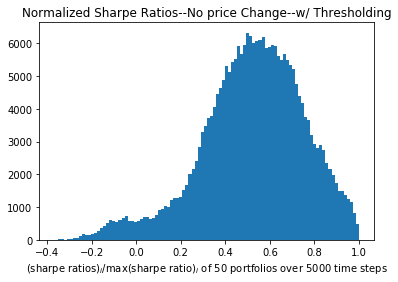

In [10]:
normSharpes=np.asarray([])
n = 0
for i, v in traderIDs.items():
    normSharpes = np.append(normSharpes,v.sharpeReal/max(v.sharpeReal))
    n += 1
plt.hist(normSharpes, bins =100)
plt.title("Normalized Sharpe Ratios--No price Change--w/ Thresholding")
plt.xlabel("(sharpe ratios)$_i$/max(sharpe ratio)$_i$ of 50 portfolios over 5000 time steps")
plt.savefig("./results/50_traders_no_change_price/no_priceChange_thresholding_50_normalized_sharperatios.png")

In [11]:
import pickle

with open('./results/50_traders_no_change_price/'+ 'traderIDs_50_nopricechange_thresholded' + '.pkl', 'wb') as f:
    pickle.dump(traderIDs, f, pickle.HIGHEST_PROTOCOL)

In [12]:
conf = open('./results/50_traders_no_change_price/'+ 'config_50_pricechange_thresholded' + '.txt',"w")
conf.write(str(config.config))
conf.close()

In [14]:
TstockChars = utils.characterize(TstockPool,tmax=6000)

In [15]:
TstockChars.to_csv('./results/50_traders_no_change_price/TstockCharacteristics_no_pricechange_thresholded.csv')
TtotalOrders.to_csv('./results/50_traders_no_change_price/TtotalOrders_50p_100s_no_pricechange_thresholded.csv')
Ttransactions.to_csv('./results/50_traders_no_change_price/Ttransactions_50p_100s_no_pricechange_thresholded.csv')
np.savetxt('./results/50_traders_no_change_price/TstockPool_100s_no_pricechange_thresholded.txt', TstockPool)
np.savetxt('./results/50_traders_no_change_price/ThurstPool_100s_no_pricechange_thresholded.txt', ThurstPool)

# SAVE THRESHOLDED DATA ^

In [ ]:
totalOrders.sort_values(by=['time','portfolio'], inplace=True)
totalOrders.reset_index(inplace=True,drop=True)
totalOrders.hist(column='time',histtype='step',bins=7000)
plt.title("Number of submitted orders without threshold")
plt.xlabel("time")
plt.ylabel("count")
#plt.show()
#plt.savefig("hurst001_unthresholded_totalorders")

In [ ]:
TtotalOrders.sort_values(by=['time','portfolio'], inplace=True)
TtotalOrders.reset_index(inplace=True,drop=True)
TtotalOrders.hist(column='time',histtype='step',bins=7000)
plt.title("Number of submitted orders with threshold")
plt.xlabel("time")
plt.ylabel("count")
#plt.show()
#plt.savefig("hurst001_thresholded_totalorders")

In [ ]:
a = 6 # random stock

plt.plot(np.arange(992,8192), oghurstPool[a][992:8192], color = 'blue', label = "original H-index")
plt.plot(np.arange(992,8192), ThurstPool[a][992:8192], color = 'red', label = "changing H-index")
plt.title("Hurst Index")
# plt.show()
# plt.savefig('./hurst001_stock_'+str(a)+'_hurst.png')

In [ ]:
plt.title("Stock Price")
plt.plot(np.arange(992,8192), ogstockPool[a][992:8192], color = 'blue', label = "original H-index")
plt.plot(np.arange(992,8192), TstockPool[a][992:8192], color = 'red', label = "changing H-index")
#plt.show()
# plt.savefig('./husrt001_stock_'+str(a)+'_stock.png')

In [ ]:
# TstockChars.to_csv('TstockCharacteristics_7200_5p_20s.csv')
# TtotalOrders.to_csv('TtotalOrders_7200_5p_20s.csv')
# Ttransactions.to_csv('Ttransactions_7200_5p_20s.csv')
# np.savetxt('TstockPool_7200_5p_20s.txt', TstockPool)
# np.savetxt('ThurstPool_7200_5p_20s.txt', ThurstPool)

traderIDs['bsfah'].weightdata

In [ ]:
qportOrders = TtotalOrders[(TtotalOrders['portfolio']=='bsfah')]
qport = traderIDs['bsfah']
print(qport.stocks)
qportChars = TstockChars[TstockChars['stock'].isin(qport.stocks)]
#qportChars[qportChars['time']==992]#['var'])

# print(qportChars[qportChars['time']>7000])
# plt.plot(np.arange(6000,8193),TstockPool[4][6000:])
# plt.show()
# print(qport.weightdata)
for i in qport.stocks:
    plt.plot(np.arange(992,8192),qportChars[qportChars['stock']==i]['var'], 'o-', label = str(i),markersize = 2, linewidth=1)
plt.legend(loc='center left')
plt.title("Variances of the stocks in an example portfolio")
plt.ylabel("Variance")
plt.yscale('log')
plt.savefig("variances_of_an_exportf.png")
    

In [ ]:
# plot the weights of each stock
#for stock in qport.stocks[:5]:
for stock in qport.stocks:
    plt.plot(qport.weightdata[qport.weightdata['stock']==stock]['time'],
             qport.weightdata[qport.weightdata['stock']==stock]['weight'], 'o-',
             label=str(stock), markersize = 2, linewidth=1)
plt.title("Weights of each stock in an example portfolio")
plt.legend()
plt.ylabel("Weight")
plt.savefig("Weights_of_ex_portf.png")
plt.show()

for stock in [3,4,5,12]:
    plt.plot(qport.weightdata[qport.weightdata['stock']==stock]['time'],
             qport.weightdata[qport.weightdata['stock']==stock]['weight'], 'o-',
             label=str(stock), markersize = 2, linewidth=1)
plt.title("Weights of high volatility stock in an example portfolio")
plt.ylabel("Weight")
plt.legend()
plt.savefig("Weights_special_of_ex_portf.png")
plt.show()

plt.plot(np.asarray(qportOrders[qportOrders['stock']==12].time)[258:280],np.asarray(qportOrders[qportOrders['stock']==12].order)[258:280], 'o-', markersize=2, linewidth=1)
plt.grid('on')
plt.title("Order History of stock number 12 by an example portfolio")
plt.ylabel("Buy/Sell Volume")
plt.savefig("Orders_of_volatilestock_of_ex_portf.png")
plt.show()

plt.plot(np.arange(6160,6200),TstockPool[12][6160:6200])
plt.plot(np.repeat([6171],12),np.arange(0,12), label = "First buy point")
plt.plot(np.repeat([6172],12),np.arange(0,12), label = "First sell point")
plt.legend()
plt.title("Price history of stock number 12")
plt.ylabel("Price")
plt.grid('on')
plt.savefig("Price_of_volatilestock_of_ex_portf.png")
plt.show()

In [ ]:
qportOrders[qportOrders['stock']==12].order.idxmin()
qportOrders[qportOrders['stock']==12].loc[17894]

In [ ]:
vargaps = np.asarray([])
avgreturn = np.asarray([])
avgvar = np.asarray([])
stdgaps = np.asarray([])
avgstd = np.asarray([])
for t in range(992,8192):
    vargaps = np.append(vargaps,max(qportChars[qportChars['time']==t]['var'])-min(qportChars[qportChars['time']==t]['var']))
    avgreturn = np.append(avgreturn, np.mean((qportChars[qportChars['time']==t]['mean'])))
    avgvar = np.append(avgvar, np.mean((qportChars[qportChars['time']==t]['var'])))
    stdgaps = np.append(stdgaps,max(qportChars[qportChars['time']==t]['std'])-min(qportChars[qportChars['time']==t]['std']))
    avgstd = np.append(avgstd, np.mean((qportChars[qportChars['time']==t]['std'])))
                        

In [ ]:
qportOrders.hist(column='time',histtype='step',bins=6000)
plt.title("Number of submitted orders of an example portfolio")
plt.xlabel("Time")
plt.ylabel("Orders")
plt.savefig("hstep_001_7200_thresholded_submittedOrders.png")
plt.show()


plt.plot(np.arange(992,8192),vargaps)
plt.grid(True)
plt.title("Variance gap of returns of an example portfolio")
plt.savefig("hstep_001_7200_thresholded_variancegap.png")
plt.show()

plt.plot(np.arange(992,8192),stdgaps)
plt.grid(True)
plt.title("STD gap of returns of an example portfolio")
plt.savefig("hstep_001_7200_thresholded_stdgap.png")
plt.show()

plt.title("Average expected percent returns of an example portfolio")
plt.grid(True)
plt.plot(np.arange(992,8192),avgreturn)
plt.savefig("hstep_001_7200_thresholded_averagereturns.png")
plt.show()


for i in qport.stocks:
    plt.plot(np.arange(992,8192),TstockPool[i][992:8192])
plt.grid(True)
plt.title("Prices of stocks within the example portfolio")
plt.savefig("hstep_001_7200_thresholded_pricesexportf.png")
plt.show()


for i in qport.stocks:
    plt.plot(np.arange(992,8192),ThurstPool[i][992:8192])
plt.grid(True)
plt.title("Hurst Indices of stocks within the example portfolio")
plt.savefig("hstep_001_7200_thresholded_hurstexportf.png")
plt.show()


plt.title("Variance of expected percent returns of an example portfolio")
plt.grid(True)
plt.plot(np.arange(992,8192),avgvar)
plt.savefig("hstep_001_7200_thresholded_variancereturns.png")
plt.show()

plt.title("STD of expected percent returns of an example portfolio")
plt.grid(True)
plt.plot(np.arange(992,8192),avgstd)
plt.savefig("hstep_001_7200_thresholded_stdreturns.png")

In [ ]:
# for key,portf in traderIDs.items():
#     print(portf.stocks)
from library.utils import sigmoid
k = 100
plt.title("85th Ptile ("+str(qport.threshold)+") with k slope: "+ str(k))
pts = np.linspace(0.1,0.17,2000)
plt.grid(True)
plt.plot(pts,sigmoid(pts,qport.threshold, k = k))
# plt.savefig("85th percentile sigmoid function with slope "+str(k))

In [ ]:
plt.hist(qport.sharpe, bins=30)
plt.grid(True)
plt.title("Distribution of all sharpe ratios in example portfolio before thresholding")
# plt.savefig("h001_sharpedistthresholded")

In [ ]:
# for name,portf in traderIDs.items():
#     p90 = (np.percentile(portf.sharpe,50))
#     p100 = (max(portf.sharpe))
#     x0 = (p100+p90)/2
#     probs = []
#     print(x0)
#     for i in portf.sharpe:
#         p = (sigmoid(i,x0, k =1))
#         probs.append(p)
#     #print(probs)
#     plt.plot(portf.sharpe,probs, 'o')
#     plt.grid('on')
#     plt.show()
# # june 18, create a reset function in the portfolios to incorporate sharpe ratio threshold
# # reset the sharpe ratio counter for the portfolios and update the order function

# Overlap portfolio
might be better to just choose randomly so theres no disconnect in the selection..

In [ ]:
# import string 
# import random 
# def randString(length = 5):
#     letters = string.ascii_lowercase
#     return ''.join(random.sample(letters,length))

# tstocks = {}
# stocks = np.arange(50)
# window = 5
# indx = 0
# portfs=0
# print(stocks)
# while portfs <= 100:
#     startpos = indx % len(stocks)
#     window = np.random.randint(12,18)
#     name = randString()
#     print(name)
#     while name in traderIDs:
#         name = randString()
# #     print(startpos)
# #     print(stocks)
# #     print(startpos, ":", startpos+window)
#     if startpos+window >= len(stocks):
#         print('overflow ', startpos+window)
#         stocks2 = np.concatenate([stocks,stocks])
#         tstocks[name] = np.copy(stocks2[startpos:startpos+window])
#         np.random.shuffle(stocks)
#         print("shuffled")
#     else:
#         tstocks[name] = np.copy(stocks[startpos:startpos+window])
#     indx += window - np.random.randint(10,15)
#     portfs += 1
    
# #     if indx >= len(stocks):
# #         print(portfs)


In [ ]:
#tstocks

In [ ]:
#(cosineSim(tstocks['iugey'],tstocks['fweup']))

In [ ]:
# pesbocosines = np.asarray([])
# #pesbo = tstocks['iugey']
# #portf2s = np.asarray([])
# for j, pesbo in tstocks.items():
#     for i, portf in tstocks.items():
#         if i!=j:
#             cc = cosineSim(pesbo,portf)
#             portf2s = np.append(portf2s,i)
#             pesbocosines = np.append(pesbocosines,cc)

In [ ]:
# (pesbocosines)

In [ ]:
# win10_15 = np.mean(pesbocosines)

In [ ]:
# portf2s[44]

In [ ]:
# def cosineSim(portf1, portf2): #change from .stocks array to actual object for both stocks and weights
#     overlapWeights = 0
#     for i in portf1:
#         if i in portf2: # find the weights in portf1 and portf2
#             overlapWeights += 1 # actual weight calculation
    
#     portf1weights = np.ones(len(portf1))
#     portf2weights = np.ones(len(portf2))
#     portf1Norm = np.linalg.norm(portf1weights)
#     portf2Norm = np.linalg.norm(portf2weights)
    
#     return overlapWeights/(portf1Norm*portf2Norm)
    
    